In [1]:
%load_ext autoreload
%autoreload 2

import os
import numpy as np
import pandas as pd 
import sys
import pickle
import itertools
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import random
from sklearn.metrics import pairwise_distances
from sklearn.kernel_ridge import KernelRidge
import math

workingdirectory = os.popen('git rev-parse --show-toplevel').read()[:-1]
sys.path.append(workingdirectory)
os.chdir(workingdirectory)

import allensdk.core.json_utilities as ju
from allensdk.core.mouse_connectivity_cache import MouseConnectivityCache

from mcmodels.core import VoxelModelCache
from mcmodels.core.utils import get_structure_id,get_ordered_summary_structures
from mcmodels.core.connectivity_data import get_connectivity_data
from mcmodels.models.crossvalidation import get_nwloocv_predictions_multimodel_merge_dists
from mcmodels.utils import nonzero_unique #, unionize
from mcmodels.models.crossvalidation import get_best_hyperparameters,get_loss_best_hyp,get_loss#get_loocv_predictions,get_loss#get_best_hyperparameters,get_loss_best_hyp,get_loocv_predictions,get_loss
from mcmodels.core.utils import get_leaves_ontologicalorder, get_indices, get_indices2,get_eval_indices,screen_index_matrices,screen_index_matrices2,screen_index_matrices3#get_cre_status,get_minorstructure_dictionary,get_leaves_ontologicalorder
from mcmodels.core.utils import get_indices_2ormore
from mcmodels.regressors import NadarayaWatson
from mcmodels.core.plotting import plot_loss_surface,plot_loss_scatter

/Users/samsonkoelle/anaconda3/envs/allen_010719_5/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.linear_model.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.linear_model. Anything that cannot be imported from sklearn.linear_model is now part of the private API.
  warnings.warn(message, FutureWarning)
/Users/samsonkoelle/anaconda3/envs/allen_010719_5/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
/Users/samsonkoelle/anaconda3/envs/allen_010719_5/lib/python3.7/site-packages/sklearn/utils/deprecation

In [2]:
#read data
TOP_DIR = '/Users/samsonkoelle/alleninstitute/mcm_2020/mcm_updated/'
INPUT_JSON = os.path.join(TOP_DIR, 'input_011520.json')
EXPERIMENTS_EXCLUDE_JSON = os.path.join(TOP_DIR, 'experiments_exclude.json')
FILE_DIR = '/Users/samsonkoelle/alleninstitute/mcm_2020/mcm_updated/'
OUTPUT_DIR = os.path.join(FILE_DIR, 'output')

input_data = ju.read(INPUT_JSON)
manifest_file = input_data.get('manifest_file')
manifest_file = os.path.join(TOP_DIR, manifest_file)
experiments_exclude = ju.read(EXPERIMENTS_EXCLUDE_JSON)

#its unclear why the hyperparameters are loaded from the output directory
cache = VoxelModelCache(manifest_file=manifest_file)
major_structures = input_data.get('structures')
major_structure_ids = [get_structure_id(cache, s) for s in major_structures]
data_info = pd.read_excel('/Users/samsonkoelle/alleninstitute/Whole Brain Cre Image Series_curation only.xlsx', 'all datasets curated_070919pull')
data_info.set_index("id", inplace=True)
ontological_order = get_ordered_summary_structures(cache)

mcc = MouseConnectivityCache(manifest_file = '../connectivity/mouse_connectivity_manifest.json')
st = mcc.get_structure_tree()
ai_map = st.get_id_acronym_map()
ia_map = {value: key for key, value in ai_map.items()}

#regionalize voxel model: compare with regional model
#regional parameters
cre = None
eid_set=None
high_res=False
threshold_injection = False

COARSE_STRUCTURE_SET_ID = 2
DEFAULT_STRUCTURE_SET_IDS = tuple([COARSE_STRUCTURE_SET_ID])
tree = cache.get_structure_tree()
default_structures = tree.get_structures_by_set_id(DEFAULT_STRUCTURE_SET_IDS)
default_structure_ids = [st['id'] for st in default_structures if st['id'] != 934]
#cre= True

In [3]:
connectivity_data = get_connectivity_data(cache, major_structure_ids, experiments_exclude, remove_injection = False)

connectivity_data.get_injection_hemisphere_ids()
connectivity_data.align()
connectivity_data.get_centroids()
connectivity_data.get_data_matrices(default_structure_ids)
connectivity_data.get_crelines(data_info)
with open('data/info/leafs.pickle', 'rb') as handle:
    leafs = pickle.load(handle)
    
connectivity_data.ai_map = ai_map
connectivity_data.get_summarystructures(data_info)
connectivity_data.leafs = leafs

512
703
1089
1097
315
313
354
698
771
803
477
549


In [4]:
#major division segregation is legacy code but convenient for fast cross validation in major division model
#experiments_minor_structures = get_summarystructure_dictionary(connectivity_data, data_info)
#get leaves in ontological order.  Where leafs don't exist, uses summary structure
ontological_order_leaves = get_leaves_ontologicalorder(connectivity_data, ontological_order)
#Key isn't affected by which experiment we choose. This allows default masking to be inherited from the AllenSDK.
sid0 = list(connectivity_data.structure_datas.keys())[0]
eid0 = list(connectivity_data.structure_datas[sid0].experiment_datas.keys())[0]
#Identify keys denoting which voxels correspond to which structure in the ipsi and contra targets.
contra_targetkey = connectivity_data.structure_datas[sid0].projection_mask.get_key(structure_ids=ontological_order_leaves, hemisphere_id=1)
ipsi_targetkey = connectivity_data.structure_datas[sid0].projection_mask.get_key(structure_ids=ontological_order_leaves, hemisphere_id=2)

#contra_targetkey = connectivity_data.structure_datas[sid0].projection_mask.get_key(structure_ids=ontological_order, hemisphere_id=1)
#ipsi_targetkey = connectivity_data.structure_datas[sid0].projection_mask.get_key(structure_ids=ontological_order, hemisphere_id=2)
#get average intensities of projection structures given ipsi and contra keys
#source_key = ontological_order #only relevant here when injection needs to be unionized, but currently a required argument
ipsi_target_regions, ipsi_target_counts = nonzero_unique(ipsi_targetkey, return_counts=True)
contra_target_regions, contra_target_counts = nonzero_unique(contra_targetkey, return_counts=True)

target_order = lambda x: np.array(ontological_order_leaves)[np.isin(ontological_order_leaves, x)]
permutation = lambda x: np.argsort(np.argsort(target_order(x)))
targ_ids = np.concatenate([ipsi_target_regions[permutation(ipsi_target_regions)],
                           contra_target_regions[permutation(contra_target_regions)]])

In [5]:
connectivity_data.get_regionalized_normalized_data(ontological_order, ipsi_targetkey, contra_targetkey)
connectivity_data.get_creleaf_combos()
connectivity_data.leaf2_index_matrices = get_indices_2ormore(connectivity_data.leafs)
connectivity_data.creleaf2_index_matrices = get_indices_2ormore(connectivity_data.creleaf_combos)

In [54]:

def get_cre_distances(projections, means_cast, sids, cres):
    nsamp = cres.shape[0]
    credist = np.empty((nsamp,nsamp))
    credist[:] = np.nan
    for i in range(nsamp):
        #print(i)
        meani = means_cast[sids[i]][cres[i]]#means_cast.loc[tuple([cres[i], sids[i]])]
        for j in range(nsamp):
            meanj = means_cast[sids[j]][cres[j]]
            if sids[j] == sids[i]:
                credist[i,j]  = np.linalg.norm(meani - meanj)#**2
    return(credist)
def get_loss_surface_cv(projections, centroids, cres, sids,fraction, gamma = 100000):
    means_cast = get_means(projections, cres, sids)
    cre_distances_cv = get_cre_distances_cv(projections, means_cast, sids, cres)
    surface = get_surface_from_distances(projections,centroids,cre_distances_cv, fraction, gamma)
    surface.cre_distances_cv = cre_distances_cv
    return(surface)

def get_surface_from_distances(projections,centroids,cre_distances, fraction, gamma = 100000):
    
    nsamp = centroids.shape[0]
    pairs = np.asarray(np.where(~np.isnan(cre_distances))).transpose() #not all cres will have distances, e.g. if not in same leaf
    ngp = pairs.shape[0]
    
    coordinates = np.zeros((ngp,2))
    projection_distances = np.zeros((ngp,1))
    for i in range(ngp):
        coordinates[i,0] = np.linalg.norm(centroids[pairs[i][0]] - centroids[pairs[i][1]])**2
        coordinates[i,1] = cre_distances[pairs[i][0]][pairs[i][1]]
        projection_distances[i] = np.linalg.norm(projections[pairs[i][0]] - projections[pairs[i][1]])**2
    coordinates_normed = coordinates / np.linalg.norm(coordinates, axis = 0)#**2

    surface = NadarayaWatson(kernel='rbf',  gamma  = gamma)
    randos = random.sample(list(range(ngp)), math.floor(ngp * fraction))
    surface.fit(coordinates_normed[randos], projection_distances[randos])
    surface.coordinates_normed = coordinates_normed
    surface.norms = np.linalg.norm(coordinates, axis = 0)
    surface.projection_distances = projection_distances
    return(surface)

# def get_cre_distances_cv(proj, means_cast, sids,cres):
#     nsamp = cres.shape[0]
#     credist = np.empty((nsamp,nsamp))
#     credist[:] = np.nan
#     for i in range(nsamp):
#         print(i)
#         meani = meani = means_cast[sids[i]][cres[i]]
#         ls = np.where(leafs[sid] == leafs[sid][i])[0]
#         crs = np.where(cres == cres[i])[0]
#         ncr = len(np.intersect1d(ls, crs))
        
#         meanloocvi = meani
#         if ncr > 1:
#             meanloocvi = (ncr * meani ) / (ncr - 1) -   (1/ ncr)* proj[i] #results[reg[i]][tuple([cs[reg_cre_ind[j],1], cs[reg_cre_ind[k],1]])]
#         else:
#             meanloocvi = np.zeros(proj[i].shape[0])
#             meanloocvi[:] = np.nan
            
#         for j in range(nsamp):
#             meanj = means_cast[sids[j]][cres[j]]
#             if sids[j] == sids[i]:
#                 credist[i,j]  = np.linalg.norm(meanloocvi - meanj)

#     return(credist)

def get_means(projections, cres, sids):
    cre_means = {}
    cre_types = np.unique(cres)
    sid_types = np.unique(sids)
    for i in range(len(sid_types)):
        cre_means[sid_types[i]] = {}
        sid_inds = np.where(sids == sid_types[i])[0]
        for j in range(len(cre_types)): 
            cre_inds = np.where(cres == cre_types[j])[0]
            cre_means[sid_types[i]][cre_types[j]] = np.mean(projections[np.intersect1d(sid_inds, cre_inds)], axis = 0 )
    return(cre_means)

def get_cre_distances_cv(proj, means_cast, sids,cres):
    nsamp = cres.shape[0]
    credist = np.empty((nsamp,nsamp))
    credist[:] = np.nan
    for i in range(nsamp):
        #print(i)
        meani = meani = means_cast[sids[i]][cres[i]]
        ls = np.where(leafs[sid] == leafs[sid][i])[0]
        crs = np.where(cres == cres[i])[0]
        ncr = len(np.intersect1d(ls, crs))
        
        meanloocvi = meani
        if ncr > 1:
            meanloocvi = (ncr * meani ) / (ncr - 1) -   (1/ ncr)* proj[i] #results[reg[i]][tuple([cs[reg_cre_ind[j],1], cs[reg_cre_ind[k],1]])]
        else:
            meanloocvi = np.zeros(proj[i].shape[0])
            meanloocvi[:] = np.nan
            
        for j in range(nsamp):
            meanj = means_cast[sids[j]][cres[j]]
            if sids[j] == sids[i]:
                credist[j,i]  = np.linalg.norm(meanloocvi - meanj)

    return(credist)

def get_embedding_cv(surface, dists, cre_distances_cv):
    
    ntrain = dists.shape[0]
    norms = surface.norms
    leaf_pairs = np.asarray(np.where(~np.isnan(cre_distances_cv))).transpose()
    nlp = leaf_pairs.shape[0]
    
    losses = np.zeros((ntrain, ntrain))
    for i in range(nlp):
        print(i, nlp)
        d_ij = dists[leaf_pairs[i][0]][leaf_pairs[i][1]] / norms[0]
        p_ij = cre_distances_cv[leaf_pairs[i][0]][leaf_pairs[i][1]] / norms[1]
        losses[leaf_pairs[i][0]][leaf_pairs[i][1]] = surface.predict(np.asarray([[d_ij, p_ij]]))
      
    losses[np.where(losses == 0)] = np.nan
    
    return(losses)


from mcmodels.core import Mask

# def get_connectivity_matrices3(connectivity_data, surfaces, cres, structures, model_ordering_leaf, model_region_surface, source_ordering, target_ordering, eval_cres):
    
#     nsource = len(source_ordering)
#     #n#target = len(target_ordering)
#     ncre = len(eval_cres)

#     ipsi_target_regions = connectivity_data.ipsi_target_regions
#     contra_target_regions = connectivity_data.contra_target_regions                               
#     ipsi_indices= np.asarray([])
#     contra_indices = np.asarray([])
#     for iy in target_ordering: 
#         ipsi_indices = np.concatenate([ipsi_indices, np.where(ipsi_target_regions==iy)[0]] )
#         contra_indices = np.concatenate([contra_indices, np.where(contra_target_regions==iy)[0]] )
#     ipsi_indices = np.asarray(ipsi_indices, dtype = int)   
#     contra_indices = np.asarray(contra_indices, dtype = int)    
#     reorder = np.concatenate([ipsi_indices, len(ipsi_indices) + contra_indices])  
#     ntarget = len(reorder)
      
#     connectivity = np.zeros((ncre, nsource, ntarget))
#     connectivity[:] = np.nan
#     #structure_major_dictionary = connectivity_data.structure_major_dictionary
#     for c in range(ncre):
#         for i in range(nsource):
#             print(i,source_ordering[i])
#             sid = model_ordering_leaf[i,0]#structure_major_dictionary[source_ordering[i]]
#             gamma = surfaces[sid].gamma#gamma_dict[sid]
#             connectivity[c,i] = get_region_prediction3(cache,
#                                                       connectivity_data.structure_datas[sid],
#                                                       exp_structures = structures[sid],
#                                                       model_region_leaf = model_ordering_leaf[i,1],
#                                                        model_region_surface = model_region_surface[i,1],
#                                                       prediction_region= source_ordering[i],
#                                                       cre = eval_cres[c],
#                                                       gamma = surfaces[sid].bestgamma,
#                                                       surface = surfaces[sid],
#                                                       cre_model = True)
                                                      
#     connectivity = connectivity[:,:,reorder]                                                  
                                                      
#     return(connectivity)

# def get_region_prediction3(cache, structure_data,  exp_structures, model_region_surface, model_region_leaf, prediction_region, cre, gamma, surface = None, cre_model = False):
    
#     #model_experiments = np.where(exp_structures == model_region)[0]
#     model_experiments_leaf = np.where(exp_structures == model_region_leaf)[0]
#     nexp = len(model_experiments_leaf)
    
#     cres = structure_data.crelines[model_experiments_leaf]
#     mask = Mask.from_cache(cache,structure_ids=[prediction_region],hemisphere_id=2)

# #     if surface != None and cre_model != True:
# #         means = get_means(projections,cres, np.repeat(model_region,nexp))
        
# #         losses = get_embedding(surface, pairwise_distances(centroids, mask.coordinates)**2, cres, cre, means[model_region])
# #         predictions = get_nw_predictions(projections, losses, gamma)
# #         output = np.mean(predictions, axis = 0)
        
#     if surface != None and cre_model == True:
#         projections = structure_data.reg_proj_norm[model_experiments_leaf]
#         centroids = structure_data.centroids[model_experiments_leaf]#model_region_leaf
#         means = get_means(projections, cres, np.repeat(model_region_surface,nexp))
#         #print(means)
#         print(prediction_region)
#         #print(prediction_region, model_region,means.keys())
#         #supposed to check if theres a cre in that region
#         if np.isin(model_region_surface, list(means.keys())):
#             if np.isin(cre, np.asarray(list(means[model_region_surface].keys()))):
#                 losses = get_embedding(surface, pairwise_distances(centroids, mask.coordinates)**2, cres, cre, means[model_region_surface])
#                 predictions = get_nw_predictions(projections, losses, gamma)
#                 output = np.mean(predictions, axis = 0)
#             else:
#                 output = np.zeros(projections.shape[1])
#                 output[:] = np.nan
#         else:
#             output = np.zeros(projections.shape[1])
#             output[:] = np.nan           
# #     if surface == None and cre_model != True:
# #         means = get_means(projections, cres, [model_region])
# #         predictions = means[cres]
# #         output = np.mean(predictions, axis = 0)
        
#     if surface == None and cre_model == True:
        
        
#         modelcre_experiments = np.where(cres == cre)[0]
#         if len(modelcre_experiments)>0:
#             projections = structure_data.reg_proj_norm[model_experiments][modelcre_experiments]
#             centroids = structure_data.centroids[model_experiments][modelcre_experiments]
#             #print((pairwise_distances(centroids, mask.coordinates)**2).shape)
#             predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
#             output = np.mean(predictions, axis = 0)
#         else:
#             output = np.zeros(structure_data.reg_proj_norm.shape[1])
#             output[:] = np.nan  
            
#     if surface == None and cre_model == False:
        
#         if len(model_experiments)>0:
#             projections = structure_data.reg_proj_norm[model_experiments]
#             centroids = structure_data.centroids[model_experiments]
#             predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
#             output = np.mean(predictions, axis = 0)
#         else:
#             output = np.zeros(structure_data.reg_proj_norm.shape[1])
#             output[:] = np.nan  
        
#     return(output)


def get_embedding(surface, dists, cres = None, cre = None, means = None):
    
    ntrain = dists.shape[0]
    neval = dists.shape[1]
    norms = surface.norms
    #cnorm = surface.cnorm
    
    cre_deezy = np.zeros((ntrain))
    
    for i in range(ntrain):
        cre_deezy[i] = np.linalg.norm(means[cres[i]] - means[cre])
    
    losses = np.zeros((ntrain, neval))
    for i in range(ntrain):
        for j in range(neval):
            d_ij = dists[i,j] / norms[0]
            p_i = cre_deezy[i] / norms[1]
            losses[i,j] = surface.predict(np.asarray([[d_ij, p_i]]))
            
    return(losses)



def get_nw_predictions(projections, dists, gamma):
  
     
    projections = np.asarray(projections, dtype=np.float32)
    neval = dists.shape[1]
    #nexp = centroids.shape[0]
    predictions = np.zeros((neval, projections.shape[1]))
    predictions[:] = np.nan
    
    #print(model_index_val.shape, eval_index_val.shape)
    #weights = np.exp(- dists / gamma)#np.exp(-dists[model_index_val] / gamma) #get_weights(centroids, gamma)
    for i in range(neval):
        dists_i = dists[:,i] - np.min(dists[:,i])
        #dists_i = dists[i,:] - np.min(dists[i,:])
        weights_i = np.exp(- dists_i * gamma)
        weights_i = np.asarray(weights_i, dtype=np.float32)
        weights_i[np.isnan(weights_i)] = 0.
        weights_i = weights_i / np.sum(weights_i)
        predictions[i] = np.dot(weights_i, projections)
        
    return(predictions) 

def get_connectivity_matrices2_nw(connectivity_data, gamma_dict, cres, structures, model_ordering, source_ordering, target_ordering, eval_cres, cre_model = True):
    
    nsource = len(source_ordering)
    #n#target = len(target_ordering)
    ncre = len(eval_cres)

    ipsi_target_regions = connectivity_data.ipsi_target_regions
    contra_target_regions = connectivity_data.contra_target_regions                               
    ipsi_indices= np.asarray([])
    contra_indices = np.asarray([])
    for iy in target_ordering: 
        ipsi_indices = np.concatenate([ipsi_indices, np.where(ipsi_target_regions==iy)[0]] )
        contra_indices = np.concatenate([contra_indices, np.where(contra_target_regions==iy)[0]] )
    ipsi_indices = np.asarray(ipsi_indices, dtype = int)   
    contra_indices = np.asarray(contra_indices, dtype = int)    
    reorder = np.concatenate([ipsi_indices, len(ipsi_indices) + contra_indices])  
    ntarget = len(reorder)
      
    connectivity = np.zeros((ncre, nsource, ntarget))
    connectivity[:] = np.nan
    #structure_major_dictionary = connectivity_data.structure_major_dictionary
    for c in range(ncre):
        for i in range(nsource):
            print(i,source_ordering[i])
            sid = model_ordering[i,0]#structure_major_dictionary[source_ordering[i]]
            gamma = gamma_dict[sid]
            connectivity[c,i] = get_region_prediction2(cache,
                                                      connectivity_data.structure_datas[sid],
                                                      exp_structures = structures[sid],
                                                      model_region = model_ordering[i,1],
                                                      prediction_region= source_ordering[i],
                                                      cre = eval_cres[c],
                                                      gamma = gamma_dict[sid],
                                                      cre_model = cre_model)
                                                      
    connectivity = connectivity[:,:,reorder]                                                  
                                                      
    return(connectivity)


def get_region_prediction2(cache, structure_data,  exp_structures, model_region, prediction_region, cre, gamma, surface = None, cre_model = False):
    
    model_experiments = np.where(exp_structures == model_region)[0]
    nexp = len(model_experiments)
    
    cres = structure_data.crelines[model_experiments]
    mask = Mask.from_cache(cache,structure_ids=[prediction_region],hemisphere_id=2)

#     if surface != None and cre_model != True:
#         means = get_means(projections,cres, np.repeat(model_region,nexp))
        
#         losses = get_embedding(surface, pairwise_distances(centroids, mask.coordinates)**2, cres, cre, means[model_region])
#         predictions = get_nw_predictions(projections, losses, gamma)
#         output = np.mean(predictions, axis = 0)
        
    if surface != None and cre_model == True:
        projections = structure_data.reg_proj_norm[model_experiments]
        centroids = structure_data.centroids[model_experiments]
        means = get_means(projections, cres, np.repeat(model_region,nexp))
        #print(means)
        print(prediction_region, model_region,means.keys())
        #supposed to check if theres a cre in that region
        if np.isin(model_region, list(means.keys())):
            if np.isin(cre, np.asarray(list(means[model_region].keys()))):
                losses = get_embedding(surface, pairwise_distances(centroids, mask.coordinates)**2, cres, cre, means[model_region])
                predictions = get_nw_predictions(projections, losses, gamma)
                output = np.mean(predictions, axis = 0)
            else:
                output = np.zeros(projections.shape[1])
                output[:] = np.nan
        else:
            output = np.zeros(projections.shape[1])
            output[:] = np.nan           
#     if surface == None and cre_model != True:
#         means = get_means(projections, cres, [model_region])
#         predictions = means[cres]
#         output = np.mean(predictions, axis = 0)
        
    if surface == None and cre_model == True:
        
        
        modelcre_experiments = np.where(cres == cre)[0]
        if len(modelcre_experiments)>0:
            projections = structure_data.reg_proj_norm[model_experiments][modelcre_experiments]
            centroids = structure_data.centroids[model_experiments][modelcre_experiments]
            #print((pairwise_distances(centroids, mask.coordinates)**2).shape)
            predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
            output = np.mean(predictions, axis = 0)
        else:
            output = np.zeros(structure_data.reg_proj_norm.shape[1])
            output[:] = np.nan  
            
    if surface == None and cre_model == False:
        
        if len(model_experiments)>0:
            projections = structure_data.reg_proj_norm[model_experiments]
            centroids = structure_data.centroids[model_experiments]
            predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
            output = np.mean(predictions, axis = 0)
        else:
            output = np.zeros(structure_data.reg_proj_norm.shape[1])
            output[:] = np.nan  
        
    return(output)


#good one
#model_ordering_leafs,model_region_structures are len n exps, which model to use
#model_experiments_leaf,model_experiments_structure are inds of 
def get_connectivity_matrices3(connectivity_data, surfaces, cres, structures_smooth,structures_surface, model_ordering_leafs, model_ordering_surfaces, source_ordering, target_ordering, eval_cres):
    
    nsource = len(source_ordering)
    #n#target = len(target_ordering)
    ncre = len(eval_cres)

    ipsi_target_regions = connectivity_data.ipsi_target_regions
    contra_target_regions = connectivity_data.contra_target_regions                               
    ipsi_indices= np.asarray([])
    contra_indices = np.asarray([])
    for iy in target_ordering: 
        ipsi_indices = np.concatenate([ipsi_indices, np.where(ipsi_target_regions==iy)[0]] )
        contra_indices = np.concatenate([contra_indices, np.where(contra_target_regions==iy)[0]] )
    ipsi_indices = np.asarray(ipsi_indices, dtype = int)   
    contra_indices = np.asarray(contra_indices, dtype = int)    
    reorder = np.concatenate([ipsi_indices, len(ipsi_indices) + contra_indices])  
    ntarget = len(reorder)
      
    connectivity = np.zeros((ncre, nsource, ntarget))
    connectivity[:] = np.nan
    #structure_major_dictionary = connectivity_data.structure_major_dictionary
    for c in range(ncre):
        for i in range(nsource):
            print(i,source_ordering[i])
            sid = model_ordering_leafs[i,0]#structure_major_dictionary[source_ordering[i]]
            gamma = surfaces[sid].gamma#gamma_dict[sid]
            connectivity[c,i] = get_region_prediction3(cache,
                                                      connectivity_data.structure_datas[sid],
                                                      #structures_sid = structures[sid],
                                                       structures_surface_sid =structures_surface[sid],
                                                       structures_smooth_sid= structures_smooth[sid],
                                                      model_region_leaf = model_ordering_leafs[i,1],
                                                       model_region_surface = model_ordering_surfaces[i,1],
                                                      prediction_region= source_ordering[i],
                                                      cre = eval_cres[c],
                                                      gamma = surfaces[sid].bestgamma,
                                                      surface = surfaces[sid],
                                                      cre_model = True)
                                                      
    connectivity = connectivity[:,:,reorder]                                                  
                                                      
    return(connectivity)

def get_region_prediction3(cache, structure_data,  structures_surface_sid,structures_smooth_sid, model_region_surface, model_region_leaf, prediction_region, cre, gamma, surface = None, cre_model = False):
    

    model_experiments_leaf = np.where(structures_smooth_sid == model_region_leaf)[0]
    model_experiments_surface = np.where(structures_surface_sid == model_region_surface)[0]
    
    nexp_surface = len(model_experiments_surface)
    
    cres_surface = structure_data.crelines[model_experiments_surface]
    mask = Mask.from_cache(cache,structure_ids=[prediction_region],hemisphere_id=2)
    if surface != None and cre_model == True:
        projections = structure_data.reg_proj_norm[model_experiments_leaf]
        projections_surface = structure_data.reg_proj_norm[model_experiments_surface]
        centroids = structure_data.centroids[model_experiments_leaf]#model_region_leaf
        means = get_means(projections_surface, cres_surface, np.repeat(model_region_surface,nexp_surface))
        #supposed to check if theres a cre in that region
        #if np.isin(model_region_surface, list(means.keys())):
        if centroids.shape[0]>0:
            if np.isin(cre, np.asarray(list(means[model_region_surface].keys()))):
                losses = get_embedding(surface, pairwise_distances(centroids, mask.coordinates)**2, cres_surface, cre, means[model_region_surface])
                predictions = get_nw_predictions(projections, losses, gamma)
                output = np.mean(predictions, axis = 0)
            else:
                output = np.zeros(projections.shape[1])
                output[:] = np.nan
        else:
            output = np.zeros(projections.shape[1])
            output[:] = np.nan
    if surface == None and cre_model == True:
        
        
        modelcre_experiments = np.where(cres == cre)[0]
        if len(modelcre_experiments)>0:
            projections = structure_data.reg_proj_norm[model_experiments][modelcre_experiments]
            centroids = structure_data.centroids[model_experiments][modelcre_experiments]
            #print((pairwise_distances(centroids, mask.coordinates)**2).shape)
            predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
            output = np.mean(predictions, axis = 0)
        else:
            output = np.zeros(structure_data.reg_proj_norm.shape[1])
            output[:] = np.nan  
            
    if surface == None and cre_model == False:
        
        if len(model_experiments)>0:
            projections = structure_data.reg_proj_norm[model_experiments]
            centroids = structure_data.centroids[model_experiments]
            predictions = get_nw_predictions(projections, pairwise_distances(centroids, mask.coordinates)**2, gamma)
            output = np.mean(predictions, axis = 0)
        else:
            output = np.zeros(structure_data.reg_proj_norm.shape[1])
            output[:] = np.nan  
        
    return(output)


In [10]:
major_structures_exps = {}

for sid in major_structure_ids:
    major_structures_exps[sid] = np.repeat(sid,len(connectivity_data.structure_datas[sid].summary_structures))
    
connectivity_data.major_structures_exps = major_structures_exps#get_indices_2ormore(connectivity_data.leafs)


In [50]:
#wrong dist (not remove)... try to recreate old result
frac_learn = np.ones(12)
frac_learn[4] = .0001
sls = {}
gammas_surface = 100000 * np.ones(12)
gammas_surface[0] = 10
gammas_surface[1] = 10
gammas_surface[2] = 1000
gammas_surface[3] = 100
gammas_surface[4] = 1000000#5000000
gammas_surface[3] = 100
gammas_surface[5] = 100
gammas_surface[6] = 10
gammas_surface[7] = 100
gammas_surface[8] = 100
gammas_surface[9] = 25
gammas_surface[10] = 1000
gammas_surface[11] = 1000


In [51]:
for m in range(4,5):
    print(m)
    sid = major_structure_ids[m]
    connectivity_data.structure_datas[sid].loss_surface_cv_str = get_loss_surface_cv(connectivity_data.structure_datas[sid].reg_proj_norm,
                                                                                                 connectivity_data.structure_datas[sid].centroids,
                                                                                                 connectivity_data.creline[sid],
                                                                                                 connectivity_data.major_structures_exps[sid],
                                                                                                 frac_learn[m],
                                                                                                 gamma = gammas_surface[m])
    
    



4


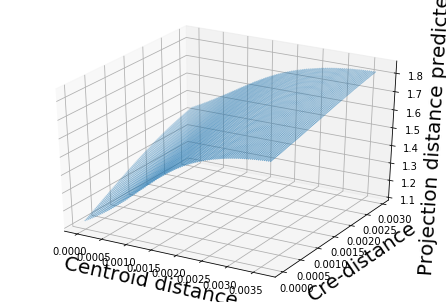

In [24]:
#%matplotlib notebook
plot_loss_surface(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)
#plt.savefig('/Users/samsonkoelle/isocortexsurface')

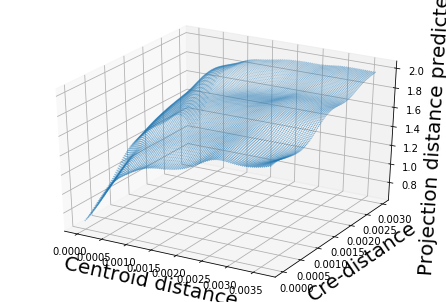

In [27]:
#%matplotlib notebook
plot_loss_surface(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)
#plt.savefig('/Users/samsonkoelle/isocortexsurface')

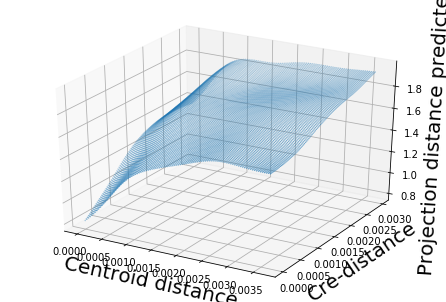

In [30]:
#%matplotlib notebook
plot_loss_surface(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)
#plt.savefig('/Users/samsonkoelle/isocortexsurface')

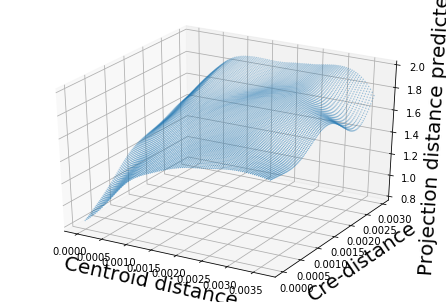

In [34]:
#%matplotlib notebook
plot_loss_surface(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)
#plt.savefig('/Users/samsonkoelle/isocortexsurface')

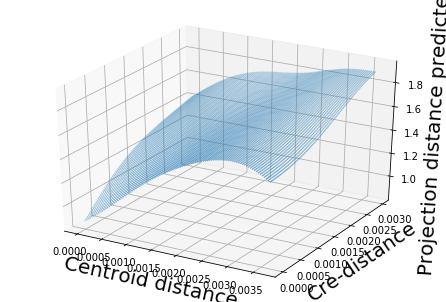

In [52]:
#%matplotlib notebook
plot_loss_surface(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)
#plt.savefig('/Users/samsonkoelle/isocortexsurface')

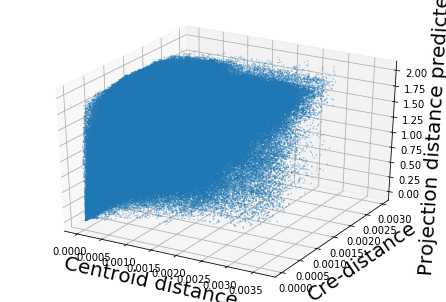

In [18]:
plot_loss_scatter(connectivity_data.structure_datas[major_structure_ids[4]].loss_surface_cv_str)

In [55]:
for m in range(4,5):
    sid = major_structure_ids[m]
    print(m)
    connectivity_data.structure_datas[sid].smoothed_losses_str = get_embedding_cv(surface = connectivity_data.structure_datas[sid].loss_surface_cv_str,
                                                                              dists = pairwise_distances(connectivity_data.structure_datas[sid].centroids)**2,
                                                                              cre_distances_cv = connectivity_data.structure_datas[sid].loss_surface_cv_str.cre_distances_cv)

4
0 825696
1 825696
2 825696
3 825696
4 825696
5 825696
6 825696
7 825696
8 825696
9 825696
10 825696
11 825696
12 825696
13 825696
14 825696
15 825696
16 825696
17 825696
18 825696
19 825696
20 825696
21 825696
22 825696
23 825696
24 825696
25 825696
26 825696
27 825696
28 825696
29 825696
30 825696
31 825696
32 825696
33 825696
34 825696
35 825696
36 825696
37 825696
38 825696
39 825696
40 825696
41 825696
42 825696
43 825696
44 825696
45 825696
46 825696
47 825696
48 825696
49 825696
50 825696
51 825696
52 825696
53 825696
54 825696
55 825696
56 825696
57 825696
58 825696
59 825696
60 825696
61 825696
62 825696
63 825696
64 825696
65 825696
66 825696
67 825696
68 825696
69 825696
70 825696
71 825696
72 825696
73 825696
74 825696
75 825696
76 825696
77 825696
78 825696
79 825696
80 825696
81 825696
82 825696
83 825696
84 825696
85 825696
86 825696
87 825696
88 825696
89 825696
90 825696
91 825696
92 825696
93 825696
94 825696
95 825696
96 825696
97 825696
98 825696
99 825696
100 8256

974 825696
975 825696
976 825696
977 825696
978 825696
979 825696
980 825696
981 825696
982 825696
983 825696
984 825696
985 825696
986 825696
987 825696
988 825696
989 825696
990 825696
991 825696
992 825696
993 825696
994 825696
995 825696
996 825696
997 825696
998 825696
999 825696
1000 825696
1001 825696
1002 825696
1003 825696
1004 825696
1005 825696
1006 825696
1007 825696
1008 825696
1009 825696
1010 825696
1011 825696
1012 825696
1013 825696
1014 825696
1015 825696
1016 825696
1017 825696
1018 825696
1019 825696
1020 825696
1021 825696
1022 825696
1023 825696
1024 825696
1025 825696
1026 825696
1027 825696
1028 825696
1029 825696
1030 825696
1031 825696
1032 825696
1033 825696
1034 825696
1035 825696
1036 825696
1037 825696
1038 825696
1039 825696
1040 825696
1041 825696
1042 825696
1043 825696
1044 825696
1045 825696
1046 825696
1047 825696
1048 825696
1049 825696
1050 825696
1051 825696
1052 825696
1053 825696
1054 825696
1055 825696
1056 825696
1057 825696
1058 825696
1059 8

1704 825696
1705 825696
1706 825696
1707 825696
1708 825696
1709 825696
1710 825696
1711 825696
1712 825696
1713 825696
1714 825696
1715 825696
1716 825696
1717 825696
1718 825696
1719 825696
1720 825696
1721 825696
1722 825696
1723 825696
1724 825696
1725 825696
1726 825696
1727 825696
1728 825696
1729 825696
1730 825696
1731 825696
1732 825696
1733 825696
1734 825696
1735 825696
1736 825696
1737 825696
1738 825696
1739 825696
1740 825696
1741 825696
1742 825696
1743 825696
1744 825696
1745 825696
1746 825696
1747 825696
1748 825696
1749 825696
1750 825696
1751 825696
1752 825696
1753 825696
1754 825696
1755 825696
1756 825696
1757 825696
1758 825696
1759 825696
1760 825696
1761 825696
1762 825696
1763 825696
1764 825696
1765 825696
1766 825696
1767 825696
1768 825696
1769 825696
1770 825696
1771 825696
1772 825696
1773 825696
1774 825696
1775 825696
1776 825696
1777 825696
1778 825696
1779 825696
1780 825696
1781 825696
1782 825696
1783 825696
1784 825696
1785 825696
1786 825696
1787

2714 825696
2715 825696
2716 825696
2717 825696
2718 825696
2719 825696
2720 825696
2721 825696
2722 825696
2723 825696
2724 825696
2725 825696
2726 825696
2727 825696
2728 825696
2729 825696
2730 825696
2731 825696
2732 825696
2733 825696
2734 825696
2735 825696
2736 825696
2737 825696
2738 825696
2739 825696
2740 825696
2741 825696
2742 825696
2743 825696
2744 825696
2745 825696
2746 825696
2747 825696
2748 825696
2749 825696
2750 825696
2751 825696
2752 825696
2753 825696
2754 825696
2755 825696
2756 825696
2757 825696
2758 825696
2759 825696
2760 825696
2761 825696
2762 825696
2763 825696
2764 825696
2765 825696
2766 825696
2767 825696
2768 825696
2769 825696
2770 825696
2771 825696
2772 825696
2773 825696
2774 825696
2775 825696
2776 825696
2777 825696
2778 825696
2779 825696
2780 825696
2781 825696
2782 825696
2783 825696
2784 825696
2785 825696
2786 825696
2787 825696
2788 825696
2789 825696
2790 825696
2791 825696
2792 825696
2793 825696
2794 825696
2795 825696
2796 825696
2797

3429 825696
3430 825696
3431 825696
3432 825696
3433 825696
3434 825696
3435 825696
3436 825696
3437 825696
3438 825696
3439 825696
3440 825696
3441 825696
3442 825696
3443 825696
3444 825696
3445 825696
3446 825696
3447 825696
3448 825696
3449 825696
3450 825696
3451 825696
3452 825696
3453 825696
3454 825696
3455 825696
3456 825696
3457 825696
3458 825696
3459 825696
3460 825696
3461 825696
3462 825696
3463 825696
3464 825696
3465 825696
3466 825696
3467 825696
3468 825696
3469 825696
3470 825696
3471 825696
3472 825696
3473 825696
3474 825696
3475 825696
3476 825696
3477 825696
3478 825696
3479 825696
3480 825696
3481 825696
3482 825696
3483 825696
3484 825696
3485 825696
3486 825696
3487 825696
3488 825696
3489 825696
3490 825696
3491 825696
3492 825696
3493 825696
3494 825696
3495 825696
3496 825696
3497 825696
3498 825696
3499 825696
3500 825696
3501 825696
3502 825696
3503 825696
3504 825696
3505 825696
3506 825696
3507 825696
3508 825696
3509 825696
3510 825696
3511 825696
3512

4114 825696
4115 825696
4116 825696
4117 825696
4118 825696
4119 825696
4120 825696
4121 825696
4122 825696
4123 825696
4124 825696
4125 825696
4126 825696
4127 825696
4128 825696
4129 825696
4130 825696
4131 825696
4132 825696
4133 825696
4134 825696
4135 825696
4136 825696
4137 825696
4138 825696
4139 825696
4140 825696
4141 825696
4142 825696
4143 825696
4144 825696
4145 825696
4146 825696
4147 825696
4148 825696
4149 825696
4150 825696
4151 825696
4152 825696
4153 825696
4154 825696
4155 825696
4156 825696
4157 825696
4158 825696
4159 825696
4160 825696
4161 825696
4162 825696
4163 825696
4164 825696
4165 825696
4166 825696
4167 825696
4168 825696
4169 825696
4170 825696
4171 825696
4172 825696
4173 825696
4174 825696
4175 825696
4176 825696
4177 825696
4178 825696
4179 825696
4180 825696
4181 825696
4182 825696
4183 825696
4184 825696
4185 825696
4186 825696
4187 825696
4188 825696
4189 825696
4190 825696
4191 825696
4192 825696
4193 825696
4194 825696
4195 825696
4196 825696
4197

4803 825696
4804 825696
4805 825696
4806 825696
4807 825696
4808 825696
4809 825696
4810 825696
4811 825696
4812 825696
4813 825696
4814 825696
4815 825696
4816 825696
4817 825696
4818 825696
4819 825696
4820 825696
4821 825696
4822 825696
4823 825696
4824 825696
4825 825696
4826 825696
4827 825696
4828 825696
4829 825696
4830 825696
4831 825696
4832 825696
4833 825696
4834 825696
4835 825696
4836 825696
4837 825696
4838 825696
4839 825696
4840 825696
4841 825696
4842 825696
4843 825696
4844 825696
4845 825696
4846 825696
4847 825696
4848 825696
4849 825696
4850 825696
4851 825696
4852 825696
4853 825696
4854 825696
4855 825696
4856 825696
4857 825696
4858 825696
4859 825696
4860 825696
4861 825696
4862 825696
4863 825696
4864 825696
4865 825696
4866 825696
4867 825696
4868 825696
4869 825696
4870 825696
4871 825696
4872 825696
4873 825696
4874 825696
4875 825696
4876 825696
4877 825696
4878 825696
4879 825696
4880 825696
4881 825696
4882 825696
4883 825696
4884 825696
4885 825696
4886

5496 825696
5497 825696
5498 825696
5499 825696
5500 825696
5501 825696
5502 825696
5503 825696
5504 825696
5505 825696
5506 825696
5507 825696
5508 825696
5509 825696
5510 825696
5511 825696
5512 825696
5513 825696
5514 825696
5515 825696
5516 825696
5517 825696
5518 825696
5519 825696
5520 825696
5521 825696
5522 825696
5523 825696
5524 825696
5525 825696
5526 825696
5527 825696
5528 825696
5529 825696
5530 825696
5531 825696
5532 825696
5533 825696
5534 825696
5535 825696
5536 825696
5537 825696
5538 825696
5539 825696
5540 825696
5541 825696
5542 825696
5543 825696
5544 825696
5545 825696
5546 825696
5547 825696
5548 825696
5549 825696
5550 825696
5551 825696
5552 825696
5553 825696
5554 825696
5555 825696
5556 825696
5557 825696
5558 825696
5559 825696
5560 825696
5561 825696
5562 825696
5563 825696
5564 825696
5565 825696
5566 825696
5567 825696
5568 825696
5569 825696
5570 825696
5571 825696
5572 825696
5573 825696
5574 825696
5575 825696
5576 825696
5577 825696
5578 825696
5579

6192 825696
6193 825696
6194 825696
6195 825696
6196 825696
6197 825696
6198 825696
6199 825696
6200 825696
6201 825696
6202 825696
6203 825696
6204 825696
6205 825696
6206 825696
6207 825696
6208 825696
6209 825696
6210 825696
6211 825696
6212 825696
6213 825696
6214 825696
6215 825696
6216 825696
6217 825696
6218 825696
6219 825696
6220 825696
6221 825696
6222 825696
6223 825696
6224 825696
6225 825696
6226 825696
6227 825696
6228 825696
6229 825696
6230 825696
6231 825696
6232 825696
6233 825696
6234 825696
6235 825696
6236 825696
6237 825696
6238 825696
6239 825696
6240 825696
6241 825696
6242 825696
6243 825696
6244 825696
6245 825696
6246 825696
6247 825696
6248 825696
6249 825696
6250 825696
6251 825696
6252 825696
6253 825696
6254 825696
6255 825696
6256 825696
6257 825696
6258 825696
6259 825696
6260 825696
6261 825696
6262 825696
6263 825696
6264 825696
6265 825696
6266 825696
6267 825696
6268 825696
6269 825696
6270 825696
6271 825696
6272 825696
6273 825696
6274 825696
6275

7188 825696
7189 825696
7190 825696
7191 825696
7192 825696
7193 825696
7194 825696
7195 825696
7196 825696
7197 825696
7198 825696
7199 825696
7200 825696
7201 825696
7202 825696
7203 825696
7204 825696
7205 825696
7206 825696
7207 825696
7208 825696
7209 825696
7210 825696
7211 825696
7212 825696
7213 825696
7214 825696
7215 825696
7216 825696
7217 825696
7218 825696
7219 825696
7220 825696
7221 825696
7222 825696
7223 825696
7224 825696
7225 825696
7226 825696
7227 825696
7228 825696
7229 825696
7230 825696
7231 825696
7232 825696
7233 825696
7234 825696
7235 825696
7236 825696
7237 825696
7238 825696
7239 825696
7240 825696
7241 825696
7242 825696
7243 825696
7244 825696
7245 825696
7246 825696
7247 825696
7248 825696
7249 825696
7250 825696
7251 825696
7252 825696
7253 825696
7254 825696
7255 825696
7256 825696
7257 825696
7258 825696
7259 825696
7260 825696
7261 825696
7262 825696
7263 825696
7264 825696
7265 825696
7266 825696
7267 825696
7268 825696
7269 825696
7270 825696
7271

7935 825696
7936 825696
7937 825696
7938 825696
7939 825696
7940 825696
7941 825696
7942 825696
7943 825696
7944 825696
7945 825696
7946 825696
7947 825696
7948 825696
7949 825696
7950 825696
7951 825696
7952 825696
7953 825696
7954 825696
7955 825696
7956 825696
7957 825696
7958 825696
7959 825696
7960 825696
7961 825696
7962 825696
7963 825696
7964 825696
7965 825696
7966 825696
7967 825696
7968 825696
7969 825696
7970 825696
7971 825696
7972 825696
7973 825696
7974 825696
7975 825696
7976 825696
7977 825696
7978 825696
7979 825696
7980 825696
7981 825696
7982 825696
7983 825696
7984 825696
7985 825696
7986 825696
7987 825696
7988 825696
7989 825696
7990 825696
7991 825696
7992 825696
7993 825696
7994 825696
7995 825696
7996 825696
7997 825696
7998 825696
7999 825696
8000 825696
8001 825696
8002 825696
8003 825696
8004 825696
8005 825696
8006 825696
8007 825696
8008 825696
8009 825696
8010 825696
8011 825696
8012 825696
8013 825696
8014 825696
8015 825696
8016 825696
8017 825696
8018

8645 825696
8646 825696
8647 825696
8648 825696
8649 825696
8650 825696
8651 825696
8652 825696
8653 825696
8654 825696
8655 825696
8656 825696
8657 825696
8658 825696
8659 825696
8660 825696
8661 825696
8662 825696
8663 825696
8664 825696
8665 825696
8666 825696
8667 825696
8668 825696
8669 825696
8670 825696
8671 825696
8672 825696
8673 825696
8674 825696
8675 825696
8676 825696
8677 825696
8678 825696
8679 825696
8680 825696
8681 825696
8682 825696
8683 825696
8684 825696
8685 825696
8686 825696
8687 825696
8688 825696
8689 825696
8690 825696
8691 825696
8692 825696
8693 825696
8694 825696
8695 825696
8696 825696
8697 825696
8698 825696
8699 825696
8700 825696
8701 825696
8702 825696
8703 825696
8704 825696
8705 825696
8706 825696
8707 825696
8708 825696
8709 825696
8710 825696
8711 825696
8712 825696
8713 825696
8714 825696
8715 825696
8716 825696
8717 825696
8718 825696
8719 825696
8720 825696
8721 825696
8722 825696
8723 825696
8724 825696
8725 825696
8726 825696
8727 825696
8728

9349 825696
9350 825696
9351 825696
9352 825696
9353 825696
9354 825696
9355 825696
9356 825696
9357 825696
9358 825696
9359 825696
9360 825696
9361 825696
9362 825696
9363 825696
9364 825696
9365 825696
9366 825696
9367 825696
9368 825696
9369 825696
9370 825696
9371 825696
9372 825696
9373 825696
9374 825696
9375 825696
9376 825696
9377 825696
9378 825696
9379 825696
9380 825696
9381 825696
9382 825696
9383 825696
9384 825696
9385 825696
9386 825696
9387 825696
9388 825696
9389 825696
9390 825696
9391 825696
9392 825696
9393 825696
9394 825696
9395 825696
9396 825696
9397 825696
9398 825696
9399 825696
9400 825696
9401 825696
9402 825696
9403 825696
9404 825696
9405 825696
9406 825696
9407 825696
9408 825696
9409 825696
9410 825696
9411 825696
9412 825696
9413 825696
9414 825696
9415 825696
9416 825696
9417 825696
9418 825696
9419 825696
9420 825696
9421 825696
9422 825696
9423 825696
9424 825696
9425 825696
9426 825696
9427 825696
9428 825696
9429 825696
9430 825696
9431 825696
9432

10040 825696
10041 825696
10042 825696
10043 825696
10044 825696
10045 825696
10046 825696
10047 825696
10048 825696
10049 825696
10050 825696
10051 825696
10052 825696
10053 825696
10054 825696
10055 825696
10056 825696
10057 825696
10058 825696
10059 825696
10060 825696
10061 825696
10062 825696
10063 825696
10064 825696
10065 825696
10066 825696
10067 825696
10068 825696
10069 825696
10070 825696
10071 825696
10072 825696
10073 825696
10074 825696
10075 825696
10076 825696
10077 825696
10078 825696
10079 825696
10080 825696
10081 825696
10082 825696
10083 825696
10084 825696
10085 825696
10086 825696
10087 825696
10088 825696
10089 825696
10090 825696
10091 825696
10092 825696
10093 825696
10094 825696
10095 825696
10096 825696
10097 825696
10098 825696
10099 825696
10100 825696
10101 825696
10102 825696
10103 825696
10104 825696
10105 825696
10106 825696
10107 825696
10108 825696
10109 825696
10110 825696
10111 825696
10112 825696
10113 825696
10114 825696
10115 825696
10116 825696

10729 825696
10730 825696
10731 825696
10732 825696
10733 825696
10734 825696
10735 825696
10736 825696
10737 825696
10738 825696
10739 825696
10740 825696
10741 825696
10742 825696
10743 825696
10744 825696
10745 825696
10746 825696
10747 825696
10748 825696
10749 825696
10750 825696
10751 825696
10752 825696
10753 825696
10754 825696
10755 825696
10756 825696
10757 825696
10758 825696
10759 825696
10760 825696
10761 825696
10762 825696
10763 825696
10764 825696
10765 825696
10766 825696
10767 825696
10768 825696
10769 825696
10770 825696
10771 825696
10772 825696
10773 825696
10774 825696
10775 825696
10776 825696
10777 825696
10778 825696
10779 825696
10780 825696
10781 825696
10782 825696
10783 825696
10784 825696
10785 825696
10786 825696
10787 825696
10788 825696
10789 825696
10790 825696
10791 825696
10792 825696
10793 825696
10794 825696
10795 825696
10796 825696
10797 825696
10798 825696
10799 825696
10800 825696
10801 825696
10802 825696
10803 825696
10804 825696
10805 825696

11420 825696
11421 825696
11422 825696
11423 825696
11424 825696
11425 825696
11426 825696
11427 825696
11428 825696
11429 825696
11430 825696
11431 825696
11432 825696
11433 825696
11434 825696
11435 825696
11436 825696
11437 825696
11438 825696
11439 825696
11440 825696
11441 825696
11442 825696
11443 825696
11444 825696
11445 825696
11446 825696
11447 825696
11448 825696
11449 825696
11450 825696
11451 825696
11452 825696
11453 825696
11454 825696
11455 825696
11456 825696
11457 825696
11458 825696
11459 825696
11460 825696
11461 825696
11462 825696
11463 825696
11464 825696
11465 825696
11466 825696
11467 825696
11468 825696
11469 825696
11470 825696
11471 825696
11472 825696
11473 825696
11474 825696
11475 825696
11476 825696
11477 825696
11478 825696
11479 825696
11480 825696
11481 825696
11482 825696
11483 825696
11484 825696
11485 825696
11486 825696
11487 825696
11488 825696
11489 825696
11490 825696
11491 825696
11492 825696
11493 825696
11494 825696
11495 825696
11496 825696

12112 825696
12113 825696
12114 825696
12115 825696
12116 825696
12117 825696
12118 825696
12119 825696
12120 825696
12121 825696
12122 825696
12123 825696
12124 825696
12125 825696
12126 825696
12127 825696
12128 825696
12129 825696
12130 825696
12131 825696
12132 825696
12133 825696
12134 825696
12135 825696
12136 825696
12137 825696
12138 825696
12139 825696
12140 825696
12141 825696
12142 825696
12143 825696
12144 825696
12145 825696
12146 825696
12147 825696
12148 825696
12149 825696
12150 825696
12151 825696
12152 825696
12153 825696
12154 825696
12155 825696
12156 825696
12157 825696
12158 825696
12159 825696
12160 825696
12161 825696
12162 825696
12163 825696
12164 825696
12165 825696
12166 825696
12167 825696
12168 825696
12169 825696
12170 825696
12171 825696
12172 825696
12173 825696
12174 825696
12175 825696
12176 825696
12177 825696
12178 825696
12179 825696
12180 825696
12181 825696
12182 825696
12183 825696
12184 825696
12185 825696
12186 825696
12187 825696
12188 825696

12810 825696
12811 825696
12812 825696
12813 825696
12814 825696
12815 825696
12816 825696
12817 825696
12818 825696
12819 825696
12820 825696
12821 825696
12822 825696
12823 825696
12824 825696
12825 825696
12826 825696
12827 825696
12828 825696
12829 825696
12830 825696
12831 825696
12832 825696
12833 825696
12834 825696
12835 825696
12836 825696
12837 825696
12838 825696
12839 825696
12840 825696
12841 825696
12842 825696
12843 825696
12844 825696
12845 825696
12846 825696
12847 825696
12848 825696
12849 825696
12850 825696
12851 825696
12852 825696
12853 825696
12854 825696
12855 825696
12856 825696
12857 825696
12858 825696
12859 825696
12860 825696
12861 825696
12862 825696
12863 825696
12864 825696
12865 825696
12866 825696
12867 825696
12868 825696
12869 825696
12870 825696
12871 825696
12872 825696
12873 825696
12874 825696
12875 825696
12876 825696
12877 825696
12878 825696
12879 825696
12880 825696
12881 825696
12882 825696
12883 825696
12884 825696
12885 825696
12886 825696

13495 825696
13496 825696
13497 825696
13498 825696
13499 825696
13500 825696
13501 825696
13502 825696
13503 825696
13504 825696
13505 825696
13506 825696
13507 825696
13508 825696
13509 825696
13510 825696
13511 825696
13512 825696
13513 825696
13514 825696
13515 825696
13516 825696
13517 825696
13518 825696
13519 825696
13520 825696
13521 825696
13522 825696
13523 825696
13524 825696
13525 825696
13526 825696
13527 825696
13528 825696
13529 825696
13530 825696
13531 825696
13532 825696
13533 825696
13534 825696
13535 825696
13536 825696
13537 825696
13538 825696
13539 825696
13540 825696
13541 825696
13542 825696
13543 825696
13544 825696
13545 825696
13546 825696
13547 825696
13548 825696
13549 825696
13550 825696
13551 825696
13552 825696
13553 825696
13554 825696
13555 825696
13556 825696
13557 825696
13558 825696
13559 825696
13560 825696
13561 825696
13562 825696
13563 825696
13564 825696
13565 825696
13566 825696
13567 825696
13568 825696
13569 825696
13570 825696
13571 825696

14182 825696
14183 825696
14184 825696
14185 825696
14186 825696
14187 825696
14188 825696
14189 825696
14190 825696
14191 825696
14192 825696
14193 825696
14194 825696
14195 825696
14196 825696
14197 825696
14198 825696
14199 825696
14200 825696
14201 825696
14202 825696
14203 825696
14204 825696
14205 825696
14206 825696
14207 825696
14208 825696
14209 825696
14210 825696
14211 825696
14212 825696
14213 825696
14214 825696
14215 825696
14216 825696
14217 825696
14218 825696
14219 825696
14220 825696
14221 825696
14222 825696
14223 825696
14224 825696
14225 825696
14226 825696
14227 825696
14228 825696
14229 825696
14230 825696
14231 825696
14232 825696
14233 825696
14234 825696
14235 825696
14236 825696
14237 825696
14238 825696
14239 825696
14240 825696
14241 825696
14242 825696
14243 825696
14244 825696
14245 825696
14246 825696
14247 825696
14248 825696
14249 825696
14250 825696
14251 825696
14252 825696
14253 825696
14254 825696
14255 825696
14256 825696
14257 825696
14258 825696

14873 825696
14874 825696
14875 825696
14876 825696
14877 825696
14878 825696
14879 825696
14880 825696
14881 825696
14882 825696
14883 825696
14884 825696
14885 825696
14886 825696
14887 825696
14888 825696
14889 825696
14890 825696
14891 825696
14892 825696
14893 825696
14894 825696
14895 825696
14896 825696
14897 825696
14898 825696
14899 825696
14900 825696
14901 825696
14902 825696
14903 825696
14904 825696
14905 825696
14906 825696
14907 825696
14908 825696
14909 825696
14910 825696
14911 825696
14912 825696
14913 825696
14914 825696
14915 825696
14916 825696
14917 825696
14918 825696
14919 825696
14920 825696
14921 825696
14922 825696
14923 825696
14924 825696
14925 825696
14926 825696
14927 825696
14928 825696
14929 825696
14930 825696
14931 825696
14932 825696
14933 825696
14934 825696
14935 825696
14936 825696
14937 825696
14938 825696
14939 825696
14940 825696
14941 825696
14942 825696
14943 825696
14944 825696
14945 825696
14946 825696
14947 825696
14948 825696
14949 825696

15608 825696
15609 825696
15610 825696
15611 825696
15612 825696
15613 825696
15614 825696
15615 825696
15616 825696
15617 825696
15618 825696
15619 825696
15620 825696
15621 825696
15622 825696
15623 825696
15624 825696
15625 825696
15626 825696
15627 825696
15628 825696
15629 825696
15630 825696
15631 825696
15632 825696
15633 825696
15634 825696
15635 825696
15636 825696
15637 825696
15638 825696
15639 825696
15640 825696
15641 825696
15642 825696
15643 825696
15644 825696
15645 825696
15646 825696
15647 825696
15648 825696
15649 825696
15650 825696
15651 825696
15652 825696
15653 825696
15654 825696
15655 825696
15656 825696
15657 825696
15658 825696
15659 825696
15660 825696
15661 825696
15662 825696
15663 825696
15664 825696
15665 825696
15666 825696
15667 825696
15668 825696
15669 825696
15670 825696
15671 825696
15672 825696
15673 825696
15674 825696
15675 825696
15676 825696
15677 825696
15678 825696
15679 825696
15680 825696
15681 825696
15682 825696
15683 825696
15684 825696

16332 825696
16333 825696
16334 825696
16335 825696
16336 825696
16337 825696
16338 825696
16339 825696
16340 825696
16341 825696
16342 825696
16343 825696
16344 825696
16345 825696
16346 825696
16347 825696
16348 825696
16349 825696
16350 825696
16351 825696
16352 825696
16353 825696
16354 825696
16355 825696
16356 825696
16357 825696
16358 825696
16359 825696
16360 825696
16361 825696
16362 825696
16363 825696
16364 825696
16365 825696
16366 825696
16367 825696
16368 825696
16369 825696
16370 825696
16371 825696
16372 825696
16373 825696
16374 825696
16375 825696
16376 825696
16377 825696
16378 825696
16379 825696
16380 825696
16381 825696
16382 825696
16383 825696
16384 825696
16385 825696
16386 825696
16387 825696
16388 825696
16389 825696
16390 825696
16391 825696
16392 825696
16393 825696
16394 825696
16395 825696
16396 825696
16397 825696
16398 825696
16399 825696
16400 825696
16401 825696
16402 825696
16403 825696
16404 825696
16405 825696
16406 825696
16407 825696
16408 825696

17060 825696
17061 825696
17062 825696
17063 825696
17064 825696
17065 825696
17066 825696
17067 825696
17068 825696
17069 825696
17070 825696
17071 825696
17072 825696
17073 825696
17074 825696
17075 825696
17076 825696
17077 825696
17078 825696
17079 825696
17080 825696
17081 825696
17082 825696
17083 825696
17084 825696
17085 825696
17086 825696
17087 825696
17088 825696
17089 825696
17090 825696
17091 825696
17092 825696
17093 825696
17094 825696
17095 825696
17096 825696
17097 825696
17098 825696
17099 825696
17100 825696
17101 825696
17102 825696
17103 825696
17104 825696
17105 825696
17106 825696
17107 825696
17108 825696
17109 825696
17110 825696
17111 825696
17112 825696
17113 825696
17114 825696
17115 825696
17116 825696
17117 825696
17118 825696
17119 825696
17120 825696
17121 825696
17122 825696
17123 825696
17124 825696
17125 825696
17126 825696
17127 825696
17128 825696
17129 825696
17130 825696
17131 825696
17132 825696
17133 825696
17134 825696
17135 825696
17136 825696

17783 825696
17784 825696
17785 825696
17786 825696
17787 825696
17788 825696
17789 825696
17790 825696
17791 825696
17792 825696
17793 825696
17794 825696
17795 825696
17796 825696
17797 825696
17798 825696
17799 825696
17800 825696
17801 825696
17802 825696
17803 825696
17804 825696
17805 825696
17806 825696
17807 825696
17808 825696
17809 825696
17810 825696
17811 825696
17812 825696
17813 825696
17814 825696
17815 825696
17816 825696
17817 825696
17818 825696
17819 825696
17820 825696
17821 825696
17822 825696
17823 825696
17824 825696
17825 825696
17826 825696
17827 825696
17828 825696
17829 825696
17830 825696
17831 825696
17832 825696
17833 825696
17834 825696
17835 825696
17836 825696
17837 825696
17838 825696
17839 825696
17840 825696
17841 825696
17842 825696
17843 825696
17844 825696
17845 825696
17846 825696
17847 825696
17848 825696
17849 825696
17850 825696
17851 825696
17852 825696
17853 825696
17854 825696
17855 825696
17856 825696
17857 825696
17858 825696
17859 825696

18489 825696
18490 825696
18491 825696
18492 825696
18493 825696
18494 825696
18495 825696
18496 825696
18497 825696
18498 825696
18499 825696
18500 825696
18501 825696
18502 825696
18503 825696
18504 825696
18505 825696
18506 825696
18507 825696
18508 825696
18509 825696
18510 825696
18511 825696
18512 825696
18513 825696
18514 825696
18515 825696
18516 825696
18517 825696
18518 825696
18519 825696
18520 825696
18521 825696
18522 825696
18523 825696
18524 825696
18525 825696
18526 825696
18527 825696
18528 825696
18529 825696
18530 825696
18531 825696
18532 825696
18533 825696
18534 825696
18535 825696
18536 825696
18537 825696
18538 825696
18539 825696
18540 825696
18541 825696
18542 825696
18543 825696
18544 825696
18545 825696
18546 825696
18547 825696
18548 825696
18549 825696
18550 825696
18551 825696
18552 825696
18553 825696
18554 825696
18555 825696
18556 825696
18557 825696
18558 825696
18559 825696
18560 825696
18561 825696
18562 825696
18563 825696
18564 825696
18565 825696

19206 825696
19207 825696
19208 825696
19209 825696
19210 825696
19211 825696
19212 825696
19213 825696
19214 825696
19215 825696
19216 825696
19217 825696
19218 825696
19219 825696
19220 825696
19221 825696
19222 825696
19223 825696
19224 825696
19225 825696
19226 825696
19227 825696
19228 825696
19229 825696
19230 825696
19231 825696
19232 825696
19233 825696
19234 825696
19235 825696
19236 825696
19237 825696
19238 825696
19239 825696
19240 825696
19241 825696
19242 825696
19243 825696
19244 825696
19245 825696
19246 825696
19247 825696
19248 825696
19249 825696
19250 825696
19251 825696
19252 825696
19253 825696
19254 825696
19255 825696
19256 825696
19257 825696
19258 825696
19259 825696
19260 825696
19261 825696
19262 825696
19263 825696
19264 825696
19265 825696
19266 825696
19267 825696
19268 825696
19269 825696
19270 825696
19271 825696
19272 825696
19273 825696
19274 825696
19275 825696
19276 825696
19277 825696
19278 825696
19279 825696
19280 825696
19281 825696
19282 825696

19947 825696
19948 825696
19949 825696
19950 825696
19951 825696
19952 825696
19953 825696
19954 825696
19955 825696
19956 825696
19957 825696
19958 825696
19959 825696
19960 825696
19961 825696
19962 825696
19963 825696
19964 825696
19965 825696
19966 825696
19967 825696
19968 825696
19969 825696
19970 825696
19971 825696
19972 825696
19973 825696
19974 825696
19975 825696
19976 825696
19977 825696
19978 825696
19979 825696
19980 825696
19981 825696
19982 825696
19983 825696
19984 825696
19985 825696
19986 825696
19987 825696
19988 825696
19989 825696
19990 825696
19991 825696
19992 825696
19993 825696
19994 825696
19995 825696
19996 825696
19997 825696
19998 825696
19999 825696
20000 825696
20001 825696
20002 825696
20003 825696
20004 825696
20005 825696
20006 825696
20007 825696
20008 825696
20009 825696
20010 825696
20011 825696
20012 825696
20013 825696
20014 825696
20015 825696
20016 825696
20017 825696
20018 825696
20019 825696
20020 825696
20021 825696
20022 825696
20023 825696

20709 825696
20710 825696
20711 825696
20712 825696
20713 825696
20714 825696
20715 825696
20716 825696
20717 825696
20718 825696
20719 825696
20720 825696
20721 825696
20722 825696
20723 825696
20724 825696
20725 825696
20726 825696
20727 825696
20728 825696
20729 825696
20730 825696
20731 825696
20732 825696
20733 825696
20734 825696
20735 825696
20736 825696
20737 825696
20738 825696
20739 825696
20740 825696
20741 825696
20742 825696
20743 825696
20744 825696
20745 825696
20746 825696
20747 825696
20748 825696
20749 825696
20750 825696
20751 825696
20752 825696
20753 825696
20754 825696
20755 825696
20756 825696
20757 825696
20758 825696
20759 825696
20760 825696
20761 825696
20762 825696
20763 825696
20764 825696
20765 825696
20766 825696
20767 825696
20768 825696
20769 825696
20770 825696
20771 825696
20772 825696
20773 825696
20774 825696
20775 825696
20776 825696
20777 825696
20778 825696
20779 825696
20780 825696
20781 825696
20782 825696
20783 825696
20784 825696
20785 825696

21465 825696
21466 825696
21467 825696
21468 825696
21469 825696
21470 825696
21471 825696
21472 825696
21473 825696
21474 825696
21475 825696
21476 825696
21477 825696
21478 825696
21479 825696
21480 825696
21481 825696
21482 825696
21483 825696
21484 825696
21485 825696
21486 825696
21487 825696
21488 825696
21489 825696
21490 825696
21491 825696
21492 825696
21493 825696
21494 825696
21495 825696
21496 825696
21497 825696
21498 825696
21499 825696
21500 825696
21501 825696
21502 825696
21503 825696
21504 825696
21505 825696
21506 825696
21507 825696
21508 825696
21509 825696
21510 825696
21511 825696
21512 825696
21513 825696
21514 825696
21515 825696
21516 825696
21517 825696
21518 825696
21519 825696
21520 825696
21521 825696
21522 825696
21523 825696
21524 825696
21525 825696
21526 825696
21527 825696
21528 825696
21529 825696
21530 825696
21531 825696
21532 825696
21533 825696
21534 825696
21535 825696
21536 825696
21537 825696
21538 825696
21539 825696
21540 825696
21541 825696

22233 825696
22234 825696
22235 825696
22236 825696
22237 825696
22238 825696
22239 825696
22240 825696
22241 825696
22242 825696
22243 825696
22244 825696
22245 825696
22246 825696
22247 825696
22248 825696
22249 825696
22250 825696
22251 825696
22252 825696
22253 825696
22254 825696
22255 825696
22256 825696
22257 825696
22258 825696
22259 825696
22260 825696
22261 825696
22262 825696
22263 825696
22264 825696
22265 825696
22266 825696
22267 825696
22268 825696
22269 825696
22270 825696
22271 825696
22272 825696
22273 825696
22274 825696
22275 825696
22276 825696
22277 825696
22278 825696
22279 825696
22280 825696
22281 825696
22282 825696
22283 825696
22284 825696
22285 825696
22286 825696
22287 825696
22288 825696
22289 825696
22290 825696
22291 825696
22292 825696
22293 825696
22294 825696
22295 825696
22296 825696
22297 825696
22298 825696
22299 825696
22300 825696
22301 825696
22302 825696
22303 825696
22304 825696
22305 825696
22306 825696
22307 825696
22308 825696
22309 825696

22984 825696
22985 825696
22986 825696
22987 825696
22988 825696
22989 825696
22990 825696
22991 825696
22992 825696
22993 825696
22994 825696
22995 825696
22996 825696
22997 825696
22998 825696
22999 825696
23000 825696
23001 825696
23002 825696
23003 825696
23004 825696
23005 825696
23006 825696
23007 825696
23008 825696
23009 825696
23010 825696
23011 825696
23012 825696
23013 825696
23014 825696
23015 825696
23016 825696
23017 825696
23018 825696
23019 825696
23020 825696
23021 825696
23022 825696
23023 825696
23024 825696
23025 825696
23026 825696
23027 825696
23028 825696
23029 825696
23030 825696
23031 825696
23032 825696
23033 825696
23034 825696
23035 825696
23036 825696
23037 825696
23038 825696
23039 825696
23040 825696
23041 825696
23042 825696
23043 825696
23044 825696
23045 825696
23046 825696
23047 825696
23048 825696
23049 825696
23050 825696
23051 825696
23052 825696
23053 825696
23054 825696
23055 825696
23056 825696
23057 825696
23058 825696
23059 825696
23060 825696

23748 825696
23749 825696
23750 825696
23751 825696
23752 825696
23753 825696
23754 825696
23755 825696
23756 825696
23757 825696
23758 825696
23759 825696
23760 825696
23761 825696
23762 825696
23763 825696
23764 825696
23765 825696
23766 825696
23767 825696
23768 825696
23769 825696
23770 825696
23771 825696
23772 825696
23773 825696
23774 825696
23775 825696
23776 825696
23777 825696
23778 825696
23779 825696
23780 825696
23781 825696
23782 825696
23783 825696
23784 825696
23785 825696
23786 825696
23787 825696
23788 825696
23789 825696
23790 825696
23791 825696
23792 825696
23793 825696
23794 825696
23795 825696
23796 825696
23797 825696
23798 825696
23799 825696
23800 825696
23801 825696
23802 825696
23803 825696
23804 825696
23805 825696
23806 825696
23807 825696
23808 825696
23809 825696
23810 825696
23811 825696
23812 825696
23813 825696
23814 825696
23815 825696
23816 825696
23817 825696
23818 825696
23819 825696
23820 825696
23821 825696
23822 825696
23823 825696
23824 825696

24498 825696
24499 825696
24500 825696
24501 825696
24502 825696
24503 825696
24504 825696
24505 825696
24506 825696
24507 825696
24508 825696
24509 825696
24510 825696
24511 825696
24512 825696
24513 825696
24514 825696
24515 825696
24516 825696
24517 825696
24518 825696
24519 825696
24520 825696
24521 825696
24522 825696
24523 825696
24524 825696
24525 825696
24526 825696
24527 825696
24528 825696
24529 825696
24530 825696
24531 825696
24532 825696
24533 825696
24534 825696
24535 825696
24536 825696
24537 825696
24538 825696
24539 825696
24540 825696
24541 825696
24542 825696
24543 825696
24544 825696
24545 825696
24546 825696
24547 825696
24548 825696
24549 825696
24550 825696
24551 825696
24552 825696
24553 825696
24554 825696
24555 825696
24556 825696
24557 825696
24558 825696
24559 825696
24560 825696
24561 825696
24562 825696
24563 825696
24564 825696
24565 825696
24566 825696
24567 825696
24568 825696
24569 825696
24570 825696
24571 825696
24572 825696
24573 825696
24574 825696

25229 825696
25230 825696
25231 825696
25232 825696
25233 825696
25234 825696
25235 825696
25236 825696
25237 825696
25238 825696
25239 825696
25240 825696
25241 825696
25242 825696
25243 825696
25244 825696
25245 825696
25246 825696
25247 825696
25248 825696
25249 825696
25250 825696
25251 825696
25252 825696
25253 825696
25254 825696
25255 825696
25256 825696
25257 825696
25258 825696
25259 825696
25260 825696
25261 825696
25262 825696
25263 825696
25264 825696
25265 825696
25266 825696
25267 825696
25268 825696
25269 825696
25270 825696
25271 825696
25272 825696
25273 825696
25274 825696
25275 825696
25276 825696
25277 825696
25278 825696
25279 825696
25280 825696
25281 825696
25282 825696
25283 825696
25284 825696
25285 825696
25286 825696
25287 825696
25288 825696
25289 825696
25290 825696
25291 825696
25292 825696
25293 825696
25294 825696
25295 825696
25296 825696
25297 825696
25298 825696
25299 825696
25300 825696
25301 825696
25302 825696
25303 825696
25304 825696
25305 825696

26003 825696
26004 825696
26005 825696
26006 825696
26007 825696
26008 825696
26009 825696
26010 825696
26011 825696
26012 825696
26013 825696
26014 825696
26015 825696
26016 825696
26017 825696
26018 825696
26019 825696
26020 825696
26021 825696
26022 825696
26023 825696
26024 825696
26025 825696
26026 825696
26027 825696
26028 825696
26029 825696
26030 825696
26031 825696
26032 825696
26033 825696
26034 825696
26035 825696
26036 825696
26037 825696
26038 825696
26039 825696
26040 825696
26041 825696
26042 825696
26043 825696
26044 825696
26045 825696
26046 825696
26047 825696
26048 825696
26049 825696
26050 825696
26051 825696
26052 825696
26053 825696
26054 825696
26055 825696
26056 825696
26057 825696
26058 825696
26059 825696
26060 825696
26061 825696
26062 825696
26063 825696
26064 825696
26065 825696
26066 825696
26067 825696
26068 825696
26069 825696
26070 825696
26071 825696
26072 825696
26073 825696
26074 825696
26075 825696
26076 825696
26077 825696
26078 825696
26079 825696

26744 825696
26745 825696
26746 825696
26747 825696
26748 825696
26749 825696
26750 825696
26751 825696
26752 825696
26753 825696
26754 825696
26755 825696
26756 825696
26757 825696
26758 825696
26759 825696
26760 825696
26761 825696
26762 825696
26763 825696
26764 825696
26765 825696
26766 825696
26767 825696
26768 825696
26769 825696
26770 825696
26771 825696
26772 825696
26773 825696
26774 825696
26775 825696
26776 825696
26777 825696
26778 825696
26779 825696
26780 825696
26781 825696
26782 825696
26783 825696
26784 825696
26785 825696
26786 825696
26787 825696
26788 825696
26789 825696
26790 825696
26791 825696
26792 825696
26793 825696
26794 825696
26795 825696
26796 825696
26797 825696
26798 825696
26799 825696
26800 825696
26801 825696
26802 825696
26803 825696
26804 825696
26805 825696
26806 825696
26807 825696
26808 825696
26809 825696
26810 825696
26811 825696
26812 825696
26813 825696
26814 825696
26815 825696
26816 825696
26817 825696
26818 825696
26819 825696
26820 825696

27537 825696
27538 825696
27539 825696
27540 825696
27541 825696
27542 825696
27543 825696
27544 825696
27545 825696
27546 825696
27547 825696
27548 825696
27549 825696
27550 825696
27551 825696
27552 825696
27553 825696
27554 825696
27555 825696
27556 825696
27557 825696
27558 825696
27559 825696
27560 825696
27561 825696
27562 825696
27563 825696
27564 825696
27565 825696
27566 825696
27567 825696
27568 825696
27569 825696
27570 825696
27571 825696
27572 825696
27573 825696
27574 825696
27575 825696
27576 825696
27577 825696
27578 825696
27579 825696
27580 825696
27581 825696
27582 825696
27583 825696
27584 825696
27585 825696
27586 825696
27587 825696
27588 825696
27589 825696
27590 825696
27591 825696
27592 825696
27593 825696
27594 825696
27595 825696
27596 825696
27597 825696
27598 825696
27599 825696
27600 825696
27601 825696
27602 825696
27603 825696
27604 825696
27605 825696
27606 825696
27607 825696
27608 825696
27609 825696
27610 825696
27611 825696
27612 825696
27613 825696

28310 825696
28311 825696
28312 825696
28313 825696
28314 825696
28315 825696
28316 825696
28317 825696
28318 825696
28319 825696
28320 825696
28321 825696
28322 825696
28323 825696
28324 825696
28325 825696
28326 825696
28327 825696
28328 825696
28329 825696
28330 825696
28331 825696
28332 825696
28333 825696
28334 825696
28335 825696
28336 825696
28337 825696
28338 825696
28339 825696
28340 825696
28341 825696
28342 825696
28343 825696
28344 825696
28345 825696
28346 825696
28347 825696
28348 825696
28349 825696
28350 825696
28351 825696
28352 825696
28353 825696
28354 825696
28355 825696
28356 825696
28357 825696
28358 825696
28359 825696
28360 825696
28361 825696
28362 825696
28363 825696
28364 825696
28365 825696
28366 825696
28367 825696
28368 825696
28369 825696
28370 825696
28371 825696
28372 825696
28373 825696
28374 825696
28375 825696
28376 825696
28377 825696
28378 825696
28379 825696
28380 825696
28381 825696
28382 825696
28383 825696
28384 825696
28385 825696
28386 825696

29050 825696
29051 825696
29052 825696
29053 825696
29054 825696
29055 825696
29056 825696
29057 825696
29058 825696
29059 825696
29060 825696
29061 825696
29062 825696
29063 825696
29064 825696
29065 825696
29066 825696
29067 825696
29068 825696
29069 825696
29070 825696
29071 825696
29072 825696
29073 825696
29074 825696
29075 825696
29076 825696
29077 825696
29078 825696
29079 825696
29080 825696
29081 825696
29082 825696
29083 825696
29084 825696
29085 825696
29086 825696
29087 825696
29088 825696
29089 825696
29090 825696
29091 825696
29092 825696
29093 825696
29094 825696
29095 825696
29096 825696
29097 825696
29098 825696
29099 825696
29100 825696
29101 825696
29102 825696
29103 825696
29104 825696
29105 825696
29106 825696
29107 825696
29108 825696
29109 825696
29110 825696
29111 825696
29112 825696
29113 825696
29114 825696
29115 825696
29116 825696
29117 825696
29118 825696
29119 825696
29120 825696
29121 825696
29122 825696
29123 825696
29124 825696
29125 825696
29126 825696

29805 825696
29806 825696
29807 825696
29808 825696
29809 825696
29810 825696
29811 825696
29812 825696
29813 825696
29814 825696
29815 825696
29816 825696
29817 825696
29818 825696
29819 825696
29820 825696
29821 825696
29822 825696
29823 825696
29824 825696
29825 825696
29826 825696
29827 825696
29828 825696
29829 825696
29830 825696
29831 825696
29832 825696
29833 825696
29834 825696
29835 825696
29836 825696
29837 825696
29838 825696
29839 825696
29840 825696
29841 825696
29842 825696
29843 825696
29844 825696
29845 825696
29846 825696
29847 825696
29848 825696
29849 825696
29850 825696
29851 825696
29852 825696
29853 825696
29854 825696
29855 825696
29856 825696
29857 825696
29858 825696
29859 825696
29860 825696
29861 825696
29862 825696
29863 825696
29864 825696
29865 825696
29866 825696
29867 825696
29868 825696
29869 825696
29870 825696
29871 825696
29872 825696
29873 825696
29874 825696
29875 825696
29876 825696
29877 825696
29878 825696
29879 825696
29880 825696
29881 825696

30542 825696
30543 825696
30544 825696
30545 825696
30546 825696
30547 825696
30548 825696
30549 825696
30550 825696
30551 825696
30552 825696
30553 825696
30554 825696
30555 825696
30556 825696
30557 825696
30558 825696
30559 825696
30560 825696
30561 825696
30562 825696
30563 825696
30564 825696
30565 825696
30566 825696
30567 825696
30568 825696
30569 825696
30570 825696
30571 825696
30572 825696
30573 825696
30574 825696
30575 825696
30576 825696
30577 825696
30578 825696
30579 825696
30580 825696
30581 825696
30582 825696
30583 825696
30584 825696
30585 825696
30586 825696
30587 825696
30588 825696
30589 825696
30590 825696
30591 825696
30592 825696
30593 825696
30594 825696
30595 825696
30596 825696
30597 825696
30598 825696
30599 825696
30600 825696
30601 825696
30602 825696
30603 825696
30604 825696
30605 825696
30606 825696
30607 825696
30608 825696
30609 825696
30610 825696
30611 825696
30612 825696
30613 825696
30614 825696
30615 825696
30616 825696
30617 825696
30618 825696

31314 825696
31315 825696
31316 825696
31317 825696
31318 825696
31319 825696
31320 825696
31321 825696
31322 825696
31323 825696
31324 825696
31325 825696
31326 825696
31327 825696
31328 825696
31329 825696
31330 825696
31331 825696
31332 825696
31333 825696
31334 825696
31335 825696
31336 825696
31337 825696
31338 825696
31339 825696
31340 825696
31341 825696
31342 825696
31343 825696
31344 825696
31345 825696
31346 825696
31347 825696
31348 825696
31349 825696
31350 825696
31351 825696
31352 825696
31353 825696
31354 825696
31355 825696
31356 825696
31357 825696
31358 825696
31359 825696
31360 825696
31361 825696
31362 825696
31363 825696
31364 825696
31365 825696
31366 825696
31367 825696
31368 825696
31369 825696
31370 825696
31371 825696
31372 825696
31373 825696
31374 825696
31375 825696
31376 825696
31377 825696
31378 825696
31379 825696
31380 825696
31381 825696
31382 825696
31383 825696
31384 825696
31385 825696
31386 825696
31387 825696
31388 825696
31389 825696
31390 825696

32081 825696
32082 825696
32083 825696
32084 825696
32085 825696
32086 825696
32087 825696
32088 825696
32089 825696
32090 825696
32091 825696
32092 825696
32093 825696
32094 825696
32095 825696
32096 825696
32097 825696
32098 825696
32099 825696
32100 825696
32101 825696
32102 825696
32103 825696
32104 825696
32105 825696
32106 825696
32107 825696
32108 825696
32109 825696
32110 825696
32111 825696
32112 825696
32113 825696
32114 825696
32115 825696
32116 825696
32117 825696
32118 825696
32119 825696
32120 825696
32121 825696
32122 825696
32123 825696
32124 825696
32125 825696
32126 825696
32127 825696
32128 825696
32129 825696
32130 825696
32131 825696
32132 825696
32133 825696
32134 825696
32135 825696
32136 825696
32137 825696
32138 825696
32139 825696
32140 825696
32141 825696
32142 825696
32143 825696
32144 825696
32145 825696
32146 825696
32147 825696
32148 825696
32149 825696
32150 825696
32151 825696
32152 825696
32153 825696
32154 825696
32155 825696
32156 825696
32157 825696

32856 825696
32857 825696
32858 825696
32859 825696
32860 825696
32861 825696
32862 825696
32863 825696
32864 825696
32865 825696
32866 825696
32867 825696
32868 825696
32869 825696
32870 825696
32871 825696
32872 825696
32873 825696
32874 825696
32875 825696
32876 825696
32877 825696
32878 825696
32879 825696
32880 825696
32881 825696
32882 825696
32883 825696
32884 825696
32885 825696
32886 825696
32887 825696
32888 825696
32889 825696
32890 825696
32891 825696
32892 825696
32893 825696
32894 825696
32895 825696
32896 825696
32897 825696
32898 825696
32899 825696
32900 825696
32901 825696
32902 825696
32903 825696
32904 825696
32905 825696
32906 825696
32907 825696
32908 825696
32909 825696
32910 825696
32911 825696
32912 825696
32913 825696
32914 825696
32915 825696
32916 825696
32917 825696
32918 825696
32919 825696
32920 825696
32921 825696
32922 825696
32923 825696
32924 825696
32925 825696
32926 825696
32927 825696
32928 825696
32929 825696
32930 825696
32931 825696
32932 825696

33618 825696
33619 825696
33620 825696
33621 825696
33622 825696
33623 825696
33624 825696
33625 825696
33626 825696
33627 825696
33628 825696
33629 825696
33630 825696
33631 825696
33632 825696
33633 825696
33634 825696
33635 825696
33636 825696
33637 825696
33638 825696
33639 825696
33640 825696
33641 825696
33642 825696
33643 825696
33644 825696
33645 825696
33646 825696
33647 825696
33648 825696
33649 825696
33650 825696
33651 825696
33652 825696
33653 825696
33654 825696
33655 825696
33656 825696
33657 825696
33658 825696
33659 825696
33660 825696
33661 825696
33662 825696
33663 825696
33664 825696
33665 825696
33666 825696
33667 825696
33668 825696
33669 825696
33670 825696
33671 825696
33672 825696
33673 825696
33674 825696
33675 825696
33676 825696
33677 825696
33678 825696
33679 825696
33680 825696
33681 825696
33682 825696
33683 825696
33684 825696
33685 825696
33686 825696
33687 825696
33688 825696
33689 825696
33690 825696
33691 825696
33692 825696
33693 825696
33694 825696

34381 825696
34382 825696
34383 825696
34384 825696
34385 825696
34386 825696
34387 825696
34388 825696
34389 825696
34390 825696
34391 825696
34392 825696
34393 825696
34394 825696
34395 825696
34396 825696
34397 825696
34398 825696
34399 825696
34400 825696
34401 825696
34402 825696
34403 825696
34404 825696
34405 825696
34406 825696
34407 825696
34408 825696
34409 825696
34410 825696
34411 825696
34412 825696
34413 825696
34414 825696
34415 825696
34416 825696
34417 825696
34418 825696
34419 825696
34420 825696
34421 825696
34422 825696
34423 825696
34424 825696
34425 825696
34426 825696
34427 825696
34428 825696
34429 825696
34430 825696
34431 825696
34432 825696
34433 825696
34434 825696
34435 825696
34436 825696
34437 825696
34438 825696
34439 825696
34440 825696
34441 825696
34442 825696
34443 825696
34444 825696
34445 825696
34446 825696
34447 825696
34448 825696
34449 825696
34450 825696
34451 825696
34452 825696
34453 825696
34454 825696
34455 825696
34456 825696
34457 825696

35143 825696
35144 825696
35145 825696
35146 825696
35147 825696
35148 825696
35149 825696
35150 825696
35151 825696
35152 825696
35153 825696
35154 825696
35155 825696
35156 825696
35157 825696
35158 825696
35159 825696
35160 825696
35161 825696
35162 825696
35163 825696
35164 825696
35165 825696
35166 825696
35167 825696
35168 825696
35169 825696
35170 825696
35171 825696
35172 825696
35173 825696
35174 825696
35175 825696
35176 825696
35177 825696
35178 825696
35179 825696
35180 825696
35181 825696
35182 825696
35183 825696
35184 825696
35185 825696
35186 825696
35187 825696
35188 825696
35189 825696
35190 825696
35191 825696
35192 825696
35193 825696
35194 825696
35195 825696
35196 825696
35197 825696
35198 825696
35199 825696
35200 825696
35201 825696
35202 825696
35203 825696
35204 825696
35205 825696
35206 825696
35207 825696
35208 825696
35209 825696
35210 825696
35211 825696
35212 825696
35213 825696
35214 825696
35215 825696
35216 825696
35217 825696
35218 825696
35219 825696

35914 825696
35915 825696
35916 825696
35917 825696
35918 825696
35919 825696
35920 825696
35921 825696
35922 825696
35923 825696
35924 825696
35925 825696
35926 825696
35927 825696
35928 825696
35929 825696
35930 825696
35931 825696
35932 825696
35933 825696
35934 825696
35935 825696
35936 825696
35937 825696
35938 825696
35939 825696
35940 825696
35941 825696
35942 825696
35943 825696
35944 825696
35945 825696
35946 825696
35947 825696
35948 825696
35949 825696
35950 825696
35951 825696
35952 825696
35953 825696
35954 825696
35955 825696
35956 825696
35957 825696
35958 825696
35959 825696
35960 825696
35961 825696
35962 825696
35963 825696
35964 825696
35965 825696
35966 825696
35967 825696
35968 825696
35969 825696
35970 825696
35971 825696
35972 825696
35973 825696
35974 825696
35975 825696
35976 825696
35977 825696
35978 825696
35979 825696
35980 825696
35981 825696
35982 825696
35983 825696
35984 825696
35985 825696
35986 825696
35987 825696
35988 825696
35989 825696
35990 825696

36672 825696
36673 825696
36674 825696
36675 825696
36676 825696
36677 825696
36678 825696
36679 825696
36680 825696
36681 825696
36682 825696
36683 825696
36684 825696
36685 825696
36686 825696
36687 825696
36688 825696
36689 825696
36690 825696
36691 825696
36692 825696
36693 825696
36694 825696
36695 825696
36696 825696
36697 825696
36698 825696
36699 825696
36700 825696
36701 825696
36702 825696
36703 825696
36704 825696
36705 825696
36706 825696
36707 825696
36708 825696
36709 825696
36710 825696
36711 825696
36712 825696
36713 825696
36714 825696
36715 825696
36716 825696
36717 825696
36718 825696
36719 825696
36720 825696
36721 825696
36722 825696
36723 825696
36724 825696
36725 825696
36726 825696
36727 825696
36728 825696
36729 825696
36730 825696
36731 825696
36732 825696
36733 825696
36734 825696
36735 825696
36736 825696
36737 825696
36738 825696
36739 825696
36740 825696
36741 825696
36742 825696
36743 825696
36744 825696
36745 825696
36746 825696
36747 825696
36748 825696

37439 825696
37440 825696
37441 825696
37442 825696
37443 825696
37444 825696
37445 825696
37446 825696
37447 825696
37448 825696
37449 825696
37450 825696
37451 825696
37452 825696
37453 825696
37454 825696
37455 825696
37456 825696
37457 825696
37458 825696
37459 825696
37460 825696
37461 825696
37462 825696
37463 825696
37464 825696
37465 825696
37466 825696
37467 825696
37468 825696
37469 825696
37470 825696
37471 825696
37472 825696
37473 825696
37474 825696
37475 825696
37476 825696
37477 825696
37478 825696
37479 825696
37480 825696
37481 825696
37482 825696
37483 825696
37484 825696
37485 825696
37486 825696
37487 825696
37488 825696
37489 825696
37490 825696
37491 825696
37492 825696
37493 825696
37494 825696
37495 825696
37496 825696
37497 825696
37498 825696
37499 825696
37500 825696
37501 825696
37502 825696
37503 825696
37504 825696
37505 825696
37506 825696
37507 825696
37508 825696
37509 825696
37510 825696
37511 825696
37512 825696
37513 825696
37514 825696
37515 825696

38218 825696
38219 825696
38220 825696
38221 825696
38222 825696
38223 825696
38224 825696
38225 825696
38226 825696
38227 825696
38228 825696
38229 825696
38230 825696
38231 825696
38232 825696
38233 825696
38234 825696
38235 825696
38236 825696
38237 825696
38238 825696
38239 825696
38240 825696
38241 825696
38242 825696
38243 825696
38244 825696
38245 825696
38246 825696
38247 825696
38248 825696
38249 825696
38250 825696
38251 825696
38252 825696
38253 825696
38254 825696
38255 825696
38256 825696
38257 825696
38258 825696
38259 825696
38260 825696
38261 825696
38262 825696
38263 825696
38264 825696
38265 825696
38266 825696
38267 825696
38268 825696
38269 825696
38270 825696
38271 825696
38272 825696
38273 825696
38274 825696
38275 825696
38276 825696
38277 825696
38278 825696
38279 825696
38280 825696
38281 825696
38282 825696
38283 825696
38284 825696
38285 825696
38286 825696
38287 825696
38288 825696
38289 825696
38290 825696
38291 825696
38292 825696
38293 825696
38294 825696

39004 825696
39005 825696
39006 825696
39007 825696
39008 825696
39009 825696
39010 825696
39011 825696
39012 825696
39013 825696
39014 825696
39015 825696
39016 825696
39017 825696
39018 825696
39019 825696
39020 825696
39021 825696
39022 825696
39023 825696
39024 825696
39025 825696
39026 825696
39027 825696
39028 825696
39029 825696
39030 825696
39031 825696
39032 825696
39033 825696
39034 825696
39035 825696
39036 825696
39037 825696
39038 825696
39039 825696
39040 825696
39041 825696
39042 825696
39043 825696
39044 825696
39045 825696
39046 825696
39047 825696
39048 825696
39049 825696
39050 825696
39051 825696
39052 825696
39053 825696
39054 825696
39055 825696
39056 825696
39057 825696
39058 825696
39059 825696
39060 825696
39061 825696
39062 825696
39063 825696
39064 825696
39065 825696
39066 825696
39067 825696
39068 825696
39069 825696
39070 825696
39071 825696
39072 825696
39073 825696
39074 825696
39075 825696
39076 825696
39077 825696
39078 825696
39079 825696
39080 825696

39777 825696
39778 825696
39779 825696
39780 825696
39781 825696
39782 825696
39783 825696
39784 825696
39785 825696
39786 825696
39787 825696
39788 825696
39789 825696
39790 825696
39791 825696
39792 825696
39793 825696
39794 825696
39795 825696
39796 825696
39797 825696
39798 825696
39799 825696
39800 825696
39801 825696
39802 825696
39803 825696
39804 825696
39805 825696
39806 825696
39807 825696
39808 825696
39809 825696
39810 825696
39811 825696
39812 825696
39813 825696
39814 825696
39815 825696
39816 825696
39817 825696
39818 825696
39819 825696
39820 825696
39821 825696
39822 825696
39823 825696
39824 825696
39825 825696
39826 825696
39827 825696
39828 825696
39829 825696
39830 825696
39831 825696
39832 825696
39833 825696
39834 825696
39835 825696
39836 825696
39837 825696
39838 825696
39839 825696
39840 825696
39841 825696
39842 825696
39843 825696
39844 825696
39845 825696
39846 825696
39847 825696
39848 825696
39849 825696
39850 825696
39851 825696
39852 825696
39853 825696

40547 825696
40548 825696
40549 825696
40550 825696
40551 825696
40552 825696
40553 825696
40554 825696
40555 825696
40556 825696
40557 825696
40558 825696
40559 825696
40560 825696
40561 825696
40562 825696
40563 825696
40564 825696
40565 825696
40566 825696
40567 825696
40568 825696
40569 825696
40570 825696
40571 825696
40572 825696
40573 825696
40574 825696
40575 825696
40576 825696
40577 825696
40578 825696
40579 825696
40580 825696
40581 825696
40582 825696
40583 825696
40584 825696
40585 825696
40586 825696
40587 825696
40588 825696
40589 825696
40590 825696
40591 825696
40592 825696
40593 825696
40594 825696
40595 825696
40596 825696
40597 825696
40598 825696
40599 825696
40600 825696
40601 825696
40602 825696
40603 825696
40604 825696
40605 825696
40606 825696
40607 825696
40608 825696
40609 825696
40610 825696
40611 825696
40612 825696
40613 825696
40614 825696
40615 825696
40616 825696
40617 825696
40618 825696
40619 825696
40620 825696
40621 825696
40622 825696
40623 825696

41325 825696
41326 825696
41327 825696
41328 825696
41329 825696
41330 825696
41331 825696
41332 825696
41333 825696
41334 825696
41335 825696
41336 825696
41337 825696
41338 825696
41339 825696
41340 825696
41341 825696
41342 825696
41343 825696
41344 825696
41345 825696
41346 825696
41347 825696
41348 825696
41349 825696
41350 825696
41351 825696
41352 825696
41353 825696
41354 825696
41355 825696
41356 825696
41357 825696
41358 825696
41359 825696
41360 825696
41361 825696
41362 825696
41363 825696
41364 825696
41365 825696
41366 825696
41367 825696
41368 825696
41369 825696
41370 825696
41371 825696
41372 825696
41373 825696
41374 825696
41375 825696
41376 825696
41377 825696
41378 825696
41379 825696
41380 825696
41381 825696
41382 825696
41383 825696
41384 825696
41385 825696
41386 825696
41387 825696
41388 825696
41389 825696
41390 825696
41391 825696
41392 825696
41393 825696
41394 825696
41395 825696
41396 825696
41397 825696
41398 825696
41399 825696
41400 825696
41401 825696

42103 825696
42104 825696
42105 825696
42106 825696
42107 825696
42108 825696
42109 825696
42110 825696
42111 825696
42112 825696
42113 825696
42114 825696
42115 825696
42116 825696
42117 825696
42118 825696
42119 825696
42120 825696
42121 825696
42122 825696
42123 825696
42124 825696
42125 825696
42126 825696
42127 825696
42128 825696
42129 825696
42130 825696
42131 825696
42132 825696
42133 825696
42134 825696
42135 825696
42136 825696
42137 825696
42138 825696
42139 825696
42140 825696
42141 825696
42142 825696
42143 825696
42144 825696
42145 825696
42146 825696
42147 825696
42148 825696
42149 825696
42150 825696
42151 825696
42152 825696
42153 825696
42154 825696
42155 825696
42156 825696
42157 825696
42158 825696
42159 825696
42160 825696
42161 825696
42162 825696
42163 825696
42164 825696
42165 825696
42166 825696
42167 825696
42168 825696
42169 825696
42170 825696
42171 825696
42172 825696
42173 825696
42174 825696
42175 825696
42176 825696
42177 825696
42178 825696
42179 825696

42911 825696
42912 825696
42913 825696
42914 825696
42915 825696
42916 825696
42917 825696
42918 825696
42919 825696
42920 825696
42921 825696
42922 825696
42923 825696
42924 825696
42925 825696
42926 825696
42927 825696
42928 825696
42929 825696
42930 825696
42931 825696
42932 825696
42933 825696
42934 825696
42935 825696
42936 825696
42937 825696
42938 825696
42939 825696
42940 825696
42941 825696
42942 825696
42943 825696
42944 825696
42945 825696
42946 825696
42947 825696
42948 825696
42949 825696
42950 825696
42951 825696
42952 825696
42953 825696
42954 825696
42955 825696
42956 825696
42957 825696
42958 825696
42959 825696
42960 825696
42961 825696
42962 825696
42963 825696
42964 825696
42965 825696
42966 825696
42967 825696
42968 825696
42969 825696
42970 825696
42971 825696
42972 825696
42973 825696
42974 825696
42975 825696
42976 825696
42977 825696
42978 825696
42979 825696
42980 825696
42981 825696
42982 825696
42983 825696
42984 825696
42985 825696
42986 825696
42987 825696

43667 825696
43668 825696
43669 825696
43670 825696
43671 825696
43672 825696
43673 825696
43674 825696
43675 825696
43676 825696
43677 825696
43678 825696
43679 825696
43680 825696
43681 825696
43682 825696
43683 825696
43684 825696
43685 825696
43686 825696
43687 825696
43688 825696
43689 825696
43690 825696
43691 825696
43692 825696
43693 825696
43694 825696
43695 825696
43696 825696
43697 825696
43698 825696
43699 825696
43700 825696
43701 825696
43702 825696
43703 825696
43704 825696
43705 825696
43706 825696
43707 825696
43708 825696
43709 825696
43710 825696
43711 825696
43712 825696
43713 825696
43714 825696
43715 825696
43716 825696
43717 825696
43718 825696
43719 825696
43720 825696
43721 825696
43722 825696
43723 825696
43724 825696
43725 825696
43726 825696
43727 825696
43728 825696
43729 825696
43730 825696
43731 825696
43732 825696
43733 825696
43734 825696
43735 825696
43736 825696
43737 825696
43738 825696
43739 825696
43740 825696
43741 825696
43742 825696
43743 825696

44431 825696
44432 825696
44433 825696
44434 825696
44435 825696
44436 825696
44437 825696
44438 825696
44439 825696
44440 825696
44441 825696
44442 825696
44443 825696
44444 825696
44445 825696
44446 825696
44447 825696
44448 825696
44449 825696
44450 825696
44451 825696
44452 825696
44453 825696
44454 825696
44455 825696
44456 825696
44457 825696
44458 825696
44459 825696
44460 825696
44461 825696
44462 825696
44463 825696
44464 825696
44465 825696
44466 825696
44467 825696
44468 825696
44469 825696
44470 825696
44471 825696
44472 825696
44473 825696
44474 825696
44475 825696
44476 825696
44477 825696
44478 825696
44479 825696
44480 825696
44481 825696
44482 825696
44483 825696
44484 825696
44485 825696
44486 825696
44487 825696
44488 825696
44489 825696
44490 825696
44491 825696
44492 825696
44493 825696
44494 825696
44495 825696
44496 825696
44497 825696
44498 825696
44499 825696
44500 825696
44501 825696
44502 825696
44503 825696
44504 825696
44505 825696
44506 825696
44507 825696

45199 825696
45200 825696
45201 825696
45202 825696
45203 825696
45204 825696
45205 825696
45206 825696
45207 825696
45208 825696
45209 825696
45210 825696
45211 825696
45212 825696
45213 825696
45214 825696
45215 825696
45216 825696
45217 825696
45218 825696
45219 825696
45220 825696
45221 825696
45222 825696
45223 825696
45224 825696
45225 825696
45226 825696
45227 825696
45228 825696
45229 825696
45230 825696
45231 825696
45232 825696
45233 825696
45234 825696
45235 825696
45236 825696
45237 825696
45238 825696
45239 825696
45240 825696
45241 825696
45242 825696
45243 825696
45244 825696
45245 825696
45246 825696
45247 825696
45248 825696
45249 825696
45250 825696
45251 825696
45252 825696
45253 825696
45254 825696
45255 825696
45256 825696
45257 825696
45258 825696
45259 825696
45260 825696
45261 825696
45262 825696
45263 825696
45264 825696
45265 825696
45266 825696
45267 825696
45268 825696
45269 825696
45270 825696
45271 825696
45272 825696
45273 825696
45274 825696
45275 825696

45973 825696
45974 825696
45975 825696
45976 825696
45977 825696
45978 825696
45979 825696
45980 825696
45981 825696
45982 825696
45983 825696
45984 825696
45985 825696
45986 825696
45987 825696
45988 825696
45989 825696
45990 825696
45991 825696
45992 825696
45993 825696
45994 825696
45995 825696
45996 825696
45997 825696
45998 825696
45999 825696
46000 825696
46001 825696
46002 825696
46003 825696
46004 825696
46005 825696
46006 825696
46007 825696
46008 825696
46009 825696
46010 825696
46011 825696
46012 825696
46013 825696
46014 825696
46015 825696
46016 825696
46017 825696
46018 825696
46019 825696
46020 825696
46021 825696
46022 825696
46023 825696
46024 825696
46025 825696
46026 825696
46027 825696
46028 825696
46029 825696
46030 825696
46031 825696
46032 825696
46033 825696
46034 825696
46035 825696
46036 825696
46037 825696
46038 825696
46039 825696
46040 825696
46041 825696
46042 825696
46043 825696
46044 825696
46045 825696
46046 825696
46047 825696
46048 825696
46049 825696

46743 825696
46744 825696
46745 825696
46746 825696
46747 825696
46748 825696
46749 825696
46750 825696
46751 825696
46752 825696
46753 825696
46754 825696
46755 825696
46756 825696
46757 825696
46758 825696
46759 825696
46760 825696
46761 825696
46762 825696
46763 825696
46764 825696
46765 825696
46766 825696
46767 825696
46768 825696
46769 825696
46770 825696
46771 825696
46772 825696
46773 825696
46774 825696
46775 825696
46776 825696
46777 825696
46778 825696
46779 825696
46780 825696
46781 825696
46782 825696
46783 825696
46784 825696
46785 825696
46786 825696
46787 825696
46788 825696
46789 825696
46790 825696
46791 825696
46792 825696
46793 825696
46794 825696
46795 825696
46796 825696
46797 825696
46798 825696
46799 825696
46800 825696
46801 825696
46802 825696
46803 825696
46804 825696
46805 825696
46806 825696
46807 825696
46808 825696
46809 825696
46810 825696
46811 825696
46812 825696
46813 825696
46814 825696
46815 825696
46816 825696
46817 825696
46818 825696
46819 825696

47525 825696
47526 825696
47527 825696
47528 825696
47529 825696
47530 825696
47531 825696
47532 825696
47533 825696
47534 825696
47535 825696
47536 825696
47537 825696
47538 825696
47539 825696
47540 825696
47541 825696
47542 825696
47543 825696
47544 825696
47545 825696
47546 825696
47547 825696
47548 825696
47549 825696
47550 825696
47551 825696
47552 825696
47553 825696
47554 825696
47555 825696
47556 825696
47557 825696
47558 825696
47559 825696
47560 825696
47561 825696
47562 825696
47563 825696
47564 825696
47565 825696
47566 825696
47567 825696
47568 825696
47569 825696
47570 825696
47571 825696
47572 825696
47573 825696
47574 825696
47575 825696
47576 825696
47577 825696
47578 825696
47579 825696
47580 825696
47581 825696
47582 825696
47583 825696
47584 825696
47585 825696
47586 825696
47587 825696
47588 825696
47589 825696
47590 825696
47591 825696
47592 825696
47593 825696
47594 825696
47595 825696
47596 825696
47597 825696
47598 825696
47599 825696
47600 825696
47601 825696

48285 825696
48286 825696
48287 825696
48288 825696
48289 825696
48290 825696
48291 825696
48292 825696
48293 825696
48294 825696
48295 825696
48296 825696
48297 825696
48298 825696
48299 825696
48300 825696
48301 825696
48302 825696
48303 825696
48304 825696
48305 825696
48306 825696
48307 825696
48308 825696
48309 825696
48310 825696
48311 825696
48312 825696
48313 825696
48314 825696
48315 825696
48316 825696
48317 825696
48318 825696
48319 825696
48320 825696
48321 825696
48322 825696
48323 825696
48324 825696
48325 825696
48326 825696
48327 825696
48328 825696
48329 825696
48330 825696
48331 825696
48332 825696
48333 825696
48334 825696
48335 825696
48336 825696
48337 825696
48338 825696
48339 825696
48340 825696
48341 825696
48342 825696
48343 825696
48344 825696
48345 825696
48346 825696
48347 825696
48348 825696
48349 825696
48350 825696
48351 825696
48352 825696
48353 825696
48354 825696
48355 825696
48356 825696
48357 825696
48358 825696
48359 825696
48360 825696
48361 825696

49074 825696
49075 825696
49076 825696
49077 825696
49078 825696
49079 825696
49080 825696
49081 825696
49082 825696
49083 825696
49084 825696
49085 825696
49086 825696
49087 825696
49088 825696
49089 825696
49090 825696
49091 825696
49092 825696
49093 825696
49094 825696
49095 825696
49096 825696
49097 825696
49098 825696
49099 825696
49100 825696
49101 825696
49102 825696
49103 825696
49104 825696
49105 825696
49106 825696
49107 825696
49108 825696
49109 825696
49110 825696
49111 825696
49112 825696
49113 825696
49114 825696
49115 825696
49116 825696
49117 825696
49118 825696
49119 825696
49120 825696
49121 825696
49122 825696
49123 825696
49124 825696
49125 825696
49126 825696
49127 825696
49128 825696
49129 825696
49130 825696
49131 825696
49132 825696
49133 825696
49134 825696
49135 825696
49136 825696
49137 825696
49138 825696
49139 825696
49140 825696
49141 825696
49142 825696
49143 825696
49144 825696
49145 825696
49146 825696
49147 825696
49148 825696
49149 825696
49150 825696

49843 825696
49844 825696
49845 825696
49846 825696
49847 825696
49848 825696
49849 825696
49850 825696
49851 825696
49852 825696
49853 825696
49854 825696
49855 825696
49856 825696
49857 825696
49858 825696
49859 825696
49860 825696
49861 825696
49862 825696
49863 825696
49864 825696
49865 825696
49866 825696
49867 825696
49868 825696
49869 825696
49870 825696
49871 825696
49872 825696
49873 825696
49874 825696
49875 825696
49876 825696
49877 825696
49878 825696
49879 825696
49880 825696
49881 825696
49882 825696
49883 825696
49884 825696
49885 825696
49886 825696
49887 825696
49888 825696
49889 825696
49890 825696
49891 825696
49892 825696
49893 825696
49894 825696
49895 825696
49896 825696
49897 825696
49898 825696
49899 825696
49900 825696
49901 825696
49902 825696
49903 825696
49904 825696
49905 825696
49906 825696
49907 825696
49908 825696
49909 825696
49910 825696
49911 825696
49912 825696
49913 825696
49914 825696
49915 825696
49916 825696
49917 825696
49918 825696
49919 825696

50616 825696
50617 825696
50618 825696
50619 825696
50620 825696
50621 825696
50622 825696
50623 825696
50624 825696
50625 825696
50626 825696
50627 825696
50628 825696
50629 825696
50630 825696
50631 825696
50632 825696
50633 825696
50634 825696
50635 825696
50636 825696
50637 825696
50638 825696
50639 825696
50640 825696
50641 825696
50642 825696
50643 825696
50644 825696
50645 825696
50646 825696
50647 825696
50648 825696
50649 825696
50650 825696
50651 825696
50652 825696
50653 825696
50654 825696
50655 825696
50656 825696
50657 825696
50658 825696
50659 825696
50660 825696
50661 825696
50662 825696
50663 825696
50664 825696
50665 825696
50666 825696
50667 825696
50668 825696
50669 825696
50670 825696
50671 825696
50672 825696
50673 825696
50674 825696
50675 825696
50676 825696
50677 825696
50678 825696
50679 825696
50680 825696
50681 825696
50682 825696
50683 825696
50684 825696
50685 825696
50686 825696
50687 825696
50688 825696
50689 825696
50690 825696
50691 825696
50692 825696

51400 825696
51401 825696
51402 825696
51403 825696
51404 825696
51405 825696
51406 825696
51407 825696
51408 825696
51409 825696
51410 825696
51411 825696
51412 825696
51413 825696
51414 825696
51415 825696
51416 825696
51417 825696
51418 825696
51419 825696
51420 825696
51421 825696
51422 825696
51423 825696
51424 825696
51425 825696
51426 825696
51427 825696
51428 825696
51429 825696
51430 825696
51431 825696
51432 825696
51433 825696
51434 825696
51435 825696
51436 825696
51437 825696
51438 825696
51439 825696
51440 825696
51441 825696
51442 825696
51443 825696
51444 825696
51445 825696
51446 825696
51447 825696
51448 825696
51449 825696
51450 825696
51451 825696
51452 825696
51453 825696
51454 825696
51455 825696
51456 825696
51457 825696
51458 825696
51459 825696
51460 825696
51461 825696
51462 825696
51463 825696
51464 825696
51465 825696
51466 825696
51467 825696
51468 825696
51469 825696
51470 825696
51471 825696
51472 825696
51473 825696
51474 825696
51475 825696
51476 825696

52172 825696
52173 825696
52174 825696
52175 825696
52176 825696
52177 825696
52178 825696
52179 825696
52180 825696
52181 825696
52182 825696
52183 825696
52184 825696
52185 825696
52186 825696
52187 825696
52188 825696
52189 825696
52190 825696
52191 825696
52192 825696
52193 825696
52194 825696
52195 825696
52196 825696
52197 825696
52198 825696
52199 825696
52200 825696
52201 825696
52202 825696
52203 825696
52204 825696
52205 825696
52206 825696
52207 825696
52208 825696
52209 825696
52210 825696
52211 825696
52212 825696
52213 825696
52214 825696
52215 825696
52216 825696
52217 825696
52218 825696
52219 825696
52220 825696
52221 825696
52222 825696
52223 825696
52224 825696
52225 825696
52226 825696
52227 825696
52228 825696
52229 825696
52230 825696
52231 825696
52232 825696
52233 825696
52234 825696
52235 825696
52236 825696
52237 825696
52238 825696
52239 825696
52240 825696
52241 825696
52242 825696
52243 825696
52244 825696
52245 825696
52246 825696
52247 825696
52248 825696

52939 825696
52940 825696
52941 825696
52942 825696
52943 825696
52944 825696
52945 825696
52946 825696
52947 825696
52948 825696
52949 825696
52950 825696
52951 825696
52952 825696
52953 825696
52954 825696
52955 825696
52956 825696
52957 825696
52958 825696
52959 825696
52960 825696
52961 825696
52962 825696
52963 825696
52964 825696
52965 825696
52966 825696
52967 825696
52968 825696
52969 825696
52970 825696
52971 825696
52972 825696
52973 825696
52974 825696
52975 825696
52976 825696
52977 825696
52978 825696
52979 825696
52980 825696
52981 825696
52982 825696
52983 825696
52984 825696
52985 825696
52986 825696
52987 825696
52988 825696
52989 825696
52990 825696
52991 825696
52992 825696
52993 825696
52994 825696
52995 825696
52996 825696
52997 825696
52998 825696
52999 825696
53000 825696
53001 825696
53002 825696
53003 825696
53004 825696
53005 825696
53006 825696
53007 825696
53008 825696
53009 825696
53010 825696
53011 825696
53012 825696
53013 825696
53014 825696
53015 825696

53713 825696
53714 825696
53715 825696
53716 825696
53717 825696
53718 825696
53719 825696
53720 825696
53721 825696
53722 825696
53723 825696
53724 825696
53725 825696
53726 825696
53727 825696
53728 825696
53729 825696
53730 825696
53731 825696
53732 825696
53733 825696
53734 825696
53735 825696
53736 825696
53737 825696
53738 825696
53739 825696
53740 825696
53741 825696
53742 825696
53743 825696
53744 825696
53745 825696
53746 825696
53747 825696
53748 825696
53749 825696
53750 825696
53751 825696
53752 825696
53753 825696
53754 825696
53755 825696
53756 825696
53757 825696
53758 825696
53759 825696
53760 825696
53761 825696
53762 825696
53763 825696
53764 825696
53765 825696
53766 825696
53767 825696
53768 825696
53769 825696
53770 825696
53771 825696
53772 825696
53773 825696
53774 825696
53775 825696
53776 825696
53777 825696
53778 825696
53779 825696
53780 825696
53781 825696
53782 825696
53783 825696
53784 825696
53785 825696
53786 825696
53787 825696
53788 825696
53789 825696

54479 825696
54480 825696
54481 825696
54482 825696
54483 825696
54484 825696
54485 825696
54486 825696
54487 825696
54488 825696
54489 825696
54490 825696
54491 825696
54492 825696
54493 825696
54494 825696
54495 825696
54496 825696
54497 825696
54498 825696
54499 825696
54500 825696
54501 825696
54502 825696
54503 825696
54504 825696
54505 825696
54506 825696
54507 825696
54508 825696
54509 825696
54510 825696
54511 825696
54512 825696
54513 825696
54514 825696
54515 825696
54516 825696
54517 825696
54518 825696
54519 825696
54520 825696
54521 825696
54522 825696
54523 825696
54524 825696
54525 825696
54526 825696
54527 825696
54528 825696
54529 825696
54530 825696
54531 825696
54532 825696
54533 825696
54534 825696
54535 825696
54536 825696
54537 825696
54538 825696
54539 825696
54540 825696
54541 825696
54542 825696
54543 825696
54544 825696
54545 825696
54546 825696
54547 825696
54548 825696
54549 825696
54550 825696
54551 825696
54552 825696
54553 825696
54554 825696
54555 825696

55235 825696
55236 825696
55237 825696
55238 825696
55239 825696
55240 825696
55241 825696
55242 825696
55243 825696
55244 825696
55245 825696
55246 825696
55247 825696
55248 825696
55249 825696
55250 825696
55251 825696
55252 825696
55253 825696
55254 825696
55255 825696
55256 825696
55257 825696
55258 825696
55259 825696
55260 825696
55261 825696
55262 825696
55263 825696
55264 825696
55265 825696
55266 825696
55267 825696
55268 825696
55269 825696
55270 825696
55271 825696
55272 825696
55273 825696
55274 825696
55275 825696
55276 825696
55277 825696
55278 825696
55279 825696
55280 825696
55281 825696
55282 825696
55283 825696
55284 825696
55285 825696
55286 825696
55287 825696
55288 825696
55289 825696
55290 825696
55291 825696
55292 825696
55293 825696
55294 825696
55295 825696
55296 825696
55297 825696
55298 825696
55299 825696
55300 825696
55301 825696
55302 825696
55303 825696
55304 825696
55305 825696
55306 825696
55307 825696
55308 825696
55309 825696
55310 825696
55311 825696

56013 825696
56014 825696
56015 825696
56016 825696
56017 825696
56018 825696
56019 825696
56020 825696
56021 825696
56022 825696
56023 825696
56024 825696
56025 825696
56026 825696
56027 825696
56028 825696
56029 825696
56030 825696
56031 825696
56032 825696
56033 825696
56034 825696
56035 825696
56036 825696
56037 825696
56038 825696
56039 825696
56040 825696
56041 825696
56042 825696
56043 825696
56044 825696
56045 825696
56046 825696
56047 825696
56048 825696
56049 825696
56050 825696
56051 825696
56052 825696
56053 825696
56054 825696
56055 825696
56056 825696
56057 825696
56058 825696
56059 825696
56060 825696
56061 825696
56062 825696
56063 825696
56064 825696
56065 825696
56066 825696
56067 825696
56068 825696
56069 825696
56070 825696
56071 825696
56072 825696
56073 825696
56074 825696
56075 825696
56076 825696
56077 825696
56078 825696
56079 825696
56080 825696
56081 825696
56082 825696
56083 825696
56084 825696
56085 825696
56086 825696
56087 825696
56088 825696
56089 825696

56781 825696
56782 825696
56783 825696
56784 825696
56785 825696
56786 825696
56787 825696
56788 825696
56789 825696
56790 825696
56791 825696
56792 825696
56793 825696
56794 825696
56795 825696
56796 825696
56797 825696
56798 825696
56799 825696
56800 825696
56801 825696
56802 825696
56803 825696
56804 825696
56805 825696
56806 825696
56807 825696
56808 825696
56809 825696
56810 825696
56811 825696
56812 825696
56813 825696
56814 825696
56815 825696
56816 825696
56817 825696
56818 825696
56819 825696
56820 825696
56821 825696
56822 825696
56823 825696
56824 825696
56825 825696
56826 825696
56827 825696
56828 825696
56829 825696
56830 825696
56831 825696
56832 825696
56833 825696
56834 825696
56835 825696
56836 825696
56837 825696
56838 825696
56839 825696
56840 825696
56841 825696
56842 825696
56843 825696
56844 825696
56845 825696
56846 825696
56847 825696
56848 825696
56849 825696
56850 825696
56851 825696
56852 825696
56853 825696
56854 825696
56855 825696
56856 825696
56857 825696

57559 825696
57560 825696
57561 825696
57562 825696
57563 825696
57564 825696
57565 825696
57566 825696
57567 825696
57568 825696
57569 825696
57570 825696
57571 825696
57572 825696
57573 825696
57574 825696
57575 825696
57576 825696
57577 825696
57578 825696
57579 825696
57580 825696
57581 825696
57582 825696
57583 825696
57584 825696
57585 825696
57586 825696
57587 825696
57588 825696
57589 825696
57590 825696
57591 825696
57592 825696
57593 825696
57594 825696
57595 825696
57596 825696
57597 825696
57598 825696
57599 825696
57600 825696
57601 825696
57602 825696
57603 825696
57604 825696
57605 825696
57606 825696
57607 825696
57608 825696
57609 825696
57610 825696
57611 825696
57612 825696
57613 825696
57614 825696
57615 825696
57616 825696
57617 825696
57618 825696
57619 825696
57620 825696
57621 825696
57622 825696
57623 825696
57624 825696
57625 825696
57626 825696
57627 825696
57628 825696
57629 825696
57630 825696
57631 825696
57632 825696
57633 825696
57634 825696
57635 825696

58328 825696
58329 825696
58330 825696
58331 825696
58332 825696
58333 825696
58334 825696
58335 825696
58336 825696
58337 825696
58338 825696
58339 825696
58340 825696
58341 825696
58342 825696
58343 825696
58344 825696
58345 825696
58346 825696
58347 825696
58348 825696
58349 825696
58350 825696
58351 825696
58352 825696
58353 825696
58354 825696
58355 825696
58356 825696
58357 825696
58358 825696
58359 825696
58360 825696
58361 825696
58362 825696
58363 825696
58364 825696
58365 825696
58366 825696
58367 825696
58368 825696
58369 825696
58370 825696
58371 825696
58372 825696
58373 825696
58374 825696
58375 825696
58376 825696
58377 825696
58378 825696
58379 825696
58380 825696
58381 825696
58382 825696
58383 825696
58384 825696
58385 825696
58386 825696
58387 825696
58388 825696
58389 825696
58390 825696
58391 825696
58392 825696
58393 825696
58394 825696
58395 825696
58396 825696
58397 825696
58398 825696
58399 825696
58400 825696
58401 825696
58402 825696
58403 825696
58404 825696

59099 825696
59100 825696
59101 825696
59102 825696
59103 825696
59104 825696
59105 825696
59106 825696
59107 825696
59108 825696
59109 825696
59110 825696
59111 825696
59112 825696
59113 825696
59114 825696
59115 825696
59116 825696
59117 825696
59118 825696
59119 825696
59120 825696
59121 825696
59122 825696
59123 825696
59124 825696
59125 825696
59126 825696
59127 825696
59128 825696
59129 825696
59130 825696
59131 825696
59132 825696
59133 825696
59134 825696
59135 825696
59136 825696
59137 825696
59138 825696
59139 825696
59140 825696
59141 825696
59142 825696
59143 825696
59144 825696
59145 825696
59146 825696
59147 825696
59148 825696
59149 825696
59150 825696
59151 825696
59152 825696
59153 825696
59154 825696
59155 825696
59156 825696
59157 825696
59158 825696
59159 825696
59160 825696
59161 825696
59162 825696
59163 825696
59164 825696
59165 825696
59166 825696
59167 825696
59168 825696
59169 825696
59170 825696
59171 825696
59172 825696
59173 825696
59174 825696
59175 825696

59873 825696
59874 825696
59875 825696
59876 825696
59877 825696
59878 825696
59879 825696
59880 825696
59881 825696
59882 825696
59883 825696
59884 825696
59885 825696
59886 825696
59887 825696
59888 825696
59889 825696
59890 825696
59891 825696
59892 825696
59893 825696
59894 825696
59895 825696
59896 825696
59897 825696
59898 825696
59899 825696
59900 825696
59901 825696
59902 825696
59903 825696
59904 825696
59905 825696
59906 825696
59907 825696
59908 825696
59909 825696
59910 825696
59911 825696
59912 825696
59913 825696
59914 825696
59915 825696
59916 825696
59917 825696
59918 825696
59919 825696
59920 825696
59921 825696
59922 825696
59923 825696
59924 825696
59925 825696
59926 825696
59927 825696
59928 825696
59929 825696
59930 825696
59931 825696
59932 825696
59933 825696
59934 825696
59935 825696
59936 825696
59937 825696
59938 825696
59939 825696
59940 825696
59941 825696
59942 825696
59943 825696
59944 825696
59945 825696
59946 825696
59947 825696
59948 825696
59949 825696

60641 825696
60642 825696
60643 825696
60644 825696
60645 825696
60646 825696
60647 825696
60648 825696
60649 825696
60650 825696
60651 825696
60652 825696
60653 825696
60654 825696
60655 825696
60656 825696
60657 825696
60658 825696
60659 825696
60660 825696
60661 825696
60662 825696
60663 825696
60664 825696
60665 825696
60666 825696
60667 825696
60668 825696
60669 825696
60670 825696
60671 825696
60672 825696
60673 825696
60674 825696
60675 825696
60676 825696
60677 825696
60678 825696
60679 825696
60680 825696
60681 825696
60682 825696
60683 825696
60684 825696
60685 825696
60686 825696
60687 825696
60688 825696
60689 825696
60690 825696
60691 825696
60692 825696
60693 825696
60694 825696
60695 825696
60696 825696
60697 825696
60698 825696
60699 825696
60700 825696
60701 825696
60702 825696
60703 825696
60704 825696
60705 825696
60706 825696
60707 825696
60708 825696
60709 825696
60710 825696
60711 825696
60712 825696
60713 825696
60714 825696
60715 825696
60716 825696
60717 825696

61427 825696
61428 825696
61429 825696
61430 825696
61431 825696
61432 825696
61433 825696
61434 825696
61435 825696
61436 825696
61437 825696
61438 825696
61439 825696
61440 825696
61441 825696
61442 825696
61443 825696
61444 825696
61445 825696
61446 825696
61447 825696
61448 825696
61449 825696
61450 825696
61451 825696
61452 825696
61453 825696
61454 825696
61455 825696
61456 825696
61457 825696
61458 825696
61459 825696
61460 825696
61461 825696
61462 825696
61463 825696
61464 825696
61465 825696
61466 825696
61467 825696
61468 825696
61469 825696
61470 825696
61471 825696
61472 825696
61473 825696
61474 825696
61475 825696
61476 825696
61477 825696
61478 825696
61479 825696
61480 825696
61481 825696
61482 825696
61483 825696
61484 825696
61485 825696
61486 825696
61487 825696
61488 825696
61489 825696
61490 825696
61491 825696
61492 825696
61493 825696
61494 825696
61495 825696
61496 825696
61497 825696
61498 825696
61499 825696
61500 825696
61501 825696
61502 825696
61503 825696

62203 825696
62204 825696
62205 825696
62206 825696
62207 825696
62208 825696
62209 825696
62210 825696
62211 825696
62212 825696
62213 825696
62214 825696
62215 825696
62216 825696
62217 825696
62218 825696
62219 825696
62220 825696
62221 825696
62222 825696
62223 825696
62224 825696
62225 825696
62226 825696
62227 825696
62228 825696
62229 825696
62230 825696
62231 825696
62232 825696
62233 825696
62234 825696
62235 825696
62236 825696
62237 825696
62238 825696
62239 825696
62240 825696
62241 825696
62242 825696
62243 825696
62244 825696
62245 825696
62246 825696
62247 825696
62248 825696
62249 825696
62250 825696
62251 825696
62252 825696
62253 825696
62254 825696
62255 825696
62256 825696
62257 825696
62258 825696
62259 825696
62260 825696
62261 825696
62262 825696
62263 825696
62264 825696
62265 825696
62266 825696
62267 825696
62268 825696
62269 825696
62270 825696
62271 825696
62272 825696
62273 825696
62274 825696
62275 825696
62276 825696
62277 825696
62278 825696
62279 825696

62993 825696
62994 825696
62995 825696
62996 825696
62997 825696
62998 825696
62999 825696
63000 825696
63001 825696
63002 825696
63003 825696
63004 825696
63005 825696
63006 825696
63007 825696
63008 825696
63009 825696
63010 825696
63011 825696
63012 825696
63013 825696
63014 825696
63015 825696
63016 825696
63017 825696
63018 825696
63019 825696
63020 825696
63021 825696
63022 825696
63023 825696
63024 825696
63025 825696
63026 825696
63027 825696
63028 825696
63029 825696
63030 825696
63031 825696
63032 825696
63033 825696
63034 825696
63035 825696
63036 825696
63037 825696
63038 825696
63039 825696
63040 825696
63041 825696
63042 825696
63043 825696
63044 825696
63045 825696
63046 825696
63047 825696
63048 825696
63049 825696
63050 825696
63051 825696
63052 825696
63053 825696
63054 825696
63055 825696
63056 825696
63057 825696
63058 825696
63059 825696
63060 825696
63061 825696
63062 825696
63063 825696
63064 825696
63065 825696
63066 825696
63067 825696
63068 825696
63069 825696

63763 825696
63764 825696
63765 825696
63766 825696
63767 825696
63768 825696
63769 825696
63770 825696
63771 825696
63772 825696
63773 825696
63774 825696
63775 825696
63776 825696
63777 825696
63778 825696
63779 825696
63780 825696
63781 825696
63782 825696
63783 825696
63784 825696
63785 825696
63786 825696
63787 825696
63788 825696
63789 825696
63790 825696
63791 825696
63792 825696
63793 825696
63794 825696
63795 825696
63796 825696
63797 825696
63798 825696
63799 825696
63800 825696
63801 825696
63802 825696
63803 825696
63804 825696
63805 825696
63806 825696
63807 825696
63808 825696
63809 825696
63810 825696
63811 825696
63812 825696
63813 825696
63814 825696
63815 825696
63816 825696
63817 825696
63818 825696
63819 825696
63820 825696
63821 825696
63822 825696
63823 825696
63824 825696
63825 825696
63826 825696
63827 825696
63828 825696
63829 825696
63830 825696
63831 825696
63832 825696
63833 825696
63834 825696
63835 825696
63836 825696
63837 825696
63838 825696
63839 825696

64540 825696
64541 825696
64542 825696
64543 825696
64544 825696
64545 825696
64546 825696
64547 825696
64548 825696
64549 825696
64550 825696
64551 825696
64552 825696
64553 825696
64554 825696
64555 825696
64556 825696
64557 825696
64558 825696
64559 825696
64560 825696
64561 825696
64562 825696
64563 825696
64564 825696
64565 825696
64566 825696
64567 825696
64568 825696
64569 825696
64570 825696
64571 825696
64572 825696
64573 825696
64574 825696
64575 825696
64576 825696
64577 825696
64578 825696
64579 825696
64580 825696
64581 825696
64582 825696
64583 825696
64584 825696
64585 825696
64586 825696
64587 825696
64588 825696
64589 825696
64590 825696
64591 825696
64592 825696
64593 825696
64594 825696
64595 825696
64596 825696
64597 825696
64598 825696
64599 825696
64600 825696
64601 825696
64602 825696
64603 825696
64604 825696
64605 825696
64606 825696
64607 825696
64608 825696
64609 825696
64610 825696
64611 825696
64612 825696
64613 825696
64614 825696
64615 825696
64616 825696

65317 825696
65318 825696
65319 825696
65320 825696
65321 825696
65322 825696
65323 825696
65324 825696
65325 825696
65326 825696
65327 825696
65328 825696
65329 825696
65330 825696
65331 825696
65332 825696
65333 825696
65334 825696
65335 825696
65336 825696
65337 825696
65338 825696
65339 825696
65340 825696
65341 825696
65342 825696
65343 825696
65344 825696
65345 825696
65346 825696
65347 825696
65348 825696
65349 825696
65350 825696
65351 825696
65352 825696
65353 825696
65354 825696
65355 825696
65356 825696
65357 825696
65358 825696
65359 825696
65360 825696
65361 825696
65362 825696
65363 825696
65364 825696
65365 825696
65366 825696
65367 825696
65368 825696
65369 825696
65370 825696
65371 825696
65372 825696
65373 825696
65374 825696
65375 825696
65376 825696
65377 825696
65378 825696
65379 825696
65380 825696
65381 825696
65382 825696
65383 825696
65384 825696
65385 825696
65386 825696
65387 825696
65388 825696
65389 825696
65390 825696
65391 825696
65392 825696
65393 825696

66102 825696
66103 825696
66104 825696
66105 825696
66106 825696
66107 825696
66108 825696
66109 825696
66110 825696
66111 825696
66112 825696
66113 825696
66114 825696
66115 825696
66116 825696
66117 825696
66118 825696
66119 825696
66120 825696
66121 825696
66122 825696
66123 825696
66124 825696
66125 825696
66126 825696
66127 825696
66128 825696
66129 825696
66130 825696
66131 825696
66132 825696
66133 825696
66134 825696
66135 825696
66136 825696
66137 825696
66138 825696
66139 825696
66140 825696
66141 825696
66142 825696
66143 825696
66144 825696
66145 825696
66146 825696
66147 825696
66148 825696
66149 825696
66150 825696
66151 825696
66152 825696
66153 825696
66154 825696
66155 825696
66156 825696
66157 825696
66158 825696
66159 825696
66160 825696
66161 825696
66162 825696
66163 825696
66164 825696
66165 825696
66166 825696
66167 825696
66168 825696
66169 825696
66170 825696
66171 825696
66172 825696
66173 825696
66174 825696
66175 825696
66176 825696
66177 825696
66178 825696

66882 825696
66883 825696
66884 825696
66885 825696
66886 825696
66887 825696
66888 825696
66889 825696
66890 825696
66891 825696
66892 825696
66893 825696
66894 825696
66895 825696
66896 825696
66897 825696
66898 825696
66899 825696
66900 825696
66901 825696
66902 825696
66903 825696
66904 825696
66905 825696
66906 825696
66907 825696
66908 825696
66909 825696
66910 825696
66911 825696
66912 825696
66913 825696
66914 825696
66915 825696
66916 825696
66917 825696
66918 825696
66919 825696
66920 825696
66921 825696
66922 825696
66923 825696
66924 825696
66925 825696
66926 825696
66927 825696
66928 825696
66929 825696
66930 825696
66931 825696
66932 825696
66933 825696
66934 825696
66935 825696
66936 825696
66937 825696
66938 825696
66939 825696
66940 825696
66941 825696
66942 825696
66943 825696
66944 825696
66945 825696
66946 825696
66947 825696
66948 825696
66949 825696
66950 825696
66951 825696
66952 825696
66953 825696
66954 825696
66955 825696
66956 825696
66957 825696
66958 825696

67639 825696
67640 825696
67641 825696
67642 825696
67643 825696
67644 825696
67645 825696
67646 825696
67647 825696
67648 825696
67649 825696
67650 825696
67651 825696
67652 825696
67653 825696
67654 825696
67655 825696
67656 825696
67657 825696
67658 825696
67659 825696
67660 825696
67661 825696
67662 825696
67663 825696
67664 825696
67665 825696
67666 825696
67667 825696
67668 825696
67669 825696
67670 825696
67671 825696
67672 825696
67673 825696
67674 825696
67675 825696
67676 825696
67677 825696
67678 825696
67679 825696
67680 825696
67681 825696
67682 825696
67683 825696
67684 825696
67685 825696
67686 825696
67687 825696
67688 825696
67689 825696
67690 825696
67691 825696
67692 825696
67693 825696
67694 825696
67695 825696
67696 825696
67697 825696
67698 825696
67699 825696
67700 825696
67701 825696
67702 825696
67703 825696
67704 825696
67705 825696
67706 825696
67707 825696
67708 825696
67709 825696
67710 825696
67711 825696
67712 825696
67713 825696
67714 825696
67715 825696

68413 825696
68414 825696
68415 825696
68416 825696
68417 825696
68418 825696
68419 825696
68420 825696
68421 825696
68422 825696
68423 825696
68424 825696
68425 825696
68426 825696
68427 825696
68428 825696
68429 825696
68430 825696
68431 825696
68432 825696
68433 825696
68434 825696
68435 825696
68436 825696
68437 825696
68438 825696
68439 825696
68440 825696
68441 825696
68442 825696
68443 825696
68444 825696
68445 825696
68446 825696
68447 825696
68448 825696
68449 825696
68450 825696
68451 825696
68452 825696
68453 825696
68454 825696
68455 825696
68456 825696
68457 825696
68458 825696
68459 825696
68460 825696
68461 825696
68462 825696
68463 825696
68464 825696
68465 825696
68466 825696
68467 825696
68468 825696
68469 825696
68470 825696
68471 825696
68472 825696
68473 825696
68474 825696
68475 825696
68476 825696
68477 825696
68478 825696
68479 825696
68480 825696
68481 825696
68482 825696
68483 825696
68484 825696
68485 825696
68486 825696
68487 825696
68488 825696
68489 825696

69179 825696
69180 825696
69181 825696
69182 825696
69183 825696
69184 825696
69185 825696
69186 825696
69187 825696
69188 825696
69189 825696
69190 825696
69191 825696
69192 825696
69193 825696
69194 825696
69195 825696
69196 825696
69197 825696
69198 825696
69199 825696
69200 825696
69201 825696
69202 825696
69203 825696
69204 825696
69205 825696
69206 825696
69207 825696
69208 825696
69209 825696
69210 825696
69211 825696
69212 825696
69213 825696
69214 825696
69215 825696
69216 825696
69217 825696
69218 825696
69219 825696
69220 825696
69221 825696
69222 825696
69223 825696
69224 825696
69225 825696
69226 825696
69227 825696
69228 825696
69229 825696
69230 825696
69231 825696
69232 825696
69233 825696
69234 825696
69235 825696
69236 825696
69237 825696
69238 825696
69239 825696
69240 825696
69241 825696
69242 825696
69243 825696
69244 825696
69245 825696
69246 825696
69247 825696
69248 825696
69249 825696
69250 825696
69251 825696
69252 825696
69253 825696
69254 825696
69255 825696

69953 825696
69954 825696
69955 825696
69956 825696
69957 825696
69958 825696
69959 825696
69960 825696
69961 825696
69962 825696
69963 825696
69964 825696
69965 825696
69966 825696
69967 825696
69968 825696
69969 825696
69970 825696
69971 825696
69972 825696
69973 825696
69974 825696
69975 825696
69976 825696
69977 825696
69978 825696
69979 825696
69980 825696
69981 825696
69982 825696
69983 825696
69984 825696
69985 825696
69986 825696
69987 825696
69988 825696
69989 825696
69990 825696
69991 825696
69992 825696
69993 825696
69994 825696
69995 825696
69996 825696
69997 825696
69998 825696
69999 825696
70000 825696
70001 825696
70002 825696
70003 825696
70004 825696
70005 825696
70006 825696
70007 825696
70008 825696
70009 825696
70010 825696
70011 825696
70012 825696
70013 825696
70014 825696
70015 825696
70016 825696
70017 825696
70018 825696
70019 825696
70020 825696
70021 825696
70022 825696
70023 825696
70024 825696
70025 825696
70026 825696
70027 825696
70028 825696
70029 825696

70731 825696
70732 825696
70733 825696
70734 825696
70735 825696
70736 825696
70737 825696
70738 825696
70739 825696
70740 825696
70741 825696
70742 825696
70743 825696
70744 825696
70745 825696
70746 825696
70747 825696
70748 825696
70749 825696
70750 825696
70751 825696
70752 825696
70753 825696
70754 825696
70755 825696
70756 825696
70757 825696
70758 825696
70759 825696
70760 825696
70761 825696
70762 825696
70763 825696
70764 825696
70765 825696
70766 825696
70767 825696
70768 825696
70769 825696
70770 825696
70771 825696
70772 825696
70773 825696
70774 825696
70775 825696
70776 825696
70777 825696
70778 825696
70779 825696
70780 825696
70781 825696
70782 825696
70783 825696
70784 825696
70785 825696
70786 825696
70787 825696
70788 825696
70789 825696
70790 825696
70791 825696
70792 825696
70793 825696
70794 825696
70795 825696
70796 825696
70797 825696
70798 825696
70799 825696
70800 825696
70801 825696
70802 825696
70803 825696
70804 825696
70805 825696
70806 825696
70807 825696

71499 825696
71500 825696
71501 825696
71502 825696
71503 825696
71504 825696
71505 825696
71506 825696
71507 825696
71508 825696
71509 825696
71510 825696
71511 825696
71512 825696
71513 825696
71514 825696
71515 825696
71516 825696
71517 825696
71518 825696
71519 825696
71520 825696
71521 825696
71522 825696
71523 825696
71524 825696
71525 825696
71526 825696
71527 825696
71528 825696
71529 825696
71530 825696
71531 825696
71532 825696
71533 825696
71534 825696
71535 825696
71536 825696
71537 825696
71538 825696
71539 825696
71540 825696
71541 825696
71542 825696
71543 825696
71544 825696
71545 825696
71546 825696
71547 825696
71548 825696
71549 825696
71550 825696
71551 825696
71552 825696
71553 825696
71554 825696
71555 825696
71556 825696
71557 825696
71558 825696
71559 825696
71560 825696
71561 825696
71562 825696
71563 825696
71564 825696
71565 825696
71566 825696
71567 825696
71568 825696
71569 825696
71570 825696
71571 825696
71572 825696
71573 825696
71574 825696
71575 825696

72275 825696
72276 825696
72277 825696
72278 825696
72279 825696
72280 825696
72281 825696
72282 825696
72283 825696
72284 825696
72285 825696
72286 825696
72287 825696
72288 825696
72289 825696
72290 825696
72291 825696
72292 825696
72293 825696
72294 825696
72295 825696
72296 825696
72297 825696
72298 825696
72299 825696
72300 825696
72301 825696
72302 825696
72303 825696
72304 825696
72305 825696
72306 825696
72307 825696
72308 825696
72309 825696
72310 825696
72311 825696
72312 825696
72313 825696
72314 825696
72315 825696
72316 825696
72317 825696
72318 825696
72319 825696
72320 825696
72321 825696
72322 825696
72323 825696
72324 825696
72325 825696
72326 825696
72327 825696
72328 825696
72329 825696
72330 825696
72331 825696
72332 825696
72333 825696
72334 825696
72335 825696
72336 825696
72337 825696
72338 825696
72339 825696
72340 825696
72341 825696
72342 825696
72343 825696
72344 825696
72345 825696
72346 825696
72347 825696
72348 825696
72349 825696
72350 825696
72351 825696

73055 825696
73056 825696
73057 825696
73058 825696
73059 825696
73060 825696
73061 825696
73062 825696
73063 825696
73064 825696
73065 825696
73066 825696
73067 825696
73068 825696
73069 825696
73070 825696
73071 825696
73072 825696
73073 825696
73074 825696
73075 825696
73076 825696
73077 825696
73078 825696
73079 825696
73080 825696
73081 825696
73082 825696
73083 825696
73084 825696
73085 825696
73086 825696
73087 825696
73088 825696
73089 825696
73090 825696
73091 825696
73092 825696
73093 825696
73094 825696
73095 825696
73096 825696
73097 825696
73098 825696
73099 825696
73100 825696
73101 825696
73102 825696
73103 825696
73104 825696
73105 825696
73106 825696
73107 825696
73108 825696
73109 825696
73110 825696
73111 825696
73112 825696
73113 825696
73114 825696
73115 825696
73116 825696
73117 825696
73118 825696
73119 825696
73120 825696
73121 825696
73122 825696
73123 825696
73124 825696
73125 825696
73126 825696
73127 825696
73128 825696
73129 825696
73130 825696
73131 825696

73841 825696
73842 825696
73843 825696
73844 825696
73845 825696
73846 825696
73847 825696
73848 825696
73849 825696
73850 825696
73851 825696
73852 825696
73853 825696
73854 825696
73855 825696
73856 825696
73857 825696
73858 825696
73859 825696
73860 825696
73861 825696
73862 825696
73863 825696
73864 825696
73865 825696
73866 825696
73867 825696
73868 825696
73869 825696
73870 825696
73871 825696
73872 825696
73873 825696
73874 825696
73875 825696
73876 825696
73877 825696
73878 825696
73879 825696
73880 825696
73881 825696
73882 825696
73883 825696
73884 825696
73885 825696
73886 825696
73887 825696
73888 825696
73889 825696
73890 825696
73891 825696
73892 825696
73893 825696
73894 825696
73895 825696
73896 825696
73897 825696
73898 825696
73899 825696
73900 825696
73901 825696
73902 825696
73903 825696
73904 825696
73905 825696
73906 825696
73907 825696
73908 825696
73909 825696
73910 825696
73911 825696
73912 825696
73913 825696
73914 825696
73915 825696
73916 825696
73917 825696

74614 825696
74615 825696
74616 825696
74617 825696
74618 825696
74619 825696
74620 825696
74621 825696
74622 825696
74623 825696
74624 825696
74625 825696
74626 825696
74627 825696
74628 825696
74629 825696
74630 825696
74631 825696
74632 825696
74633 825696
74634 825696
74635 825696
74636 825696
74637 825696
74638 825696
74639 825696
74640 825696
74641 825696
74642 825696
74643 825696
74644 825696
74645 825696
74646 825696
74647 825696
74648 825696
74649 825696
74650 825696
74651 825696
74652 825696
74653 825696
74654 825696
74655 825696
74656 825696
74657 825696
74658 825696
74659 825696
74660 825696
74661 825696
74662 825696
74663 825696
74664 825696
74665 825696
74666 825696
74667 825696
74668 825696
74669 825696
74670 825696
74671 825696
74672 825696
74673 825696
74674 825696
74675 825696
74676 825696
74677 825696
74678 825696
74679 825696
74680 825696
74681 825696
74682 825696
74683 825696
74684 825696
74685 825696
74686 825696
74687 825696
74688 825696
74689 825696
74690 825696

75374 825696
75375 825696
75376 825696
75377 825696
75378 825696
75379 825696
75380 825696
75381 825696
75382 825696
75383 825696
75384 825696
75385 825696
75386 825696
75387 825696
75388 825696
75389 825696
75390 825696
75391 825696
75392 825696
75393 825696
75394 825696
75395 825696
75396 825696
75397 825696
75398 825696
75399 825696
75400 825696
75401 825696
75402 825696
75403 825696
75404 825696
75405 825696
75406 825696
75407 825696
75408 825696
75409 825696
75410 825696
75411 825696
75412 825696
75413 825696
75414 825696
75415 825696
75416 825696
75417 825696
75418 825696
75419 825696
75420 825696
75421 825696
75422 825696
75423 825696
75424 825696
75425 825696
75426 825696
75427 825696
75428 825696
75429 825696
75430 825696
75431 825696
75432 825696
75433 825696
75434 825696
75435 825696
75436 825696
75437 825696
75438 825696
75439 825696
75440 825696
75441 825696
75442 825696
75443 825696
75444 825696
75445 825696
75446 825696
75447 825696
75448 825696
75449 825696
75450 825696

76160 825696
76161 825696
76162 825696
76163 825696
76164 825696
76165 825696
76166 825696
76167 825696
76168 825696
76169 825696
76170 825696
76171 825696
76172 825696
76173 825696
76174 825696
76175 825696
76176 825696
76177 825696
76178 825696
76179 825696
76180 825696
76181 825696
76182 825696
76183 825696
76184 825696
76185 825696
76186 825696
76187 825696
76188 825696
76189 825696
76190 825696
76191 825696
76192 825696
76193 825696
76194 825696
76195 825696
76196 825696
76197 825696
76198 825696
76199 825696
76200 825696
76201 825696
76202 825696
76203 825696
76204 825696
76205 825696
76206 825696
76207 825696
76208 825696
76209 825696
76210 825696
76211 825696
76212 825696
76213 825696
76214 825696
76215 825696
76216 825696
76217 825696
76218 825696
76219 825696
76220 825696
76221 825696
76222 825696
76223 825696
76224 825696
76225 825696
76226 825696
76227 825696
76228 825696
76229 825696
76230 825696
76231 825696
76232 825696
76233 825696
76234 825696
76235 825696
76236 825696

76939 825696
76940 825696
76941 825696
76942 825696
76943 825696
76944 825696
76945 825696
76946 825696
76947 825696
76948 825696
76949 825696
76950 825696
76951 825696
76952 825696
76953 825696
76954 825696
76955 825696
76956 825696
76957 825696
76958 825696
76959 825696
76960 825696
76961 825696
76962 825696
76963 825696
76964 825696
76965 825696
76966 825696
76967 825696
76968 825696
76969 825696
76970 825696
76971 825696
76972 825696
76973 825696
76974 825696
76975 825696
76976 825696
76977 825696
76978 825696
76979 825696
76980 825696
76981 825696
76982 825696
76983 825696
76984 825696
76985 825696
76986 825696
76987 825696
76988 825696
76989 825696
76990 825696
76991 825696
76992 825696
76993 825696
76994 825696
76995 825696
76996 825696
76997 825696
76998 825696
76999 825696
77000 825696
77001 825696
77002 825696
77003 825696
77004 825696
77005 825696
77006 825696
77007 825696
77008 825696
77009 825696
77010 825696
77011 825696
77012 825696
77013 825696
77014 825696
77015 825696

77713 825696
77714 825696
77715 825696
77716 825696
77717 825696
77718 825696
77719 825696
77720 825696
77721 825696
77722 825696
77723 825696
77724 825696
77725 825696
77726 825696
77727 825696
77728 825696
77729 825696
77730 825696
77731 825696
77732 825696
77733 825696
77734 825696
77735 825696
77736 825696
77737 825696
77738 825696
77739 825696
77740 825696
77741 825696
77742 825696
77743 825696
77744 825696
77745 825696
77746 825696
77747 825696
77748 825696
77749 825696
77750 825696
77751 825696
77752 825696
77753 825696
77754 825696
77755 825696
77756 825696
77757 825696
77758 825696
77759 825696
77760 825696
77761 825696
77762 825696
77763 825696
77764 825696
77765 825696
77766 825696
77767 825696
77768 825696
77769 825696
77770 825696
77771 825696
77772 825696
77773 825696
77774 825696
77775 825696
77776 825696
77777 825696
77778 825696
77779 825696
77780 825696
77781 825696
77782 825696
77783 825696
77784 825696
77785 825696
77786 825696
77787 825696
77788 825696
77789 825696

78492 825696
78493 825696
78494 825696
78495 825696
78496 825696
78497 825696
78498 825696
78499 825696
78500 825696
78501 825696
78502 825696
78503 825696
78504 825696
78505 825696
78506 825696
78507 825696
78508 825696
78509 825696
78510 825696
78511 825696
78512 825696
78513 825696
78514 825696
78515 825696
78516 825696
78517 825696
78518 825696
78519 825696
78520 825696
78521 825696
78522 825696
78523 825696
78524 825696
78525 825696
78526 825696
78527 825696
78528 825696
78529 825696
78530 825696
78531 825696
78532 825696
78533 825696
78534 825696
78535 825696
78536 825696
78537 825696
78538 825696
78539 825696
78540 825696
78541 825696
78542 825696
78543 825696
78544 825696
78545 825696
78546 825696
78547 825696
78548 825696
78549 825696
78550 825696
78551 825696
78552 825696
78553 825696
78554 825696
78555 825696
78556 825696
78557 825696
78558 825696
78559 825696
78560 825696
78561 825696
78562 825696
78563 825696
78564 825696
78565 825696
78566 825696
78567 825696
78568 825696

79273 825696
79274 825696
79275 825696
79276 825696
79277 825696
79278 825696
79279 825696
79280 825696
79281 825696
79282 825696
79283 825696
79284 825696
79285 825696
79286 825696
79287 825696
79288 825696
79289 825696
79290 825696
79291 825696
79292 825696
79293 825696
79294 825696
79295 825696
79296 825696
79297 825696
79298 825696
79299 825696
79300 825696
79301 825696
79302 825696
79303 825696
79304 825696
79305 825696
79306 825696
79307 825696
79308 825696
79309 825696
79310 825696
79311 825696
79312 825696
79313 825696
79314 825696
79315 825696
79316 825696
79317 825696
79318 825696
79319 825696
79320 825696
79321 825696
79322 825696
79323 825696
79324 825696
79325 825696
79326 825696
79327 825696
79328 825696
79329 825696
79330 825696
79331 825696
79332 825696
79333 825696
79334 825696
79335 825696
79336 825696
79337 825696
79338 825696
79339 825696
79340 825696
79341 825696
79342 825696
79343 825696
79344 825696
79345 825696
79346 825696
79347 825696
79348 825696
79349 825696

80048 825696
80049 825696
80050 825696
80051 825696
80052 825696
80053 825696
80054 825696
80055 825696
80056 825696
80057 825696
80058 825696
80059 825696
80060 825696
80061 825696
80062 825696
80063 825696
80064 825696
80065 825696
80066 825696
80067 825696
80068 825696
80069 825696
80070 825696
80071 825696
80072 825696
80073 825696
80074 825696
80075 825696
80076 825696
80077 825696
80078 825696
80079 825696
80080 825696
80081 825696
80082 825696
80083 825696
80084 825696
80085 825696
80086 825696
80087 825696
80088 825696
80089 825696
80090 825696
80091 825696
80092 825696
80093 825696
80094 825696
80095 825696
80096 825696
80097 825696
80098 825696
80099 825696
80100 825696
80101 825696
80102 825696
80103 825696
80104 825696
80105 825696
80106 825696
80107 825696
80108 825696
80109 825696
80110 825696
80111 825696
80112 825696
80113 825696
80114 825696
80115 825696
80116 825696
80117 825696
80118 825696
80119 825696
80120 825696
80121 825696
80122 825696
80123 825696
80124 825696

80818 825696
80819 825696
80820 825696
80821 825696
80822 825696
80823 825696
80824 825696
80825 825696
80826 825696
80827 825696
80828 825696
80829 825696
80830 825696
80831 825696
80832 825696
80833 825696
80834 825696
80835 825696
80836 825696
80837 825696
80838 825696
80839 825696
80840 825696
80841 825696
80842 825696
80843 825696
80844 825696
80845 825696
80846 825696
80847 825696
80848 825696
80849 825696
80850 825696
80851 825696
80852 825696
80853 825696
80854 825696
80855 825696
80856 825696
80857 825696
80858 825696
80859 825696
80860 825696
80861 825696
80862 825696
80863 825696
80864 825696
80865 825696
80866 825696
80867 825696
80868 825696
80869 825696
80870 825696
80871 825696
80872 825696
80873 825696
80874 825696
80875 825696
80876 825696
80877 825696
80878 825696
80879 825696
80880 825696
80881 825696
80882 825696
80883 825696
80884 825696
80885 825696
80886 825696
80887 825696
80888 825696
80889 825696
80890 825696
80891 825696
80892 825696
80893 825696
80894 825696

81583 825696
81584 825696
81585 825696
81586 825696
81587 825696
81588 825696
81589 825696
81590 825696
81591 825696
81592 825696
81593 825696
81594 825696
81595 825696
81596 825696
81597 825696
81598 825696
81599 825696
81600 825696
81601 825696
81602 825696
81603 825696
81604 825696
81605 825696
81606 825696
81607 825696
81608 825696
81609 825696
81610 825696
81611 825696
81612 825696
81613 825696
81614 825696
81615 825696
81616 825696
81617 825696
81618 825696
81619 825696
81620 825696
81621 825696
81622 825696
81623 825696
81624 825696
81625 825696
81626 825696
81627 825696
81628 825696
81629 825696
81630 825696
81631 825696
81632 825696
81633 825696
81634 825696
81635 825696
81636 825696
81637 825696
81638 825696
81639 825696
81640 825696
81641 825696
81642 825696
81643 825696
81644 825696
81645 825696
81646 825696
81647 825696
81648 825696
81649 825696
81650 825696
81651 825696
81652 825696
81653 825696
81654 825696
81655 825696
81656 825696
81657 825696
81658 825696
81659 825696

82360 825696
82361 825696
82362 825696
82363 825696
82364 825696
82365 825696
82366 825696
82367 825696
82368 825696
82369 825696
82370 825696
82371 825696
82372 825696
82373 825696
82374 825696
82375 825696
82376 825696
82377 825696
82378 825696
82379 825696
82380 825696
82381 825696
82382 825696
82383 825696
82384 825696
82385 825696
82386 825696
82387 825696
82388 825696
82389 825696
82390 825696
82391 825696
82392 825696
82393 825696
82394 825696
82395 825696
82396 825696
82397 825696
82398 825696
82399 825696
82400 825696
82401 825696
82402 825696
82403 825696
82404 825696
82405 825696
82406 825696
82407 825696
82408 825696
82409 825696
82410 825696
82411 825696
82412 825696
82413 825696
82414 825696
82415 825696
82416 825696
82417 825696
82418 825696
82419 825696
82420 825696
82421 825696
82422 825696
82423 825696
82424 825696
82425 825696
82426 825696
82427 825696
82428 825696
82429 825696
82430 825696
82431 825696
82432 825696
82433 825696
82434 825696
82435 825696
82436 825696

83128 825696
83129 825696
83130 825696
83131 825696
83132 825696
83133 825696
83134 825696
83135 825696
83136 825696
83137 825696
83138 825696
83139 825696
83140 825696
83141 825696
83142 825696
83143 825696
83144 825696
83145 825696
83146 825696
83147 825696
83148 825696
83149 825696
83150 825696
83151 825696
83152 825696
83153 825696
83154 825696
83155 825696
83156 825696
83157 825696
83158 825696
83159 825696
83160 825696
83161 825696
83162 825696
83163 825696
83164 825696
83165 825696
83166 825696
83167 825696
83168 825696
83169 825696
83170 825696
83171 825696
83172 825696
83173 825696
83174 825696
83175 825696
83176 825696
83177 825696
83178 825696
83179 825696
83180 825696
83181 825696
83182 825696
83183 825696
83184 825696
83185 825696
83186 825696
83187 825696
83188 825696
83189 825696
83190 825696
83191 825696
83192 825696
83193 825696
83194 825696
83195 825696
83196 825696
83197 825696
83198 825696
83199 825696
83200 825696
83201 825696
83202 825696
83203 825696
83204 825696

83886 825696
83887 825696
83888 825696
83889 825696
83890 825696
83891 825696
83892 825696
83893 825696
83894 825696
83895 825696
83896 825696
83897 825696
83898 825696
83899 825696
83900 825696
83901 825696
83902 825696
83903 825696
83904 825696
83905 825696
83906 825696
83907 825696
83908 825696
83909 825696
83910 825696
83911 825696
83912 825696
83913 825696
83914 825696
83915 825696
83916 825696
83917 825696
83918 825696
83919 825696
83920 825696
83921 825696
83922 825696
83923 825696
83924 825696
83925 825696
83926 825696
83927 825696
83928 825696
83929 825696
83930 825696
83931 825696
83932 825696
83933 825696
83934 825696
83935 825696
83936 825696
83937 825696
83938 825696
83939 825696
83940 825696
83941 825696
83942 825696
83943 825696
83944 825696
83945 825696
83946 825696
83947 825696
83948 825696
83949 825696
83950 825696
83951 825696
83952 825696
83953 825696
83954 825696
83955 825696
83956 825696
83957 825696
83958 825696
83959 825696
83960 825696
83961 825696
83962 825696

84651 825696
84652 825696
84653 825696
84654 825696
84655 825696
84656 825696
84657 825696
84658 825696
84659 825696
84660 825696
84661 825696
84662 825696
84663 825696
84664 825696
84665 825696
84666 825696
84667 825696
84668 825696
84669 825696
84670 825696
84671 825696
84672 825696
84673 825696
84674 825696
84675 825696
84676 825696
84677 825696
84678 825696
84679 825696
84680 825696
84681 825696
84682 825696
84683 825696
84684 825696
84685 825696
84686 825696
84687 825696
84688 825696
84689 825696
84690 825696
84691 825696
84692 825696
84693 825696
84694 825696
84695 825696
84696 825696
84697 825696
84698 825696
84699 825696
84700 825696
84701 825696
84702 825696
84703 825696
84704 825696
84705 825696
84706 825696
84707 825696
84708 825696
84709 825696
84710 825696
84711 825696
84712 825696
84713 825696
84714 825696
84715 825696
84716 825696
84717 825696
84718 825696
84719 825696
84720 825696
84721 825696
84722 825696
84723 825696
84724 825696
84725 825696
84726 825696
84727 825696

85438 825696
85439 825696
85440 825696
85441 825696
85442 825696
85443 825696
85444 825696
85445 825696
85446 825696
85447 825696
85448 825696
85449 825696
85450 825696
85451 825696
85452 825696
85453 825696
85454 825696
85455 825696
85456 825696
85457 825696
85458 825696
85459 825696
85460 825696
85461 825696
85462 825696
85463 825696
85464 825696
85465 825696
85466 825696
85467 825696
85468 825696
85469 825696
85470 825696
85471 825696
85472 825696
85473 825696
85474 825696
85475 825696
85476 825696
85477 825696
85478 825696
85479 825696
85480 825696
85481 825696
85482 825696
85483 825696
85484 825696
85485 825696
85486 825696
85487 825696
85488 825696
85489 825696
85490 825696
85491 825696
85492 825696
85493 825696
85494 825696
85495 825696
85496 825696
85497 825696
85498 825696
85499 825696
85500 825696
85501 825696
85502 825696
85503 825696
85504 825696
85505 825696
85506 825696
85507 825696
85508 825696
85509 825696
85510 825696
85511 825696
85512 825696
85513 825696
85514 825696

86205 825696
86206 825696
86207 825696
86208 825696
86209 825696
86210 825696
86211 825696
86212 825696
86213 825696
86214 825696
86215 825696
86216 825696
86217 825696
86218 825696
86219 825696
86220 825696
86221 825696
86222 825696
86223 825696
86224 825696
86225 825696
86226 825696
86227 825696
86228 825696
86229 825696
86230 825696
86231 825696
86232 825696
86233 825696
86234 825696
86235 825696
86236 825696
86237 825696
86238 825696
86239 825696
86240 825696
86241 825696
86242 825696
86243 825696
86244 825696
86245 825696
86246 825696
86247 825696
86248 825696
86249 825696
86250 825696
86251 825696
86252 825696
86253 825696
86254 825696
86255 825696
86256 825696
86257 825696
86258 825696
86259 825696
86260 825696
86261 825696
86262 825696
86263 825696
86264 825696
86265 825696
86266 825696
86267 825696
86268 825696
86269 825696
86270 825696
86271 825696
86272 825696
86273 825696
86274 825696
86275 825696
86276 825696
86277 825696
86278 825696
86279 825696
86280 825696
86281 825696

86978 825696
86979 825696
86980 825696
86981 825696
86982 825696
86983 825696
86984 825696
86985 825696
86986 825696
86987 825696
86988 825696
86989 825696
86990 825696
86991 825696
86992 825696
86993 825696
86994 825696
86995 825696
86996 825696
86997 825696
86998 825696
86999 825696
87000 825696
87001 825696
87002 825696
87003 825696
87004 825696
87005 825696
87006 825696
87007 825696
87008 825696
87009 825696
87010 825696
87011 825696
87012 825696
87013 825696
87014 825696
87015 825696
87016 825696
87017 825696
87018 825696
87019 825696
87020 825696
87021 825696
87022 825696
87023 825696
87024 825696
87025 825696
87026 825696
87027 825696
87028 825696
87029 825696
87030 825696
87031 825696
87032 825696
87033 825696
87034 825696
87035 825696
87036 825696
87037 825696
87038 825696
87039 825696
87040 825696
87041 825696
87042 825696
87043 825696
87044 825696
87045 825696
87046 825696
87047 825696
87048 825696
87049 825696
87050 825696
87051 825696
87052 825696
87053 825696
87054 825696

87752 825696
87753 825696
87754 825696
87755 825696
87756 825696
87757 825696
87758 825696
87759 825696
87760 825696
87761 825696
87762 825696
87763 825696
87764 825696
87765 825696
87766 825696
87767 825696
87768 825696
87769 825696
87770 825696
87771 825696
87772 825696
87773 825696
87774 825696
87775 825696
87776 825696
87777 825696
87778 825696
87779 825696
87780 825696
87781 825696
87782 825696
87783 825696
87784 825696
87785 825696
87786 825696
87787 825696
87788 825696
87789 825696
87790 825696
87791 825696
87792 825696
87793 825696
87794 825696
87795 825696
87796 825696
87797 825696
87798 825696
87799 825696
87800 825696
87801 825696
87802 825696
87803 825696
87804 825696
87805 825696
87806 825696
87807 825696
87808 825696
87809 825696
87810 825696
87811 825696
87812 825696
87813 825696
87814 825696
87815 825696
87816 825696
87817 825696
87818 825696
87819 825696
87820 825696
87821 825696
87822 825696
87823 825696
87824 825696
87825 825696
87826 825696
87827 825696
87828 825696

88515 825696
88516 825696
88517 825696
88518 825696
88519 825696
88520 825696
88521 825696
88522 825696
88523 825696
88524 825696
88525 825696
88526 825696
88527 825696
88528 825696
88529 825696
88530 825696
88531 825696
88532 825696
88533 825696
88534 825696
88535 825696
88536 825696
88537 825696
88538 825696
88539 825696
88540 825696
88541 825696
88542 825696
88543 825696
88544 825696
88545 825696
88546 825696
88547 825696
88548 825696
88549 825696
88550 825696
88551 825696
88552 825696
88553 825696
88554 825696
88555 825696
88556 825696
88557 825696
88558 825696
88559 825696
88560 825696
88561 825696
88562 825696
88563 825696
88564 825696
88565 825696
88566 825696
88567 825696
88568 825696
88569 825696
88570 825696
88571 825696
88572 825696
88573 825696
88574 825696
88575 825696
88576 825696
88577 825696
88578 825696
88579 825696
88580 825696
88581 825696
88582 825696
88583 825696
88584 825696
88585 825696
88586 825696
88587 825696
88588 825696
88589 825696
88590 825696
88591 825696

89288 825696
89289 825696
89290 825696
89291 825696
89292 825696
89293 825696
89294 825696
89295 825696
89296 825696
89297 825696
89298 825696
89299 825696
89300 825696
89301 825696
89302 825696
89303 825696
89304 825696
89305 825696
89306 825696
89307 825696
89308 825696
89309 825696
89310 825696
89311 825696
89312 825696
89313 825696
89314 825696
89315 825696
89316 825696
89317 825696
89318 825696
89319 825696
89320 825696
89321 825696
89322 825696
89323 825696
89324 825696
89325 825696
89326 825696
89327 825696
89328 825696
89329 825696
89330 825696
89331 825696
89332 825696
89333 825696
89334 825696
89335 825696
89336 825696
89337 825696
89338 825696
89339 825696
89340 825696
89341 825696
89342 825696
89343 825696
89344 825696
89345 825696
89346 825696
89347 825696
89348 825696
89349 825696
89350 825696
89351 825696
89352 825696
89353 825696
89354 825696
89355 825696
89356 825696
89357 825696
89358 825696
89359 825696
89360 825696
89361 825696
89362 825696
89363 825696
89364 825696

90082 825696
90083 825696
90084 825696
90085 825696
90086 825696
90087 825696
90088 825696
90089 825696
90090 825696
90091 825696
90092 825696
90093 825696
90094 825696
90095 825696
90096 825696
90097 825696
90098 825696
90099 825696
90100 825696
90101 825696
90102 825696
90103 825696
90104 825696
90105 825696
90106 825696
90107 825696
90108 825696
90109 825696
90110 825696
90111 825696
90112 825696
90113 825696
90114 825696
90115 825696
90116 825696
90117 825696
90118 825696
90119 825696
90120 825696
90121 825696
90122 825696
90123 825696
90124 825696
90125 825696
90126 825696
90127 825696
90128 825696
90129 825696
90130 825696
90131 825696
90132 825696
90133 825696
90134 825696
90135 825696
90136 825696
90137 825696
90138 825696
90139 825696
90140 825696
90141 825696
90142 825696
90143 825696
90144 825696
90145 825696
90146 825696
90147 825696
90148 825696
90149 825696
90150 825696
90151 825696
90152 825696
90153 825696
90154 825696
90155 825696
90156 825696
90157 825696
90158 825696

90860 825696
90861 825696
90862 825696
90863 825696
90864 825696
90865 825696
90866 825696
90867 825696
90868 825696
90869 825696
90870 825696
90871 825696
90872 825696
90873 825696
90874 825696
90875 825696
90876 825696
90877 825696
90878 825696
90879 825696
90880 825696
90881 825696
90882 825696
90883 825696
90884 825696
90885 825696
90886 825696
90887 825696
90888 825696
90889 825696
90890 825696
90891 825696
90892 825696
90893 825696
90894 825696
90895 825696
90896 825696
90897 825696
90898 825696
90899 825696
90900 825696
90901 825696
90902 825696
90903 825696
90904 825696
90905 825696
90906 825696
90907 825696
90908 825696
90909 825696
90910 825696
90911 825696
90912 825696
90913 825696
90914 825696
90915 825696
90916 825696
90917 825696
90918 825696
90919 825696
90920 825696
90921 825696
90922 825696
90923 825696
90924 825696
90925 825696
90926 825696
90927 825696
90928 825696
90929 825696
90930 825696
90931 825696
90932 825696
90933 825696
90934 825696
90935 825696
90936 825696

91639 825696
91640 825696
91641 825696
91642 825696
91643 825696
91644 825696
91645 825696
91646 825696
91647 825696
91648 825696
91649 825696
91650 825696
91651 825696
91652 825696
91653 825696
91654 825696
91655 825696
91656 825696
91657 825696
91658 825696
91659 825696
91660 825696
91661 825696
91662 825696
91663 825696
91664 825696
91665 825696
91666 825696
91667 825696
91668 825696
91669 825696
91670 825696
91671 825696
91672 825696
91673 825696
91674 825696
91675 825696
91676 825696
91677 825696
91678 825696
91679 825696
91680 825696
91681 825696
91682 825696
91683 825696
91684 825696
91685 825696
91686 825696
91687 825696
91688 825696
91689 825696
91690 825696
91691 825696
91692 825696
91693 825696
91694 825696
91695 825696
91696 825696
91697 825696
91698 825696
91699 825696
91700 825696
91701 825696
91702 825696
91703 825696
91704 825696
91705 825696
91706 825696
91707 825696
91708 825696
91709 825696
91710 825696
91711 825696
91712 825696
91713 825696
91714 825696
91715 825696

92413 825696
92414 825696
92415 825696
92416 825696
92417 825696
92418 825696
92419 825696
92420 825696
92421 825696
92422 825696
92423 825696
92424 825696
92425 825696
92426 825696
92427 825696
92428 825696
92429 825696
92430 825696
92431 825696
92432 825696
92433 825696
92434 825696
92435 825696
92436 825696
92437 825696
92438 825696
92439 825696
92440 825696
92441 825696
92442 825696
92443 825696
92444 825696
92445 825696
92446 825696
92447 825696
92448 825696
92449 825696
92450 825696
92451 825696
92452 825696
92453 825696
92454 825696
92455 825696
92456 825696
92457 825696
92458 825696
92459 825696
92460 825696
92461 825696
92462 825696
92463 825696
92464 825696
92465 825696
92466 825696
92467 825696
92468 825696
92469 825696
92470 825696
92471 825696
92472 825696
92473 825696
92474 825696
92475 825696
92476 825696
92477 825696
92478 825696
92479 825696
92480 825696
92481 825696
92482 825696
92483 825696
92484 825696
92485 825696
92486 825696
92487 825696
92488 825696
92489 825696

93183 825696
93184 825696
93185 825696
93186 825696
93187 825696
93188 825696
93189 825696
93190 825696
93191 825696
93192 825696
93193 825696
93194 825696
93195 825696
93196 825696
93197 825696
93198 825696
93199 825696
93200 825696
93201 825696
93202 825696
93203 825696
93204 825696
93205 825696
93206 825696
93207 825696
93208 825696
93209 825696
93210 825696
93211 825696
93212 825696
93213 825696
93214 825696
93215 825696
93216 825696
93217 825696
93218 825696
93219 825696
93220 825696
93221 825696
93222 825696
93223 825696
93224 825696
93225 825696
93226 825696
93227 825696
93228 825696
93229 825696
93230 825696
93231 825696
93232 825696
93233 825696
93234 825696
93235 825696
93236 825696
93237 825696
93238 825696
93239 825696
93240 825696
93241 825696
93242 825696
93243 825696
93244 825696
93245 825696
93246 825696
93247 825696
93248 825696
93249 825696
93250 825696
93251 825696
93252 825696
93253 825696
93254 825696
93255 825696
93256 825696
93257 825696
93258 825696
93259 825696

93970 825696
93971 825696
93972 825696
93973 825696
93974 825696
93975 825696
93976 825696
93977 825696
93978 825696
93979 825696
93980 825696
93981 825696
93982 825696
93983 825696
93984 825696
93985 825696
93986 825696
93987 825696
93988 825696
93989 825696
93990 825696
93991 825696
93992 825696
93993 825696
93994 825696
93995 825696
93996 825696
93997 825696
93998 825696
93999 825696
94000 825696
94001 825696
94002 825696
94003 825696
94004 825696
94005 825696
94006 825696
94007 825696
94008 825696
94009 825696
94010 825696
94011 825696
94012 825696
94013 825696
94014 825696
94015 825696
94016 825696
94017 825696
94018 825696
94019 825696
94020 825696
94021 825696
94022 825696
94023 825696
94024 825696
94025 825696
94026 825696
94027 825696
94028 825696
94029 825696
94030 825696
94031 825696
94032 825696
94033 825696
94034 825696
94035 825696
94036 825696
94037 825696
94038 825696
94039 825696
94040 825696
94041 825696
94042 825696
94043 825696
94044 825696
94045 825696
94046 825696

94749 825696
94750 825696
94751 825696
94752 825696
94753 825696
94754 825696
94755 825696
94756 825696
94757 825696
94758 825696
94759 825696
94760 825696
94761 825696
94762 825696
94763 825696
94764 825696
94765 825696
94766 825696
94767 825696
94768 825696
94769 825696
94770 825696
94771 825696
94772 825696
94773 825696
94774 825696
94775 825696
94776 825696
94777 825696
94778 825696
94779 825696
94780 825696
94781 825696
94782 825696
94783 825696
94784 825696
94785 825696
94786 825696
94787 825696
94788 825696
94789 825696
94790 825696
94791 825696
94792 825696
94793 825696
94794 825696
94795 825696
94796 825696
94797 825696
94798 825696
94799 825696
94800 825696
94801 825696
94802 825696
94803 825696
94804 825696
94805 825696
94806 825696
94807 825696
94808 825696
94809 825696
94810 825696
94811 825696
94812 825696
94813 825696
94814 825696
94815 825696
94816 825696
94817 825696
94818 825696
94819 825696
94820 825696
94821 825696
94822 825696
94823 825696
94824 825696
94825 825696

95525 825696
95526 825696
95527 825696
95528 825696
95529 825696
95530 825696
95531 825696
95532 825696
95533 825696
95534 825696
95535 825696
95536 825696
95537 825696
95538 825696
95539 825696
95540 825696
95541 825696
95542 825696
95543 825696
95544 825696
95545 825696
95546 825696
95547 825696
95548 825696
95549 825696
95550 825696
95551 825696
95552 825696
95553 825696
95554 825696
95555 825696
95556 825696
95557 825696
95558 825696
95559 825696
95560 825696
95561 825696
95562 825696
95563 825696
95564 825696
95565 825696
95566 825696
95567 825696
95568 825696
95569 825696
95570 825696
95571 825696
95572 825696
95573 825696
95574 825696
95575 825696
95576 825696
95577 825696
95578 825696
95579 825696
95580 825696
95581 825696
95582 825696
95583 825696
95584 825696
95585 825696
95586 825696
95587 825696
95588 825696
95589 825696
95590 825696
95591 825696
95592 825696
95593 825696
95594 825696
95595 825696
95596 825696
95597 825696
95598 825696
95599 825696
95600 825696
95601 825696

96306 825696
96307 825696
96308 825696
96309 825696
96310 825696
96311 825696
96312 825696
96313 825696
96314 825696
96315 825696
96316 825696
96317 825696
96318 825696
96319 825696
96320 825696
96321 825696
96322 825696
96323 825696
96324 825696
96325 825696
96326 825696
96327 825696
96328 825696
96329 825696
96330 825696
96331 825696
96332 825696
96333 825696
96334 825696
96335 825696
96336 825696
96337 825696
96338 825696
96339 825696
96340 825696
96341 825696
96342 825696
96343 825696
96344 825696
96345 825696
96346 825696
96347 825696
96348 825696
96349 825696
96350 825696
96351 825696
96352 825696
96353 825696
96354 825696
96355 825696
96356 825696
96357 825696
96358 825696
96359 825696
96360 825696
96361 825696
96362 825696
96363 825696
96364 825696
96365 825696
96366 825696
96367 825696
96368 825696
96369 825696
96370 825696
96371 825696
96372 825696
96373 825696
96374 825696
96375 825696
96376 825696
96377 825696
96378 825696
96379 825696
96380 825696
96381 825696
96382 825696

97066 825696
97067 825696
97068 825696
97069 825696
97070 825696
97071 825696
97072 825696
97073 825696
97074 825696
97075 825696
97076 825696
97077 825696
97078 825696
97079 825696
97080 825696
97081 825696
97082 825696
97083 825696
97084 825696
97085 825696
97086 825696
97087 825696
97088 825696
97089 825696
97090 825696
97091 825696
97092 825696
97093 825696
97094 825696
97095 825696
97096 825696
97097 825696
97098 825696
97099 825696
97100 825696
97101 825696
97102 825696
97103 825696
97104 825696
97105 825696
97106 825696
97107 825696
97108 825696
97109 825696
97110 825696
97111 825696
97112 825696
97113 825696
97114 825696
97115 825696
97116 825696
97117 825696
97118 825696
97119 825696
97120 825696
97121 825696
97122 825696
97123 825696
97124 825696
97125 825696
97126 825696
97127 825696
97128 825696
97129 825696
97130 825696
97131 825696
97132 825696
97133 825696
97134 825696
97135 825696
97136 825696
97137 825696
97138 825696
97139 825696
97140 825696
97141 825696
97142 825696

97848 825696
97849 825696
97850 825696
97851 825696
97852 825696
97853 825696
97854 825696
97855 825696
97856 825696
97857 825696
97858 825696
97859 825696
97860 825696
97861 825696
97862 825696
97863 825696
97864 825696
97865 825696
97866 825696
97867 825696
97868 825696
97869 825696
97870 825696
97871 825696
97872 825696
97873 825696
97874 825696
97875 825696
97876 825696
97877 825696
97878 825696
97879 825696
97880 825696
97881 825696
97882 825696
97883 825696
97884 825696
97885 825696
97886 825696
97887 825696
97888 825696
97889 825696
97890 825696
97891 825696
97892 825696
97893 825696
97894 825696
97895 825696
97896 825696
97897 825696
97898 825696
97899 825696
97900 825696
97901 825696
97902 825696
97903 825696
97904 825696
97905 825696
97906 825696
97907 825696
97908 825696
97909 825696
97910 825696
97911 825696
97912 825696
97913 825696
97914 825696
97915 825696
97916 825696
97917 825696
97918 825696
97919 825696
97920 825696
97921 825696
97922 825696
97923 825696
97924 825696

98617 825696
98618 825696
98619 825696
98620 825696
98621 825696
98622 825696
98623 825696
98624 825696
98625 825696
98626 825696
98627 825696
98628 825696
98629 825696
98630 825696
98631 825696
98632 825696
98633 825696
98634 825696
98635 825696
98636 825696
98637 825696
98638 825696
98639 825696
98640 825696
98641 825696
98642 825696
98643 825696
98644 825696
98645 825696
98646 825696
98647 825696
98648 825696
98649 825696
98650 825696
98651 825696
98652 825696
98653 825696
98654 825696
98655 825696
98656 825696
98657 825696
98658 825696
98659 825696
98660 825696
98661 825696
98662 825696
98663 825696
98664 825696
98665 825696
98666 825696
98667 825696
98668 825696
98669 825696
98670 825696
98671 825696
98672 825696
98673 825696
98674 825696
98675 825696
98676 825696
98677 825696
98678 825696
98679 825696
98680 825696
98681 825696
98682 825696
98683 825696
98684 825696
98685 825696
98686 825696
98687 825696
98688 825696
98689 825696
98690 825696
98691 825696
98692 825696
98693 825696

99398 825696
99399 825696
99400 825696
99401 825696
99402 825696
99403 825696
99404 825696
99405 825696
99406 825696
99407 825696
99408 825696
99409 825696
99410 825696
99411 825696
99412 825696
99413 825696
99414 825696
99415 825696
99416 825696
99417 825696
99418 825696
99419 825696
99420 825696
99421 825696
99422 825696
99423 825696
99424 825696
99425 825696
99426 825696
99427 825696
99428 825696
99429 825696
99430 825696
99431 825696
99432 825696
99433 825696
99434 825696
99435 825696
99436 825696
99437 825696
99438 825696
99439 825696
99440 825696
99441 825696
99442 825696
99443 825696
99444 825696
99445 825696
99446 825696
99447 825696
99448 825696
99449 825696
99450 825696
99451 825696
99452 825696
99453 825696
99454 825696
99455 825696
99456 825696
99457 825696
99458 825696
99459 825696
99460 825696
99461 825696
99462 825696
99463 825696
99464 825696
99465 825696
99466 825696
99467 825696
99468 825696
99469 825696
99470 825696
99471 825696
99472 825696
99473 825696
99474 825696

100167 825696
100168 825696
100169 825696
100170 825696
100171 825696
100172 825696
100173 825696
100174 825696
100175 825696
100176 825696
100177 825696
100178 825696
100179 825696
100180 825696
100181 825696
100182 825696
100183 825696
100184 825696
100185 825696
100186 825696
100187 825696
100188 825696
100189 825696
100190 825696
100191 825696
100192 825696
100193 825696
100194 825696
100195 825696
100196 825696
100197 825696
100198 825696
100199 825696
100200 825696
100201 825696
100202 825696
100203 825696
100204 825696
100205 825696
100206 825696
100207 825696
100208 825696
100209 825696
100210 825696
100211 825696
100212 825696
100213 825696
100214 825696
100215 825696
100216 825696
100217 825696
100218 825696
100219 825696
100220 825696
100221 825696
100222 825696
100223 825696
100224 825696
100225 825696
100226 825696
100227 825696
100228 825696
100229 825696
100230 825696
100231 825696
100232 825696
100233 825696
100234 825696
100235 825696
100236 825696
100237 825696
100238

100934 825696
100935 825696
100936 825696
100937 825696
100938 825696
100939 825696
100940 825696
100941 825696
100942 825696
100943 825696
100944 825696
100945 825696
100946 825696
100947 825696
100948 825696
100949 825696
100950 825696
100951 825696
100952 825696
100953 825696
100954 825696
100955 825696
100956 825696
100957 825696
100958 825696
100959 825696
100960 825696
100961 825696
100962 825696
100963 825696
100964 825696
100965 825696
100966 825696
100967 825696
100968 825696
100969 825696
100970 825696
100971 825696
100972 825696
100973 825696
100974 825696
100975 825696
100976 825696
100977 825696
100978 825696
100979 825696
100980 825696
100981 825696
100982 825696
100983 825696
100984 825696
100985 825696
100986 825696
100987 825696
100988 825696
100989 825696
100990 825696
100991 825696
100992 825696
100993 825696
100994 825696
100995 825696
100996 825696
100997 825696
100998 825696
100999 825696
101000 825696
101001 825696
101002 825696
101003 825696
101004 825696
101005

101726 825696
101727 825696
101728 825696
101729 825696
101730 825696
101731 825696
101732 825696
101733 825696
101734 825696
101735 825696
101736 825696
101737 825696
101738 825696
101739 825696
101740 825696
101741 825696
101742 825696
101743 825696
101744 825696
101745 825696
101746 825696
101747 825696
101748 825696
101749 825696
101750 825696
101751 825696
101752 825696
101753 825696
101754 825696
101755 825696
101756 825696
101757 825696
101758 825696
101759 825696
101760 825696
101761 825696
101762 825696
101763 825696
101764 825696
101765 825696
101766 825696
101767 825696
101768 825696
101769 825696
101770 825696
101771 825696
101772 825696
101773 825696
101774 825696
101775 825696
101776 825696
101777 825696
101778 825696
101779 825696
101780 825696
101781 825696
101782 825696
101783 825696
101784 825696
101785 825696
101786 825696
101787 825696
101788 825696
101789 825696
101790 825696
101791 825696
101792 825696
101793 825696
101794 825696
101795 825696
101796 825696
101797

102510 825696
102511 825696
102512 825696
102513 825696
102514 825696
102515 825696
102516 825696
102517 825696
102518 825696
102519 825696
102520 825696
102521 825696
102522 825696
102523 825696
102524 825696
102525 825696
102526 825696
102527 825696
102528 825696
102529 825696
102530 825696
102531 825696
102532 825696
102533 825696
102534 825696
102535 825696
102536 825696
102537 825696
102538 825696
102539 825696
102540 825696
102541 825696
102542 825696
102543 825696
102544 825696
102545 825696
102546 825696
102547 825696
102548 825696
102549 825696
102550 825696
102551 825696
102552 825696
102553 825696
102554 825696
102555 825696
102556 825696
102557 825696
102558 825696
102559 825696
102560 825696
102561 825696
102562 825696
102563 825696
102564 825696
102565 825696
102566 825696
102567 825696
102568 825696
102569 825696
102570 825696
102571 825696
102572 825696
102573 825696
102574 825696
102575 825696
102576 825696
102577 825696
102578 825696
102579 825696
102580 825696
102581

103287 825696
103288 825696
103289 825696
103290 825696
103291 825696
103292 825696
103293 825696
103294 825696
103295 825696
103296 825696
103297 825696
103298 825696
103299 825696
103300 825696
103301 825696
103302 825696
103303 825696
103304 825696
103305 825696
103306 825696
103307 825696
103308 825696
103309 825696
103310 825696
103311 825696
103312 825696
103313 825696
103314 825696
103315 825696
103316 825696
103317 825696
103318 825696
103319 825696
103320 825696
103321 825696
103322 825696
103323 825696
103324 825696
103325 825696
103326 825696
103327 825696
103328 825696
103329 825696
103330 825696
103331 825696
103332 825696
103333 825696
103334 825696
103335 825696
103336 825696
103337 825696
103338 825696
103339 825696
103340 825696
103341 825696
103342 825696
103343 825696
103344 825696
103345 825696
103346 825696
103347 825696
103348 825696
103349 825696
103350 825696
103351 825696
103352 825696
103353 825696
103354 825696
103355 825696
103356 825696
103357 825696
103358

104071 825696
104072 825696
104073 825696
104074 825696
104075 825696
104076 825696
104077 825696
104078 825696
104079 825696
104080 825696
104081 825696
104082 825696
104083 825696
104084 825696
104085 825696
104086 825696
104087 825696
104088 825696
104089 825696
104090 825696
104091 825696
104092 825696
104093 825696
104094 825696
104095 825696
104096 825696
104097 825696
104098 825696
104099 825696
104100 825696
104101 825696
104102 825696
104103 825696
104104 825696
104105 825696
104106 825696
104107 825696
104108 825696
104109 825696
104110 825696
104111 825696
104112 825696
104113 825696
104114 825696
104115 825696
104116 825696
104117 825696
104118 825696
104119 825696
104120 825696
104121 825696
104122 825696
104123 825696
104124 825696
104125 825696
104126 825696
104127 825696
104128 825696
104129 825696
104130 825696
104131 825696
104132 825696
104133 825696
104134 825696
104135 825696
104136 825696
104137 825696
104138 825696
104139 825696
104140 825696
104141 825696
104142

104844 825696
104845 825696
104846 825696
104847 825696
104848 825696
104849 825696
104850 825696
104851 825696
104852 825696
104853 825696
104854 825696
104855 825696
104856 825696
104857 825696
104858 825696
104859 825696
104860 825696
104861 825696
104862 825696
104863 825696
104864 825696
104865 825696
104866 825696
104867 825696
104868 825696
104869 825696
104870 825696
104871 825696
104872 825696
104873 825696
104874 825696
104875 825696
104876 825696
104877 825696
104878 825696
104879 825696
104880 825696
104881 825696
104882 825696
104883 825696
104884 825696
104885 825696
104886 825696
104887 825696
104888 825696
104889 825696
104890 825696
104891 825696
104892 825696
104893 825696
104894 825696
104895 825696
104896 825696
104897 825696
104898 825696
104899 825696
104900 825696
104901 825696
104902 825696
104903 825696
104904 825696
104905 825696
104906 825696
104907 825696
104908 825696
104909 825696
104910 825696
104911 825696
104912 825696
104913 825696
104914 825696
104915

105618 825696
105619 825696
105620 825696
105621 825696
105622 825696
105623 825696
105624 825696
105625 825696
105626 825696
105627 825696
105628 825696
105629 825696
105630 825696
105631 825696
105632 825696
105633 825696
105634 825696
105635 825696
105636 825696
105637 825696
105638 825696
105639 825696
105640 825696
105641 825696
105642 825696
105643 825696
105644 825696
105645 825696
105646 825696
105647 825696
105648 825696
105649 825696
105650 825696
105651 825696
105652 825696
105653 825696
105654 825696
105655 825696
105656 825696
105657 825696
105658 825696
105659 825696
105660 825696
105661 825696
105662 825696
105663 825696
105664 825696
105665 825696
105666 825696
105667 825696
105668 825696
105669 825696
105670 825696
105671 825696
105672 825696
105673 825696
105674 825696
105675 825696
105676 825696
105677 825696
105678 825696
105679 825696
105680 825696
105681 825696
105682 825696
105683 825696
105684 825696
105685 825696
105686 825696
105687 825696
105688 825696
105689

106383 825696
106384 825696
106385 825696
106386 825696
106387 825696
106388 825696
106389 825696
106390 825696
106391 825696
106392 825696
106393 825696
106394 825696
106395 825696
106396 825696
106397 825696
106398 825696
106399 825696
106400 825696
106401 825696
106402 825696
106403 825696
106404 825696
106405 825696
106406 825696
106407 825696
106408 825696
106409 825696
106410 825696
106411 825696
106412 825696
106413 825696
106414 825696
106415 825696
106416 825696
106417 825696
106418 825696
106419 825696
106420 825696
106421 825696
106422 825696
106423 825696
106424 825696
106425 825696
106426 825696
106427 825696
106428 825696
106429 825696
106430 825696
106431 825696
106432 825696
106433 825696
106434 825696
106435 825696
106436 825696
106437 825696
106438 825696
106439 825696
106440 825696
106441 825696
106442 825696
106443 825696
106444 825696
106445 825696
106446 825696
106447 825696
106448 825696
106449 825696
106450 825696
106451 825696
106452 825696
106453 825696
106454

107165 825696
107166 825696
107167 825696
107168 825696
107169 825696
107170 825696
107171 825696
107172 825696
107173 825696
107174 825696
107175 825696
107176 825696
107177 825696
107178 825696
107179 825696
107180 825696
107181 825696
107182 825696
107183 825696
107184 825696
107185 825696
107186 825696
107187 825696
107188 825696
107189 825696
107190 825696
107191 825696
107192 825696
107193 825696
107194 825696
107195 825696
107196 825696
107197 825696
107198 825696
107199 825696
107200 825696
107201 825696
107202 825696
107203 825696
107204 825696
107205 825696
107206 825696
107207 825696
107208 825696
107209 825696
107210 825696
107211 825696
107212 825696
107213 825696
107214 825696
107215 825696
107216 825696
107217 825696
107218 825696
107219 825696
107220 825696
107221 825696
107222 825696
107223 825696
107224 825696
107225 825696
107226 825696
107227 825696
107228 825696
107229 825696
107230 825696
107231 825696
107232 825696
107233 825696
107234 825696
107235 825696
107236

107946 825696
107947 825696
107948 825696
107949 825696
107950 825696
107951 825696
107952 825696
107953 825696
107954 825696
107955 825696
107956 825696
107957 825696
107958 825696
107959 825696
107960 825696
107961 825696
107962 825696
107963 825696
107964 825696
107965 825696
107966 825696
107967 825696
107968 825696
107969 825696
107970 825696
107971 825696
107972 825696
107973 825696
107974 825696
107975 825696
107976 825696
107977 825696
107978 825696
107979 825696
107980 825696
107981 825696
107982 825696
107983 825696
107984 825696
107985 825696
107986 825696
107987 825696
107988 825696
107989 825696
107990 825696
107991 825696
107992 825696
107993 825696
107994 825696
107995 825696
107996 825696
107997 825696
107998 825696
107999 825696
108000 825696
108001 825696
108002 825696
108003 825696
108004 825696
108005 825696
108006 825696
108007 825696
108008 825696
108009 825696
108010 825696
108011 825696
108012 825696
108013 825696
108014 825696
108015 825696
108016 825696
108017

108716 825696
108717 825696
108718 825696
108719 825696
108720 825696
108721 825696
108722 825696
108723 825696
108724 825696
108725 825696
108726 825696
108727 825696
108728 825696
108729 825696
108730 825696
108731 825696
108732 825696
108733 825696
108734 825696
108735 825696
108736 825696
108737 825696
108738 825696
108739 825696
108740 825696
108741 825696
108742 825696
108743 825696
108744 825696
108745 825696
108746 825696
108747 825696
108748 825696
108749 825696
108750 825696
108751 825696
108752 825696
108753 825696
108754 825696
108755 825696
108756 825696
108757 825696
108758 825696
108759 825696
108760 825696
108761 825696
108762 825696
108763 825696
108764 825696
108765 825696
108766 825696
108767 825696
108768 825696
108769 825696
108770 825696
108771 825696
108772 825696
108773 825696
108774 825696
108775 825696
108776 825696
108777 825696
108778 825696
108779 825696
108780 825696
108781 825696
108782 825696
108783 825696
108784 825696
108785 825696
108786 825696
108787

109502 825696
109503 825696
109504 825696
109505 825696
109506 825696
109507 825696
109508 825696
109509 825696
109510 825696
109511 825696
109512 825696
109513 825696
109514 825696
109515 825696
109516 825696
109517 825696
109518 825696
109519 825696
109520 825696
109521 825696
109522 825696
109523 825696
109524 825696
109525 825696
109526 825696
109527 825696
109528 825696
109529 825696
109530 825696
109531 825696
109532 825696
109533 825696
109534 825696
109535 825696
109536 825696
109537 825696
109538 825696
109539 825696
109540 825696
109541 825696
109542 825696
109543 825696
109544 825696
109545 825696
109546 825696
109547 825696
109548 825696
109549 825696
109550 825696
109551 825696
109552 825696
109553 825696
109554 825696
109555 825696
109556 825696
109557 825696
109558 825696
109559 825696
109560 825696
109561 825696
109562 825696
109563 825696
109564 825696
109565 825696
109566 825696
109567 825696
109568 825696
109569 825696
109570 825696
109571 825696
109572 825696
109573

110285 825696
110286 825696
110287 825696
110288 825696
110289 825696
110290 825696
110291 825696
110292 825696
110293 825696
110294 825696
110295 825696
110296 825696
110297 825696
110298 825696
110299 825696
110300 825696
110301 825696
110302 825696
110303 825696
110304 825696
110305 825696
110306 825696
110307 825696
110308 825696
110309 825696
110310 825696
110311 825696
110312 825696
110313 825696
110314 825696
110315 825696
110316 825696
110317 825696
110318 825696
110319 825696
110320 825696
110321 825696
110322 825696
110323 825696
110324 825696
110325 825696
110326 825696
110327 825696
110328 825696
110329 825696
110330 825696
110331 825696
110332 825696
110333 825696
110334 825696
110335 825696
110336 825696
110337 825696
110338 825696
110339 825696
110340 825696
110341 825696
110342 825696
110343 825696
110344 825696
110345 825696
110346 825696
110347 825696
110348 825696
110349 825696
110350 825696
110351 825696
110352 825696
110353 825696
110354 825696
110355 825696
110356

111062 825696
111063 825696
111064 825696
111065 825696
111066 825696
111067 825696
111068 825696
111069 825696
111070 825696
111071 825696
111072 825696
111073 825696
111074 825696
111075 825696
111076 825696
111077 825696
111078 825696
111079 825696
111080 825696
111081 825696
111082 825696
111083 825696
111084 825696
111085 825696
111086 825696
111087 825696
111088 825696
111089 825696
111090 825696
111091 825696
111092 825696
111093 825696
111094 825696
111095 825696
111096 825696
111097 825696
111098 825696
111099 825696
111100 825696
111101 825696
111102 825696
111103 825696
111104 825696
111105 825696
111106 825696
111107 825696
111108 825696
111109 825696
111110 825696
111111 825696
111112 825696
111113 825696
111114 825696
111115 825696
111116 825696
111117 825696
111118 825696
111119 825696
111120 825696
111121 825696
111122 825696
111123 825696
111124 825696
111125 825696
111126 825696
111127 825696
111128 825696
111129 825696
111130 825696
111131 825696
111132 825696
111133

111843 825696
111844 825696
111845 825696
111846 825696
111847 825696
111848 825696
111849 825696
111850 825696
111851 825696
111852 825696
111853 825696
111854 825696
111855 825696
111856 825696
111857 825696
111858 825696
111859 825696
111860 825696
111861 825696
111862 825696
111863 825696
111864 825696
111865 825696
111866 825696
111867 825696
111868 825696
111869 825696
111870 825696
111871 825696
111872 825696
111873 825696
111874 825696
111875 825696
111876 825696
111877 825696
111878 825696
111879 825696
111880 825696
111881 825696
111882 825696
111883 825696
111884 825696
111885 825696
111886 825696
111887 825696
111888 825696
111889 825696
111890 825696
111891 825696
111892 825696
111893 825696
111894 825696
111895 825696
111896 825696
111897 825696
111898 825696
111899 825696
111900 825696
111901 825696
111902 825696
111903 825696
111904 825696
111905 825696
111906 825696
111907 825696
111908 825696
111909 825696
111910 825696
111911 825696
111912 825696
111913 825696
111914

112629 825696
112630 825696
112631 825696
112632 825696
112633 825696
112634 825696
112635 825696
112636 825696
112637 825696
112638 825696
112639 825696
112640 825696
112641 825696
112642 825696
112643 825696
112644 825696
112645 825696
112646 825696
112647 825696
112648 825696
112649 825696
112650 825696
112651 825696
112652 825696
112653 825696
112654 825696
112655 825696
112656 825696
112657 825696
112658 825696
112659 825696
112660 825696
112661 825696
112662 825696
112663 825696
112664 825696
112665 825696
112666 825696
112667 825696
112668 825696
112669 825696
112670 825696
112671 825696
112672 825696
112673 825696
112674 825696
112675 825696
112676 825696
112677 825696
112678 825696
112679 825696
112680 825696
112681 825696
112682 825696
112683 825696
112684 825696
112685 825696
112686 825696
112687 825696
112688 825696
112689 825696
112690 825696
112691 825696
112692 825696
112693 825696
112694 825696
112695 825696
112696 825696
112697 825696
112698 825696
112699 825696
112700

113399 825696
113400 825696
113401 825696
113402 825696
113403 825696
113404 825696
113405 825696
113406 825696
113407 825696
113408 825696
113409 825696
113410 825696
113411 825696
113412 825696
113413 825696
113414 825696
113415 825696
113416 825696
113417 825696
113418 825696
113419 825696
113420 825696
113421 825696
113422 825696
113423 825696
113424 825696
113425 825696
113426 825696
113427 825696
113428 825696
113429 825696
113430 825696
113431 825696
113432 825696
113433 825696
113434 825696
113435 825696
113436 825696
113437 825696
113438 825696
113439 825696
113440 825696
113441 825696
113442 825696
113443 825696
113444 825696
113445 825696
113446 825696
113447 825696
113448 825696
113449 825696
113450 825696
113451 825696
113452 825696
113453 825696
113454 825696
113455 825696
113456 825696
113457 825696
113458 825696
113459 825696
113460 825696
113461 825696
113462 825696
113463 825696
113464 825696
113465 825696
113466 825696
113467 825696
113468 825696
113469 825696
113470

114173 825696
114174 825696
114175 825696
114176 825696
114177 825696
114178 825696
114179 825696
114180 825696
114181 825696
114182 825696
114183 825696
114184 825696
114185 825696
114186 825696
114187 825696
114188 825696
114189 825696
114190 825696
114191 825696
114192 825696
114193 825696
114194 825696
114195 825696
114196 825696
114197 825696
114198 825696
114199 825696
114200 825696
114201 825696
114202 825696
114203 825696
114204 825696
114205 825696
114206 825696
114207 825696
114208 825696
114209 825696
114210 825696
114211 825696
114212 825696
114213 825696
114214 825696
114215 825696
114216 825696
114217 825696
114218 825696
114219 825696
114220 825696
114221 825696
114222 825696
114223 825696
114224 825696
114225 825696
114226 825696
114227 825696
114228 825696
114229 825696
114230 825696
114231 825696
114232 825696
114233 825696
114234 825696
114235 825696
114236 825696
114237 825696
114238 825696
114239 825696
114240 825696
114241 825696
114242 825696
114243 825696
114244

114959 825696
114960 825696
114961 825696
114962 825696
114963 825696
114964 825696
114965 825696
114966 825696
114967 825696
114968 825696
114969 825696
114970 825696
114971 825696
114972 825696
114973 825696
114974 825696
114975 825696
114976 825696
114977 825696
114978 825696
114979 825696
114980 825696
114981 825696
114982 825696
114983 825696
114984 825696
114985 825696
114986 825696
114987 825696
114988 825696
114989 825696
114990 825696
114991 825696
114992 825696
114993 825696
114994 825696
114995 825696
114996 825696
114997 825696
114998 825696
114999 825696
115000 825696
115001 825696
115002 825696
115003 825696
115004 825696
115005 825696
115006 825696
115007 825696
115008 825696
115009 825696
115010 825696
115011 825696
115012 825696
115013 825696
115014 825696
115015 825696
115016 825696
115017 825696
115018 825696
115019 825696
115020 825696
115021 825696
115022 825696
115023 825696
115024 825696
115025 825696
115026 825696
115027 825696
115028 825696
115029 825696
115030

115737 825696
115738 825696
115739 825696
115740 825696
115741 825696
115742 825696
115743 825696
115744 825696
115745 825696
115746 825696
115747 825696
115748 825696
115749 825696
115750 825696
115751 825696
115752 825696
115753 825696
115754 825696
115755 825696
115756 825696
115757 825696
115758 825696
115759 825696
115760 825696
115761 825696
115762 825696
115763 825696
115764 825696
115765 825696
115766 825696
115767 825696
115768 825696
115769 825696
115770 825696
115771 825696
115772 825696
115773 825696
115774 825696
115775 825696
115776 825696
115777 825696
115778 825696
115779 825696
115780 825696
115781 825696
115782 825696
115783 825696
115784 825696
115785 825696
115786 825696
115787 825696
115788 825696
115789 825696
115790 825696
115791 825696
115792 825696
115793 825696
115794 825696
115795 825696
115796 825696
115797 825696
115798 825696
115799 825696
115800 825696
115801 825696
115802 825696
115803 825696
115804 825696
115805 825696
115806 825696
115807 825696
115808

116512 825696
116513 825696
116514 825696
116515 825696
116516 825696
116517 825696
116518 825696
116519 825696
116520 825696
116521 825696
116522 825696
116523 825696
116524 825696
116525 825696
116526 825696
116527 825696
116528 825696
116529 825696
116530 825696
116531 825696
116532 825696
116533 825696
116534 825696
116535 825696
116536 825696
116537 825696
116538 825696
116539 825696
116540 825696
116541 825696
116542 825696
116543 825696
116544 825696
116545 825696
116546 825696
116547 825696
116548 825696
116549 825696
116550 825696
116551 825696
116552 825696
116553 825696
116554 825696
116555 825696
116556 825696
116557 825696
116558 825696
116559 825696
116560 825696
116561 825696
116562 825696
116563 825696
116564 825696
116565 825696
116566 825696
116567 825696
116568 825696
116569 825696
116570 825696
116571 825696
116572 825696
116573 825696
116574 825696
116575 825696
116576 825696
116577 825696
116578 825696
116579 825696
116580 825696
116581 825696
116582 825696
116583

117290 825696
117291 825696
117292 825696
117293 825696
117294 825696
117295 825696
117296 825696
117297 825696
117298 825696
117299 825696
117300 825696
117301 825696
117302 825696
117303 825696
117304 825696
117305 825696
117306 825696
117307 825696
117308 825696
117309 825696
117310 825696
117311 825696
117312 825696
117313 825696
117314 825696
117315 825696
117316 825696
117317 825696
117318 825696
117319 825696
117320 825696
117321 825696
117322 825696
117323 825696
117324 825696
117325 825696
117326 825696
117327 825696
117328 825696
117329 825696
117330 825696
117331 825696
117332 825696
117333 825696
117334 825696
117335 825696
117336 825696
117337 825696
117338 825696
117339 825696
117340 825696
117341 825696
117342 825696
117343 825696
117344 825696
117345 825696
117346 825696
117347 825696
117348 825696
117349 825696
117350 825696
117351 825696
117352 825696
117353 825696
117354 825696
117355 825696
117356 825696
117357 825696
117358 825696
117359 825696
117360 825696
117361

118071 825696
118072 825696
118073 825696
118074 825696
118075 825696
118076 825696
118077 825696
118078 825696
118079 825696
118080 825696
118081 825696
118082 825696
118083 825696
118084 825696
118085 825696
118086 825696
118087 825696
118088 825696
118089 825696
118090 825696
118091 825696
118092 825696
118093 825696
118094 825696
118095 825696
118096 825696
118097 825696
118098 825696
118099 825696
118100 825696
118101 825696
118102 825696
118103 825696
118104 825696
118105 825696
118106 825696
118107 825696
118108 825696
118109 825696
118110 825696
118111 825696
118112 825696
118113 825696
118114 825696
118115 825696
118116 825696
118117 825696
118118 825696
118119 825696
118120 825696
118121 825696
118122 825696
118123 825696
118124 825696
118125 825696
118126 825696
118127 825696
118128 825696
118129 825696
118130 825696
118131 825696
118132 825696
118133 825696
118134 825696
118135 825696
118136 825696
118137 825696
118138 825696
118139 825696
118140 825696
118141 825696
118142

118850 825696
118851 825696
118852 825696
118853 825696
118854 825696
118855 825696
118856 825696
118857 825696
118858 825696
118859 825696
118860 825696
118861 825696
118862 825696
118863 825696
118864 825696
118865 825696
118866 825696
118867 825696
118868 825696
118869 825696
118870 825696
118871 825696
118872 825696
118873 825696
118874 825696
118875 825696
118876 825696
118877 825696
118878 825696
118879 825696
118880 825696
118881 825696
118882 825696
118883 825696
118884 825696
118885 825696
118886 825696
118887 825696
118888 825696
118889 825696
118890 825696
118891 825696
118892 825696
118893 825696
118894 825696
118895 825696
118896 825696
118897 825696
118898 825696
118899 825696
118900 825696
118901 825696
118902 825696
118903 825696
118904 825696
118905 825696
118906 825696
118907 825696
118908 825696
118909 825696
118910 825696
118911 825696
118912 825696
118913 825696
118914 825696
118915 825696
118916 825696
118917 825696
118918 825696
118919 825696
118920 825696
118921

119625 825696
119626 825696
119627 825696
119628 825696
119629 825696
119630 825696
119631 825696
119632 825696
119633 825696
119634 825696
119635 825696
119636 825696
119637 825696
119638 825696
119639 825696
119640 825696
119641 825696
119642 825696
119643 825696
119644 825696
119645 825696
119646 825696
119647 825696
119648 825696
119649 825696
119650 825696
119651 825696
119652 825696
119653 825696
119654 825696
119655 825696
119656 825696
119657 825696
119658 825696
119659 825696
119660 825696
119661 825696
119662 825696
119663 825696
119664 825696
119665 825696
119666 825696
119667 825696
119668 825696
119669 825696
119670 825696
119671 825696
119672 825696
119673 825696
119674 825696
119675 825696
119676 825696
119677 825696
119678 825696
119679 825696
119680 825696
119681 825696
119682 825696
119683 825696
119684 825696
119685 825696
119686 825696
119687 825696
119688 825696
119689 825696
119690 825696
119691 825696
119692 825696
119693 825696
119694 825696
119695 825696
119696

120407 825696
120408 825696
120409 825696
120410 825696
120411 825696
120412 825696
120413 825696
120414 825696
120415 825696
120416 825696
120417 825696
120418 825696
120419 825696
120420 825696
120421 825696
120422 825696
120423 825696
120424 825696
120425 825696
120426 825696
120427 825696
120428 825696
120429 825696
120430 825696
120431 825696
120432 825696
120433 825696
120434 825696
120435 825696
120436 825696
120437 825696
120438 825696
120439 825696
120440 825696
120441 825696
120442 825696
120443 825696
120444 825696
120445 825696
120446 825696
120447 825696
120448 825696
120449 825696
120450 825696
120451 825696
120452 825696
120453 825696
120454 825696
120455 825696
120456 825696
120457 825696
120458 825696
120459 825696
120460 825696
120461 825696
120462 825696
120463 825696
120464 825696
120465 825696
120466 825696
120467 825696
120468 825696
120469 825696
120470 825696
120471 825696
120472 825696
120473 825696
120474 825696
120475 825696
120476 825696
120477 825696
120478

121198 825696
121199 825696
121200 825696
121201 825696
121202 825696
121203 825696
121204 825696
121205 825696
121206 825696
121207 825696
121208 825696
121209 825696
121210 825696
121211 825696
121212 825696
121213 825696
121214 825696
121215 825696
121216 825696
121217 825696
121218 825696
121219 825696
121220 825696
121221 825696
121222 825696
121223 825696
121224 825696
121225 825696
121226 825696
121227 825696
121228 825696
121229 825696
121230 825696
121231 825696
121232 825696
121233 825696
121234 825696
121235 825696
121236 825696
121237 825696
121238 825696
121239 825696
121240 825696
121241 825696
121242 825696
121243 825696
121244 825696
121245 825696
121246 825696
121247 825696
121248 825696
121249 825696
121250 825696
121251 825696
121252 825696
121253 825696
121254 825696
121255 825696
121256 825696
121257 825696
121258 825696
121259 825696
121260 825696
121261 825696
121262 825696
121263 825696
121264 825696
121265 825696
121266 825696
121267 825696
121268 825696
121269

121974 825696
121975 825696
121976 825696
121977 825696
121978 825696
121979 825696
121980 825696
121981 825696
121982 825696
121983 825696
121984 825696
121985 825696
121986 825696
121987 825696
121988 825696
121989 825696
121990 825696
121991 825696
121992 825696
121993 825696
121994 825696
121995 825696
121996 825696
121997 825696
121998 825696
121999 825696
122000 825696
122001 825696
122002 825696
122003 825696
122004 825696
122005 825696
122006 825696
122007 825696
122008 825696
122009 825696
122010 825696
122011 825696
122012 825696
122013 825696
122014 825696
122015 825696
122016 825696
122017 825696
122018 825696
122019 825696
122020 825696
122021 825696
122022 825696
122023 825696
122024 825696
122025 825696
122026 825696
122027 825696
122028 825696
122029 825696
122030 825696
122031 825696
122032 825696
122033 825696
122034 825696
122035 825696
122036 825696
122037 825696
122038 825696
122039 825696
122040 825696
122041 825696
122042 825696
122043 825696
122044 825696
122045

122750 825696
122751 825696
122752 825696
122753 825696
122754 825696
122755 825696
122756 825696
122757 825696
122758 825696
122759 825696
122760 825696
122761 825696
122762 825696
122763 825696
122764 825696
122765 825696
122766 825696
122767 825696
122768 825696
122769 825696
122770 825696
122771 825696
122772 825696
122773 825696
122774 825696
122775 825696
122776 825696
122777 825696
122778 825696
122779 825696
122780 825696
122781 825696
122782 825696
122783 825696
122784 825696
122785 825696
122786 825696
122787 825696
122788 825696
122789 825696
122790 825696
122791 825696
122792 825696
122793 825696
122794 825696
122795 825696
122796 825696
122797 825696
122798 825696
122799 825696
122800 825696
122801 825696
122802 825696
122803 825696
122804 825696
122805 825696
122806 825696
122807 825696
122808 825696
122809 825696
122810 825696
122811 825696
122812 825696
122813 825696
122814 825696
122815 825696
122816 825696
122817 825696
122818 825696
122819 825696
122820 825696
122821

123519 825696
123520 825696
123521 825696
123522 825696
123523 825696
123524 825696
123525 825696
123526 825696
123527 825696
123528 825696
123529 825696
123530 825696
123531 825696
123532 825696
123533 825696
123534 825696
123535 825696
123536 825696
123537 825696
123538 825696
123539 825696
123540 825696
123541 825696
123542 825696
123543 825696
123544 825696
123545 825696
123546 825696
123547 825696
123548 825696
123549 825696
123550 825696
123551 825696
123552 825696
123553 825696
123554 825696
123555 825696
123556 825696
123557 825696
123558 825696
123559 825696
123560 825696
123561 825696
123562 825696
123563 825696
123564 825696
123565 825696
123566 825696
123567 825696
123568 825696
123569 825696
123570 825696
123571 825696
123572 825696
123573 825696
123574 825696
123575 825696
123576 825696
123577 825696
123578 825696
123579 825696
123580 825696
123581 825696
123582 825696
123583 825696
123584 825696
123585 825696
123586 825696
123587 825696
123588 825696
123589 825696
123590

124284 825696
124285 825696
124286 825696
124287 825696
124288 825696
124289 825696
124290 825696
124291 825696
124292 825696
124293 825696
124294 825696
124295 825696
124296 825696
124297 825696
124298 825696
124299 825696
124300 825696
124301 825696
124302 825696
124303 825696
124304 825696
124305 825696
124306 825696
124307 825696
124308 825696
124309 825696
124310 825696
124311 825696
124312 825696
124313 825696
124314 825696
124315 825696
124316 825696
124317 825696
124318 825696
124319 825696
124320 825696
124321 825696
124322 825696
124323 825696
124324 825696
124325 825696
124326 825696
124327 825696
124328 825696
124329 825696
124330 825696
124331 825696
124332 825696
124333 825696
124334 825696
124335 825696
124336 825696
124337 825696
124338 825696
124339 825696
124340 825696
124341 825696
124342 825696
124343 825696
124344 825696
124345 825696
124346 825696
124347 825696
124348 825696
124349 825696
124350 825696
124351 825696
124352 825696
124353 825696
124354 825696
124355

125059 825696
125060 825696
125061 825696
125062 825696
125063 825696
125064 825696
125065 825696
125066 825696
125067 825696
125068 825696
125069 825696
125070 825696
125071 825696
125072 825696
125073 825696
125074 825696
125075 825696
125076 825696
125077 825696
125078 825696
125079 825696
125080 825696
125081 825696
125082 825696
125083 825696
125084 825696
125085 825696
125086 825696
125087 825696
125088 825696
125089 825696
125090 825696
125091 825696
125092 825696
125093 825696
125094 825696
125095 825696
125096 825696
125097 825696
125098 825696
125099 825696
125100 825696
125101 825696
125102 825696
125103 825696
125104 825696
125105 825696
125106 825696
125107 825696
125108 825696
125109 825696
125110 825696
125111 825696
125112 825696
125113 825696
125114 825696
125115 825696
125116 825696
125117 825696
125118 825696
125119 825696
125120 825696
125121 825696
125122 825696
125123 825696
125124 825696
125125 825696
125126 825696
125127 825696
125128 825696
125129 825696
125130

125823 825696
125824 825696
125825 825696
125826 825696
125827 825696
125828 825696
125829 825696
125830 825696
125831 825696
125832 825696
125833 825696
125834 825696
125835 825696
125836 825696
125837 825696
125838 825696
125839 825696
125840 825696
125841 825696
125842 825696
125843 825696
125844 825696
125845 825696
125846 825696
125847 825696
125848 825696
125849 825696
125850 825696
125851 825696
125852 825696
125853 825696
125854 825696
125855 825696
125856 825696
125857 825696
125858 825696
125859 825696
125860 825696
125861 825696
125862 825696
125863 825696
125864 825696
125865 825696
125866 825696
125867 825696
125868 825696
125869 825696
125870 825696
125871 825696
125872 825696
125873 825696
125874 825696
125875 825696
125876 825696
125877 825696
125878 825696
125879 825696
125880 825696
125881 825696
125882 825696
125883 825696
125884 825696
125885 825696
125886 825696
125887 825696
125888 825696
125889 825696
125890 825696
125891 825696
125892 825696
125893 825696
125894

126598 825696
126599 825696
126600 825696
126601 825696
126602 825696
126603 825696
126604 825696
126605 825696
126606 825696
126607 825696
126608 825696
126609 825696
126610 825696
126611 825696
126612 825696
126613 825696
126614 825696
126615 825696
126616 825696
126617 825696
126618 825696
126619 825696
126620 825696
126621 825696
126622 825696
126623 825696
126624 825696
126625 825696
126626 825696
126627 825696
126628 825696
126629 825696
126630 825696
126631 825696
126632 825696
126633 825696
126634 825696
126635 825696
126636 825696
126637 825696
126638 825696
126639 825696
126640 825696
126641 825696
126642 825696
126643 825696
126644 825696
126645 825696
126646 825696
126647 825696
126648 825696
126649 825696
126650 825696
126651 825696
126652 825696
126653 825696
126654 825696
126655 825696
126656 825696
126657 825696
126658 825696
126659 825696
126660 825696
126661 825696
126662 825696
126663 825696
126664 825696
126665 825696
126666 825696
126667 825696
126668 825696
126669

127375 825696
127376 825696
127377 825696
127378 825696
127379 825696
127380 825696
127381 825696
127382 825696
127383 825696
127384 825696
127385 825696
127386 825696
127387 825696
127388 825696
127389 825696
127390 825696
127391 825696
127392 825696
127393 825696
127394 825696
127395 825696
127396 825696
127397 825696
127398 825696
127399 825696
127400 825696
127401 825696
127402 825696
127403 825696
127404 825696
127405 825696
127406 825696
127407 825696
127408 825696
127409 825696
127410 825696
127411 825696
127412 825696
127413 825696
127414 825696
127415 825696
127416 825696
127417 825696
127418 825696
127419 825696
127420 825696
127421 825696
127422 825696
127423 825696
127424 825696
127425 825696
127426 825696
127427 825696
127428 825696
127429 825696
127430 825696
127431 825696
127432 825696
127433 825696
127434 825696
127435 825696
127436 825696
127437 825696
127438 825696
127439 825696
127440 825696
127441 825696
127442 825696
127443 825696
127444 825696
127445 825696
127446

128148 825696
128149 825696
128150 825696
128151 825696
128152 825696
128153 825696
128154 825696
128155 825696
128156 825696
128157 825696
128158 825696
128159 825696
128160 825696
128161 825696
128162 825696
128163 825696
128164 825696
128165 825696
128166 825696
128167 825696
128168 825696
128169 825696
128170 825696
128171 825696
128172 825696
128173 825696
128174 825696
128175 825696
128176 825696
128177 825696
128178 825696
128179 825696
128180 825696
128181 825696
128182 825696
128183 825696
128184 825696
128185 825696
128186 825696
128187 825696
128188 825696
128189 825696
128190 825696
128191 825696
128192 825696
128193 825696
128194 825696
128195 825696
128196 825696
128197 825696
128198 825696
128199 825696
128200 825696
128201 825696
128202 825696
128203 825696
128204 825696
128205 825696
128206 825696
128207 825696
128208 825696
128209 825696
128210 825696
128211 825696
128212 825696
128213 825696
128214 825696
128215 825696
128216 825696
128217 825696
128218 825696
128219

128916 825696
128917 825696
128918 825696
128919 825696
128920 825696
128921 825696
128922 825696
128923 825696
128924 825696
128925 825696
128926 825696
128927 825696
128928 825696
128929 825696
128930 825696
128931 825696
128932 825696
128933 825696
128934 825696
128935 825696
128936 825696
128937 825696
128938 825696
128939 825696
128940 825696
128941 825696
128942 825696
128943 825696
128944 825696
128945 825696
128946 825696
128947 825696
128948 825696
128949 825696
128950 825696
128951 825696
128952 825696
128953 825696
128954 825696
128955 825696
128956 825696
128957 825696
128958 825696
128959 825696
128960 825696
128961 825696
128962 825696
128963 825696
128964 825696
128965 825696
128966 825696
128967 825696
128968 825696
128969 825696
128970 825696
128971 825696
128972 825696
128973 825696
128974 825696
128975 825696
128976 825696
128977 825696
128978 825696
128979 825696
128980 825696
128981 825696
128982 825696
128983 825696
128984 825696
128985 825696
128986 825696
128987

129645 825696
129646 825696
129647 825696
129648 825696
129649 825696
129650 825696
129651 825696
129652 825696
129653 825696
129654 825696
129655 825696
129656 825696
129657 825696
129658 825696
129659 825696
129660 825696
129661 825696
129662 825696
129663 825696
129664 825696
129665 825696
129666 825696
129667 825696
129668 825696
129669 825696
129670 825696
129671 825696
129672 825696
129673 825696
129674 825696
129675 825696
129676 825696
129677 825696
129678 825696
129679 825696
129680 825696
129681 825696
129682 825696
129683 825696
129684 825696
129685 825696
129686 825696
129687 825696
129688 825696
129689 825696
129690 825696
129691 825696
129692 825696
129693 825696
129694 825696
129695 825696
129696 825696
129697 825696
129698 825696
129699 825696
129700 825696
129701 825696
129702 825696
129703 825696
129704 825696
129705 825696
129706 825696
129707 825696
129708 825696
129709 825696
129710 825696
129711 825696
129712 825696
129713 825696
129714 825696
129715 825696
129716

130427 825696
130428 825696
130429 825696
130430 825696
130431 825696
130432 825696
130433 825696
130434 825696
130435 825696
130436 825696
130437 825696
130438 825696
130439 825696
130440 825696
130441 825696
130442 825696
130443 825696
130444 825696
130445 825696
130446 825696
130447 825696
130448 825696
130449 825696
130450 825696
130451 825696
130452 825696
130453 825696
130454 825696
130455 825696
130456 825696
130457 825696
130458 825696
130459 825696
130460 825696
130461 825696
130462 825696
130463 825696
130464 825696
130465 825696
130466 825696
130467 825696
130468 825696
130469 825696
130470 825696
130471 825696
130472 825696
130473 825696
130474 825696
130475 825696
130476 825696
130477 825696
130478 825696
130479 825696
130480 825696
130481 825696
130482 825696
130483 825696
130484 825696
130485 825696
130486 825696
130487 825696
130488 825696
130489 825696
130490 825696
130491 825696
130492 825696
130493 825696
130494 825696
130495 825696
130496 825696
130497 825696
130498

131206 825696
131207 825696
131208 825696
131209 825696
131210 825696
131211 825696
131212 825696
131213 825696
131214 825696
131215 825696
131216 825696
131217 825696
131218 825696
131219 825696
131220 825696
131221 825696
131222 825696
131223 825696
131224 825696
131225 825696
131226 825696
131227 825696
131228 825696
131229 825696
131230 825696
131231 825696
131232 825696
131233 825696
131234 825696
131235 825696
131236 825696
131237 825696
131238 825696
131239 825696
131240 825696
131241 825696
131242 825696
131243 825696
131244 825696
131245 825696
131246 825696
131247 825696
131248 825696
131249 825696
131250 825696
131251 825696
131252 825696
131253 825696
131254 825696
131255 825696
131256 825696
131257 825696
131258 825696
131259 825696
131260 825696
131261 825696
131262 825696
131263 825696
131264 825696
131265 825696
131266 825696
131267 825696
131268 825696
131269 825696
131270 825696
131271 825696
131272 825696
131273 825696
131274 825696
131275 825696
131276 825696
131277

131978 825696
131979 825696
131980 825696
131981 825696
131982 825696
131983 825696
131984 825696
131985 825696
131986 825696
131987 825696
131988 825696
131989 825696
131990 825696
131991 825696
131992 825696
131993 825696
131994 825696
131995 825696
131996 825696
131997 825696
131998 825696
131999 825696
132000 825696
132001 825696
132002 825696
132003 825696
132004 825696
132005 825696
132006 825696
132007 825696
132008 825696
132009 825696
132010 825696
132011 825696
132012 825696
132013 825696
132014 825696
132015 825696
132016 825696
132017 825696
132018 825696
132019 825696
132020 825696
132021 825696
132022 825696
132023 825696
132024 825696
132025 825696
132026 825696
132027 825696
132028 825696
132029 825696
132030 825696
132031 825696
132032 825696
132033 825696
132034 825696
132035 825696
132036 825696
132037 825696
132038 825696
132039 825696
132040 825696
132041 825696
132042 825696
132043 825696
132044 825696
132045 825696
132046 825696
132047 825696
132048 825696
132049

132758 825696
132759 825696
132760 825696
132761 825696
132762 825696
132763 825696
132764 825696
132765 825696
132766 825696
132767 825696
132768 825696
132769 825696
132770 825696
132771 825696
132772 825696
132773 825696
132774 825696
132775 825696
132776 825696
132777 825696
132778 825696
132779 825696
132780 825696
132781 825696
132782 825696
132783 825696
132784 825696
132785 825696
132786 825696
132787 825696
132788 825696
132789 825696
132790 825696
132791 825696
132792 825696
132793 825696
132794 825696
132795 825696
132796 825696
132797 825696
132798 825696
132799 825696
132800 825696
132801 825696
132802 825696
132803 825696
132804 825696
132805 825696
132806 825696
132807 825696
132808 825696
132809 825696
132810 825696
132811 825696
132812 825696
132813 825696
132814 825696
132815 825696
132816 825696
132817 825696
132818 825696
132819 825696
132820 825696
132821 825696
132822 825696
132823 825696
132824 825696
132825 825696
132826 825696
132827 825696
132828 825696
132829

133559 825696
133560 825696
133561 825696
133562 825696
133563 825696
133564 825696
133565 825696
133566 825696
133567 825696
133568 825696
133569 825696
133570 825696
133571 825696
133572 825696
133573 825696
133574 825696
133575 825696
133576 825696
133577 825696
133578 825696
133579 825696
133580 825696
133581 825696
133582 825696
133583 825696
133584 825696
133585 825696
133586 825696
133587 825696
133588 825696
133589 825696
133590 825696
133591 825696
133592 825696
133593 825696
133594 825696
133595 825696
133596 825696
133597 825696
133598 825696
133599 825696
133600 825696
133601 825696
133602 825696
133603 825696
133604 825696
133605 825696
133606 825696
133607 825696
133608 825696
133609 825696
133610 825696
133611 825696
133612 825696
133613 825696
133614 825696
133615 825696
133616 825696
133617 825696
133618 825696
133619 825696
133620 825696
133621 825696
133622 825696
133623 825696
133624 825696
133625 825696
133626 825696
133627 825696
133628 825696
133629 825696
133630

134368 825696
134369 825696
134370 825696
134371 825696
134372 825696
134373 825696
134374 825696
134375 825696
134376 825696
134377 825696
134378 825696
134379 825696
134380 825696
134381 825696
134382 825696
134383 825696
134384 825696
134385 825696
134386 825696
134387 825696
134388 825696
134389 825696
134390 825696
134391 825696
134392 825696
134393 825696
134394 825696
134395 825696
134396 825696
134397 825696
134398 825696
134399 825696
134400 825696
134401 825696
134402 825696
134403 825696
134404 825696
134405 825696
134406 825696
134407 825696
134408 825696
134409 825696
134410 825696
134411 825696
134412 825696
134413 825696
134414 825696
134415 825696
134416 825696
134417 825696
134418 825696
134419 825696
134420 825696
134421 825696
134422 825696
134423 825696
134424 825696
134425 825696
134426 825696
134427 825696
134428 825696
134429 825696
134430 825696
134431 825696
134432 825696
134433 825696
134434 825696
134435 825696
134436 825696
134437 825696
134438 825696
134439

135126 825696
135127 825696
135128 825696
135129 825696
135130 825696
135131 825696
135132 825696
135133 825696
135134 825696
135135 825696
135136 825696
135137 825696
135138 825696
135139 825696
135140 825696
135141 825696
135142 825696
135143 825696
135144 825696
135145 825696
135146 825696
135147 825696
135148 825696
135149 825696
135150 825696
135151 825696
135152 825696
135153 825696
135154 825696
135155 825696
135156 825696
135157 825696
135158 825696
135159 825696
135160 825696
135161 825696
135162 825696
135163 825696
135164 825696
135165 825696
135166 825696
135167 825696
135168 825696
135169 825696
135170 825696
135171 825696
135172 825696
135173 825696
135174 825696
135175 825696
135176 825696
135177 825696
135178 825696
135179 825696
135180 825696
135181 825696
135182 825696
135183 825696
135184 825696
135185 825696
135186 825696
135187 825696
135188 825696
135189 825696
135190 825696
135191 825696
135192 825696
135193 825696
135194 825696
135195 825696
135196 825696
135197

135907 825696
135908 825696
135909 825696
135910 825696
135911 825696
135912 825696
135913 825696
135914 825696
135915 825696
135916 825696
135917 825696
135918 825696
135919 825696
135920 825696
135921 825696
135922 825696
135923 825696
135924 825696
135925 825696
135926 825696
135927 825696
135928 825696
135929 825696
135930 825696
135931 825696
135932 825696
135933 825696
135934 825696
135935 825696
135936 825696
135937 825696
135938 825696
135939 825696
135940 825696
135941 825696
135942 825696
135943 825696
135944 825696
135945 825696
135946 825696
135947 825696
135948 825696
135949 825696
135950 825696
135951 825696
135952 825696
135953 825696
135954 825696
135955 825696
135956 825696
135957 825696
135958 825696
135959 825696
135960 825696
135961 825696
135962 825696
135963 825696
135964 825696
135965 825696
135966 825696
135967 825696
135968 825696
135969 825696
135970 825696
135971 825696
135972 825696
135973 825696
135974 825696
135975 825696
135976 825696
135977 825696
135978

136682 825696
136683 825696
136684 825696
136685 825696
136686 825696
136687 825696
136688 825696
136689 825696
136690 825696
136691 825696
136692 825696
136693 825696
136694 825696
136695 825696
136696 825696
136697 825696
136698 825696
136699 825696
136700 825696
136701 825696
136702 825696
136703 825696
136704 825696
136705 825696
136706 825696
136707 825696
136708 825696
136709 825696
136710 825696
136711 825696
136712 825696
136713 825696
136714 825696
136715 825696
136716 825696
136717 825696
136718 825696
136719 825696
136720 825696
136721 825696
136722 825696
136723 825696
136724 825696
136725 825696
136726 825696
136727 825696
136728 825696
136729 825696
136730 825696
136731 825696
136732 825696
136733 825696
136734 825696
136735 825696
136736 825696
136737 825696
136738 825696
136739 825696
136740 825696
136741 825696
136742 825696
136743 825696
136744 825696
136745 825696
136746 825696
136747 825696
136748 825696
136749 825696
136750 825696
136751 825696
136752 825696
136753

137465 825696
137466 825696
137467 825696
137468 825696
137469 825696
137470 825696
137471 825696
137472 825696
137473 825696
137474 825696
137475 825696
137476 825696
137477 825696
137478 825696
137479 825696
137480 825696
137481 825696
137482 825696
137483 825696
137484 825696
137485 825696
137486 825696
137487 825696
137488 825696
137489 825696
137490 825696
137491 825696
137492 825696
137493 825696
137494 825696
137495 825696
137496 825696
137497 825696
137498 825696
137499 825696
137500 825696
137501 825696
137502 825696
137503 825696
137504 825696
137505 825696
137506 825696
137507 825696
137508 825696
137509 825696
137510 825696
137511 825696
137512 825696
137513 825696
137514 825696
137515 825696
137516 825696
137517 825696
137518 825696
137519 825696
137520 825696
137521 825696
137522 825696
137523 825696
137524 825696
137525 825696
137526 825696
137527 825696
137528 825696
137529 825696
137530 825696
137531 825696
137532 825696
137533 825696
137534 825696
137535 825696
137536

138247 825696
138248 825696
138249 825696
138250 825696
138251 825696
138252 825696
138253 825696
138254 825696
138255 825696
138256 825696
138257 825696
138258 825696
138259 825696
138260 825696
138261 825696
138262 825696
138263 825696
138264 825696
138265 825696
138266 825696
138267 825696
138268 825696
138269 825696
138270 825696
138271 825696
138272 825696
138273 825696
138274 825696
138275 825696
138276 825696
138277 825696
138278 825696
138279 825696
138280 825696
138281 825696
138282 825696
138283 825696
138284 825696
138285 825696
138286 825696
138287 825696
138288 825696
138289 825696
138290 825696
138291 825696
138292 825696
138293 825696
138294 825696
138295 825696
138296 825696
138297 825696
138298 825696
138299 825696
138300 825696
138301 825696
138302 825696
138303 825696
138304 825696
138305 825696
138306 825696
138307 825696
138308 825696
138309 825696
138310 825696
138311 825696
138312 825696
138313 825696
138314 825696
138315 825696
138316 825696
138317 825696
138318

139015 825696
139016 825696
139017 825696
139018 825696
139019 825696
139020 825696
139021 825696
139022 825696
139023 825696
139024 825696
139025 825696
139026 825696
139027 825696
139028 825696
139029 825696
139030 825696
139031 825696
139032 825696
139033 825696
139034 825696
139035 825696
139036 825696
139037 825696
139038 825696
139039 825696
139040 825696
139041 825696
139042 825696
139043 825696
139044 825696
139045 825696
139046 825696
139047 825696
139048 825696
139049 825696
139050 825696
139051 825696
139052 825696
139053 825696
139054 825696
139055 825696
139056 825696
139057 825696
139058 825696
139059 825696
139060 825696
139061 825696
139062 825696
139063 825696
139064 825696
139065 825696
139066 825696
139067 825696
139068 825696
139069 825696
139070 825696
139071 825696
139072 825696
139073 825696
139074 825696
139075 825696
139076 825696
139077 825696
139078 825696
139079 825696
139080 825696
139081 825696
139082 825696
139083 825696
139084 825696
139085 825696
139086

139787 825696
139788 825696
139789 825696
139790 825696
139791 825696
139792 825696
139793 825696
139794 825696
139795 825696
139796 825696
139797 825696
139798 825696
139799 825696
139800 825696
139801 825696
139802 825696
139803 825696
139804 825696
139805 825696
139806 825696
139807 825696
139808 825696
139809 825696
139810 825696
139811 825696
139812 825696
139813 825696
139814 825696
139815 825696
139816 825696
139817 825696
139818 825696
139819 825696
139820 825696
139821 825696
139822 825696
139823 825696
139824 825696
139825 825696
139826 825696
139827 825696
139828 825696
139829 825696
139830 825696
139831 825696
139832 825696
139833 825696
139834 825696
139835 825696
139836 825696
139837 825696
139838 825696
139839 825696
139840 825696
139841 825696
139842 825696
139843 825696
139844 825696
139845 825696
139846 825696
139847 825696
139848 825696
139849 825696
139850 825696
139851 825696
139852 825696
139853 825696
139854 825696
139855 825696
139856 825696
139857 825696
139858

140564 825696
140565 825696
140566 825696
140567 825696
140568 825696
140569 825696
140570 825696
140571 825696
140572 825696
140573 825696
140574 825696
140575 825696
140576 825696
140577 825696
140578 825696
140579 825696
140580 825696
140581 825696
140582 825696
140583 825696
140584 825696
140585 825696
140586 825696
140587 825696
140588 825696
140589 825696
140590 825696
140591 825696
140592 825696
140593 825696
140594 825696
140595 825696
140596 825696
140597 825696
140598 825696
140599 825696
140600 825696
140601 825696
140602 825696
140603 825696
140604 825696
140605 825696
140606 825696
140607 825696
140608 825696
140609 825696
140610 825696
140611 825696
140612 825696
140613 825696
140614 825696
140615 825696
140616 825696
140617 825696
140618 825696
140619 825696
140620 825696
140621 825696
140622 825696
140623 825696
140624 825696
140625 825696
140626 825696
140627 825696
140628 825696
140629 825696
140630 825696
140631 825696
140632 825696
140633 825696
140634 825696
140635

141330 825696
141331 825696
141332 825696
141333 825696
141334 825696
141335 825696
141336 825696
141337 825696
141338 825696
141339 825696
141340 825696
141341 825696
141342 825696
141343 825696
141344 825696
141345 825696
141346 825696
141347 825696
141348 825696
141349 825696
141350 825696
141351 825696
141352 825696
141353 825696
141354 825696
141355 825696
141356 825696
141357 825696
141358 825696
141359 825696
141360 825696
141361 825696
141362 825696
141363 825696
141364 825696
141365 825696
141366 825696
141367 825696
141368 825696
141369 825696
141370 825696
141371 825696
141372 825696
141373 825696
141374 825696
141375 825696
141376 825696
141377 825696
141378 825696
141379 825696
141380 825696
141381 825696
141382 825696
141383 825696
141384 825696
141385 825696
141386 825696
141387 825696
141388 825696
141389 825696
141390 825696
141391 825696
141392 825696
141393 825696
141394 825696
141395 825696
141396 825696
141397 825696
141398 825696
141399 825696
141400 825696
141401

142115 825696
142116 825696
142117 825696
142118 825696
142119 825696
142120 825696
142121 825696
142122 825696
142123 825696
142124 825696
142125 825696
142126 825696
142127 825696
142128 825696
142129 825696
142130 825696
142131 825696
142132 825696
142133 825696
142134 825696
142135 825696
142136 825696
142137 825696
142138 825696
142139 825696
142140 825696
142141 825696
142142 825696
142143 825696
142144 825696
142145 825696
142146 825696
142147 825696
142148 825696
142149 825696
142150 825696
142151 825696
142152 825696
142153 825696
142154 825696
142155 825696
142156 825696
142157 825696
142158 825696
142159 825696
142160 825696
142161 825696
142162 825696
142163 825696
142164 825696
142165 825696
142166 825696
142167 825696
142168 825696
142169 825696
142170 825696
142171 825696
142172 825696
142173 825696
142174 825696
142175 825696
142176 825696
142177 825696
142178 825696
142179 825696
142180 825696
142181 825696
142182 825696
142183 825696
142184 825696
142185 825696
142186

142888 825696
142889 825696
142890 825696
142891 825696
142892 825696
142893 825696
142894 825696
142895 825696
142896 825696
142897 825696
142898 825696
142899 825696
142900 825696
142901 825696
142902 825696
142903 825696
142904 825696
142905 825696
142906 825696
142907 825696
142908 825696
142909 825696
142910 825696
142911 825696
142912 825696
142913 825696
142914 825696
142915 825696
142916 825696
142917 825696
142918 825696
142919 825696
142920 825696
142921 825696
142922 825696
142923 825696
142924 825696
142925 825696
142926 825696
142927 825696
142928 825696
142929 825696
142930 825696
142931 825696
142932 825696
142933 825696
142934 825696
142935 825696
142936 825696
142937 825696
142938 825696
142939 825696
142940 825696
142941 825696
142942 825696
142943 825696
142944 825696
142945 825696
142946 825696
142947 825696
142948 825696
142949 825696
142950 825696
142951 825696
142952 825696
142953 825696
142954 825696
142955 825696
142956 825696
142957 825696
142958 825696
142959

143653 825696
143654 825696
143655 825696
143656 825696
143657 825696
143658 825696
143659 825696
143660 825696
143661 825696
143662 825696
143663 825696
143664 825696
143665 825696
143666 825696
143667 825696
143668 825696
143669 825696
143670 825696
143671 825696
143672 825696
143673 825696
143674 825696
143675 825696
143676 825696
143677 825696
143678 825696
143679 825696
143680 825696
143681 825696
143682 825696
143683 825696
143684 825696
143685 825696
143686 825696
143687 825696
143688 825696
143689 825696
143690 825696
143691 825696
143692 825696
143693 825696
143694 825696
143695 825696
143696 825696
143697 825696
143698 825696
143699 825696
143700 825696
143701 825696
143702 825696
143703 825696
143704 825696
143705 825696
143706 825696
143707 825696
143708 825696
143709 825696
143710 825696
143711 825696
143712 825696
143713 825696
143714 825696
143715 825696
143716 825696
143717 825696
143718 825696
143719 825696
143720 825696
143721 825696
143722 825696
143723 825696
143724

144417 825696
144418 825696
144419 825696
144420 825696
144421 825696
144422 825696
144423 825696
144424 825696
144425 825696
144426 825696
144427 825696
144428 825696
144429 825696
144430 825696
144431 825696
144432 825696
144433 825696
144434 825696
144435 825696
144436 825696
144437 825696
144438 825696
144439 825696
144440 825696
144441 825696
144442 825696
144443 825696
144444 825696
144445 825696
144446 825696
144447 825696
144448 825696
144449 825696
144450 825696
144451 825696
144452 825696
144453 825696
144454 825696
144455 825696
144456 825696
144457 825696
144458 825696
144459 825696
144460 825696
144461 825696
144462 825696
144463 825696
144464 825696
144465 825696
144466 825696
144467 825696
144468 825696
144469 825696
144470 825696
144471 825696
144472 825696
144473 825696
144474 825696
144475 825696
144476 825696
144477 825696
144478 825696
144479 825696
144480 825696
144481 825696
144482 825696
144483 825696
144484 825696
144485 825696
144486 825696
144487 825696
144488

145192 825696
145193 825696
145194 825696
145195 825696
145196 825696
145197 825696
145198 825696
145199 825696
145200 825696
145201 825696
145202 825696
145203 825696
145204 825696
145205 825696
145206 825696
145207 825696
145208 825696
145209 825696
145210 825696
145211 825696
145212 825696
145213 825696
145214 825696
145215 825696
145216 825696
145217 825696
145218 825696
145219 825696
145220 825696
145221 825696
145222 825696
145223 825696
145224 825696
145225 825696
145226 825696
145227 825696
145228 825696
145229 825696
145230 825696
145231 825696
145232 825696
145233 825696
145234 825696
145235 825696
145236 825696
145237 825696
145238 825696
145239 825696
145240 825696
145241 825696
145242 825696
145243 825696
145244 825696
145245 825696
145246 825696
145247 825696
145248 825696
145249 825696
145250 825696
145251 825696
145252 825696
145253 825696
145254 825696
145255 825696
145256 825696
145257 825696
145258 825696
145259 825696
145260 825696
145261 825696
145262 825696
145263

145956 825696
145957 825696
145958 825696
145959 825696
145960 825696
145961 825696
145962 825696
145963 825696
145964 825696
145965 825696
145966 825696
145967 825696
145968 825696
145969 825696
145970 825696
145971 825696
145972 825696
145973 825696
145974 825696
145975 825696
145976 825696
145977 825696
145978 825696
145979 825696
145980 825696
145981 825696
145982 825696
145983 825696
145984 825696
145985 825696
145986 825696
145987 825696
145988 825696
145989 825696
145990 825696
145991 825696
145992 825696
145993 825696
145994 825696
145995 825696
145996 825696
145997 825696
145998 825696
145999 825696
146000 825696
146001 825696
146002 825696
146003 825696
146004 825696
146005 825696
146006 825696
146007 825696
146008 825696
146009 825696
146010 825696
146011 825696
146012 825696
146013 825696
146014 825696
146015 825696
146016 825696
146017 825696
146018 825696
146019 825696
146020 825696
146021 825696
146022 825696
146023 825696
146024 825696
146025 825696
146026 825696
146027

146724 825696
146725 825696
146726 825696
146727 825696
146728 825696
146729 825696
146730 825696
146731 825696
146732 825696
146733 825696
146734 825696
146735 825696
146736 825696
146737 825696
146738 825696
146739 825696
146740 825696
146741 825696
146742 825696
146743 825696
146744 825696
146745 825696
146746 825696
146747 825696
146748 825696
146749 825696
146750 825696
146751 825696
146752 825696
146753 825696
146754 825696
146755 825696
146756 825696
146757 825696
146758 825696
146759 825696
146760 825696
146761 825696
146762 825696
146763 825696
146764 825696
146765 825696
146766 825696
146767 825696
146768 825696
146769 825696
146770 825696
146771 825696
146772 825696
146773 825696
146774 825696
146775 825696
146776 825696
146777 825696
146778 825696
146779 825696
146780 825696
146781 825696
146782 825696
146783 825696
146784 825696
146785 825696
146786 825696
146787 825696
146788 825696
146789 825696
146790 825696
146791 825696
146792 825696
146793 825696
146794 825696
146795

147504 825696
147505 825696
147506 825696
147507 825696
147508 825696
147509 825696
147510 825696
147511 825696
147512 825696
147513 825696
147514 825696
147515 825696
147516 825696
147517 825696
147518 825696
147519 825696
147520 825696
147521 825696
147522 825696
147523 825696
147524 825696
147525 825696
147526 825696
147527 825696
147528 825696
147529 825696
147530 825696
147531 825696
147532 825696
147533 825696
147534 825696
147535 825696
147536 825696
147537 825696
147538 825696
147539 825696
147540 825696
147541 825696
147542 825696
147543 825696
147544 825696
147545 825696
147546 825696
147547 825696
147548 825696
147549 825696
147550 825696
147551 825696
147552 825696
147553 825696
147554 825696
147555 825696
147556 825696
147557 825696
147558 825696
147559 825696
147560 825696
147561 825696
147562 825696
147563 825696
147564 825696
147565 825696
147566 825696
147567 825696
147568 825696
147569 825696
147570 825696
147571 825696
147572 825696
147573 825696
147574 825696
147575

148277 825696
148278 825696
148279 825696
148280 825696
148281 825696
148282 825696
148283 825696
148284 825696
148285 825696
148286 825696
148287 825696
148288 825696
148289 825696
148290 825696
148291 825696
148292 825696
148293 825696
148294 825696
148295 825696
148296 825696
148297 825696
148298 825696
148299 825696
148300 825696
148301 825696
148302 825696
148303 825696
148304 825696
148305 825696
148306 825696
148307 825696
148308 825696
148309 825696
148310 825696
148311 825696
148312 825696
148313 825696
148314 825696
148315 825696
148316 825696
148317 825696
148318 825696
148319 825696
148320 825696
148321 825696
148322 825696
148323 825696
148324 825696
148325 825696
148326 825696
148327 825696
148328 825696
148329 825696
148330 825696
148331 825696
148332 825696
148333 825696
148334 825696
148335 825696
148336 825696
148337 825696
148338 825696
148339 825696
148340 825696
148341 825696
148342 825696
148343 825696
148344 825696
148345 825696
148346 825696
148347 825696
148348

149051 825696
149052 825696
149053 825696
149054 825696
149055 825696
149056 825696
149057 825696
149058 825696
149059 825696
149060 825696
149061 825696
149062 825696
149063 825696
149064 825696
149065 825696
149066 825696
149067 825696
149068 825696
149069 825696
149070 825696
149071 825696
149072 825696
149073 825696
149074 825696
149075 825696
149076 825696
149077 825696
149078 825696
149079 825696
149080 825696
149081 825696
149082 825696
149083 825696
149084 825696
149085 825696
149086 825696
149087 825696
149088 825696
149089 825696
149090 825696
149091 825696
149092 825696
149093 825696
149094 825696
149095 825696
149096 825696
149097 825696
149098 825696
149099 825696
149100 825696
149101 825696
149102 825696
149103 825696
149104 825696
149105 825696
149106 825696
149107 825696
149108 825696
149109 825696
149110 825696
149111 825696
149112 825696
149113 825696
149114 825696
149115 825696
149116 825696
149117 825696
149118 825696
149119 825696
149120 825696
149121 825696
149122

149828 825696
149829 825696
149830 825696
149831 825696
149832 825696
149833 825696
149834 825696
149835 825696
149836 825696
149837 825696
149838 825696
149839 825696
149840 825696
149841 825696
149842 825696
149843 825696
149844 825696
149845 825696
149846 825696
149847 825696
149848 825696
149849 825696
149850 825696
149851 825696
149852 825696
149853 825696
149854 825696
149855 825696
149856 825696
149857 825696
149858 825696
149859 825696
149860 825696
149861 825696
149862 825696
149863 825696
149864 825696
149865 825696
149866 825696
149867 825696
149868 825696
149869 825696
149870 825696
149871 825696
149872 825696
149873 825696
149874 825696
149875 825696
149876 825696
149877 825696
149878 825696
149879 825696
149880 825696
149881 825696
149882 825696
149883 825696
149884 825696
149885 825696
149886 825696
149887 825696
149888 825696
149889 825696
149890 825696
149891 825696
149892 825696
149893 825696
149894 825696
149895 825696
149896 825696
149897 825696
149898 825696
149899

150599 825696
150600 825696
150601 825696
150602 825696
150603 825696
150604 825696
150605 825696
150606 825696
150607 825696
150608 825696
150609 825696
150610 825696
150611 825696
150612 825696
150613 825696
150614 825696
150615 825696
150616 825696
150617 825696
150618 825696
150619 825696
150620 825696
150621 825696
150622 825696
150623 825696
150624 825696
150625 825696
150626 825696
150627 825696
150628 825696
150629 825696
150630 825696
150631 825696
150632 825696
150633 825696
150634 825696
150635 825696
150636 825696
150637 825696
150638 825696
150639 825696
150640 825696
150641 825696
150642 825696
150643 825696
150644 825696
150645 825696
150646 825696
150647 825696
150648 825696
150649 825696
150650 825696
150651 825696
150652 825696
150653 825696
150654 825696
150655 825696
150656 825696
150657 825696
150658 825696
150659 825696
150660 825696
150661 825696
150662 825696
150663 825696
150664 825696
150665 825696
150666 825696
150667 825696
150668 825696
150669 825696
150670

151382 825696
151383 825696
151384 825696
151385 825696
151386 825696
151387 825696
151388 825696
151389 825696
151390 825696
151391 825696
151392 825696
151393 825696
151394 825696
151395 825696
151396 825696
151397 825696
151398 825696
151399 825696
151400 825696
151401 825696
151402 825696
151403 825696
151404 825696
151405 825696
151406 825696
151407 825696
151408 825696
151409 825696
151410 825696
151411 825696
151412 825696
151413 825696
151414 825696
151415 825696
151416 825696
151417 825696
151418 825696
151419 825696
151420 825696
151421 825696
151422 825696
151423 825696
151424 825696
151425 825696
151426 825696
151427 825696
151428 825696
151429 825696
151430 825696
151431 825696
151432 825696
151433 825696
151434 825696
151435 825696
151436 825696
151437 825696
151438 825696
151439 825696
151440 825696
151441 825696
151442 825696
151443 825696
151444 825696
151445 825696
151446 825696
151447 825696
151448 825696
151449 825696
151450 825696
151451 825696
151452 825696
151453

152156 825696
152157 825696
152158 825696
152159 825696
152160 825696
152161 825696
152162 825696
152163 825696
152164 825696
152165 825696
152166 825696
152167 825696
152168 825696
152169 825696
152170 825696
152171 825696
152172 825696
152173 825696
152174 825696
152175 825696
152176 825696
152177 825696
152178 825696
152179 825696
152180 825696
152181 825696
152182 825696
152183 825696
152184 825696
152185 825696
152186 825696
152187 825696
152188 825696
152189 825696
152190 825696
152191 825696
152192 825696
152193 825696
152194 825696
152195 825696
152196 825696
152197 825696
152198 825696
152199 825696
152200 825696
152201 825696
152202 825696
152203 825696
152204 825696
152205 825696
152206 825696
152207 825696
152208 825696
152209 825696
152210 825696
152211 825696
152212 825696
152213 825696
152214 825696
152215 825696
152216 825696
152217 825696
152218 825696
152219 825696
152220 825696
152221 825696
152222 825696
152223 825696
152224 825696
152225 825696
152226 825696
152227

152943 825696
152944 825696
152945 825696
152946 825696
152947 825696
152948 825696
152949 825696
152950 825696
152951 825696
152952 825696
152953 825696
152954 825696
152955 825696
152956 825696
152957 825696
152958 825696
152959 825696
152960 825696
152961 825696
152962 825696
152963 825696
152964 825696
152965 825696
152966 825696
152967 825696
152968 825696
152969 825696
152970 825696
152971 825696
152972 825696
152973 825696
152974 825696
152975 825696
152976 825696
152977 825696
152978 825696
152979 825696
152980 825696
152981 825696
152982 825696
152983 825696
152984 825696
152985 825696
152986 825696
152987 825696
152988 825696
152989 825696
152990 825696
152991 825696
152992 825696
152993 825696
152994 825696
152995 825696
152996 825696
152997 825696
152998 825696
152999 825696
153000 825696
153001 825696
153002 825696
153003 825696
153004 825696
153005 825696
153006 825696
153007 825696
153008 825696
153009 825696
153010 825696
153011 825696
153012 825696
153013 825696
153014

153710 825696
153711 825696
153712 825696
153713 825696
153714 825696
153715 825696
153716 825696
153717 825696
153718 825696
153719 825696
153720 825696
153721 825696
153722 825696
153723 825696
153724 825696
153725 825696
153726 825696
153727 825696
153728 825696
153729 825696
153730 825696
153731 825696
153732 825696
153733 825696
153734 825696
153735 825696
153736 825696
153737 825696
153738 825696
153739 825696
153740 825696
153741 825696
153742 825696
153743 825696
153744 825696
153745 825696
153746 825696
153747 825696
153748 825696
153749 825696
153750 825696
153751 825696
153752 825696
153753 825696
153754 825696
153755 825696
153756 825696
153757 825696
153758 825696
153759 825696
153760 825696
153761 825696
153762 825696
153763 825696
153764 825696
153765 825696
153766 825696
153767 825696
153768 825696
153769 825696
153770 825696
153771 825696
153772 825696
153773 825696
153774 825696
153775 825696
153776 825696
153777 825696
153778 825696
153779 825696
153780 825696
153781

154482 825696
154483 825696
154484 825696
154485 825696
154486 825696
154487 825696
154488 825696
154489 825696
154490 825696
154491 825696
154492 825696
154493 825696
154494 825696
154495 825696
154496 825696
154497 825696
154498 825696
154499 825696
154500 825696
154501 825696
154502 825696
154503 825696
154504 825696
154505 825696
154506 825696
154507 825696
154508 825696
154509 825696
154510 825696
154511 825696
154512 825696
154513 825696
154514 825696
154515 825696
154516 825696
154517 825696
154518 825696
154519 825696
154520 825696
154521 825696
154522 825696
154523 825696
154524 825696
154525 825696
154526 825696
154527 825696
154528 825696
154529 825696
154530 825696
154531 825696
154532 825696
154533 825696
154534 825696
154535 825696
154536 825696
154537 825696
154538 825696
154539 825696
154540 825696
154541 825696
154542 825696
154543 825696
154544 825696
154545 825696
154546 825696
154547 825696
154548 825696
154549 825696
154550 825696
154551 825696
154552 825696
154553

155266 825696
155267 825696
155268 825696
155269 825696
155270 825696
155271 825696
155272 825696
155273 825696
155274 825696
155275 825696
155276 825696
155277 825696
155278 825696
155279 825696
155280 825696
155281 825696
155282 825696
155283 825696
155284 825696
155285 825696
155286 825696
155287 825696
155288 825696
155289 825696
155290 825696
155291 825696
155292 825696
155293 825696
155294 825696
155295 825696
155296 825696
155297 825696
155298 825696
155299 825696
155300 825696
155301 825696
155302 825696
155303 825696
155304 825696
155305 825696
155306 825696
155307 825696
155308 825696
155309 825696
155310 825696
155311 825696
155312 825696
155313 825696
155314 825696
155315 825696
155316 825696
155317 825696
155318 825696
155319 825696
155320 825696
155321 825696
155322 825696
155323 825696
155324 825696
155325 825696
155326 825696
155327 825696
155328 825696
155329 825696
155330 825696
155331 825696
155332 825696
155333 825696
155334 825696
155335 825696
155336 825696
155337

156041 825696
156042 825696
156043 825696
156044 825696
156045 825696
156046 825696
156047 825696
156048 825696
156049 825696
156050 825696
156051 825696
156052 825696
156053 825696
156054 825696
156055 825696
156056 825696
156057 825696
156058 825696
156059 825696
156060 825696
156061 825696
156062 825696
156063 825696
156064 825696
156065 825696
156066 825696
156067 825696
156068 825696
156069 825696
156070 825696
156071 825696
156072 825696
156073 825696
156074 825696
156075 825696
156076 825696
156077 825696
156078 825696
156079 825696
156080 825696
156081 825696
156082 825696
156083 825696
156084 825696
156085 825696
156086 825696
156087 825696
156088 825696
156089 825696
156090 825696
156091 825696
156092 825696
156093 825696
156094 825696
156095 825696
156096 825696
156097 825696
156098 825696
156099 825696
156100 825696
156101 825696
156102 825696
156103 825696
156104 825696
156105 825696
156106 825696
156107 825696
156108 825696
156109 825696
156110 825696
156111 825696
156112

156810 825696
156811 825696
156812 825696
156813 825696
156814 825696
156815 825696
156816 825696
156817 825696
156818 825696
156819 825696
156820 825696
156821 825696
156822 825696
156823 825696
156824 825696
156825 825696
156826 825696
156827 825696
156828 825696
156829 825696
156830 825696
156831 825696
156832 825696
156833 825696
156834 825696
156835 825696
156836 825696
156837 825696
156838 825696
156839 825696
156840 825696
156841 825696
156842 825696
156843 825696
156844 825696
156845 825696
156846 825696
156847 825696
156848 825696
156849 825696
156850 825696
156851 825696
156852 825696
156853 825696
156854 825696
156855 825696
156856 825696
156857 825696
156858 825696
156859 825696
156860 825696
156861 825696
156862 825696
156863 825696
156864 825696
156865 825696
156866 825696
156867 825696
156868 825696
156869 825696
156870 825696
156871 825696
156872 825696
156873 825696
156874 825696
156875 825696
156876 825696
156877 825696
156878 825696
156879 825696
156880 825696
156881

157569 825696
157570 825696
157571 825696
157572 825696
157573 825696
157574 825696
157575 825696
157576 825696
157577 825696
157578 825696
157579 825696
157580 825696
157581 825696
157582 825696
157583 825696
157584 825696
157585 825696
157586 825696
157587 825696
157588 825696
157589 825696
157590 825696
157591 825696
157592 825696
157593 825696
157594 825696
157595 825696
157596 825696
157597 825696
157598 825696
157599 825696
157600 825696
157601 825696
157602 825696
157603 825696
157604 825696
157605 825696
157606 825696
157607 825696
157608 825696
157609 825696
157610 825696
157611 825696
157612 825696
157613 825696
157614 825696
157615 825696
157616 825696
157617 825696
157618 825696
157619 825696
157620 825696
157621 825696
157622 825696
157623 825696
157624 825696
157625 825696
157626 825696
157627 825696
157628 825696
157629 825696
157630 825696
157631 825696
157632 825696
157633 825696
157634 825696
157635 825696
157636 825696
157637 825696
157638 825696
157639 825696
157640

158314 825696
158315 825696
158316 825696
158317 825696
158318 825696
158319 825696
158320 825696
158321 825696
158322 825696
158323 825696
158324 825696
158325 825696
158326 825696
158327 825696
158328 825696
158329 825696
158330 825696
158331 825696
158332 825696
158333 825696
158334 825696
158335 825696
158336 825696
158337 825696
158338 825696
158339 825696
158340 825696
158341 825696
158342 825696
158343 825696
158344 825696
158345 825696
158346 825696
158347 825696
158348 825696
158349 825696
158350 825696
158351 825696
158352 825696
158353 825696
158354 825696
158355 825696
158356 825696
158357 825696
158358 825696
158359 825696
158360 825696
158361 825696
158362 825696
158363 825696
158364 825696
158365 825696
158366 825696
158367 825696
158368 825696
158369 825696
158370 825696
158371 825696
158372 825696
158373 825696
158374 825696
158375 825696
158376 825696
158377 825696
158378 825696
158379 825696
158380 825696
158381 825696
158382 825696
158383 825696
158384 825696
158385

159077 825696
159078 825696
159079 825696
159080 825696
159081 825696
159082 825696
159083 825696
159084 825696
159085 825696
159086 825696
159087 825696
159088 825696
159089 825696
159090 825696
159091 825696
159092 825696
159093 825696
159094 825696
159095 825696
159096 825696
159097 825696
159098 825696
159099 825696
159100 825696
159101 825696
159102 825696
159103 825696
159104 825696
159105 825696
159106 825696
159107 825696
159108 825696
159109 825696
159110 825696
159111 825696
159112 825696
159113 825696
159114 825696
159115 825696
159116 825696
159117 825696
159118 825696
159119 825696
159120 825696
159121 825696
159122 825696
159123 825696
159124 825696
159125 825696
159126 825696
159127 825696
159128 825696
159129 825696
159130 825696
159131 825696
159132 825696
159133 825696
159134 825696
159135 825696
159136 825696
159137 825696
159138 825696
159139 825696
159140 825696
159141 825696
159142 825696
159143 825696
159144 825696
159145 825696
159146 825696
159147 825696
159148

159841 825696
159842 825696
159843 825696
159844 825696
159845 825696
159846 825696
159847 825696
159848 825696
159849 825696
159850 825696
159851 825696
159852 825696
159853 825696
159854 825696
159855 825696
159856 825696
159857 825696
159858 825696
159859 825696
159860 825696
159861 825696
159862 825696
159863 825696
159864 825696
159865 825696
159866 825696
159867 825696
159868 825696
159869 825696
159870 825696
159871 825696
159872 825696
159873 825696
159874 825696
159875 825696
159876 825696
159877 825696
159878 825696
159879 825696
159880 825696
159881 825696
159882 825696
159883 825696
159884 825696
159885 825696
159886 825696
159887 825696
159888 825696
159889 825696
159890 825696
159891 825696
159892 825696
159893 825696
159894 825696
159895 825696
159896 825696
159897 825696
159898 825696
159899 825696
159900 825696
159901 825696
159902 825696
159903 825696
159904 825696
159905 825696
159906 825696
159907 825696
159908 825696
159909 825696
159910 825696
159911 825696
159912

160622 825696
160623 825696
160624 825696
160625 825696
160626 825696
160627 825696
160628 825696
160629 825696
160630 825696
160631 825696
160632 825696
160633 825696
160634 825696
160635 825696
160636 825696
160637 825696
160638 825696
160639 825696
160640 825696
160641 825696
160642 825696
160643 825696
160644 825696
160645 825696
160646 825696
160647 825696
160648 825696
160649 825696
160650 825696
160651 825696
160652 825696
160653 825696
160654 825696
160655 825696
160656 825696
160657 825696
160658 825696
160659 825696
160660 825696
160661 825696
160662 825696
160663 825696
160664 825696
160665 825696
160666 825696
160667 825696
160668 825696
160669 825696
160670 825696
160671 825696
160672 825696
160673 825696
160674 825696
160675 825696
160676 825696
160677 825696
160678 825696
160679 825696
160680 825696
160681 825696
160682 825696
160683 825696
160684 825696
160685 825696
160686 825696
160687 825696
160688 825696
160689 825696
160690 825696
160691 825696
160692 825696
160693

161367 825696
161368 825696
161369 825696
161370 825696
161371 825696
161372 825696
161373 825696
161374 825696
161375 825696
161376 825696
161377 825696
161378 825696
161379 825696
161380 825696
161381 825696
161382 825696
161383 825696
161384 825696
161385 825696
161386 825696
161387 825696
161388 825696
161389 825696
161390 825696
161391 825696
161392 825696
161393 825696
161394 825696
161395 825696
161396 825696
161397 825696
161398 825696
161399 825696
161400 825696
161401 825696
161402 825696
161403 825696
161404 825696
161405 825696
161406 825696
161407 825696
161408 825696
161409 825696
161410 825696
161411 825696
161412 825696
161413 825696
161414 825696
161415 825696
161416 825696
161417 825696
161418 825696
161419 825696
161420 825696
161421 825696
161422 825696
161423 825696
161424 825696
161425 825696
161426 825696
161427 825696
161428 825696
161429 825696
161430 825696
161431 825696
161432 825696
161433 825696
161434 825696
161435 825696
161436 825696
161437 825696
161438

162143 825696
162144 825696
162145 825696
162146 825696
162147 825696
162148 825696
162149 825696
162150 825696
162151 825696
162152 825696
162153 825696
162154 825696
162155 825696
162156 825696
162157 825696
162158 825696
162159 825696
162160 825696
162161 825696
162162 825696
162163 825696
162164 825696
162165 825696
162166 825696
162167 825696
162168 825696
162169 825696
162170 825696
162171 825696
162172 825696
162173 825696
162174 825696
162175 825696
162176 825696
162177 825696
162178 825696
162179 825696
162180 825696
162181 825696
162182 825696
162183 825696
162184 825696
162185 825696
162186 825696
162187 825696
162188 825696
162189 825696
162190 825696
162191 825696
162192 825696
162193 825696
162194 825696
162195 825696
162196 825696
162197 825696
162198 825696
162199 825696
162200 825696
162201 825696
162202 825696
162203 825696
162204 825696
162205 825696
162206 825696
162207 825696
162208 825696
162209 825696
162210 825696
162211 825696
162212 825696
162213 825696
162214

162908 825696
162909 825696
162910 825696
162911 825696
162912 825696
162913 825696
162914 825696
162915 825696
162916 825696
162917 825696
162918 825696
162919 825696
162920 825696
162921 825696
162922 825696
162923 825696
162924 825696
162925 825696
162926 825696
162927 825696
162928 825696
162929 825696
162930 825696
162931 825696
162932 825696
162933 825696
162934 825696
162935 825696
162936 825696
162937 825696
162938 825696
162939 825696
162940 825696
162941 825696
162942 825696
162943 825696
162944 825696
162945 825696
162946 825696
162947 825696
162948 825696
162949 825696
162950 825696
162951 825696
162952 825696
162953 825696
162954 825696
162955 825696
162956 825696
162957 825696
162958 825696
162959 825696
162960 825696
162961 825696
162962 825696
162963 825696
162964 825696
162965 825696
162966 825696
162967 825696
162968 825696
162969 825696
162970 825696
162971 825696
162972 825696
162973 825696
162974 825696
162975 825696
162976 825696
162977 825696
162978 825696
162979

163677 825696
163678 825696
163679 825696
163680 825696
163681 825696
163682 825696
163683 825696
163684 825696
163685 825696
163686 825696
163687 825696
163688 825696
163689 825696
163690 825696
163691 825696
163692 825696
163693 825696
163694 825696
163695 825696
163696 825696
163697 825696
163698 825696
163699 825696
163700 825696
163701 825696
163702 825696
163703 825696
163704 825696
163705 825696
163706 825696
163707 825696
163708 825696
163709 825696
163710 825696
163711 825696
163712 825696
163713 825696
163714 825696
163715 825696
163716 825696
163717 825696
163718 825696
163719 825696
163720 825696
163721 825696
163722 825696
163723 825696
163724 825696
163725 825696
163726 825696
163727 825696
163728 825696
163729 825696
163730 825696
163731 825696
163732 825696
163733 825696
163734 825696
163735 825696
163736 825696
163737 825696
163738 825696
163739 825696
163740 825696
163741 825696
163742 825696
163743 825696
163744 825696
163745 825696
163746 825696
163747 825696
163748

164450 825696
164451 825696
164452 825696
164453 825696
164454 825696
164455 825696
164456 825696
164457 825696
164458 825696
164459 825696
164460 825696
164461 825696
164462 825696
164463 825696
164464 825696
164465 825696
164466 825696
164467 825696
164468 825696
164469 825696
164470 825696
164471 825696
164472 825696
164473 825696
164474 825696
164475 825696
164476 825696
164477 825696
164478 825696
164479 825696
164480 825696
164481 825696
164482 825696
164483 825696
164484 825696
164485 825696
164486 825696
164487 825696
164488 825696
164489 825696
164490 825696
164491 825696
164492 825696
164493 825696
164494 825696
164495 825696
164496 825696
164497 825696
164498 825696
164499 825696
164500 825696
164501 825696
164502 825696
164503 825696
164504 825696
164505 825696
164506 825696
164507 825696
164508 825696
164509 825696
164510 825696
164511 825696
164512 825696
164513 825696
164514 825696
164515 825696
164516 825696
164517 825696
164518 825696
164519 825696
164520 825696
164521

165240 825696
165241 825696
165242 825696
165243 825696
165244 825696
165245 825696
165246 825696
165247 825696
165248 825696
165249 825696
165250 825696
165251 825696
165252 825696
165253 825696
165254 825696
165255 825696
165256 825696
165257 825696
165258 825696
165259 825696
165260 825696
165261 825696
165262 825696
165263 825696
165264 825696
165265 825696
165266 825696
165267 825696
165268 825696
165269 825696
165270 825696
165271 825696
165272 825696
165273 825696
165274 825696
165275 825696
165276 825696
165277 825696
165278 825696
165279 825696
165280 825696
165281 825696
165282 825696
165283 825696
165284 825696
165285 825696
165286 825696
165287 825696
165288 825696
165289 825696
165290 825696
165291 825696
165292 825696
165293 825696
165294 825696
165295 825696
165296 825696
165297 825696
165298 825696
165299 825696
165300 825696
165301 825696
165302 825696
165303 825696
165304 825696
165305 825696
165306 825696
165307 825696
165308 825696
165309 825696
165310 825696
165311

166018 825696
166019 825696
166020 825696
166021 825696
166022 825696
166023 825696
166024 825696
166025 825696
166026 825696
166027 825696
166028 825696
166029 825696
166030 825696
166031 825696
166032 825696
166033 825696
166034 825696
166035 825696
166036 825696
166037 825696
166038 825696
166039 825696
166040 825696
166041 825696
166042 825696
166043 825696
166044 825696
166045 825696
166046 825696
166047 825696
166048 825696
166049 825696
166050 825696
166051 825696
166052 825696
166053 825696
166054 825696
166055 825696
166056 825696
166057 825696
166058 825696
166059 825696
166060 825696
166061 825696
166062 825696
166063 825696
166064 825696
166065 825696
166066 825696
166067 825696
166068 825696
166069 825696
166070 825696
166071 825696
166072 825696
166073 825696
166074 825696
166075 825696
166076 825696
166077 825696
166078 825696
166079 825696
166080 825696
166081 825696
166082 825696
166083 825696
166084 825696
166085 825696
166086 825696
166087 825696
166088 825696
166089

166791 825696
166792 825696
166793 825696
166794 825696
166795 825696
166796 825696
166797 825696
166798 825696
166799 825696
166800 825696
166801 825696
166802 825696
166803 825696
166804 825696
166805 825696
166806 825696
166807 825696
166808 825696
166809 825696
166810 825696
166811 825696
166812 825696
166813 825696
166814 825696
166815 825696
166816 825696
166817 825696
166818 825696
166819 825696
166820 825696
166821 825696
166822 825696
166823 825696
166824 825696
166825 825696
166826 825696
166827 825696
166828 825696
166829 825696
166830 825696
166831 825696
166832 825696
166833 825696
166834 825696
166835 825696
166836 825696
166837 825696
166838 825696
166839 825696
166840 825696
166841 825696
166842 825696
166843 825696
166844 825696
166845 825696
166846 825696
166847 825696
166848 825696
166849 825696
166850 825696
166851 825696
166852 825696
166853 825696
166854 825696
166855 825696
166856 825696
166857 825696
166858 825696
166859 825696
166860 825696
166861 825696
166862

167559 825696
167560 825696
167561 825696
167562 825696
167563 825696
167564 825696
167565 825696
167566 825696
167567 825696
167568 825696
167569 825696
167570 825696
167571 825696
167572 825696
167573 825696
167574 825696
167575 825696
167576 825696
167577 825696
167578 825696
167579 825696
167580 825696
167581 825696
167582 825696
167583 825696
167584 825696
167585 825696
167586 825696
167587 825696
167588 825696
167589 825696
167590 825696
167591 825696
167592 825696
167593 825696
167594 825696
167595 825696
167596 825696
167597 825696
167598 825696
167599 825696
167600 825696
167601 825696
167602 825696
167603 825696
167604 825696
167605 825696
167606 825696
167607 825696
167608 825696
167609 825696
167610 825696
167611 825696
167612 825696
167613 825696
167614 825696
167615 825696
167616 825696
167617 825696
167618 825696
167619 825696
167620 825696
167621 825696
167622 825696
167623 825696
167624 825696
167625 825696
167626 825696
167627 825696
167628 825696
167629 825696
167630

168338 825696
168339 825696
168340 825696
168341 825696
168342 825696
168343 825696
168344 825696
168345 825696
168346 825696
168347 825696
168348 825696
168349 825696
168350 825696
168351 825696
168352 825696
168353 825696
168354 825696
168355 825696
168356 825696
168357 825696
168358 825696
168359 825696
168360 825696
168361 825696
168362 825696
168363 825696
168364 825696
168365 825696
168366 825696
168367 825696
168368 825696
168369 825696
168370 825696
168371 825696
168372 825696
168373 825696
168374 825696
168375 825696
168376 825696
168377 825696
168378 825696
168379 825696
168380 825696
168381 825696
168382 825696
168383 825696
168384 825696
168385 825696
168386 825696
168387 825696
168388 825696
168389 825696
168390 825696
168391 825696
168392 825696
168393 825696
168394 825696
168395 825696
168396 825696
168397 825696
168398 825696
168399 825696
168400 825696
168401 825696
168402 825696
168403 825696
168404 825696
168405 825696
168406 825696
168407 825696
168408 825696
168409

169112 825696
169113 825696
169114 825696
169115 825696
169116 825696
169117 825696
169118 825696
169119 825696
169120 825696
169121 825696
169122 825696
169123 825696
169124 825696
169125 825696
169126 825696
169127 825696
169128 825696
169129 825696
169130 825696
169131 825696
169132 825696
169133 825696
169134 825696
169135 825696
169136 825696
169137 825696
169138 825696
169139 825696
169140 825696
169141 825696
169142 825696
169143 825696
169144 825696
169145 825696
169146 825696
169147 825696
169148 825696
169149 825696
169150 825696
169151 825696
169152 825696
169153 825696
169154 825696
169155 825696
169156 825696
169157 825696
169158 825696
169159 825696
169160 825696
169161 825696
169162 825696
169163 825696
169164 825696
169165 825696
169166 825696
169167 825696
169168 825696
169169 825696
169170 825696
169171 825696
169172 825696
169173 825696
169174 825696
169175 825696
169176 825696
169177 825696
169178 825696
169179 825696
169180 825696
169181 825696
169182 825696
169183

169888 825696
169889 825696
169890 825696
169891 825696
169892 825696
169893 825696
169894 825696
169895 825696
169896 825696
169897 825696
169898 825696
169899 825696
169900 825696
169901 825696
169902 825696
169903 825696
169904 825696
169905 825696
169906 825696
169907 825696
169908 825696
169909 825696
169910 825696
169911 825696
169912 825696
169913 825696
169914 825696
169915 825696
169916 825696
169917 825696
169918 825696
169919 825696
169920 825696
169921 825696
169922 825696
169923 825696
169924 825696
169925 825696
169926 825696
169927 825696
169928 825696
169929 825696
169930 825696
169931 825696
169932 825696
169933 825696
169934 825696
169935 825696
169936 825696
169937 825696
169938 825696
169939 825696
169940 825696
169941 825696
169942 825696
169943 825696
169944 825696
169945 825696
169946 825696
169947 825696
169948 825696
169949 825696
169950 825696
169951 825696
169952 825696
169953 825696
169954 825696
169955 825696
169956 825696
169957 825696
169958 825696
169959

170662 825696
170663 825696
170664 825696
170665 825696
170666 825696
170667 825696
170668 825696
170669 825696
170670 825696
170671 825696
170672 825696
170673 825696
170674 825696
170675 825696
170676 825696
170677 825696
170678 825696
170679 825696
170680 825696
170681 825696
170682 825696
170683 825696
170684 825696
170685 825696
170686 825696
170687 825696
170688 825696
170689 825696
170690 825696
170691 825696
170692 825696
170693 825696
170694 825696
170695 825696
170696 825696
170697 825696
170698 825696
170699 825696
170700 825696
170701 825696
170702 825696
170703 825696
170704 825696
170705 825696
170706 825696
170707 825696
170708 825696
170709 825696
170710 825696
170711 825696
170712 825696
170713 825696
170714 825696
170715 825696
170716 825696
170717 825696
170718 825696
170719 825696
170720 825696
170721 825696
170722 825696
170723 825696
170724 825696
170725 825696
170726 825696
170727 825696
170728 825696
170729 825696
170730 825696
170731 825696
170732 825696
170733

171456 825696
171457 825696
171458 825696
171459 825696
171460 825696
171461 825696
171462 825696
171463 825696
171464 825696
171465 825696
171466 825696
171467 825696
171468 825696
171469 825696
171470 825696
171471 825696
171472 825696
171473 825696
171474 825696
171475 825696
171476 825696
171477 825696
171478 825696
171479 825696
171480 825696
171481 825696
171482 825696
171483 825696
171484 825696
171485 825696
171486 825696
171487 825696
171488 825696
171489 825696
171490 825696
171491 825696
171492 825696
171493 825696
171494 825696
171495 825696
171496 825696
171497 825696
171498 825696
171499 825696
171500 825696
171501 825696
171502 825696
171503 825696
171504 825696
171505 825696
171506 825696
171507 825696
171508 825696
171509 825696
171510 825696
171511 825696
171512 825696
171513 825696
171514 825696
171515 825696
171516 825696
171517 825696
171518 825696
171519 825696
171520 825696
171521 825696
171522 825696
171523 825696
171524 825696
171525 825696
171526 825696
171527

172219 825696
172220 825696
172221 825696
172222 825696
172223 825696
172224 825696
172225 825696
172226 825696
172227 825696
172228 825696
172229 825696
172230 825696
172231 825696
172232 825696
172233 825696
172234 825696
172235 825696
172236 825696
172237 825696
172238 825696
172239 825696
172240 825696
172241 825696
172242 825696
172243 825696
172244 825696
172245 825696
172246 825696
172247 825696
172248 825696
172249 825696
172250 825696
172251 825696
172252 825696
172253 825696
172254 825696
172255 825696
172256 825696
172257 825696
172258 825696
172259 825696
172260 825696
172261 825696
172262 825696
172263 825696
172264 825696
172265 825696
172266 825696
172267 825696
172268 825696
172269 825696
172270 825696
172271 825696
172272 825696
172273 825696
172274 825696
172275 825696
172276 825696
172277 825696
172278 825696
172279 825696
172280 825696
172281 825696
172282 825696
172283 825696
172284 825696
172285 825696
172286 825696
172287 825696
172288 825696
172289 825696
172290

172996 825696
172997 825696
172998 825696
172999 825696
173000 825696
173001 825696
173002 825696
173003 825696
173004 825696
173005 825696
173006 825696
173007 825696
173008 825696
173009 825696
173010 825696
173011 825696
173012 825696
173013 825696
173014 825696
173015 825696
173016 825696
173017 825696
173018 825696
173019 825696
173020 825696
173021 825696
173022 825696
173023 825696
173024 825696
173025 825696
173026 825696
173027 825696
173028 825696
173029 825696
173030 825696
173031 825696
173032 825696
173033 825696
173034 825696
173035 825696
173036 825696
173037 825696
173038 825696
173039 825696
173040 825696
173041 825696
173042 825696
173043 825696
173044 825696
173045 825696
173046 825696
173047 825696
173048 825696
173049 825696
173050 825696
173051 825696
173052 825696
173053 825696
173054 825696
173055 825696
173056 825696
173057 825696
173058 825696
173059 825696
173060 825696
173061 825696
173062 825696
173063 825696
173064 825696
173065 825696
173066 825696
173067

173763 825696
173764 825696
173765 825696
173766 825696
173767 825696
173768 825696
173769 825696
173770 825696
173771 825696
173772 825696
173773 825696
173774 825696
173775 825696
173776 825696
173777 825696
173778 825696
173779 825696
173780 825696
173781 825696
173782 825696
173783 825696
173784 825696
173785 825696
173786 825696
173787 825696
173788 825696
173789 825696
173790 825696
173791 825696
173792 825696
173793 825696
173794 825696
173795 825696
173796 825696
173797 825696
173798 825696
173799 825696
173800 825696
173801 825696
173802 825696
173803 825696
173804 825696
173805 825696
173806 825696
173807 825696
173808 825696
173809 825696
173810 825696
173811 825696
173812 825696
173813 825696
173814 825696
173815 825696
173816 825696
173817 825696
173818 825696
173819 825696
173820 825696
173821 825696
173822 825696
173823 825696
173824 825696
173825 825696
173826 825696
173827 825696
173828 825696
173829 825696
173830 825696
173831 825696
173832 825696
173833 825696
173834

174543 825696
174544 825696
174545 825696
174546 825696
174547 825696
174548 825696
174549 825696
174550 825696
174551 825696
174552 825696
174553 825696
174554 825696
174555 825696
174556 825696
174557 825696
174558 825696
174559 825696
174560 825696
174561 825696
174562 825696
174563 825696
174564 825696
174565 825696
174566 825696
174567 825696
174568 825696
174569 825696
174570 825696
174571 825696
174572 825696
174573 825696
174574 825696
174575 825696
174576 825696
174577 825696
174578 825696
174579 825696
174580 825696
174581 825696
174582 825696
174583 825696
174584 825696
174585 825696
174586 825696
174587 825696
174588 825696
174589 825696
174590 825696
174591 825696
174592 825696
174593 825696
174594 825696
174595 825696
174596 825696
174597 825696
174598 825696
174599 825696
174600 825696
174601 825696
174602 825696
174603 825696
174604 825696
174605 825696
174606 825696
174607 825696
174608 825696
174609 825696
174610 825696
174611 825696
174612 825696
174613 825696
174614

175320 825696
175321 825696
175322 825696
175323 825696
175324 825696
175325 825696
175326 825696
175327 825696
175328 825696
175329 825696
175330 825696
175331 825696
175332 825696
175333 825696
175334 825696
175335 825696
175336 825696
175337 825696
175338 825696
175339 825696
175340 825696
175341 825696
175342 825696
175343 825696
175344 825696
175345 825696
175346 825696
175347 825696
175348 825696
175349 825696
175350 825696
175351 825696
175352 825696
175353 825696
175354 825696
175355 825696
175356 825696
175357 825696
175358 825696
175359 825696
175360 825696
175361 825696
175362 825696
175363 825696
175364 825696
175365 825696
175366 825696
175367 825696
175368 825696
175369 825696
175370 825696
175371 825696
175372 825696
175373 825696
175374 825696
175375 825696
175376 825696
175377 825696
175378 825696
175379 825696
175380 825696
175381 825696
175382 825696
175383 825696
175384 825696
175385 825696
175386 825696
175387 825696
175388 825696
175389 825696
175390 825696
175391

176100 825696
176101 825696
176102 825696
176103 825696
176104 825696
176105 825696
176106 825696
176107 825696
176108 825696
176109 825696
176110 825696
176111 825696
176112 825696
176113 825696
176114 825696
176115 825696
176116 825696
176117 825696
176118 825696
176119 825696
176120 825696
176121 825696
176122 825696
176123 825696
176124 825696
176125 825696
176126 825696
176127 825696
176128 825696
176129 825696
176130 825696
176131 825696
176132 825696
176133 825696
176134 825696
176135 825696
176136 825696
176137 825696
176138 825696
176139 825696
176140 825696
176141 825696
176142 825696
176143 825696
176144 825696
176145 825696
176146 825696
176147 825696
176148 825696
176149 825696
176150 825696
176151 825696
176152 825696
176153 825696
176154 825696
176155 825696
176156 825696
176157 825696
176158 825696
176159 825696
176160 825696
176161 825696
176162 825696
176163 825696
176164 825696
176165 825696
176166 825696
176167 825696
176168 825696
176169 825696
176170 825696
176171

176867 825696
176868 825696
176869 825696
176870 825696
176871 825696
176872 825696
176873 825696
176874 825696
176875 825696
176876 825696
176877 825696
176878 825696
176879 825696
176880 825696
176881 825696
176882 825696
176883 825696
176884 825696
176885 825696
176886 825696
176887 825696
176888 825696
176889 825696
176890 825696
176891 825696
176892 825696
176893 825696
176894 825696
176895 825696
176896 825696
176897 825696
176898 825696
176899 825696
176900 825696
176901 825696
176902 825696
176903 825696
176904 825696
176905 825696
176906 825696
176907 825696
176908 825696
176909 825696
176910 825696
176911 825696
176912 825696
176913 825696
176914 825696
176915 825696
176916 825696
176917 825696
176918 825696
176919 825696
176920 825696
176921 825696
176922 825696
176923 825696
176924 825696
176925 825696
176926 825696
176927 825696
176928 825696
176929 825696
176930 825696
176931 825696
176932 825696
176933 825696
176934 825696
176935 825696
176936 825696
176937 825696
176938

177636 825696
177637 825696
177638 825696
177639 825696
177640 825696
177641 825696
177642 825696
177643 825696
177644 825696
177645 825696
177646 825696
177647 825696
177648 825696
177649 825696
177650 825696
177651 825696
177652 825696
177653 825696
177654 825696
177655 825696
177656 825696
177657 825696
177658 825696
177659 825696
177660 825696
177661 825696
177662 825696
177663 825696
177664 825696
177665 825696
177666 825696
177667 825696
177668 825696
177669 825696
177670 825696
177671 825696
177672 825696
177673 825696
177674 825696
177675 825696
177676 825696
177677 825696
177678 825696
177679 825696
177680 825696
177681 825696
177682 825696
177683 825696
177684 825696
177685 825696
177686 825696
177687 825696
177688 825696
177689 825696
177690 825696
177691 825696
177692 825696
177693 825696
177694 825696
177695 825696
177696 825696
177697 825696
177698 825696
177699 825696
177700 825696
177701 825696
177702 825696
177703 825696
177704 825696
177705 825696
177706 825696
177707

178412 825696
178413 825696
178414 825696
178415 825696
178416 825696
178417 825696
178418 825696
178419 825696
178420 825696
178421 825696
178422 825696
178423 825696
178424 825696
178425 825696
178426 825696
178427 825696
178428 825696
178429 825696
178430 825696
178431 825696
178432 825696
178433 825696
178434 825696
178435 825696
178436 825696
178437 825696
178438 825696
178439 825696
178440 825696
178441 825696
178442 825696
178443 825696
178444 825696
178445 825696
178446 825696
178447 825696
178448 825696
178449 825696
178450 825696
178451 825696
178452 825696
178453 825696
178454 825696
178455 825696
178456 825696
178457 825696
178458 825696
178459 825696
178460 825696
178461 825696
178462 825696
178463 825696
178464 825696
178465 825696
178466 825696
178467 825696
178468 825696
178469 825696
178470 825696
178471 825696
178472 825696
178473 825696
178474 825696
178475 825696
178476 825696
178477 825696
178478 825696
178479 825696
178480 825696
178481 825696
178482 825696
178483

179180 825696
179181 825696
179182 825696
179183 825696
179184 825696
179185 825696
179186 825696
179187 825696
179188 825696
179189 825696
179190 825696
179191 825696
179192 825696
179193 825696
179194 825696
179195 825696
179196 825696
179197 825696
179198 825696
179199 825696
179200 825696
179201 825696
179202 825696
179203 825696
179204 825696
179205 825696
179206 825696
179207 825696
179208 825696
179209 825696
179210 825696
179211 825696
179212 825696
179213 825696
179214 825696
179215 825696
179216 825696
179217 825696
179218 825696
179219 825696
179220 825696
179221 825696
179222 825696
179223 825696
179224 825696
179225 825696
179226 825696
179227 825696
179228 825696
179229 825696
179230 825696
179231 825696
179232 825696
179233 825696
179234 825696
179235 825696
179236 825696
179237 825696
179238 825696
179239 825696
179240 825696
179241 825696
179242 825696
179243 825696
179244 825696
179245 825696
179246 825696
179247 825696
179248 825696
179249 825696
179250 825696
179251

179950 825696
179951 825696
179952 825696
179953 825696
179954 825696
179955 825696
179956 825696
179957 825696
179958 825696
179959 825696
179960 825696
179961 825696
179962 825696
179963 825696
179964 825696
179965 825696
179966 825696
179967 825696
179968 825696
179969 825696
179970 825696
179971 825696
179972 825696
179973 825696
179974 825696
179975 825696
179976 825696
179977 825696
179978 825696
179979 825696
179980 825696
179981 825696
179982 825696
179983 825696
179984 825696
179985 825696
179986 825696
179987 825696
179988 825696
179989 825696
179990 825696
179991 825696
179992 825696
179993 825696
179994 825696
179995 825696
179996 825696
179997 825696
179998 825696
179999 825696
180000 825696
180001 825696
180002 825696
180003 825696
180004 825696
180005 825696
180006 825696
180007 825696
180008 825696
180009 825696
180010 825696
180011 825696
180012 825696
180013 825696
180014 825696
180015 825696
180016 825696
180017 825696
180018 825696
180019 825696
180020 825696
180021

180682 825696
180683 825696
180684 825696
180685 825696
180686 825696
180687 825696
180688 825696
180689 825696
180690 825696
180691 825696
180692 825696
180693 825696
180694 825696
180695 825696
180696 825696
180697 825696
180698 825696
180699 825696
180700 825696
180701 825696
180702 825696
180703 825696
180704 825696
180705 825696
180706 825696
180707 825696
180708 825696
180709 825696
180710 825696
180711 825696
180712 825696
180713 825696
180714 825696
180715 825696
180716 825696
180717 825696
180718 825696
180719 825696
180720 825696
180721 825696
180722 825696
180723 825696
180724 825696
180725 825696
180726 825696
180727 825696
180728 825696
180729 825696
180730 825696
180731 825696
180732 825696
180733 825696
180734 825696
180735 825696
180736 825696
180737 825696
180738 825696
180739 825696
180740 825696
180741 825696
180742 825696
180743 825696
180744 825696
180745 825696
180746 825696
180747 825696
180748 825696
180749 825696
180750 825696
180751 825696
180752 825696
180753

181453 825696
181454 825696
181455 825696
181456 825696
181457 825696
181458 825696
181459 825696
181460 825696
181461 825696
181462 825696
181463 825696
181464 825696
181465 825696
181466 825696
181467 825696
181468 825696
181469 825696
181470 825696
181471 825696
181472 825696
181473 825696
181474 825696
181475 825696
181476 825696
181477 825696
181478 825696
181479 825696
181480 825696
181481 825696
181482 825696
181483 825696
181484 825696
181485 825696
181486 825696
181487 825696
181488 825696
181489 825696
181490 825696
181491 825696
181492 825696
181493 825696
181494 825696
181495 825696
181496 825696
181497 825696
181498 825696
181499 825696
181500 825696
181501 825696
181502 825696
181503 825696
181504 825696
181505 825696
181506 825696
181507 825696
181508 825696
181509 825696
181510 825696
181511 825696
181512 825696
181513 825696
181514 825696
181515 825696
181516 825696
181517 825696
181518 825696
181519 825696
181520 825696
181521 825696
181522 825696
181523 825696
181524

182238 825696
182239 825696
182240 825696
182241 825696
182242 825696
182243 825696
182244 825696
182245 825696
182246 825696
182247 825696
182248 825696
182249 825696
182250 825696
182251 825696
182252 825696
182253 825696
182254 825696
182255 825696
182256 825696
182257 825696
182258 825696
182259 825696
182260 825696
182261 825696
182262 825696
182263 825696
182264 825696
182265 825696
182266 825696
182267 825696
182268 825696
182269 825696
182270 825696
182271 825696
182272 825696
182273 825696
182274 825696
182275 825696
182276 825696
182277 825696
182278 825696
182279 825696
182280 825696
182281 825696
182282 825696
182283 825696
182284 825696
182285 825696
182286 825696
182287 825696
182288 825696
182289 825696
182290 825696
182291 825696
182292 825696
182293 825696
182294 825696
182295 825696
182296 825696
182297 825696
182298 825696
182299 825696
182300 825696
182301 825696
182302 825696
182303 825696
182304 825696
182305 825696
182306 825696
182307 825696
182308 825696
182309

183017 825696
183018 825696
183019 825696
183020 825696
183021 825696
183022 825696
183023 825696
183024 825696
183025 825696
183026 825696
183027 825696
183028 825696
183029 825696
183030 825696
183031 825696
183032 825696
183033 825696
183034 825696
183035 825696
183036 825696
183037 825696
183038 825696
183039 825696
183040 825696
183041 825696
183042 825696
183043 825696
183044 825696
183045 825696
183046 825696
183047 825696
183048 825696
183049 825696
183050 825696
183051 825696
183052 825696
183053 825696
183054 825696
183055 825696
183056 825696
183057 825696
183058 825696
183059 825696
183060 825696
183061 825696
183062 825696
183063 825696
183064 825696
183065 825696
183066 825696
183067 825696
183068 825696
183069 825696
183070 825696
183071 825696
183072 825696
183073 825696
183074 825696
183075 825696
183076 825696
183077 825696
183078 825696
183079 825696
183080 825696
183081 825696
183082 825696
183083 825696
183084 825696
183085 825696
183086 825696
183087 825696
183088

183785 825696
183786 825696
183787 825696
183788 825696
183789 825696
183790 825696
183791 825696
183792 825696
183793 825696
183794 825696
183795 825696
183796 825696
183797 825696
183798 825696
183799 825696
183800 825696
183801 825696
183802 825696
183803 825696
183804 825696
183805 825696
183806 825696
183807 825696
183808 825696
183809 825696
183810 825696
183811 825696
183812 825696
183813 825696
183814 825696
183815 825696
183816 825696
183817 825696
183818 825696
183819 825696
183820 825696
183821 825696
183822 825696
183823 825696
183824 825696
183825 825696
183826 825696
183827 825696
183828 825696
183829 825696
183830 825696
183831 825696
183832 825696
183833 825696
183834 825696
183835 825696
183836 825696
183837 825696
183838 825696
183839 825696
183840 825696
183841 825696
183842 825696
183843 825696
183844 825696
183845 825696
183846 825696
183847 825696
183848 825696
183849 825696
183850 825696
183851 825696
183852 825696
183853 825696
183854 825696
183855 825696
183856

184553 825696
184554 825696
184555 825696
184556 825696
184557 825696
184558 825696
184559 825696
184560 825696
184561 825696
184562 825696
184563 825696
184564 825696
184565 825696
184566 825696
184567 825696
184568 825696
184569 825696
184570 825696
184571 825696
184572 825696
184573 825696
184574 825696
184575 825696
184576 825696
184577 825696
184578 825696
184579 825696
184580 825696
184581 825696
184582 825696
184583 825696
184584 825696
184585 825696
184586 825696
184587 825696
184588 825696
184589 825696
184590 825696
184591 825696
184592 825696
184593 825696
184594 825696
184595 825696
184596 825696
184597 825696
184598 825696
184599 825696
184600 825696
184601 825696
184602 825696
184603 825696
184604 825696
184605 825696
184606 825696
184607 825696
184608 825696
184609 825696
184610 825696
184611 825696
184612 825696
184613 825696
184614 825696
184615 825696
184616 825696
184617 825696
184618 825696
184619 825696
184620 825696
184621 825696
184622 825696
184623 825696
184624

185307 825696
185308 825696
185309 825696
185310 825696
185311 825696
185312 825696
185313 825696
185314 825696
185315 825696
185316 825696
185317 825696
185318 825696
185319 825696
185320 825696
185321 825696
185322 825696
185323 825696
185324 825696
185325 825696
185326 825696
185327 825696
185328 825696
185329 825696
185330 825696
185331 825696
185332 825696
185333 825696
185334 825696
185335 825696
185336 825696
185337 825696
185338 825696
185339 825696
185340 825696
185341 825696
185342 825696
185343 825696
185344 825696
185345 825696
185346 825696
185347 825696
185348 825696
185349 825696
185350 825696
185351 825696
185352 825696
185353 825696
185354 825696
185355 825696
185356 825696
185357 825696
185358 825696
185359 825696
185360 825696
185361 825696
185362 825696
185363 825696
185364 825696
185365 825696
185366 825696
185367 825696
185368 825696
185369 825696
185370 825696
185371 825696
185372 825696
185373 825696
185374 825696
185375 825696
185376 825696
185377 825696
185378

186084 825696
186085 825696
186086 825696
186087 825696
186088 825696
186089 825696
186090 825696
186091 825696
186092 825696
186093 825696
186094 825696
186095 825696
186096 825696
186097 825696
186098 825696
186099 825696
186100 825696
186101 825696
186102 825696
186103 825696
186104 825696
186105 825696
186106 825696
186107 825696
186108 825696
186109 825696
186110 825696
186111 825696
186112 825696
186113 825696
186114 825696
186115 825696
186116 825696
186117 825696
186118 825696
186119 825696
186120 825696
186121 825696
186122 825696
186123 825696
186124 825696
186125 825696
186126 825696
186127 825696
186128 825696
186129 825696
186130 825696
186131 825696
186132 825696
186133 825696
186134 825696
186135 825696
186136 825696
186137 825696
186138 825696
186139 825696
186140 825696
186141 825696
186142 825696
186143 825696
186144 825696
186145 825696
186146 825696
186147 825696
186148 825696
186149 825696
186150 825696
186151 825696
186152 825696
186153 825696
186154 825696
186155

186859 825696
186860 825696
186861 825696
186862 825696
186863 825696
186864 825696
186865 825696
186866 825696
186867 825696
186868 825696
186869 825696
186870 825696
186871 825696
186872 825696
186873 825696
186874 825696
186875 825696
186876 825696
186877 825696
186878 825696
186879 825696
186880 825696
186881 825696
186882 825696
186883 825696
186884 825696
186885 825696
186886 825696
186887 825696
186888 825696
186889 825696
186890 825696
186891 825696
186892 825696
186893 825696
186894 825696
186895 825696
186896 825696
186897 825696
186898 825696
186899 825696
186900 825696
186901 825696
186902 825696
186903 825696
186904 825696
186905 825696
186906 825696
186907 825696
186908 825696
186909 825696
186910 825696
186911 825696
186912 825696
186913 825696
186914 825696
186915 825696
186916 825696
186917 825696
186918 825696
186919 825696
186920 825696
186921 825696
186922 825696
186923 825696
186924 825696
186925 825696
186926 825696
186927 825696
186928 825696
186929 825696
186930

187641 825696
187642 825696
187643 825696
187644 825696
187645 825696
187646 825696
187647 825696
187648 825696
187649 825696
187650 825696
187651 825696
187652 825696
187653 825696
187654 825696
187655 825696
187656 825696
187657 825696
187658 825696
187659 825696
187660 825696
187661 825696
187662 825696
187663 825696
187664 825696
187665 825696
187666 825696
187667 825696
187668 825696
187669 825696
187670 825696
187671 825696
187672 825696
187673 825696
187674 825696
187675 825696
187676 825696
187677 825696
187678 825696
187679 825696
187680 825696
187681 825696
187682 825696
187683 825696
187684 825696
187685 825696
187686 825696
187687 825696
187688 825696
187689 825696
187690 825696
187691 825696
187692 825696
187693 825696
187694 825696
187695 825696
187696 825696
187697 825696
187698 825696
187699 825696
187700 825696
187701 825696
187702 825696
187703 825696
187704 825696
187705 825696
187706 825696
187707 825696
187708 825696
187709 825696
187710 825696
187711 825696
187712

188408 825696
188409 825696
188410 825696
188411 825696
188412 825696
188413 825696
188414 825696
188415 825696
188416 825696
188417 825696
188418 825696
188419 825696
188420 825696
188421 825696
188422 825696
188423 825696
188424 825696
188425 825696
188426 825696
188427 825696
188428 825696
188429 825696
188430 825696
188431 825696
188432 825696
188433 825696
188434 825696
188435 825696
188436 825696
188437 825696
188438 825696
188439 825696
188440 825696
188441 825696
188442 825696
188443 825696
188444 825696
188445 825696
188446 825696
188447 825696
188448 825696
188449 825696
188450 825696
188451 825696
188452 825696
188453 825696
188454 825696
188455 825696
188456 825696
188457 825696
188458 825696
188459 825696
188460 825696
188461 825696
188462 825696
188463 825696
188464 825696
188465 825696
188466 825696
188467 825696
188468 825696
188469 825696
188470 825696
188471 825696
188472 825696
188473 825696
188474 825696
188475 825696
188476 825696
188477 825696
188478 825696
188479

189177 825696
189178 825696
189179 825696
189180 825696
189181 825696
189182 825696
189183 825696
189184 825696
189185 825696
189186 825696
189187 825696
189188 825696
189189 825696
189190 825696
189191 825696
189192 825696
189193 825696
189194 825696
189195 825696
189196 825696
189197 825696
189198 825696
189199 825696
189200 825696
189201 825696
189202 825696
189203 825696
189204 825696
189205 825696
189206 825696
189207 825696
189208 825696
189209 825696
189210 825696
189211 825696
189212 825696
189213 825696
189214 825696
189215 825696
189216 825696
189217 825696
189218 825696
189219 825696
189220 825696
189221 825696
189222 825696
189223 825696
189224 825696
189225 825696
189226 825696
189227 825696
189228 825696
189229 825696
189230 825696
189231 825696
189232 825696
189233 825696
189234 825696
189235 825696
189236 825696
189237 825696
189238 825696
189239 825696
189240 825696
189241 825696
189242 825696
189243 825696
189244 825696
189245 825696
189246 825696
189247 825696
189248

189966 825696
189967 825696
189968 825696
189969 825696
189970 825696
189971 825696
189972 825696
189973 825696
189974 825696
189975 825696
189976 825696
189977 825696
189978 825696
189979 825696
189980 825696
189981 825696
189982 825696
189983 825696
189984 825696
189985 825696
189986 825696
189987 825696
189988 825696
189989 825696
189990 825696
189991 825696
189992 825696
189993 825696
189994 825696
189995 825696
189996 825696
189997 825696
189998 825696
189999 825696
190000 825696
190001 825696
190002 825696
190003 825696
190004 825696
190005 825696
190006 825696
190007 825696
190008 825696
190009 825696
190010 825696
190011 825696
190012 825696
190013 825696
190014 825696
190015 825696
190016 825696
190017 825696
190018 825696
190019 825696
190020 825696
190021 825696
190022 825696
190023 825696
190024 825696
190025 825696
190026 825696
190027 825696
190028 825696
190029 825696
190030 825696
190031 825696
190032 825696
190033 825696
190034 825696
190035 825696
190036 825696
190037

190747 825696
190748 825696
190749 825696
190750 825696
190751 825696
190752 825696
190753 825696
190754 825696
190755 825696
190756 825696
190757 825696
190758 825696
190759 825696
190760 825696
190761 825696
190762 825696
190763 825696
190764 825696
190765 825696
190766 825696
190767 825696
190768 825696
190769 825696
190770 825696
190771 825696
190772 825696
190773 825696
190774 825696
190775 825696
190776 825696
190777 825696
190778 825696
190779 825696
190780 825696
190781 825696
190782 825696
190783 825696
190784 825696
190785 825696
190786 825696
190787 825696
190788 825696
190789 825696
190790 825696
190791 825696
190792 825696
190793 825696
190794 825696
190795 825696
190796 825696
190797 825696
190798 825696
190799 825696
190800 825696
190801 825696
190802 825696
190803 825696
190804 825696
190805 825696
190806 825696
190807 825696
190808 825696
190809 825696
190810 825696
190811 825696
190812 825696
190813 825696
190814 825696
190815 825696
190816 825696
190817 825696
190818

191513 825696
191514 825696
191515 825696
191516 825696
191517 825696
191518 825696
191519 825696
191520 825696
191521 825696
191522 825696
191523 825696
191524 825696
191525 825696
191526 825696
191527 825696
191528 825696
191529 825696
191530 825696
191531 825696
191532 825696
191533 825696
191534 825696
191535 825696
191536 825696
191537 825696
191538 825696
191539 825696
191540 825696
191541 825696
191542 825696
191543 825696
191544 825696
191545 825696
191546 825696
191547 825696
191548 825696
191549 825696
191550 825696
191551 825696
191552 825696
191553 825696
191554 825696
191555 825696
191556 825696
191557 825696
191558 825696
191559 825696
191560 825696
191561 825696
191562 825696
191563 825696
191564 825696
191565 825696
191566 825696
191567 825696
191568 825696
191569 825696
191570 825696
191571 825696
191572 825696
191573 825696
191574 825696
191575 825696
191576 825696
191577 825696
191578 825696
191579 825696
191580 825696
191581 825696
191582 825696
191583 825696
191584

192293 825696
192294 825696
192295 825696
192296 825696
192297 825696
192298 825696
192299 825696
192300 825696
192301 825696
192302 825696
192303 825696
192304 825696
192305 825696
192306 825696
192307 825696
192308 825696
192309 825696
192310 825696
192311 825696
192312 825696
192313 825696
192314 825696
192315 825696
192316 825696
192317 825696
192318 825696
192319 825696
192320 825696
192321 825696
192322 825696
192323 825696
192324 825696
192325 825696
192326 825696
192327 825696
192328 825696
192329 825696
192330 825696
192331 825696
192332 825696
192333 825696
192334 825696
192335 825696
192336 825696
192337 825696
192338 825696
192339 825696
192340 825696
192341 825696
192342 825696
192343 825696
192344 825696
192345 825696
192346 825696
192347 825696
192348 825696
192349 825696
192350 825696
192351 825696
192352 825696
192353 825696
192354 825696
192355 825696
192356 825696
192357 825696
192358 825696
192359 825696
192360 825696
192361 825696
192362 825696
192363 825696
192364

193068 825696
193069 825696
193070 825696
193071 825696
193072 825696
193073 825696
193074 825696
193075 825696
193076 825696
193077 825696
193078 825696
193079 825696
193080 825696
193081 825696
193082 825696
193083 825696
193084 825696
193085 825696
193086 825696
193087 825696
193088 825696
193089 825696
193090 825696
193091 825696
193092 825696
193093 825696
193094 825696
193095 825696
193096 825696
193097 825696
193098 825696
193099 825696
193100 825696
193101 825696
193102 825696
193103 825696
193104 825696
193105 825696
193106 825696
193107 825696
193108 825696
193109 825696
193110 825696
193111 825696
193112 825696
193113 825696
193114 825696
193115 825696
193116 825696
193117 825696
193118 825696
193119 825696
193120 825696
193121 825696
193122 825696
193123 825696
193124 825696
193125 825696
193126 825696
193127 825696
193128 825696
193129 825696
193130 825696
193131 825696
193132 825696
193133 825696
193134 825696
193135 825696
193136 825696
193137 825696
193138 825696
193139

193862 825696
193863 825696
193864 825696
193865 825696
193866 825696
193867 825696
193868 825696
193869 825696
193870 825696
193871 825696
193872 825696
193873 825696
193874 825696
193875 825696
193876 825696
193877 825696
193878 825696
193879 825696
193880 825696
193881 825696
193882 825696
193883 825696
193884 825696
193885 825696
193886 825696
193887 825696
193888 825696
193889 825696
193890 825696
193891 825696
193892 825696
193893 825696
193894 825696
193895 825696
193896 825696
193897 825696
193898 825696
193899 825696
193900 825696
193901 825696
193902 825696
193903 825696
193904 825696
193905 825696
193906 825696
193907 825696
193908 825696
193909 825696
193910 825696
193911 825696
193912 825696
193913 825696
193914 825696
193915 825696
193916 825696
193917 825696
193918 825696
193919 825696
193920 825696
193921 825696
193922 825696
193923 825696
193924 825696
193925 825696
193926 825696
193927 825696
193928 825696
193929 825696
193930 825696
193931 825696
193932 825696
193933

194655 825696
194656 825696
194657 825696
194658 825696
194659 825696
194660 825696
194661 825696
194662 825696
194663 825696
194664 825696
194665 825696
194666 825696
194667 825696
194668 825696
194669 825696
194670 825696
194671 825696
194672 825696
194673 825696
194674 825696
194675 825696
194676 825696
194677 825696
194678 825696
194679 825696
194680 825696
194681 825696
194682 825696
194683 825696
194684 825696
194685 825696
194686 825696
194687 825696
194688 825696
194689 825696
194690 825696
194691 825696
194692 825696
194693 825696
194694 825696
194695 825696
194696 825696
194697 825696
194698 825696
194699 825696
194700 825696
194701 825696
194702 825696
194703 825696
194704 825696
194705 825696
194706 825696
194707 825696
194708 825696
194709 825696
194710 825696
194711 825696
194712 825696
194713 825696
194714 825696
194715 825696
194716 825696
194717 825696
194718 825696
194719 825696
194720 825696
194721 825696
194722 825696
194723 825696
194724 825696
194725 825696
194726

195430 825696
195431 825696
195432 825696
195433 825696
195434 825696
195435 825696
195436 825696
195437 825696
195438 825696
195439 825696
195440 825696
195441 825696
195442 825696
195443 825696
195444 825696
195445 825696
195446 825696
195447 825696
195448 825696
195449 825696
195450 825696
195451 825696
195452 825696
195453 825696
195454 825696
195455 825696
195456 825696
195457 825696
195458 825696
195459 825696
195460 825696
195461 825696
195462 825696
195463 825696
195464 825696
195465 825696
195466 825696
195467 825696
195468 825696
195469 825696
195470 825696
195471 825696
195472 825696
195473 825696
195474 825696
195475 825696
195476 825696
195477 825696
195478 825696
195479 825696
195480 825696
195481 825696
195482 825696
195483 825696
195484 825696
195485 825696
195486 825696
195487 825696
195488 825696
195489 825696
195490 825696
195491 825696
195492 825696
195493 825696
195494 825696
195495 825696
195496 825696
195497 825696
195498 825696
195499 825696
195500 825696
195501

196253 825696
196254 825696
196255 825696
196256 825696
196257 825696
196258 825696
196259 825696
196260 825696
196261 825696
196262 825696
196263 825696
196264 825696
196265 825696
196266 825696
196267 825696
196268 825696
196269 825696
196270 825696
196271 825696
196272 825696
196273 825696
196274 825696
196275 825696
196276 825696
196277 825696
196278 825696
196279 825696
196280 825696
196281 825696
196282 825696
196283 825696
196284 825696
196285 825696
196286 825696
196287 825696
196288 825696
196289 825696
196290 825696
196291 825696
196292 825696
196293 825696
196294 825696
196295 825696
196296 825696
196297 825696
196298 825696
196299 825696
196300 825696
196301 825696
196302 825696
196303 825696
196304 825696
196305 825696
196306 825696
196307 825696
196308 825696
196309 825696
196310 825696
196311 825696
196312 825696
196313 825696
196314 825696
196315 825696
196316 825696
196317 825696
196318 825696
196319 825696
196320 825696
196321 825696
196322 825696
196323 825696
196324

197015 825696
197016 825696
197017 825696
197018 825696
197019 825696
197020 825696
197021 825696
197022 825696
197023 825696
197024 825696
197025 825696
197026 825696
197027 825696
197028 825696
197029 825696
197030 825696
197031 825696
197032 825696
197033 825696
197034 825696
197035 825696
197036 825696
197037 825696
197038 825696
197039 825696
197040 825696
197041 825696
197042 825696
197043 825696
197044 825696
197045 825696
197046 825696
197047 825696
197048 825696
197049 825696
197050 825696
197051 825696
197052 825696
197053 825696
197054 825696
197055 825696
197056 825696
197057 825696
197058 825696
197059 825696
197060 825696
197061 825696
197062 825696
197063 825696
197064 825696
197065 825696
197066 825696
197067 825696
197068 825696
197069 825696
197070 825696
197071 825696
197072 825696
197073 825696
197074 825696
197075 825696
197076 825696
197077 825696
197078 825696
197079 825696
197080 825696
197081 825696
197082 825696
197083 825696
197084 825696
197085 825696
197086

197783 825696
197784 825696
197785 825696
197786 825696
197787 825696
197788 825696
197789 825696
197790 825696
197791 825696
197792 825696
197793 825696
197794 825696
197795 825696
197796 825696
197797 825696
197798 825696
197799 825696
197800 825696
197801 825696
197802 825696
197803 825696
197804 825696
197805 825696
197806 825696
197807 825696
197808 825696
197809 825696
197810 825696
197811 825696
197812 825696
197813 825696
197814 825696
197815 825696
197816 825696
197817 825696
197818 825696
197819 825696
197820 825696
197821 825696
197822 825696
197823 825696
197824 825696
197825 825696
197826 825696
197827 825696
197828 825696
197829 825696
197830 825696
197831 825696
197832 825696
197833 825696
197834 825696
197835 825696
197836 825696
197837 825696
197838 825696
197839 825696
197840 825696
197841 825696
197842 825696
197843 825696
197844 825696
197845 825696
197846 825696
197847 825696
197848 825696
197849 825696
197850 825696
197851 825696
197852 825696
197853 825696
197854

198557 825696
198558 825696
198559 825696
198560 825696
198561 825696
198562 825696
198563 825696
198564 825696
198565 825696
198566 825696
198567 825696
198568 825696
198569 825696
198570 825696
198571 825696
198572 825696
198573 825696
198574 825696
198575 825696
198576 825696
198577 825696
198578 825696
198579 825696
198580 825696
198581 825696
198582 825696
198583 825696
198584 825696
198585 825696
198586 825696
198587 825696
198588 825696
198589 825696
198590 825696
198591 825696
198592 825696
198593 825696
198594 825696
198595 825696
198596 825696
198597 825696
198598 825696
198599 825696
198600 825696
198601 825696
198602 825696
198603 825696
198604 825696
198605 825696
198606 825696
198607 825696
198608 825696
198609 825696
198610 825696
198611 825696
198612 825696
198613 825696
198614 825696
198615 825696
198616 825696
198617 825696
198618 825696
198619 825696
198620 825696
198621 825696
198622 825696
198623 825696
198624 825696
198625 825696
198626 825696
198627 825696
198628

199324 825696
199325 825696
199326 825696
199327 825696
199328 825696
199329 825696
199330 825696
199331 825696
199332 825696
199333 825696
199334 825696
199335 825696
199336 825696
199337 825696
199338 825696
199339 825696
199340 825696
199341 825696
199342 825696
199343 825696
199344 825696
199345 825696
199346 825696
199347 825696
199348 825696
199349 825696
199350 825696
199351 825696
199352 825696
199353 825696
199354 825696
199355 825696
199356 825696
199357 825696
199358 825696
199359 825696
199360 825696
199361 825696
199362 825696
199363 825696
199364 825696
199365 825696
199366 825696
199367 825696
199368 825696
199369 825696
199370 825696
199371 825696
199372 825696
199373 825696
199374 825696
199375 825696
199376 825696
199377 825696
199378 825696
199379 825696
199380 825696
199381 825696
199382 825696
199383 825696
199384 825696
199385 825696
199386 825696
199387 825696
199388 825696
199389 825696
199390 825696
199391 825696
199392 825696
199393 825696
199394 825696
199395

200098 825696
200099 825696
200100 825696
200101 825696
200102 825696
200103 825696
200104 825696
200105 825696
200106 825696
200107 825696
200108 825696
200109 825696
200110 825696
200111 825696
200112 825696
200113 825696
200114 825696
200115 825696
200116 825696
200117 825696
200118 825696
200119 825696
200120 825696
200121 825696
200122 825696
200123 825696
200124 825696
200125 825696
200126 825696
200127 825696
200128 825696
200129 825696
200130 825696
200131 825696
200132 825696
200133 825696
200134 825696
200135 825696
200136 825696
200137 825696
200138 825696
200139 825696
200140 825696
200141 825696
200142 825696
200143 825696
200144 825696
200145 825696
200146 825696
200147 825696
200148 825696
200149 825696
200150 825696
200151 825696
200152 825696
200153 825696
200154 825696
200155 825696
200156 825696
200157 825696
200158 825696
200159 825696
200160 825696
200161 825696
200162 825696
200163 825696
200164 825696
200165 825696
200166 825696
200167 825696
200168 825696
200169

200881 825696
200882 825696
200883 825696
200884 825696
200885 825696
200886 825696
200887 825696
200888 825696
200889 825696
200890 825696
200891 825696
200892 825696
200893 825696
200894 825696
200895 825696
200896 825696
200897 825696
200898 825696
200899 825696
200900 825696
200901 825696
200902 825696
200903 825696
200904 825696
200905 825696
200906 825696
200907 825696
200908 825696
200909 825696
200910 825696
200911 825696
200912 825696
200913 825696
200914 825696
200915 825696
200916 825696
200917 825696
200918 825696
200919 825696
200920 825696
200921 825696
200922 825696
200923 825696
200924 825696
200925 825696
200926 825696
200927 825696
200928 825696
200929 825696
200930 825696
200931 825696
200932 825696
200933 825696
200934 825696
200935 825696
200936 825696
200937 825696
200938 825696
200939 825696
200940 825696
200941 825696
200942 825696
200943 825696
200944 825696
200945 825696
200946 825696
200947 825696
200948 825696
200949 825696
200950 825696
200951 825696
200952

201658 825696
201659 825696
201660 825696
201661 825696
201662 825696
201663 825696
201664 825696
201665 825696
201666 825696
201667 825696
201668 825696
201669 825696
201670 825696
201671 825696
201672 825696
201673 825696
201674 825696
201675 825696
201676 825696
201677 825696
201678 825696
201679 825696
201680 825696
201681 825696
201682 825696
201683 825696
201684 825696
201685 825696
201686 825696
201687 825696
201688 825696
201689 825696
201690 825696
201691 825696
201692 825696
201693 825696
201694 825696
201695 825696
201696 825696
201697 825696
201698 825696
201699 825696
201700 825696
201701 825696
201702 825696
201703 825696
201704 825696
201705 825696
201706 825696
201707 825696
201708 825696
201709 825696
201710 825696
201711 825696
201712 825696
201713 825696
201714 825696
201715 825696
201716 825696
201717 825696
201718 825696
201719 825696
201720 825696
201721 825696
201722 825696
201723 825696
201724 825696
201725 825696
201726 825696
201727 825696
201728 825696
201729

202430 825696
202431 825696
202432 825696
202433 825696
202434 825696
202435 825696
202436 825696
202437 825696
202438 825696
202439 825696
202440 825696
202441 825696
202442 825696
202443 825696
202444 825696
202445 825696
202446 825696
202447 825696
202448 825696
202449 825696
202450 825696
202451 825696
202452 825696
202453 825696
202454 825696
202455 825696
202456 825696
202457 825696
202458 825696
202459 825696
202460 825696
202461 825696
202462 825696
202463 825696
202464 825696
202465 825696
202466 825696
202467 825696
202468 825696
202469 825696
202470 825696
202471 825696
202472 825696
202473 825696
202474 825696
202475 825696
202476 825696
202477 825696
202478 825696
202479 825696
202480 825696
202481 825696
202482 825696
202483 825696
202484 825696
202485 825696
202486 825696
202487 825696
202488 825696
202489 825696
202490 825696
202491 825696
202492 825696
202493 825696
202494 825696
202495 825696
202496 825696
202497 825696
202498 825696
202499 825696
202500 825696
202501

203173 825696
203174 825696
203175 825696
203176 825696
203177 825696
203178 825696
203179 825696
203180 825696
203181 825696
203182 825696
203183 825696
203184 825696
203185 825696
203186 825696
203187 825696
203188 825696
203189 825696
203190 825696
203191 825696
203192 825696
203193 825696
203194 825696
203195 825696
203196 825696
203197 825696
203198 825696
203199 825696
203200 825696
203201 825696
203202 825696
203203 825696
203204 825696
203205 825696
203206 825696
203207 825696
203208 825696
203209 825696
203210 825696
203211 825696
203212 825696
203213 825696
203214 825696
203215 825696
203216 825696
203217 825696
203218 825696
203219 825696
203220 825696
203221 825696
203222 825696
203223 825696
203224 825696
203225 825696
203226 825696
203227 825696
203228 825696
203229 825696
203230 825696
203231 825696
203232 825696
203233 825696
203234 825696
203235 825696
203236 825696
203237 825696
203238 825696
203239 825696
203240 825696
203241 825696
203242 825696
203243 825696
203244

203952 825696
203953 825696
203954 825696
203955 825696
203956 825696
203957 825696
203958 825696
203959 825696
203960 825696
203961 825696
203962 825696
203963 825696
203964 825696
203965 825696
203966 825696
203967 825696
203968 825696
203969 825696
203970 825696
203971 825696
203972 825696
203973 825696
203974 825696
203975 825696
203976 825696
203977 825696
203978 825696
203979 825696
203980 825696
203981 825696
203982 825696
203983 825696
203984 825696
203985 825696
203986 825696
203987 825696
203988 825696
203989 825696
203990 825696
203991 825696
203992 825696
203993 825696
203994 825696
203995 825696
203996 825696
203997 825696
203998 825696
203999 825696
204000 825696
204001 825696
204002 825696
204003 825696
204004 825696
204005 825696
204006 825696
204007 825696
204008 825696
204009 825696
204010 825696
204011 825696
204012 825696
204013 825696
204014 825696
204015 825696
204016 825696
204017 825696
204018 825696
204019 825696
204020 825696
204021 825696
204022 825696
204023

204732 825696
204733 825696
204734 825696
204735 825696
204736 825696
204737 825696
204738 825696
204739 825696
204740 825696
204741 825696
204742 825696
204743 825696
204744 825696
204745 825696
204746 825696
204747 825696
204748 825696
204749 825696
204750 825696
204751 825696
204752 825696
204753 825696
204754 825696
204755 825696
204756 825696
204757 825696
204758 825696
204759 825696
204760 825696
204761 825696
204762 825696
204763 825696
204764 825696
204765 825696
204766 825696
204767 825696
204768 825696
204769 825696
204770 825696
204771 825696
204772 825696
204773 825696
204774 825696
204775 825696
204776 825696
204777 825696
204778 825696
204779 825696
204780 825696
204781 825696
204782 825696
204783 825696
204784 825696
204785 825696
204786 825696
204787 825696
204788 825696
204789 825696
204790 825696
204791 825696
204792 825696
204793 825696
204794 825696
204795 825696
204796 825696
204797 825696
204798 825696
204799 825696
204800 825696
204801 825696
204802 825696
204803

205523 825696
205524 825696
205525 825696
205526 825696
205527 825696
205528 825696
205529 825696
205530 825696
205531 825696
205532 825696
205533 825696
205534 825696
205535 825696
205536 825696
205537 825696
205538 825696
205539 825696
205540 825696
205541 825696
205542 825696
205543 825696
205544 825696
205545 825696
205546 825696
205547 825696
205548 825696
205549 825696
205550 825696
205551 825696
205552 825696
205553 825696
205554 825696
205555 825696
205556 825696
205557 825696
205558 825696
205559 825696
205560 825696
205561 825696
205562 825696
205563 825696
205564 825696
205565 825696
205566 825696
205567 825696
205568 825696
205569 825696
205570 825696
205571 825696
205572 825696
205573 825696
205574 825696
205575 825696
205576 825696
205577 825696
205578 825696
205579 825696
205580 825696
205581 825696
205582 825696
205583 825696
205584 825696
205585 825696
205586 825696
205587 825696
205588 825696
205589 825696
205590 825696
205591 825696
205592 825696
205593 825696
205594

206304 825696
206305 825696
206306 825696
206307 825696
206308 825696
206309 825696
206310 825696
206311 825696
206312 825696
206313 825696
206314 825696
206315 825696
206316 825696
206317 825696
206318 825696
206319 825696
206320 825696
206321 825696
206322 825696
206323 825696
206324 825696
206325 825696
206326 825696
206327 825696
206328 825696
206329 825696
206330 825696
206331 825696
206332 825696
206333 825696
206334 825696
206335 825696
206336 825696
206337 825696
206338 825696
206339 825696
206340 825696
206341 825696
206342 825696
206343 825696
206344 825696
206345 825696
206346 825696
206347 825696
206348 825696
206349 825696
206350 825696
206351 825696
206352 825696
206353 825696
206354 825696
206355 825696
206356 825696
206357 825696
206358 825696
206359 825696
206360 825696
206361 825696
206362 825696
206363 825696
206364 825696
206365 825696
206366 825696
206367 825696
206368 825696
206369 825696
206370 825696
206371 825696
206372 825696
206373 825696
206374 825696
206375

207073 825696
207074 825696
207075 825696
207076 825696
207077 825696
207078 825696
207079 825696
207080 825696
207081 825696
207082 825696
207083 825696
207084 825696
207085 825696
207086 825696
207087 825696
207088 825696
207089 825696
207090 825696
207091 825696
207092 825696
207093 825696
207094 825696
207095 825696
207096 825696
207097 825696
207098 825696
207099 825696
207100 825696
207101 825696
207102 825696
207103 825696
207104 825696
207105 825696
207106 825696
207107 825696
207108 825696
207109 825696
207110 825696
207111 825696
207112 825696
207113 825696
207114 825696
207115 825696
207116 825696
207117 825696
207118 825696
207119 825696
207120 825696
207121 825696
207122 825696
207123 825696
207124 825696
207125 825696
207126 825696
207127 825696
207128 825696
207129 825696
207130 825696
207131 825696
207132 825696
207133 825696
207134 825696
207135 825696
207136 825696
207137 825696
207138 825696
207139 825696
207140 825696
207141 825696
207142 825696
207143 825696
207144

207851 825696
207852 825696
207853 825696
207854 825696
207855 825696
207856 825696
207857 825696
207858 825696
207859 825696
207860 825696
207861 825696
207862 825696
207863 825696
207864 825696
207865 825696
207866 825696
207867 825696
207868 825696
207869 825696
207870 825696
207871 825696
207872 825696
207873 825696
207874 825696
207875 825696
207876 825696
207877 825696
207878 825696
207879 825696
207880 825696
207881 825696
207882 825696
207883 825696
207884 825696
207885 825696
207886 825696
207887 825696
207888 825696
207889 825696
207890 825696
207891 825696
207892 825696
207893 825696
207894 825696
207895 825696
207896 825696
207897 825696
207898 825696
207899 825696
207900 825696
207901 825696
207902 825696
207903 825696
207904 825696
207905 825696
207906 825696
207907 825696
207908 825696
207909 825696
207910 825696
207911 825696
207912 825696
207913 825696
207914 825696
207915 825696
207916 825696
207917 825696
207918 825696
207919 825696
207920 825696
207921 825696
207922

208611 825696
208612 825696
208613 825696
208614 825696
208615 825696
208616 825696
208617 825696
208618 825696
208619 825696
208620 825696
208621 825696
208622 825696
208623 825696
208624 825696
208625 825696
208626 825696
208627 825696
208628 825696
208629 825696
208630 825696
208631 825696
208632 825696
208633 825696
208634 825696
208635 825696
208636 825696
208637 825696
208638 825696
208639 825696
208640 825696
208641 825696
208642 825696
208643 825696
208644 825696
208645 825696
208646 825696
208647 825696
208648 825696
208649 825696
208650 825696
208651 825696
208652 825696
208653 825696
208654 825696
208655 825696
208656 825696
208657 825696
208658 825696
208659 825696
208660 825696
208661 825696
208662 825696
208663 825696
208664 825696
208665 825696
208666 825696
208667 825696
208668 825696
208669 825696
208670 825696
208671 825696
208672 825696
208673 825696
208674 825696
208675 825696
208676 825696
208677 825696
208678 825696
208679 825696
208680 825696
208681 825696
208682

209381 825696
209382 825696
209383 825696
209384 825696
209385 825696
209386 825696
209387 825696
209388 825696
209389 825696
209390 825696
209391 825696
209392 825696
209393 825696
209394 825696
209395 825696
209396 825696
209397 825696
209398 825696
209399 825696
209400 825696
209401 825696
209402 825696
209403 825696
209404 825696
209405 825696
209406 825696
209407 825696
209408 825696
209409 825696
209410 825696
209411 825696
209412 825696
209413 825696
209414 825696
209415 825696
209416 825696
209417 825696
209418 825696
209419 825696
209420 825696
209421 825696
209422 825696
209423 825696
209424 825696
209425 825696
209426 825696
209427 825696
209428 825696
209429 825696
209430 825696
209431 825696
209432 825696
209433 825696
209434 825696
209435 825696
209436 825696
209437 825696
209438 825696
209439 825696
209440 825696
209441 825696
209442 825696
209443 825696
209444 825696
209445 825696
209446 825696
209447 825696
209448 825696
209449 825696
209450 825696
209451 825696
209452

210143 825696
210144 825696
210145 825696
210146 825696
210147 825696
210148 825696
210149 825696
210150 825696
210151 825696
210152 825696
210153 825696
210154 825696
210155 825696
210156 825696
210157 825696
210158 825696
210159 825696
210160 825696
210161 825696
210162 825696
210163 825696
210164 825696
210165 825696
210166 825696
210167 825696
210168 825696
210169 825696
210170 825696
210171 825696
210172 825696
210173 825696
210174 825696
210175 825696
210176 825696
210177 825696
210178 825696
210179 825696
210180 825696
210181 825696
210182 825696
210183 825696
210184 825696
210185 825696
210186 825696
210187 825696
210188 825696
210189 825696
210190 825696
210191 825696
210192 825696
210193 825696
210194 825696
210195 825696
210196 825696
210197 825696
210198 825696
210199 825696
210200 825696
210201 825696
210202 825696
210203 825696
210204 825696
210205 825696
210206 825696
210207 825696
210208 825696
210209 825696
210210 825696
210211 825696
210212 825696
210213 825696
210214

210910 825696
210911 825696
210912 825696
210913 825696
210914 825696
210915 825696
210916 825696
210917 825696
210918 825696
210919 825696
210920 825696
210921 825696
210922 825696
210923 825696
210924 825696
210925 825696
210926 825696
210927 825696
210928 825696
210929 825696
210930 825696
210931 825696
210932 825696
210933 825696
210934 825696
210935 825696
210936 825696
210937 825696
210938 825696
210939 825696
210940 825696
210941 825696
210942 825696
210943 825696
210944 825696
210945 825696
210946 825696
210947 825696
210948 825696
210949 825696
210950 825696
210951 825696
210952 825696
210953 825696
210954 825696
210955 825696
210956 825696
210957 825696
210958 825696
210959 825696
210960 825696
210961 825696
210962 825696
210963 825696
210964 825696
210965 825696
210966 825696
210967 825696
210968 825696
210969 825696
210970 825696
210971 825696
210972 825696
210973 825696
210974 825696
210975 825696
210976 825696
210977 825696
210978 825696
210979 825696
210980 825696
210981

211700 825696
211701 825696
211702 825696
211703 825696
211704 825696
211705 825696
211706 825696
211707 825696
211708 825696
211709 825696
211710 825696
211711 825696
211712 825696
211713 825696
211714 825696
211715 825696
211716 825696
211717 825696
211718 825696
211719 825696
211720 825696
211721 825696
211722 825696
211723 825696
211724 825696
211725 825696
211726 825696
211727 825696
211728 825696
211729 825696
211730 825696
211731 825696
211732 825696
211733 825696
211734 825696
211735 825696
211736 825696
211737 825696
211738 825696
211739 825696
211740 825696
211741 825696
211742 825696
211743 825696
211744 825696
211745 825696
211746 825696
211747 825696
211748 825696
211749 825696
211750 825696
211751 825696
211752 825696
211753 825696
211754 825696
211755 825696
211756 825696
211757 825696
211758 825696
211759 825696
211760 825696
211761 825696
211762 825696
211763 825696
211764 825696
211765 825696
211766 825696
211767 825696
211768 825696
211769 825696
211770 825696
211771

212471 825696
212472 825696
212473 825696
212474 825696
212475 825696
212476 825696
212477 825696
212478 825696
212479 825696
212480 825696
212481 825696
212482 825696
212483 825696
212484 825696
212485 825696
212486 825696
212487 825696
212488 825696
212489 825696
212490 825696
212491 825696
212492 825696
212493 825696
212494 825696
212495 825696
212496 825696
212497 825696
212498 825696
212499 825696
212500 825696
212501 825696
212502 825696
212503 825696
212504 825696
212505 825696
212506 825696
212507 825696
212508 825696
212509 825696
212510 825696
212511 825696
212512 825696
212513 825696
212514 825696
212515 825696
212516 825696
212517 825696
212518 825696
212519 825696
212520 825696
212521 825696
212522 825696
212523 825696
212524 825696
212525 825696
212526 825696
212527 825696
212528 825696
212529 825696
212530 825696
212531 825696
212532 825696
212533 825696
212534 825696
212535 825696
212536 825696
212537 825696
212538 825696
212539 825696
212540 825696
212541 825696
212542

213254 825696
213255 825696
213256 825696
213257 825696
213258 825696
213259 825696
213260 825696
213261 825696
213262 825696
213263 825696
213264 825696
213265 825696
213266 825696
213267 825696
213268 825696
213269 825696
213270 825696
213271 825696
213272 825696
213273 825696
213274 825696
213275 825696
213276 825696
213277 825696
213278 825696
213279 825696
213280 825696
213281 825696
213282 825696
213283 825696
213284 825696
213285 825696
213286 825696
213287 825696
213288 825696
213289 825696
213290 825696
213291 825696
213292 825696
213293 825696
213294 825696
213295 825696
213296 825696
213297 825696
213298 825696
213299 825696
213300 825696
213301 825696
213302 825696
213303 825696
213304 825696
213305 825696
213306 825696
213307 825696
213308 825696
213309 825696
213310 825696
213311 825696
213312 825696
213313 825696
213314 825696
213315 825696
213316 825696
213317 825696
213318 825696
213319 825696
213320 825696
213321 825696
213322 825696
213323 825696
213324 825696
213325

214028 825696
214029 825696
214030 825696
214031 825696
214032 825696
214033 825696
214034 825696
214035 825696
214036 825696
214037 825696
214038 825696
214039 825696
214040 825696
214041 825696
214042 825696
214043 825696
214044 825696
214045 825696
214046 825696
214047 825696
214048 825696
214049 825696
214050 825696
214051 825696
214052 825696
214053 825696
214054 825696
214055 825696
214056 825696
214057 825696
214058 825696
214059 825696
214060 825696
214061 825696
214062 825696
214063 825696
214064 825696
214065 825696
214066 825696
214067 825696
214068 825696
214069 825696
214070 825696
214071 825696
214072 825696
214073 825696
214074 825696
214075 825696
214076 825696
214077 825696
214078 825696
214079 825696
214080 825696
214081 825696
214082 825696
214083 825696
214084 825696
214085 825696
214086 825696
214087 825696
214088 825696
214089 825696
214090 825696
214091 825696
214092 825696
214093 825696
214094 825696
214095 825696
214096 825696
214097 825696
214098 825696
214099

214802 825696
214803 825696
214804 825696
214805 825696
214806 825696
214807 825696
214808 825696
214809 825696
214810 825696
214811 825696
214812 825696
214813 825696
214814 825696
214815 825696
214816 825696
214817 825696
214818 825696
214819 825696
214820 825696
214821 825696
214822 825696
214823 825696
214824 825696
214825 825696
214826 825696
214827 825696
214828 825696
214829 825696
214830 825696
214831 825696
214832 825696
214833 825696
214834 825696
214835 825696
214836 825696
214837 825696
214838 825696
214839 825696
214840 825696
214841 825696
214842 825696
214843 825696
214844 825696
214845 825696
214846 825696
214847 825696
214848 825696
214849 825696
214850 825696
214851 825696
214852 825696
214853 825696
214854 825696
214855 825696
214856 825696
214857 825696
214858 825696
214859 825696
214860 825696
214861 825696
214862 825696
214863 825696
214864 825696
214865 825696
214866 825696
214867 825696
214868 825696
214869 825696
214870 825696
214871 825696
214872 825696
214873

215579 825696
215580 825696
215581 825696
215582 825696
215583 825696
215584 825696
215585 825696
215586 825696
215587 825696
215588 825696
215589 825696
215590 825696
215591 825696
215592 825696
215593 825696
215594 825696
215595 825696
215596 825696
215597 825696
215598 825696
215599 825696
215600 825696
215601 825696
215602 825696
215603 825696
215604 825696
215605 825696
215606 825696
215607 825696
215608 825696
215609 825696
215610 825696
215611 825696
215612 825696
215613 825696
215614 825696
215615 825696
215616 825696
215617 825696
215618 825696
215619 825696
215620 825696
215621 825696
215622 825696
215623 825696
215624 825696
215625 825696
215626 825696
215627 825696
215628 825696
215629 825696
215630 825696
215631 825696
215632 825696
215633 825696
215634 825696
215635 825696
215636 825696
215637 825696
215638 825696
215639 825696
215640 825696
215641 825696
215642 825696
215643 825696
215644 825696
215645 825696
215646 825696
215647 825696
215648 825696
215649 825696
215650

216350 825696
216351 825696
216352 825696
216353 825696
216354 825696
216355 825696
216356 825696
216357 825696
216358 825696
216359 825696
216360 825696
216361 825696
216362 825696
216363 825696
216364 825696
216365 825696
216366 825696
216367 825696
216368 825696
216369 825696
216370 825696
216371 825696
216372 825696
216373 825696
216374 825696
216375 825696
216376 825696
216377 825696
216378 825696
216379 825696
216380 825696
216381 825696
216382 825696
216383 825696
216384 825696
216385 825696
216386 825696
216387 825696
216388 825696
216389 825696
216390 825696
216391 825696
216392 825696
216393 825696
216394 825696
216395 825696
216396 825696
216397 825696
216398 825696
216399 825696
216400 825696
216401 825696
216402 825696
216403 825696
216404 825696
216405 825696
216406 825696
216407 825696
216408 825696
216409 825696
216410 825696
216411 825696
216412 825696
216413 825696
216414 825696
216415 825696
216416 825696
216417 825696
216418 825696
216419 825696
216420 825696
216421

217121 825696
217122 825696
217123 825696
217124 825696
217125 825696
217126 825696
217127 825696
217128 825696
217129 825696
217130 825696
217131 825696
217132 825696
217133 825696
217134 825696
217135 825696
217136 825696
217137 825696
217138 825696
217139 825696
217140 825696
217141 825696
217142 825696
217143 825696
217144 825696
217145 825696
217146 825696
217147 825696
217148 825696
217149 825696
217150 825696
217151 825696
217152 825696
217153 825696
217154 825696
217155 825696
217156 825696
217157 825696
217158 825696
217159 825696
217160 825696
217161 825696
217162 825696
217163 825696
217164 825696
217165 825696
217166 825696
217167 825696
217168 825696
217169 825696
217170 825696
217171 825696
217172 825696
217173 825696
217174 825696
217175 825696
217176 825696
217177 825696
217178 825696
217179 825696
217180 825696
217181 825696
217182 825696
217183 825696
217184 825696
217185 825696
217186 825696
217187 825696
217188 825696
217189 825696
217190 825696
217191 825696
217192

217888 825696
217889 825696
217890 825696
217891 825696
217892 825696
217893 825696
217894 825696
217895 825696
217896 825696
217897 825696
217898 825696
217899 825696
217900 825696
217901 825696
217902 825696
217903 825696
217904 825696
217905 825696
217906 825696
217907 825696
217908 825696
217909 825696
217910 825696
217911 825696
217912 825696
217913 825696
217914 825696
217915 825696
217916 825696
217917 825696
217918 825696
217919 825696
217920 825696
217921 825696
217922 825696
217923 825696
217924 825696
217925 825696
217926 825696
217927 825696
217928 825696
217929 825696
217930 825696
217931 825696
217932 825696
217933 825696
217934 825696
217935 825696
217936 825696
217937 825696
217938 825696
217939 825696
217940 825696
217941 825696
217942 825696
217943 825696
217944 825696
217945 825696
217946 825696
217947 825696
217948 825696
217949 825696
217950 825696
217951 825696
217952 825696
217953 825696
217954 825696
217955 825696
217956 825696
217957 825696
217958 825696
217959

218657 825696
218658 825696
218659 825696
218660 825696
218661 825696
218662 825696
218663 825696
218664 825696
218665 825696
218666 825696
218667 825696
218668 825696
218669 825696
218670 825696
218671 825696
218672 825696
218673 825696
218674 825696
218675 825696
218676 825696
218677 825696
218678 825696
218679 825696
218680 825696
218681 825696
218682 825696
218683 825696
218684 825696
218685 825696
218686 825696
218687 825696
218688 825696
218689 825696
218690 825696
218691 825696
218692 825696
218693 825696
218694 825696
218695 825696
218696 825696
218697 825696
218698 825696
218699 825696
218700 825696
218701 825696
218702 825696
218703 825696
218704 825696
218705 825696
218706 825696
218707 825696
218708 825696
218709 825696
218710 825696
218711 825696
218712 825696
218713 825696
218714 825696
218715 825696
218716 825696
218717 825696
218718 825696
218719 825696
218720 825696
218721 825696
218722 825696
218723 825696
218724 825696
218725 825696
218726 825696
218727 825696
218728

219427 825696
219428 825696
219429 825696
219430 825696
219431 825696
219432 825696
219433 825696
219434 825696
219435 825696
219436 825696
219437 825696
219438 825696
219439 825696
219440 825696
219441 825696
219442 825696
219443 825696
219444 825696
219445 825696
219446 825696
219447 825696
219448 825696
219449 825696
219450 825696
219451 825696
219452 825696
219453 825696
219454 825696
219455 825696
219456 825696
219457 825696
219458 825696
219459 825696
219460 825696
219461 825696
219462 825696
219463 825696
219464 825696
219465 825696
219466 825696
219467 825696
219468 825696
219469 825696
219470 825696
219471 825696
219472 825696
219473 825696
219474 825696
219475 825696
219476 825696
219477 825696
219478 825696
219479 825696
219480 825696
219481 825696
219482 825696
219483 825696
219484 825696
219485 825696
219486 825696
219487 825696
219488 825696
219489 825696
219490 825696
219491 825696
219492 825696
219493 825696
219494 825696
219495 825696
219496 825696
219497 825696
219498

220212 825696
220213 825696
220214 825696
220215 825696
220216 825696
220217 825696
220218 825696
220219 825696
220220 825696
220221 825696
220222 825696
220223 825696
220224 825696
220225 825696
220226 825696
220227 825696
220228 825696
220229 825696
220230 825696
220231 825696
220232 825696
220233 825696
220234 825696
220235 825696
220236 825696
220237 825696
220238 825696
220239 825696
220240 825696
220241 825696
220242 825696
220243 825696
220244 825696
220245 825696
220246 825696
220247 825696
220248 825696
220249 825696
220250 825696
220251 825696
220252 825696
220253 825696
220254 825696
220255 825696
220256 825696
220257 825696
220258 825696
220259 825696
220260 825696
220261 825696
220262 825696
220263 825696
220264 825696
220265 825696
220266 825696
220267 825696
220268 825696
220269 825696
220270 825696
220271 825696
220272 825696
220273 825696
220274 825696
220275 825696
220276 825696
220277 825696
220278 825696
220279 825696
220280 825696
220281 825696
220282 825696
220283

221002 825696
221003 825696
221004 825696
221005 825696
221006 825696
221007 825696
221008 825696
221009 825696
221010 825696
221011 825696
221012 825696
221013 825696
221014 825696
221015 825696
221016 825696
221017 825696
221018 825696
221019 825696
221020 825696
221021 825696
221022 825696
221023 825696
221024 825696
221025 825696
221026 825696
221027 825696
221028 825696
221029 825696
221030 825696
221031 825696
221032 825696
221033 825696
221034 825696
221035 825696
221036 825696
221037 825696
221038 825696
221039 825696
221040 825696
221041 825696
221042 825696
221043 825696
221044 825696
221045 825696
221046 825696
221047 825696
221048 825696
221049 825696
221050 825696
221051 825696
221052 825696
221053 825696
221054 825696
221055 825696
221056 825696
221057 825696
221058 825696
221059 825696
221060 825696
221061 825696
221062 825696
221063 825696
221064 825696
221065 825696
221066 825696
221067 825696
221068 825696
221069 825696
221070 825696
221071 825696
221072 825696
221073

221770 825696
221771 825696
221772 825696
221773 825696
221774 825696
221775 825696
221776 825696
221777 825696
221778 825696
221779 825696
221780 825696
221781 825696
221782 825696
221783 825696
221784 825696
221785 825696
221786 825696
221787 825696
221788 825696
221789 825696
221790 825696
221791 825696
221792 825696
221793 825696
221794 825696
221795 825696
221796 825696
221797 825696
221798 825696
221799 825696
221800 825696
221801 825696
221802 825696
221803 825696
221804 825696
221805 825696
221806 825696
221807 825696
221808 825696
221809 825696
221810 825696
221811 825696
221812 825696
221813 825696
221814 825696
221815 825696
221816 825696
221817 825696
221818 825696
221819 825696
221820 825696
221821 825696
221822 825696
221823 825696
221824 825696
221825 825696
221826 825696
221827 825696
221828 825696
221829 825696
221830 825696
221831 825696
221832 825696
221833 825696
221834 825696
221835 825696
221836 825696
221837 825696
221838 825696
221839 825696
221840 825696
221841

222541 825696
222542 825696
222543 825696
222544 825696
222545 825696
222546 825696
222547 825696
222548 825696
222549 825696
222550 825696
222551 825696
222552 825696
222553 825696
222554 825696
222555 825696
222556 825696
222557 825696
222558 825696
222559 825696
222560 825696
222561 825696
222562 825696
222563 825696
222564 825696
222565 825696
222566 825696
222567 825696
222568 825696
222569 825696
222570 825696
222571 825696
222572 825696
222573 825696
222574 825696
222575 825696
222576 825696
222577 825696
222578 825696
222579 825696
222580 825696
222581 825696
222582 825696
222583 825696
222584 825696
222585 825696
222586 825696
222587 825696
222588 825696
222589 825696
222590 825696
222591 825696
222592 825696
222593 825696
222594 825696
222595 825696
222596 825696
222597 825696
222598 825696
222599 825696
222600 825696
222601 825696
222602 825696
222603 825696
222604 825696
222605 825696
222606 825696
222607 825696
222608 825696
222609 825696
222610 825696
222611 825696
222612

223307 825696
223308 825696
223309 825696
223310 825696
223311 825696
223312 825696
223313 825696
223314 825696
223315 825696
223316 825696
223317 825696
223318 825696
223319 825696
223320 825696
223321 825696
223322 825696
223323 825696
223324 825696
223325 825696
223326 825696
223327 825696
223328 825696
223329 825696
223330 825696
223331 825696
223332 825696
223333 825696
223334 825696
223335 825696
223336 825696
223337 825696
223338 825696
223339 825696
223340 825696
223341 825696
223342 825696
223343 825696
223344 825696
223345 825696
223346 825696
223347 825696
223348 825696
223349 825696
223350 825696
223351 825696
223352 825696
223353 825696
223354 825696
223355 825696
223356 825696
223357 825696
223358 825696
223359 825696
223360 825696
223361 825696
223362 825696
223363 825696
223364 825696
223365 825696
223366 825696
223367 825696
223368 825696
223369 825696
223370 825696
223371 825696
223372 825696
223373 825696
223374 825696
223375 825696
223376 825696
223377 825696
223378

224088 825696
224089 825696
224090 825696
224091 825696
224092 825696
224093 825696
224094 825696
224095 825696
224096 825696
224097 825696
224098 825696
224099 825696
224100 825696
224101 825696
224102 825696
224103 825696
224104 825696
224105 825696
224106 825696
224107 825696
224108 825696
224109 825696
224110 825696
224111 825696
224112 825696
224113 825696
224114 825696
224115 825696
224116 825696
224117 825696
224118 825696
224119 825696
224120 825696
224121 825696
224122 825696
224123 825696
224124 825696
224125 825696
224126 825696
224127 825696
224128 825696
224129 825696
224130 825696
224131 825696
224132 825696
224133 825696
224134 825696
224135 825696
224136 825696
224137 825696
224138 825696
224139 825696
224140 825696
224141 825696
224142 825696
224143 825696
224144 825696
224145 825696
224146 825696
224147 825696
224148 825696
224149 825696
224150 825696
224151 825696
224152 825696
224153 825696
224154 825696
224155 825696
224156 825696
224157 825696
224158 825696
224159

224869 825696
224870 825696
224871 825696
224872 825696
224873 825696
224874 825696
224875 825696
224876 825696
224877 825696
224878 825696
224879 825696
224880 825696
224881 825696
224882 825696
224883 825696
224884 825696
224885 825696
224886 825696
224887 825696
224888 825696
224889 825696
224890 825696
224891 825696
224892 825696
224893 825696
224894 825696
224895 825696
224896 825696
224897 825696
224898 825696
224899 825696
224900 825696
224901 825696
224902 825696
224903 825696
224904 825696
224905 825696
224906 825696
224907 825696
224908 825696
224909 825696
224910 825696
224911 825696
224912 825696
224913 825696
224914 825696
224915 825696
224916 825696
224917 825696
224918 825696
224919 825696
224920 825696
224921 825696
224922 825696
224923 825696
224924 825696
224925 825696
224926 825696
224927 825696
224928 825696
224929 825696
224930 825696
224931 825696
224932 825696
224933 825696
224934 825696
224935 825696
224936 825696
224937 825696
224938 825696
224939 825696
224940

225641 825696
225642 825696
225643 825696
225644 825696
225645 825696
225646 825696
225647 825696
225648 825696
225649 825696
225650 825696
225651 825696
225652 825696
225653 825696
225654 825696
225655 825696
225656 825696
225657 825696
225658 825696
225659 825696
225660 825696
225661 825696
225662 825696
225663 825696
225664 825696
225665 825696
225666 825696
225667 825696
225668 825696
225669 825696
225670 825696
225671 825696
225672 825696
225673 825696
225674 825696
225675 825696
225676 825696
225677 825696
225678 825696
225679 825696
225680 825696
225681 825696
225682 825696
225683 825696
225684 825696
225685 825696
225686 825696
225687 825696
225688 825696
225689 825696
225690 825696
225691 825696
225692 825696
225693 825696
225694 825696
225695 825696
225696 825696
225697 825696
225698 825696
225699 825696
225700 825696
225701 825696
225702 825696
225703 825696
225704 825696
225705 825696
225706 825696
225707 825696
225708 825696
225709 825696
225710 825696
225711 825696
225712

226420 825696
226421 825696
226422 825696
226423 825696
226424 825696
226425 825696
226426 825696
226427 825696
226428 825696
226429 825696
226430 825696
226431 825696
226432 825696
226433 825696
226434 825696
226435 825696
226436 825696
226437 825696
226438 825696
226439 825696
226440 825696
226441 825696
226442 825696
226443 825696
226444 825696
226445 825696
226446 825696
226447 825696
226448 825696
226449 825696
226450 825696
226451 825696
226452 825696
226453 825696
226454 825696
226455 825696
226456 825696
226457 825696
226458 825696
226459 825696
226460 825696
226461 825696
226462 825696
226463 825696
226464 825696
226465 825696
226466 825696
226467 825696
226468 825696
226469 825696
226470 825696
226471 825696
226472 825696
226473 825696
226474 825696
226475 825696
226476 825696
226477 825696
226478 825696
226479 825696
226480 825696
226481 825696
226482 825696
226483 825696
226484 825696
226485 825696
226486 825696
226487 825696
226488 825696
226489 825696
226490 825696
226491

227207 825696
227208 825696
227209 825696
227210 825696
227211 825696
227212 825696
227213 825696
227214 825696
227215 825696
227216 825696
227217 825696
227218 825696
227219 825696
227220 825696
227221 825696
227222 825696
227223 825696
227224 825696
227225 825696
227226 825696
227227 825696
227228 825696
227229 825696
227230 825696
227231 825696
227232 825696
227233 825696
227234 825696
227235 825696
227236 825696
227237 825696
227238 825696
227239 825696
227240 825696
227241 825696
227242 825696
227243 825696
227244 825696
227245 825696
227246 825696
227247 825696
227248 825696
227249 825696
227250 825696
227251 825696
227252 825696
227253 825696
227254 825696
227255 825696
227256 825696
227257 825696
227258 825696
227259 825696
227260 825696
227261 825696
227262 825696
227263 825696
227264 825696
227265 825696
227266 825696
227267 825696
227268 825696
227269 825696
227270 825696
227271 825696
227272 825696
227273 825696
227274 825696
227275 825696
227276 825696
227277 825696
227278

227982 825696
227983 825696
227984 825696
227985 825696
227986 825696
227987 825696
227988 825696
227989 825696
227990 825696
227991 825696
227992 825696
227993 825696
227994 825696
227995 825696
227996 825696
227997 825696
227998 825696
227999 825696
228000 825696
228001 825696
228002 825696
228003 825696
228004 825696
228005 825696
228006 825696
228007 825696
228008 825696
228009 825696
228010 825696
228011 825696
228012 825696
228013 825696
228014 825696
228015 825696
228016 825696
228017 825696
228018 825696
228019 825696
228020 825696
228021 825696
228022 825696
228023 825696
228024 825696
228025 825696
228026 825696
228027 825696
228028 825696
228029 825696
228030 825696
228031 825696
228032 825696
228033 825696
228034 825696
228035 825696
228036 825696
228037 825696
228038 825696
228039 825696
228040 825696
228041 825696
228042 825696
228043 825696
228044 825696
228045 825696
228046 825696
228047 825696
228048 825696
228049 825696
228050 825696
228051 825696
228052 825696
228053

228699 825696
228700 825696
228701 825696
228702 825696
228703 825696
228704 825696
228705 825696
228706 825696
228707 825696
228708 825696
228709 825696
228710 825696
228711 825696
228712 825696
228713 825696
228714 825696
228715 825696
228716 825696
228717 825696
228718 825696
228719 825696
228720 825696
228721 825696
228722 825696
228723 825696
228724 825696
228725 825696
228726 825696
228727 825696
228728 825696
228729 825696
228730 825696
228731 825696
228732 825696
228733 825696
228734 825696
228735 825696
228736 825696
228737 825696
228738 825696
228739 825696
228740 825696
228741 825696
228742 825696
228743 825696
228744 825696
228745 825696
228746 825696
228747 825696
228748 825696
228749 825696
228750 825696
228751 825696
228752 825696
228753 825696
228754 825696
228755 825696
228756 825696
228757 825696
228758 825696
228759 825696
228760 825696
228761 825696
228762 825696
228763 825696
228764 825696
228765 825696
228766 825696
228767 825696
228768 825696
228769 825696
228770

229418 825696
229419 825696
229420 825696
229421 825696
229422 825696
229423 825696
229424 825696
229425 825696
229426 825696
229427 825696
229428 825696
229429 825696
229430 825696
229431 825696
229432 825696
229433 825696
229434 825696
229435 825696
229436 825696
229437 825696
229438 825696
229439 825696
229440 825696
229441 825696
229442 825696
229443 825696
229444 825696
229445 825696
229446 825696
229447 825696
229448 825696
229449 825696
229450 825696
229451 825696
229452 825696
229453 825696
229454 825696
229455 825696
229456 825696
229457 825696
229458 825696
229459 825696
229460 825696
229461 825696
229462 825696
229463 825696
229464 825696
229465 825696
229466 825696
229467 825696
229468 825696
229469 825696
229470 825696
229471 825696
229472 825696
229473 825696
229474 825696
229475 825696
229476 825696
229477 825696
229478 825696
229479 825696
229480 825696
229481 825696
229482 825696
229483 825696
229484 825696
229485 825696
229486 825696
229487 825696
229488 825696
229489

230194 825696
230195 825696
230196 825696
230197 825696
230198 825696
230199 825696
230200 825696
230201 825696
230202 825696
230203 825696
230204 825696
230205 825696
230206 825696
230207 825696
230208 825696
230209 825696
230210 825696
230211 825696
230212 825696
230213 825696
230214 825696
230215 825696
230216 825696
230217 825696
230218 825696
230219 825696
230220 825696
230221 825696
230222 825696
230223 825696
230224 825696
230225 825696
230226 825696
230227 825696
230228 825696
230229 825696
230230 825696
230231 825696
230232 825696
230233 825696
230234 825696
230235 825696
230236 825696
230237 825696
230238 825696
230239 825696
230240 825696
230241 825696
230242 825696
230243 825696
230244 825696
230245 825696
230246 825696
230247 825696
230248 825696
230249 825696
230250 825696
230251 825696
230252 825696
230253 825696
230254 825696
230255 825696
230256 825696
230257 825696
230258 825696
230259 825696
230260 825696
230261 825696
230262 825696
230263 825696
230264 825696
230265

230977 825696
230978 825696
230979 825696
230980 825696
230981 825696
230982 825696
230983 825696
230984 825696
230985 825696
230986 825696
230987 825696
230988 825696
230989 825696
230990 825696
230991 825696
230992 825696
230993 825696
230994 825696
230995 825696
230996 825696
230997 825696
230998 825696
230999 825696
231000 825696
231001 825696
231002 825696
231003 825696
231004 825696
231005 825696
231006 825696
231007 825696
231008 825696
231009 825696
231010 825696
231011 825696
231012 825696
231013 825696
231014 825696
231015 825696
231016 825696
231017 825696
231018 825696
231019 825696
231020 825696
231021 825696
231022 825696
231023 825696
231024 825696
231025 825696
231026 825696
231027 825696
231028 825696
231029 825696
231030 825696
231031 825696
231032 825696
231033 825696
231034 825696
231035 825696
231036 825696
231037 825696
231038 825696
231039 825696
231040 825696
231041 825696
231042 825696
231043 825696
231044 825696
231045 825696
231046 825696
231047 825696
231048

231733 825696
231734 825696
231735 825696
231736 825696
231737 825696
231738 825696
231739 825696
231740 825696
231741 825696
231742 825696
231743 825696
231744 825696
231745 825696
231746 825696
231747 825696
231748 825696
231749 825696
231750 825696
231751 825696
231752 825696
231753 825696
231754 825696
231755 825696
231756 825696
231757 825696
231758 825696
231759 825696
231760 825696
231761 825696
231762 825696
231763 825696
231764 825696
231765 825696
231766 825696
231767 825696
231768 825696
231769 825696
231770 825696
231771 825696
231772 825696
231773 825696
231774 825696
231775 825696
231776 825696
231777 825696
231778 825696
231779 825696
231780 825696
231781 825696
231782 825696
231783 825696
231784 825696
231785 825696
231786 825696
231787 825696
231788 825696
231789 825696
231790 825696
231791 825696
231792 825696
231793 825696
231794 825696
231795 825696
231796 825696
231797 825696
231798 825696
231799 825696
231800 825696
231801 825696
231802 825696
231803 825696
231804

232504 825696
232505 825696
232506 825696
232507 825696
232508 825696
232509 825696
232510 825696
232511 825696
232512 825696
232513 825696
232514 825696
232515 825696
232516 825696
232517 825696
232518 825696
232519 825696
232520 825696
232521 825696
232522 825696
232523 825696
232524 825696
232525 825696
232526 825696
232527 825696
232528 825696
232529 825696
232530 825696
232531 825696
232532 825696
232533 825696
232534 825696
232535 825696
232536 825696
232537 825696
232538 825696
232539 825696
232540 825696
232541 825696
232542 825696
232543 825696
232544 825696
232545 825696
232546 825696
232547 825696
232548 825696
232549 825696
232550 825696
232551 825696
232552 825696
232553 825696
232554 825696
232555 825696
232556 825696
232557 825696
232558 825696
232559 825696
232560 825696
232561 825696
232562 825696
232563 825696
232564 825696
232565 825696
232566 825696
232567 825696
232568 825696
232569 825696
232570 825696
232571 825696
232572 825696
232573 825696
232574 825696
232575

233266 825696
233267 825696
233268 825696
233269 825696
233270 825696
233271 825696
233272 825696
233273 825696
233274 825696
233275 825696
233276 825696
233277 825696
233278 825696
233279 825696
233280 825696
233281 825696
233282 825696
233283 825696
233284 825696
233285 825696
233286 825696
233287 825696
233288 825696
233289 825696
233290 825696
233291 825696
233292 825696
233293 825696
233294 825696
233295 825696
233296 825696
233297 825696
233298 825696
233299 825696
233300 825696
233301 825696
233302 825696
233303 825696
233304 825696
233305 825696
233306 825696
233307 825696
233308 825696
233309 825696
233310 825696
233311 825696
233312 825696
233313 825696
233314 825696
233315 825696
233316 825696
233317 825696
233318 825696
233319 825696
233320 825696
233321 825696
233322 825696
233323 825696
233324 825696
233325 825696
233326 825696
233327 825696
233328 825696
233329 825696
233330 825696
233331 825696
233332 825696
233333 825696
233334 825696
233335 825696
233336 825696
233337

234054 825696
234055 825696
234056 825696
234057 825696
234058 825696
234059 825696
234060 825696
234061 825696
234062 825696
234063 825696
234064 825696
234065 825696
234066 825696
234067 825696
234068 825696
234069 825696
234070 825696
234071 825696
234072 825696
234073 825696
234074 825696
234075 825696
234076 825696
234077 825696
234078 825696
234079 825696
234080 825696
234081 825696
234082 825696
234083 825696
234084 825696
234085 825696
234086 825696
234087 825696
234088 825696
234089 825696
234090 825696
234091 825696
234092 825696
234093 825696
234094 825696
234095 825696
234096 825696
234097 825696
234098 825696
234099 825696
234100 825696
234101 825696
234102 825696
234103 825696
234104 825696
234105 825696
234106 825696
234107 825696
234108 825696
234109 825696
234110 825696
234111 825696
234112 825696
234113 825696
234114 825696
234115 825696
234116 825696
234117 825696
234118 825696
234119 825696
234120 825696
234121 825696
234122 825696
234123 825696
234124 825696
234125

234835 825696
234836 825696
234837 825696
234838 825696
234839 825696
234840 825696
234841 825696
234842 825696
234843 825696
234844 825696
234845 825696
234846 825696
234847 825696
234848 825696
234849 825696
234850 825696
234851 825696
234852 825696
234853 825696
234854 825696
234855 825696
234856 825696
234857 825696
234858 825696
234859 825696
234860 825696
234861 825696
234862 825696
234863 825696
234864 825696
234865 825696
234866 825696
234867 825696
234868 825696
234869 825696
234870 825696
234871 825696
234872 825696
234873 825696
234874 825696
234875 825696
234876 825696
234877 825696
234878 825696
234879 825696
234880 825696
234881 825696
234882 825696
234883 825696
234884 825696
234885 825696
234886 825696
234887 825696
234888 825696
234889 825696
234890 825696
234891 825696
234892 825696
234893 825696
234894 825696
234895 825696
234896 825696
234897 825696
234898 825696
234899 825696
234900 825696
234901 825696
234902 825696
234903 825696
234904 825696
234905 825696
234906

235503 825696
235504 825696
235505 825696
235506 825696
235507 825696
235508 825696
235509 825696
235510 825696
235511 825696
235512 825696
235513 825696
235514 825696
235515 825696
235516 825696
235517 825696
235518 825696
235519 825696
235520 825696
235521 825696
235522 825696
235523 825696
235524 825696
235525 825696
235526 825696
235527 825696
235528 825696
235529 825696
235530 825696
235531 825696
235532 825696
235533 825696
235534 825696
235535 825696
235536 825696
235537 825696
235538 825696
235539 825696
235540 825696
235541 825696
235542 825696
235543 825696
235544 825696
235545 825696
235546 825696
235547 825696
235548 825696
235549 825696
235550 825696
235551 825696
235552 825696
235553 825696
235554 825696
235555 825696
235556 825696
235557 825696
235558 825696
235559 825696
235560 825696
235561 825696
235562 825696
235563 825696
235564 825696
235565 825696
235566 825696
235567 825696
235568 825696
235569 825696
235570 825696
235571 825696
235572 825696
235573 825696
235574

236280 825696
236281 825696
236282 825696
236283 825696
236284 825696
236285 825696
236286 825696
236287 825696
236288 825696
236289 825696
236290 825696
236291 825696
236292 825696
236293 825696
236294 825696
236295 825696
236296 825696
236297 825696
236298 825696
236299 825696
236300 825696
236301 825696
236302 825696
236303 825696
236304 825696
236305 825696
236306 825696
236307 825696
236308 825696
236309 825696
236310 825696
236311 825696
236312 825696
236313 825696
236314 825696
236315 825696
236316 825696
236317 825696
236318 825696
236319 825696
236320 825696
236321 825696
236322 825696
236323 825696
236324 825696
236325 825696
236326 825696
236327 825696
236328 825696
236329 825696
236330 825696
236331 825696
236332 825696
236333 825696
236334 825696
236335 825696
236336 825696
236337 825696
236338 825696
236339 825696
236340 825696
236341 825696
236342 825696
236343 825696
236344 825696
236345 825696
236346 825696
236347 825696
236348 825696
236349 825696
236350 825696
236351

237036 825696
237037 825696
237038 825696
237039 825696
237040 825696
237041 825696
237042 825696
237043 825696
237044 825696
237045 825696
237046 825696
237047 825696
237048 825696
237049 825696
237050 825696
237051 825696
237052 825696
237053 825696
237054 825696
237055 825696
237056 825696
237057 825696
237058 825696
237059 825696
237060 825696
237061 825696
237062 825696
237063 825696
237064 825696
237065 825696
237066 825696
237067 825696
237068 825696
237069 825696
237070 825696
237071 825696
237072 825696
237073 825696
237074 825696
237075 825696
237076 825696
237077 825696
237078 825696
237079 825696
237080 825696
237081 825696
237082 825696
237083 825696
237084 825696
237085 825696
237086 825696
237087 825696
237088 825696
237089 825696
237090 825696
237091 825696
237092 825696
237093 825696
237094 825696
237095 825696
237096 825696
237097 825696
237098 825696
237099 825696
237100 825696
237101 825696
237102 825696
237103 825696
237104 825696
237105 825696
237106 825696
237107

237800 825696
237801 825696
237802 825696
237803 825696
237804 825696
237805 825696
237806 825696
237807 825696
237808 825696
237809 825696
237810 825696
237811 825696
237812 825696
237813 825696
237814 825696
237815 825696
237816 825696
237817 825696
237818 825696
237819 825696
237820 825696
237821 825696
237822 825696
237823 825696
237824 825696
237825 825696
237826 825696
237827 825696
237828 825696
237829 825696
237830 825696
237831 825696
237832 825696
237833 825696
237834 825696
237835 825696
237836 825696
237837 825696
237838 825696
237839 825696
237840 825696
237841 825696
237842 825696
237843 825696
237844 825696
237845 825696
237846 825696
237847 825696
237848 825696
237849 825696
237850 825696
237851 825696
237852 825696
237853 825696
237854 825696
237855 825696
237856 825696
237857 825696
237858 825696
237859 825696
237860 825696
237861 825696
237862 825696
237863 825696
237864 825696
237865 825696
237866 825696
237867 825696
237868 825696
237869 825696
237870 825696
237871

238492 825696
238493 825696
238494 825696
238495 825696
238496 825696
238497 825696
238498 825696
238499 825696
238500 825696
238501 825696
238502 825696
238503 825696
238504 825696
238505 825696
238506 825696
238507 825696
238508 825696
238509 825696
238510 825696
238511 825696
238512 825696
238513 825696
238514 825696
238515 825696
238516 825696
238517 825696
238518 825696
238519 825696
238520 825696
238521 825696
238522 825696
238523 825696
238524 825696
238525 825696
238526 825696
238527 825696
238528 825696
238529 825696
238530 825696
238531 825696
238532 825696
238533 825696
238534 825696
238535 825696
238536 825696
238537 825696
238538 825696
238539 825696
238540 825696
238541 825696
238542 825696
238543 825696
238544 825696
238545 825696
238546 825696
238547 825696
238548 825696
238549 825696
238550 825696
238551 825696
238552 825696
238553 825696
238554 825696
238555 825696
238556 825696
238557 825696
238558 825696
238559 825696
238560 825696
238561 825696
238562 825696
238563

239262 825696
239263 825696
239264 825696
239265 825696
239266 825696
239267 825696
239268 825696
239269 825696
239270 825696
239271 825696
239272 825696
239273 825696
239274 825696
239275 825696
239276 825696
239277 825696
239278 825696
239279 825696
239280 825696
239281 825696
239282 825696
239283 825696
239284 825696
239285 825696
239286 825696
239287 825696
239288 825696
239289 825696
239290 825696
239291 825696
239292 825696
239293 825696
239294 825696
239295 825696
239296 825696
239297 825696
239298 825696
239299 825696
239300 825696
239301 825696
239302 825696
239303 825696
239304 825696
239305 825696
239306 825696
239307 825696
239308 825696
239309 825696
239310 825696
239311 825696
239312 825696
239313 825696
239314 825696
239315 825696
239316 825696
239317 825696
239318 825696
239319 825696
239320 825696
239321 825696
239322 825696
239323 825696
239324 825696
239325 825696
239326 825696
239327 825696
239328 825696
239329 825696
239330 825696
239331 825696
239332 825696
239333

240057 825696
240058 825696
240059 825696
240060 825696
240061 825696
240062 825696
240063 825696
240064 825696
240065 825696
240066 825696
240067 825696
240068 825696
240069 825696
240070 825696
240071 825696
240072 825696
240073 825696
240074 825696
240075 825696
240076 825696
240077 825696
240078 825696
240079 825696
240080 825696
240081 825696
240082 825696
240083 825696
240084 825696
240085 825696
240086 825696
240087 825696
240088 825696
240089 825696
240090 825696
240091 825696
240092 825696
240093 825696
240094 825696
240095 825696
240096 825696
240097 825696
240098 825696
240099 825696
240100 825696
240101 825696
240102 825696
240103 825696
240104 825696
240105 825696
240106 825696
240107 825696
240108 825696
240109 825696
240110 825696
240111 825696
240112 825696
240113 825696
240114 825696
240115 825696
240116 825696
240117 825696
240118 825696
240119 825696
240120 825696
240121 825696
240122 825696
240123 825696
240124 825696
240125 825696
240126 825696
240127 825696
240128

240835 825696
240836 825696
240837 825696
240838 825696
240839 825696
240840 825696
240841 825696
240842 825696
240843 825696
240844 825696
240845 825696
240846 825696
240847 825696
240848 825696
240849 825696
240850 825696
240851 825696
240852 825696
240853 825696
240854 825696
240855 825696
240856 825696
240857 825696
240858 825696
240859 825696
240860 825696
240861 825696
240862 825696
240863 825696
240864 825696
240865 825696
240866 825696
240867 825696
240868 825696
240869 825696
240870 825696
240871 825696
240872 825696
240873 825696
240874 825696
240875 825696
240876 825696
240877 825696
240878 825696
240879 825696
240880 825696
240881 825696
240882 825696
240883 825696
240884 825696
240885 825696
240886 825696
240887 825696
240888 825696
240889 825696
240890 825696
240891 825696
240892 825696
240893 825696
240894 825696
240895 825696
240896 825696
240897 825696
240898 825696
240899 825696
240900 825696
240901 825696
240902 825696
240903 825696
240904 825696
240905 825696
240906

241613 825696
241614 825696
241615 825696
241616 825696
241617 825696
241618 825696
241619 825696
241620 825696
241621 825696
241622 825696
241623 825696
241624 825696
241625 825696
241626 825696
241627 825696
241628 825696
241629 825696
241630 825696
241631 825696
241632 825696
241633 825696
241634 825696
241635 825696
241636 825696
241637 825696
241638 825696
241639 825696
241640 825696
241641 825696
241642 825696
241643 825696
241644 825696
241645 825696
241646 825696
241647 825696
241648 825696
241649 825696
241650 825696
241651 825696
241652 825696
241653 825696
241654 825696
241655 825696
241656 825696
241657 825696
241658 825696
241659 825696
241660 825696
241661 825696
241662 825696
241663 825696
241664 825696
241665 825696
241666 825696
241667 825696
241668 825696
241669 825696
241670 825696
241671 825696
241672 825696
241673 825696
241674 825696
241675 825696
241676 825696
241677 825696
241678 825696
241679 825696
241680 825696
241681 825696
241682 825696
241683 825696
241684

242412 825696
242413 825696
242414 825696
242415 825696
242416 825696
242417 825696
242418 825696
242419 825696
242420 825696
242421 825696
242422 825696
242423 825696
242424 825696
242425 825696
242426 825696
242427 825696
242428 825696
242429 825696
242430 825696
242431 825696
242432 825696
242433 825696
242434 825696
242435 825696
242436 825696
242437 825696
242438 825696
242439 825696
242440 825696
242441 825696
242442 825696
242443 825696
242444 825696
242445 825696
242446 825696
242447 825696
242448 825696
242449 825696
242450 825696
242451 825696
242452 825696
242453 825696
242454 825696
242455 825696
242456 825696
242457 825696
242458 825696
242459 825696
242460 825696
242461 825696
242462 825696
242463 825696
242464 825696
242465 825696
242466 825696
242467 825696
242468 825696
242469 825696
242470 825696
242471 825696
242472 825696
242473 825696
242474 825696
242475 825696
242476 825696
242477 825696
242478 825696
242479 825696
242480 825696
242481 825696
242482 825696
242483

243182 825696
243183 825696
243184 825696
243185 825696
243186 825696
243187 825696
243188 825696
243189 825696
243190 825696
243191 825696
243192 825696
243193 825696
243194 825696
243195 825696
243196 825696
243197 825696
243198 825696
243199 825696
243200 825696
243201 825696
243202 825696
243203 825696
243204 825696
243205 825696
243206 825696
243207 825696
243208 825696
243209 825696
243210 825696
243211 825696
243212 825696
243213 825696
243214 825696
243215 825696
243216 825696
243217 825696
243218 825696
243219 825696
243220 825696
243221 825696
243222 825696
243223 825696
243224 825696
243225 825696
243226 825696
243227 825696
243228 825696
243229 825696
243230 825696
243231 825696
243232 825696
243233 825696
243234 825696
243235 825696
243236 825696
243237 825696
243238 825696
243239 825696
243240 825696
243241 825696
243242 825696
243243 825696
243244 825696
243245 825696
243246 825696
243247 825696
243248 825696
243249 825696
243250 825696
243251 825696
243252 825696
243253

243911 825696
243912 825696
243913 825696
243914 825696
243915 825696
243916 825696
243917 825696
243918 825696
243919 825696
243920 825696
243921 825696
243922 825696
243923 825696
243924 825696
243925 825696
243926 825696
243927 825696
243928 825696
243929 825696
243930 825696
243931 825696
243932 825696
243933 825696
243934 825696
243935 825696
243936 825696
243937 825696
243938 825696
243939 825696
243940 825696
243941 825696
243942 825696
243943 825696
243944 825696
243945 825696
243946 825696
243947 825696
243948 825696
243949 825696
243950 825696
243951 825696
243952 825696
243953 825696
243954 825696
243955 825696
243956 825696
243957 825696
243958 825696
243959 825696
243960 825696
243961 825696
243962 825696
243963 825696
243964 825696
243965 825696
243966 825696
243967 825696
243968 825696
243969 825696
243970 825696
243971 825696
243972 825696
243973 825696
243974 825696
243975 825696
243976 825696
243977 825696
243978 825696
243979 825696
243980 825696
243981 825696
243982

244651 825696
244652 825696
244653 825696
244654 825696
244655 825696
244656 825696
244657 825696
244658 825696
244659 825696
244660 825696
244661 825696
244662 825696
244663 825696
244664 825696
244665 825696
244666 825696
244667 825696
244668 825696
244669 825696
244670 825696
244671 825696
244672 825696
244673 825696
244674 825696
244675 825696
244676 825696
244677 825696
244678 825696
244679 825696
244680 825696
244681 825696
244682 825696
244683 825696
244684 825696
244685 825696
244686 825696
244687 825696
244688 825696
244689 825696
244690 825696
244691 825696
244692 825696
244693 825696
244694 825696
244695 825696
244696 825696
244697 825696
244698 825696
244699 825696
244700 825696
244701 825696
244702 825696
244703 825696
244704 825696
244705 825696
244706 825696
244707 825696
244708 825696
244709 825696
244710 825696
244711 825696
244712 825696
244713 825696
244714 825696
244715 825696
244716 825696
244717 825696
244718 825696
244719 825696
244720 825696
244721 825696
244722

245412 825696
245413 825696
245414 825696
245415 825696
245416 825696
245417 825696
245418 825696
245419 825696
245420 825696
245421 825696
245422 825696
245423 825696
245424 825696
245425 825696
245426 825696
245427 825696
245428 825696
245429 825696
245430 825696
245431 825696
245432 825696
245433 825696
245434 825696
245435 825696
245436 825696
245437 825696
245438 825696
245439 825696
245440 825696
245441 825696
245442 825696
245443 825696
245444 825696
245445 825696
245446 825696
245447 825696
245448 825696
245449 825696
245450 825696
245451 825696
245452 825696
245453 825696
245454 825696
245455 825696
245456 825696
245457 825696
245458 825696
245459 825696
245460 825696
245461 825696
245462 825696
245463 825696
245464 825696
245465 825696
245466 825696
245467 825696
245468 825696
245469 825696
245470 825696
245471 825696
245472 825696
245473 825696
245474 825696
245475 825696
245476 825696
245477 825696
245478 825696
245479 825696
245480 825696
245481 825696
245482 825696
245483

246179 825696
246180 825696
246181 825696
246182 825696
246183 825696
246184 825696
246185 825696
246186 825696
246187 825696
246188 825696
246189 825696
246190 825696
246191 825696
246192 825696
246193 825696
246194 825696
246195 825696
246196 825696
246197 825696
246198 825696
246199 825696
246200 825696
246201 825696
246202 825696
246203 825696
246204 825696
246205 825696
246206 825696
246207 825696
246208 825696
246209 825696
246210 825696
246211 825696
246212 825696
246213 825696
246214 825696
246215 825696
246216 825696
246217 825696
246218 825696
246219 825696
246220 825696
246221 825696
246222 825696
246223 825696
246224 825696
246225 825696
246226 825696
246227 825696
246228 825696
246229 825696
246230 825696
246231 825696
246232 825696
246233 825696
246234 825696
246235 825696
246236 825696
246237 825696
246238 825696
246239 825696
246240 825696
246241 825696
246242 825696
246243 825696
246244 825696
246245 825696
246246 825696
246247 825696
246248 825696
246249 825696
246250

246944 825696
246945 825696
246946 825696
246947 825696
246948 825696
246949 825696
246950 825696
246951 825696
246952 825696
246953 825696
246954 825696
246955 825696
246956 825696
246957 825696
246958 825696
246959 825696
246960 825696
246961 825696
246962 825696
246963 825696
246964 825696
246965 825696
246966 825696
246967 825696
246968 825696
246969 825696
246970 825696
246971 825696
246972 825696
246973 825696
246974 825696
246975 825696
246976 825696
246977 825696
246978 825696
246979 825696
246980 825696
246981 825696
246982 825696
246983 825696
246984 825696
246985 825696
246986 825696
246987 825696
246988 825696
246989 825696
246990 825696
246991 825696
246992 825696
246993 825696
246994 825696
246995 825696
246996 825696
246997 825696
246998 825696
246999 825696
247000 825696
247001 825696
247002 825696
247003 825696
247004 825696
247005 825696
247006 825696
247007 825696
247008 825696
247009 825696
247010 825696
247011 825696
247012 825696
247013 825696
247014 825696
247015

247717 825696
247718 825696
247719 825696
247720 825696
247721 825696
247722 825696
247723 825696
247724 825696
247725 825696
247726 825696
247727 825696
247728 825696
247729 825696
247730 825696
247731 825696
247732 825696
247733 825696
247734 825696
247735 825696
247736 825696
247737 825696
247738 825696
247739 825696
247740 825696
247741 825696
247742 825696
247743 825696
247744 825696
247745 825696
247746 825696
247747 825696
247748 825696
247749 825696
247750 825696
247751 825696
247752 825696
247753 825696
247754 825696
247755 825696
247756 825696
247757 825696
247758 825696
247759 825696
247760 825696
247761 825696
247762 825696
247763 825696
247764 825696
247765 825696
247766 825696
247767 825696
247768 825696
247769 825696
247770 825696
247771 825696
247772 825696
247773 825696
247774 825696
247775 825696
247776 825696
247777 825696
247778 825696
247779 825696
247780 825696
247781 825696
247782 825696
247783 825696
247784 825696
247785 825696
247786 825696
247787 825696
247788

248501 825696
248502 825696
248503 825696
248504 825696
248505 825696
248506 825696
248507 825696
248508 825696
248509 825696
248510 825696
248511 825696
248512 825696
248513 825696
248514 825696
248515 825696
248516 825696
248517 825696
248518 825696
248519 825696
248520 825696
248521 825696
248522 825696
248523 825696
248524 825696
248525 825696
248526 825696
248527 825696
248528 825696
248529 825696
248530 825696
248531 825696
248532 825696
248533 825696
248534 825696
248535 825696
248536 825696
248537 825696
248538 825696
248539 825696
248540 825696
248541 825696
248542 825696
248543 825696
248544 825696
248545 825696
248546 825696
248547 825696
248548 825696
248549 825696
248550 825696
248551 825696
248552 825696
248553 825696
248554 825696
248555 825696
248556 825696
248557 825696
248558 825696
248559 825696
248560 825696
248561 825696
248562 825696
248563 825696
248564 825696
248565 825696
248566 825696
248567 825696
248568 825696
248569 825696
248570 825696
248571 825696
248572

249280 825696
249281 825696
249282 825696
249283 825696
249284 825696
249285 825696
249286 825696
249287 825696
249288 825696
249289 825696
249290 825696
249291 825696
249292 825696
249293 825696
249294 825696
249295 825696
249296 825696
249297 825696
249298 825696
249299 825696
249300 825696
249301 825696
249302 825696
249303 825696
249304 825696
249305 825696
249306 825696
249307 825696
249308 825696
249309 825696
249310 825696
249311 825696
249312 825696
249313 825696
249314 825696
249315 825696
249316 825696
249317 825696
249318 825696
249319 825696
249320 825696
249321 825696
249322 825696
249323 825696
249324 825696
249325 825696
249326 825696
249327 825696
249328 825696
249329 825696
249330 825696
249331 825696
249332 825696
249333 825696
249334 825696
249335 825696
249336 825696
249337 825696
249338 825696
249339 825696
249340 825696
249341 825696
249342 825696
249343 825696
249344 825696
249345 825696
249346 825696
249347 825696
249348 825696
249349 825696
249350 825696
249351

250043 825696
250044 825696
250045 825696
250046 825696
250047 825696
250048 825696
250049 825696
250050 825696
250051 825696
250052 825696
250053 825696
250054 825696
250055 825696
250056 825696
250057 825696
250058 825696
250059 825696
250060 825696
250061 825696
250062 825696
250063 825696
250064 825696
250065 825696
250066 825696
250067 825696
250068 825696
250069 825696
250070 825696
250071 825696
250072 825696
250073 825696
250074 825696
250075 825696
250076 825696
250077 825696
250078 825696
250079 825696
250080 825696
250081 825696
250082 825696
250083 825696
250084 825696
250085 825696
250086 825696
250087 825696
250088 825696
250089 825696
250090 825696
250091 825696
250092 825696
250093 825696
250094 825696
250095 825696
250096 825696
250097 825696
250098 825696
250099 825696
250100 825696
250101 825696
250102 825696
250103 825696
250104 825696
250105 825696
250106 825696
250107 825696
250108 825696
250109 825696
250110 825696
250111 825696
250112 825696
250113 825696
250114

250816 825696
250817 825696
250818 825696
250819 825696
250820 825696
250821 825696
250822 825696
250823 825696
250824 825696
250825 825696
250826 825696
250827 825696
250828 825696
250829 825696
250830 825696
250831 825696
250832 825696
250833 825696
250834 825696
250835 825696
250836 825696
250837 825696
250838 825696
250839 825696
250840 825696
250841 825696
250842 825696
250843 825696
250844 825696
250845 825696
250846 825696
250847 825696
250848 825696
250849 825696
250850 825696
250851 825696
250852 825696
250853 825696
250854 825696
250855 825696
250856 825696
250857 825696
250858 825696
250859 825696
250860 825696
250861 825696
250862 825696
250863 825696
250864 825696
250865 825696
250866 825696
250867 825696
250868 825696
250869 825696
250870 825696
250871 825696
250872 825696
250873 825696
250874 825696
250875 825696
250876 825696
250877 825696
250878 825696
250879 825696
250880 825696
250881 825696
250882 825696
250883 825696
250884 825696
250885 825696
250886 825696
250887

251593 825696
251594 825696
251595 825696
251596 825696
251597 825696
251598 825696
251599 825696
251600 825696
251601 825696
251602 825696
251603 825696
251604 825696
251605 825696
251606 825696
251607 825696
251608 825696
251609 825696
251610 825696
251611 825696
251612 825696
251613 825696
251614 825696
251615 825696
251616 825696
251617 825696
251618 825696
251619 825696
251620 825696
251621 825696
251622 825696
251623 825696
251624 825696
251625 825696
251626 825696
251627 825696
251628 825696
251629 825696
251630 825696
251631 825696
251632 825696
251633 825696
251634 825696
251635 825696
251636 825696
251637 825696
251638 825696
251639 825696
251640 825696
251641 825696
251642 825696
251643 825696
251644 825696
251645 825696
251646 825696
251647 825696
251648 825696
251649 825696
251650 825696
251651 825696
251652 825696
251653 825696
251654 825696
251655 825696
251656 825696
251657 825696
251658 825696
251659 825696
251660 825696
251661 825696
251662 825696
251663 825696
251664

252362 825696
252363 825696
252364 825696
252365 825696
252366 825696
252367 825696
252368 825696
252369 825696
252370 825696
252371 825696
252372 825696
252373 825696
252374 825696
252375 825696
252376 825696
252377 825696
252378 825696
252379 825696
252380 825696
252381 825696
252382 825696
252383 825696
252384 825696
252385 825696
252386 825696
252387 825696
252388 825696
252389 825696
252390 825696
252391 825696
252392 825696
252393 825696
252394 825696
252395 825696
252396 825696
252397 825696
252398 825696
252399 825696
252400 825696
252401 825696
252402 825696
252403 825696
252404 825696
252405 825696
252406 825696
252407 825696
252408 825696
252409 825696
252410 825696
252411 825696
252412 825696
252413 825696
252414 825696
252415 825696
252416 825696
252417 825696
252418 825696
252419 825696
252420 825696
252421 825696
252422 825696
252423 825696
252424 825696
252425 825696
252426 825696
252427 825696
252428 825696
252429 825696
252430 825696
252431 825696
252432 825696
252433

253131 825696
253132 825696
253133 825696
253134 825696
253135 825696
253136 825696
253137 825696
253138 825696
253139 825696
253140 825696
253141 825696
253142 825696
253143 825696
253144 825696
253145 825696
253146 825696
253147 825696
253148 825696
253149 825696
253150 825696
253151 825696
253152 825696
253153 825696
253154 825696
253155 825696
253156 825696
253157 825696
253158 825696
253159 825696
253160 825696
253161 825696
253162 825696
253163 825696
253164 825696
253165 825696
253166 825696
253167 825696
253168 825696
253169 825696
253170 825696
253171 825696
253172 825696
253173 825696
253174 825696
253175 825696
253176 825696
253177 825696
253178 825696
253179 825696
253180 825696
253181 825696
253182 825696
253183 825696
253184 825696
253185 825696
253186 825696
253187 825696
253188 825696
253189 825696
253190 825696
253191 825696
253192 825696
253193 825696
253194 825696
253195 825696
253196 825696
253197 825696
253198 825696
253199 825696
253200 825696
253201 825696
253202

253913 825696
253914 825696
253915 825696
253916 825696
253917 825696
253918 825696
253919 825696
253920 825696
253921 825696
253922 825696
253923 825696
253924 825696
253925 825696
253926 825696
253927 825696
253928 825696
253929 825696
253930 825696
253931 825696
253932 825696
253933 825696
253934 825696
253935 825696
253936 825696
253937 825696
253938 825696
253939 825696
253940 825696
253941 825696
253942 825696
253943 825696
253944 825696
253945 825696
253946 825696
253947 825696
253948 825696
253949 825696
253950 825696
253951 825696
253952 825696
253953 825696
253954 825696
253955 825696
253956 825696
253957 825696
253958 825696
253959 825696
253960 825696
253961 825696
253962 825696
253963 825696
253964 825696
253965 825696
253966 825696
253967 825696
253968 825696
253969 825696
253970 825696
253971 825696
253972 825696
253973 825696
253974 825696
253975 825696
253976 825696
253977 825696
253978 825696
253979 825696
253980 825696
253981 825696
253982 825696
253983 825696
253984

254681 825696
254682 825696
254683 825696
254684 825696
254685 825696
254686 825696
254687 825696
254688 825696
254689 825696
254690 825696
254691 825696
254692 825696
254693 825696
254694 825696
254695 825696
254696 825696
254697 825696
254698 825696
254699 825696
254700 825696
254701 825696
254702 825696
254703 825696
254704 825696
254705 825696
254706 825696
254707 825696
254708 825696
254709 825696
254710 825696
254711 825696
254712 825696
254713 825696
254714 825696
254715 825696
254716 825696
254717 825696
254718 825696
254719 825696
254720 825696
254721 825696
254722 825696
254723 825696
254724 825696
254725 825696
254726 825696
254727 825696
254728 825696
254729 825696
254730 825696
254731 825696
254732 825696
254733 825696
254734 825696
254735 825696
254736 825696
254737 825696
254738 825696
254739 825696
254740 825696
254741 825696
254742 825696
254743 825696
254744 825696
254745 825696
254746 825696
254747 825696
254748 825696
254749 825696
254750 825696
254751 825696
254752

255449 825696
255450 825696
255451 825696
255452 825696
255453 825696
255454 825696
255455 825696
255456 825696
255457 825696
255458 825696
255459 825696
255460 825696
255461 825696
255462 825696
255463 825696
255464 825696
255465 825696
255466 825696
255467 825696
255468 825696
255469 825696
255470 825696
255471 825696
255472 825696
255473 825696
255474 825696
255475 825696
255476 825696
255477 825696
255478 825696
255479 825696
255480 825696
255481 825696
255482 825696
255483 825696
255484 825696
255485 825696
255486 825696
255487 825696
255488 825696
255489 825696
255490 825696
255491 825696
255492 825696
255493 825696
255494 825696
255495 825696
255496 825696
255497 825696
255498 825696
255499 825696
255500 825696
255501 825696
255502 825696
255503 825696
255504 825696
255505 825696
255506 825696
255507 825696
255508 825696
255509 825696
255510 825696
255511 825696
255512 825696
255513 825696
255514 825696
255515 825696
255516 825696
255517 825696
255518 825696
255519 825696
255520

256229 825696
256230 825696
256231 825696
256232 825696
256233 825696
256234 825696
256235 825696
256236 825696
256237 825696
256238 825696
256239 825696
256240 825696
256241 825696
256242 825696
256243 825696
256244 825696
256245 825696
256246 825696
256247 825696
256248 825696
256249 825696
256250 825696
256251 825696
256252 825696
256253 825696
256254 825696
256255 825696
256256 825696
256257 825696
256258 825696
256259 825696
256260 825696
256261 825696
256262 825696
256263 825696
256264 825696
256265 825696
256266 825696
256267 825696
256268 825696
256269 825696
256270 825696
256271 825696
256272 825696
256273 825696
256274 825696
256275 825696
256276 825696
256277 825696
256278 825696
256279 825696
256280 825696
256281 825696
256282 825696
256283 825696
256284 825696
256285 825696
256286 825696
256287 825696
256288 825696
256289 825696
256290 825696
256291 825696
256292 825696
256293 825696
256294 825696
256295 825696
256296 825696
256297 825696
256298 825696
256299 825696
256300

257000 825696
257001 825696
257002 825696
257003 825696
257004 825696
257005 825696
257006 825696
257007 825696
257008 825696
257009 825696
257010 825696
257011 825696
257012 825696
257013 825696
257014 825696
257015 825696
257016 825696
257017 825696
257018 825696
257019 825696
257020 825696
257021 825696
257022 825696
257023 825696
257024 825696
257025 825696
257026 825696
257027 825696
257028 825696
257029 825696
257030 825696
257031 825696
257032 825696
257033 825696
257034 825696
257035 825696
257036 825696
257037 825696
257038 825696
257039 825696
257040 825696
257041 825696
257042 825696
257043 825696
257044 825696
257045 825696
257046 825696
257047 825696
257048 825696
257049 825696
257050 825696
257051 825696
257052 825696
257053 825696
257054 825696
257055 825696
257056 825696
257057 825696
257058 825696
257059 825696
257060 825696
257061 825696
257062 825696
257063 825696
257064 825696
257065 825696
257066 825696
257067 825696
257068 825696
257069 825696
257070 825696
257071

257780 825696
257781 825696
257782 825696
257783 825696
257784 825696
257785 825696
257786 825696
257787 825696
257788 825696
257789 825696
257790 825696
257791 825696
257792 825696
257793 825696
257794 825696
257795 825696
257796 825696
257797 825696
257798 825696
257799 825696
257800 825696
257801 825696
257802 825696
257803 825696
257804 825696
257805 825696
257806 825696
257807 825696
257808 825696
257809 825696
257810 825696
257811 825696
257812 825696
257813 825696
257814 825696
257815 825696
257816 825696
257817 825696
257818 825696
257819 825696
257820 825696
257821 825696
257822 825696
257823 825696
257824 825696
257825 825696
257826 825696
257827 825696
257828 825696
257829 825696
257830 825696
257831 825696
257832 825696
257833 825696
257834 825696
257835 825696
257836 825696
257837 825696
257838 825696
257839 825696
257840 825696
257841 825696
257842 825696
257843 825696
257844 825696
257845 825696
257846 825696
257847 825696
257848 825696
257849 825696
257850 825696
257851

258558 825696
258559 825696
258560 825696
258561 825696
258562 825696
258563 825696
258564 825696
258565 825696
258566 825696
258567 825696
258568 825696
258569 825696
258570 825696
258571 825696
258572 825696
258573 825696
258574 825696
258575 825696
258576 825696
258577 825696
258578 825696
258579 825696
258580 825696
258581 825696
258582 825696
258583 825696
258584 825696
258585 825696
258586 825696
258587 825696
258588 825696
258589 825696
258590 825696
258591 825696
258592 825696
258593 825696
258594 825696
258595 825696
258596 825696
258597 825696
258598 825696
258599 825696
258600 825696
258601 825696
258602 825696
258603 825696
258604 825696
258605 825696
258606 825696
258607 825696
258608 825696
258609 825696
258610 825696
258611 825696
258612 825696
258613 825696
258614 825696
258615 825696
258616 825696
258617 825696
258618 825696
258619 825696
258620 825696
258621 825696
258622 825696
258623 825696
258624 825696
258625 825696
258626 825696
258627 825696
258628 825696
258629

259322 825696
259323 825696
259324 825696
259325 825696
259326 825696
259327 825696
259328 825696
259329 825696
259330 825696
259331 825696
259332 825696
259333 825696
259334 825696
259335 825696
259336 825696
259337 825696
259338 825696
259339 825696
259340 825696
259341 825696
259342 825696
259343 825696
259344 825696
259345 825696
259346 825696
259347 825696
259348 825696
259349 825696
259350 825696
259351 825696
259352 825696
259353 825696
259354 825696
259355 825696
259356 825696
259357 825696
259358 825696
259359 825696
259360 825696
259361 825696
259362 825696
259363 825696
259364 825696
259365 825696
259366 825696
259367 825696
259368 825696
259369 825696
259370 825696
259371 825696
259372 825696
259373 825696
259374 825696
259375 825696
259376 825696
259377 825696
259378 825696
259379 825696
259380 825696
259381 825696
259382 825696
259383 825696
259384 825696
259385 825696
259386 825696
259387 825696
259388 825696
259389 825696
259390 825696
259391 825696
259392 825696
259393

260089 825696
260090 825696
260091 825696
260092 825696
260093 825696
260094 825696
260095 825696
260096 825696
260097 825696
260098 825696
260099 825696
260100 825696
260101 825696
260102 825696
260103 825696
260104 825696
260105 825696
260106 825696
260107 825696
260108 825696
260109 825696
260110 825696
260111 825696
260112 825696
260113 825696
260114 825696
260115 825696
260116 825696
260117 825696
260118 825696
260119 825696
260120 825696
260121 825696
260122 825696
260123 825696
260124 825696
260125 825696
260126 825696
260127 825696
260128 825696
260129 825696
260130 825696
260131 825696
260132 825696
260133 825696
260134 825696
260135 825696
260136 825696
260137 825696
260138 825696
260139 825696
260140 825696
260141 825696
260142 825696
260143 825696
260144 825696
260145 825696
260146 825696
260147 825696
260148 825696
260149 825696
260150 825696
260151 825696
260152 825696
260153 825696
260154 825696
260155 825696
260156 825696
260157 825696
260158 825696
260159 825696
260160

260869 825696
260870 825696
260871 825696
260872 825696
260873 825696
260874 825696
260875 825696
260876 825696
260877 825696
260878 825696
260879 825696
260880 825696
260881 825696
260882 825696
260883 825696
260884 825696
260885 825696
260886 825696
260887 825696
260888 825696
260889 825696
260890 825696
260891 825696
260892 825696
260893 825696
260894 825696
260895 825696
260896 825696
260897 825696
260898 825696
260899 825696
260900 825696
260901 825696
260902 825696
260903 825696
260904 825696
260905 825696
260906 825696
260907 825696
260908 825696
260909 825696
260910 825696
260911 825696
260912 825696
260913 825696
260914 825696
260915 825696
260916 825696
260917 825696
260918 825696
260919 825696
260920 825696
260921 825696
260922 825696
260923 825696
260924 825696
260925 825696
260926 825696
260927 825696
260928 825696
260929 825696
260930 825696
260931 825696
260932 825696
260933 825696
260934 825696
260935 825696
260936 825696
260937 825696
260938 825696
260939 825696
260940

261636 825696
261637 825696
261638 825696
261639 825696
261640 825696
261641 825696
261642 825696
261643 825696
261644 825696
261645 825696
261646 825696
261647 825696
261648 825696
261649 825696
261650 825696
261651 825696
261652 825696
261653 825696
261654 825696
261655 825696
261656 825696
261657 825696
261658 825696
261659 825696
261660 825696
261661 825696
261662 825696
261663 825696
261664 825696
261665 825696
261666 825696
261667 825696
261668 825696
261669 825696
261670 825696
261671 825696
261672 825696
261673 825696
261674 825696
261675 825696
261676 825696
261677 825696
261678 825696
261679 825696
261680 825696
261681 825696
261682 825696
261683 825696
261684 825696
261685 825696
261686 825696
261687 825696
261688 825696
261689 825696
261690 825696
261691 825696
261692 825696
261693 825696
261694 825696
261695 825696
261696 825696
261697 825696
261698 825696
261699 825696
261700 825696
261701 825696
261702 825696
261703 825696
261704 825696
261705 825696
261706 825696
261707

262409 825696
262410 825696
262411 825696
262412 825696
262413 825696
262414 825696
262415 825696
262416 825696
262417 825696
262418 825696
262419 825696
262420 825696
262421 825696
262422 825696
262423 825696
262424 825696
262425 825696
262426 825696
262427 825696
262428 825696
262429 825696
262430 825696
262431 825696
262432 825696
262433 825696
262434 825696
262435 825696
262436 825696
262437 825696
262438 825696
262439 825696
262440 825696
262441 825696
262442 825696
262443 825696
262444 825696
262445 825696
262446 825696
262447 825696
262448 825696
262449 825696
262450 825696
262451 825696
262452 825696
262453 825696
262454 825696
262455 825696
262456 825696
262457 825696
262458 825696
262459 825696
262460 825696
262461 825696
262462 825696
262463 825696
262464 825696
262465 825696
262466 825696
262467 825696
262468 825696
262469 825696
262470 825696
262471 825696
262472 825696
262473 825696
262474 825696
262475 825696
262476 825696
262477 825696
262478 825696
262479 825696
262480

263187 825696
263188 825696
263189 825696
263190 825696
263191 825696
263192 825696
263193 825696
263194 825696
263195 825696
263196 825696
263197 825696
263198 825696
263199 825696
263200 825696
263201 825696
263202 825696
263203 825696
263204 825696
263205 825696
263206 825696
263207 825696
263208 825696
263209 825696
263210 825696
263211 825696
263212 825696
263213 825696
263214 825696
263215 825696
263216 825696
263217 825696
263218 825696
263219 825696
263220 825696
263221 825696
263222 825696
263223 825696
263224 825696
263225 825696
263226 825696
263227 825696
263228 825696
263229 825696
263230 825696
263231 825696
263232 825696
263233 825696
263234 825696
263235 825696
263236 825696
263237 825696
263238 825696
263239 825696
263240 825696
263241 825696
263242 825696
263243 825696
263244 825696
263245 825696
263246 825696
263247 825696
263248 825696
263249 825696
263250 825696
263251 825696
263252 825696
263253 825696
263254 825696
263255 825696
263256 825696
263257 825696
263258

263958 825696
263959 825696
263960 825696
263961 825696
263962 825696
263963 825696
263964 825696
263965 825696
263966 825696
263967 825696
263968 825696
263969 825696
263970 825696
263971 825696
263972 825696
263973 825696
263974 825696
263975 825696
263976 825696
263977 825696
263978 825696
263979 825696
263980 825696
263981 825696
263982 825696
263983 825696
263984 825696
263985 825696
263986 825696
263987 825696
263988 825696
263989 825696
263990 825696
263991 825696
263992 825696
263993 825696
263994 825696
263995 825696
263996 825696
263997 825696
263998 825696
263999 825696
264000 825696
264001 825696
264002 825696
264003 825696
264004 825696
264005 825696
264006 825696
264007 825696
264008 825696
264009 825696
264010 825696
264011 825696
264012 825696
264013 825696
264014 825696
264015 825696
264016 825696
264017 825696
264018 825696
264019 825696
264020 825696
264021 825696
264022 825696
264023 825696
264024 825696
264025 825696
264026 825696
264027 825696
264028 825696
264029

264724 825696
264725 825696
264726 825696
264727 825696
264728 825696
264729 825696
264730 825696
264731 825696
264732 825696
264733 825696
264734 825696
264735 825696
264736 825696
264737 825696
264738 825696
264739 825696
264740 825696
264741 825696
264742 825696
264743 825696
264744 825696
264745 825696
264746 825696
264747 825696
264748 825696
264749 825696
264750 825696
264751 825696
264752 825696
264753 825696
264754 825696
264755 825696
264756 825696
264757 825696
264758 825696
264759 825696
264760 825696
264761 825696
264762 825696
264763 825696
264764 825696
264765 825696
264766 825696
264767 825696
264768 825696
264769 825696
264770 825696
264771 825696
264772 825696
264773 825696
264774 825696
264775 825696
264776 825696
264777 825696
264778 825696
264779 825696
264780 825696
264781 825696
264782 825696
264783 825696
264784 825696
264785 825696
264786 825696
264787 825696
264788 825696
264789 825696
264790 825696
264791 825696
264792 825696
264793 825696
264794 825696
264795

265495 825696
265496 825696
265497 825696
265498 825696
265499 825696
265500 825696
265501 825696
265502 825696
265503 825696
265504 825696
265505 825696
265506 825696
265507 825696
265508 825696
265509 825696
265510 825696
265511 825696
265512 825696
265513 825696
265514 825696
265515 825696
265516 825696
265517 825696
265518 825696
265519 825696
265520 825696
265521 825696
265522 825696
265523 825696
265524 825696
265525 825696
265526 825696
265527 825696
265528 825696
265529 825696
265530 825696
265531 825696
265532 825696
265533 825696
265534 825696
265535 825696
265536 825696
265537 825696
265538 825696
265539 825696
265540 825696
265541 825696
265542 825696
265543 825696
265544 825696
265545 825696
265546 825696
265547 825696
265548 825696
265549 825696
265550 825696
265551 825696
265552 825696
265553 825696
265554 825696
265555 825696
265556 825696
265557 825696
265558 825696
265559 825696
265560 825696
265561 825696
265562 825696
265563 825696
265564 825696
265565 825696
265566

266278 825696
266279 825696
266280 825696
266281 825696
266282 825696
266283 825696
266284 825696
266285 825696
266286 825696
266287 825696
266288 825696
266289 825696
266290 825696
266291 825696
266292 825696
266293 825696
266294 825696
266295 825696
266296 825696
266297 825696
266298 825696
266299 825696
266300 825696
266301 825696
266302 825696
266303 825696
266304 825696
266305 825696
266306 825696
266307 825696
266308 825696
266309 825696
266310 825696
266311 825696
266312 825696
266313 825696
266314 825696
266315 825696
266316 825696
266317 825696
266318 825696
266319 825696
266320 825696
266321 825696
266322 825696
266323 825696
266324 825696
266325 825696
266326 825696
266327 825696
266328 825696
266329 825696
266330 825696
266331 825696
266332 825696
266333 825696
266334 825696
266335 825696
266336 825696
266337 825696
266338 825696
266339 825696
266340 825696
266341 825696
266342 825696
266343 825696
266344 825696
266345 825696
266346 825696
266347 825696
266348 825696
266349

267053 825696
267054 825696
267055 825696
267056 825696
267057 825696
267058 825696
267059 825696
267060 825696
267061 825696
267062 825696
267063 825696
267064 825696
267065 825696
267066 825696
267067 825696
267068 825696
267069 825696
267070 825696
267071 825696
267072 825696
267073 825696
267074 825696
267075 825696
267076 825696
267077 825696
267078 825696
267079 825696
267080 825696
267081 825696
267082 825696
267083 825696
267084 825696
267085 825696
267086 825696
267087 825696
267088 825696
267089 825696
267090 825696
267091 825696
267092 825696
267093 825696
267094 825696
267095 825696
267096 825696
267097 825696
267098 825696
267099 825696
267100 825696
267101 825696
267102 825696
267103 825696
267104 825696
267105 825696
267106 825696
267107 825696
267108 825696
267109 825696
267110 825696
267111 825696
267112 825696
267113 825696
267114 825696
267115 825696
267116 825696
267117 825696
267118 825696
267119 825696
267120 825696
267121 825696
267122 825696
267123 825696
267124

267819 825696
267820 825696
267821 825696
267822 825696
267823 825696
267824 825696
267825 825696
267826 825696
267827 825696
267828 825696
267829 825696
267830 825696
267831 825696
267832 825696
267833 825696
267834 825696
267835 825696
267836 825696
267837 825696
267838 825696
267839 825696
267840 825696
267841 825696
267842 825696
267843 825696
267844 825696
267845 825696
267846 825696
267847 825696
267848 825696
267849 825696
267850 825696
267851 825696
267852 825696
267853 825696
267854 825696
267855 825696
267856 825696
267857 825696
267858 825696
267859 825696
267860 825696
267861 825696
267862 825696
267863 825696
267864 825696
267865 825696
267866 825696
267867 825696
267868 825696
267869 825696
267870 825696
267871 825696
267872 825696
267873 825696
267874 825696
267875 825696
267876 825696
267877 825696
267878 825696
267879 825696
267880 825696
267881 825696
267882 825696
267883 825696
267884 825696
267885 825696
267886 825696
267887 825696
267888 825696
267889 825696
267890

268591 825696
268592 825696
268593 825696
268594 825696
268595 825696
268596 825696
268597 825696
268598 825696
268599 825696
268600 825696
268601 825696
268602 825696
268603 825696
268604 825696
268605 825696
268606 825696
268607 825696
268608 825696
268609 825696
268610 825696
268611 825696
268612 825696
268613 825696
268614 825696
268615 825696
268616 825696
268617 825696
268618 825696
268619 825696
268620 825696
268621 825696
268622 825696
268623 825696
268624 825696
268625 825696
268626 825696
268627 825696
268628 825696
268629 825696
268630 825696
268631 825696
268632 825696
268633 825696
268634 825696
268635 825696
268636 825696
268637 825696
268638 825696
268639 825696
268640 825696
268641 825696
268642 825696
268643 825696
268644 825696
268645 825696
268646 825696
268647 825696
268648 825696
268649 825696
268650 825696
268651 825696
268652 825696
268653 825696
268654 825696
268655 825696
268656 825696
268657 825696
268658 825696
268659 825696
268660 825696
268661 825696
268662

269348 825696
269349 825696
269350 825696
269351 825696
269352 825696
269353 825696
269354 825696
269355 825696
269356 825696
269357 825696
269358 825696
269359 825696
269360 825696
269361 825696
269362 825696
269363 825696
269364 825696
269365 825696
269366 825696
269367 825696
269368 825696
269369 825696
269370 825696
269371 825696
269372 825696
269373 825696
269374 825696
269375 825696
269376 825696
269377 825696
269378 825696
269379 825696
269380 825696
269381 825696
269382 825696
269383 825696
269384 825696
269385 825696
269386 825696
269387 825696
269388 825696
269389 825696
269390 825696
269391 825696
269392 825696
269393 825696
269394 825696
269395 825696
269396 825696
269397 825696
269398 825696
269399 825696
269400 825696
269401 825696
269402 825696
269403 825696
269404 825696
269405 825696
269406 825696
269407 825696
269408 825696
269409 825696
269410 825696
269411 825696
269412 825696
269413 825696
269414 825696
269415 825696
269416 825696
269417 825696
269418 825696
269419

270126 825696
270127 825696
270128 825696
270129 825696
270130 825696
270131 825696
270132 825696
270133 825696
270134 825696
270135 825696
270136 825696
270137 825696
270138 825696
270139 825696
270140 825696
270141 825696
270142 825696
270143 825696
270144 825696
270145 825696
270146 825696
270147 825696
270148 825696
270149 825696
270150 825696
270151 825696
270152 825696
270153 825696
270154 825696
270155 825696
270156 825696
270157 825696
270158 825696
270159 825696
270160 825696
270161 825696
270162 825696
270163 825696
270164 825696
270165 825696
270166 825696
270167 825696
270168 825696
270169 825696
270170 825696
270171 825696
270172 825696
270173 825696
270174 825696
270175 825696
270176 825696
270177 825696
270178 825696
270179 825696
270180 825696
270181 825696
270182 825696
270183 825696
270184 825696
270185 825696
270186 825696
270187 825696
270188 825696
270189 825696
270190 825696
270191 825696
270192 825696
270193 825696
270194 825696
270195 825696
270196 825696
270197

270884 825696
270885 825696
270886 825696
270887 825696
270888 825696
270889 825696
270890 825696
270891 825696
270892 825696
270893 825696
270894 825696
270895 825696
270896 825696
270897 825696
270898 825696
270899 825696
270900 825696
270901 825696
270902 825696
270903 825696
270904 825696
270905 825696
270906 825696
270907 825696
270908 825696
270909 825696
270910 825696
270911 825696
270912 825696
270913 825696
270914 825696
270915 825696
270916 825696
270917 825696
270918 825696
270919 825696
270920 825696
270921 825696
270922 825696
270923 825696
270924 825696
270925 825696
270926 825696
270927 825696
270928 825696
270929 825696
270930 825696
270931 825696
270932 825696
270933 825696
270934 825696
270935 825696
270936 825696
270937 825696
270938 825696
270939 825696
270940 825696
270941 825696
270942 825696
270943 825696
270944 825696
270945 825696
270946 825696
270947 825696
270948 825696
270949 825696
270950 825696
270951 825696
270952 825696
270953 825696
270954 825696
270955

271658 825696
271659 825696
271660 825696
271661 825696
271662 825696
271663 825696
271664 825696
271665 825696
271666 825696
271667 825696
271668 825696
271669 825696
271670 825696
271671 825696
271672 825696
271673 825696
271674 825696
271675 825696
271676 825696
271677 825696
271678 825696
271679 825696
271680 825696
271681 825696
271682 825696
271683 825696
271684 825696
271685 825696
271686 825696
271687 825696
271688 825696
271689 825696
271690 825696
271691 825696
271692 825696
271693 825696
271694 825696
271695 825696
271696 825696
271697 825696
271698 825696
271699 825696
271700 825696
271701 825696
271702 825696
271703 825696
271704 825696
271705 825696
271706 825696
271707 825696
271708 825696
271709 825696
271710 825696
271711 825696
271712 825696
271713 825696
271714 825696
271715 825696
271716 825696
271717 825696
271718 825696
271719 825696
271720 825696
271721 825696
271722 825696
271723 825696
271724 825696
271725 825696
271726 825696
271727 825696
271728 825696
271729

272437 825696
272438 825696
272439 825696
272440 825696
272441 825696
272442 825696
272443 825696
272444 825696
272445 825696
272446 825696
272447 825696
272448 825696
272449 825696
272450 825696
272451 825696
272452 825696
272453 825696
272454 825696
272455 825696
272456 825696
272457 825696
272458 825696
272459 825696
272460 825696
272461 825696
272462 825696
272463 825696
272464 825696
272465 825696
272466 825696
272467 825696
272468 825696
272469 825696
272470 825696
272471 825696
272472 825696
272473 825696
272474 825696
272475 825696
272476 825696
272477 825696
272478 825696
272479 825696
272480 825696
272481 825696
272482 825696
272483 825696
272484 825696
272485 825696
272486 825696
272487 825696
272488 825696
272489 825696
272490 825696
272491 825696
272492 825696
272493 825696
272494 825696
272495 825696
272496 825696
272497 825696
272498 825696
272499 825696
272500 825696
272501 825696
272502 825696
272503 825696
272504 825696
272505 825696
272506 825696
272507 825696
272508

273224 825696
273225 825696
273226 825696
273227 825696
273228 825696
273229 825696
273230 825696
273231 825696
273232 825696
273233 825696
273234 825696
273235 825696
273236 825696
273237 825696
273238 825696
273239 825696
273240 825696
273241 825696
273242 825696
273243 825696
273244 825696
273245 825696
273246 825696
273247 825696
273248 825696
273249 825696
273250 825696
273251 825696
273252 825696
273253 825696
273254 825696
273255 825696
273256 825696
273257 825696
273258 825696
273259 825696
273260 825696
273261 825696
273262 825696
273263 825696
273264 825696
273265 825696
273266 825696
273267 825696
273268 825696
273269 825696
273270 825696
273271 825696
273272 825696
273273 825696
273274 825696
273275 825696
273276 825696
273277 825696
273278 825696
273279 825696
273280 825696
273281 825696
273282 825696
273283 825696
273284 825696
273285 825696
273286 825696
273287 825696
273288 825696
273289 825696
273290 825696
273291 825696
273292 825696
273293 825696
273294 825696
273295

274002 825696
274003 825696
274004 825696
274005 825696
274006 825696
274007 825696
274008 825696
274009 825696
274010 825696
274011 825696
274012 825696
274013 825696
274014 825696
274015 825696
274016 825696
274017 825696
274018 825696
274019 825696
274020 825696
274021 825696
274022 825696
274023 825696
274024 825696
274025 825696
274026 825696
274027 825696
274028 825696
274029 825696
274030 825696
274031 825696
274032 825696
274033 825696
274034 825696
274035 825696
274036 825696
274037 825696
274038 825696
274039 825696
274040 825696
274041 825696
274042 825696
274043 825696
274044 825696
274045 825696
274046 825696
274047 825696
274048 825696
274049 825696
274050 825696
274051 825696
274052 825696
274053 825696
274054 825696
274055 825696
274056 825696
274057 825696
274058 825696
274059 825696
274060 825696
274061 825696
274062 825696
274063 825696
274064 825696
274065 825696
274066 825696
274067 825696
274068 825696
274069 825696
274070 825696
274071 825696
274072 825696
274073

274773 825696
274774 825696
274775 825696
274776 825696
274777 825696
274778 825696
274779 825696
274780 825696
274781 825696
274782 825696
274783 825696
274784 825696
274785 825696
274786 825696
274787 825696
274788 825696
274789 825696
274790 825696
274791 825696
274792 825696
274793 825696
274794 825696
274795 825696
274796 825696
274797 825696
274798 825696
274799 825696
274800 825696
274801 825696
274802 825696
274803 825696
274804 825696
274805 825696
274806 825696
274807 825696
274808 825696
274809 825696
274810 825696
274811 825696
274812 825696
274813 825696
274814 825696
274815 825696
274816 825696
274817 825696
274818 825696
274819 825696
274820 825696
274821 825696
274822 825696
274823 825696
274824 825696
274825 825696
274826 825696
274827 825696
274828 825696
274829 825696
274830 825696
274831 825696
274832 825696
274833 825696
274834 825696
274835 825696
274836 825696
274837 825696
274838 825696
274839 825696
274840 825696
274841 825696
274842 825696
274843 825696
274844

275535 825696
275536 825696
275537 825696
275538 825696
275539 825696
275540 825696
275541 825696
275542 825696
275543 825696
275544 825696
275545 825696
275546 825696
275547 825696
275548 825696
275549 825696
275550 825696
275551 825696
275552 825696
275553 825696
275554 825696
275555 825696
275556 825696
275557 825696
275558 825696
275559 825696
275560 825696
275561 825696
275562 825696
275563 825696
275564 825696
275565 825696
275566 825696
275567 825696
275568 825696
275569 825696
275570 825696
275571 825696
275572 825696
275573 825696
275574 825696
275575 825696
275576 825696
275577 825696
275578 825696
275579 825696
275580 825696
275581 825696
275582 825696
275583 825696
275584 825696
275585 825696
275586 825696
275587 825696
275588 825696
275589 825696
275590 825696
275591 825696
275592 825696
275593 825696
275594 825696
275595 825696
275596 825696
275597 825696
275598 825696
275599 825696
275600 825696
275601 825696
275602 825696
275603 825696
275604 825696
275605 825696
275606

276308 825696
276309 825696
276310 825696
276311 825696
276312 825696
276313 825696
276314 825696
276315 825696
276316 825696
276317 825696
276318 825696
276319 825696
276320 825696
276321 825696
276322 825696
276323 825696
276324 825696
276325 825696
276326 825696
276327 825696
276328 825696
276329 825696
276330 825696
276331 825696
276332 825696
276333 825696
276334 825696
276335 825696
276336 825696
276337 825696
276338 825696
276339 825696
276340 825696
276341 825696
276342 825696
276343 825696
276344 825696
276345 825696
276346 825696
276347 825696
276348 825696
276349 825696
276350 825696
276351 825696
276352 825696
276353 825696
276354 825696
276355 825696
276356 825696
276357 825696
276358 825696
276359 825696
276360 825696
276361 825696
276362 825696
276363 825696
276364 825696
276365 825696
276366 825696
276367 825696
276368 825696
276369 825696
276370 825696
276371 825696
276372 825696
276373 825696
276374 825696
276375 825696
276376 825696
276377 825696
276378 825696
276379

277095 825696
277096 825696
277097 825696
277098 825696
277099 825696
277100 825696
277101 825696
277102 825696
277103 825696
277104 825696
277105 825696
277106 825696
277107 825696
277108 825696
277109 825696
277110 825696
277111 825696
277112 825696
277113 825696
277114 825696
277115 825696
277116 825696
277117 825696
277118 825696
277119 825696
277120 825696
277121 825696
277122 825696
277123 825696
277124 825696
277125 825696
277126 825696
277127 825696
277128 825696
277129 825696
277130 825696
277131 825696
277132 825696
277133 825696
277134 825696
277135 825696
277136 825696
277137 825696
277138 825696
277139 825696
277140 825696
277141 825696
277142 825696
277143 825696
277144 825696
277145 825696
277146 825696
277147 825696
277148 825696
277149 825696
277150 825696
277151 825696
277152 825696
277153 825696
277154 825696
277155 825696
277156 825696
277157 825696
277158 825696
277159 825696
277160 825696
277161 825696
277162 825696
277163 825696
277164 825696
277165 825696
277166

277873 825696
277874 825696
277875 825696
277876 825696
277877 825696
277878 825696
277879 825696
277880 825696
277881 825696
277882 825696
277883 825696
277884 825696
277885 825696
277886 825696
277887 825696
277888 825696
277889 825696
277890 825696
277891 825696
277892 825696
277893 825696
277894 825696
277895 825696
277896 825696
277897 825696
277898 825696
277899 825696
277900 825696
277901 825696
277902 825696
277903 825696
277904 825696
277905 825696
277906 825696
277907 825696
277908 825696
277909 825696
277910 825696
277911 825696
277912 825696
277913 825696
277914 825696
277915 825696
277916 825696
277917 825696
277918 825696
277919 825696
277920 825696
277921 825696
277922 825696
277923 825696
277924 825696
277925 825696
277926 825696
277927 825696
277928 825696
277929 825696
277930 825696
277931 825696
277932 825696
277933 825696
277934 825696
277935 825696
277936 825696
277937 825696
277938 825696
277939 825696
277940 825696
277941 825696
277942 825696
277943 825696
277944

278644 825696
278645 825696
278646 825696
278647 825696
278648 825696
278649 825696
278650 825696
278651 825696
278652 825696
278653 825696
278654 825696
278655 825696
278656 825696
278657 825696
278658 825696
278659 825696
278660 825696
278661 825696
278662 825696
278663 825696
278664 825696
278665 825696
278666 825696
278667 825696
278668 825696
278669 825696
278670 825696
278671 825696
278672 825696
278673 825696
278674 825696
278675 825696
278676 825696
278677 825696
278678 825696
278679 825696
278680 825696
278681 825696
278682 825696
278683 825696
278684 825696
278685 825696
278686 825696
278687 825696
278688 825696
278689 825696
278690 825696
278691 825696
278692 825696
278693 825696
278694 825696
278695 825696
278696 825696
278697 825696
278698 825696
278699 825696
278700 825696
278701 825696
278702 825696
278703 825696
278704 825696
278705 825696
278706 825696
278707 825696
278708 825696
278709 825696
278710 825696
278711 825696
278712 825696
278713 825696
278714 825696
278715

279412 825696
279413 825696
279414 825696
279415 825696
279416 825696
279417 825696
279418 825696
279419 825696
279420 825696
279421 825696
279422 825696
279423 825696
279424 825696
279425 825696
279426 825696
279427 825696
279428 825696
279429 825696
279430 825696
279431 825696
279432 825696
279433 825696
279434 825696
279435 825696
279436 825696
279437 825696
279438 825696
279439 825696
279440 825696
279441 825696
279442 825696
279443 825696
279444 825696
279445 825696
279446 825696
279447 825696
279448 825696
279449 825696
279450 825696
279451 825696
279452 825696
279453 825696
279454 825696
279455 825696
279456 825696
279457 825696
279458 825696
279459 825696
279460 825696
279461 825696
279462 825696
279463 825696
279464 825696
279465 825696
279466 825696
279467 825696
279468 825696
279469 825696
279470 825696
279471 825696
279472 825696
279473 825696
279474 825696
279475 825696
279476 825696
279477 825696
279478 825696
279479 825696
279480 825696
279481 825696
279482 825696
279483

280198 825696
280199 825696
280200 825696
280201 825696
280202 825696
280203 825696
280204 825696
280205 825696
280206 825696
280207 825696
280208 825696
280209 825696
280210 825696
280211 825696
280212 825696
280213 825696
280214 825696
280215 825696
280216 825696
280217 825696
280218 825696
280219 825696
280220 825696
280221 825696
280222 825696
280223 825696
280224 825696
280225 825696
280226 825696
280227 825696
280228 825696
280229 825696
280230 825696
280231 825696
280232 825696
280233 825696
280234 825696
280235 825696
280236 825696
280237 825696
280238 825696
280239 825696
280240 825696
280241 825696
280242 825696
280243 825696
280244 825696
280245 825696
280246 825696
280247 825696
280248 825696
280249 825696
280250 825696
280251 825696
280252 825696
280253 825696
280254 825696
280255 825696
280256 825696
280257 825696
280258 825696
280259 825696
280260 825696
280261 825696
280262 825696
280263 825696
280264 825696
280265 825696
280266 825696
280267 825696
280268 825696
280269

280987 825696
280988 825696
280989 825696
280990 825696
280991 825696
280992 825696
280993 825696
280994 825696
280995 825696
280996 825696
280997 825696
280998 825696
280999 825696
281000 825696
281001 825696
281002 825696
281003 825696
281004 825696
281005 825696
281006 825696
281007 825696
281008 825696
281009 825696
281010 825696
281011 825696
281012 825696
281013 825696
281014 825696
281015 825696
281016 825696
281017 825696
281018 825696
281019 825696
281020 825696
281021 825696
281022 825696
281023 825696
281024 825696
281025 825696
281026 825696
281027 825696
281028 825696
281029 825696
281030 825696
281031 825696
281032 825696
281033 825696
281034 825696
281035 825696
281036 825696
281037 825696
281038 825696
281039 825696
281040 825696
281041 825696
281042 825696
281043 825696
281044 825696
281045 825696
281046 825696
281047 825696
281048 825696
281049 825696
281050 825696
281051 825696
281052 825696
281053 825696
281054 825696
281055 825696
281056 825696
281057 825696
281058

281768 825696
281769 825696
281770 825696
281771 825696
281772 825696
281773 825696
281774 825696
281775 825696
281776 825696
281777 825696
281778 825696
281779 825696
281780 825696
281781 825696
281782 825696
281783 825696
281784 825696
281785 825696
281786 825696
281787 825696
281788 825696
281789 825696
281790 825696
281791 825696
281792 825696
281793 825696
281794 825696
281795 825696
281796 825696
281797 825696
281798 825696
281799 825696
281800 825696
281801 825696
281802 825696
281803 825696
281804 825696
281805 825696
281806 825696
281807 825696
281808 825696
281809 825696
281810 825696
281811 825696
281812 825696
281813 825696
281814 825696
281815 825696
281816 825696
281817 825696
281818 825696
281819 825696
281820 825696
281821 825696
281822 825696
281823 825696
281824 825696
281825 825696
281826 825696
281827 825696
281828 825696
281829 825696
281830 825696
281831 825696
281832 825696
281833 825696
281834 825696
281835 825696
281836 825696
281837 825696
281838 825696
281839

282556 825696
282557 825696
282558 825696
282559 825696
282560 825696
282561 825696
282562 825696
282563 825696
282564 825696
282565 825696
282566 825696
282567 825696
282568 825696
282569 825696
282570 825696
282571 825696
282572 825696
282573 825696
282574 825696
282575 825696
282576 825696
282577 825696
282578 825696
282579 825696
282580 825696
282581 825696
282582 825696
282583 825696
282584 825696
282585 825696
282586 825696
282587 825696
282588 825696
282589 825696
282590 825696
282591 825696
282592 825696
282593 825696
282594 825696
282595 825696
282596 825696
282597 825696
282598 825696
282599 825696
282600 825696
282601 825696
282602 825696
282603 825696
282604 825696
282605 825696
282606 825696
282607 825696
282608 825696
282609 825696
282610 825696
282611 825696
282612 825696
282613 825696
282614 825696
282615 825696
282616 825696
282617 825696
282618 825696
282619 825696
282620 825696
282621 825696
282622 825696
282623 825696
282624 825696
282625 825696
282626 825696
282627

283337 825696
283338 825696
283339 825696
283340 825696
283341 825696
283342 825696
283343 825696
283344 825696
283345 825696
283346 825696
283347 825696
283348 825696
283349 825696
283350 825696
283351 825696
283352 825696
283353 825696
283354 825696
283355 825696
283356 825696
283357 825696
283358 825696
283359 825696
283360 825696
283361 825696
283362 825696
283363 825696
283364 825696
283365 825696
283366 825696
283367 825696
283368 825696
283369 825696
283370 825696
283371 825696
283372 825696
283373 825696
283374 825696
283375 825696
283376 825696
283377 825696
283378 825696
283379 825696
283380 825696
283381 825696
283382 825696
283383 825696
283384 825696
283385 825696
283386 825696
283387 825696
283388 825696
283389 825696
283390 825696
283391 825696
283392 825696
283393 825696
283394 825696
283395 825696
283396 825696
283397 825696
283398 825696
283399 825696
283400 825696
283401 825696
283402 825696
283403 825696
283404 825696
283405 825696
283406 825696
283407 825696
283408

284124 825696
284125 825696
284126 825696
284127 825696
284128 825696
284129 825696
284130 825696
284131 825696
284132 825696
284133 825696
284134 825696
284135 825696
284136 825696
284137 825696
284138 825696
284139 825696
284140 825696
284141 825696
284142 825696
284143 825696
284144 825696
284145 825696
284146 825696
284147 825696
284148 825696
284149 825696
284150 825696
284151 825696
284152 825696
284153 825696
284154 825696
284155 825696
284156 825696
284157 825696
284158 825696
284159 825696
284160 825696
284161 825696
284162 825696
284163 825696
284164 825696
284165 825696
284166 825696
284167 825696
284168 825696
284169 825696
284170 825696
284171 825696
284172 825696
284173 825696
284174 825696
284175 825696
284176 825696
284177 825696
284178 825696
284179 825696
284180 825696
284181 825696
284182 825696
284183 825696
284184 825696
284185 825696
284186 825696
284187 825696
284188 825696
284189 825696
284190 825696
284191 825696
284192 825696
284193 825696
284194 825696
284195

284893 825696
284894 825696
284895 825696
284896 825696
284897 825696
284898 825696
284899 825696
284900 825696
284901 825696
284902 825696
284903 825696
284904 825696
284905 825696
284906 825696
284907 825696
284908 825696
284909 825696
284910 825696
284911 825696
284912 825696
284913 825696
284914 825696
284915 825696
284916 825696
284917 825696
284918 825696
284919 825696
284920 825696
284921 825696
284922 825696
284923 825696
284924 825696
284925 825696
284926 825696
284927 825696
284928 825696
284929 825696
284930 825696
284931 825696
284932 825696
284933 825696
284934 825696
284935 825696
284936 825696
284937 825696
284938 825696
284939 825696
284940 825696
284941 825696
284942 825696
284943 825696
284944 825696
284945 825696
284946 825696
284947 825696
284948 825696
284949 825696
284950 825696
284951 825696
284952 825696
284953 825696
284954 825696
284955 825696
284956 825696
284957 825696
284958 825696
284959 825696
284960 825696
284961 825696
284962 825696
284963 825696
284964

285670 825696
285671 825696
285672 825696
285673 825696
285674 825696
285675 825696
285676 825696
285677 825696
285678 825696
285679 825696
285680 825696
285681 825696
285682 825696
285683 825696
285684 825696
285685 825696
285686 825696
285687 825696
285688 825696
285689 825696
285690 825696
285691 825696
285692 825696
285693 825696
285694 825696
285695 825696
285696 825696
285697 825696
285698 825696
285699 825696
285700 825696
285701 825696
285702 825696
285703 825696
285704 825696
285705 825696
285706 825696
285707 825696
285708 825696
285709 825696
285710 825696
285711 825696
285712 825696
285713 825696
285714 825696
285715 825696
285716 825696
285717 825696
285718 825696
285719 825696
285720 825696
285721 825696
285722 825696
285723 825696
285724 825696
285725 825696
285726 825696
285727 825696
285728 825696
285729 825696
285730 825696
285731 825696
285732 825696
285733 825696
285734 825696
285735 825696
285736 825696
285737 825696
285738 825696
285739 825696
285740 825696
285741

286448 825696
286449 825696
286450 825696
286451 825696
286452 825696
286453 825696
286454 825696
286455 825696
286456 825696
286457 825696
286458 825696
286459 825696
286460 825696
286461 825696
286462 825696
286463 825696
286464 825696
286465 825696
286466 825696
286467 825696
286468 825696
286469 825696
286470 825696
286471 825696
286472 825696
286473 825696
286474 825696
286475 825696
286476 825696
286477 825696
286478 825696
286479 825696
286480 825696
286481 825696
286482 825696
286483 825696
286484 825696
286485 825696
286486 825696
286487 825696
286488 825696
286489 825696
286490 825696
286491 825696
286492 825696
286493 825696
286494 825696
286495 825696
286496 825696
286497 825696
286498 825696
286499 825696
286500 825696
286501 825696
286502 825696
286503 825696
286504 825696
286505 825696
286506 825696
286507 825696
286508 825696
286509 825696
286510 825696
286511 825696
286512 825696
286513 825696
286514 825696
286515 825696
286516 825696
286517 825696
286518 825696
286519

287218 825696
287219 825696
287220 825696
287221 825696
287222 825696
287223 825696
287224 825696
287225 825696
287226 825696
287227 825696
287228 825696
287229 825696
287230 825696
287231 825696
287232 825696
287233 825696
287234 825696
287235 825696
287236 825696
287237 825696
287238 825696
287239 825696
287240 825696
287241 825696
287242 825696
287243 825696
287244 825696
287245 825696
287246 825696
287247 825696
287248 825696
287249 825696
287250 825696
287251 825696
287252 825696
287253 825696
287254 825696
287255 825696
287256 825696
287257 825696
287258 825696
287259 825696
287260 825696
287261 825696
287262 825696
287263 825696
287264 825696
287265 825696
287266 825696
287267 825696
287268 825696
287269 825696
287270 825696
287271 825696
287272 825696
287273 825696
287274 825696
287275 825696
287276 825696
287277 825696
287278 825696
287279 825696
287280 825696
287281 825696
287282 825696
287283 825696
287284 825696
287285 825696
287286 825696
287287 825696
287288 825696
287289

287998 825696
287999 825696
288000 825696
288001 825696
288002 825696
288003 825696
288004 825696
288005 825696
288006 825696
288007 825696
288008 825696
288009 825696
288010 825696
288011 825696
288012 825696
288013 825696
288014 825696
288015 825696
288016 825696
288017 825696
288018 825696
288019 825696
288020 825696
288021 825696
288022 825696
288023 825696
288024 825696
288025 825696
288026 825696
288027 825696
288028 825696
288029 825696
288030 825696
288031 825696
288032 825696
288033 825696
288034 825696
288035 825696
288036 825696
288037 825696
288038 825696
288039 825696
288040 825696
288041 825696
288042 825696
288043 825696
288044 825696
288045 825696
288046 825696
288047 825696
288048 825696
288049 825696
288050 825696
288051 825696
288052 825696
288053 825696
288054 825696
288055 825696
288056 825696
288057 825696
288058 825696
288059 825696
288060 825696
288061 825696
288062 825696
288063 825696
288064 825696
288065 825696
288066 825696
288067 825696
288068 825696
288069

288780 825696
288781 825696
288782 825696
288783 825696
288784 825696
288785 825696
288786 825696
288787 825696
288788 825696
288789 825696
288790 825696
288791 825696
288792 825696
288793 825696
288794 825696
288795 825696
288796 825696
288797 825696
288798 825696
288799 825696
288800 825696
288801 825696
288802 825696
288803 825696
288804 825696
288805 825696
288806 825696
288807 825696
288808 825696
288809 825696
288810 825696
288811 825696
288812 825696
288813 825696
288814 825696
288815 825696
288816 825696
288817 825696
288818 825696
288819 825696
288820 825696
288821 825696
288822 825696
288823 825696
288824 825696
288825 825696
288826 825696
288827 825696
288828 825696
288829 825696
288830 825696
288831 825696
288832 825696
288833 825696
288834 825696
288835 825696
288836 825696
288837 825696
288838 825696
288839 825696
288840 825696
288841 825696
288842 825696
288843 825696
288844 825696
288845 825696
288846 825696
288847 825696
288848 825696
288849 825696
288850 825696
288851

289549 825696
289550 825696
289551 825696
289552 825696
289553 825696
289554 825696
289555 825696
289556 825696
289557 825696
289558 825696
289559 825696
289560 825696
289561 825696
289562 825696
289563 825696
289564 825696
289565 825696
289566 825696
289567 825696
289568 825696
289569 825696
289570 825696
289571 825696
289572 825696
289573 825696
289574 825696
289575 825696
289576 825696
289577 825696
289578 825696
289579 825696
289580 825696
289581 825696
289582 825696
289583 825696
289584 825696
289585 825696
289586 825696
289587 825696
289588 825696
289589 825696
289590 825696
289591 825696
289592 825696
289593 825696
289594 825696
289595 825696
289596 825696
289597 825696
289598 825696
289599 825696
289600 825696
289601 825696
289602 825696
289603 825696
289604 825696
289605 825696
289606 825696
289607 825696
289608 825696
289609 825696
289610 825696
289611 825696
289612 825696
289613 825696
289614 825696
289615 825696
289616 825696
289617 825696
289618 825696
289619 825696
289620

290330 825696
290331 825696
290332 825696
290333 825696
290334 825696
290335 825696
290336 825696
290337 825696
290338 825696
290339 825696
290340 825696
290341 825696
290342 825696
290343 825696
290344 825696
290345 825696
290346 825696
290347 825696
290348 825696
290349 825696
290350 825696
290351 825696
290352 825696
290353 825696
290354 825696
290355 825696
290356 825696
290357 825696
290358 825696
290359 825696
290360 825696
290361 825696
290362 825696
290363 825696
290364 825696
290365 825696
290366 825696
290367 825696
290368 825696
290369 825696
290370 825696
290371 825696
290372 825696
290373 825696
290374 825696
290375 825696
290376 825696
290377 825696
290378 825696
290379 825696
290380 825696
290381 825696
290382 825696
290383 825696
290384 825696
290385 825696
290386 825696
290387 825696
290388 825696
290389 825696
290390 825696
290391 825696
290392 825696
290393 825696
290394 825696
290395 825696
290396 825696
290397 825696
290398 825696
290399 825696
290400 825696
290401

291159 825696
291160 825696
291161 825696
291162 825696
291163 825696
291164 825696
291165 825696
291166 825696
291167 825696
291168 825696
291169 825696
291170 825696
291171 825696
291172 825696
291173 825696
291174 825696
291175 825696
291176 825696
291177 825696
291178 825696
291179 825696
291180 825696
291181 825696
291182 825696
291183 825696
291184 825696
291185 825696
291186 825696
291187 825696
291188 825696
291189 825696
291190 825696
291191 825696
291192 825696
291193 825696
291194 825696
291195 825696
291196 825696
291197 825696
291198 825696
291199 825696
291200 825696
291201 825696
291202 825696
291203 825696
291204 825696
291205 825696
291206 825696
291207 825696
291208 825696
291209 825696
291210 825696
291211 825696
291212 825696
291213 825696
291214 825696
291215 825696
291216 825696
291217 825696
291218 825696
291219 825696
291220 825696
291221 825696
291222 825696
291223 825696
291224 825696
291225 825696
291226 825696
291227 825696
291228 825696
291229 825696
291230

291914 825696
291915 825696
291916 825696
291917 825696
291918 825696
291919 825696
291920 825696
291921 825696
291922 825696
291923 825696
291924 825696
291925 825696
291926 825696
291927 825696
291928 825696
291929 825696
291930 825696
291931 825696
291932 825696
291933 825696
291934 825696
291935 825696
291936 825696
291937 825696
291938 825696
291939 825696
291940 825696
291941 825696
291942 825696
291943 825696
291944 825696
291945 825696
291946 825696
291947 825696
291948 825696
291949 825696
291950 825696
291951 825696
291952 825696
291953 825696
291954 825696
291955 825696
291956 825696
291957 825696
291958 825696
291959 825696
291960 825696
291961 825696
291962 825696
291963 825696
291964 825696
291965 825696
291966 825696
291967 825696
291968 825696
291969 825696
291970 825696
291971 825696
291972 825696
291973 825696
291974 825696
291975 825696
291976 825696
291977 825696
291978 825696
291979 825696
291980 825696
291981 825696
291982 825696
291983 825696
291984 825696
291985

292689 825696
292690 825696
292691 825696
292692 825696
292693 825696
292694 825696
292695 825696
292696 825696
292697 825696
292698 825696
292699 825696
292700 825696
292701 825696
292702 825696
292703 825696
292704 825696
292705 825696
292706 825696
292707 825696
292708 825696
292709 825696
292710 825696
292711 825696
292712 825696
292713 825696
292714 825696
292715 825696
292716 825696
292717 825696
292718 825696
292719 825696
292720 825696
292721 825696
292722 825696
292723 825696
292724 825696
292725 825696
292726 825696
292727 825696
292728 825696
292729 825696
292730 825696
292731 825696
292732 825696
292733 825696
292734 825696
292735 825696
292736 825696
292737 825696
292738 825696
292739 825696
292740 825696
292741 825696
292742 825696
292743 825696
292744 825696
292745 825696
292746 825696
292747 825696
292748 825696
292749 825696
292750 825696
292751 825696
292752 825696
292753 825696
292754 825696
292755 825696
292756 825696
292757 825696
292758 825696
292759 825696
292760

293457 825696
293458 825696
293459 825696
293460 825696
293461 825696
293462 825696
293463 825696
293464 825696
293465 825696
293466 825696
293467 825696
293468 825696
293469 825696
293470 825696
293471 825696
293472 825696
293473 825696
293474 825696
293475 825696
293476 825696
293477 825696
293478 825696
293479 825696
293480 825696
293481 825696
293482 825696
293483 825696
293484 825696
293485 825696
293486 825696
293487 825696
293488 825696
293489 825696
293490 825696
293491 825696
293492 825696
293493 825696
293494 825696
293495 825696
293496 825696
293497 825696
293498 825696
293499 825696
293500 825696
293501 825696
293502 825696
293503 825696
293504 825696
293505 825696
293506 825696
293507 825696
293508 825696
293509 825696
293510 825696
293511 825696
293512 825696
293513 825696
293514 825696
293515 825696
293516 825696
293517 825696
293518 825696
293519 825696
293520 825696
293521 825696
293522 825696
293523 825696
293524 825696
293525 825696
293526 825696
293527 825696
293528

294233 825696
294234 825696
294235 825696
294236 825696
294237 825696
294238 825696
294239 825696
294240 825696
294241 825696
294242 825696
294243 825696
294244 825696
294245 825696
294246 825696
294247 825696
294248 825696
294249 825696
294250 825696
294251 825696
294252 825696
294253 825696
294254 825696
294255 825696
294256 825696
294257 825696
294258 825696
294259 825696
294260 825696
294261 825696
294262 825696
294263 825696
294264 825696
294265 825696
294266 825696
294267 825696
294268 825696
294269 825696
294270 825696
294271 825696
294272 825696
294273 825696
294274 825696
294275 825696
294276 825696
294277 825696
294278 825696
294279 825696
294280 825696
294281 825696
294282 825696
294283 825696
294284 825696
294285 825696
294286 825696
294287 825696
294288 825696
294289 825696
294290 825696
294291 825696
294292 825696
294293 825696
294294 825696
294295 825696
294296 825696
294297 825696
294298 825696
294299 825696
294300 825696
294301 825696
294302 825696
294303 825696
294304

294991 825696
294992 825696
294993 825696
294994 825696
294995 825696
294996 825696
294997 825696
294998 825696
294999 825696
295000 825696
295001 825696
295002 825696
295003 825696
295004 825696
295005 825696
295006 825696
295007 825696
295008 825696
295009 825696
295010 825696
295011 825696
295012 825696
295013 825696
295014 825696
295015 825696
295016 825696
295017 825696
295018 825696
295019 825696
295020 825696
295021 825696
295022 825696
295023 825696
295024 825696
295025 825696
295026 825696
295027 825696
295028 825696
295029 825696
295030 825696
295031 825696
295032 825696
295033 825696
295034 825696
295035 825696
295036 825696
295037 825696
295038 825696
295039 825696
295040 825696
295041 825696
295042 825696
295043 825696
295044 825696
295045 825696
295046 825696
295047 825696
295048 825696
295049 825696
295050 825696
295051 825696
295052 825696
295053 825696
295054 825696
295055 825696
295056 825696
295057 825696
295058 825696
295059 825696
295060 825696
295061 825696
295062

295765 825696
295766 825696
295767 825696
295768 825696
295769 825696
295770 825696
295771 825696
295772 825696
295773 825696
295774 825696
295775 825696
295776 825696
295777 825696
295778 825696
295779 825696
295780 825696
295781 825696
295782 825696
295783 825696
295784 825696
295785 825696
295786 825696
295787 825696
295788 825696
295789 825696
295790 825696
295791 825696
295792 825696
295793 825696
295794 825696
295795 825696
295796 825696
295797 825696
295798 825696
295799 825696
295800 825696
295801 825696
295802 825696
295803 825696
295804 825696
295805 825696
295806 825696
295807 825696
295808 825696
295809 825696
295810 825696
295811 825696
295812 825696
295813 825696
295814 825696
295815 825696
295816 825696
295817 825696
295818 825696
295819 825696
295820 825696
295821 825696
295822 825696
295823 825696
295824 825696
295825 825696
295826 825696
295827 825696
295828 825696
295829 825696
295830 825696
295831 825696
295832 825696
295833 825696
295834 825696
295835 825696
295836

296541 825696
296542 825696
296543 825696
296544 825696
296545 825696
296546 825696
296547 825696
296548 825696
296549 825696
296550 825696
296551 825696
296552 825696
296553 825696
296554 825696
296555 825696
296556 825696
296557 825696
296558 825696
296559 825696
296560 825696
296561 825696
296562 825696
296563 825696
296564 825696
296565 825696
296566 825696
296567 825696
296568 825696
296569 825696
296570 825696
296571 825696
296572 825696
296573 825696
296574 825696
296575 825696
296576 825696
296577 825696
296578 825696
296579 825696
296580 825696
296581 825696
296582 825696
296583 825696
296584 825696
296585 825696
296586 825696
296587 825696
296588 825696
296589 825696
296590 825696
296591 825696
296592 825696
296593 825696
296594 825696
296595 825696
296596 825696
296597 825696
296598 825696
296599 825696
296600 825696
296601 825696
296602 825696
296603 825696
296604 825696
296605 825696
296606 825696
296607 825696
296608 825696
296609 825696
296610 825696
296611 825696
296612

297320 825696
297321 825696
297322 825696
297323 825696
297324 825696
297325 825696
297326 825696
297327 825696
297328 825696
297329 825696
297330 825696
297331 825696
297332 825696
297333 825696
297334 825696
297335 825696
297336 825696
297337 825696
297338 825696
297339 825696
297340 825696
297341 825696
297342 825696
297343 825696
297344 825696
297345 825696
297346 825696
297347 825696
297348 825696
297349 825696
297350 825696
297351 825696
297352 825696
297353 825696
297354 825696
297355 825696
297356 825696
297357 825696
297358 825696
297359 825696
297360 825696
297361 825696
297362 825696
297363 825696
297364 825696
297365 825696
297366 825696
297367 825696
297368 825696
297369 825696
297370 825696
297371 825696
297372 825696
297373 825696
297374 825696
297375 825696
297376 825696
297377 825696
297378 825696
297379 825696
297380 825696
297381 825696
297382 825696
297383 825696
297384 825696
297385 825696
297386 825696
297387 825696
297388 825696
297389 825696
297390 825696
297391

298092 825696
298093 825696
298094 825696
298095 825696
298096 825696
298097 825696
298098 825696
298099 825696
298100 825696
298101 825696
298102 825696
298103 825696
298104 825696
298105 825696
298106 825696
298107 825696
298108 825696
298109 825696
298110 825696
298111 825696
298112 825696
298113 825696
298114 825696
298115 825696
298116 825696
298117 825696
298118 825696
298119 825696
298120 825696
298121 825696
298122 825696
298123 825696
298124 825696
298125 825696
298126 825696
298127 825696
298128 825696
298129 825696
298130 825696
298131 825696
298132 825696
298133 825696
298134 825696
298135 825696
298136 825696
298137 825696
298138 825696
298139 825696
298140 825696
298141 825696
298142 825696
298143 825696
298144 825696
298145 825696
298146 825696
298147 825696
298148 825696
298149 825696
298150 825696
298151 825696
298152 825696
298153 825696
298154 825696
298155 825696
298156 825696
298157 825696
298158 825696
298159 825696
298160 825696
298161 825696
298162 825696
298163

298869 825696
298870 825696
298871 825696
298872 825696
298873 825696
298874 825696
298875 825696
298876 825696
298877 825696
298878 825696
298879 825696
298880 825696
298881 825696
298882 825696
298883 825696
298884 825696
298885 825696
298886 825696
298887 825696
298888 825696
298889 825696
298890 825696
298891 825696
298892 825696
298893 825696
298894 825696
298895 825696
298896 825696
298897 825696
298898 825696
298899 825696
298900 825696
298901 825696
298902 825696
298903 825696
298904 825696
298905 825696
298906 825696
298907 825696
298908 825696
298909 825696
298910 825696
298911 825696
298912 825696
298913 825696
298914 825696
298915 825696
298916 825696
298917 825696
298918 825696
298919 825696
298920 825696
298921 825696
298922 825696
298923 825696
298924 825696
298925 825696
298926 825696
298927 825696
298928 825696
298929 825696
298930 825696
298931 825696
298932 825696
298933 825696
298934 825696
298935 825696
298936 825696
298937 825696
298938 825696
298939 825696
298940

299638 825696
299639 825696
299640 825696
299641 825696
299642 825696
299643 825696
299644 825696
299645 825696
299646 825696
299647 825696
299648 825696
299649 825696
299650 825696
299651 825696
299652 825696
299653 825696
299654 825696
299655 825696
299656 825696
299657 825696
299658 825696
299659 825696
299660 825696
299661 825696
299662 825696
299663 825696
299664 825696
299665 825696
299666 825696
299667 825696
299668 825696
299669 825696
299670 825696
299671 825696
299672 825696
299673 825696
299674 825696
299675 825696
299676 825696
299677 825696
299678 825696
299679 825696
299680 825696
299681 825696
299682 825696
299683 825696
299684 825696
299685 825696
299686 825696
299687 825696
299688 825696
299689 825696
299690 825696
299691 825696
299692 825696
299693 825696
299694 825696
299695 825696
299696 825696
299697 825696
299698 825696
299699 825696
299700 825696
299701 825696
299702 825696
299703 825696
299704 825696
299705 825696
299706 825696
299707 825696
299708 825696
299709

300409 825696
300410 825696
300411 825696
300412 825696
300413 825696
300414 825696
300415 825696
300416 825696
300417 825696
300418 825696
300419 825696
300420 825696
300421 825696
300422 825696
300423 825696
300424 825696
300425 825696
300426 825696
300427 825696
300428 825696
300429 825696
300430 825696
300431 825696
300432 825696
300433 825696
300434 825696
300435 825696
300436 825696
300437 825696
300438 825696
300439 825696
300440 825696
300441 825696
300442 825696
300443 825696
300444 825696
300445 825696
300446 825696
300447 825696
300448 825696
300449 825696
300450 825696
300451 825696
300452 825696
300453 825696
300454 825696
300455 825696
300456 825696
300457 825696
300458 825696
300459 825696
300460 825696
300461 825696
300462 825696
300463 825696
300464 825696
300465 825696
300466 825696
300467 825696
300468 825696
300469 825696
300470 825696
300471 825696
300472 825696
300473 825696
300474 825696
300475 825696
300476 825696
300477 825696
300478 825696
300479 825696
300480

301184 825696
301185 825696
301186 825696
301187 825696
301188 825696
301189 825696
301190 825696
301191 825696
301192 825696
301193 825696
301194 825696
301195 825696
301196 825696
301197 825696
301198 825696
301199 825696
301200 825696
301201 825696
301202 825696
301203 825696
301204 825696
301205 825696
301206 825696
301207 825696
301208 825696
301209 825696
301210 825696
301211 825696
301212 825696
301213 825696
301214 825696
301215 825696
301216 825696
301217 825696
301218 825696
301219 825696
301220 825696
301221 825696
301222 825696
301223 825696
301224 825696
301225 825696
301226 825696
301227 825696
301228 825696
301229 825696
301230 825696
301231 825696
301232 825696
301233 825696
301234 825696
301235 825696
301236 825696
301237 825696
301238 825696
301239 825696
301240 825696
301241 825696
301242 825696
301243 825696
301244 825696
301245 825696
301246 825696
301247 825696
301248 825696
301249 825696
301250 825696
301251 825696
301252 825696
301253 825696
301254 825696
301255

301961 825696
301962 825696
301963 825696
301964 825696
301965 825696
301966 825696
301967 825696
301968 825696
301969 825696
301970 825696
301971 825696
301972 825696
301973 825696
301974 825696
301975 825696
301976 825696
301977 825696
301978 825696
301979 825696
301980 825696
301981 825696
301982 825696
301983 825696
301984 825696
301985 825696
301986 825696
301987 825696
301988 825696
301989 825696
301990 825696
301991 825696
301992 825696
301993 825696
301994 825696
301995 825696
301996 825696
301997 825696
301998 825696
301999 825696
302000 825696
302001 825696
302002 825696
302003 825696
302004 825696
302005 825696
302006 825696
302007 825696
302008 825696
302009 825696
302010 825696
302011 825696
302012 825696
302013 825696
302014 825696
302015 825696
302016 825696
302017 825696
302018 825696
302019 825696
302020 825696
302021 825696
302022 825696
302023 825696
302024 825696
302025 825696
302026 825696
302027 825696
302028 825696
302029 825696
302030 825696
302031 825696
302032

302733 825696
302734 825696
302735 825696
302736 825696
302737 825696
302738 825696
302739 825696
302740 825696
302741 825696
302742 825696
302743 825696
302744 825696
302745 825696
302746 825696
302747 825696
302748 825696
302749 825696
302750 825696
302751 825696
302752 825696
302753 825696
302754 825696
302755 825696
302756 825696
302757 825696
302758 825696
302759 825696
302760 825696
302761 825696
302762 825696
302763 825696
302764 825696
302765 825696
302766 825696
302767 825696
302768 825696
302769 825696
302770 825696
302771 825696
302772 825696
302773 825696
302774 825696
302775 825696
302776 825696
302777 825696
302778 825696
302779 825696
302780 825696
302781 825696
302782 825696
302783 825696
302784 825696
302785 825696
302786 825696
302787 825696
302788 825696
302789 825696
302790 825696
302791 825696
302792 825696
302793 825696
302794 825696
302795 825696
302796 825696
302797 825696
302798 825696
302799 825696
302800 825696
302801 825696
302802 825696
302803 825696
302804

303506 825696
303507 825696
303508 825696
303509 825696
303510 825696
303511 825696
303512 825696
303513 825696
303514 825696
303515 825696
303516 825696
303517 825696
303518 825696
303519 825696
303520 825696
303521 825696
303522 825696
303523 825696
303524 825696
303525 825696
303526 825696
303527 825696
303528 825696
303529 825696
303530 825696
303531 825696
303532 825696
303533 825696
303534 825696
303535 825696
303536 825696
303537 825696
303538 825696
303539 825696
303540 825696
303541 825696
303542 825696
303543 825696
303544 825696
303545 825696
303546 825696
303547 825696
303548 825696
303549 825696
303550 825696
303551 825696
303552 825696
303553 825696
303554 825696
303555 825696
303556 825696
303557 825696
303558 825696
303559 825696
303560 825696
303561 825696
303562 825696
303563 825696
303564 825696
303565 825696
303566 825696
303567 825696
303568 825696
303569 825696
303570 825696
303571 825696
303572 825696
303573 825696
303574 825696
303575 825696
303576 825696
303577

304289 825696
304290 825696
304291 825696
304292 825696
304293 825696
304294 825696
304295 825696
304296 825696
304297 825696
304298 825696
304299 825696
304300 825696
304301 825696
304302 825696
304303 825696
304304 825696
304305 825696
304306 825696
304307 825696
304308 825696
304309 825696
304310 825696
304311 825696
304312 825696
304313 825696
304314 825696
304315 825696
304316 825696
304317 825696
304318 825696
304319 825696
304320 825696
304321 825696
304322 825696
304323 825696
304324 825696
304325 825696
304326 825696
304327 825696
304328 825696
304329 825696
304330 825696
304331 825696
304332 825696
304333 825696
304334 825696
304335 825696
304336 825696
304337 825696
304338 825696
304339 825696
304340 825696
304341 825696
304342 825696
304343 825696
304344 825696
304345 825696
304346 825696
304347 825696
304348 825696
304349 825696
304350 825696
304351 825696
304352 825696
304353 825696
304354 825696
304355 825696
304356 825696
304357 825696
304358 825696
304359 825696
304360

305055 825696
305056 825696
305057 825696
305058 825696
305059 825696
305060 825696
305061 825696
305062 825696
305063 825696
305064 825696
305065 825696
305066 825696
305067 825696
305068 825696
305069 825696
305070 825696
305071 825696
305072 825696
305073 825696
305074 825696
305075 825696
305076 825696
305077 825696
305078 825696
305079 825696
305080 825696
305081 825696
305082 825696
305083 825696
305084 825696
305085 825696
305086 825696
305087 825696
305088 825696
305089 825696
305090 825696
305091 825696
305092 825696
305093 825696
305094 825696
305095 825696
305096 825696
305097 825696
305098 825696
305099 825696
305100 825696
305101 825696
305102 825696
305103 825696
305104 825696
305105 825696
305106 825696
305107 825696
305108 825696
305109 825696
305110 825696
305111 825696
305112 825696
305113 825696
305114 825696
305115 825696
305116 825696
305117 825696
305118 825696
305119 825696
305120 825696
305121 825696
305122 825696
305123 825696
305124 825696
305125 825696
305126

305836 825696
305837 825696
305838 825696
305839 825696
305840 825696
305841 825696
305842 825696
305843 825696
305844 825696
305845 825696
305846 825696
305847 825696
305848 825696
305849 825696
305850 825696
305851 825696
305852 825696
305853 825696
305854 825696
305855 825696
305856 825696
305857 825696
305858 825696
305859 825696
305860 825696
305861 825696
305862 825696
305863 825696
305864 825696
305865 825696
305866 825696
305867 825696
305868 825696
305869 825696
305870 825696
305871 825696
305872 825696
305873 825696
305874 825696
305875 825696
305876 825696
305877 825696
305878 825696
305879 825696
305880 825696
305881 825696
305882 825696
305883 825696
305884 825696
305885 825696
305886 825696
305887 825696
305888 825696
305889 825696
305890 825696
305891 825696
305892 825696
305893 825696
305894 825696
305895 825696
305896 825696
305897 825696
305898 825696
305899 825696
305900 825696
305901 825696
305902 825696
305903 825696
305904 825696
305905 825696
305906 825696
305907

306609 825696
306610 825696
306611 825696
306612 825696
306613 825696
306614 825696
306615 825696
306616 825696
306617 825696
306618 825696
306619 825696
306620 825696
306621 825696
306622 825696
306623 825696
306624 825696
306625 825696
306626 825696
306627 825696
306628 825696
306629 825696
306630 825696
306631 825696
306632 825696
306633 825696
306634 825696
306635 825696
306636 825696
306637 825696
306638 825696
306639 825696
306640 825696
306641 825696
306642 825696
306643 825696
306644 825696
306645 825696
306646 825696
306647 825696
306648 825696
306649 825696
306650 825696
306651 825696
306652 825696
306653 825696
306654 825696
306655 825696
306656 825696
306657 825696
306658 825696
306659 825696
306660 825696
306661 825696
306662 825696
306663 825696
306664 825696
306665 825696
306666 825696
306667 825696
306668 825696
306669 825696
306670 825696
306671 825696
306672 825696
306673 825696
306674 825696
306675 825696
306676 825696
306677 825696
306678 825696
306679 825696
306680

307376 825696
307377 825696
307378 825696
307379 825696
307380 825696
307381 825696
307382 825696
307383 825696
307384 825696
307385 825696
307386 825696
307387 825696
307388 825696
307389 825696
307390 825696
307391 825696
307392 825696
307393 825696
307394 825696
307395 825696
307396 825696
307397 825696
307398 825696
307399 825696
307400 825696
307401 825696
307402 825696
307403 825696
307404 825696
307405 825696
307406 825696
307407 825696
307408 825696
307409 825696
307410 825696
307411 825696
307412 825696
307413 825696
307414 825696
307415 825696
307416 825696
307417 825696
307418 825696
307419 825696
307420 825696
307421 825696
307422 825696
307423 825696
307424 825696
307425 825696
307426 825696
307427 825696
307428 825696
307429 825696
307430 825696
307431 825696
307432 825696
307433 825696
307434 825696
307435 825696
307436 825696
307437 825696
307438 825696
307439 825696
307440 825696
307441 825696
307442 825696
307443 825696
307444 825696
307445 825696
307446 825696
307447

308155 825696
308156 825696
308157 825696
308158 825696
308159 825696
308160 825696
308161 825696
308162 825696
308163 825696
308164 825696
308165 825696
308166 825696
308167 825696
308168 825696
308169 825696
308170 825696
308171 825696
308172 825696
308173 825696
308174 825696
308175 825696
308176 825696
308177 825696
308178 825696
308179 825696
308180 825696
308181 825696
308182 825696
308183 825696
308184 825696
308185 825696
308186 825696
308187 825696
308188 825696
308189 825696
308190 825696
308191 825696
308192 825696
308193 825696
308194 825696
308195 825696
308196 825696
308197 825696
308198 825696
308199 825696
308200 825696
308201 825696
308202 825696
308203 825696
308204 825696
308205 825696
308206 825696
308207 825696
308208 825696
308209 825696
308210 825696
308211 825696
308212 825696
308213 825696
308214 825696
308215 825696
308216 825696
308217 825696
308218 825696
308219 825696
308220 825696
308221 825696
308222 825696
308223 825696
308224 825696
308225 825696
308226

308922 825696
308923 825696
308924 825696
308925 825696
308926 825696
308927 825696
308928 825696
308929 825696
308930 825696
308931 825696
308932 825696
308933 825696
308934 825696
308935 825696
308936 825696
308937 825696
308938 825696
308939 825696
308940 825696
308941 825696
308942 825696
308943 825696
308944 825696
308945 825696
308946 825696
308947 825696
308948 825696
308949 825696
308950 825696
308951 825696
308952 825696
308953 825696
308954 825696
308955 825696
308956 825696
308957 825696
308958 825696
308959 825696
308960 825696
308961 825696
308962 825696
308963 825696
308964 825696
308965 825696
308966 825696
308967 825696
308968 825696
308969 825696
308970 825696
308971 825696
308972 825696
308973 825696
308974 825696
308975 825696
308976 825696
308977 825696
308978 825696
308979 825696
308980 825696
308981 825696
308982 825696
308983 825696
308984 825696
308985 825696
308986 825696
308987 825696
308988 825696
308989 825696
308990 825696
308991 825696
308992 825696
308993

309703 825696
309704 825696
309705 825696
309706 825696
309707 825696
309708 825696
309709 825696
309710 825696
309711 825696
309712 825696
309713 825696
309714 825696
309715 825696
309716 825696
309717 825696
309718 825696
309719 825696
309720 825696
309721 825696
309722 825696
309723 825696
309724 825696
309725 825696
309726 825696
309727 825696
309728 825696
309729 825696
309730 825696
309731 825696
309732 825696
309733 825696
309734 825696
309735 825696
309736 825696
309737 825696
309738 825696
309739 825696
309740 825696
309741 825696
309742 825696
309743 825696
309744 825696
309745 825696
309746 825696
309747 825696
309748 825696
309749 825696
309750 825696
309751 825696
309752 825696
309753 825696
309754 825696
309755 825696
309756 825696
309757 825696
309758 825696
309759 825696
309760 825696
309761 825696
309762 825696
309763 825696
309764 825696
309765 825696
309766 825696
309767 825696
309768 825696
309769 825696
309770 825696
309771 825696
309772 825696
309773 825696
309774

310476 825696
310477 825696
310478 825696
310479 825696
310480 825696
310481 825696
310482 825696
310483 825696
310484 825696
310485 825696
310486 825696
310487 825696
310488 825696
310489 825696
310490 825696
310491 825696
310492 825696
310493 825696
310494 825696
310495 825696
310496 825696
310497 825696
310498 825696
310499 825696
310500 825696
310501 825696
310502 825696
310503 825696
310504 825696
310505 825696
310506 825696
310507 825696
310508 825696
310509 825696
310510 825696
310511 825696
310512 825696
310513 825696
310514 825696
310515 825696
310516 825696
310517 825696
310518 825696
310519 825696
310520 825696
310521 825696
310522 825696
310523 825696
310524 825696
310525 825696
310526 825696
310527 825696
310528 825696
310529 825696
310530 825696
310531 825696
310532 825696
310533 825696
310534 825696
310535 825696
310536 825696
310537 825696
310538 825696
310539 825696
310540 825696
310541 825696
310542 825696
310543 825696
310544 825696
310545 825696
310546 825696
310547

311254 825696
311255 825696
311256 825696
311257 825696
311258 825696
311259 825696
311260 825696
311261 825696
311262 825696
311263 825696
311264 825696
311265 825696
311266 825696
311267 825696
311268 825696
311269 825696
311270 825696
311271 825696
311272 825696
311273 825696
311274 825696
311275 825696
311276 825696
311277 825696
311278 825696
311279 825696
311280 825696
311281 825696
311282 825696
311283 825696
311284 825696
311285 825696
311286 825696
311287 825696
311288 825696
311289 825696
311290 825696
311291 825696
311292 825696
311293 825696
311294 825696
311295 825696
311296 825696
311297 825696
311298 825696
311299 825696
311300 825696
311301 825696
311302 825696
311303 825696
311304 825696
311305 825696
311306 825696
311307 825696
311308 825696
311309 825696
311310 825696
311311 825696
311312 825696
311313 825696
311314 825696
311315 825696
311316 825696
311317 825696
311318 825696
311319 825696
311320 825696
311321 825696
311322 825696
311323 825696
311324 825696
311325

312013 825696
312014 825696
312015 825696
312016 825696
312017 825696
312018 825696
312019 825696
312020 825696
312021 825696
312022 825696
312023 825696
312024 825696
312025 825696
312026 825696
312027 825696
312028 825696
312029 825696
312030 825696
312031 825696
312032 825696
312033 825696
312034 825696
312035 825696
312036 825696
312037 825696
312038 825696
312039 825696
312040 825696
312041 825696
312042 825696
312043 825696
312044 825696
312045 825696
312046 825696
312047 825696
312048 825696
312049 825696
312050 825696
312051 825696
312052 825696
312053 825696
312054 825696
312055 825696
312056 825696
312057 825696
312058 825696
312059 825696
312060 825696
312061 825696
312062 825696
312063 825696
312064 825696
312065 825696
312066 825696
312067 825696
312068 825696
312069 825696
312070 825696
312071 825696
312072 825696
312073 825696
312074 825696
312075 825696
312076 825696
312077 825696
312078 825696
312079 825696
312080 825696
312081 825696
312082 825696
312083 825696
312084

312773 825696
312774 825696
312775 825696
312776 825696
312777 825696
312778 825696
312779 825696
312780 825696
312781 825696
312782 825696
312783 825696
312784 825696
312785 825696
312786 825696
312787 825696
312788 825696
312789 825696
312790 825696
312791 825696
312792 825696
312793 825696
312794 825696
312795 825696
312796 825696
312797 825696
312798 825696
312799 825696
312800 825696
312801 825696
312802 825696
312803 825696
312804 825696
312805 825696
312806 825696
312807 825696
312808 825696
312809 825696
312810 825696
312811 825696
312812 825696
312813 825696
312814 825696
312815 825696
312816 825696
312817 825696
312818 825696
312819 825696
312820 825696
312821 825696
312822 825696
312823 825696
312824 825696
312825 825696
312826 825696
312827 825696
312828 825696
312829 825696
312830 825696
312831 825696
312832 825696
312833 825696
312834 825696
312835 825696
312836 825696
312837 825696
312838 825696
312839 825696
312840 825696
312841 825696
312842 825696
312843 825696
312844

313566 825696
313567 825696
313568 825696
313569 825696
313570 825696
313571 825696
313572 825696
313573 825696
313574 825696
313575 825696
313576 825696
313577 825696
313578 825696
313579 825696
313580 825696
313581 825696
313582 825696
313583 825696
313584 825696
313585 825696
313586 825696
313587 825696
313588 825696
313589 825696
313590 825696
313591 825696
313592 825696
313593 825696
313594 825696
313595 825696
313596 825696
313597 825696
313598 825696
313599 825696
313600 825696
313601 825696
313602 825696
313603 825696
313604 825696
313605 825696
313606 825696
313607 825696
313608 825696
313609 825696
313610 825696
313611 825696
313612 825696
313613 825696
313614 825696
313615 825696
313616 825696
313617 825696
313618 825696
313619 825696
313620 825696
313621 825696
313622 825696
313623 825696
313624 825696
313625 825696
313626 825696
313627 825696
313628 825696
313629 825696
313630 825696
313631 825696
313632 825696
313633 825696
313634 825696
313635 825696
313636 825696
313637

314341 825696
314342 825696
314343 825696
314344 825696
314345 825696
314346 825696
314347 825696
314348 825696
314349 825696
314350 825696
314351 825696
314352 825696
314353 825696
314354 825696
314355 825696
314356 825696
314357 825696
314358 825696
314359 825696
314360 825696
314361 825696
314362 825696
314363 825696
314364 825696
314365 825696
314366 825696
314367 825696
314368 825696
314369 825696
314370 825696
314371 825696
314372 825696
314373 825696
314374 825696
314375 825696
314376 825696
314377 825696
314378 825696
314379 825696
314380 825696
314381 825696
314382 825696
314383 825696
314384 825696
314385 825696
314386 825696
314387 825696
314388 825696
314389 825696
314390 825696
314391 825696
314392 825696
314393 825696
314394 825696
314395 825696
314396 825696
314397 825696
314398 825696
314399 825696
314400 825696
314401 825696
314402 825696
314403 825696
314404 825696
314405 825696
314406 825696
314407 825696
314408 825696
314409 825696
314410 825696
314411 825696
314412

315116 825696
315117 825696
315118 825696
315119 825696
315120 825696
315121 825696
315122 825696
315123 825696
315124 825696
315125 825696
315126 825696
315127 825696
315128 825696
315129 825696
315130 825696
315131 825696
315132 825696
315133 825696
315134 825696
315135 825696
315136 825696
315137 825696
315138 825696
315139 825696
315140 825696
315141 825696
315142 825696
315143 825696
315144 825696
315145 825696
315146 825696
315147 825696
315148 825696
315149 825696
315150 825696
315151 825696
315152 825696
315153 825696
315154 825696
315155 825696
315156 825696
315157 825696
315158 825696
315159 825696
315160 825696
315161 825696
315162 825696
315163 825696
315164 825696
315165 825696
315166 825696
315167 825696
315168 825696
315169 825696
315170 825696
315171 825696
315172 825696
315173 825696
315174 825696
315175 825696
315176 825696
315177 825696
315178 825696
315179 825696
315180 825696
315181 825696
315182 825696
315183 825696
315184 825696
315185 825696
315186 825696
315187

315881 825696
315882 825696
315883 825696
315884 825696
315885 825696
315886 825696
315887 825696
315888 825696
315889 825696
315890 825696
315891 825696
315892 825696
315893 825696
315894 825696
315895 825696
315896 825696
315897 825696
315898 825696
315899 825696
315900 825696
315901 825696
315902 825696
315903 825696
315904 825696
315905 825696
315906 825696
315907 825696
315908 825696
315909 825696
315910 825696
315911 825696
315912 825696
315913 825696
315914 825696
315915 825696
315916 825696
315917 825696
315918 825696
315919 825696
315920 825696
315921 825696
315922 825696
315923 825696
315924 825696
315925 825696
315926 825696
315927 825696
315928 825696
315929 825696
315930 825696
315931 825696
315932 825696
315933 825696
315934 825696
315935 825696
315936 825696
315937 825696
315938 825696
315939 825696
315940 825696
315941 825696
315942 825696
315943 825696
315944 825696
315945 825696
315946 825696
315947 825696
315948 825696
315949 825696
315950 825696
315951 825696
315952

316654 825696
316655 825696
316656 825696
316657 825696
316658 825696
316659 825696
316660 825696
316661 825696
316662 825696
316663 825696
316664 825696
316665 825696
316666 825696
316667 825696
316668 825696
316669 825696
316670 825696
316671 825696
316672 825696
316673 825696
316674 825696
316675 825696
316676 825696
316677 825696
316678 825696
316679 825696
316680 825696
316681 825696
316682 825696
316683 825696
316684 825696
316685 825696
316686 825696
316687 825696
316688 825696
316689 825696
316690 825696
316691 825696
316692 825696
316693 825696
316694 825696
316695 825696
316696 825696
316697 825696
316698 825696
316699 825696
316700 825696
316701 825696
316702 825696
316703 825696
316704 825696
316705 825696
316706 825696
316707 825696
316708 825696
316709 825696
316710 825696
316711 825696
316712 825696
316713 825696
316714 825696
316715 825696
316716 825696
316717 825696
316718 825696
316719 825696
316720 825696
316721 825696
316722 825696
316723 825696
316724 825696
316725

317424 825696
317425 825696
317426 825696
317427 825696
317428 825696
317429 825696
317430 825696
317431 825696
317432 825696
317433 825696
317434 825696
317435 825696
317436 825696
317437 825696
317438 825696
317439 825696
317440 825696
317441 825696
317442 825696
317443 825696
317444 825696
317445 825696
317446 825696
317447 825696
317448 825696
317449 825696
317450 825696
317451 825696
317452 825696
317453 825696
317454 825696
317455 825696
317456 825696
317457 825696
317458 825696
317459 825696
317460 825696
317461 825696
317462 825696
317463 825696
317464 825696
317465 825696
317466 825696
317467 825696
317468 825696
317469 825696
317470 825696
317471 825696
317472 825696
317473 825696
317474 825696
317475 825696
317476 825696
317477 825696
317478 825696
317479 825696
317480 825696
317481 825696
317482 825696
317483 825696
317484 825696
317485 825696
317486 825696
317487 825696
317488 825696
317489 825696
317490 825696
317491 825696
317492 825696
317493 825696
317494 825696
317495

318197 825696
318198 825696
318199 825696
318200 825696
318201 825696
318202 825696
318203 825696
318204 825696
318205 825696
318206 825696
318207 825696
318208 825696
318209 825696
318210 825696
318211 825696
318212 825696
318213 825696
318214 825696
318215 825696
318216 825696
318217 825696
318218 825696
318219 825696
318220 825696
318221 825696
318222 825696
318223 825696
318224 825696
318225 825696
318226 825696
318227 825696
318228 825696
318229 825696
318230 825696
318231 825696
318232 825696
318233 825696
318234 825696
318235 825696
318236 825696
318237 825696
318238 825696
318239 825696
318240 825696
318241 825696
318242 825696
318243 825696
318244 825696
318245 825696
318246 825696
318247 825696
318248 825696
318249 825696
318250 825696
318251 825696
318252 825696
318253 825696
318254 825696
318255 825696
318256 825696
318257 825696
318258 825696
318259 825696
318260 825696
318261 825696
318262 825696
318263 825696
318264 825696
318265 825696
318266 825696
318267 825696
318268

318972 825696
318973 825696
318974 825696
318975 825696
318976 825696
318977 825696
318978 825696
318979 825696
318980 825696
318981 825696
318982 825696
318983 825696
318984 825696
318985 825696
318986 825696
318987 825696
318988 825696
318989 825696
318990 825696
318991 825696
318992 825696
318993 825696
318994 825696
318995 825696
318996 825696
318997 825696
318998 825696
318999 825696
319000 825696
319001 825696
319002 825696
319003 825696
319004 825696
319005 825696
319006 825696
319007 825696
319008 825696
319009 825696
319010 825696
319011 825696
319012 825696
319013 825696
319014 825696
319015 825696
319016 825696
319017 825696
319018 825696
319019 825696
319020 825696
319021 825696
319022 825696
319023 825696
319024 825696
319025 825696
319026 825696
319027 825696
319028 825696
319029 825696
319030 825696
319031 825696
319032 825696
319033 825696
319034 825696
319035 825696
319036 825696
319037 825696
319038 825696
319039 825696
319040 825696
319041 825696
319042 825696
319043

319750 825696
319751 825696
319752 825696
319753 825696
319754 825696
319755 825696
319756 825696
319757 825696
319758 825696
319759 825696
319760 825696
319761 825696
319762 825696
319763 825696
319764 825696
319765 825696
319766 825696
319767 825696
319768 825696
319769 825696
319770 825696
319771 825696
319772 825696
319773 825696
319774 825696
319775 825696
319776 825696
319777 825696
319778 825696
319779 825696
319780 825696
319781 825696
319782 825696
319783 825696
319784 825696
319785 825696
319786 825696
319787 825696
319788 825696
319789 825696
319790 825696
319791 825696
319792 825696
319793 825696
319794 825696
319795 825696
319796 825696
319797 825696
319798 825696
319799 825696
319800 825696
319801 825696
319802 825696
319803 825696
319804 825696
319805 825696
319806 825696
319807 825696
319808 825696
319809 825696
319810 825696
319811 825696
319812 825696
319813 825696
319814 825696
319815 825696
319816 825696
319817 825696
319818 825696
319819 825696
319820 825696
319821

320507 825696
320508 825696
320509 825696
320510 825696
320511 825696
320512 825696
320513 825696
320514 825696
320515 825696
320516 825696
320517 825696
320518 825696
320519 825696
320520 825696
320521 825696
320522 825696
320523 825696
320524 825696
320525 825696
320526 825696
320527 825696
320528 825696
320529 825696
320530 825696
320531 825696
320532 825696
320533 825696
320534 825696
320535 825696
320536 825696
320537 825696
320538 825696
320539 825696
320540 825696
320541 825696
320542 825696
320543 825696
320544 825696
320545 825696
320546 825696
320547 825696
320548 825696
320549 825696
320550 825696
320551 825696
320552 825696
320553 825696
320554 825696
320555 825696
320556 825696
320557 825696
320558 825696
320559 825696
320560 825696
320561 825696
320562 825696
320563 825696
320564 825696
320565 825696
320566 825696
320567 825696
320568 825696
320569 825696
320570 825696
320571 825696
320572 825696
320573 825696
320574 825696
320575 825696
320576 825696
320577 825696
320578

321297 825696
321298 825696
321299 825696
321300 825696
321301 825696
321302 825696
321303 825696
321304 825696
321305 825696
321306 825696
321307 825696
321308 825696
321309 825696
321310 825696
321311 825696
321312 825696
321313 825696
321314 825696
321315 825696
321316 825696
321317 825696
321318 825696
321319 825696
321320 825696
321321 825696
321322 825696
321323 825696
321324 825696
321325 825696
321326 825696
321327 825696
321328 825696
321329 825696
321330 825696
321331 825696
321332 825696
321333 825696
321334 825696
321335 825696
321336 825696
321337 825696
321338 825696
321339 825696
321340 825696
321341 825696
321342 825696
321343 825696
321344 825696
321345 825696
321346 825696
321347 825696
321348 825696
321349 825696
321350 825696
321351 825696
321352 825696
321353 825696
321354 825696
321355 825696
321356 825696
321357 825696
321358 825696
321359 825696
321360 825696
321361 825696
321362 825696
321363 825696
321364 825696
321365 825696
321366 825696
321367 825696
321368

322072 825696
322073 825696
322074 825696
322075 825696
322076 825696
322077 825696
322078 825696
322079 825696
322080 825696
322081 825696
322082 825696
322083 825696
322084 825696
322085 825696
322086 825696
322087 825696
322088 825696
322089 825696
322090 825696
322091 825696
322092 825696
322093 825696
322094 825696
322095 825696
322096 825696
322097 825696
322098 825696
322099 825696
322100 825696
322101 825696
322102 825696
322103 825696
322104 825696
322105 825696
322106 825696
322107 825696
322108 825696
322109 825696
322110 825696
322111 825696
322112 825696
322113 825696
322114 825696
322115 825696
322116 825696
322117 825696
322118 825696
322119 825696
322120 825696
322121 825696
322122 825696
322123 825696
322124 825696
322125 825696
322126 825696
322127 825696
322128 825696
322129 825696
322130 825696
322131 825696
322132 825696
322133 825696
322134 825696
322135 825696
322136 825696
322137 825696
322138 825696
322139 825696
322140 825696
322141 825696
322142 825696
322143

322867 825696
322868 825696
322869 825696
322870 825696
322871 825696
322872 825696
322873 825696
322874 825696
322875 825696
322876 825696
322877 825696
322878 825696
322879 825696
322880 825696
322881 825696
322882 825696
322883 825696
322884 825696
322885 825696
322886 825696
322887 825696
322888 825696
322889 825696
322890 825696
322891 825696
322892 825696
322893 825696
322894 825696
322895 825696
322896 825696
322897 825696
322898 825696
322899 825696
322900 825696
322901 825696
322902 825696
322903 825696
322904 825696
322905 825696
322906 825696
322907 825696
322908 825696
322909 825696
322910 825696
322911 825696
322912 825696
322913 825696
322914 825696
322915 825696
322916 825696
322917 825696
322918 825696
322919 825696
322920 825696
322921 825696
322922 825696
322923 825696
322924 825696
322925 825696
322926 825696
322927 825696
322928 825696
322929 825696
322930 825696
322931 825696
322932 825696
322933 825696
322934 825696
322935 825696
322936 825696
322937 825696
322938

323629 825696
323630 825696
323631 825696
323632 825696
323633 825696
323634 825696
323635 825696
323636 825696
323637 825696
323638 825696
323639 825696
323640 825696
323641 825696
323642 825696
323643 825696
323644 825696
323645 825696
323646 825696
323647 825696
323648 825696
323649 825696
323650 825696
323651 825696
323652 825696
323653 825696
323654 825696
323655 825696
323656 825696
323657 825696
323658 825696
323659 825696
323660 825696
323661 825696
323662 825696
323663 825696
323664 825696
323665 825696
323666 825696
323667 825696
323668 825696
323669 825696
323670 825696
323671 825696
323672 825696
323673 825696
323674 825696
323675 825696
323676 825696
323677 825696
323678 825696
323679 825696
323680 825696
323681 825696
323682 825696
323683 825696
323684 825696
323685 825696
323686 825696
323687 825696
323688 825696
323689 825696
323690 825696
323691 825696
323692 825696
323693 825696
323694 825696
323695 825696
323696 825696
323697 825696
323698 825696
323699 825696
323700

324382 825696
324383 825696
324384 825696
324385 825696
324386 825696
324387 825696
324388 825696
324389 825696
324390 825696
324391 825696
324392 825696
324393 825696
324394 825696
324395 825696
324396 825696
324397 825696
324398 825696
324399 825696
324400 825696
324401 825696
324402 825696
324403 825696
324404 825696
324405 825696
324406 825696
324407 825696
324408 825696
324409 825696
324410 825696
324411 825696
324412 825696
324413 825696
324414 825696
324415 825696
324416 825696
324417 825696
324418 825696
324419 825696
324420 825696
324421 825696
324422 825696
324423 825696
324424 825696
324425 825696
324426 825696
324427 825696
324428 825696
324429 825696
324430 825696
324431 825696
324432 825696
324433 825696
324434 825696
324435 825696
324436 825696
324437 825696
324438 825696
324439 825696
324440 825696
324441 825696
324442 825696
324443 825696
324444 825696
324445 825696
324446 825696
324447 825696
324448 825696
324449 825696
324450 825696
324451 825696
324452 825696
324453

325160 825696
325161 825696
325162 825696
325163 825696
325164 825696
325165 825696
325166 825696
325167 825696
325168 825696
325169 825696
325170 825696
325171 825696
325172 825696
325173 825696
325174 825696
325175 825696
325176 825696
325177 825696
325178 825696
325179 825696
325180 825696
325181 825696
325182 825696
325183 825696
325184 825696
325185 825696
325186 825696
325187 825696
325188 825696
325189 825696
325190 825696
325191 825696
325192 825696
325193 825696
325194 825696
325195 825696
325196 825696
325197 825696
325198 825696
325199 825696
325200 825696
325201 825696
325202 825696
325203 825696
325204 825696
325205 825696
325206 825696
325207 825696
325208 825696
325209 825696
325210 825696
325211 825696
325212 825696
325213 825696
325214 825696
325215 825696
325216 825696
325217 825696
325218 825696
325219 825696
325220 825696
325221 825696
325222 825696
325223 825696
325224 825696
325225 825696
325226 825696
325227 825696
325228 825696
325229 825696
325230 825696
325231

325937 825696
325938 825696
325939 825696
325940 825696
325941 825696
325942 825696
325943 825696
325944 825696
325945 825696
325946 825696
325947 825696
325948 825696
325949 825696
325950 825696
325951 825696
325952 825696
325953 825696
325954 825696
325955 825696
325956 825696
325957 825696
325958 825696
325959 825696
325960 825696
325961 825696
325962 825696
325963 825696
325964 825696
325965 825696
325966 825696
325967 825696
325968 825696
325969 825696
325970 825696
325971 825696
325972 825696
325973 825696
325974 825696
325975 825696
325976 825696
325977 825696
325978 825696
325979 825696
325980 825696
325981 825696
325982 825696
325983 825696
325984 825696
325985 825696
325986 825696
325987 825696
325988 825696
325989 825696
325990 825696
325991 825696
325992 825696
325993 825696
325994 825696
325995 825696
325996 825696
325997 825696
325998 825696
325999 825696
326000 825696
326001 825696
326002 825696
326003 825696
326004 825696
326005 825696
326006 825696
326007 825696
326008

326728 825696
326729 825696
326730 825696
326731 825696
326732 825696
326733 825696
326734 825696
326735 825696
326736 825696
326737 825696
326738 825696
326739 825696
326740 825696
326741 825696
326742 825696
326743 825696
326744 825696
326745 825696
326746 825696
326747 825696
326748 825696
326749 825696
326750 825696
326751 825696
326752 825696
326753 825696
326754 825696
326755 825696
326756 825696
326757 825696
326758 825696
326759 825696
326760 825696
326761 825696
326762 825696
326763 825696
326764 825696
326765 825696
326766 825696
326767 825696
326768 825696
326769 825696
326770 825696
326771 825696
326772 825696
326773 825696
326774 825696
326775 825696
326776 825696
326777 825696
326778 825696
326779 825696
326780 825696
326781 825696
326782 825696
326783 825696
326784 825696
326785 825696
326786 825696
326787 825696
326788 825696
326789 825696
326790 825696
326791 825696
326792 825696
326793 825696
326794 825696
326795 825696
326796 825696
326797 825696
326798 825696
326799

327518 825696
327519 825696
327520 825696
327521 825696
327522 825696
327523 825696
327524 825696
327525 825696
327526 825696
327527 825696
327528 825696
327529 825696
327530 825696
327531 825696
327532 825696
327533 825696
327534 825696
327535 825696
327536 825696
327537 825696
327538 825696
327539 825696
327540 825696
327541 825696
327542 825696
327543 825696
327544 825696
327545 825696
327546 825696
327547 825696
327548 825696
327549 825696
327550 825696
327551 825696
327552 825696
327553 825696
327554 825696
327555 825696
327556 825696
327557 825696
327558 825696
327559 825696
327560 825696
327561 825696
327562 825696
327563 825696
327564 825696
327565 825696
327566 825696
327567 825696
327568 825696
327569 825696
327570 825696
327571 825696
327572 825696
327573 825696
327574 825696
327575 825696
327576 825696
327577 825696
327578 825696
327579 825696
327580 825696
327581 825696
327582 825696
327583 825696
327584 825696
327585 825696
327586 825696
327587 825696
327588 825696
327589

328305 825696
328306 825696
328307 825696
328308 825696
328309 825696
328310 825696
328311 825696
328312 825696
328313 825696
328314 825696
328315 825696
328316 825696
328317 825696
328318 825696
328319 825696
328320 825696
328321 825696
328322 825696
328323 825696
328324 825696
328325 825696
328326 825696
328327 825696
328328 825696
328329 825696
328330 825696
328331 825696
328332 825696
328333 825696
328334 825696
328335 825696
328336 825696
328337 825696
328338 825696
328339 825696
328340 825696
328341 825696
328342 825696
328343 825696
328344 825696
328345 825696
328346 825696
328347 825696
328348 825696
328349 825696
328350 825696
328351 825696
328352 825696
328353 825696
328354 825696
328355 825696
328356 825696
328357 825696
328358 825696
328359 825696
328360 825696
328361 825696
328362 825696
328363 825696
328364 825696
328365 825696
328366 825696
328367 825696
328368 825696
328369 825696
328370 825696
328371 825696
328372 825696
328373 825696
328374 825696
328375 825696
328376

329074 825696
329075 825696
329076 825696
329077 825696
329078 825696
329079 825696
329080 825696
329081 825696
329082 825696
329083 825696
329084 825696
329085 825696
329086 825696
329087 825696
329088 825696
329089 825696
329090 825696
329091 825696
329092 825696
329093 825696
329094 825696
329095 825696
329096 825696
329097 825696
329098 825696
329099 825696
329100 825696
329101 825696
329102 825696
329103 825696
329104 825696
329105 825696
329106 825696
329107 825696
329108 825696
329109 825696
329110 825696
329111 825696
329112 825696
329113 825696
329114 825696
329115 825696
329116 825696
329117 825696
329118 825696
329119 825696
329120 825696
329121 825696
329122 825696
329123 825696
329124 825696
329125 825696
329126 825696
329127 825696
329128 825696
329129 825696
329130 825696
329131 825696
329132 825696
329133 825696
329134 825696
329135 825696
329136 825696
329137 825696
329138 825696
329139 825696
329140 825696
329141 825696
329142 825696
329143 825696
329144 825696
329145

329862 825696
329863 825696
329864 825696
329865 825696
329866 825696
329867 825696
329868 825696
329869 825696
329870 825696
329871 825696
329872 825696
329873 825696
329874 825696
329875 825696
329876 825696
329877 825696
329878 825696
329879 825696
329880 825696
329881 825696
329882 825696
329883 825696
329884 825696
329885 825696
329886 825696
329887 825696
329888 825696
329889 825696
329890 825696
329891 825696
329892 825696
329893 825696
329894 825696
329895 825696
329896 825696
329897 825696
329898 825696
329899 825696
329900 825696
329901 825696
329902 825696
329903 825696
329904 825696
329905 825696
329906 825696
329907 825696
329908 825696
329909 825696
329910 825696
329911 825696
329912 825696
329913 825696
329914 825696
329915 825696
329916 825696
329917 825696
329918 825696
329919 825696
329920 825696
329921 825696
329922 825696
329923 825696
329924 825696
329925 825696
329926 825696
329927 825696
329928 825696
329929 825696
329930 825696
329931 825696
329932 825696
329933

330633 825696
330634 825696
330635 825696
330636 825696
330637 825696
330638 825696
330639 825696
330640 825696
330641 825696
330642 825696
330643 825696
330644 825696
330645 825696
330646 825696
330647 825696
330648 825696
330649 825696
330650 825696
330651 825696
330652 825696
330653 825696
330654 825696
330655 825696
330656 825696
330657 825696
330658 825696
330659 825696
330660 825696
330661 825696
330662 825696
330663 825696
330664 825696
330665 825696
330666 825696
330667 825696
330668 825696
330669 825696
330670 825696
330671 825696
330672 825696
330673 825696
330674 825696
330675 825696
330676 825696
330677 825696
330678 825696
330679 825696
330680 825696
330681 825696
330682 825696
330683 825696
330684 825696
330685 825696
330686 825696
330687 825696
330688 825696
330689 825696
330690 825696
330691 825696
330692 825696
330693 825696
330694 825696
330695 825696
330696 825696
330697 825696
330698 825696
330699 825696
330700 825696
330701 825696
330702 825696
330703 825696
330704

331404 825696
331405 825696
331406 825696
331407 825696
331408 825696
331409 825696
331410 825696
331411 825696
331412 825696
331413 825696
331414 825696
331415 825696
331416 825696
331417 825696
331418 825696
331419 825696
331420 825696
331421 825696
331422 825696
331423 825696
331424 825696
331425 825696
331426 825696
331427 825696
331428 825696
331429 825696
331430 825696
331431 825696
331432 825696
331433 825696
331434 825696
331435 825696
331436 825696
331437 825696
331438 825696
331439 825696
331440 825696
331441 825696
331442 825696
331443 825696
331444 825696
331445 825696
331446 825696
331447 825696
331448 825696
331449 825696
331450 825696
331451 825696
331452 825696
331453 825696
331454 825696
331455 825696
331456 825696
331457 825696
331458 825696
331459 825696
331460 825696
331461 825696
331462 825696
331463 825696
331464 825696
331465 825696
331466 825696
331467 825696
331468 825696
331469 825696
331470 825696
331471 825696
331472 825696
331473 825696
331474 825696
331475

332174 825696
332175 825696
332176 825696
332177 825696
332178 825696
332179 825696
332180 825696
332181 825696
332182 825696
332183 825696
332184 825696
332185 825696
332186 825696
332187 825696
332188 825696
332189 825696
332190 825696
332191 825696
332192 825696
332193 825696
332194 825696
332195 825696
332196 825696
332197 825696
332198 825696
332199 825696
332200 825696
332201 825696
332202 825696
332203 825696
332204 825696
332205 825696
332206 825696
332207 825696
332208 825696
332209 825696
332210 825696
332211 825696
332212 825696
332213 825696
332214 825696
332215 825696
332216 825696
332217 825696
332218 825696
332219 825696
332220 825696
332221 825696
332222 825696
332223 825696
332224 825696
332225 825696
332226 825696
332227 825696
332228 825696
332229 825696
332230 825696
332231 825696
332232 825696
332233 825696
332234 825696
332235 825696
332236 825696
332237 825696
332238 825696
332239 825696
332240 825696
332241 825696
332242 825696
332243 825696
332244 825696
332245

332945 825696
332946 825696
332947 825696
332948 825696
332949 825696
332950 825696
332951 825696
332952 825696
332953 825696
332954 825696
332955 825696
332956 825696
332957 825696
332958 825696
332959 825696
332960 825696
332961 825696
332962 825696
332963 825696
332964 825696
332965 825696
332966 825696
332967 825696
332968 825696
332969 825696
332970 825696
332971 825696
332972 825696
332973 825696
332974 825696
332975 825696
332976 825696
332977 825696
332978 825696
332979 825696
332980 825696
332981 825696
332982 825696
332983 825696
332984 825696
332985 825696
332986 825696
332987 825696
332988 825696
332989 825696
332990 825696
332991 825696
332992 825696
332993 825696
332994 825696
332995 825696
332996 825696
332997 825696
332998 825696
332999 825696
333000 825696
333001 825696
333002 825696
333003 825696
333004 825696
333005 825696
333006 825696
333007 825696
333008 825696
333009 825696
333010 825696
333011 825696
333012 825696
333013 825696
333014 825696
333015 825696
333016

333739 825696
333740 825696
333741 825696
333742 825696
333743 825696
333744 825696
333745 825696
333746 825696
333747 825696
333748 825696
333749 825696
333750 825696
333751 825696
333752 825696
333753 825696
333754 825696
333755 825696
333756 825696
333757 825696
333758 825696
333759 825696
333760 825696
333761 825696
333762 825696
333763 825696
333764 825696
333765 825696
333766 825696
333767 825696
333768 825696
333769 825696
333770 825696
333771 825696
333772 825696
333773 825696
333774 825696
333775 825696
333776 825696
333777 825696
333778 825696
333779 825696
333780 825696
333781 825696
333782 825696
333783 825696
333784 825696
333785 825696
333786 825696
333787 825696
333788 825696
333789 825696
333790 825696
333791 825696
333792 825696
333793 825696
333794 825696
333795 825696
333796 825696
333797 825696
333798 825696
333799 825696
333800 825696
333801 825696
333802 825696
333803 825696
333804 825696
333805 825696
333806 825696
333807 825696
333808 825696
333809 825696
333810

334518 825696
334519 825696
334520 825696
334521 825696
334522 825696
334523 825696
334524 825696
334525 825696
334526 825696
334527 825696
334528 825696
334529 825696
334530 825696
334531 825696
334532 825696
334533 825696
334534 825696
334535 825696
334536 825696
334537 825696
334538 825696
334539 825696
334540 825696
334541 825696
334542 825696
334543 825696
334544 825696
334545 825696
334546 825696
334547 825696
334548 825696
334549 825696
334550 825696
334551 825696
334552 825696
334553 825696
334554 825696
334555 825696
334556 825696
334557 825696
334558 825696
334559 825696
334560 825696
334561 825696
334562 825696
334563 825696
334564 825696
334565 825696
334566 825696
334567 825696
334568 825696
334569 825696
334570 825696
334571 825696
334572 825696
334573 825696
334574 825696
334575 825696
334576 825696
334577 825696
334578 825696
334579 825696
334580 825696
334581 825696
334582 825696
334583 825696
334584 825696
334585 825696
334586 825696
334587 825696
334588 825696
334589

335298 825696
335299 825696
335300 825696
335301 825696
335302 825696
335303 825696
335304 825696
335305 825696
335306 825696
335307 825696
335308 825696
335309 825696
335310 825696
335311 825696
335312 825696
335313 825696
335314 825696
335315 825696
335316 825696
335317 825696
335318 825696
335319 825696
335320 825696
335321 825696
335322 825696
335323 825696
335324 825696
335325 825696
335326 825696
335327 825696
335328 825696
335329 825696
335330 825696
335331 825696
335332 825696
335333 825696
335334 825696
335335 825696
335336 825696
335337 825696
335338 825696
335339 825696
335340 825696
335341 825696
335342 825696
335343 825696
335344 825696
335345 825696
335346 825696
335347 825696
335348 825696
335349 825696
335350 825696
335351 825696
335352 825696
335353 825696
335354 825696
335355 825696
335356 825696
335357 825696
335358 825696
335359 825696
335360 825696
335361 825696
335362 825696
335363 825696
335364 825696
335365 825696
335366 825696
335367 825696
335368 825696
335369

336072 825696
336073 825696
336074 825696
336075 825696
336076 825696
336077 825696
336078 825696
336079 825696
336080 825696
336081 825696
336082 825696
336083 825696
336084 825696
336085 825696
336086 825696
336087 825696
336088 825696
336089 825696
336090 825696
336091 825696
336092 825696
336093 825696
336094 825696
336095 825696
336096 825696
336097 825696
336098 825696
336099 825696
336100 825696
336101 825696
336102 825696
336103 825696
336104 825696
336105 825696
336106 825696
336107 825696
336108 825696
336109 825696
336110 825696
336111 825696
336112 825696
336113 825696
336114 825696
336115 825696
336116 825696
336117 825696
336118 825696
336119 825696
336120 825696
336121 825696
336122 825696
336123 825696
336124 825696
336125 825696
336126 825696
336127 825696
336128 825696
336129 825696
336130 825696
336131 825696
336132 825696
336133 825696
336134 825696
336135 825696
336136 825696
336137 825696
336138 825696
336139 825696
336140 825696
336141 825696
336142 825696
336143

336849 825696
336850 825696
336851 825696
336852 825696
336853 825696
336854 825696
336855 825696
336856 825696
336857 825696
336858 825696
336859 825696
336860 825696
336861 825696
336862 825696
336863 825696
336864 825696
336865 825696
336866 825696
336867 825696
336868 825696
336869 825696
336870 825696
336871 825696
336872 825696
336873 825696
336874 825696
336875 825696
336876 825696
336877 825696
336878 825696
336879 825696
336880 825696
336881 825696
336882 825696
336883 825696
336884 825696
336885 825696
336886 825696
336887 825696
336888 825696
336889 825696
336890 825696
336891 825696
336892 825696
336893 825696
336894 825696
336895 825696
336896 825696
336897 825696
336898 825696
336899 825696
336900 825696
336901 825696
336902 825696
336903 825696
336904 825696
336905 825696
336906 825696
336907 825696
336908 825696
336909 825696
336910 825696
336911 825696
336912 825696
336913 825696
336914 825696
336915 825696
336916 825696
336917 825696
336918 825696
336919 825696
336920

337617 825696
337618 825696
337619 825696
337620 825696
337621 825696
337622 825696
337623 825696
337624 825696
337625 825696
337626 825696
337627 825696
337628 825696
337629 825696
337630 825696
337631 825696
337632 825696
337633 825696
337634 825696
337635 825696
337636 825696
337637 825696
337638 825696
337639 825696
337640 825696
337641 825696
337642 825696
337643 825696
337644 825696
337645 825696
337646 825696
337647 825696
337648 825696
337649 825696
337650 825696
337651 825696
337652 825696
337653 825696
337654 825696
337655 825696
337656 825696
337657 825696
337658 825696
337659 825696
337660 825696
337661 825696
337662 825696
337663 825696
337664 825696
337665 825696
337666 825696
337667 825696
337668 825696
337669 825696
337670 825696
337671 825696
337672 825696
337673 825696
337674 825696
337675 825696
337676 825696
337677 825696
337678 825696
337679 825696
337680 825696
337681 825696
337682 825696
337683 825696
337684 825696
337685 825696
337686 825696
337687 825696
337688

338404 825696
338405 825696
338406 825696
338407 825696
338408 825696
338409 825696
338410 825696
338411 825696
338412 825696
338413 825696
338414 825696
338415 825696
338416 825696
338417 825696
338418 825696
338419 825696
338420 825696
338421 825696
338422 825696
338423 825696
338424 825696
338425 825696
338426 825696
338427 825696
338428 825696
338429 825696
338430 825696
338431 825696
338432 825696
338433 825696
338434 825696
338435 825696
338436 825696
338437 825696
338438 825696
338439 825696
338440 825696
338441 825696
338442 825696
338443 825696
338444 825696
338445 825696
338446 825696
338447 825696
338448 825696
338449 825696
338450 825696
338451 825696
338452 825696
338453 825696
338454 825696
338455 825696
338456 825696
338457 825696
338458 825696
338459 825696
338460 825696
338461 825696
338462 825696
338463 825696
338464 825696
338465 825696
338466 825696
338467 825696
338468 825696
338469 825696
338470 825696
338471 825696
338472 825696
338473 825696
338474 825696
338475

339178 825696
339179 825696
339180 825696
339181 825696
339182 825696
339183 825696
339184 825696
339185 825696
339186 825696
339187 825696
339188 825696
339189 825696
339190 825696
339191 825696
339192 825696
339193 825696
339194 825696
339195 825696
339196 825696
339197 825696
339198 825696
339199 825696
339200 825696
339201 825696
339202 825696
339203 825696
339204 825696
339205 825696
339206 825696
339207 825696
339208 825696
339209 825696
339210 825696
339211 825696
339212 825696
339213 825696
339214 825696
339215 825696
339216 825696
339217 825696
339218 825696
339219 825696
339220 825696
339221 825696
339222 825696
339223 825696
339224 825696
339225 825696
339226 825696
339227 825696
339228 825696
339229 825696
339230 825696
339231 825696
339232 825696
339233 825696
339234 825696
339235 825696
339236 825696
339237 825696
339238 825696
339239 825696
339240 825696
339241 825696
339242 825696
339243 825696
339244 825696
339245 825696
339246 825696
339247 825696
339248 825696
339249

339935 825696
339936 825696
339937 825696
339938 825696
339939 825696
339940 825696
339941 825696
339942 825696
339943 825696
339944 825696
339945 825696
339946 825696
339947 825696
339948 825696
339949 825696
339950 825696
339951 825696
339952 825696
339953 825696
339954 825696
339955 825696
339956 825696
339957 825696
339958 825696
339959 825696
339960 825696
339961 825696
339962 825696
339963 825696
339964 825696
339965 825696
339966 825696
339967 825696
339968 825696
339969 825696
339970 825696
339971 825696
339972 825696
339973 825696
339974 825696
339975 825696
339976 825696
339977 825696
339978 825696
339979 825696
339980 825696
339981 825696
339982 825696
339983 825696
339984 825696
339985 825696
339986 825696
339987 825696
339988 825696
339989 825696
339990 825696
339991 825696
339992 825696
339993 825696
339994 825696
339995 825696
339996 825696
339997 825696
339998 825696
339999 825696
340000 825696
340001 825696
340002 825696
340003 825696
340004 825696
340005 825696
340006

340710 825696
340711 825696
340712 825696
340713 825696
340714 825696
340715 825696
340716 825696
340717 825696
340718 825696
340719 825696
340720 825696
340721 825696
340722 825696
340723 825696
340724 825696
340725 825696
340726 825696
340727 825696
340728 825696
340729 825696
340730 825696
340731 825696
340732 825696
340733 825696
340734 825696
340735 825696
340736 825696
340737 825696
340738 825696
340739 825696
340740 825696
340741 825696
340742 825696
340743 825696
340744 825696
340745 825696
340746 825696
340747 825696
340748 825696
340749 825696
340750 825696
340751 825696
340752 825696
340753 825696
340754 825696
340755 825696
340756 825696
340757 825696
340758 825696
340759 825696
340760 825696
340761 825696
340762 825696
340763 825696
340764 825696
340765 825696
340766 825696
340767 825696
340768 825696
340769 825696
340770 825696
340771 825696
340772 825696
340773 825696
340774 825696
340775 825696
340776 825696
340777 825696
340778 825696
340779 825696
340780 825696
340781

341471 825696
341472 825696
341473 825696
341474 825696
341475 825696
341476 825696
341477 825696
341478 825696
341479 825696
341480 825696
341481 825696
341482 825696
341483 825696
341484 825696
341485 825696
341486 825696
341487 825696
341488 825696
341489 825696
341490 825696
341491 825696
341492 825696
341493 825696
341494 825696
341495 825696
341496 825696
341497 825696
341498 825696
341499 825696
341500 825696
341501 825696
341502 825696
341503 825696
341504 825696
341505 825696
341506 825696
341507 825696
341508 825696
341509 825696
341510 825696
341511 825696
341512 825696
341513 825696
341514 825696
341515 825696
341516 825696
341517 825696
341518 825696
341519 825696
341520 825696
341521 825696
341522 825696
341523 825696
341524 825696
341525 825696
341526 825696
341527 825696
341528 825696
341529 825696
341530 825696
341531 825696
341532 825696
341533 825696
341534 825696
341535 825696
341536 825696
341537 825696
341538 825696
341539 825696
341540 825696
341541 825696
341542

342237 825696
342238 825696
342239 825696
342240 825696
342241 825696
342242 825696
342243 825696
342244 825696
342245 825696
342246 825696
342247 825696
342248 825696
342249 825696
342250 825696
342251 825696
342252 825696
342253 825696
342254 825696
342255 825696
342256 825696
342257 825696
342258 825696
342259 825696
342260 825696
342261 825696
342262 825696
342263 825696
342264 825696
342265 825696
342266 825696
342267 825696
342268 825696
342269 825696
342270 825696
342271 825696
342272 825696
342273 825696
342274 825696
342275 825696
342276 825696
342277 825696
342278 825696
342279 825696
342280 825696
342281 825696
342282 825696
342283 825696
342284 825696
342285 825696
342286 825696
342287 825696
342288 825696
342289 825696
342290 825696
342291 825696
342292 825696
342293 825696
342294 825696
342295 825696
342296 825696
342297 825696
342298 825696
342299 825696
342300 825696
342301 825696
342302 825696
342303 825696
342304 825696
342305 825696
342306 825696
342307 825696
342308

343018 825696
343019 825696
343020 825696
343021 825696
343022 825696
343023 825696
343024 825696
343025 825696
343026 825696
343027 825696
343028 825696
343029 825696
343030 825696
343031 825696
343032 825696
343033 825696
343034 825696
343035 825696
343036 825696
343037 825696
343038 825696
343039 825696
343040 825696
343041 825696
343042 825696
343043 825696
343044 825696
343045 825696
343046 825696
343047 825696
343048 825696
343049 825696
343050 825696
343051 825696
343052 825696
343053 825696
343054 825696
343055 825696
343056 825696
343057 825696
343058 825696
343059 825696
343060 825696
343061 825696
343062 825696
343063 825696
343064 825696
343065 825696
343066 825696
343067 825696
343068 825696
343069 825696
343070 825696
343071 825696
343072 825696
343073 825696
343074 825696
343075 825696
343076 825696
343077 825696
343078 825696
343079 825696
343080 825696
343081 825696
343082 825696
343083 825696
343084 825696
343085 825696
343086 825696
343087 825696
343088 825696
343089

343774 825696
343775 825696
343776 825696
343777 825696
343778 825696
343779 825696
343780 825696
343781 825696
343782 825696
343783 825696
343784 825696
343785 825696
343786 825696
343787 825696
343788 825696
343789 825696
343790 825696
343791 825696
343792 825696
343793 825696
343794 825696
343795 825696
343796 825696
343797 825696
343798 825696
343799 825696
343800 825696
343801 825696
343802 825696
343803 825696
343804 825696
343805 825696
343806 825696
343807 825696
343808 825696
343809 825696
343810 825696
343811 825696
343812 825696
343813 825696
343814 825696
343815 825696
343816 825696
343817 825696
343818 825696
343819 825696
343820 825696
343821 825696
343822 825696
343823 825696
343824 825696
343825 825696
343826 825696
343827 825696
343828 825696
343829 825696
343830 825696
343831 825696
343832 825696
343833 825696
343834 825696
343835 825696
343836 825696
343837 825696
343838 825696
343839 825696
343840 825696
343841 825696
343842 825696
343843 825696
343844 825696
343845

344549 825696
344550 825696
344551 825696
344552 825696
344553 825696
344554 825696
344555 825696
344556 825696
344557 825696
344558 825696
344559 825696
344560 825696
344561 825696
344562 825696
344563 825696
344564 825696
344565 825696
344566 825696
344567 825696
344568 825696
344569 825696
344570 825696
344571 825696
344572 825696
344573 825696
344574 825696
344575 825696
344576 825696
344577 825696
344578 825696
344579 825696
344580 825696
344581 825696
344582 825696
344583 825696
344584 825696
344585 825696
344586 825696
344587 825696
344588 825696
344589 825696
344590 825696
344591 825696
344592 825696
344593 825696
344594 825696
344595 825696
344596 825696
344597 825696
344598 825696
344599 825696
344600 825696
344601 825696
344602 825696
344603 825696
344604 825696
344605 825696
344606 825696
344607 825696
344608 825696
344609 825696
344610 825696
344611 825696
344612 825696
344613 825696
344614 825696
344615 825696
344616 825696
344617 825696
344618 825696
344619 825696
344620

345321 825696
345322 825696
345323 825696
345324 825696
345325 825696
345326 825696
345327 825696
345328 825696
345329 825696
345330 825696
345331 825696
345332 825696
345333 825696
345334 825696
345335 825696
345336 825696
345337 825696
345338 825696
345339 825696
345340 825696
345341 825696
345342 825696
345343 825696
345344 825696
345345 825696
345346 825696
345347 825696
345348 825696
345349 825696
345350 825696
345351 825696
345352 825696
345353 825696
345354 825696
345355 825696
345356 825696
345357 825696
345358 825696
345359 825696
345360 825696
345361 825696
345362 825696
345363 825696
345364 825696
345365 825696
345366 825696
345367 825696
345368 825696
345369 825696
345370 825696
345371 825696
345372 825696
345373 825696
345374 825696
345375 825696
345376 825696
345377 825696
345378 825696
345379 825696
345380 825696
345381 825696
345382 825696
345383 825696
345384 825696
345385 825696
345386 825696
345387 825696
345388 825696
345389 825696
345390 825696
345391 825696
345392

346098 825696
346099 825696
346100 825696
346101 825696
346102 825696
346103 825696
346104 825696
346105 825696
346106 825696
346107 825696
346108 825696
346109 825696
346110 825696
346111 825696
346112 825696
346113 825696
346114 825696
346115 825696
346116 825696
346117 825696
346118 825696
346119 825696
346120 825696
346121 825696
346122 825696
346123 825696
346124 825696
346125 825696
346126 825696
346127 825696
346128 825696
346129 825696
346130 825696
346131 825696
346132 825696
346133 825696
346134 825696
346135 825696
346136 825696
346137 825696
346138 825696
346139 825696
346140 825696
346141 825696
346142 825696
346143 825696
346144 825696
346145 825696
346146 825696
346147 825696
346148 825696
346149 825696
346150 825696
346151 825696
346152 825696
346153 825696
346154 825696
346155 825696
346156 825696
346157 825696
346158 825696
346159 825696
346160 825696
346161 825696
346162 825696
346163 825696
346164 825696
346165 825696
346166 825696
346167 825696
346168 825696
346169

346872 825696
346873 825696
346874 825696
346875 825696
346876 825696
346877 825696
346878 825696
346879 825696
346880 825696
346881 825696
346882 825696
346883 825696
346884 825696
346885 825696
346886 825696
346887 825696
346888 825696
346889 825696
346890 825696
346891 825696
346892 825696
346893 825696
346894 825696
346895 825696
346896 825696
346897 825696
346898 825696
346899 825696
346900 825696
346901 825696
346902 825696
346903 825696
346904 825696
346905 825696
346906 825696
346907 825696
346908 825696
346909 825696
346910 825696
346911 825696
346912 825696
346913 825696
346914 825696
346915 825696
346916 825696
346917 825696
346918 825696
346919 825696
346920 825696
346921 825696
346922 825696
346923 825696
346924 825696
346925 825696
346926 825696
346927 825696
346928 825696
346929 825696
346930 825696
346931 825696
346932 825696
346933 825696
346934 825696
346935 825696
346936 825696
346937 825696
346938 825696
346939 825696
346940 825696
346941 825696
346942 825696
346943

347639 825696
347640 825696
347641 825696
347642 825696
347643 825696
347644 825696
347645 825696
347646 825696
347647 825696
347648 825696
347649 825696
347650 825696
347651 825696
347652 825696
347653 825696
347654 825696
347655 825696
347656 825696
347657 825696
347658 825696
347659 825696
347660 825696
347661 825696
347662 825696
347663 825696
347664 825696
347665 825696
347666 825696
347667 825696
347668 825696
347669 825696
347670 825696
347671 825696
347672 825696
347673 825696
347674 825696
347675 825696
347676 825696
347677 825696
347678 825696
347679 825696
347680 825696
347681 825696
347682 825696
347683 825696
347684 825696
347685 825696
347686 825696
347687 825696
347688 825696
347689 825696
347690 825696
347691 825696
347692 825696
347693 825696
347694 825696
347695 825696
347696 825696
347697 825696
347698 825696
347699 825696
347700 825696
347701 825696
347702 825696
347703 825696
347704 825696
347705 825696
347706 825696
347707 825696
347708 825696
347709 825696
347710

348412 825696
348413 825696
348414 825696
348415 825696
348416 825696
348417 825696
348418 825696
348419 825696
348420 825696
348421 825696
348422 825696
348423 825696
348424 825696
348425 825696
348426 825696
348427 825696
348428 825696
348429 825696
348430 825696
348431 825696
348432 825696
348433 825696
348434 825696
348435 825696
348436 825696
348437 825696
348438 825696
348439 825696
348440 825696
348441 825696
348442 825696
348443 825696
348444 825696
348445 825696
348446 825696
348447 825696
348448 825696
348449 825696
348450 825696
348451 825696
348452 825696
348453 825696
348454 825696
348455 825696
348456 825696
348457 825696
348458 825696
348459 825696
348460 825696
348461 825696
348462 825696
348463 825696
348464 825696
348465 825696
348466 825696
348467 825696
348468 825696
348469 825696
348470 825696
348471 825696
348472 825696
348473 825696
348474 825696
348475 825696
348476 825696
348477 825696
348478 825696
348479 825696
348480 825696
348481 825696
348482 825696
348483

349184 825696
349185 825696
349186 825696
349187 825696
349188 825696
349189 825696
349190 825696
349191 825696
349192 825696
349193 825696
349194 825696
349195 825696
349196 825696
349197 825696
349198 825696
349199 825696
349200 825696
349201 825696
349202 825696
349203 825696
349204 825696
349205 825696
349206 825696
349207 825696
349208 825696
349209 825696
349210 825696
349211 825696
349212 825696
349213 825696
349214 825696
349215 825696
349216 825696
349217 825696
349218 825696
349219 825696
349220 825696
349221 825696
349222 825696
349223 825696
349224 825696
349225 825696
349226 825696
349227 825696
349228 825696
349229 825696
349230 825696
349231 825696
349232 825696
349233 825696
349234 825696
349235 825696
349236 825696
349237 825696
349238 825696
349239 825696
349240 825696
349241 825696
349242 825696
349243 825696
349244 825696
349245 825696
349246 825696
349247 825696
349248 825696
349249 825696
349250 825696
349251 825696
349252 825696
349253 825696
349254 825696
349255

349951 825696
349952 825696
349953 825696
349954 825696
349955 825696
349956 825696
349957 825696
349958 825696
349959 825696
349960 825696
349961 825696
349962 825696
349963 825696
349964 825696
349965 825696
349966 825696
349967 825696
349968 825696
349969 825696
349970 825696
349971 825696
349972 825696
349973 825696
349974 825696
349975 825696
349976 825696
349977 825696
349978 825696
349979 825696
349980 825696
349981 825696
349982 825696
349983 825696
349984 825696
349985 825696
349986 825696
349987 825696
349988 825696
349989 825696
349990 825696
349991 825696
349992 825696
349993 825696
349994 825696
349995 825696
349996 825696
349997 825696
349998 825696
349999 825696
350000 825696
350001 825696
350002 825696
350003 825696
350004 825696
350005 825696
350006 825696
350007 825696
350008 825696
350009 825696
350010 825696
350011 825696
350012 825696
350013 825696
350014 825696
350015 825696
350016 825696
350017 825696
350018 825696
350019 825696
350020 825696
350021 825696
350022

350715 825696
350716 825696
350717 825696
350718 825696
350719 825696
350720 825696
350721 825696
350722 825696
350723 825696
350724 825696
350725 825696
350726 825696
350727 825696
350728 825696
350729 825696
350730 825696
350731 825696
350732 825696
350733 825696
350734 825696
350735 825696
350736 825696
350737 825696
350738 825696
350739 825696
350740 825696
350741 825696
350742 825696
350743 825696
350744 825696
350745 825696
350746 825696
350747 825696
350748 825696
350749 825696
350750 825696
350751 825696
350752 825696
350753 825696
350754 825696
350755 825696
350756 825696
350757 825696
350758 825696
350759 825696
350760 825696
350761 825696
350762 825696
350763 825696
350764 825696
350765 825696
350766 825696
350767 825696
350768 825696
350769 825696
350770 825696
350771 825696
350772 825696
350773 825696
350774 825696
350775 825696
350776 825696
350777 825696
350778 825696
350779 825696
350780 825696
350781 825696
350782 825696
350783 825696
350784 825696
350785 825696
350786

351495 825696
351496 825696
351497 825696
351498 825696
351499 825696
351500 825696
351501 825696
351502 825696
351503 825696
351504 825696
351505 825696
351506 825696
351507 825696
351508 825696
351509 825696
351510 825696
351511 825696
351512 825696
351513 825696
351514 825696
351515 825696
351516 825696
351517 825696
351518 825696
351519 825696
351520 825696
351521 825696
351522 825696
351523 825696
351524 825696
351525 825696
351526 825696
351527 825696
351528 825696
351529 825696
351530 825696
351531 825696
351532 825696
351533 825696
351534 825696
351535 825696
351536 825696
351537 825696
351538 825696
351539 825696
351540 825696
351541 825696
351542 825696
351543 825696
351544 825696
351545 825696
351546 825696
351547 825696
351548 825696
351549 825696
351550 825696
351551 825696
351552 825696
351553 825696
351554 825696
351555 825696
351556 825696
351557 825696
351558 825696
351559 825696
351560 825696
351561 825696
351562 825696
351563 825696
351564 825696
351565 825696
351566

352272 825696
352273 825696
352274 825696
352275 825696
352276 825696
352277 825696
352278 825696
352279 825696
352280 825696
352281 825696
352282 825696
352283 825696
352284 825696
352285 825696
352286 825696
352287 825696
352288 825696
352289 825696
352290 825696
352291 825696
352292 825696
352293 825696
352294 825696
352295 825696
352296 825696
352297 825696
352298 825696
352299 825696
352300 825696
352301 825696
352302 825696
352303 825696
352304 825696
352305 825696
352306 825696
352307 825696
352308 825696
352309 825696
352310 825696
352311 825696
352312 825696
352313 825696
352314 825696
352315 825696
352316 825696
352317 825696
352318 825696
352319 825696
352320 825696
352321 825696
352322 825696
352323 825696
352324 825696
352325 825696
352326 825696
352327 825696
352328 825696
352329 825696
352330 825696
352331 825696
352332 825696
352333 825696
352334 825696
352335 825696
352336 825696
352337 825696
352338 825696
352339 825696
352340 825696
352341 825696
352342 825696
352343

353039 825696
353040 825696
353041 825696
353042 825696
353043 825696
353044 825696
353045 825696
353046 825696
353047 825696
353048 825696
353049 825696
353050 825696
353051 825696
353052 825696
353053 825696
353054 825696
353055 825696
353056 825696
353057 825696
353058 825696
353059 825696
353060 825696
353061 825696
353062 825696
353063 825696
353064 825696
353065 825696
353066 825696
353067 825696
353068 825696
353069 825696
353070 825696
353071 825696
353072 825696
353073 825696
353074 825696
353075 825696
353076 825696
353077 825696
353078 825696
353079 825696
353080 825696
353081 825696
353082 825696
353083 825696
353084 825696
353085 825696
353086 825696
353087 825696
353088 825696
353089 825696
353090 825696
353091 825696
353092 825696
353093 825696
353094 825696
353095 825696
353096 825696
353097 825696
353098 825696
353099 825696
353100 825696
353101 825696
353102 825696
353103 825696
353104 825696
353105 825696
353106 825696
353107 825696
353108 825696
353109 825696
353110

353818 825696
353819 825696
353820 825696
353821 825696
353822 825696
353823 825696
353824 825696
353825 825696
353826 825696
353827 825696
353828 825696
353829 825696
353830 825696
353831 825696
353832 825696
353833 825696
353834 825696
353835 825696
353836 825696
353837 825696
353838 825696
353839 825696
353840 825696
353841 825696
353842 825696
353843 825696
353844 825696
353845 825696
353846 825696
353847 825696
353848 825696
353849 825696
353850 825696
353851 825696
353852 825696
353853 825696
353854 825696
353855 825696
353856 825696
353857 825696
353858 825696
353859 825696
353860 825696
353861 825696
353862 825696
353863 825696
353864 825696
353865 825696
353866 825696
353867 825696
353868 825696
353869 825696
353870 825696
353871 825696
353872 825696
353873 825696
353874 825696
353875 825696
353876 825696
353877 825696
353878 825696
353879 825696
353880 825696
353881 825696
353882 825696
353883 825696
353884 825696
353885 825696
353886 825696
353887 825696
353888 825696
353889

354594 825696
354595 825696
354596 825696
354597 825696
354598 825696
354599 825696
354600 825696
354601 825696
354602 825696
354603 825696
354604 825696
354605 825696
354606 825696
354607 825696
354608 825696
354609 825696
354610 825696
354611 825696
354612 825696
354613 825696
354614 825696
354615 825696
354616 825696
354617 825696
354618 825696
354619 825696
354620 825696
354621 825696
354622 825696
354623 825696
354624 825696
354625 825696
354626 825696
354627 825696
354628 825696
354629 825696
354630 825696
354631 825696
354632 825696
354633 825696
354634 825696
354635 825696
354636 825696
354637 825696
354638 825696
354639 825696
354640 825696
354641 825696
354642 825696
354643 825696
354644 825696
354645 825696
354646 825696
354647 825696
354648 825696
354649 825696
354650 825696
354651 825696
354652 825696
354653 825696
354654 825696
354655 825696
354656 825696
354657 825696
354658 825696
354659 825696
354660 825696
354661 825696
354662 825696
354663 825696
354664 825696
354665

355376 825696
355377 825696
355378 825696
355379 825696
355380 825696
355381 825696
355382 825696
355383 825696
355384 825696
355385 825696
355386 825696
355387 825696
355388 825696
355389 825696
355390 825696
355391 825696
355392 825696
355393 825696
355394 825696
355395 825696
355396 825696
355397 825696
355398 825696
355399 825696
355400 825696
355401 825696
355402 825696
355403 825696
355404 825696
355405 825696
355406 825696
355407 825696
355408 825696
355409 825696
355410 825696
355411 825696
355412 825696
355413 825696
355414 825696
355415 825696
355416 825696
355417 825696
355418 825696
355419 825696
355420 825696
355421 825696
355422 825696
355423 825696
355424 825696
355425 825696
355426 825696
355427 825696
355428 825696
355429 825696
355430 825696
355431 825696
355432 825696
355433 825696
355434 825696
355435 825696
355436 825696
355437 825696
355438 825696
355439 825696
355440 825696
355441 825696
355442 825696
355443 825696
355444 825696
355445 825696
355446 825696
355447

356140 825696
356141 825696
356142 825696
356143 825696
356144 825696
356145 825696
356146 825696
356147 825696
356148 825696
356149 825696
356150 825696
356151 825696
356152 825696
356153 825696
356154 825696
356155 825696
356156 825696
356157 825696
356158 825696
356159 825696
356160 825696
356161 825696
356162 825696
356163 825696
356164 825696
356165 825696
356166 825696
356167 825696
356168 825696
356169 825696
356170 825696
356171 825696
356172 825696
356173 825696
356174 825696
356175 825696
356176 825696
356177 825696
356178 825696
356179 825696
356180 825696
356181 825696
356182 825696
356183 825696
356184 825696
356185 825696
356186 825696
356187 825696
356188 825696
356189 825696
356190 825696
356191 825696
356192 825696
356193 825696
356194 825696
356195 825696
356196 825696
356197 825696
356198 825696
356199 825696
356200 825696
356201 825696
356202 825696
356203 825696
356204 825696
356205 825696
356206 825696
356207 825696
356208 825696
356209 825696
356210 825696
356211

356932 825696
356933 825696
356934 825696
356935 825696
356936 825696
356937 825696
356938 825696
356939 825696
356940 825696
356941 825696
356942 825696
356943 825696
356944 825696
356945 825696
356946 825696
356947 825696
356948 825696
356949 825696
356950 825696
356951 825696
356952 825696
356953 825696
356954 825696
356955 825696
356956 825696
356957 825696
356958 825696
356959 825696
356960 825696
356961 825696
356962 825696
356963 825696
356964 825696
356965 825696
356966 825696
356967 825696
356968 825696
356969 825696
356970 825696
356971 825696
356972 825696
356973 825696
356974 825696
356975 825696
356976 825696
356977 825696
356978 825696
356979 825696
356980 825696
356981 825696
356982 825696
356983 825696
356984 825696
356985 825696
356986 825696
356987 825696
356988 825696
356989 825696
356990 825696
356991 825696
356992 825696
356993 825696
356994 825696
356995 825696
356996 825696
356997 825696
356998 825696
356999 825696
357000 825696
357001 825696
357002 825696
357003

357708 825696
357709 825696
357710 825696
357711 825696
357712 825696
357713 825696
357714 825696
357715 825696
357716 825696
357717 825696
357718 825696
357719 825696
357720 825696
357721 825696
357722 825696
357723 825696
357724 825696
357725 825696
357726 825696
357727 825696
357728 825696
357729 825696
357730 825696
357731 825696
357732 825696
357733 825696
357734 825696
357735 825696
357736 825696
357737 825696
357738 825696
357739 825696
357740 825696
357741 825696
357742 825696
357743 825696
357744 825696
357745 825696
357746 825696
357747 825696
357748 825696
357749 825696
357750 825696
357751 825696
357752 825696
357753 825696
357754 825696
357755 825696
357756 825696
357757 825696
357758 825696
357759 825696
357760 825696
357761 825696
357762 825696
357763 825696
357764 825696
357765 825696
357766 825696
357767 825696
357768 825696
357769 825696
357770 825696
357771 825696
357772 825696
357773 825696
357774 825696
357775 825696
357776 825696
357777 825696
357778 825696
357779

358480 825696
358481 825696
358482 825696
358483 825696
358484 825696
358485 825696
358486 825696
358487 825696
358488 825696
358489 825696
358490 825696
358491 825696
358492 825696
358493 825696
358494 825696
358495 825696
358496 825696
358497 825696
358498 825696
358499 825696
358500 825696
358501 825696
358502 825696
358503 825696
358504 825696
358505 825696
358506 825696
358507 825696
358508 825696
358509 825696
358510 825696
358511 825696
358512 825696
358513 825696
358514 825696
358515 825696
358516 825696
358517 825696
358518 825696
358519 825696
358520 825696
358521 825696
358522 825696
358523 825696
358524 825696
358525 825696
358526 825696
358527 825696
358528 825696
358529 825696
358530 825696
358531 825696
358532 825696
358533 825696
358534 825696
358535 825696
358536 825696
358537 825696
358538 825696
358539 825696
358540 825696
358541 825696
358542 825696
358543 825696
358544 825696
358545 825696
358546 825696
358547 825696
358548 825696
358549 825696
358550 825696
358551

359257 825696
359258 825696
359259 825696
359260 825696
359261 825696
359262 825696
359263 825696
359264 825696
359265 825696
359266 825696
359267 825696
359268 825696
359269 825696
359270 825696
359271 825696
359272 825696
359273 825696
359274 825696
359275 825696
359276 825696
359277 825696
359278 825696
359279 825696
359280 825696
359281 825696
359282 825696
359283 825696
359284 825696
359285 825696
359286 825696
359287 825696
359288 825696
359289 825696
359290 825696
359291 825696
359292 825696
359293 825696
359294 825696
359295 825696
359296 825696
359297 825696
359298 825696
359299 825696
359300 825696
359301 825696
359302 825696
359303 825696
359304 825696
359305 825696
359306 825696
359307 825696
359308 825696
359309 825696
359310 825696
359311 825696
359312 825696
359313 825696
359314 825696
359315 825696
359316 825696
359317 825696
359318 825696
359319 825696
359320 825696
359321 825696
359322 825696
359323 825696
359324 825696
359325 825696
359326 825696
359327 825696
359328

360023 825696
360024 825696
360025 825696
360026 825696
360027 825696
360028 825696
360029 825696
360030 825696
360031 825696
360032 825696
360033 825696
360034 825696
360035 825696
360036 825696
360037 825696
360038 825696
360039 825696
360040 825696
360041 825696
360042 825696
360043 825696
360044 825696
360045 825696
360046 825696
360047 825696
360048 825696
360049 825696
360050 825696
360051 825696
360052 825696
360053 825696
360054 825696
360055 825696
360056 825696
360057 825696
360058 825696
360059 825696
360060 825696
360061 825696
360062 825696
360063 825696
360064 825696
360065 825696
360066 825696
360067 825696
360068 825696
360069 825696
360070 825696
360071 825696
360072 825696
360073 825696
360074 825696
360075 825696
360076 825696
360077 825696
360078 825696
360079 825696
360080 825696
360081 825696
360082 825696
360083 825696
360084 825696
360085 825696
360086 825696
360087 825696
360088 825696
360089 825696
360090 825696
360091 825696
360092 825696
360093 825696
360094

360777 825696
360778 825696
360779 825696
360780 825696
360781 825696
360782 825696
360783 825696
360784 825696
360785 825696
360786 825696
360787 825696
360788 825696
360789 825696
360790 825696
360791 825696
360792 825696
360793 825696
360794 825696
360795 825696
360796 825696
360797 825696
360798 825696
360799 825696
360800 825696
360801 825696
360802 825696
360803 825696
360804 825696
360805 825696
360806 825696
360807 825696
360808 825696
360809 825696
360810 825696
360811 825696
360812 825696
360813 825696
360814 825696
360815 825696
360816 825696
360817 825696
360818 825696
360819 825696
360820 825696
360821 825696
360822 825696
360823 825696
360824 825696
360825 825696
360826 825696
360827 825696
360828 825696
360829 825696
360830 825696
360831 825696
360832 825696
360833 825696
360834 825696
360835 825696
360836 825696
360837 825696
360838 825696
360839 825696
360840 825696
360841 825696
360842 825696
360843 825696
360844 825696
360845 825696
360846 825696
360847 825696
360848

361560 825696
361561 825696
361562 825696
361563 825696
361564 825696
361565 825696
361566 825696
361567 825696
361568 825696
361569 825696
361570 825696
361571 825696
361572 825696
361573 825696
361574 825696
361575 825696
361576 825696
361577 825696
361578 825696
361579 825696
361580 825696
361581 825696
361582 825696
361583 825696
361584 825696
361585 825696
361586 825696
361587 825696
361588 825696
361589 825696
361590 825696
361591 825696
361592 825696
361593 825696
361594 825696
361595 825696
361596 825696
361597 825696
361598 825696
361599 825696
361600 825696
361601 825696
361602 825696
361603 825696
361604 825696
361605 825696
361606 825696
361607 825696
361608 825696
361609 825696
361610 825696
361611 825696
361612 825696
361613 825696
361614 825696
361615 825696
361616 825696
361617 825696
361618 825696
361619 825696
361620 825696
361621 825696
361622 825696
361623 825696
361624 825696
361625 825696
361626 825696
361627 825696
361628 825696
361629 825696
361630 825696
361631

362324 825696
362325 825696
362326 825696
362327 825696
362328 825696
362329 825696
362330 825696
362331 825696
362332 825696
362333 825696
362334 825696
362335 825696
362336 825696
362337 825696
362338 825696
362339 825696
362340 825696
362341 825696
362342 825696
362343 825696
362344 825696
362345 825696
362346 825696
362347 825696
362348 825696
362349 825696
362350 825696
362351 825696
362352 825696
362353 825696
362354 825696
362355 825696
362356 825696
362357 825696
362358 825696
362359 825696
362360 825696
362361 825696
362362 825696
362363 825696
362364 825696
362365 825696
362366 825696
362367 825696
362368 825696
362369 825696
362370 825696
362371 825696
362372 825696
362373 825696
362374 825696
362375 825696
362376 825696
362377 825696
362378 825696
362379 825696
362380 825696
362381 825696
362382 825696
362383 825696
362384 825696
362385 825696
362386 825696
362387 825696
362388 825696
362389 825696
362390 825696
362391 825696
362392 825696
362393 825696
362394 825696
362395

363097 825696
363098 825696
363099 825696
363100 825696
363101 825696
363102 825696
363103 825696
363104 825696
363105 825696
363106 825696
363107 825696
363108 825696
363109 825696
363110 825696
363111 825696
363112 825696
363113 825696
363114 825696
363115 825696
363116 825696
363117 825696
363118 825696
363119 825696
363120 825696
363121 825696
363122 825696
363123 825696
363124 825696
363125 825696
363126 825696
363127 825696
363128 825696
363129 825696
363130 825696
363131 825696
363132 825696
363133 825696
363134 825696
363135 825696
363136 825696
363137 825696
363138 825696
363139 825696
363140 825696
363141 825696
363142 825696
363143 825696
363144 825696
363145 825696
363146 825696
363147 825696
363148 825696
363149 825696
363150 825696
363151 825696
363152 825696
363153 825696
363154 825696
363155 825696
363156 825696
363157 825696
363158 825696
363159 825696
363160 825696
363161 825696
363162 825696
363163 825696
363164 825696
363165 825696
363166 825696
363167 825696
363168

363864 825696
363865 825696
363866 825696
363867 825696
363868 825696
363869 825696
363870 825696
363871 825696
363872 825696
363873 825696
363874 825696
363875 825696
363876 825696
363877 825696
363878 825696
363879 825696
363880 825696
363881 825696
363882 825696
363883 825696
363884 825696
363885 825696
363886 825696
363887 825696
363888 825696
363889 825696
363890 825696
363891 825696
363892 825696
363893 825696
363894 825696
363895 825696
363896 825696
363897 825696
363898 825696
363899 825696
363900 825696
363901 825696
363902 825696
363903 825696
363904 825696
363905 825696
363906 825696
363907 825696
363908 825696
363909 825696
363910 825696
363911 825696
363912 825696
363913 825696
363914 825696
363915 825696
363916 825696
363917 825696
363918 825696
363919 825696
363920 825696
363921 825696
363922 825696
363923 825696
363924 825696
363925 825696
363926 825696
363927 825696
363928 825696
363929 825696
363930 825696
363931 825696
363932 825696
363933 825696
363934 825696
363935

364640 825696
364641 825696
364642 825696
364643 825696
364644 825696
364645 825696
364646 825696
364647 825696
364648 825696
364649 825696
364650 825696
364651 825696
364652 825696
364653 825696
364654 825696
364655 825696
364656 825696
364657 825696
364658 825696
364659 825696
364660 825696
364661 825696
364662 825696
364663 825696
364664 825696
364665 825696
364666 825696
364667 825696
364668 825696
364669 825696
364670 825696
364671 825696
364672 825696
364673 825696
364674 825696
364675 825696
364676 825696
364677 825696
364678 825696
364679 825696
364680 825696
364681 825696
364682 825696
364683 825696
364684 825696
364685 825696
364686 825696
364687 825696
364688 825696
364689 825696
364690 825696
364691 825696
364692 825696
364693 825696
364694 825696
364695 825696
364696 825696
364697 825696
364698 825696
364699 825696
364700 825696
364701 825696
364702 825696
364703 825696
364704 825696
364705 825696
364706 825696
364707 825696
364708 825696
364709 825696
364710 825696
364711

365396 825696
365397 825696
365398 825696
365399 825696
365400 825696
365401 825696
365402 825696
365403 825696
365404 825696
365405 825696
365406 825696
365407 825696
365408 825696
365409 825696
365410 825696
365411 825696
365412 825696
365413 825696
365414 825696
365415 825696
365416 825696
365417 825696
365418 825696
365419 825696
365420 825696
365421 825696
365422 825696
365423 825696
365424 825696
365425 825696
365426 825696
365427 825696
365428 825696
365429 825696
365430 825696
365431 825696
365432 825696
365433 825696
365434 825696
365435 825696
365436 825696
365437 825696
365438 825696
365439 825696
365440 825696
365441 825696
365442 825696
365443 825696
365444 825696
365445 825696
365446 825696
365447 825696
365448 825696
365449 825696
365450 825696
365451 825696
365452 825696
365453 825696
365454 825696
365455 825696
365456 825696
365457 825696
365458 825696
365459 825696
365460 825696
365461 825696
365462 825696
365463 825696
365464 825696
365465 825696
365466 825696
365467

366164 825696
366165 825696
366166 825696
366167 825696
366168 825696
366169 825696
366170 825696
366171 825696
366172 825696
366173 825696
366174 825696
366175 825696
366176 825696
366177 825696
366178 825696
366179 825696
366180 825696
366181 825696
366182 825696
366183 825696
366184 825696
366185 825696
366186 825696
366187 825696
366188 825696
366189 825696
366190 825696
366191 825696
366192 825696
366193 825696
366194 825696
366195 825696
366196 825696
366197 825696
366198 825696
366199 825696
366200 825696
366201 825696
366202 825696
366203 825696
366204 825696
366205 825696
366206 825696
366207 825696
366208 825696
366209 825696
366210 825696
366211 825696
366212 825696
366213 825696
366214 825696
366215 825696
366216 825696
366217 825696
366218 825696
366219 825696
366220 825696
366221 825696
366222 825696
366223 825696
366224 825696
366225 825696
366226 825696
366227 825696
366228 825696
366229 825696
366230 825696
366231 825696
366232 825696
366233 825696
366234 825696
366235

366943 825696
366944 825696
366945 825696
366946 825696
366947 825696
366948 825696
366949 825696
366950 825696
366951 825696
366952 825696
366953 825696
366954 825696
366955 825696
366956 825696
366957 825696
366958 825696
366959 825696
366960 825696
366961 825696
366962 825696
366963 825696
366964 825696
366965 825696
366966 825696
366967 825696
366968 825696
366969 825696
366970 825696
366971 825696
366972 825696
366973 825696
366974 825696
366975 825696
366976 825696
366977 825696
366978 825696
366979 825696
366980 825696
366981 825696
366982 825696
366983 825696
366984 825696
366985 825696
366986 825696
366987 825696
366988 825696
366989 825696
366990 825696
366991 825696
366992 825696
366993 825696
366994 825696
366995 825696
366996 825696
366997 825696
366998 825696
366999 825696
367000 825696
367001 825696
367002 825696
367003 825696
367004 825696
367005 825696
367006 825696
367007 825696
367008 825696
367009 825696
367010 825696
367011 825696
367012 825696
367013 825696
367014

367731 825696
367732 825696
367733 825696
367734 825696
367735 825696
367736 825696
367737 825696
367738 825696
367739 825696
367740 825696
367741 825696
367742 825696
367743 825696
367744 825696
367745 825696
367746 825696
367747 825696
367748 825696
367749 825696
367750 825696
367751 825696
367752 825696
367753 825696
367754 825696
367755 825696
367756 825696
367757 825696
367758 825696
367759 825696
367760 825696
367761 825696
367762 825696
367763 825696
367764 825696
367765 825696
367766 825696
367767 825696
367768 825696
367769 825696
367770 825696
367771 825696
367772 825696
367773 825696
367774 825696
367775 825696
367776 825696
367777 825696
367778 825696
367779 825696
367780 825696
367781 825696
367782 825696
367783 825696
367784 825696
367785 825696
367786 825696
367787 825696
367788 825696
367789 825696
367790 825696
367791 825696
367792 825696
367793 825696
367794 825696
367795 825696
367796 825696
367797 825696
367798 825696
367799 825696
367800 825696
367801 825696
367802

368501 825696
368502 825696
368503 825696
368504 825696
368505 825696
368506 825696
368507 825696
368508 825696
368509 825696
368510 825696
368511 825696
368512 825696
368513 825696
368514 825696
368515 825696
368516 825696
368517 825696
368518 825696
368519 825696
368520 825696
368521 825696
368522 825696
368523 825696
368524 825696
368525 825696
368526 825696
368527 825696
368528 825696
368529 825696
368530 825696
368531 825696
368532 825696
368533 825696
368534 825696
368535 825696
368536 825696
368537 825696
368538 825696
368539 825696
368540 825696
368541 825696
368542 825696
368543 825696
368544 825696
368545 825696
368546 825696
368547 825696
368548 825696
368549 825696
368550 825696
368551 825696
368552 825696
368553 825696
368554 825696
368555 825696
368556 825696
368557 825696
368558 825696
368559 825696
368560 825696
368561 825696
368562 825696
368563 825696
368564 825696
368565 825696
368566 825696
368567 825696
368568 825696
368569 825696
368570 825696
368571 825696
368572

369279 825696
369280 825696
369281 825696
369282 825696
369283 825696
369284 825696
369285 825696
369286 825696
369287 825696
369288 825696
369289 825696
369290 825696
369291 825696
369292 825696
369293 825696
369294 825696
369295 825696
369296 825696
369297 825696
369298 825696
369299 825696
369300 825696
369301 825696
369302 825696
369303 825696
369304 825696
369305 825696
369306 825696
369307 825696
369308 825696
369309 825696
369310 825696
369311 825696
369312 825696
369313 825696
369314 825696
369315 825696
369316 825696
369317 825696
369318 825696
369319 825696
369320 825696
369321 825696
369322 825696
369323 825696
369324 825696
369325 825696
369326 825696
369327 825696
369328 825696
369329 825696
369330 825696
369331 825696
369332 825696
369333 825696
369334 825696
369335 825696
369336 825696
369337 825696
369338 825696
369339 825696
369340 825696
369341 825696
369342 825696
369343 825696
369344 825696
369345 825696
369346 825696
369347 825696
369348 825696
369349 825696
369350

370047 825696
370048 825696
370049 825696
370050 825696
370051 825696
370052 825696
370053 825696
370054 825696
370055 825696
370056 825696
370057 825696
370058 825696
370059 825696
370060 825696
370061 825696
370062 825696
370063 825696
370064 825696
370065 825696
370066 825696
370067 825696
370068 825696
370069 825696
370070 825696
370071 825696
370072 825696
370073 825696
370074 825696
370075 825696
370076 825696
370077 825696
370078 825696
370079 825696
370080 825696
370081 825696
370082 825696
370083 825696
370084 825696
370085 825696
370086 825696
370087 825696
370088 825696
370089 825696
370090 825696
370091 825696
370092 825696
370093 825696
370094 825696
370095 825696
370096 825696
370097 825696
370098 825696
370099 825696
370100 825696
370101 825696
370102 825696
370103 825696
370104 825696
370105 825696
370106 825696
370107 825696
370108 825696
370109 825696
370110 825696
370111 825696
370112 825696
370113 825696
370114 825696
370115 825696
370116 825696
370117 825696
370118

370817 825696
370818 825696
370819 825696
370820 825696
370821 825696
370822 825696
370823 825696
370824 825696
370825 825696
370826 825696
370827 825696
370828 825696
370829 825696
370830 825696
370831 825696
370832 825696
370833 825696
370834 825696
370835 825696
370836 825696
370837 825696
370838 825696
370839 825696
370840 825696
370841 825696
370842 825696
370843 825696
370844 825696
370845 825696
370846 825696
370847 825696
370848 825696
370849 825696
370850 825696
370851 825696
370852 825696
370853 825696
370854 825696
370855 825696
370856 825696
370857 825696
370858 825696
370859 825696
370860 825696
370861 825696
370862 825696
370863 825696
370864 825696
370865 825696
370866 825696
370867 825696
370868 825696
370869 825696
370870 825696
370871 825696
370872 825696
370873 825696
370874 825696
370875 825696
370876 825696
370877 825696
370878 825696
370879 825696
370880 825696
370881 825696
370882 825696
370883 825696
370884 825696
370885 825696
370886 825696
370887 825696
370888

371576 825696
371577 825696
371578 825696
371579 825696
371580 825696
371581 825696
371582 825696
371583 825696
371584 825696
371585 825696
371586 825696
371587 825696
371588 825696
371589 825696
371590 825696
371591 825696
371592 825696
371593 825696
371594 825696
371595 825696
371596 825696
371597 825696
371598 825696
371599 825696
371600 825696
371601 825696
371602 825696
371603 825696
371604 825696
371605 825696
371606 825696
371607 825696
371608 825696
371609 825696
371610 825696
371611 825696
371612 825696
371613 825696
371614 825696
371615 825696
371616 825696
371617 825696
371618 825696
371619 825696
371620 825696
371621 825696
371622 825696
371623 825696
371624 825696
371625 825696
371626 825696
371627 825696
371628 825696
371629 825696
371630 825696
371631 825696
371632 825696
371633 825696
371634 825696
371635 825696
371636 825696
371637 825696
371638 825696
371639 825696
371640 825696
371641 825696
371642 825696
371643 825696
371644 825696
371645 825696
371646 825696
371647

372355 825696
372356 825696
372357 825696
372358 825696
372359 825696
372360 825696
372361 825696
372362 825696
372363 825696
372364 825696
372365 825696
372366 825696
372367 825696
372368 825696
372369 825696
372370 825696
372371 825696
372372 825696
372373 825696
372374 825696
372375 825696
372376 825696
372377 825696
372378 825696
372379 825696
372380 825696
372381 825696
372382 825696
372383 825696
372384 825696
372385 825696
372386 825696
372387 825696
372388 825696
372389 825696
372390 825696
372391 825696
372392 825696
372393 825696
372394 825696
372395 825696
372396 825696
372397 825696
372398 825696
372399 825696
372400 825696
372401 825696
372402 825696
372403 825696
372404 825696
372405 825696
372406 825696
372407 825696
372408 825696
372409 825696
372410 825696
372411 825696
372412 825696
372413 825696
372414 825696
372415 825696
372416 825696
372417 825696
372418 825696
372419 825696
372420 825696
372421 825696
372422 825696
372423 825696
372424 825696
372425 825696
372426

373142 825696
373143 825696
373144 825696
373145 825696
373146 825696
373147 825696
373148 825696
373149 825696
373150 825696
373151 825696
373152 825696
373153 825696
373154 825696
373155 825696
373156 825696
373157 825696
373158 825696
373159 825696
373160 825696
373161 825696
373162 825696
373163 825696
373164 825696
373165 825696
373166 825696
373167 825696
373168 825696
373169 825696
373170 825696
373171 825696
373172 825696
373173 825696
373174 825696
373175 825696
373176 825696
373177 825696
373178 825696
373179 825696
373180 825696
373181 825696
373182 825696
373183 825696
373184 825696
373185 825696
373186 825696
373187 825696
373188 825696
373189 825696
373190 825696
373191 825696
373192 825696
373193 825696
373194 825696
373195 825696
373196 825696
373197 825696
373198 825696
373199 825696
373200 825696
373201 825696
373202 825696
373203 825696
373204 825696
373205 825696
373206 825696
373207 825696
373208 825696
373209 825696
373210 825696
373211 825696
373212 825696
373213

373922 825696
373923 825696
373924 825696
373925 825696
373926 825696
373927 825696
373928 825696
373929 825696
373930 825696
373931 825696
373932 825696
373933 825696
373934 825696
373935 825696
373936 825696
373937 825696
373938 825696
373939 825696
373940 825696
373941 825696
373942 825696
373943 825696
373944 825696
373945 825696
373946 825696
373947 825696
373948 825696
373949 825696
373950 825696
373951 825696
373952 825696
373953 825696
373954 825696
373955 825696
373956 825696
373957 825696
373958 825696
373959 825696
373960 825696
373961 825696
373962 825696
373963 825696
373964 825696
373965 825696
373966 825696
373967 825696
373968 825696
373969 825696
373970 825696
373971 825696
373972 825696
373973 825696
373974 825696
373975 825696
373976 825696
373977 825696
373978 825696
373979 825696
373980 825696
373981 825696
373982 825696
373983 825696
373984 825696
373985 825696
373986 825696
373987 825696
373988 825696
373989 825696
373990 825696
373991 825696
373992 825696
373993

374695 825696
374696 825696
374697 825696
374698 825696
374699 825696
374700 825696
374701 825696
374702 825696
374703 825696
374704 825696
374705 825696
374706 825696
374707 825696
374708 825696
374709 825696
374710 825696
374711 825696
374712 825696
374713 825696
374714 825696
374715 825696
374716 825696
374717 825696
374718 825696
374719 825696
374720 825696
374721 825696
374722 825696
374723 825696
374724 825696
374725 825696
374726 825696
374727 825696
374728 825696
374729 825696
374730 825696
374731 825696
374732 825696
374733 825696
374734 825696
374735 825696
374736 825696
374737 825696
374738 825696
374739 825696
374740 825696
374741 825696
374742 825696
374743 825696
374744 825696
374745 825696
374746 825696
374747 825696
374748 825696
374749 825696
374750 825696
374751 825696
374752 825696
374753 825696
374754 825696
374755 825696
374756 825696
374757 825696
374758 825696
374759 825696
374760 825696
374761 825696
374762 825696
374763 825696
374764 825696
374765 825696
374766

375472 825696
375473 825696
375474 825696
375475 825696
375476 825696
375477 825696
375478 825696
375479 825696
375480 825696
375481 825696
375482 825696
375483 825696
375484 825696
375485 825696
375486 825696
375487 825696
375488 825696
375489 825696
375490 825696
375491 825696
375492 825696
375493 825696
375494 825696
375495 825696
375496 825696
375497 825696
375498 825696
375499 825696
375500 825696
375501 825696
375502 825696
375503 825696
375504 825696
375505 825696
375506 825696
375507 825696
375508 825696
375509 825696
375510 825696
375511 825696
375512 825696
375513 825696
375514 825696
375515 825696
375516 825696
375517 825696
375518 825696
375519 825696
375520 825696
375521 825696
375522 825696
375523 825696
375524 825696
375525 825696
375526 825696
375527 825696
375528 825696
375529 825696
375530 825696
375531 825696
375532 825696
375533 825696
375534 825696
375535 825696
375536 825696
375537 825696
375538 825696
375539 825696
375540 825696
375541 825696
375542 825696
375543

376239 825696
376240 825696
376241 825696
376242 825696
376243 825696
376244 825696
376245 825696
376246 825696
376247 825696
376248 825696
376249 825696
376250 825696
376251 825696
376252 825696
376253 825696
376254 825696
376255 825696
376256 825696
376257 825696
376258 825696
376259 825696
376260 825696
376261 825696
376262 825696
376263 825696
376264 825696
376265 825696
376266 825696
376267 825696
376268 825696
376269 825696
376270 825696
376271 825696
376272 825696
376273 825696
376274 825696
376275 825696
376276 825696
376277 825696
376278 825696
376279 825696
376280 825696
376281 825696
376282 825696
376283 825696
376284 825696
376285 825696
376286 825696
376287 825696
376288 825696
376289 825696
376290 825696
376291 825696
376292 825696
376293 825696
376294 825696
376295 825696
376296 825696
376297 825696
376298 825696
376299 825696
376300 825696
376301 825696
376302 825696
376303 825696
376304 825696
376305 825696
376306 825696
376307 825696
376308 825696
376309 825696
376310

377023 825696
377024 825696
377025 825696
377026 825696
377027 825696
377028 825696
377029 825696
377030 825696
377031 825696
377032 825696
377033 825696
377034 825696
377035 825696
377036 825696
377037 825696
377038 825696
377039 825696
377040 825696
377041 825696
377042 825696
377043 825696
377044 825696
377045 825696
377046 825696
377047 825696
377048 825696
377049 825696
377050 825696
377051 825696
377052 825696
377053 825696
377054 825696
377055 825696
377056 825696
377057 825696
377058 825696
377059 825696
377060 825696
377061 825696
377062 825696
377063 825696
377064 825696
377065 825696
377066 825696
377067 825696
377068 825696
377069 825696
377070 825696
377071 825696
377072 825696
377073 825696
377074 825696
377075 825696
377076 825696
377077 825696
377078 825696
377079 825696
377080 825696
377081 825696
377082 825696
377083 825696
377084 825696
377085 825696
377086 825696
377087 825696
377088 825696
377089 825696
377090 825696
377091 825696
377092 825696
377093 825696
377094

377804 825696
377805 825696
377806 825696
377807 825696
377808 825696
377809 825696
377810 825696
377811 825696
377812 825696
377813 825696
377814 825696
377815 825696
377816 825696
377817 825696
377818 825696
377819 825696
377820 825696
377821 825696
377822 825696
377823 825696
377824 825696
377825 825696
377826 825696
377827 825696
377828 825696
377829 825696
377830 825696
377831 825696
377832 825696
377833 825696
377834 825696
377835 825696
377836 825696
377837 825696
377838 825696
377839 825696
377840 825696
377841 825696
377842 825696
377843 825696
377844 825696
377845 825696
377846 825696
377847 825696
377848 825696
377849 825696
377850 825696
377851 825696
377852 825696
377853 825696
377854 825696
377855 825696
377856 825696
377857 825696
377858 825696
377859 825696
377860 825696
377861 825696
377862 825696
377863 825696
377864 825696
377865 825696
377866 825696
377867 825696
377868 825696
377869 825696
377870 825696
377871 825696
377872 825696
377873 825696
377874 825696
377875

378605 825696
378606 825696
378607 825696
378608 825696
378609 825696
378610 825696
378611 825696
378612 825696
378613 825696
378614 825696
378615 825696
378616 825696
378617 825696
378618 825696
378619 825696
378620 825696
378621 825696
378622 825696
378623 825696
378624 825696
378625 825696
378626 825696
378627 825696
378628 825696
378629 825696
378630 825696
378631 825696
378632 825696
378633 825696
378634 825696
378635 825696
378636 825696
378637 825696
378638 825696
378639 825696
378640 825696
378641 825696
378642 825696
378643 825696
378644 825696
378645 825696
378646 825696
378647 825696
378648 825696
378649 825696
378650 825696
378651 825696
378652 825696
378653 825696
378654 825696
378655 825696
378656 825696
378657 825696
378658 825696
378659 825696
378660 825696
378661 825696
378662 825696
378663 825696
378664 825696
378665 825696
378666 825696
378667 825696
378668 825696
378669 825696
378670 825696
378671 825696
378672 825696
378673 825696
378674 825696
378675 825696
378676

379377 825696
379378 825696
379379 825696
379380 825696
379381 825696
379382 825696
379383 825696
379384 825696
379385 825696
379386 825696
379387 825696
379388 825696
379389 825696
379390 825696
379391 825696
379392 825696
379393 825696
379394 825696
379395 825696
379396 825696
379397 825696
379398 825696
379399 825696
379400 825696
379401 825696
379402 825696
379403 825696
379404 825696
379405 825696
379406 825696
379407 825696
379408 825696
379409 825696
379410 825696
379411 825696
379412 825696
379413 825696
379414 825696
379415 825696
379416 825696
379417 825696
379418 825696
379419 825696
379420 825696
379421 825696
379422 825696
379423 825696
379424 825696
379425 825696
379426 825696
379427 825696
379428 825696
379429 825696
379430 825696
379431 825696
379432 825696
379433 825696
379434 825696
379435 825696
379436 825696
379437 825696
379438 825696
379439 825696
379440 825696
379441 825696
379442 825696
379443 825696
379444 825696
379445 825696
379446 825696
379447 825696
379448

380146 825696
380147 825696
380148 825696
380149 825696
380150 825696
380151 825696
380152 825696
380153 825696
380154 825696
380155 825696
380156 825696
380157 825696
380158 825696
380159 825696
380160 825696
380161 825696
380162 825696
380163 825696
380164 825696
380165 825696
380166 825696
380167 825696
380168 825696
380169 825696
380170 825696
380171 825696
380172 825696
380173 825696
380174 825696
380175 825696
380176 825696
380177 825696
380178 825696
380179 825696
380180 825696
380181 825696
380182 825696
380183 825696
380184 825696
380185 825696
380186 825696
380187 825696
380188 825696
380189 825696
380190 825696
380191 825696
380192 825696
380193 825696
380194 825696
380195 825696
380196 825696
380197 825696
380198 825696
380199 825696
380200 825696
380201 825696
380202 825696
380203 825696
380204 825696
380205 825696
380206 825696
380207 825696
380208 825696
380209 825696
380210 825696
380211 825696
380212 825696
380213 825696
380214 825696
380215 825696
380216 825696
380217

380902 825696
380903 825696
380904 825696
380905 825696
380906 825696
380907 825696
380908 825696
380909 825696
380910 825696
380911 825696
380912 825696
380913 825696
380914 825696
380915 825696
380916 825696
380917 825696
380918 825696
380919 825696
380920 825696
380921 825696
380922 825696
380923 825696
380924 825696
380925 825696
380926 825696
380927 825696
380928 825696
380929 825696
380930 825696
380931 825696
380932 825696
380933 825696
380934 825696
380935 825696
380936 825696
380937 825696
380938 825696
380939 825696
380940 825696
380941 825696
380942 825696
380943 825696
380944 825696
380945 825696
380946 825696
380947 825696
380948 825696
380949 825696
380950 825696
380951 825696
380952 825696
380953 825696
380954 825696
380955 825696
380956 825696
380957 825696
380958 825696
380959 825696
380960 825696
380961 825696
380962 825696
380963 825696
380964 825696
380965 825696
380966 825696
380967 825696
380968 825696
380969 825696
380970 825696
380971 825696
380972 825696
380973

381681 825696
381682 825696
381683 825696
381684 825696
381685 825696
381686 825696
381687 825696
381688 825696
381689 825696
381690 825696
381691 825696
381692 825696
381693 825696
381694 825696
381695 825696
381696 825696
381697 825696
381698 825696
381699 825696
381700 825696
381701 825696
381702 825696
381703 825696
381704 825696
381705 825696
381706 825696
381707 825696
381708 825696
381709 825696
381710 825696
381711 825696
381712 825696
381713 825696
381714 825696
381715 825696
381716 825696
381717 825696
381718 825696
381719 825696
381720 825696
381721 825696
381722 825696
381723 825696
381724 825696
381725 825696
381726 825696
381727 825696
381728 825696
381729 825696
381730 825696
381731 825696
381732 825696
381733 825696
381734 825696
381735 825696
381736 825696
381737 825696
381738 825696
381739 825696
381740 825696
381741 825696
381742 825696
381743 825696
381744 825696
381745 825696
381746 825696
381747 825696
381748 825696
381749 825696
381750 825696
381751 825696
381752

382442 825696
382443 825696
382444 825696
382445 825696
382446 825696
382447 825696
382448 825696
382449 825696
382450 825696
382451 825696
382452 825696
382453 825696
382454 825696
382455 825696
382456 825696
382457 825696
382458 825696
382459 825696
382460 825696
382461 825696
382462 825696
382463 825696
382464 825696
382465 825696
382466 825696
382467 825696
382468 825696
382469 825696
382470 825696
382471 825696
382472 825696
382473 825696
382474 825696
382475 825696
382476 825696
382477 825696
382478 825696
382479 825696
382480 825696
382481 825696
382482 825696
382483 825696
382484 825696
382485 825696
382486 825696
382487 825696
382488 825696
382489 825696
382490 825696
382491 825696
382492 825696
382493 825696
382494 825696
382495 825696
382496 825696
382497 825696
382498 825696
382499 825696
382500 825696
382501 825696
382502 825696
382503 825696
382504 825696
382505 825696
382506 825696
382507 825696
382508 825696
382509 825696
382510 825696
382511 825696
382512 825696
382513

383205 825696
383206 825696
383207 825696
383208 825696
383209 825696
383210 825696
383211 825696
383212 825696
383213 825696
383214 825696
383215 825696
383216 825696
383217 825696
383218 825696
383219 825696
383220 825696
383221 825696
383222 825696
383223 825696
383224 825696
383225 825696
383226 825696
383227 825696
383228 825696
383229 825696
383230 825696
383231 825696
383232 825696
383233 825696
383234 825696
383235 825696
383236 825696
383237 825696
383238 825696
383239 825696
383240 825696
383241 825696
383242 825696
383243 825696
383244 825696
383245 825696
383246 825696
383247 825696
383248 825696
383249 825696
383250 825696
383251 825696
383252 825696
383253 825696
383254 825696
383255 825696
383256 825696
383257 825696
383258 825696
383259 825696
383260 825696
383261 825696
383262 825696
383263 825696
383264 825696
383265 825696
383266 825696
383267 825696
383268 825696
383269 825696
383270 825696
383271 825696
383272 825696
383273 825696
383274 825696
383275 825696
383276

383976 825696
383977 825696
383978 825696
383979 825696
383980 825696
383981 825696
383982 825696
383983 825696
383984 825696
383985 825696
383986 825696
383987 825696
383988 825696
383989 825696
383990 825696
383991 825696
383992 825696
383993 825696
383994 825696
383995 825696
383996 825696
383997 825696
383998 825696
383999 825696
384000 825696
384001 825696
384002 825696
384003 825696
384004 825696
384005 825696
384006 825696
384007 825696
384008 825696
384009 825696
384010 825696
384011 825696
384012 825696
384013 825696
384014 825696
384015 825696
384016 825696
384017 825696
384018 825696
384019 825696
384020 825696
384021 825696
384022 825696
384023 825696
384024 825696
384025 825696
384026 825696
384027 825696
384028 825696
384029 825696
384030 825696
384031 825696
384032 825696
384033 825696
384034 825696
384035 825696
384036 825696
384037 825696
384038 825696
384039 825696
384040 825696
384041 825696
384042 825696
384043 825696
384044 825696
384045 825696
384046 825696
384047

384740 825696
384741 825696
384742 825696
384743 825696
384744 825696
384745 825696
384746 825696
384747 825696
384748 825696
384749 825696
384750 825696
384751 825696
384752 825696
384753 825696
384754 825696
384755 825696
384756 825696
384757 825696
384758 825696
384759 825696
384760 825696
384761 825696
384762 825696
384763 825696
384764 825696
384765 825696
384766 825696
384767 825696
384768 825696
384769 825696
384770 825696
384771 825696
384772 825696
384773 825696
384774 825696
384775 825696
384776 825696
384777 825696
384778 825696
384779 825696
384780 825696
384781 825696
384782 825696
384783 825696
384784 825696
384785 825696
384786 825696
384787 825696
384788 825696
384789 825696
384790 825696
384791 825696
384792 825696
384793 825696
384794 825696
384795 825696
384796 825696
384797 825696
384798 825696
384799 825696
384800 825696
384801 825696
384802 825696
384803 825696
384804 825696
384805 825696
384806 825696
384807 825696
384808 825696
384809 825696
384810 825696
384811

385515 825696
385516 825696
385517 825696
385518 825696
385519 825696
385520 825696
385521 825696
385522 825696
385523 825696
385524 825696
385525 825696
385526 825696
385527 825696
385528 825696
385529 825696
385530 825696
385531 825696
385532 825696
385533 825696
385534 825696
385535 825696
385536 825696
385537 825696
385538 825696
385539 825696
385540 825696
385541 825696
385542 825696
385543 825696
385544 825696
385545 825696
385546 825696
385547 825696
385548 825696
385549 825696
385550 825696
385551 825696
385552 825696
385553 825696
385554 825696
385555 825696
385556 825696
385557 825696
385558 825696
385559 825696
385560 825696
385561 825696
385562 825696
385563 825696
385564 825696
385565 825696
385566 825696
385567 825696
385568 825696
385569 825696
385570 825696
385571 825696
385572 825696
385573 825696
385574 825696
385575 825696
385576 825696
385577 825696
385578 825696
385579 825696
385580 825696
385581 825696
385582 825696
385583 825696
385584 825696
385585 825696
385586

386299 825696
386300 825696
386301 825696
386302 825696
386303 825696
386304 825696
386305 825696
386306 825696
386307 825696
386308 825696
386309 825696
386310 825696
386311 825696
386312 825696
386313 825696
386314 825696
386315 825696
386316 825696
386317 825696
386318 825696
386319 825696
386320 825696
386321 825696
386322 825696
386323 825696
386324 825696
386325 825696
386326 825696
386327 825696
386328 825696
386329 825696
386330 825696
386331 825696
386332 825696
386333 825696
386334 825696
386335 825696
386336 825696
386337 825696
386338 825696
386339 825696
386340 825696
386341 825696
386342 825696
386343 825696
386344 825696
386345 825696
386346 825696
386347 825696
386348 825696
386349 825696
386350 825696
386351 825696
386352 825696
386353 825696
386354 825696
386355 825696
386356 825696
386357 825696
386358 825696
386359 825696
386360 825696
386361 825696
386362 825696
386363 825696
386364 825696
386365 825696
386366 825696
386367 825696
386368 825696
386369 825696
386370

387065 825696
387066 825696
387067 825696
387068 825696
387069 825696
387070 825696
387071 825696
387072 825696
387073 825696
387074 825696
387075 825696
387076 825696
387077 825696
387078 825696
387079 825696
387080 825696
387081 825696
387082 825696
387083 825696
387084 825696
387085 825696
387086 825696
387087 825696
387088 825696
387089 825696
387090 825696
387091 825696
387092 825696
387093 825696
387094 825696
387095 825696
387096 825696
387097 825696
387098 825696
387099 825696
387100 825696
387101 825696
387102 825696
387103 825696
387104 825696
387105 825696
387106 825696
387107 825696
387108 825696
387109 825696
387110 825696
387111 825696
387112 825696
387113 825696
387114 825696
387115 825696
387116 825696
387117 825696
387118 825696
387119 825696
387120 825696
387121 825696
387122 825696
387123 825696
387124 825696
387125 825696
387126 825696
387127 825696
387128 825696
387129 825696
387130 825696
387131 825696
387132 825696
387133 825696
387134 825696
387135 825696
387136

387829 825696
387830 825696
387831 825696
387832 825696
387833 825696
387834 825696
387835 825696
387836 825696
387837 825696
387838 825696
387839 825696
387840 825696
387841 825696
387842 825696
387843 825696
387844 825696
387845 825696
387846 825696
387847 825696
387848 825696
387849 825696
387850 825696
387851 825696
387852 825696
387853 825696
387854 825696
387855 825696
387856 825696
387857 825696
387858 825696
387859 825696
387860 825696
387861 825696
387862 825696
387863 825696
387864 825696
387865 825696
387866 825696
387867 825696
387868 825696
387869 825696
387870 825696
387871 825696
387872 825696
387873 825696
387874 825696
387875 825696
387876 825696
387877 825696
387878 825696
387879 825696
387880 825696
387881 825696
387882 825696
387883 825696
387884 825696
387885 825696
387886 825696
387887 825696
387888 825696
387889 825696
387890 825696
387891 825696
387892 825696
387893 825696
387894 825696
387895 825696
387896 825696
387897 825696
387898 825696
387899 825696
387900

388600 825696
388601 825696
388602 825696
388603 825696
388604 825696
388605 825696
388606 825696
388607 825696
388608 825696
388609 825696
388610 825696
388611 825696
388612 825696
388613 825696
388614 825696
388615 825696
388616 825696
388617 825696
388618 825696
388619 825696
388620 825696
388621 825696
388622 825696
388623 825696
388624 825696
388625 825696
388626 825696
388627 825696
388628 825696
388629 825696
388630 825696
388631 825696
388632 825696
388633 825696
388634 825696
388635 825696
388636 825696
388637 825696
388638 825696
388639 825696
388640 825696
388641 825696
388642 825696
388643 825696
388644 825696
388645 825696
388646 825696
388647 825696
388648 825696
388649 825696
388650 825696
388651 825696
388652 825696
388653 825696
388654 825696
388655 825696
388656 825696
388657 825696
388658 825696
388659 825696
388660 825696
388661 825696
388662 825696
388663 825696
388664 825696
388665 825696
388666 825696
388667 825696
388668 825696
388669 825696
388670 825696
388671

389384 825696
389385 825696
389386 825696
389387 825696
389388 825696
389389 825696
389390 825696
389391 825696
389392 825696
389393 825696
389394 825696
389395 825696
389396 825696
389397 825696
389398 825696
389399 825696
389400 825696
389401 825696
389402 825696
389403 825696
389404 825696
389405 825696
389406 825696
389407 825696
389408 825696
389409 825696
389410 825696
389411 825696
389412 825696
389413 825696
389414 825696
389415 825696
389416 825696
389417 825696
389418 825696
389419 825696
389420 825696
389421 825696
389422 825696
389423 825696
389424 825696
389425 825696
389426 825696
389427 825696
389428 825696
389429 825696
389430 825696
389431 825696
389432 825696
389433 825696
389434 825696
389435 825696
389436 825696
389437 825696
389438 825696
389439 825696
389440 825696
389441 825696
389442 825696
389443 825696
389444 825696
389445 825696
389446 825696
389447 825696
389448 825696
389449 825696
389450 825696
389451 825696
389452 825696
389453 825696
389454 825696
389455

390164 825696
390165 825696
390166 825696
390167 825696
390168 825696
390169 825696
390170 825696
390171 825696
390172 825696
390173 825696
390174 825696
390175 825696
390176 825696
390177 825696
390178 825696
390179 825696
390180 825696
390181 825696
390182 825696
390183 825696
390184 825696
390185 825696
390186 825696
390187 825696
390188 825696
390189 825696
390190 825696
390191 825696
390192 825696
390193 825696
390194 825696
390195 825696
390196 825696
390197 825696
390198 825696
390199 825696
390200 825696
390201 825696
390202 825696
390203 825696
390204 825696
390205 825696
390206 825696
390207 825696
390208 825696
390209 825696
390210 825696
390211 825696
390212 825696
390213 825696
390214 825696
390215 825696
390216 825696
390217 825696
390218 825696
390219 825696
390220 825696
390221 825696
390222 825696
390223 825696
390224 825696
390225 825696
390226 825696
390227 825696
390228 825696
390229 825696
390230 825696
390231 825696
390232 825696
390233 825696
390234 825696
390235

390952 825696
390953 825696
390954 825696
390955 825696
390956 825696
390957 825696
390958 825696
390959 825696
390960 825696
390961 825696
390962 825696
390963 825696
390964 825696
390965 825696
390966 825696
390967 825696
390968 825696
390969 825696
390970 825696
390971 825696
390972 825696
390973 825696
390974 825696
390975 825696
390976 825696
390977 825696
390978 825696
390979 825696
390980 825696
390981 825696
390982 825696
390983 825696
390984 825696
390985 825696
390986 825696
390987 825696
390988 825696
390989 825696
390990 825696
390991 825696
390992 825696
390993 825696
390994 825696
390995 825696
390996 825696
390997 825696
390998 825696
390999 825696
391000 825696
391001 825696
391002 825696
391003 825696
391004 825696
391005 825696
391006 825696
391007 825696
391008 825696
391009 825696
391010 825696
391011 825696
391012 825696
391013 825696
391014 825696
391015 825696
391016 825696
391017 825696
391018 825696
391019 825696
391020 825696
391021 825696
391022 825696
391023

391733 825696
391734 825696
391735 825696
391736 825696
391737 825696
391738 825696
391739 825696
391740 825696
391741 825696
391742 825696
391743 825696
391744 825696
391745 825696
391746 825696
391747 825696
391748 825696
391749 825696
391750 825696
391751 825696
391752 825696
391753 825696
391754 825696
391755 825696
391756 825696
391757 825696
391758 825696
391759 825696
391760 825696
391761 825696
391762 825696
391763 825696
391764 825696
391765 825696
391766 825696
391767 825696
391768 825696
391769 825696
391770 825696
391771 825696
391772 825696
391773 825696
391774 825696
391775 825696
391776 825696
391777 825696
391778 825696
391779 825696
391780 825696
391781 825696
391782 825696
391783 825696
391784 825696
391785 825696
391786 825696
391787 825696
391788 825696
391789 825696
391790 825696
391791 825696
391792 825696
391793 825696
391794 825696
391795 825696
391796 825696
391797 825696
391798 825696
391799 825696
391800 825696
391801 825696
391802 825696
391803 825696
391804

392500 825696
392501 825696
392502 825696
392503 825696
392504 825696
392505 825696
392506 825696
392507 825696
392508 825696
392509 825696
392510 825696
392511 825696
392512 825696
392513 825696
392514 825696
392515 825696
392516 825696
392517 825696
392518 825696
392519 825696
392520 825696
392521 825696
392522 825696
392523 825696
392524 825696
392525 825696
392526 825696
392527 825696
392528 825696
392529 825696
392530 825696
392531 825696
392532 825696
392533 825696
392534 825696
392535 825696
392536 825696
392537 825696
392538 825696
392539 825696
392540 825696
392541 825696
392542 825696
392543 825696
392544 825696
392545 825696
392546 825696
392547 825696
392548 825696
392549 825696
392550 825696
392551 825696
392552 825696
392553 825696
392554 825696
392555 825696
392556 825696
392557 825696
392558 825696
392559 825696
392560 825696
392561 825696
392562 825696
392563 825696
392564 825696
392565 825696
392566 825696
392567 825696
392568 825696
392569 825696
392570 825696
392571

393276 825696
393277 825696
393278 825696
393279 825696
393280 825696
393281 825696
393282 825696
393283 825696
393284 825696
393285 825696
393286 825696
393287 825696
393288 825696
393289 825696
393290 825696
393291 825696
393292 825696
393293 825696
393294 825696
393295 825696
393296 825696
393297 825696
393298 825696
393299 825696
393300 825696
393301 825696
393302 825696
393303 825696
393304 825696
393305 825696
393306 825696
393307 825696
393308 825696
393309 825696
393310 825696
393311 825696
393312 825696
393313 825696
393314 825696
393315 825696
393316 825696
393317 825696
393318 825696
393319 825696
393320 825696
393321 825696
393322 825696
393323 825696
393324 825696
393325 825696
393326 825696
393327 825696
393328 825696
393329 825696
393330 825696
393331 825696
393332 825696
393333 825696
393334 825696
393335 825696
393336 825696
393337 825696
393338 825696
393339 825696
393340 825696
393341 825696
393342 825696
393343 825696
393344 825696
393345 825696
393346 825696
393347

394060 825696
394061 825696
394062 825696
394063 825696
394064 825696
394065 825696
394066 825696
394067 825696
394068 825696
394069 825696
394070 825696
394071 825696
394072 825696
394073 825696
394074 825696
394075 825696
394076 825696
394077 825696
394078 825696
394079 825696
394080 825696
394081 825696
394082 825696
394083 825696
394084 825696
394085 825696
394086 825696
394087 825696
394088 825696
394089 825696
394090 825696
394091 825696
394092 825696
394093 825696
394094 825696
394095 825696
394096 825696
394097 825696
394098 825696
394099 825696
394100 825696
394101 825696
394102 825696
394103 825696
394104 825696
394105 825696
394106 825696
394107 825696
394108 825696
394109 825696
394110 825696
394111 825696
394112 825696
394113 825696
394114 825696
394115 825696
394116 825696
394117 825696
394118 825696
394119 825696
394120 825696
394121 825696
394122 825696
394123 825696
394124 825696
394125 825696
394126 825696
394127 825696
394128 825696
394129 825696
394130 825696
394131

394839 825696
394840 825696
394841 825696
394842 825696
394843 825696
394844 825696
394845 825696
394846 825696
394847 825696
394848 825696
394849 825696
394850 825696
394851 825696
394852 825696
394853 825696
394854 825696
394855 825696
394856 825696
394857 825696
394858 825696
394859 825696
394860 825696
394861 825696
394862 825696
394863 825696
394864 825696
394865 825696
394866 825696
394867 825696
394868 825696
394869 825696
394870 825696
394871 825696
394872 825696
394873 825696
394874 825696
394875 825696
394876 825696
394877 825696
394878 825696
394879 825696
394880 825696
394881 825696
394882 825696
394883 825696
394884 825696
394885 825696
394886 825696
394887 825696
394888 825696
394889 825696
394890 825696
394891 825696
394892 825696
394893 825696
394894 825696
394895 825696
394896 825696
394897 825696
394898 825696
394899 825696
394900 825696
394901 825696
394902 825696
394903 825696
394904 825696
394905 825696
394906 825696
394907 825696
394908 825696
394909 825696
394910

395610 825696
395611 825696
395612 825696
395613 825696
395614 825696
395615 825696
395616 825696
395617 825696
395618 825696
395619 825696
395620 825696
395621 825696
395622 825696
395623 825696
395624 825696
395625 825696
395626 825696
395627 825696
395628 825696
395629 825696
395630 825696
395631 825696
395632 825696
395633 825696
395634 825696
395635 825696
395636 825696
395637 825696
395638 825696
395639 825696
395640 825696
395641 825696
395642 825696
395643 825696
395644 825696
395645 825696
395646 825696
395647 825696
395648 825696
395649 825696
395650 825696
395651 825696
395652 825696
395653 825696
395654 825696
395655 825696
395656 825696
395657 825696
395658 825696
395659 825696
395660 825696
395661 825696
395662 825696
395663 825696
395664 825696
395665 825696
395666 825696
395667 825696
395668 825696
395669 825696
395670 825696
395671 825696
395672 825696
395673 825696
395674 825696
395675 825696
395676 825696
395677 825696
395678 825696
395679 825696
395680 825696
395681

396382 825696
396383 825696
396384 825696
396385 825696
396386 825696
396387 825696
396388 825696
396389 825696
396390 825696
396391 825696
396392 825696
396393 825696
396394 825696
396395 825696
396396 825696
396397 825696
396398 825696
396399 825696
396400 825696
396401 825696
396402 825696
396403 825696
396404 825696
396405 825696
396406 825696
396407 825696
396408 825696
396409 825696
396410 825696
396411 825696
396412 825696
396413 825696
396414 825696
396415 825696
396416 825696
396417 825696
396418 825696
396419 825696
396420 825696
396421 825696
396422 825696
396423 825696
396424 825696
396425 825696
396426 825696
396427 825696
396428 825696
396429 825696
396430 825696
396431 825696
396432 825696
396433 825696
396434 825696
396435 825696
396436 825696
396437 825696
396438 825696
396439 825696
396440 825696
396441 825696
396442 825696
396443 825696
396444 825696
396445 825696
396446 825696
396447 825696
396448 825696
396449 825696
396450 825696
396451 825696
396452 825696
396453

397165 825696
397166 825696
397167 825696
397168 825696
397169 825696
397170 825696
397171 825696
397172 825696
397173 825696
397174 825696
397175 825696
397176 825696
397177 825696
397178 825696
397179 825696
397180 825696
397181 825696
397182 825696
397183 825696
397184 825696
397185 825696
397186 825696
397187 825696
397188 825696
397189 825696
397190 825696
397191 825696
397192 825696
397193 825696
397194 825696
397195 825696
397196 825696
397197 825696
397198 825696
397199 825696
397200 825696
397201 825696
397202 825696
397203 825696
397204 825696
397205 825696
397206 825696
397207 825696
397208 825696
397209 825696
397210 825696
397211 825696
397212 825696
397213 825696
397214 825696
397215 825696
397216 825696
397217 825696
397218 825696
397219 825696
397220 825696
397221 825696
397222 825696
397223 825696
397224 825696
397225 825696
397226 825696
397227 825696
397228 825696
397229 825696
397230 825696
397231 825696
397232 825696
397233 825696
397234 825696
397235 825696
397236

397939 825696
397940 825696
397941 825696
397942 825696
397943 825696
397944 825696
397945 825696
397946 825696
397947 825696
397948 825696
397949 825696
397950 825696
397951 825696
397952 825696
397953 825696
397954 825696
397955 825696
397956 825696
397957 825696
397958 825696
397959 825696
397960 825696
397961 825696
397962 825696
397963 825696
397964 825696
397965 825696
397966 825696
397967 825696
397968 825696
397969 825696
397970 825696
397971 825696
397972 825696
397973 825696
397974 825696
397975 825696
397976 825696
397977 825696
397978 825696
397979 825696
397980 825696
397981 825696
397982 825696
397983 825696
397984 825696
397985 825696
397986 825696
397987 825696
397988 825696
397989 825696
397990 825696
397991 825696
397992 825696
397993 825696
397994 825696
397995 825696
397996 825696
397997 825696
397998 825696
397999 825696
398000 825696
398001 825696
398002 825696
398003 825696
398004 825696
398005 825696
398006 825696
398007 825696
398008 825696
398009 825696
398010

398718 825696
398719 825696
398720 825696
398721 825696
398722 825696
398723 825696
398724 825696
398725 825696
398726 825696
398727 825696
398728 825696
398729 825696
398730 825696
398731 825696
398732 825696
398733 825696
398734 825696
398735 825696
398736 825696
398737 825696
398738 825696
398739 825696
398740 825696
398741 825696
398742 825696
398743 825696
398744 825696
398745 825696
398746 825696
398747 825696
398748 825696
398749 825696
398750 825696
398751 825696
398752 825696
398753 825696
398754 825696
398755 825696
398756 825696
398757 825696
398758 825696
398759 825696
398760 825696
398761 825696
398762 825696
398763 825696
398764 825696
398765 825696
398766 825696
398767 825696
398768 825696
398769 825696
398770 825696
398771 825696
398772 825696
398773 825696
398774 825696
398775 825696
398776 825696
398777 825696
398778 825696
398779 825696
398780 825696
398781 825696
398782 825696
398783 825696
398784 825696
398785 825696
398786 825696
398787 825696
398788 825696
398789

399494 825696
399495 825696
399496 825696
399497 825696
399498 825696
399499 825696
399500 825696
399501 825696
399502 825696
399503 825696
399504 825696
399505 825696
399506 825696
399507 825696
399508 825696
399509 825696
399510 825696
399511 825696
399512 825696
399513 825696
399514 825696
399515 825696
399516 825696
399517 825696
399518 825696
399519 825696
399520 825696
399521 825696
399522 825696
399523 825696
399524 825696
399525 825696
399526 825696
399527 825696
399528 825696
399529 825696
399530 825696
399531 825696
399532 825696
399533 825696
399534 825696
399535 825696
399536 825696
399537 825696
399538 825696
399539 825696
399540 825696
399541 825696
399542 825696
399543 825696
399544 825696
399545 825696
399546 825696
399547 825696
399548 825696
399549 825696
399550 825696
399551 825696
399552 825696
399553 825696
399554 825696
399555 825696
399556 825696
399557 825696
399558 825696
399559 825696
399560 825696
399561 825696
399562 825696
399563 825696
399564 825696
399565

400256 825696
400257 825696
400258 825696
400259 825696
400260 825696
400261 825696
400262 825696
400263 825696
400264 825696
400265 825696
400266 825696
400267 825696
400268 825696
400269 825696
400270 825696
400271 825696
400272 825696
400273 825696
400274 825696
400275 825696
400276 825696
400277 825696
400278 825696
400279 825696
400280 825696
400281 825696
400282 825696
400283 825696
400284 825696
400285 825696
400286 825696
400287 825696
400288 825696
400289 825696
400290 825696
400291 825696
400292 825696
400293 825696
400294 825696
400295 825696
400296 825696
400297 825696
400298 825696
400299 825696
400300 825696
400301 825696
400302 825696
400303 825696
400304 825696
400305 825696
400306 825696
400307 825696
400308 825696
400309 825696
400310 825696
400311 825696
400312 825696
400313 825696
400314 825696
400315 825696
400316 825696
400317 825696
400318 825696
400319 825696
400320 825696
400321 825696
400322 825696
400323 825696
400324 825696
400325 825696
400326 825696
400327

401035 825696
401036 825696
401037 825696
401038 825696
401039 825696
401040 825696
401041 825696
401042 825696
401043 825696
401044 825696
401045 825696
401046 825696
401047 825696
401048 825696
401049 825696
401050 825696
401051 825696
401052 825696
401053 825696
401054 825696
401055 825696
401056 825696
401057 825696
401058 825696
401059 825696
401060 825696
401061 825696
401062 825696
401063 825696
401064 825696
401065 825696
401066 825696
401067 825696
401068 825696
401069 825696
401070 825696
401071 825696
401072 825696
401073 825696
401074 825696
401075 825696
401076 825696
401077 825696
401078 825696
401079 825696
401080 825696
401081 825696
401082 825696
401083 825696
401084 825696
401085 825696
401086 825696
401087 825696
401088 825696
401089 825696
401090 825696
401091 825696
401092 825696
401093 825696
401094 825696
401095 825696
401096 825696
401097 825696
401098 825696
401099 825696
401100 825696
401101 825696
401102 825696
401103 825696
401104 825696
401105 825696
401106

401804 825696
401805 825696
401806 825696
401807 825696
401808 825696
401809 825696
401810 825696
401811 825696
401812 825696
401813 825696
401814 825696
401815 825696
401816 825696
401817 825696
401818 825696
401819 825696
401820 825696
401821 825696
401822 825696
401823 825696
401824 825696
401825 825696
401826 825696
401827 825696
401828 825696
401829 825696
401830 825696
401831 825696
401832 825696
401833 825696
401834 825696
401835 825696
401836 825696
401837 825696
401838 825696
401839 825696
401840 825696
401841 825696
401842 825696
401843 825696
401844 825696
401845 825696
401846 825696
401847 825696
401848 825696
401849 825696
401850 825696
401851 825696
401852 825696
401853 825696
401854 825696
401855 825696
401856 825696
401857 825696
401858 825696
401859 825696
401860 825696
401861 825696
401862 825696
401863 825696
401864 825696
401865 825696
401866 825696
401867 825696
401868 825696
401869 825696
401870 825696
401871 825696
401872 825696
401873 825696
401874 825696
401875

402586 825696
402587 825696
402588 825696
402589 825696
402590 825696
402591 825696
402592 825696
402593 825696
402594 825696
402595 825696
402596 825696
402597 825696
402598 825696
402599 825696
402600 825696
402601 825696
402602 825696
402603 825696
402604 825696
402605 825696
402606 825696
402607 825696
402608 825696
402609 825696
402610 825696
402611 825696
402612 825696
402613 825696
402614 825696
402615 825696
402616 825696
402617 825696
402618 825696
402619 825696
402620 825696
402621 825696
402622 825696
402623 825696
402624 825696
402625 825696
402626 825696
402627 825696
402628 825696
402629 825696
402630 825696
402631 825696
402632 825696
402633 825696
402634 825696
402635 825696
402636 825696
402637 825696
402638 825696
402639 825696
402640 825696
402641 825696
402642 825696
402643 825696
402644 825696
402645 825696
402646 825696
402647 825696
402648 825696
402649 825696
402650 825696
402651 825696
402652 825696
402653 825696
402654 825696
402655 825696
402656 825696
402657

403359 825696
403360 825696
403361 825696
403362 825696
403363 825696
403364 825696
403365 825696
403366 825696
403367 825696
403368 825696
403369 825696
403370 825696
403371 825696
403372 825696
403373 825696
403374 825696
403375 825696
403376 825696
403377 825696
403378 825696
403379 825696
403380 825696
403381 825696
403382 825696
403383 825696
403384 825696
403385 825696
403386 825696
403387 825696
403388 825696
403389 825696
403390 825696
403391 825696
403392 825696
403393 825696
403394 825696
403395 825696
403396 825696
403397 825696
403398 825696
403399 825696
403400 825696
403401 825696
403402 825696
403403 825696
403404 825696
403405 825696
403406 825696
403407 825696
403408 825696
403409 825696
403410 825696
403411 825696
403412 825696
403413 825696
403414 825696
403415 825696
403416 825696
403417 825696
403418 825696
403419 825696
403420 825696
403421 825696
403422 825696
403423 825696
403424 825696
403425 825696
403426 825696
403427 825696
403428 825696
403429 825696
403430

404130 825696
404131 825696
404132 825696
404133 825696
404134 825696
404135 825696
404136 825696
404137 825696
404138 825696
404139 825696
404140 825696
404141 825696
404142 825696
404143 825696
404144 825696
404145 825696
404146 825696
404147 825696
404148 825696
404149 825696
404150 825696
404151 825696
404152 825696
404153 825696
404154 825696
404155 825696
404156 825696
404157 825696
404158 825696
404159 825696
404160 825696
404161 825696
404162 825696
404163 825696
404164 825696
404165 825696
404166 825696
404167 825696
404168 825696
404169 825696
404170 825696
404171 825696
404172 825696
404173 825696
404174 825696
404175 825696
404176 825696
404177 825696
404178 825696
404179 825696
404180 825696
404181 825696
404182 825696
404183 825696
404184 825696
404185 825696
404186 825696
404187 825696
404188 825696
404189 825696
404190 825696
404191 825696
404192 825696
404193 825696
404194 825696
404195 825696
404196 825696
404197 825696
404198 825696
404199 825696
404200 825696
404201

404903 825696
404904 825696
404905 825696
404906 825696
404907 825696
404908 825696
404909 825696
404910 825696
404911 825696
404912 825696
404913 825696
404914 825696
404915 825696
404916 825696
404917 825696
404918 825696
404919 825696
404920 825696
404921 825696
404922 825696
404923 825696
404924 825696
404925 825696
404926 825696
404927 825696
404928 825696
404929 825696
404930 825696
404931 825696
404932 825696
404933 825696
404934 825696
404935 825696
404936 825696
404937 825696
404938 825696
404939 825696
404940 825696
404941 825696
404942 825696
404943 825696
404944 825696
404945 825696
404946 825696
404947 825696
404948 825696
404949 825696
404950 825696
404951 825696
404952 825696
404953 825696
404954 825696
404955 825696
404956 825696
404957 825696
404958 825696
404959 825696
404960 825696
404961 825696
404962 825696
404963 825696
404964 825696
404965 825696
404966 825696
404967 825696
404968 825696
404969 825696
404970 825696
404971 825696
404972 825696
404973 825696
404974

405675 825696
405676 825696
405677 825696
405678 825696
405679 825696
405680 825696
405681 825696
405682 825696
405683 825696
405684 825696
405685 825696
405686 825696
405687 825696
405688 825696
405689 825696
405690 825696
405691 825696
405692 825696
405693 825696
405694 825696
405695 825696
405696 825696
405697 825696
405698 825696
405699 825696
405700 825696
405701 825696
405702 825696
405703 825696
405704 825696
405705 825696
405706 825696
405707 825696
405708 825696
405709 825696
405710 825696
405711 825696
405712 825696
405713 825696
405714 825696
405715 825696
405716 825696
405717 825696
405718 825696
405719 825696
405720 825696
405721 825696
405722 825696
405723 825696
405724 825696
405725 825696
405726 825696
405727 825696
405728 825696
405729 825696
405730 825696
405731 825696
405732 825696
405733 825696
405734 825696
405735 825696
405736 825696
405737 825696
405738 825696
405739 825696
405740 825696
405741 825696
405742 825696
405743 825696
405744 825696
405745 825696
405746

406464 825696
406465 825696
406466 825696
406467 825696
406468 825696
406469 825696
406470 825696
406471 825696
406472 825696
406473 825696
406474 825696
406475 825696
406476 825696
406477 825696
406478 825696
406479 825696
406480 825696
406481 825696
406482 825696
406483 825696
406484 825696
406485 825696
406486 825696
406487 825696
406488 825696
406489 825696
406490 825696
406491 825696
406492 825696
406493 825696
406494 825696
406495 825696
406496 825696
406497 825696
406498 825696
406499 825696
406500 825696
406501 825696
406502 825696
406503 825696
406504 825696
406505 825696
406506 825696
406507 825696
406508 825696
406509 825696
406510 825696
406511 825696
406512 825696
406513 825696
406514 825696
406515 825696
406516 825696
406517 825696
406518 825696
406519 825696
406520 825696
406521 825696
406522 825696
406523 825696
406524 825696
406525 825696
406526 825696
406527 825696
406528 825696
406529 825696
406530 825696
406531 825696
406532 825696
406533 825696
406534 825696
406535

407223 825696
407224 825696
407225 825696
407226 825696
407227 825696
407228 825696
407229 825696
407230 825696
407231 825696
407232 825696
407233 825696
407234 825696
407235 825696
407236 825696
407237 825696
407238 825696
407239 825696
407240 825696
407241 825696
407242 825696
407243 825696
407244 825696
407245 825696
407246 825696
407247 825696
407248 825696
407249 825696
407250 825696
407251 825696
407252 825696
407253 825696
407254 825696
407255 825696
407256 825696
407257 825696
407258 825696
407259 825696
407260 825696
407261 825696
407262 825696
407263 825696
407264 825696
407265 825696
407266 825696
407267 825696
407268 825696
407269 825696
407270 825696
407271 825696
407272 825696
407273 825696
407274 825696
407275 825696
407276 825696
407277 825696
407278 825696
407279 825696
407280 825696
407281 825696
407282 825696
407283 825696
407284 825696
407285 825696
407286 825696
407287 825696
407288 825696
407289 825696
407290 825696
407291 825696
407292 825696
407293 825696
407294

407964 825696
407965 825696
407966 825696
407967 825696
407968 825696
407969 825696
407970 825696
407971 825696
407972 825696
407973 825696
407974 825696
407975 825696
407976 825696
407977 825696
407978 825696
407979 825696
407980 825696
407981 825696
407982 825696
407983 825696
407984 825696
407985 825696
407986 825696
407987 825696
407988 825696
407989 825696
407990 825696
407991 825696
407992 825696
407993 825696
407994 825696
407995 825696
407996 825696
407997 825696
407998 825696
407999 825696
408000 825696
408001 825696
408002 825696
408003 825696
408004 825696
408005 825696
408006 825696
408007 825696
408008 825696
408009 825696
408010 825696
408011 825696
408012 825696
408013 825696
408014 825696
408015 825696
408016 825696
408017 825696
408018 825696
408019 825696
408020 825696
408021 825696
408022 825696
408023 825696
408024 825696
408025 825696
408026 825696
408027 825696
408028 825696
408029 825696
408030 825696
408031 825696
408032 825696
408033 825696
408034 825696
408035

408832 825696
408833 825696
408834 825696
408835 825696
408836 825696
408837 825696
408838 825696
408839 825696
408840 825696
408841 825696
408842 825696
408843 825696
408844 825696
408845 825696
408846 825696
408847 825696
408848 825696
408849 825696
408850 825696
408851 825696
408852 825696
408853 825696
408854 825696
408855 825696
408856 825696
408857 825696
408858 825696
408859 825696
408860 825696
408861 825696
408862 825696
408863 825696
408864 825696
408865 825696
408866 825696
408867 825696
408868 825696
408869 825696
408870 825696
408871 825696
408872 825696
408873 825696
408874 825696
408875 825696
408876 825696
408877 825696
408878 825696
408879 825696
408880 825696
408881 825696
408882 825696
408883 825696
408884 825696
408885 825696
408886 825696
408887 825696
408888 825696
408889 825696
408890 825696
408891 825696
408892 825696
408893 825696
408894 825696
408895 825696
408896 825696
408897 825696
408898 825696
408899 825696
408900 825696
408901 825696
408902 825696
408903

409569 825696
409570 825696
409571 825696
409572 825696
409573 825696
409574 825696
409575 825696
409576 825696
409577 825696
409578 825696
409579 825696
409580 825696
409581 825696
409582 825696
409583 825696
409584 825696
409585 825696
409586 825696
409587 825696
409588 825696
409589 825696
409590 825696
409591 825696
409592 825696
409593 825696
409594 825696
409595 825696
409596 825696
409597 825696
409598 825696
409599 825696
409600 825696
409601 825696
409602 825696
409603 825696
409604 825696
409605 825696
409606 825696
409607 825696
409608 825696
409609 825696
409610 825696
409611 825696
409612 825696
409613 825696
409614 825696
409615 825696
409616 825696
409617 825696
409618 825696
409619 825696
409620 825696
409621 825696
409622 825696
409623 825696
409624 825696
409625 825696
409626 825696
409627 825696
409628 825696
409629 825696
409630 825696
409631 825696
409632 825696
409633 825696
409634 825696
409635 825696
409636 825696
409637 825696
409638 825696
409639 825696
409640

410347 825696
410348 825696
410349 825696
410350 825696
410351 825696
410352 825696
410353 825696
410354 825696
410355 825696
410356 825696
410357 825696
410358 825696
410359 825696
410360 825696
410361 825696
410362 825696
410363 825696
410364 825696
410365 825696
410366 825696
410367 825696
410368 825696
410369 825696
410370 825696
410371 825696
410372 825696
410373 825696
410374 825696
410375 825696
410376 825696
410377 825696
410378 825696
410379 825696
410380 825696
410381 825696
410382 825696
410383 825696
410384 825696
410385 825696
410386 825696
410387 825696
410388 825696
410389 825696
410390 825696
410391 825696
410392 825696
410393 825696
410394 825696
410395 825696
410396 825696
410397 825696
410398 825696
410399 825696
410400 825696
410401 825696
410402 825696
410403 825696
410404 825696
410405 825696
410406 825696
410407 825696
410408 825696
410409 825696
410410 825696
410411 825696
410412 825696
410413 825696
410414 825696
410415 825696
410416 825696
410417 825696
410418

411118 825696
411119 825696
411120 825696
411121 825696
411122 825696
411123 825696
411124 825696
411125 825696
411126 825696
411127 825696
411128 825696
411129 825696
411130 825696
411131 825696
411132 825696
411133 825696
411134 825696
411135 825696
411136 825696
411137 825696
411138 825696
411139 825696
411140 825696
411141 825696
411142 825696
411143 825696
411144 825696
411145 825696
411146 825696
411147 825696
411148 825696
411149 825696
411150 825696
411151 825696
411152 825696
411153 825696
411154 825696
411155 825696
411156 825696
411157 825696
411158 825696
411159 825696
411160 825696
411161 825696
411162 825696
411163 825696
411164 825696
411165 825696
411166 825696
411167 825696
411168 825696
411169 825696
411170 825696
411171 825696
411172 825696
411173 825696
411174 825696
411175 825696
411176 825696
411177 825696
411178 825696
411179 825696
411180 825696
411181 825696
411182 825696
411183 825696
411184 825696
411185 825696
411186 825696
411187 825696
411188 825696
411189

411897 825696
411898 825696
411899 825696
411900 825696
411901 825696
411902 825696
411903 825696
411904 825696
411905 825696
411906 825696
411907 825696
411908 825696
411909 825696
411910 825696
411911 825696
411912 825696
411913 825696
411914 825696
411915 825696
411916 825696
411917 825696
411918 825696
411919 825696
411920 825696
411921 825696
411922 825696
411923 825696
411924 825696
411925 825696
411926 825696
411927 825696
411928 825696
411929 825696
411930 825696
411931 825696
411932 825696
411933 825696
411934 825696
411935 825696
411936 825696
411937 825696
411938 825696
411939 825696
411940 825696
411941 825696
411942 825696
411943 825696
411944 825696
411945 825696
411946 825696
411947 825696
411948 825696
411949 825696
411950 825696
411951 825696
411952 825696
411953 825696
411954 825696
411955 825696
411956 825696
411957 825696
411958 825696
411959 825696
411960 825696
411961 825696
411962 825696
411963 825696
411964 825696
411965 825696
411966 825696
411967 825696
411968

412649 825696
412650 825696
412651 825696
412652 825696
412653 825696
412654 825696
412655 825696
412656 825696
412657 825696
412658 825696
412659 825696
412660 825696
412661 825696
412662 825696
412663 825696
412664 825696
412665 825696
412666 825696
412667 825696
412668 825696
412669 825696
412670 825696
412671 825696
412672 825696
412673 825696
412674 825696
412675 825696
412676 825696
412677 825696
412678 825696
412679 825696
412680 825696
412681 825696
412682 825696
412683 825696
412684 825696
412685 825696
412686 825696
412687 825696
412688 825696
412689 825696
412690 825696
412691 825696
412692 825696
412693 825696
412694 825696
412695 825696
412696 825696
412697 825696
412698 825696
412699 825696
412700 825696
412701 825696
412702 825696
412703 825696
412704 825696
412705 825696
412706 825696
412707 825696
412708 825696
412709 825696
412710 825696
412711 825696
412712 825696
412713 825696
412714 825696
412715 825696
412716 825696
412717 825696
412718 825696
412719 825696
412720

413429 825696
413430 825696
413431 825696
413432 825696
413433 825696
413434 825696
413435 825696
413436 825696
413437 825696
413438 825696
413439 825696
413440 825696
413441 825696
413442 825696
413443 825696
413444 825696
413445 825696
413446 825696
413447 825696
413448 825696
413449 825696
413450 825696
413451 825696
413452 825696
413453 825696
413454 825696
413455 825696
413456 825696
413457 825696
413458 825696
413459 825696
413460 825696
413461 825696
413462 825696
413463 825696
413464 825696
413465 825696
413466 825696
413467 825696
413468 825696
413469 825696
413470 825696
413471 825696
413472 825696
413473 825696
413474 825696
413475 825696
413476 825696
413477 825696
413478 825696
413479 825696
413480 825696
413481 825696
413482 825696
413483 825696
413484 825696
413485 825696
413486 825696
413487 825696
413488 825696
413489 825696
413490 825696
413491 825696
413492 825696
413493 825696
413494 825696
413495 825696
413496 825696
413497 825696
413498 825696
413499 825696
413500

414191 825696
414192 825696
414193 825696
414194 825696
414195 825696
414196 825696
414197 825696
414198 825696
414199 825696
414200 825696
414201 825696
414202 825696
414203 825696
414204 825696
414205 825696
414206 825696
414207 825696
414208 825696
414209 825696
414210 825696
414211 825696
414212 825696
414213 825696
414214 825696
414215 825696
414216 825696
414217 825696
414218 825696
414219 825696
414220 825696
414221 825696
414222 825696
414223 825696
414224 825696
414225 825696
414226 825696
414227 825696
414228 825696
414229 825696
414230 825696
414231 825696
414232 825696
414233 825696
414234 825696
414235 825696
414236 825696
414237 825696
414238 825696
414239 825696
414240 825696
414241 825696
414242 825696
414243 825696
414244 825696
414245 825696
414246 825696
414247 825696
414248 825696
414249 825696
414250 825696
414251 825696
414252 825696
414253 825696
414254 825696
414255 825696
414256 825696
414257 825696
414258 825696
414259 825696
414260 825696
414261 825696
414262

414952 825696
414953 825696
414954 825696
414955 825696
414956 825696
414957 825696
414958 825696
414959 825696
414960 825696
414961 825696
414962 825696
414963 825696
414964 825696
414965 825696
414966 825696
414967 825696
414968 825696
414969 825696
414970 825696
414971 825696
414972 825696
414973 825696
414974 825696
414975 825696
414976 825696
414977 825696
414978 825696
414979 825696
414980 825696
414981 825696
414982 825696
414983 825696
414984 825696
414985 825696
414986 825696
414987 825696
414988 825696
414989 825696
414990 825696
414991 825696
414992 825696
414993 825696
414994 825696
414995 825696
414996 825696
414997 825696
414998 825696
414999 825696
415000 825696
415001 825696
415002 825696
415003 825696
415004 825696
415005 825696
415006 825696
415007 825696
415008 825696
415009 825696
415010 825696
415011 825696
415012 825696
415013 825696
415014 825696
415015 825696
415016 825696
415017 825696
415018 825696
415019 825696
415020 825696
415021 825696
415022 825696
415023

415726 825696
415727 825696
415728 825696
415729 825696
415730 825696
415731 825696
415732 825696
415733 825696
415734 825696
415735 825696
415736 825696
415737 825696
415738 825696
415739 825696
415740 825696
415741 825696
415742 825696
415743 825696
415744 825696
415745 825696
415746 825696
415747 825696
415748 825696
415749 825696
415750 825696
415751 825696
415752 825696
415753 825696
415754 825696
415755 825696
415756 825696
415757 825696
415758 825696
415759 825696
415760 825696
415761 825696
415762 825696
415763 825696
415764 825696
415765 825696
415766 825696
415767 825696
415768 825696
415769 825696
415770 825696
415771 825696
415772 825696
415773 825696
415774 825696
415775 825696
415776 825696
415777 825696
415778 825696
415779 825696
415780 825696
415781 825696
415782 825696
415783 825696
415784 825696
415785 825696
415786 825696
415787 825696
415788 825696
415789 825696
415790 825696
415791 825696
415792 825696
415793 825696
415794 825696
415795 825696
415796 825696
415797

416494 825696
416495 825696
416496 825696
416497 825696
416498 825696
416499 825696
416500 825696
416501 825696
416502 825696
416503 825696
416504 825696
416505 825696
416506 825696
416507 825696
416508 825696
416509 825696
416510 825696
416511 825696
416512 825696
416513 825696
416514 825696
416515 825696
416516 825696
416517 825696
416518 825696
416519 825696
416520 825696
416521 825696
416522 825696
416523 825696
416524 825696
416525 825696
416526 825696
416527 825696
416528 825696
416529 825696
416530 825696
416531 825696
416532 825696
416533 825696
416534 825696
416535 825696
416536 825696
416537 825696
416538 825696
416539 825696
416540 825696
416541 825696
416542 825696
416543 825696
416544 825696
416545 825696
416546 825696
416547 825696
416548 825696
416549 825696
416550 825696
416551 825696
416552 825696
416553 825696
416554 825696
416555 825696
416556 825696
416557 825696
416558 825696
416559 825696
416560 825696
416561 825696
416562 825696
416563 825696
416564 825696
416565

417267 825696
417268 825696
417269 825696
417270 825696
417271 825696
417272 825696
417273 825696
417274 825696
417275 825696
417276 825696
417277 825696
417278 825696
417279 825696
417280 825696
417281 825696
417282 825696
417283 825696
417284 825696
417285 825696
417286 825696
417287 825696
417288 825696
417289 825696
417290 825696
417291 825696
417292 825696
417293 825696
417294 825696
417295 825696
417296 825696
417297 825696
417298 825696
417299 825696
417300 825696
417301 825696
417302 825696
417303 825696
417304 825696
417305 825696
417306 825696
417307 825696
417308 825696
417309 825696
417310 825696
417311 825696
417312 825696
417313 825696
417314 825696
417315 825696
417316 825696
417317 825696
417318 825696
417319 825696
417320 825696
417321 825696
417322 825696
417323 825696
417324 825696
417325 825696
417326 825696
417327 825696
417328 825696
417329 825696
417330 825696
417331 825696
417332 825696
417333 825696
417334 825696
417335 825696
417336 825696
417337 825696
417338

418038 825696
418039 825696
418040 825696
418041 825696
418042 825696
418043 825696
418044 825696
418045 825696
418046 825696
418047 825696
418048 825696
418049 825696
418050 825696
418051 825696
418052 825696
418053 825696
418054 825696
418055 825696
418056 825696
418057 825696
418058 825696
418059 825696
418060 825696
418061 825696
418062 825696
418063 825696
418064 825696
418065 825696
418066 825696
418067 825696
418068 825696
418069 825696
418070 825696
418071 825696
418072 825696
418073 825696
418074 825696
418075 825696
418076 825696
418077 825696
418078 825696
418079 825696
418080 825696
418081 825696
418082 825696
418083 825696
418084 825696
418085 825696
418086 825696
418087 825696
418088 825696
418089 825696
418090 825696
418091 825696
418092 825696
418093 825696
418094 825696
418095 825696
418096 825696
418097 825696
418098 825696
418099 825696
418100 825696
418101 825696
418102 825696
418103 825696
418104 825696
418105 825696
418106 825696
418107 825696
418108 825696
418109

418830 825696
418831 825696
418832 825696
418833 825696
418834 825696
418835 825696
418836 825696
418837 825696
418838 825696
418839 825696
418840 825696
418841 825696
418842 825696
418843 825696
418844 825696
418845 825696
418846 825696
418847 825696
418848 825696
418849 825696
418850 825696
418851 825696
418852 825696
418853 825696
418854 825696
418855 825696
418856 825696
418857 825696
418858 825696
418859 825696
418860 825696
418861 825696
418862 825696
418863 825696
418864 825696
418865 825696
418866 825696
418867 825696
418868 825696
418869 825696
418870 825696
418871 825696
418872 825696
418873 825696
418874 825696
418875 825696
418876 825696
418877 825696
418878 825696
418879 825696
418880 825696
418881 825696
418882 825696
418883 825696
418884 825696
418885 825696
418886 825696
418887 825696
418888 825696
418889 825696
418890 825696
418891 825696
418892 825696
418893 825696
418894 825696
418895 825696
418896 825696
418897 825696
418898 825696
418899 825696
418900 825696
418901

419603 825696
419604 825696
419605 825696
419606 825696
419607 825696
419608 825696
419609 825696
419610 825696
419611 825696
419612 825696
419613 825696
419614 825696
419615 825696
419616 825696
419617 825696
419618 825696
419619 825696
419620 825696
419621 825696
419622 825696
419623 825696
419624 825696
419625 825696
419626 825696
419627 825696
419628 825696
419629 825696
419630 825696
419631 825696
419632 825696
419633 825696
419634 825696
419635 825696
419636 825696
419637 825696
419638 825696
419639 825696
419640 825696
419641 825696
419642 825696
419643 825696
419644 825696
419645 825696
419646 825696
419647 825696
419648 825696
419649 825696
419650 825696
419651 825696
419652 825696
419653 825696
419654 825696
419655 825696
419656 825696
419657 825696
419658 825696
419659 825696
419660 825696
419661 825696
419662 825696
419663 825696
419664 825696
419665 825696
419666 825696
419667 825696
419668 825696
419669 825696
419670 825696
419671 825696
419672 825696
419673 825696
419674

420375 825696
420376 825696
420377 825696
420378 825696
420379 825696
420380 825696
420381 825696
420382 825696
420383 825696
420384 825696
420385 825696
420386 825696
420387 825696
420388 825696
420389 825696
420390 825696
420391 825696
420392 825696
420393 825696
420394 825696
420395 825696
420396 825696
420397 825696
420398 825696
420399 825696
420400 825696
420401 825696
420402 825696
420403 825696
420404 825696
420405 825696
420406 825696
420407 825696
420408 825696
420409 825696
420410 825696
420411 825696
420412 825696
420413 825696
420414 825696
420415 825696
420416 825696
420417 825696
420418 825696
420419 825696
420420 825696
420421 825696
420422 825696
420423 825696
420424 825696
420425 825696
420426 825696
420427 825696
420428 825696
420429 825696
420430 825696
420431 825696
420432 825696
420433 825696
420434 825696
420435 825696
420436 825696
420437 825696
420438 825696
420439 825696
420440 825696
420441 825696
420442 825696
420443 825696
420444 825696
420445 825696
420446

421156 825696
421157 825696
421158 825696
421159 825696
421160 825696
421161 825696
421162 825696
421163 825696
421164 825696
421165 825696
421166 825696
421167 825696
421168 825696
421169 825696
421170 825696
421171 825696
421172 825696
421173 825696
421174 825696
421175 825696
421176 825696
421177 825696
421178 825696
421179 825696
421180 825696
421181 825696
421182 825696
421183 825696
421184 825696
421185 825696
421186 825696
421187 825696
421188 825696
421189 825696
421190 825696
421191 825696
421192 825696
421193 825696
421194 825696
421195 825696
421196 825696
421197 825696
421198 825696
421199 825696
421200 825696
421201 825696
421202 825696
421203 825696
421204 825696
421205 825696
421206 825696
421207 825696
421208 825696
421209 825696
421210 825696
421211 825696
421212 825696
421213 825696
421214 825696
421215 825696
421216 825696
421217 825696
421218 825696
421219 825696
421220 825696
421221 825696
421222 825696
421223 825696
421224 825696
421225 825696
421226 825696
421227

421926 825696
421927 825696
421928 825696
421929 825696
421930 825696
421931 825696
421932 825696
421933 825696
421934 825696
421935 825696
421936 825696
421937 825696
421938 825696
421939 825696
421940 825696
421941 825696
421942 825696
421943 825696
421944 825696
421945 825696
421946 825696
421947 825696
421948 825696
421949 825696
421950 825696
421951 825696
421952 825696
421953 825696
421954 825696
421955 825696
421956 825696
421957 825696
421958 825696
421959 825696
421960 825696
421961 825696
421962 825696
421963 825696
421964 825696
421965 825696
421966 825696
421967 825696
421968 825696
421969 825696
421970 825696
421971 825696
421972 825696
421973 825696
421974 825696
421975 825696
421976 825696
421977 825696
421978 825696
421979 825696
421980 825696
421981 825696
421982 825696
421983 825696
421984 825696
421985 825696
421986 825696
421987 825696
421988 825696
421989 825696
421990 825696
421991 825696
421992 825696
421993 825696
421994 825696
421995 825696
421996 825696
421997

422699 825696
422700 825696
422701 825696
422702 825696
422703 825696
422704 825696
422705 825696
422706 825696
422707 825696
422708 825696
422709 825696
422710 825696
422711 825696
422712 825696
422713 825696
422714 825696
422715 825696
422716 825696
422717 825696
422718 825696
422719 825696
422720 825696
422721 825696
422722 825696
422723 825696
422724 825696
422725 825696
422726 825696
422727 825696
422728 825696
422729 825696
422730 825696
422731 825696
422732 825696
422733 825696
422734 825696
422735 825696
422736 825696
422737 825696
422738 825696
422739 825696
422740 825696
422741 825696
422742 825696
422743 825696
422744 825696
422745 825696
422746 825696
422747 825696
422748 825696
422749 825696
422750 825696
422751 825696
422752 825696
422753 825696
422754 825696
422755 825696
422756 825696
422757 825696
422758 825696
422759 825696
422760 825696
422761 825696
422762 825696
422763 825696
422764 825696
422765 825696
422766 825696
422767 825696
422768 825696
422769 825696
422770

423481 825696
423482 825696
423483 825696
423484 825696
423485 825696
423486 825696
423487 825696
423488 825696
423489 825696
423490 825696
423491 825696
423492 825696
423493 825696
423494 825696
423495 825696
423496 825696
423497 825696
423498 825696
423499 825696
423500 825696
423501 825696
423502 825696
423503 825696
423504 825696
423505 825696
423506 825696
423507 825696
423508 825696
423509 825696
423510 825696
423511 825696
423512 825696
423513 825696
423514 825696
423515 825696
423516 825696
423517 825696
423518 825696
423519 825696
423520 825696
423521 825696
423522 825696
423523 825696
423524 825696
423525 825696
423526 825696
423527 825696
423528 825696
423529 825696
423530 825696
423531 825696
423532 825696
423533 825696
423534 825696
423535 825696
423536 825696
423537 825696
423538 825696
423539 825696
423540 825696
423541 825696
423542 825696
423543 825696
423544 825696
423545 825696
423546 825696
423547 825696
423548 825696
423549 825696
423550 825696
423551 825696
423552

424259 825696
424260 825696
424261 825696
424262 825696
424263 825696
424264 825696
424265 825696
424266 825696
424267 825696
424268 825696
424269 825696
424270 825696
424271 825696
424272 825696
424273 825696
424274 825696
424275 825696
424276 825696
424277 825696
424278 825696
424279 825696
424280 825696
424281 825696
424282 825696
424283 825696
424284 825696
424285 825696
424286 825696
424287 825696
424288 825696
424289 825696
424290 825696
424291 825696
424292 825696
424293 825696
424294 825696
424295 825696
424296 825696
424297 825696
424298 825696
424299 825696
424300 825696
424301 825696
424302 825696
424303 825696
424304 825696
424305 825696
424306 825696
424307 825696
424308 825696
424309 825696
424310 825696
424311 825696
424312 825696
424313 825696
424314 825696
424315 825696
424316 825696
424317 825696
424318 825696
424319 825696
424320 825696
424321 825696
424322 825696
424323 825696
424324 825696
424325 825696
424326 825696
424327 825696
424328 825696
424329 825696
424330

425025 825696
425026 825696
425027 825696
425028 825696
425029 825696
425030 825696
425031 825696
425032 825696
425033 825696
425034 825696
425035 825696
425036 825696
425037 825696
425038 825696
425039 825696
425040 825696
425041 825696
425042 825696
425043 825696
425044 825696
425045 825696
425046 825696
425047 825696
425048 825696
425049 825696
425050 825696
425051 825696
425052 825696
425053 825696
425054 825696
425055 825696
425056 825696
425057 825696
425058 825696
425059 825696
425060 825696
425061 825696
425062 825696
425063 825696
425064 825696
425065 825696
425066 825696
425067 825696
425068 825696
425069 825696
425070 825696
425071 825696
425072 825696
425073 825696
425074 825696
425075 825696
425076 825696
425077 825696
425078 825696
425079 825696
425080 825696
425081 825696
425082 825696
425083 825696
425084 825696
425085 825696
425086 825696
425087 825696
425088 825696
425089 825696
425090 825696
425091 825696
425092 825696
425093 825696
425094 825696
425095 825696
425096

425800 825696
425801 825696
425802 825696
425803 825696
425804 825696
425805 825696
425806 825696
425807 825696
425808 825696
425809 825696
425810 825696
425811 825696
425812 825696
425813 825696
425814 825696
425815 825696
425816 825696
425817 825696
425818 825696
425819 825696
425820 825696
425821 825696
425822 825696
425823 825696
425824 825696
425825 825696
425826 825696
425827 825696
425828 825696
425829 825696
425830 825696
425831 825696
425832 825696
425833 825696
425834 825696
425835 825696
425836 825696
425837 825696
425838 825696
425839 825696
425840 825696
425841 825696
425842 825696
425843 825696
425844 825696
425845 825696
425846 825696
425847 825696
425848 825696
425849 825696
425850 825696
425851 825696
425852 825696
425853 825696
425854 825696
425855 825696
425856 825696
425857 825696
425858 825696
425859 825696
425860 825696
425861 825696
425862 825696
425863 825696
425864 825696
425865 825696
425866 825696
425867 825696
425868 825696
425869 825696
425870 825696
425871

426585 825696
426586 825696
426587 825696
426588 825696
426589 825696
426590 825696
426591 825696
426592 825696
426593 825696
426594 825696
426595 825696
426596 825696
426597 825696
426598 825696
426599 825696
426600 825696
426601 825696
426602 825696
426603 825696
426604 825696
426605 825696
426606 825696
426607 825696
426608 825696
426609 825696
426610 825696
426611 825696
426612 825696
426613 825696
426614 825696
426615 825696
426616 825696
426617 825696
426618 825696
426619 825696
426620 825696
426621 825696
426622 825696
426623 825696
426624 825696
426625 825696
426626 825696
426627 825696
426628 825696
426629 825696
426630 825696
426631 825696
426632 825696
426633 825696
426634 825696
426635 825696
426636 825696
426637 825696
426638 825696
426639 825696
426640 825696
426641 825696
426642 825696
426643 825696
426644 825696
426645 825696
426646 825696
426647 825696
426648 825696
426649 825696
426650 825696
426651 825696
426652 825696
426653 825696
426654 825696
426655 825696
426656

427349 825696
427350 825696
427351 825696
427352 825696
427353 825696
427354 825696
427355 825696
427356 825696
427357 825696
427358 825696
427359 825696
427360 825696
427361 825696
427362 825696
427363 825696
427364 825696
427365 825696
427366 825696
427367 825696
427368 825696
427369 825696
427370 825696
427371 825696
427372 825696
427373 825696
427374 825696
427375 825696
427376 825696
427377 825696
427378 825696
427379 825696
427380 825696
427381 825696
427382 825696
427383 825696
427384 825696
427385 825696
427386 825696
427387 825696
427388 825696
427389 825696
427390 825696
427391 825696
427392 825696
427393 825696
427394 825696
427395 825696
427396 825696
427397 825696
427398 825696
427399 825696
427400 825696
427401 825696
427402 825696
427403 825696
427404 825696
427405 825696
427406 825696
427407 825696
427408 825696
427409 825696
427410 825696
427411 825696
427412 825696
427413 825696
427414 825696
427415 825696
427416 825696
427417 825696
427418 825696
427419 825696
427420

428116 825696
428117 825696
428118 825696
428119 825696
428120 825696
428121 825696
428122 825696
428123 825696
428124 825696
428125 825696
428126 825696
428127 825696
428128 825696
428129 825696
428130 825696
428131 825696
428132 825696
428133 825696
428134 825696
428135 825696
428136 825696
428137 825696
428138 825696
428139 825696
428140 825696
428141 825696
428142 825696
428143 825696
428144 825696
428145 825696
428146 825696
428147 825696
428148 825696
428149 825696
428150 825696
428151 825696
428152 825696
428153 825696
428154 825696
428155 825696
428156 825696
428157 825696
428158 825696
428159 825696
428160 825696
428161 825696
428162 825696
428163 825696
428164 825696
428165 825696
428166 825696
428167 825696
428168 825696
428169 825696
428170 825696
428171 825696
428172 825696
428173 825696
428174 825696
428175 825696
428176 825696
428177 825696
428178 825696
428179 825696
428180 825696
428181 825696
428182 825696
428183 825696
428184 825696
428185 825696
428186 825696
428187

428905 825696
428906 825696
428907 825696
428908 825696
428909 825696
428910 825696
428911 825696
428912 825696
428913 825696
428914 825696
428915 825696
428916 825696
428917 825696
428918 825696
428919 825696
428920 825696
428921 825696
428922 825696
428923 825696
428924 825696
428925 825696
428926 825696
428927 825696
428928 825696
428929 825696
428930 825696
428931 825696
428932 825696
428933 825696
428934 825696
428935 825696
428936 825696
428937 825696
428938 825696
428939 825696
428940 825696
428941 825696
428942 825696
428943 825696
428944 825696
428945 825696
428946 825696
428947 825696
428948 825696
428949 825696
428950 825696
428951 825696
428952 825696
428953 825696
428954 825696
428955 825696
428956 825696
428957 825696
428958 825696
428959 825696
428960 825696
428961 825696
428962 825696
428963 825696
428964 825696
428965 825696
428966 825696
428967 825696
428968 825696
428969 825696
428970 825696
428971 825696
428972 825696
428973 825696
428974 825696
428975 825696
428976

429676 825696
429677 825696
429678 825696
429679 825696
429680 825696
429681 825696
429682 825696
429683 825696
429684 825696
429685 825696
429686 825696
429687 825696
429688 825696
429689 825696
429690 825696
429691 825696
429692 825696
429693 825696
429694 825696
429695 825696
429696 825696
429697 825696
429698 825696
429699 825696
429700 825696
429701 825696
429702 825696
429703 825696
429704 825696
429705 825696
429706 825696
429707 825696
429708 825696
429709 825696
429710 825696
429711 825696
429712 825696
429713 825696
429714 825696
429715 825696
429716 825696
429717 825696
429718 825696
429719 825696
429720 825696
429721 825696
429722 825696
429723 825696
429724 825696
429725 825696
429726 825696
429727 825696
429728 825696
429729 825696
429730 825696
429731 825696
429732 825696
429733 825696
429734 825696
429735 825696
429736 825696
429737 825696
429738 825696
429739 825696
429740 825696
429741 825696
429742 825696
429743 825696
429744 825696
429745 825696
429746 825696
429747

430429 825696
430430 825696
430431 825696
430432 825696
430433 825696
430434 825696
430435 825696
430436 825696
430437 825696
430438 825696
430439 825696
430440 825696
430441 825696
430442 825696
430443 825696
430444 825696
430445 825696
430446 825696
430447 825696
430448 825696
430449 825696
430450 825696
430451 825696
430452 825696
430453 825696
430454 825696
430455 825696
430456 825696
430457 825696
430458 825696
430459 825696
430460 825696
430461 825696
430462 825696
430463 825696
430464 825696
430465 825696
430466 825696
430467 825696
430468 825696
430469 825696
430470 825696
430471 825696
430472 825696
430473 825696
430474 825696
430475 825696
430476 825696
430477 825696
430478 825696
430479 825696
430480 825696
430481 825696
430482 825696
430483 825696
430484 825696
430485 825696
430486 825696
430487 825696
430488 825696
430489 825696
430490 825696
430491 825696
430492 825696
430493 825696
430494 825696
430495 825696
430496 825696
430497 825696
430498 825696
430499 825696
430500

431202 825696
431203 825696
431204 825696
431205 825696
431206 825696
431207 825696
431208 825696
431209 825696
431210 825696
431211 825696
431212 825696
431213 825696
431214 825696
431215 825696
431216 825696
431217 825696
431218 825696
431219 825696
431220 825696
431221 825696
431222 825696
431223 825696
431224 825696
431225 825696
431226 825696
431227 825696
431228 825696
431229 825696
431230 825696
431231 825696
431232 825696
431233 825696
431234 825696
431235 825696
431236 825696
431237 825696
431238 825696
431239 825696
431240 825696
431241 825696
431242 825696
431243 825696
431244 825696
431245 825696
431246 825696
431247 825696
431248 825696
431249 825696
431250 825696
431251 825696
431252 825696
431253 825696
431254 825696
431255 825696
431256 825696
431257 825696
431258 825696
431259 825696
431260 825696
431261 825696
431262 825696
431263 825696
431264 825696
431265 825696
431266 825696
431267 825696
431268 825696
431269 825696
431270 825696
431271 825696
431272 825696
431273

431974 825696
431975 825696
431976 825696
431977 825696
431978 825696
431979 825696
431980 825696
431981 825696
431982 825696
431983 825696
431984 825696
431985 825696
431986 825696
431987 825696
431988 825696
431989 825696
431990 825696
431991 825696
431992 825696
431993 825696
431994 825696
431995 825696
431996 825696
431997 825696
431998 825696
431999 825696
432000 825696
432001 825696
432002 825696
432003 825696
432004 825696
432005 825696
432006 825696
432007 825696
432008 825696
432009 825696
432010 825696
432011 825696
432012 825696
432013 825696
432014 825696
432015 825696
432016 825696
432017 825696
432018 825696
432019 825696
432020 825696
432021 825696
432022 825696
432023 825696
432024 825696
432025 825696
432026 825696
432027 825696
432028 825696
432029 825696
432030 825696
432031 825696
432032 825696
432033 825696
432034 825696
432035 825696
432036 825696
432037 825696
432038 825696
432039 825696
432040 825696
432041 825696
432042 825696
432043 825696
432044 825696
432045

432758 825696
432759 825696
432760 825696
432761 825696
432762 825696
432763 825696
432764 825696
432765 825696
432766 825696
432767 825696
432768 825696
432769 825696
432770 825696
432771 825696
432772 825696
432773 825696
432774 825696
432775 825696
432776 825696
432777 825696
432778 825696
432779 825696
432780 825696
432781 825696
432782 825696
432783 825696
432784 825696
432785 825696
432786 825696
432787 825696
432788 825696
432789 825696
432790 825696
432791 825696
432792 825696
432793 825696
432794 825696
432795 825696
432796 825696
432797 825696
432798 825696
432799 825696
432800 825696
432801 825696
432802 825696
432803 825696
432804 825696
432805 825696
432806 825696
432807 825696
432808 825696
432809 825696
432810 825696
432811 825696
432812 825696
432813 825696
432814 825696
432815 825696
432816 825696
432817 825696
432818 825696
432819 825696
432820 825696
432821 825696
432822 825696
432823 825696
432824 825696
432825 825696
432826 825696
432827 825696
432828 825696
432829

433523 825696
433524 825696
433525 825696
433526 825696
433527 825696
433528 825696
433529 825696
433530 825696
433531 825696
433532 825696
433533 825696
433534 825696
433535 825696
433536 825696
433537 825696
433538 825696
433539 825696
433540 825696
433541 825696
433542 825696
433543 825696
433544 825696
433545 825696
433546 825696
433547 825696
433548 825696
433549 825696
433550 825696
433551 825696
433552 825696
433553 825696
433554 825696
433555 825696
433556 825696
433557 825696
433558 825696
433559 825696
433560 825696
433561 825696
433562 825696
433563 825696
433564 825696
433565 825696
433566 825696
433567 825696
433568 825696
433569 825696
433570 825696
433571 825696
433572 825696
433573 825696
433574 825696
433575 825696
433576 825696
433577 825696
433578 825696
433579 825696
433580 825696
433581 825696
433582 825696
433583 825696
433584 825696
433585 825696
433586 825696
433587 825696
433588 825696
433589 825696
433590 825696
433591 825696
433592 825696
433593 825696
433594

434302 825696
434303 825696
434304 825696
434305 825696
434306 825696
434307 825696
434308 825696
434309 825696
434310 825696
434311 825696
434312 825696
434313 825696
434314 825696
434315 825696
434316 825696
434317 825696
434318 825696
434319 825696
434320 825696
434321 825696
434322 825696
434323 825696
434324 825696
434325 825696
434326 825696
434327 825696
434328 825696
434329 825696
434330 825696
434331 825696
434332 825696
434333 825696
434334 825696
434335 825696
434336 825696
434337 825696
434338 825696
434339 825696
434340 825696
434341 825696
434342 825696
434343 825696
434344 825696
434345 825696
434346 825696
434347 825696
434348 825696
434349 825696
434350 825696
434351 825696
434352 825696
434353 825696
434354 825696
434355 825696
434356 825696
434357 825696
434358 825696
434359 825696
434360 825696
434361 825696
434362 825696
434363 825696
434364 825696
434365 825696
434366 825696
434367 825696
434368 825696
434369 825696
434370 825696
434371 825696
434372 825696
434373

435066 825696
435067 825696
435068 825696
435069 825696
435070 825696
435071 825696
435072 825696
435073 825696
435074 825696
435075 825696
435076 825696
435077 825696
435078 825696
435079 825696
435080 825696
435081 825696
435082 825696
435083 825696
435084 825696
435085 825696
435086 825696
435087 825696
435088 825696
435089 825696
435090 825696
435091 825696
435092 825696
435093 825696
435094 825696
435095 825696
435096 825696
435097 825696
435098 825696
435099 825696
435100 825696
435101 825696
435102 825696
435103 825696
435104 825696
435105 825696
435106 825696
435107 825696
435108 825696
435109 825696
435110 825696
435111 825696
435112 825696
435113 825696
435114 825696
435115 825696
435116 825696
435117 825696
435118 825696
435119 825696
435120 825696
435121 825696
435122 825696
435123 825696
435124 825696
435125 825696
435126 825696
435127 825696
435128 825696
435129 825696
435130 825696
435131 825696
435132 825696
435133 825696
435134 825696
435135 825696
435136 825696
435137

435843 825696
435844 825696
435845 825696
435846 825696
435847 825696
435848 825696
435849 825696
435850 825696
435851 825696
435852 825696
435853 825696
435854 825696
435855 825696
435856 825696
435857 825696
435858 825696
435859 825696
435860 825696
435861 825696
435862 825696
435863 825696
435864 825696
435865 825696
435866 825696
435867 825696
435868 825696
435869 825696
435870 825696
435871 825696
435872 825696
435873 825696
435874 825696
435875 825696
435876 825696
435877 825696
435878 825696
435879 825696
435880 825696
435881 825696
435882 825696
435883 825696
435884 825696
435885 825696
435886 825696
435887 825696
435888 825696
435889 825696
435890 825696
435891 825696
435892 825696
435893 825696
435894 825696
435895 825696
435896 825696
435897 825696
435898 825696
435899 825696
435900 825696
435901 825696
435902 825696
435903 825696
435904 825696
435905 825696
435906 825696
435907 825696
435908 825696
435909 825696
435910 825696
435911 825696
435912 825696
435913 825696
435914

436617 825696
436618 825696
436619 825696
436620 825696
436621 825696
436622 825696
436623 825696
436624 825696
436625 825696
436626 825696
436627 825696
436628 825696
436629 825696
436630 825696
436631 825696
436632 825696
436633 825696
436634 825696
436635 825696
436636 825696
436637 825696
436638 825696
436639 825696
436640 825696
436641 825696
436642 825696
436643 825696
436644 825696
436645 825696
436646 825696
436647 825696
436648 825696
436649 825696
436650 825696
436651 825696
436652 825696
436653 825696
436654 825696
436655 825696
436656 825696
436657 825696
436658 825696
436659 825696
436660 825696
436661 825696
436662 825696
436663 825696
436664 825696
436665 825696
436666 825696
436667 825696
436668 825696
436669 825696
436670 825696
436671 825696
436672 825696
436673 825696
436674 825696
436675 825696
436676 825696
436677 825696
436678 825696
436679 825696
436680 825696
436681 825696
436682 825696
436683 825696
436684 825696
436685 825696
436686 825696
436687 825696
436688

437386 825696
437387 825696
437388 825696
437389 825696
437390 825696
437391 825696
437392 825696
437393 825696
437394 825696
437395 825696
437396 825696
437397 825696
437398 825696
437399 825696
437400 825696
437401 825696
437402 825696
437403 825696
437404 825696
437405 825696
437406 825696
437407 825696
437408 825696
437409 825696
437410 825696
437411 825696
437412 825696
437413 825696
437414 825696
437415 825696
437416 825696
437417 825696
437418 825696
437419 825696
437420 825696
437421 825696
437422 825696
437423 825696
437424 825696
437425 825696
437426 825696
437427 825696
437428 825696
437429 825696
437430 825696
437431 825696
437432 825696
437433 825696
437434 825696
437435 825696
437436 825696
437437 825696
437438 825696
437439 825696
437440 825696
437441 825696
437442 825696
437443 825696
437444 825696
437445 825696
437446 825696
437447 825696
437448 825696
437449 825696
437450 825696
437451 825696
437452 825696
437453 825696
437454 825696
437455 825696
437456 825696
437457

438186 825696
438187 825696
438188 825696
438189 825696
438190 825696
438191 825696
438192 825696
438193 825696
438194 825696
438195 825696
438196 825696
438197 825696
438198 825696
438199 825696
438200 825696
438201 825696
438202 825696
438203 825696
438204 825696
438205 825696
438206 825696
438207 825696
438208 825696
438209 825696
438210 825696
438211 825696
438212 825696
438213 825696
438214 825696
438215 825696
438216 825696
438217 825696
438218 825696
438219 825696
438220 825696
438221 825696
438222 825696
438223 825696
438224 825696
438225 825696
438226 825696
438227 825696
438228 825696
438229 825696
438230 825696
438231 825696
438232 825696
438233 825696
438234 825696
438235 825696
438236 825696
438237 825696
438238 825696
438239 825696
438240 825696
438241 825696
438242 825696
438243 825696
438244 825696
438245 825696
438246 825696
438247 825696
438248 825696
438249 825696
438250 825696
438251 825696
438252 825696
438253 825696
438254 825696
438255 825696
438256 825696
438257

438947 825696
438948 825696
438949 825696
438950 825696
438951 825696
438952 825696
438953 825696
438954 825696
438955 825696
438956 825696
438957 825696
438958 825696
438959 825696
438960 825696
438961 825696
438962 825696
438963 825696
438964 825696
438965 825696
438966 825696
438967 825696
438968 825696
438969 825696
438970 825696
438971 825696
438972 825696
438973 825696
438974 825696
438975 825696
438976 825696
438977 825696
438978 825696
438979 825696
438980 825696
438981 825696
438982 825696
438983 825696
438984 825696
438985 825696
438986 825696
438987 825696
438988 825696
438989 825696
438990 825696
438991 825696
438992 825696
438993 825696
438994 825696
438995 825696
438996 825696
438997 825696
438998 825696
438999 825696
439000 825696
439001 825696
439002 825696
439003 825696
439004 825696
439005 825696
439006 825696
439007 825696
439008 825696
439009 825696
439010 825696
439011 825696
439012 825696
439013 825696
439014 825696
439015 825696
439016 825696
439017 825696
439018

439718 825696
439719 825696
439720 825696
439721 825696
439722 825696
439723 825696
439724 825696
439725 825696
439726 825696
439727 825696
439728 825696
439729 825696
439730 825696
439731 825696
439732 825696
439733 825696
439734 825696
439735 825696
439736 825696
439737 825696
439738 825696
439739 825696
439740 825696
439741 825696
439742 825696
439743 825696
439744 825696
439745 825696
439746 825696
439747 825696
439748 825696
439749 825696
439750 825696
439751 825696
439752 825696
439753 825696
439754 825696
439755 825696
439756 825696
439757 825696
439758 825696
439759 825696
439760 825696
439761 825696
439762 825696
439763 825696
439764 825696
439765 825696
439766 825696
439767 825696
439768 825696
439769 825696
439770 825696
439771 825696
439772 825696
439773 825696
439774 825696
439775 825696
439776 825696
439777 825696
439778 825696
439779 825696
439780 825696
439781 825696
439782 825696
439783 825696
439784 825696
439785 825696
439786 825696
439787 825696
439788 825696
439789

440491 825696
440492 825696
440493 825696
440494 825696
440495 825696
440496 825696
440497 825696
440498 825696
440499 825696
440500 825696
440501 825696
440502 825696
440503 825696
440504 825696
440505 825696
440506 825696
440507 825696
440508 825696
440509 825696
440510 825696
440511 825696
440512 825696
440513 825696
440514 825696
440515 825696
440516 825696
440517 825696
440518 825696
440519 825696
440520 825696
440521 825696
440522 825696
440523 825696
440524 825696
440525 825696
440526 825696
440527 825696
440528 825696
440529 825696
440530 825696
440531 825696
440532 825696
440533 825696
440534 825696
440535 825696
440536 825696
440537 825696
440538 825696
440539 825696
440540 825696
440541 825696
440542 825696
440543 825696
440544 825696
440545 825696
440546 825696
440547 825696
440548 825696
440549 825696
440550 825696
440551 825696
440552 825696
440553 825696
440554 825696
440555 825696
440556 825696
440557 825696
440558 825696
440559 825696
440560 825696
440561 825696
440562

441265 825696
441266 825696
441267 825696
441268 825696
441269 825696
441270 825696
441271 825696
441272 825696
441273 825696
441274 825696
441275 825696
441276 825696
441277 825696
441278 825696
441279 825696
441280 825696
441281 825696
441282 825696
441283 825696
441284 825696
441285 825696
441286 825696
441287 825696
441288 825696
441289 825696
441290 825696
441291 825696
441292 825696
441293 825696
441294 825696
441295 825696
441296 825696
441297 825696
441298 825696
441299 825696
441300 825696
441301 825696
441302 825696
441303 825696
441304 825696
441305 825696
441306 825696
441307 825696
441308 825696
441309 825696
441310 825696
441311 825696
441312 825696
441313 825696
441314 825696
441315 825696
441316 825696
441317 825696
441318 825696
441319 825696
441320 825696
441321 825696
441322 825696
441323 825696
441324 825696
441325 825696
441326 825696
441327 825696
441328 825696
441329 825696
441330 825696
441331 825696
441332 825696
441333 825696
441334 825696
441335 825696
441336

442055 825696
442056 825696
442057 825696
442058 825696
442059 825696
442060 825696
442061 825696
442062 825696
442063 825696
442064 825696
442065 825696
442066 825696
442067 825696
442068 825696
442069 825696
442070 825696
442071 825696
442072 825696
442073 825696
442074 825696
442075 825696
442076 825696
442077 825696
442078 825696
442079 825696
442080 825696
442081 825696
442082 825696
442083 825696
442084 825696
442085 825696
442086 825696
442087 825696
442088 825696
442089 825696
442090 825696
442091 825696
442092 825696
442093 825696
442094 825696
442095 825696
442096 825696
442097 825696
442098 825696
442099 825696
442100 825696
442101 825696
442102 825696
442103 825696
442104 825696
442105 825696
442106 825696
442107 825696
442108 825696
442109 825696
442110 825696
442111 825696
442112 825696
442113 825696
442114 825696
442115 825696
442116 825696
442117 825696
442118 825696
442119 825696
442120 825696
442121 825696
442122 825696
442123 825696
442124 825696
442125 825696
442126

442808 825696
442809 825696
442810 825696
442811 825696
442812 825696
442813 825696
442814 825696
442815 825696
442816 825696
442817 825696
442818 825696
442819 825696
442820 825696
442821 825696
442822 825696
442823 825696
442824 825696
442825 825696
442826 825696
442827 825696
442828 825696
442829 825696
442830 825696
442831 825696
442832 825696
442833 825696
442834 825696
442835 825696
442836 825696
442837 825696
442838 825696
442839 825696
442840 825696
442841 825696
442842 825696
442843 825696
442844 825696
442845 825696
442846 825696
442847 825696
442848 825696
442849 825696
442850 825696
442851 825696
442852 825696
442853 825696
442854 825696
442855 825696
442856 825696
442857 825696
442858 825696
442859 825696
442860 825696
442861 825696
442862 825696
442863 825696
442864 825696
442865 825696
442866 825696
442867 825696
442868 825696
442869 825696
442870 825696
442871 825696
442872 825696
442873 825696
442874 825696
442875 825696
442876 825696
442877 825696
442878 825696
442879

443574 825696
443575 825696
443576 825696
443577 825696
443578 825696
443579 825696
443580 825696
443581 825696
443582 825696
443583 825696
443584 825696
443585 825696
443586 825696
443587 825696
443588 825696
443589 825696
443590 825696
443591 825696
443592 825696
443593 825696
443594 825696
443595 825696
443596 825696
443597 825696
443598 825696
443599 825696
443600 825696
443601 825696
443602 825696
443603 825696
443604 825696
443605 825696
443606 825696
443607 825696
443608 825696
443609 825696
443610 825696
443611 825696
443612 825696
443613 825696
443614 825696
443615 825696
443616 825696
443617 825696
443618 825696
443619 825696
443620 825696
443621 825696
443622 825696
443623 825696
443624 825696
443625 825696
443626 825696
443627 825696
443628 825696
443629 825696
443630 825696
443631 825696
443632 825696
443633 825696
443634 825696
443635 825696
443636 825696
443637 825696
443638 825696
443639 825696
443640 825696
443641 825696
443642 825696
443643 825696
443644 825696
443645

444358 825696
444359 825696
444360 825696
444361 825696
444362 825696
444363 825696
444364 825696
444365 825696
444366 825696
444367 825696
444368 825696
444369 825696
444370 825696
444371 825696
444372 825696
444373 825696
444374 825696
444375 825696
444376 825696
444377 825696
444378 825696
444379 825696
444380 825696
444381 825696
444382 825696
444383 825696
444384 825696
444385 825696
444386 825696
444387 825696
444388 825696
444389 825696
444390 825696
444391 825696
444392 825696
444393 825696
444394 825696
444395 825696
444396 825696
444397 825696
444398 825696
444399 825696
444400 825696
444401 825696
444402 825696
444403 825696
444404 825696
444405 825696
444406 825696
444407 825696
444408 825696
444409 825696
444410 825696
444411 825696
444412 825696
444413 825696
444414 825696
444415 825696
444416 825696
444417 825696
444418 825696
444419 825696
444420 825696
444421 825696
444422 825696
444423 825696
444424 825696
444425 825696
444426 825696
444427 825696
444428 825696
444429

445137 825696
445138 825696
445139 825696
445140 825696
445141 825696
445142 825696
445143 825696
445144 825696
445145 825696
445146 825696
445147 825696
445148 825696
445149 825696
445150 825696
445151 825696
445152 825696
445153 825696
445154 825696
445155 825696
445156 825696
445157 825696
445158 825696
445159 825696
445160 825696
445161 825696
445162 825696
445163 825696
445164 825696
445165 825696
445166 825696
445167 825696
445168 825696
445169 825696
445170 825696
445171 825696
445172 825696
445173 825696
445174 825696
445175 825696
445176 825696
445177 825696
445178 825696
445179 825696
445180 825696
445181 825696
445182 825696
445183 825696
445184 825696
445185 825696
445186 825696
445187 825696
445188 825696
445189 825696
445190 825696
445191 825696
445192 825696
445193 825696
445194 825696
445195 825696
445196 825696
445197 825696
445198 825696
445199 825696
445200 825696
445201 825696
445202 825696
445203 825696
445204 825696
445205 825696
445206 825696
445207 825696
445208

445902 825696
445903 825696
445904 825696
445905 825696
445906 825696
445907 825696
445908 825696
445909 825696
445910 825696
445911 825696
445912 825696
445913 825696
445914 825696
445915 825696
445916 825696
445917 825696
445918 825696
445919 825696
445920 825696
445921 825696
445922 825696
445923 825696
445924 825696
445925 825696
445926 825696
445927 825696
445928 825696
445929 825696
445930 825696
445931 825696
445932 825696
445933 825696
445934 825696
445935 825696
445936 825696
445937 825696
445938 825696
445939 825696
445940 825696
445941 825696
445942 825696
445943 825696
445944 825696
445945 825696
445946 825696
445947 825696
445948 825696
445949 825696
445950 825696
445951 825696
445952 825696
445953 825696
445954 825696
445955 825696
445956 825696
445957 825696
445958 825696
445959 825696
445960 825696
445961 825696
445962 825696
445963 825696
445964 825696
445965 825696
445966 825696
445967 825696
445968 825696
445969 825696
445970 825696
445971 825696
445972 825696
445973

446658 825696
446659 825696
446660 825696
446661 825696
446662 825696
446663 825696
446664 825696
446665 825696
446666 825696
446667 825696
446668 825696
446669 825696
446670 825696
446671 825696
446672 825696
446673 825696
446674 825696
446675 825696
446676 825696
446677 825696
446678 825696
446679 825696
446680 825696
446681 825696
446682 825696
446683 825696
446684 825696
446685 825696
446686 825696
446687 825696
446688 825696
446689 825696
446690 825696
446691 825696
446692 825696
446693 825696
446694 825696
446695 825696
446696 825696
446697 825696
446698 825696
446699 825696
446700 825696
446701 825696
446702 825696
446703 825696
446704 825696
446705 825696
446706 825696
446707 825696
446708 825696
446709 825696
446710 825696
446711 825696
446712 825696
446713 825696
446714 825696
446715 825696
446716 825696
446717 825696
446718 825696
446719 825696
446720 825696
446721 825696
446722 825696
446723 825696
446724 825696
446725 825696
446726 825696
446727 825696
446728 825696
446729

447436 825696
447437 825696
447438 825696
447439 825696
447440 825696
447441 825696
447442 825696
447443 825696
447444 825696
447445 825696
447446 825696
447447 825696
447448 825696
447449 825696
447450 825696
447451 825696
447452 825696
447453 825696
447454 825696
447455 825696
447456 825696
447457 825696
447458 825696
447459 825696
447460 825696
447461 825696
447462 825696
447463 825696
447464 825696
447465 825696
447466 825696
447467 825696
447468 825696
447469 825696
447470 825696
447471 825696
447472 825696
447473 825696
447474 825696
447475 825696
447476 825696
447477 825696
447478 825696
447479 825696
447480 825696
447481 825696
447482 825696
447483 825696
447484 825696
447485 825696
447486 825696
447487 825696
447488 825696
447489 825696
447490 825696
447491 825696
447492 825696
447493 825696
447494 825696
447495 825696
447496 825696
447497 825696
447498 825696
447499 825696
447500 825696
447501 825696
447502 825696
447503 825696
447504 825696
447505 825696
447506 825696
447507

448214 825696
448215 825696
448216 825696
448217 825696
448218 825696
448219 825696
448220 825696
448221 825696
448222 825696
448223 825696
448224 825696
448225 825696
448226 825696
448227 825696
448228 825696
448229 825696
448230 825696
448231 825696
448232 825696
448233 825696
448234 825696
448235 825696
448236 825696
448237 825696
448238 825696
448239 825696
448240 825696
448241 825696
448242 825696
448243 825696
448244 825696
448245 825696
448246 825696
448247 825696
448248 825696
448249 825696
448250 825696
448251 825696
448252 825696
448253 825696
448254 825696
448255 825696
448256 825696
448257 825696
448258 825696
448259 825696
448260 825696
448261 825696
448262 825696
448263 825696
448264 825696
448265 825696
448266 825696
448267 825696
448268 825696
448269 825696
448270 825696
448271 825696
448272 825696
448273 825696
448274 825696
448275 825696
448276 825696
448277 825696
448278 825696
448279 825696
448280 825696
448281 825696
448282 825696
448283 825696
448284 825696
448285

448981 825696
448982 825696
448983 825696
448984 825696
448985 825696
448986 825696
448987 825696
448988 825696
448989 825696
448990 825696
448991 825696
448992 825696
448993 825696
448994 825696
448995 825696
448996 825696
448997 825696
448998 825696
448999 825696
449000 825696
449001 825696
449002 825696
449003 825696
449004 825696
449005 825696
449006 825696
449007 825696
449008 825696
449009 825696
449010 825696
449011 825696
449012 825696
449013 825696
449014 825696
449015 825696
449016 825696
449017 825696
449018 825696
449019 825696
449020 825696
449021 825696
449022 825696
449023 825696
449024 825696
449025 825696
449026 825696
449027 825696
449028 825696
449029 825696
449030 825696
449031 825696
449032 825696
449033 825696
449034 825696
449035 825696
449036 825696
449037 825696
449038 825696
449039 825696
449040 825696
449041 825696
449042 825696
449043 825696
449044 825696
449045 825696
449046 825696
449047 825696
449048 825696
449049 825696
449050 825696
449051 825696
449052

449763 825696
449764 825696
449765 825696
449766 825696
449767 825696
449768 825696
449769 825696
449770 825696
449771 825696
449772 825696
449773 825696
449774 825696
449775 825696
449776 825696
449777 825696
449778 825696
449779 825696
449780 825696
449781 825696
449782 825696
449783 825696
449784 825696
449785 825696
449786 825696
449787 825696
449788 825696
449789 825696
449790 825696
449791 825696
449792 825696
449793 825696
449794 825696
449795 825696
449796 825696
449797 825696
449798 825696
449799 825696
449800 825696
449801 825696
449802 825696
449803 825696
449804 825696
449805 825696
449806 825696
449807 825696
449808 825696
449809 825696
449810 825696
449811 825696
449812 825696
449813 825696
449814 825696
449815 825696
449816 825696
449817 825696
449818 825696
449819 825696
449820 825696
449821 825696
449822 825696
449823 825696
449824 825696
449825 825696
449826 825696
449827 825696
449828 825696
449829 825696
449830 825696
449831 825696
449832 825696
449833 825696
449834

450542 825696
450543 825696
450544 825696
450545 825696
450546 825696
450547 825696
450548 825696
450549 825696
450550 825696
450551 825696
450552 825696
450553 825696
450554 825696
450555 825696
450556 825696
450557 825696
450558 825696
450559 825696
450560 825696
450561 825696
450562 825696
450563 825696
450564 825696
450565 825696
450566 825696
450567 825696
450568 825696
450569 825696
450570 825696
450571 825696
450572 825696
450573 825696
450574 825696
450575 825696
450576 825696
450577 825696
450578 825696
450579 825696
450580 825696
450581 825696
450582 825696
450583 825696
450584 825696
450585 825696
450586 825696
450587 825696
450588 825696
450589 825696
450590 825696
450591 825696
450592 825696
450593 825696
450594 825696
450595 825696
450596 825696
450597 825696
450598 825696
450599 825696
450600 825696
450601 825696
450602 825696
450603 825696
450604 825696
450605 825696
450606 825696
450607 825696
450608 825696
450609 825696
450610 825696
450611 825696
450612 825696
450613

451315 825696
451316 825696
451317 825696
451318 825696
451319 825696
451320 825696
451321 825696
451322 825696
451323 825696
451324 825696
451325 825696
451326 825696
451327 825696
451328 825696
451329 825696
451330 825696
451331 825696
451332 825696
451333 825696
451334 825696
451335 825696
451336 825696
451337 825696
451338 825696
451339 825696
451340 825696
451341 825696
451342 825696
451343 825696
451344 825696
451345 825696
451346 825696
451347 825696
451348 825696
451349 825696
451350 825696
451351 825696
451352 825696
451353 825696
451354 825696
451355 825696
451356 825696
451357 825696
451358 825696
451359 825696
451360 825696
451361 825696
451362 825696
451363 825696
451364 825696
451365 825696
451366 825696
451367 825696
451368 825696
451369 825696
451370 825696
451371 825696
451372 825696
451373 825696
451374 825696
451375 825696
451376 825696
451377 825696
451378 825696
451379 825696
451380 825696
451381 825696
451382 825696
451383 825696
451384 825696
451385 825696
451386

452083 825696
452084 825696
452085 825696
452086 825696
452087 825696
452088 825696
452089 825696
452090 825696
452091 825696
452092 825696
452093 825696
452094 825696
452095 825696
452096 825696
452097 825696
452098 825696
452099 825696
452100 825696
452101 825696
452102 825696
452103 825696
452104 825696
452105 825696
452106 825696
452107 825696
452108 825696
452109 825696
452110 825696
452111 825696
452112 825696
452113 825696
452114 825696
452115 825696
452116 825696
452117 825696
452118 825696
452119 825696
452120 825696
452121 825696
452122 825696
452123 825696
452124 825696
452125 825696
452126 825696
452127 825696
452128 825696
452129 825696
452130 825696
452131 825696
452132 825696
452133 825696
452134 825696
452135 825696
452136 825696
452137 825696
452138 825696
452139 825696
452140 825696
452141 825696
452142 825696
452143 825696
452144 825696
452145 825696
452146 825696
452147 825696
452148 825696
452149 825696
452150 825696
452151 825696
452152 825696
452153 825696
452154

452846 825696
452847 825696
452848 825696
452849 825696
452850 825696
452851 825696
452852 825696
452853 825696
452854 825696
452855 825696
452856 825696
452857 825696
452858 825696
452859 825696
452860 825696
452861 825696
452862 825696
452863 825696
452864 825696
452865 825696
452866 825696
452867 825696
452868 825696
452869 825696
452870 825696
452871 825696
452872 825696
452873 825696
452874 825696
452875 825696
452876 825696
452877 825696
452878 825696
452879 825696
452880 825696
452881 825696
452882 825696
452883 825696
452884 825696
452885 825696
452886 825696
452887 825696
452888 825696
452889 825696
452890 825696
452891 825696
452892 825696
452893 825696
452894 825696
452895 825696
452896 825696
452897 825696
452898 825696
452899 825696
452900 825696
452901 825696
452902 825696
452903 825696
452904 825696
452905 825696
452906 825696
452907 825696
452908 825696
452909 825696
452910 825696
452911 825696
452912 825696
452913 825696
452914 825696
452915 825696
452916 825696
452917

453598 825696
453599 825696
453600 825696
453601 825696
453602 825696
453603 825696
453604 825696
453605 825696
453606 825696
453607 825696
453608 825696
453609 825696
453610 825696
453611 825696
453612 825696
453613 825696
453614 825696
453615 825696
453616 825696
453617 825696
453618 825696
453619 825696
453620 825696
453621 825696
453622 825696
453623 825696
453624 825696
453625 825696
453626 825696
453627 825696
453628 825696
453629 825696
453630 825696
453631 825696
453632 825696
453633 825696
453634 825696
453635 825696
453636 825696
453637 825696
453638 825696
453639 825696
453640 825696
453641 825696
453642 825696
453643 825696
453644 825696
453645 825696
453646 825696
453647 825696
453648 825696
453649 825696
453650 825696
453651 825696
453652 825696
453653 825696
453654 825696
453655 825696
453656 825696
453657 825696
453658 825696
453659 825696
453660 825696
453661 825696
453662 825696
453663 825696
453664 825696
453665 825696
453666 825696
453667 825696
453668 825696
453669

456899 825696
456900 825696
456901 825696
456902 825696
456903 825696
456904 825696
456905 825696
456906 825696
456907 825696
456908 825696
456909 825696
456910 825696
456911 825696
456912 825696
456913 825696
456914 825696
456915 825696
456916 825696
456917 825696
456918 825696
456919 825696
456920 825696
456921 825696
456922 825696
456923 825696
456924 825696
456925 825696
456926 825696
456927 825696
456928 825696
456929 825696
456930 825696
456931 825696
456932 825696
456933 825696
456934 825696
456935 825696
456936 825696
456937 825696
456938 825696
456939 825696
456940 825696
456941 825696
456942 825696
456943 825696
456944 825696
456945 825696
456946 825696
456947 825696
456948 825696
456949 825696
456950 825696
456951 825696
456952 825696
456953 825696
456954 825696
456955 825696
456956 825696
456957 825696
456958 825696
456959 825696
456960 825696
456961 825696
456962 825696
456963 825696
456964 825696
456965 825696
456966 825696
456967 825696
456968 825696
456969 825696
456970

457672 825696
457673 825696
457674 825696
457675 825696
457676 825696
457677 825696
457678 825696
457679 825696
457680 825696
457681 825696
457682 825696
457683 825696
457684 825696
457685 825696
457686 825696
457687 825696
457688 825696
457689 825696
457690 825696
457691 825696
457692 825696
457693 825696
457694 825696
457695 825696
457696 825696
457697 825696
457698 825696
457699 825696
457700 825696
457701 825696
457702 825696
457703 825696
457704 825696
457705 825696
457706 825696
457707 825696
457708 825696
457709 825696
457710 825696
457711 825696
457712 825696
457713 825696
457714 825696
457715 825696
457716 825696
457717 825696
457718 825696
457719 825696
457720 825696
457721 825696
457722 825696
457723 825696
457724 825696
457725 825696
457726 825696
457727 825696
457728 825696
457729 825696
457730 825696
457731 825696
457732 825696
457733 825696
457734 825696
457735 825696
457736 825696
457737 825696
457738 825696
457739 825696
457740 825696
457741 825696
457742 825696
457743

458375 825696
458376 825696
458377 825696
458378 825696
458379 825696
458380 825696
458381 825696
458382 825696
458383 825696
458384 825696
458385 825696
458386 825696
458387 825696
458388 825696
458389 825696
458390 825696
458391 825696
458392 825696
458393 825696
458394 825696
458395 825696
458396 825696
458397 825696
458398 825696
458399 825696
458400 825696
458401 825696
458402 825696
458403 825696
458404 825696
458405 825696
458406 825696
458407 825696
458408 825696
458409 825696
458410 825696
458411 825696
458412 825696
458413 825696
458414 825696
458415 825696
458416 825696
458417 825696
458418 825696
458419 825696
458420 825696
458421 825696
458422 825696
458423 825696
458424 825696
458425 825696
458426 825696
458427 825696
458428 825696
458429 825696
458430 825696
458431 825696
458432 825696
458433 825696
458434 825696
458435 825696
458436 825696
458437 825696
458438 825696
458439 825696
458440 825696
458441 825696
458442 825696
458443 825696
458444 825696
458445 825696
458446

459080 825696
459081 825696
459082 825696
459083 825696
459084 825696
459085 825696
459086 825696
459087 825696
459088 825696
459089 825696
459090 825696
459091 825696
459092 825696
459093 825696
459094 825696
459095 825696
459096 825696
459097 825696
459098 825696
459099 825696
459100 825696
459101 825696
459102 825696
459103 825696
459104 825696
459105 825696
459106 825696
459107 825696
459108 825696
459109 825696
459110 825696
459111 825696
459112 825696
459113 825696
459114 825696
459115 825696
459116 825696
459117 825696
459118 825696
459119 825696
459120 825696
459121 825696
459122 825696
459123 825696
459124 825696
459125 825696
459126 825696
459127 825696
459128 825696
459129 825696
459130 825696
459131 825696
459132 825696
459133 825696
459134 825696
459135 825696
459136 825696
459137 825696
459138 825696
459139 825696
459140 825696
459141 825696
459142 825696
459143 825696
459144 825696
459145 825696
459146 825696
459147 825696
459148 825696
459149 825696
459150 825696
459151

459844 825696
459845 825696
459846 825696
459847 825696
459848 825696
459849 825696
459850 825696
459851 825696
459852 825696
459853 825696
459854 825696
459855 825696
459856 825696
459857 825696
459858 825696
459859 825696
459860 825696
459861 825696
459862 825696
459863 825696
459864 825696
459865 825696
459866 825696
459867 825696
459868 825696
459869 825696
459870 825696
459871 825696
459872 825696
459873 825696
459874 825696
459875 825696
459876 825696
459877 825696
459878 825696
459879 825696
459880 825696
459881 825696
459882 825696
459883 825696
459884 825696
459885 825696
459886 825696
459887 825696
459888 825696
459889 825696
459890 825696
459891 825696
459892 825696
459893 825696
459894 825696
459895 825696
459896 825696
459897 825696
459898 825696
459899 825696
459900 825696
459901 825696
459902 825696
459903 825696
459904 825696
459905 825696
459906 825696
459907 825696
459908 825696
459909 825696
459910 825696
459911 825696
459912 825696
459913 825696
459914 825696
459915

460594 825696
460595 825696
460596 825696
460597 825696
460598 825696
460599 825696
460600 825696
460601 825696
460602 825696
460603 825696
460604 825696
460605 825696
460606 825696
460607 825696
460608 825696
460609 825696
460610 825696
460611 825696
460612 825696
460613 825696
460614 825696
460615 825696
460616 825696
460617 825696
460618 825696
460619 825696
460620 825696
460621 825696
460622 825696
460623 825696
460624 825696
460625 825696
460626 825696
460627 825696
460628 825696
460629 825696
460630 825696
460631 825696
460632 825696
460633 825696
460634 825696
460635 825696
460636 825696
460637 825696
460638 825696
460639 825696
460640 825696
460641 825696
460642 825696
460643 825696
460644 825696
460645 825696
460646 825696
460647 825696
460648 825696
460649 825696
460650 825696
460651 825696
460652 825696
460653 825696
460654 825696
460655 825696
460656 825696
460657 825696
460658 825696
460659 825696
460660 825696
460661 825696
460662 825696
460663 825696
460664 825696
460665

461346 825696
461347 825696
461348 825696
461349 825696
461350 825696
461351 825696
461352 825696
461353 825696
461354 825696
461355 825696
461356 825696
461357 825696
461358 825696
461359 825696
461360 825696
461361 825696
461362 825696
461363 825696
461364 825696
461365 825696
461366 825696
461367 825696
461368 825696
461369 825696
461370 825696
461371 825696
461372 825696
461373 825696
461374 825696
461375 825696
461376 825696
461377 825696
461378 825696
461379 825696
461380 825696
461381 825696
461382 825696
461383 825696
461384 825696
461385 825696
461386 825696
461387 825696
461388 825696
461389 825696
461390 825696
461391 825696
461392 825696
461393 825696
461394 825696
461395 825696
461396 825696
461397 825696
461398 825696
461399 825696
461400 825696
461401 825696
461402 825696
461403 825696
461404 825696
461405 825696
461406 825696
461407 825696
461408 825696
461409 825696
461410 825696
461411 825696
461412 825696
461413 825696
461414 825696
461415 825696
461416 825696
461417

462119 825696
462120 825696
462121 825696
462122 825696
462123 825696
462124 825696
462125 825696
462126 825696
462127 825696
462128 825696
462129 825696
462130 825696
462131 825696
462132 825696
462133 825696
462134 825696
462135 825696
462136 825696
462137 825696
462138 825696
462139 825696
462140 825696
462141 825696
462142 825696
462143 825696
462144 825696
462145 825696
462146 825696
462147 825696
462148 825696
462149 825696
462150 825696
462151 825696
462152 825696
462153 825696
462154 825696
462155 825696
462156 825696
462157 825696
462158 825696
462159 825696
462160 825696
462161 825696
462162 825696
462163 825696
462164 825696
462165 825696
462166 825696
462167 825696
462168 825696
462169 825696
462170 825696
462171 825696
462172 825696
462173 825696
462174 825696
462175 825696
462176 825696
462177 825696
462178 825696
462179 825696
462180 825696
462181 825696
462182 825696
462183 825696
462184 825696
462185 825696
462186 825696
462187 825696
462188 825696
462189 825696
462190

462887 825696
462888 825696
462889 825696
462890 825696
462891 825696
462892 825696
462893 825696
462894 825696
462895 825696
462896 825696
462897 825696
462898 825696
462899 825696
462900 825696
462901 825696
462902 825696
462903 825696
462904 825696
462905 825696
462906 825696
462907 825696
462908 825696
462909 825696
462910 825696
462911 825696
462912 825696
462913 825696
462914 825696
462915 825696
462916 825696
462917 825696
462918 825696
462919 825696
462920 825696
462921 825696
462922 825696
462923 825696
462924 825696
462925 825696
462926 825696
462927 825696
462928 825696
462929 825696
462930 825696
462931 825696
462932 825696
462933 825696
462934 825696
462935 825696
462936 825696
462937 825696
462938 825696
462939 825696
462940 825696
462941 825696
462942 825696
462943 825696
462944 825696
462945 825696
462946 825696
462947 825696
462948 825696
462949 825696
462950 825696
462951 825696
462952 825696
462953 825696
462954 825696
462955 825696
462956 825696
462957 825696
462958

463651 825696
463652 825696
463653 825696
463654 825696
463655 825696
463656 825696
463657 825696
463658 825696
463659 825696
463660 825696
463661 825696
463662 825696
463663 825696
463664 825696
463665 825696
463666 825696
463667 825696
463668 825696
463669 825696
463670 825696
463671 825696
463672 825696
463673 825696
463674 825696
463675 825696
463676 825696
463677 825696
463678 825696
463679 825696
463680 825696
463681 825696
463682 825696
463683 825696
463684 825696
463685 825696
463686 825696
463687 825696
463688 825696
463689 825696
463690 825696
463691 825696
463692 825696
463693 825696
463694 825696
463695 825696
463696 825696
463697 825696
463698 825696
463699 825696
463700 825696
463701 825696
463702 825696
463703 825696
463704 825696
463705 825696
463706 825696
463707 825696
463708 825696
463709 825696
463710 825696
463711 825696
463712 825696
463713 825696
463714 825696
463715 825696
463716 825696
463717 825696
463718 825696
463719 825696
463720 825696
463721 825696
463722

464452 825696
464453 825696
464454 825696
464455 825696
464456 825696
464457 825696
464458 825696
464459 825696
464460 825696
464461 825696
464462 825696
464463 825696
464464 825696
464465 825696
464466 825696
464467 825696
464468 825696
464469 825696
464470 825696
464471 825696
464472 825696
464473 825696
464474 825696
464475 825696
464476 825696
464477 825696
464478 825696
464479 825696
464480 825696
464481 825696
464482 825696
464483 825696
464484 825696
464485 825696
464486 825696
464487 825696
464488 825696
464489 825696
464490 825696
464491 825696
464492 825696
464493 825696
464494 825696
464495 825696
464496 825696
464497 825696
464498 825696
464499 825696
464500 825696
464501 825696
464502 825696
464503 825696
464504 825696
464505 825696
464506 825696
464507 825696
464508 825696
464509 825696
464510 825696
464511 825696
464512 825696
464513 825696
464514 825696
464515 825696
464516 825696
464517 825696
464518 825696
464519 825696
464520 825696
464521 825696
464522 825696
464523

465203 825696
465204 825696
465205 825696
465206 825696
465207 825696
465208 825696
465209 825696
465210 825696
465211 825696
465212 825696
465213 825696
465214 825696
465215 825696
465216 825696
465217 825696
465218 825696
465219 825696
465220 825696
465221 825696
465222 825696
465223 825696
465224 825696
465225 825696
465226 825696
465227 825696
465228 825696
465229 825696
465230 825696
465231 825696
465232 825696
465233 825696
465234 825696
465235 825696
465236 825696
465237 825696
465238 825696
465239 825696
465240 825696
465241 825696
465242 825696
465243 825696
465244 825696
465245 825696
465246 825696
465247 825696
465248 825696
465249 825696
465250 825696
465251 825696
465252 825696
465253 825696
465254 825696
465255 825696
465256 825696
465257 825696
465258 825696
465259 825696
465260 825696
465261 825696
465262 825696
465263 825696
465264 825696
465265 825696
465266 825696
465267 825696
465268 825696
465269 825696
465270 825696
465271 825696
465272 825696
465273 825696
465274

465978 825696
465979 825696
465980 825696
465981 825696
465982 825696
465983 825696
465984 825696
465985 825696
465986 825696
465987 825696
465988 825696
465989 825696
465990 825696
465991 825696
465992 825696
465993 825696
465994 825696
465995 825696
465996 825696
465997 825696
465998 825696
465999 825696
466000 825696
466001 825696
466002 825696
466003 825696
466004 825696
466005 825696
466006 825696
466007 825696
466008 825696
466009 825696
466010 825696
466011 825696
466012 825696
466013 825696
466014 825696
466015 825696
466016 825696
466017 825696
466018 825696
466019 825696
466020 825696
466021 825696
466022 825696
466023 825696
466024 825696
466025 825696
466026 825696
466027 825696
466028 825696
466029 825696
466030 825696
466031 825696
466032 825696
466033 825696
466034 825696
466035 825696
466036 825696
466037 825696
466038 825696
466039 825696
466040 825696
466041 825696
466042 825696
466043 825696
466044 825696
466045 825696
466046 825696
466047 825696
466048 825696
466049

466758 825696
466759 825696
466760 825696
466761 825696
466762 825696
466763 825696
466764 825696
466765 825696
466766 825696
466767 825696
466768 825696
466769 825696
466770 825696
466771 825696
466772 825696
466773 825696
466774 825696
466775 825696
466776 825696
466777 825696
466778 825696
466779 825696
466780 825696
466781 825696
466782 825696
466783 825696
466784 825696
466785 825696
466786 825696
466787 825696
466788 825696
466789 825696
466790 825696
466791 825696
466792 825696
466793 825696
466794 825696
466795 825696
466796 825696
466797 825696
466798 825696
466799 825696
466800 825696
466801 825696
466802 825696
466803 825696
466804 825696
466805 825696
466806 825696
466807 825696
466808 825696
466809 825696
466810 825696
466811 825696
466812 825696
466813 825696
466814 825696
466815 825696
466816 825696
466817 825696
466818 825696
466819 825696
466820 825696
466821 825696
466822 825696
466823 825696
466824 825696
466825 825696
466826 825696
466827 825696
466828 825696
466829

467531 825696
467532 825696
467533 825696
467534 825696
467535 825696
467536 825696
467537 825696
467538 825696
467539 825696
467540 825696
467541 825696
467542 825696
467543 825696
467544 825696
467545 825696
467546 825696
467547 825696
467548 825696
467549 825696
467550 825696
467551 825696
467552 825696
467553 825696
467554 825696
467555 825696
467556 825696
467557 825696
467558 825696
467559 825696
467560 825696
467561 825696
467562 825696
467563 825696
467564 825696
467565 825696
467566 825696
467567 825696
467568 825696
467569 825696
467570 825696
467571 825696
467572 825696
467573 825696
467574 825696
467575 825696
467576 825696
467577 825696
467578 825696
467579 825696
467580 825696
467581 825696
467582 825696
467583 825696
467584 825696
467585 825696
467586 825696
467587 825696
467588 825696
467589 825696
467590 825696
467591 825696
467592 825696
467593 825696
467594 825696
467595 825696
467596 825696
467597 825696
467598 825696
467599 825696
467600 825696
467601 825696
467602

468306 825696
468307 825696
468308 825696
468309 825696
468310 825696
468311 825696
468312 825696
468313 825696
468314 825696
468315 825696
468316 825696
468317 825696
468318 825696
468319 825696
468320 825696
468321 825696
468322 825696
468323 825696
468324 825696
468325 825696
468326 825696
468327 825696
468328 825696
468329 825696
468330 825696
468331 825696
468332 825696
468333 825696
468334 825696
468335 825696
468336 825696
468337 825696
468338 825696
468339 825696
468340 825696
468341 825696
468342 825696
468343 825696
468344 825696
468345 825696
468346 825696
468347 825696
468348 825696
468349 825696
468350 825696
468351 825696
468352 825696
468353 825696
468354 825696
468355 825696
468356 825696
468357 825696
468358 825696
468359 825696
468360 825696
468361 825696
468362 825696
468363 825696
468364 825696
468365 825696
468366 825696
468367 825696
468368 825696
468369 825696
468370 825696
468371 825696
468372 825696
468373 825696
468374 825696
468375 825696
468376 825696
468377

469082 825696
469083 825696
469084 825696
469085 825696
469086 825696
469087 825696
469088 825696
469089 825696
469090 825696
469091 825696
469092 825696
469093 825696
469094 825696
469095 825696
469096 825696
469097 825696
469098 825696
469099 825696
469100 825696
469101 825696
469102 825696
469103 825696
469104 825696
469105 825696
469106 825696
469107 825696
469108 825696
469109 825696
469110 825696
469111 825696
469112 825696
469113 825696
469114 825696
469115 825696
469116 825696
469117 825696
469118 825696
469119 825696
469120 825696
469121 825696
469122 825696
469123 825696
469124 825696
469125 825696
469126 825696
469127 825696
469128 825696
469129 825696
469130 825696
469131 825696
469132 825696
469133 825696
469134 825696
469135 825696
469136 825696
469137 825696
469138 825696
469139 825696
469140 825696
469141 825696
469142 825696
469143 825696
469144 825696
469145 825696
469146 825696
469147 825696
469148 825696
469149 825696
469150 825696
469151 825696
469152 825696
469153

469859 825696
469860 825696
469861 825696
469862 825696
469863 825696
469864 825696
469865 825696
469866 825696
469867 825696
469868 825696
469869 825696
469870 825696
469871 825696
469872 825696
469873 825696
469874 825696
469875 825696
469876 825696
469877 825696
469878 825696
469879 825696
469880 825696
469881 825696
469882 825696
469883 825696
469884 825696
469885 825696
469886 825696
469887 825696
469888 825696
469889 825696
469890 825696
469891 825696
469892 825696
469893 825696
469894 825696
469895 825696
469896 825696
469897 825696
469898 825696
469899 825696
469900 825696
469901 825696
469902 825696
469903 825696
469904 825696
469905 825696
469906 825696
469907 825696
469908 825696
469909 825696
469910 825696
469911 825696
469912 825696
469913 825696
469914 825696
469915 825696
469916 825696
469917 825696
469918 825696
469919 825696
469920 825696
469921 825696
469922 825696
469923 825696
469924 825696
469925 825696
469926 825696
469927 825696
469928 825696
469929 825696
469930

470634 825696
470635 825696
470636 825696
470637 825696
470638 825696
470639 825696
470640 825696
470641 825696
470642 825696
470643 825696
470644 825696
470645 825696
470646 825696
470647 825696
470648 825696
470649 825696
470650 825696
470651 825696
470652 825696
470653 825696
470654 825696
470655 825696
470656 825696
470657 825696
470658 825696
470659 825696
470660 825696
470661 825696
470662 825696
470663 825696
470664 825696
470665 825696
470666 825696
470667 825696
470668 825696
470669 825696
470670 825696
470671 825696
470672 825696
470673 825696
470674 825696
470675 825696
470676 825696
470677 825696
470678 825696
470679 825696
470680 825696
470681 825696
470682 825696
470683 825696
470684 825696
470685 825696
470686 825696
470687 825696
470688 825696
470689 825696
470690 825696
470691 825696
470692 825696
470693 825696
470694 825696
470695 825696
470696 825696
470697 825696
470698 825696
470699 825696
470700 825696
470701 825696
470702 825696
470703 825696
470704 825696
470705

471421 825696
471422 825696
471423 825696
471424 825696
471425 825696
471426 825696
471427 825696
471428 825696
471429 825696
471430 825696
471431 825696
471432 825696
471433 825696
471434 825696
471435 825696
471436 825696
471437 825696
471438 825696
471439 825696
471440 825696
471441 825696
471442 825696
471443 825696
471444 825696
471445 825696
471446 825696
471447 825696
471448 825696
471449 825696
471450 825696
471451 825696
471452 825696
471453 825696
471454 825696
471455 825696
471456 825696
471457 825696
471458 825696
471459 825696
471460 825696
471461 825696
471462 825696
471463 825696
471464 825696
471465 825696
471466 825696
471467 825696
471468 825696
471469 825696
471470 825696
471471 825696
471472 825696
471473 825696
471474 825696
471475 825696
471476 825696
471477 825696
471478 825696
471479 825696
471480 825696
471481 825696
471482 825696
471483 825696
471484 825696
471485 825696
471486 825696
471487 825696
471488 825696
471489 825696
471490 825696
471491 825696
471492

472191 825696
472192 825696
472193 825696
472194 825696
472195 825696
472196 825696
472197 825696
472198 825696
472199 825696
472200 825696
472201 825696
472202 825696
472203 825696
472204 825696
472205 825696
472206 825696
472207 825696
472208 825696
472209 825696
472210 825696
472211 825696
472212 825696
472213 825696
472214 825696
472215 825696
472216 825696
472217 825696
472218 825696
472219 825696
472220 825696
472221 825696
472222 825696
472223 825696
472224 825696
472225 825696
472226 825696
472227 825696
472228 825696
472229 825696
472230 825696
472231 825696
472232 825696
472233 825696
472234 825696
472235 825696
472236 825696
472237 825696
472238 825696
472239 825696
472240 825696
472241 825696
472242 825696
472243 825696
472244 825696
472245 825696
472246 825696
472247 825696
472248 825696
472249 825696
472250 825696
472251 825696
472252 825696
472253 825696
472254 825696
472255 825696
472256 825696
472257 825696
472258 825696
472259 825696
472260 825696
472261 825696
472262

472970 825696
472971 825696
472972 825696
472973 825696
472974 825696
472975 825696
472976 825696
472977 825696
472978 825696
472979 825696
472980 825696
472981 825696
472982 825696
472983 825696
472984 825696
472985 825696
472986 825696
472987 825696
472988 825696
472989 825696
472990 825696
472991 825696
472992 825696
472993 825696
472994 825696
472995 825696
472996 825696
472997 825696
472998 825696
472999 825696
473000 825696
473001 825696
473002 825696
473003 825696
473004 825696
473005 825696
473006 825696
473007 825696
473008 825696
473009 825696
473010 825696
473011 825696
473012 825696
473013 825696
473014 825696
473015 825696
473016 825696
473017 825696
473018 825696
473019 825696
473020 825696
473021 825696
473022 825696
473023 825696
473024 825696
473025 825696
473026 825696
473027 825696
473028 825696
473029 825696
473030 825696
473031 825696
473032 825696
473033 825696
473034 825696
473035 825696
473036 825696
473037 825696
473038 825696
473039 825696
473040 825696
473041

473751 825696
473752 825696
473753 825696
473754 825696
473755 825696
473756 825696
473757 825696
473758 825696
473759 825696
473760 825696
473761 825696
473762 825696
473763 825696
473764 825696
473765 825696
473766 825696
473767 825696
473768 825696
473769 825696
473770 825696
473771 825696
473772 825696
473773 825696
473774 825696
473775 825696
473776 825696
473777 825696
473778 825696
473779 825696
473780 825696
473781 825696
473782 825696
473783 825696
473784 825696
473785 825696
473786 825696
473787 825696
473788 825696
473789 825696
473790 825696
473791 825696
473792 825696
473793 825696
473794 825696
473795 825696
473796 825696
473797 825696
473798 825696
473799 825696
473800 825696
473801 825696
473802 825696
473803 825696
473804 825696
473805 825696
473806 825696
473807 825696
473808 825696
473809 825696
473810 825696
473811 825696
473812 825696
473813 825696
473814 825696
473815 825696
473816 825696
473817 825696
473818 825696
473819 825696
473820 825696
473821 825696
473822

474530 825696
474531 825696
474532 825696
474533 825696
474534 825696
474535 825696
474536 825696
474537 825696
474538 825696
474539 825696
474540 825696
474541 825696
474542 825696
474543 825696
474544 825696
474545 825696
474546 825696
474547 825696
474548 825696
474549 825696
474550 825696
474551 825696
474552 825696
474553 825696
474554 825696
474555 825696
474556 825696
474557 825696
474558 825696
474559 825696
474560 825696
474561 825696
474562 825696
474563 825696
474564 825696
474565 825696
474566 825696
474567 825696
474568 825696
474569 825696
474570 825696
474571 825696
474572 825696
474573 825696
474574 825696
474575 825696
474576 825696
474577 825696
474578 825696
474579 825696
474580 825696
474581 825696
474582 825696
474583 825696
474584 825696
474585 825696
474586 825696
474587 825696
474588 825696
474589 825696
474590 825696
474591 825696
474592 825696
474593 825696
474594 825696
474595 825696
474596 825696
474597 825696
474598 825696
474599 825696
474600 825696
474601

475311 825696
475312 825696
475313 825696
475314 825696
475315 825696
475316 825696
475317 825696
475318 825696
475319 825696
475320 825696
475321 825696
475322 825696
475323 825696
475324 825696
475325 825696
475326 825696
475327 825696
475328 825696
475329 825696
475330 825696
475331 825696
475332 825696
475333 825696
475334 825696
475335 825696
475336 825696
475337 825696
475338 825696
475339 825696
475340 825696
475341 825696
475342 825696
475343 825696
475344 825696
475345 825696
475346 825696
475347 825696
475348 825696
475349 825696
475350 825696
475351 825696
475352 825696
475353 825696
475354 825696
475355 825696
475356 825696
475357 825696
475358 825696
475359 825696
475360 825696
475361 825696
475362 825696
475363 825696
475364 825696
475365 825696
475366 825696
475367 825696
475368 825696
475369 825696
475370 825696
475371 825696
475372 825696
475373 825696
475374 825696
475375 825696
475376 825696
475377 825696
475378 825696
475379 825696
475380 825696
475381 825696
475382

476081 825696
476082 825696
476083 825696
476084 825696
476085 825696
476086 825696
476087 825696
476088 825696
476089 825696
476090 825696
476091 825696
476092 825696
476093 825696
476094 825696
476095 825696
476096 825696
476097 825696
476098 825696
476099 825696
476100 825696
476101 825696
476102 825696
476103 825696
476104 825696
476105 825696
476106 825696
476107 825696
476108 825696
476109 825696
476110 825696
476111 825696
476112 825696
476113 825696
476114 825696
476115 825696
476116 825696
476117 825696
476118 825696
476119 825696
476120 825696
476121 825696
476122 825696
476123 825696
476124 825696
476125 825696
476126 825696
476127 825696
476128 825696
476129 825696
476130 825696
476131 825696
476132 825696
476133 825696
476134 825696
476135 825696
476136 825696
476137 825696
476138 825696
476139 825696
476140 825696
476141 825696
476142 825696
476143 825696
476144 825696
476145 825696
476146 825696
476147 825696
476148 825696
476149 825696
476150 825696
476151 825696
476152

476876 825696
476877 825696
476878 825696
476879 825696
476880 825696
476881 825696
476882 825696
476883 825696
476884 825696
476885 825696
476886 825696
476887 825696
476888 825696
476889 825696
476890 825696
476891 825696
476892 825696
476893 825696
476894 825696
476895 825696
476896 825696
476897 825696
476898 825696
476899 825696
476900 825696
476901 825696
476902 825696
476903 825696
476904 825696
476905 825696
476906 825696
476907 825696
476908 825696
476909 825696
476910 825696
476911 825696
476912 825696
476913 825696
476914 825696
476915 825696
476916 825696
476917 825696
476918 825696
476919 825696
476920 825696
476921 825696
476922 825696
476923 825696
476924 825696
476925 825696
476926 825696
476927 825696
476928 825696
476929 825696
476930 825696
476931 825696
476932 825696
476933 825696
476934 825696
476935 825696
476936 825696
476937 825696
476938 825696
476939 825696
476940 825696
476941 825696
476942 825696
476943 825696
476944 825696
476945 825696
476946 825696
476947

477583 825696
477584 825696
477585 825696
477586 825696
477587 825696
477588 825696
477589 825696
477590 825696
477591 825696
477592 825696
477593 825696
477594 825696
477595 825696
477596 825696
477597 825696
477598 825696
477599 825696
477600 825696
477601 825696
477602 825696
477603 825696
477604 825696
477605 825696
477606 825696
477607 825696
477608 825696
477609 825696
477610 825696
477611 825696
477612 825696
477613 825696
477614 825696
477615 825696
477616 825696
477617 825696
477618 825696
477619 825696
477620 825696
477621 825696
477622 825696
477623 825696
477624 825696
477625 825696
477626 825696
477627 825696
477628 825696
477629 825696
477630 825696
477631 825696
477632 825696
477633 825696
477634 825696
477635 825696
477636 825696
477637 825696
477638 825696
477639 825696
477640 825696
477641 825696
477642 825696
477643 825696
477644 825696
477645 825696
477646 825696
477647 825696
477648 825696
477649 825696
477650 825696
477651 825696
477652 825696
477653 825696
477654

478367 825696
478368 825696
478369 825696
478370 825696
478371 825696
478372 825696
478373 825696
478374 825696
478375 825696
478376 825696
478377 825696
478378 825696
478379 825696
478380 825696
478381 825696
478382 825696
478383 825696
478384 825696
478385 825696
478386 825696
478387 825696
478388 825696
478389 825696
478390 825696
478391 825696
478392 825696
478393 825696
478394 825696
478395 825696
478396 825696
478397 825696
478398 825696
478399 825696
478400 825696
478401 825696
478402 825696
478403 825696
478404 825696
478405 825696
478406 825696
478407 825696
478408 825696
478409 825696
478410 825696
478411 825696
478412 825696
478413 825696
478414 825696
478415 825696
478416 825696
478417 825696
478418 825696
478419 825696
478420 825696
478421 825696
478422 825696
478423 825696
478424 825696
478425 825696
478426 825696
478427 825696
478428 825696
478429 825696
478430 825696
478431 825696
478432 825696
478433 825696
478434 825696
478435 825696
478436 825696
478437 825696
478438

479140 825696
479141 825696
479142 825696
479143 825696
479144 825696
479145 825696
479146 825696
479147 825696
479148 825696
479149 825696
479150 825696
479151 825696
479152 825696
479153 825696
479154 825696
479155 825696
479156 825696
479157 825696
479158 825696
479159 825696
479160 825696
479161 825696
479162 825696
479163 825696
479164 825696
479165 825696
479166 825696
479167 825696
479168 825696
479169 825696
479170 825696
479171 825696
479172 825696
479173 825696
479174 825696
479175 825696
479176 825696
479177 825696
479178 825696
479179 825696
479180 825696
479181 825696
479182 825696
479183 825696
479184 825696
479185 825696
479186 825696
479187 825696
479188 825696
479189 825696
479190 825696
479191 825696
479192 825696
479193 825696
479194 825696
479195 825696
479196 825696
479197 825696
479198 825696
479199 825696
479200 825696
479201 825696
479202 825696
479203 825696
479204 825696
479205 825696
479206 825696
479207 825696
479208 825696
479209 825696
479210 825696
479211

479907 825696
479908 825696
479909 825696
479910 825696
479911 825696
479912 825696
479913 825696
479914 825696
479915 825696
479916 825696
479917 825696
479918 825696
479919 825696
479920 825696
479921 825696
479922 825696
479923 825696
479924 825696
479925 825696
479926 825696
479927 825696
479928 825696
479929 825696
479930 825696
479931 825696
479932 825696
479933 825696
479934 825696
479935 825696
479936 825696
479937 825696
479938 825696
479939 825696
479940 825696
479941 825696
479942 825696
479943 825696
479944 825696
479945 825696
479946 825696
479947 825696
479948 825696
479949 825696
479950 825696
479951 825696
479952 825696
479953 825696
479954 825696
479955 825696
479956 825696
479957 825696
479958 825696
479959 825696
479960 825696
479961 825696
479962 825696
479963 825696
479964 825696
479965 825696
479966 825696
479967 825696
479968 825696
479969 825696
479970 825696
479971 825696
479972 825696
479973 825696
479974 825696
479975 825696
479976 825696
479977 825696
479978

480690 825696
480691 825696
480692 825696
480693 825696
480694 825696
480695 825696
480696 825696
480697 825696
480698 825696
480699 825696
480700 825696
480701 825696
480702 825696
480703 825696
480704 825696
480705 825696
480706 825696
480707 825696
480708 825696
480709 825696
480710 825696
480711 825696
480712 825696
480713 825696
480714 825696
480715 825696
480716 825696
480717 825696
480718 825696
480719 825696
480720 825696
480721 825696
480722 825696
480723 825696
480724 825696
480725 825696
480726 825696
480727 825696
480728 825696
480729 825696
480730 825696
480731 825696
480732 825696
480733 825696
480734 825696
480735 825696
480736 825696
480737 825696
480738 825696
480739 825696
480740 825696
480741 825696
480742 825696
480743 825696
480744 825696
480745 825696
480746 825696
480747 825696
480748 825696
480749 825696
480750 825696
480751 825696
480752 825696
480753 825696
480754 825696
480755 825696
480756 825696
480757 825696
480758 825696
480759 825696
480760 825696
480761

481470 825696
481471 825696
481472 825696
481473 825696
481474 825696
481475 825696
481476 825696
481477 825696
481478 825696
481479 825696
481480 825696
481481 825696
481482 825696
481483 825696
481484 825696
481485 825696
481486 825696
481487 825696
481488 825696
481489 825696
481490 825696
481491 825696
481492 825696
481493 825696
481494 825696
481495 825696
481496 825696
481497 825696
481498 825696
481499 825696
481500 825696
481501 825696
481502 825696
481503 825696
481504 825696
481505 825696
481506 825696
481507 825696
481508 825696
481509 825696
481510 825696
481511 825696
481512 825696
481513 825696
481514 825696
481515 825696
481516 825696
481517 825696
481518 825696
481519 825696
481520 825696
481521 825696
481522 825696
481523 825696
481524 825696
481525 825696
481526 825696
481527 825696
481528 825696
481529 825696
481530 825696
481531 825696
481532 825696
481533 825696
481534 825696
481535 825696
481536 825696
481537 825696
481538 825696
481539 825696
481540 825696
481541

482196 825696
482197 825696
482198 825696
482199 825696
482200 825696
482201 825696
482202 825696
482203 825696
482204 825696
482205 825696
482206 825696
482207 825696
482208 825696
482209 825696
482210 825696
482211 825696
482212 825696
482213 825696
482214 825696
482215 825696
482216 825696
482217 825696
482218 825696
482219 825696
482220 825696
482221 825696
482222 825696
482223 825696
482224 825696
482225 825696
482226 825696
482227 825696
482228 825696
482229 825696
482230 825696
482231 825696
482232 825696
482233 825696
482234 825696
482235 825696
482236 825696
482237 825696
482238 825696
482239 825696
482240 825696
482241 825696
482242 825696
482243 825696
482244 825696
482245 825696
482246 825696
482247 825696
482248 825696
482249 825696
482250 825696
482251 825696
482252 825696
482253 825696
482254 825696
482255 825696
482256 825696
482257 825696
482258 825696
482259 825696
482260 825696
482261 825696
482262 825696
482263 825696
482264 825696
482265 825696
482266 825696
482267

482951 825696
482952 825696
482953 825696
482954 825696
482955 825696
482956 825696
482957 825696
482958 825696
482959 825696
482960 825696
482961 825696
482962 825696
482963 825696
482964 825696
482965 825696
482966 825696
482967 825696
482968 825696
482969 825696
482970 825696
482971 825696
482972 825696
482973 825696
482974 825696
482975 825696
482976 825696
482977 825696
482978 825696
482979 825696
482980 825696
482981 825696
482982 825696
482983 825696
482984 825696
482985 825696
482986 825696
482987 825696
482988 825696
482989 825696
482990 825696
482991 825696
482992 825696
482993 825696
482994 825696
482995 825696
482996 825696
482997 825696
482998 825696
482999 825696
483000 825696
483001 825696
483002 825696
483003 825696
483004 825696
483005 825696
483006 825696
483007 825696
483008 825696
483009 825696
483010 825696
483011 825696
483012 825696
483013 825696
483014 825696
483015 825696
483016 825696
483017 825696
483018 825696
483019 825696
483020 825696
483021 825696
483022

483718 825696
483719 825696
483720 825696
483721 825696
483722 825696
483723 825696
483724 825696
483725 825696
483726 825696
483727 825696
483728 825696
483729 825696
483730 825696
483731 825696
483732 825696
483733 825696
483734 825696
483735 825696
483736 825696
483737 825696
483738 825696
483739 825696
483740 825696
483741 825696
483742 825696
483743 825696
483744 825696
483745 825696
483746 825696
483747 825696
483748 825696
483749 825696
483750 825696
483751 825696
483752 825696
483753 825696
483754 825696
483755 825696
483756 825696
483757 825696
483758 825696
483759 825696
483760 825696
483761 825696
483762 825696
483763 825696
483764 825696
483765 825696
483766 825696
483767 825696
483768 825696
483769 825696
483770 825696
483771 825696
483772 825696
483773 825696
483774 825696
483775 825696
483776 825696
483777 825696
483778 825696
483779 825696
483780 825696
483781 825696
483782 825696
483783 825696
483784 825696
483785 825696
483786 825696
483787 825696
483788 825696
483789

484492 825696
484493 825696
484494 825696
484495 825696
484496 825696
484497 825696
484498 825696
484499 825696
484500 825696
484501 825696
484502 825696
484503 825696
484504 825696
484505 825696
484506 825696
484507 825696
484508 825696
484509 825696
484510 825696
484511 825696
484512 825696
484513 825696
484514 825696
484515 825696
484516 825696
484517 825696
484518 825696
484519 825696
484520 825696
484521 825696
484522 825696
484523 825696
484524 825696
484525 825696
484526 825696
484527 825696
484528 825696
484529 825696
484530 825696
484531 825696
484532 825696
484533 825696
484534 825696
484535 825696
484536 825696
484537 825696
484538 825696
484539 825696
484540 825696
484541 825696
484542 825696
484543 825696
484544 825696
484545 825696
484546 825696
484547 825696
484548 825696
484549 825696
484550 825696
484551 825696
484552 825696
484553 825696
484554 825696
484555 825696
484556 825696
484557 825696
484558 825696
484559 825696
484560 825696
484561 825696
484562 825696
484563

485219 825696
485220 825696
485221 825696
485222 825696
485223 825696
485224 825696
485225 825696
485226 825696
485227 825696
485228 825696
485229 825696
485230 825696
485231 825696
485232 825696
485233 825696
485234 825696
485235 825696
485236 825696
485237 825696
485238 825696
485239 825696
485240 825696
485241 825696
485242 825696
485243 825696
485244 825696
485245 825696
485246 825696
485247 825696
485248 825696
485249 825696
485250 825696
485251 825696
485252 825696
485253 825696
485254 825696
485255 825696
485256 825696
485257 825696
485258 825696
485259 825696
485260 825696
485261 825696
485262 825696
485263 825696
485264 825696
485265 825696
485266 825696
485267 825696
485268 825696
485269 825696
485270 825696
485271 825696
485272 825696
485273 825696
485274 825696
485275 825696
485276 825696
485277 825696
485278 825696
485279 825696
485280 825696
485281 825696
485282 825696
485283 825696
485284 825696
485285 825696
485286 825696
485287 825696
485288 825696
485289 825696
485290

485954 825696
485955 825696
485956 825696
485957 825696
485958 825696
485959 825696
485960 825696
485961 825696
485962 825696
485963 825696
485964 825696
485965 825696
485966 825696
485967 825696
485968 825696
485969 825696
485970 825696
485971 825696
485972 825696
485973 825696
485974 825696
485975 825696
485976 825696
485977 825696
485978 825696
485979 825696
485980 825696
485981 825696
485982 825696
485983 825696
485984 825696
485985 825696
485986 825696
485987 825696
485988 825696
485989 825696
485990 825696
485991 825696
485992 825696
485993 825696
485994 825696
485995 825696
485996 825696
485997 825696
485998 825696
485999 825696
486000 825696
486001 825696
486002 825696
486003 825696
486004 825696
486005 825696
486006 825696
486007 825696
486008 825696
486009 825696
486010 825696
486011 825696
486012 825696
486013 825696
486014 825696
486015 825696
486016 825696
486017 825696
486018 825696
486019 825696
486020 825696
486021 825696
486022 825696
486023 825696
486024 825696
486025

486713 825696
486714 825696
486715 825696
486716 825696
486717 825696
486718 825696
486719 825696
486720 825696
486721 825696
486722 825696
486723 825696
486724 825696
486725 825696
486726 825696
486727 825696
486728 825696
486729 825696
486730 825696
486731 825696
486732 825696
486733 825696
486734 825696
486735 825696
486736 825696
486737 825696
486738 825696
486739 825696
486740 825696
486741 825696
486742 825696
486743 825696
486744 825696
486745 825696
486746 825696
486747 825696
486748 825696
486749 825696
486750 825696
486751 825696
486752 825696
486753 825696
486754 825696
486755 825696
486756 825696
486757 825696
486758 825696
486759 825696
486760 825696
486761 825696
486762 825696
486763 825696
486764 825696
486765 825696
486766 825696
486767 825696
486768 825696
486769 825696
486770 825696
486771 825696
486772 825696
486773 825696
486774 825696
486775 825696
486776 825696
486777 825696
486778 825696
486779 825696
486780 825696
486781 825696
486782 825696
486783 825696
486784

487484 825696
487485 825696
487486 825696
487487 825696
487488 825696
487489 825696
487490 825696
487491 825696
487492 825696
487493 825696
487494 825696
487495 825696
487496 825696
487497 825696
487498 825696
487499 825696
487500 825696
487501 825696
487502 825696
487503 825696
487504 825696
487505 825696
487506 825696
487507 825696
487508 825696
487509 825696
487510 825696
487511 825696
487512 825696
487513 825696
487514 825696
487515 825696
487516 825696
487517 825696
487518 825696
487519 825696
487520 825696
487521 825696
487522 825696
487523 825696
487524 825696
487525 825696
487526 825696
487527 825696
487528 825696
487529 825696
487530 825696
487531 825696
487532 825696
487533 825696
487534 825696
487535 825696
487536 825696
487537 825696
487538 825696
487539 825696
487540 825696
487541 825696
487542 825696
487543 825696
487544 825696
487545 825696
487546 825696
487547 825696
487548 825696
487549 825696
487550 825696
487551 825696
487552 825696
487553 825696
487554 825696
487555

488259 825696
488260 825696
488261 825696
488262 825696
488263 825696
488264 825696
488265 825696
488266 825696
488267 825696
488268 825696
488269 825696
488270 825696
488271 825696
488272 825696
488273 825696
488274 825696
488275 825696
488276 825696
488277 825696
488278 825696
488279 825696
488280 825696
488281 825696
488282 825696
488283 825696
488284 825696
488285 825696
488286 825696
488287 825696
488288 825696
488289 825696
488290 825696
488291 825696
488292 825696
488293 825696
488294 825696
488295 825696
488296 825696
488297 825696
488298 825696
488299 825696
488300 825696
488301 825696
488302 825696
488303 825696
488304 825696
488305 825696
488306 825696
488307 825696
488308 825696
488309 825696
488310 825696
488311 825696
488312 825696
488313 825696
488314 825696
488315 825696
488316 825696
488317 825696
488318 825696
488319 825696
488320 825696
488321 825696
488322 825696
488323 825696
488324 825696
488325 825696
488326 825696
488327 825696
488328 825696
488329 825696
488330

489039 825696
489040 825696
489041 825696
489042 825696
489043 825696
489044 825696
489045 825696
489046 825696
489047 825696
489048 825696
489049 825696
489050 825696
489051 825696
489052 825696
489053 825696
489054 825696
489055 825696
489056 825696
489057 825696
489058 825696
489059 825696
489060 825696
489061 825696
489062 825696
489063 825696
489064 825696
489065 825696
489066 825696
489067 825696
489068 825696
489069 825696
489070 825696
489071 825696
489072 825696
489073 825696
489074 825696
489075 825696
489076 825696
489077 825696
489078 825696
489079 825696
489080 825696
489081 825696
489082 825696
489083 825696
489084 825696
489085 825696
489086 825696
489087 825696
489088 825696
489089 825696
489090 825696
489091 825696
489092 825696
489093 825696
489094 825696
489095 825696
489096 825696
489097 825696
489098 825696
489099 825696
489100 825696
489101 825696
489102 825696
489103 825696
489104 825696
489105 825696
489106 825696
489107 825696
489108 825696
489109 825696
489110

489797 825696
489798 825696
489799 825696
489800 825696
489801 825696
489802 825696
489803 825696
489804 825696
489805 825696
489806 825696
489807 825696
489808 825696
489809 825696
489810 825696
489811 825696
489812 825696
489813 825696
489814 825696
489815 825696
489816 825696
489817 825696
489818 825696
489819 825696
489820 825696
489821 825696
489822 825696
489823 825696
489824 825696
489825 825696
489826 825696
489827 825696
489828 825696
489829 825696
489830 825696
489831 825696
489832 825696
489833 825696
489834 825696
489835 825696
489836 825696
489837 825696
489838 825696
489839 825696
489840 825696
489841 825696
489842 825696
489843 825696
489844 825696
489845 825696
489846 825696
489847 825696
489848 825696
489849 825696
489850 825696
489851 825696
489852 825696
489853 825696
489854 825696
489855 825696
489856 825696
489857 825696
489858 825696
489859 825696
489860 825696
489861 825696
489862 825696
489863 825696
489864 825696
489865 825696
489866 825696
489867 825696
489868

490584 825696
490585 825696
490586 825696
490587 825696
490588 825696
490589 825696
490590 825696
490591 825696
490592 825696
490593 825696
490594 825696
490595 825696
490596 825696
490597 825696
490598 825696
490599 825696
490600 825696
490601 825696
490602 825696
490603 825696
490604 825696
490605 825696
490606 825696
490607 825696
490608 825696
490609 825696
490610 825696
490611 825696
490612 825696
490613 825696
490614 825696
490615 825696
490616 825696
490617 825696
490618 825696
490619 825696
490620 825696
490621 825696
490622 825696
490623 825696
490624 825696
490625 825696
490626 825696
490627 825696
490628 825696
490629 825696
490630 825696
490631 825696
490632 825696
490633 825696
490634 825696
490635 825696
490636 825696
490637 825696
490638 825696
490639 825696
490640 825696
490641 825696
490642 825696
490643 825696
490644 825696
490645 825696
490646 825696
490647 825696
490648 825696
490649 825696
490650 825696
490651 825696
490652 825696
490653 825696
490654 825696
490655

491337 825696
491338 825696
491339 825696
491340 825696
491341 825696
491342 825696
491343 825696
491344 825696
491345 825696
491346 825696
491347 825696
491348 825696
491349 825696
491350 825696
491351 825696
491352 825696
491353 825696
491354 825696
491355 825696
491356 825696
491357 825696
491358 825696
491359 825696
491360 825696
491361 825696
491362 825696
491363 825696
491364 825696
491365 825696
491366 825696
491367 825696
491368 825696
491369 825696
491370 825696
491371 825696
491372 825696
491373 825696
491374 825696
491375 825696
491376 825696
491377 825696
491378 825696
491379 825696
491380 825696
491381 825696
491382 825696
491383 825696
491384 825696
491385 825696
491386 825696
491387 825696
491388 825696
491389 825696
491390 825696
491391 825696
491392 825696
491393 825696
491394 825696
491395 825696
491396 825696
491397 825696
491398 825696
491399 825696
491400 825696
491401 825696
491402 825696
491403 825696
491404 825696
491405 825696
491406 825696
491407 825696
491408

492100 825696
492101 825696
492102 825696
492103 825696
492104 825696
492105 825696
492106 825696
492107 825696
492108 825696
492109 825696
492110 825696
492111 825696
492112 825696
492113 825696
492114 825696
492115 825696
492116 825696
492117 825696
492118 825696
492119 825696
492120 825696
492121 825696
492122 825696
492123 825696
492124 825696
492125 825696
492126 825696
492127 825696
492128 825696
492129 825696
492130 825696
492131 825696
492132 825696
492133 825696
492134 825696
492135 825696
492136 825696
492137 825696
492138 825696
492139 825696
492140 825696
492141 825696
492142 825696
492143 825696
492144 825696
492145 825696
492146 825696
492147 825696
492148 825696
492149 825696
492150 825696
492151 825696
492152 825696
492153 825696
492154 825696
492155 825696
492156 825696
492157 825696
492158 825696
492159 825696
492160 825696
492161 825696
492162 825696
492163 825696
492164 825696
492165 825696
492166 825696
492167 825696
492168 825696
492169 825696
492170 825696
492171

492866 825696
492867 825696
492868 825696
492869 825696
492870 825696
492871 825696
492872 825696
492873 825696
492874 825696
492875 825696
492876 825696
492877 825696
492878 825696
492879 825696
492880 825696
492881 825696
492882 825696
492883 825696
492884 825696
492885 825696
492886 825696
492887 825696
492888 825696
492889 825696
492890 825696
492891 825696
492892 825696
492893 825696
492894 825696
492895 825696
492896 825696
492897 825696
492898 825696
492899 825696
492900 825696
492901 825696
492902 825696
492903 825696
492904 825696
492905 825696
492906 825696
492907 825696
492908 825696
492909 825696
492910 825696
492911 825696
492912 825696
492913 825696
492914 825696
492915 825696
492916 825696
492917 825696
492918 825696
492919 825696
492920 825696
492921 825696
492922 825696
492923 825696
492924 825696
492925 825696
492926 825696
492927 825696
492928 825696
492929 825696
492930 825696
492931 825696
492932 825696
492933 825696
492934 825696
492935 825696
492936 825696
492937

493487 825696
493488 825696
493489 825696
493490 825696
493491 825696
493492 825696
493493 825696
493494 825696
493495 825696
493496 825696
493497 825696
493498 825696
493499 825696
493500 825696
493501 825696
493502 825696
493503 825696
493504 825696
493505 825696
493506 825696
493507 825696
493508 825696
493509 825696
493510 825696
493511 825696
493512 825696
493513 825696
493514 825696
493515 825696
493516 825696
493517 825696
493518 825696
493519 825696
493520 825696
493521 825696
493522 825696
493523 825696
493524 825696
493525 825696
493526 825696
493527 825696
493528 825696
493529 825696
493530 825696
493531 825696
493532 825696
493533 825696
493534 825696
493535 825696
493536 825696
493537 825696
493538 825696
493539 825696
493540 825696
493541 825696
493542 825696
493543 825696
493544 825696
493545 825696
493546 825696
493547 825696
493548 825696
493549 825696
493550 825696
493551 825696
493552 825696
493553 825696
493554 825696
493555 825696
493556 825696
493557 825696
493558

494333 825696
494334 825696
494335 825696
494336 825696
494337 825696
494338 825696
494339 825696
494340 825696
494341 825696
494342 825696
494343 825696
494344 825696
494345 825696
494346 825696
494347 825696
494348 825696
494349 825696
494350 825696
494351 825696
494352 825696
494353 825696
494354 825696
494355 825696
494356 825696
494357 825696
494358 825696
494359 825696
494360 825696
494361 825696
494362 825696
494363 825696
494364 825696
494365 825696
494366 825696
494367 825696
494368 825696
494369 825696
494370 825696
494371 825696
494372 825696
494373 825696
494374 825696
494375 825696
494376 825696
494377 825696
494378 825696
494379 825696
494380 825696
494381 825696
494382 825696
494383 825696
494384 825696
494385 825696
494386 825696
494387 825696
494388 825696
494389 825696
494390 825696
494391 825696
494392 825696
494393 825696
494394 825696
494395 825696
494396 825696
494397 825696
494398 825696
494399 825696
494400 825696
494401 825696
494402 825696
494403 825696
494404

495089 825696
495090 825696
495091 825696
495092 825696
495093 825696
495094 825696
495095 825696
495096 825696
495097 825696
495098 825696
495099 825696
495100 825696
495101 825696
495102 825696
495103 825696
495104 825696
495105 825696
495106 825696
495107 825696
495108 825696
495109 825696
495110 825696
495111 825696
495112 825696
495113 825696
495114 825696
495115 825696
495116 825696
495117 825696
495118 825696
495119 825696
495120 825696
495121 825696
495122 825696
495123 825696
495124 825696
495125 825696
495126 825696
495127 825696
495128 825696
495129 825696
495130 825696
495131 825696
495132 825696
495133 825696
495134 825696
495135 825696
495136 825696
495137 825696
495138 825696
495139 825696
495140 825696
495141 825696
495142 825696
495143 825696
495144 825696
495145 825696
495146 825696
495147 825696
495148 825696
495149 825696
495150 825696
495151 825696
495152 825696
495153 825696
495154 825696
495155 825696
495156 825696
495157 825696
495158 825696
495159 825696
495160

495827 825696
495828 825696
495829 825696
495830 825696
495831 825696
495832 825696
495833 825696
495834 825696
495835 825696
495836 825696
495837 825696
495838 825696
495839 825696
495840 825696
495841 825696
495842 825696
495843 825696
495844 825696
495845 825696
495846 825696
495847 825696
495848 825696
495849 825696
495850 825696
495851 825696
495852 825696
495853 825696
495854 825696
495855 825696
495856 825696
495857 825696
495858 825696
495859 825696
495860 825696
495861 825696
495862 825696
495863 825696
495864 825696
495865 825696
495866 825696
495867 825696
495868 825696
495869 825696
495870 825696
495871 825696
495872 825696
495873 825696
495874 825696
495875 825696
495876 825696
495877 825696
495878 825696
495879 825696
495880 825696
495881 825696
495882 825696
495883 825696
495884 825696
495885 825696
495886 825696
495887 825696
495888 825696
495889 825696
495890 825696
495891 825696
495892 825696
495893 825696
495894 825696
495895 825696
495896 825696
495897 825696
495898

496576 825696
496577 825696
496578 825696
496579 825696
496580 825696
496581 825696
496582 825696
496583 825696
496584 825696
496585 825696
496586 825696
496587 825696
496588 825696
496589 825696
496590 825696
496591 825696
496592 825696
496593 825696
496594 825696
496595 825696
496596 825696
496597 825696
496598 825696
496599 825696
496600 825696
496601 825696
496602 825696
496603 825696
496604 825696
496605 825696
496606 825696
496607 825696
496608 825696
496609 825696
496610 825696
496611 825696
496612 825696
496613 825696
496614 825696
496615 825696
496616 825696
496617 825696
496618 825696
496619 825696
496620 825696
496621 825696
496622 825696
496623 825696
496624 825696
496625 825696
496626 825696
496627 825696
496628 825696
496629 825696
496630 825696
496631 825696
496632 825696
496633 825696
496634 825696
496635 825696
496636 825696
496637 825696
496638 825696
496639 825696
496640 825696
496641 825696
496642 825696
496643 825696
496644 825696
496645 825696
496646 825696
496647

497259 825696
497260 825696
497261 825696
497262 825696
497263 825696
497264 825696
497265 825696
497266 825696
497267 825696
497268 825696
497269 825696
497270 825696
497271 825696
497272 825696
497273 825696
497274 825696
497275 825696
497276 825696
497277 825696
497278 825696
497279 825696
497280 825696
497281 825696
497282 825696
497283 825696
497284 825696
497285 825696
497286 825696
497287 825696
497288 825696
497289 825696
497290 825696
497291 825696
497292 825696
497293 825696
497294 825696
497295 825696
497296 825696
497297 825696
497298 825696
497299 825696
497300 825696
497301 825696
497302 825696
497303 825696
497304 825696
497305 825696
497306 825696
497307 825696
497308 825696
497309 825696
497310 825696
497311 825696
497312 825696
497313 825696
497314 825696
497315 825696
497316 825696
497317 825696
497318 825696
497319 825696
497320 825696
497321 825696
497322 825696
497323 825696
497324 825696
497325 825696
497326 825696
497327 825696
497328 825696
497329 825696
497330

498129 825696
498130 825696
498131 825696
498132 825696
498133 825696
498134 825696
498135 825696
498136 825696
498137 825696
498138 825696
498139 825696
498140 825696
498141 825696
498142 825696
498143 825696
498144 825696
498145 825696
498146 825696
498147 825696
498148 825696
498149 825696
498150 825696
498151 825696
498152 825696
498153 825696
498154 825696
498155 825696
498156 825696
498157 825696
498158 825696
498159 825696
498160 825696
498161 825696
498162 825696
498163 825696
498164 825696
498165 825696
498166 825696
498167 825696
498168 825696
498169 825696
498170 825696
498171 825696
498172 825696
498173 825696
498174 825696
498175 825696
498176 825696
498177 825696
498178 825696
498179 825696
498180 825696
498181 825696
498182 825696
498183 825696
498184 825696
498185 825696
498186 825696
498187 825696
498188 825696
498189 825696
498190 825696
498191 825696
498192 825696
498193 825696
498194 825696
498195 825696
498196 825696
498197 825696
498198 825696
498199 825696
498200

498912 825696
498913 825696
498914 825696
498915 825696
498916 825696
498917 825696
498918 825696
498919 825696
498920 825696
498921 825696
498922 825696
498923 825696
498924 825696
498925 825696
498926 825696
498927 825696
498928 825696
498929 825696
498930 825696
498931 825696
498932 825696
498933 825696
498934 825696
498935 825696
498936 825696
498937 825696
498938 825696
498939 825696
498940 825696
498941 825696
498942 825696
498943 825696
498944 825696
498945 825696
498946 825696
498947 825696
498948 825696
498949 825696
498950 825696
498951 825696
498952 825696
498953 825696
498954 825696
498955 825696
498956 825696
498957 825696
498958 825696
498959 825696
498960 825696
498961 825696
498962 825696
498963 825696
498964 825696
498965 825696
498966 825696
498967 825696
498968 825696
498969 825696
498970 825696
498971 825696
498972 825696
498973 825696
498974 825696
498975 825696
498976 825696
498977 825696
498978 825696
498979 825696
498980 825696
498981 825696
498982 825696
498983

499552 825696
499553 825696
499554 825696
499555 825696
499556 825696
499557 825696
499558 825696
499559 825696
499560 825696
499561 825696
499562 825696
499563 825696
499564 825696
499565 825696
499566 825696
499567 825696
499568 825696
499569 825696
499570 825696
499571 825696
499572 825696
499573 825696
499574 825696
499575 825696
499576 825696
499577 825696
499578 825696
499579 825696
499580 825696
499581 825696
499582 825696
499583 825696
499584 825696
499585 825696
499586 825696
499587 825696
499588 825696
499589 825696
499590 825696
499591 825696
499592 825696
499593 825696
499594 825696
499595 825696
499596 825696
499597 825696
499598 825696
499599 825696
499600 825696
499601 825696
499602 825696
499603 825696
499604 825696
499605 825696
499606 825696
499607 825696
499608 825696
499609 825696
499610 825696
499611 825696
499612 825696
499613 825696
499614 825696
499615 825696
499616 825696
499617 825696
499618 825696
499619 825696
499620 825696
499621 825696
499622 825696
499623

500166 825696
500167 825696
500168 825696
500169 825696
500170 825696
500171 825696
500172 825696
500173 825696
500174 825696
500175 825696
500176 825696
500177 825696
500178 825696
500179 825696
500180 825696
500181 825696
500182 825696
500183 825696
500184 825696
500185 825696
500186 825696
500187 825696
500188 825696
500189 825696
500190 825696
500191 825696
500192 825696
500193 825696
500194 825696
500195 825696
500196 825696
500197 825696
500198 825696
500199 825696
500200 825696
500201 825696
500202 825696
500203 825696
500204 825696
500205 825696
500206 825696
500207 825696
500208 825696
500209 825696
500210 825696
500211 825696
500212 825696
500213 825696
500214 825696
500215 825696
500216 825696
500217 825696
500218 825696
500219 825696
500220 825696
500221 825696
500222 825696
500223 825696
500224 825696
500225 825696
500226 825696
500227 825696
500228 825696
500229 825696
500230 825696
500231 825696
500232 825696
500233 825696
500234 825696
500235 825696
500236 825696
500237

500894 825696
500895 825696
500896 825696
500897 825696
500898 825696
500899 825696
500900 825696
500901 825696
500902 825696
500903 825696
500904 825696
500905 825696
500906 825696
500907 825696
500908 825696
500909 825696
500910 825696
500911 825696
500912 825696
500913 825696
500914 825696
500915 825696
500916 825696
500917 825696
500918 825696
500919 825696
500920 825696
500921 825696
500922 825696
500923 825696
500924 825696
500925 825696
500926 825696
500927 825696
500928 825696
500929 825696
500930 825696
500931 825696
500932 825696
500933 825696
500934 825696
500935 825696
500936 825696
500937 825696
500938 825696
500939 825696
500940 825696
500941 825696
500942 825696
500943 825696
500944 825696
500945 825696
500946 825696
500947 825696
500948 825696
500949 825696
500950 825696
500951 825696
500952 825696
500953 825696
500954 825696
500955 825696
500956 825696
500957 825696
500958 825696
500959 825696
500960 825696
500961 825696
500962 825696
500963 825696
500964 825696
500965

501624 825696
501625 825696
501626 825696
501627 825696
501628 825696
501629 825696
501630 825696
501631 825696
501632 825696
501633 825696
501634 825696
501635 825696
501636 825696
501637 825696
501638 825696
501639 825696
501640 825696
501641 825696
501642 825696
501643 825696
501644 825696
501645 825696
501646 825696
501647 825696
501648 825696
501649 825696
501650 825696
501651 825696
501652 825696
501653 825696
501654 825696
501655 825696
501656 825696
501657 825696
501658 825696
501659 825696
501660 825696
501661 825696
501662 825696
501663 825696
501664 825696
501665 825696
501666 825696
501667 825696
501668 825696
501669 825696
501670 825696
501671 825696
501672 825696
501673 825696
501674 825696
501675 825696
501676 825696
501677 825696
501678 825696
501679 825696
501680 825696
501681 825696
501682 825696
501683 825696
501684 825696
501685 825696
501686 825696
501687 825696
501688 825696
501689 825696
501690 825696
501691 825696
501692 825696
501693 825696
501694 825696
501695

502358 825696
502359 825696
502360 825696
502361 825696
502362 825696
502363 825696
502364 825696
502365 825696
502366 825696
502367 825696
502368 825696
502369 825696
502370 825696
502371 825696
502372 825696
502373 825696
502374 825696
502375 825696
502376 825696
502377 825696
502378 825696
502379 825696
502380 825696
502381 825696
502382 825696
502383 825696
502384 825696
502385 825696
502386 825696
502387 825696
502388 825696
502389 825696
502390 825696
502391 825696
502392 825696
502393 825696
502394 825696
502395 825696
502396 825696
502397 825696
502398 825696
502399 825696
502400 825696
502401 825696
502402 825696
502403 825696
502404 825696
502405 825696
502406 825696
502407 825696
502408 825696
502409 825696
502410 825696
502411 825696
502412 825696
502413 825696
502414 825696
502415 825696
502416 825696
502417 825696
502418 825696
502419 825696
502420 825696
502421 825696
502422 825696
502423 825696
502424 825696
502425 825696
502426 825696
502427 825696
502428 825696
502429

503058 825696
503059 825696
503060 825696
503061 825696
503062 825696
503063 825696
503064 825696
503065 825696
503066 825696
503067 825696
503068 825696
503069 825696
503070 825696
503071 825696
503072 825696
503073 825696
503074 825696
503075 825696
503076 825696
503077 825696
503078 825696
503079 825696
503080 825696
503081 825696
503082 825696
503083 825696
503084 825696
503085 825696
503086 825696
503087 825696
503088 825696
503089 825696
503090 825696
503091 825696
503092 825696
503093 825696
503094 825696
503095 825696
503096 825696
503097 825696
503098 825696
503099 825696
503100 825696
503101 825696
503102 825696
503103 825696
503104 825696
503105 825696
503106 825696
503107 825696
503108 825696
503109 825696
503110 825696
503111 825696
503112 825696
503113 825696
503114 825696
503115 825696
503116 825696
503117 825696
503118 825696
503119 825696
503120 825696
503121 825696
503122 825696
503123 825696
503124 825696
503125 825696
503126 825696
503127 825696
503128 825696
503129

503801 825696
503802 825696
503803 825696
503804 825696
503805 825696
503806 825696
503807 825696
503808 825696
503809 825696
503810 825696
503811 825696
503812 825696
503813 825696
503814 825696
503815 825696
503816 825696
503817 825696
503818 825696
503819 825696
503820 825696
503821 825696
503822 825696
503823 825696
503824 825696
503825 825696
503826 825696
503827 825696
503828 825696
503829 825696
503830 825696
503831 825696
503832 825696
503833 825696
503834 825696
503835 825696
503836 825696
503837 825696
503838 825696
503839 825696
503840 825696
503841 825696
503842 825696
503843 825696
503844 825696
503845 825696
503846 825696
503847 825696
503848 825696
503849 825696
503850 825696
503851 825696
503852 825696
503853 825696
503854 825696
503855 825696
503856 825696
503857 825696
503858 825696
503859 825696
503860 825696
503861 825696
503862 825696
503863 825696
503864 825696
503865 825696
503866 825696
503867 825696
503868 825696
503869 825696
503870 825696
503871 825696
503872

504556 825696
504557 825696
504558 825696
504559 825696
504560 825696
504561 825696
504562 825696
504563 825696
504564 825696
504565 825696
504566 825696
504567 825696
504568 825696
504569 825696
504570 825696
504571 825696
504572 825696
504573 825696
504574 825696
504575 825696
504576 825696
504577 825696
504578 825696
504579 825696
504580 825696
504581 825696
504582 825696
504583 825696
504584 825696
504585 825696
504586 825696
504587 825696
504588 825696
504589 825696
504590 825696
504591 825696
504592 825696
504593 825696
504594 825696
504595 825696
504596 825696
504597 825696
504598 825696
504599 825696
504600 825696
504601 825696
504602 825696
504603 825696
504604 825696
504605 825696
504606 825696
504607 825696
504608 825696
504609 825696
504610 825696
504611 825696
504612 825696
504613 825696
504614 825696
504615 825696
504616 825696
504617 825696
504618 825696
504619 825696
504620 825696
504621 825696
504622 825696
504623 825696
504624 825696
504625 825696
504626 825696
504627

505280 825696
505281 825696
505282 825696
505283 825696
505284 825696
505285 825696
505286 825696
505287 825696
505288 825696
505289 825696
505290 825696
505291 825696
505292 825696
505293 825696
505294 825696
505295 825696
505296 825696
505297 825696
505298 825696
505299 825696
505300 825696
505301 825696
505302 825696
505303 825696
505304 825696
505305 825696
505306 825696
505307 825696
505308 825696
505309 825696
505310 825696
505311 825696
505312 825696
505313 825696
505314 825696
505315 825696
505316 825696
505317 825696
505318 825696
505319 825696
505320 825696
505321 825696
505322 825696
505323 825696
505324 825696
505325 825696
505326 825696
505327 825696
505328 825696
505329 825696
505330 825696
505331 825696
505332 825696
505333 825696
505334 825696
505335 825696
505336 825696
505337 825696
505338 825696
505339 825696
505340 825696
505341 825696
505342 825696
505343 825696
505344 825696
505345 825696
505346 825696
505347 825696
505348 825696
505349 825696
505350 825696
505351

506029 825696
506030 825696
506031 825696
506032 825696
506033 825696
506034 825696
506035 825696
506036 825696
506037 825696
506038 825696
506039 825696
506040 825696
506041 825696
506042 825696
506043 825696
506044 825696
506045 825696
506046 825696
506047 825696
506048 825696
506049 825696
506050 825696
506051 825696
506052 825696
506053 825696
506054 825696
506055 825696
506056 825696
506057 825696
506058 825696
506059 825696
506060 825696
506061 825696
506062 825696
506063 825696
506064 825696
506065 825696
506066 825696
506067 825696
506068 825696
506069 825696
506070 825696
506071 825696
506072 825696
506073 825696
506074 825696
506075 825696
506076 825696
506077 825696
506078 825696
506079 825696
506080 825696
506081 825696
506082 825696
506083 825696
506084 825696
506085 825696
506086 825696
506087 825696
506088 825696
506089 825696
506090 825696
506091 825696
506092 825696
506093 825696
506094 825696
506095 825696
506096 825696
506097 825696
506098 825696
506099 825696
506100

506784 825696
506785 825696
506786 825696
506787 825696
506788 825696
506789 825696
506790 825696
506791 825696
506792 825696
506793 825696
506794 825696
506795 825696
506796 825696
506797 825696
506798 825696
506799 825696
506800 825696
506801 825696
506802 825696
506803 825696
506804 825696
506805 825696
506806 825696
506807 825696
506808 825696
506809 825696
506810 825696
506811 825696
506812 825696
506813 825696
506814 825696
506815 825696
506816 825696
506817 825696
506818 825696
506819 825696
506820 825696
506821 825696
506822 825696
506823 825696
506824 825696
506825 825696
506826 825696
506827 825696
506828 825696
506829 825696
506830 825696
506831 825696
506832 825696
506833 825696
506834 825696
506835 825696
506836 825696
506837 825696
506838 825696
506839 825696
506840 825696
506841 825696
506842 825696
506843 825696
506844 825696
506845 825696
506846 825696
506847 825696
506848 825696
506849 825696
506850 825696
506851 825696
506852 825696
506853 825696
506854 825696
506855

507535 825696
507536 825696
507537 825696
507538 825696
507539 825696
507540 825696
507541 825696
507542 825696
507543 825696
507544 825696
507545 825696
507546 825696
507547 825696
507548 825696
507549 825696
507550 825696
507551 825696
507552 825696
507553 825696
507554 825696
507555 825696
507556 825696
507557 825696
507558 825696
507559 825696
507560 825696
507561 825696
507562 825696
507563 825696
507564 825696
507565 825696
507566 825696
507567 825696
507568 825696
507569 825696
507570 825696
507571 825696
507572 825696
507573 825696
507574 825696
507575 825696
507576 825696
507577 825696
507578 825696
507579 825696
507580 825696
507581 825696
507582 825696
507583 825696
507584 825696
507585 825696
507586 825696
507587 825696
507588 825696
507589 825696
507590 825696
507591 825696
507592 825696
507593 825696
507594 825696
507595 825696
507596 825696
507597 825696
507598 825696
507599 825696
507600 825696
507601 825696
507602 825696
507603 825696
507604 825696
507605 825696
507606

508260 825696
508261 825696
508262 825696
508263 825696
508264 825696
508265 825696
508266 825696
508267 825696
508268 825696
508269 825696
508270 825696
508271 825696
508272 825696
508273 825696
508274 825696
508275 825696
508276 825696
508277 825696
508278 825696
508279 825696
508280 825696
508281 825696
508282 825696
508283 825696
508284 825696
508285 825696
508286 825696
508287 825696
508288 825696
508289 825696
508290 825696
508291 825696
508292 825696
508293 825696
508294 825696
508295 825696
508296 825696
508297 825696
508298 825696
508299 825696
508300 825696
508301 825696
508302 825696
508303 825696
508304 825696
508305 825696
508306 825696
508307 825696
508308 825696
508309 825696
508310 825696
508311 825696
508312 825696
508313 825696
508314 825696
508315 825696
508316 825696
508317 825696
508318 825696
508319 825696
508320 825696
508321 825696
508322 825696
508323 825696
508324 825696
508325 825696
508326 825696
508327 825696
508328 825696
508329 825696
508330 825696
508331

508899 825696
508900 825696
508901 825696
508902 825696
508903 825696
508904 825696
508905 825696
508906 825696
508907 825696
508908 825696
508909 825696
508910 825696
508911 825696
508912 825696
508913 825696
508914 825696
508915 825696
508916 825696
508917 825696
508918 825696
508919 825696
508920 825696
508921 825696
508922 825696
508923 825696
508924 825696
508925 825696
508926 825696
508927 825696
508928 825696
508929 825696
508930 825696
508931 825696
508932 825696
508933 825696
508934 825696
508935 825696
508936 825696
508937 825696
508938 825696
508939 825696
508940 825696
508941 825696
508942 825696
508943 825696
508944 825696
508945 825696
508946 825696
508947 825696
508948 825696
508949 825696
508950 825696
508951 825696
508952 825696
508953 825696
508954 825696
508955 825696
508956 825696
508957 825696
508958 825696
508959 825696
508960 825696
508961 825696
508962 825696
508963 825696
508964 825696
508965 825696
508966 825696
508967 825696
508968 825696
508969 825696
508970

509496 825696
509497 825696
509498 825696
509499 825696
509500 825696
509501 825696
509502 825696
509503 825696
509504 825696
509505 825696
509506 825696
509507 825696
509508 825696
509509 825696
509510 825696
509511 825696
509512 825696
509513 825696
509514 825696
509515 825696
509516 825696
509517 825696
509518 825696
509519 825696
509520 825696
509521 825696
509522 825696
509523 825696
509524 825696
509525 825696
509526 825696
509527 825696
509528 825696
509529 825696
509530 825696
509531 825696
509532 825696
509533 825696
509534 825696
509535 825696
509536 825696
509537 825696
509538 825696
509539 825696
509540 825696
509541 825696
509542 825696
509543 825696
509544 825696
509545 825696
509546 825696
509547 825696
509548 825696
509549 825696
509550 825696
509551 825696
509552 825696
509553 825696
509554 825696
509555 825696
509556 825696
509557 825696
509558 825696
509559 825696
509560 825696
509561 825696
509562 825696
509563 825696
509564 825696
509565 825696
509566 825696
509567

510136 825696
510137 825696
510138 825696
510139 825696
510140 825696
510141 825696
510142 825696
510143 825696
510144 825696
510145 825696
510146 825696
510147 825696
510148 825696
510149 825696
510150 825696
510151 825696
510152 825696
510153 825696
510154 825696
510155 825696
510156 825696
510157 825696
510158 825696
510159 825696
510160 825696
510161 825696
510162 825696
510163 825696
510164 825696
510165 825696
510166 825696
510167 825696
510168 825696
510169 825696
510170 825696
510171 825696
510172 825696
510173 825696
510174 825696
510175 825696
510176 825696
510177 825696
510178 825696
510179 825696
510180 825696
510181 825696
510182 825696
510183 825696
510184 825696
510185 825696
510186 825696
510187 825696
510188 825696
510189 825696
510190 825696
510191 825696
510192 825696
510193 825696
510194 825696
510195 825696
510196 825696
510197 825696
510198 825696
510199 825696
510200 825696
510201 825696
510202 825696
510203 825696
510204 825696
510205 825696
510206 825696
510207

510817 825696
510818 825696
510819 825696
510820 825696
510821 825696
510822 825696
510823 825696
510824 825696
510825 825696
510826 825696
510827 825696
510828 825696
510829 825696
510830 825696
510831 825696
510832 825696
510833 825696
510834 825696
510835 825696
510836 825696
510837 825696
510838 825696
510839 825696
510840 825696
510841 825696
510842 825696
510843 825696
510844 825696
510845 825696
510846 825696
510847 825696
510848 825696
510849 825696
510850 825696
510851 825696
510852 825696
510853 825696
510854 825696
510855 825696
510856 825696
510857 825696
510858 825696
510859 825696
510860 825696
510861 825696
510862 825696
510863 825696
510864 825696
510865 825696
510866 825696
510867 825696
510868 825696
510869 825696
510870 825696
510871 825696
510872 825696
510873 825696
510874 825696
510875 825696
510876 825696
510877 825696
510878 825696
510879 825696
510880 825696
510881 825696
510882 825696
510883 825696
510884 825696
510885 825696
510886 825696
510887 825696
510888

511462 825696
511463 825696
511464 825696
511465 825696
511466 825696
511467 825696
511468 825696
511469 825696
511470 825696
511471 825696
511472 825696
511473 825696
511474 825696
511475 825696
511476 825696
511477 825696
511478 825696
511479 825696
511480 825696
511481 825696
511482 825696
511483 825696
511484 825696
511485 825696
511486 825696
511487 825696
511488 825696
511489 825696
511490 825696
511491 825696
511492 825696
511493 825696
511494 825696
511495 825696
511496 825696
511497 825696
511498 825696
511499 825696
511500 825696
511501 825696
511502 825696
511503 825696
511504 825696
511505 825696
511506 825696
511507 825696
511508 825696
511509 825696
511510 825696
511511 825696
511512 825696
511513 825696
511514 825696
511515 825696
511516 825696
511517 825696
511518 825696
511519 825696
511520 825696
511521 825696
511522 825696
511523 825696
511524 825696
511525 825696
511526 825696
511527 825696
511528 825696
511529 825696
511530 825696
511531 825696
511532 825696
511533

512178 825696
512179 825696
512180 825696
512181 825696
512182 825696
512183 825696
512184 825696
512185 825696
512186 825696
512187 825696
512188 825696
512189 825696
512190 825696
512191 825696
512192 825696
512193 825696
512194 825696
512195 825696
512196 825696
512197 825696
512198 825696
512199 825696
512200 825696
512201 825696
512202 825696
512203 825696
512204 825696
512205 825696
512206 825696
512207 825696
512208 825696
512209 825696
512210 825696
512211 825696
512212 825696
512213 825696
512214 825696
512215 825696
512216 825696
512217 825696
512218 825696
512219 825696
512220 825696
512221 825696
512222 825696
512223 825696
512224 825696
512225 825696
512226 825696
512227 825696
512228 825696
512229 825696
512230 825696
512231 825696
512232 825696
512233 825696
512234 825696
512235 825696
512236 825696
512237 825696
512238 825696
512239 825696
512240 825696
512241 825696
512242 825696
512243 825696
512244 825696
512245 825696
512246 825696
512247 825696
512248 825696
512249

512882 825696
512883 825696
512884 825696
512885 825696
512886 825696
512887 825696
512888 825696
512889 825696
512890 825696
512891 825696
512892 825696
512893 825696
512894 825696
512895 825696
512896 825696
512897 825696
512898 825696
512899 825696
512900 825696
512901 825696
512902 825696
512903 825696
512904 825696
512905 825696
512906 825696
512907 825696
512908 825696
512909 825696
512910 825696
512911 825696
512912 825696
512913 825696
512914 825696
512915 825696
512916 825696
512917 825696
512918 825696
512919 825696
512920 825696
512921 825696
512922 825696
512923 825696
512924 825696
512925 825696
512926 825696
512927 825696
512928 825696
512929 825696
512930 825696
512931 825696
512932 825696
512933 825696
512934 825696
512935 825696
512936 825696
512937 825696
512938 825696
512939 825696
512940 825696
512941 825696
512942 825696
512943 825696
512944 825696
512945 825696
512946 825696
512947 825696
512948 825696
512949 825696
512950 825696
512951 825696
512952 825696
512953

513506 825696
513507 825696
513508 825696
513509 825696
513510 825696
513511 825696
513512 825696
513513 825696
513514 825696
513515 825696
513516 825696
513517 825696
513518 825696
513519 825696
513520 825696
513521 825696
513522 825696
513523 825696
513524 825696
513525 825696
513526 825696
513527 825696
513528 825696
513529 825696
513530 825696
513531 825696
513532 825696
513533 825696
513534 825696
513535 825696
513536 825696
513537 825696
513538 825696
513539 825696
513540 825696
513541 825696
513542 825696
513543 825696
513544 825696
513545 825696
513546 825696
513547 825696
513548 825696
513549 825696
513550 825696
513551 825696
513552 825696
513553 825696
513554 825696
513555 825696
513556 825696
513557 825696
513558 825696
513559 825696
513560 825696
513561 825696
513562 825696
513563 825696
513564 825696
513565 825696
513566 825696
513567 825696
513568 825696
513569 825696
513570 825696
513571 825696
513572 825696
513573 825696
513574 825696
513575 825696
513576 825696
513577

514178 825696
514179 825696
514180 825696
514181 825696
514182 825696
514183 825696
514184 825696
514185 825696
514186 825696
514187 825696
514188 825696
514189 825696
514190 825696
514191 825696
514192 825696
514193 825696
514194 825696
514195 825696
514196 825696
514197 825696
514198 825696
514199 825696
514200 825696
514201 825696
514202 825696
514203 825696
514204 825696
514205 825696
514206 825696
514207 825696
514208 825696
514209 825696
514210 825696
514211 825696
514212 825696
514213 825696
514214 825696
514215 825696
514216 825696
514217 825696
514218 825696
514219 825696
514220 825696
514221 825696
514222 825696
514223 825696
514224 825696
514225 825696
514226 825696
514227 825696
514228 825696
514229 825696
514230 825696
514231 825696
514232 825696
514233 825696
514234 825696
514235 825696
514236 825696
514237 825696
514238 825696
514239 825696
514240 825696
514241 825696
514242 825696
514243 825696
514244 825696
514245 825696
514246 825696
514247 825696
514248 825696
514249

514907 825696
514908 825696
514909 825696
514910 825696
514911 825696
514912 825696
514913 825696
514914 825696
514915 825696
514916 825696
514917 825696
514918 825696
514919 825696
514920 825696
514921 825696
514922 825696
514923 825696
514924 825696
514925 825696
514926 825696
514927 825696
514928 825696
514929 825696
514930 825696
514931 825696
514932 825696
514933 825696
514934 825696
514935 825696
514936 825696
514937 825696
514938 825696
514939 825696
514940 825696
514941 825696
514942 825696
514943 825696
514944 825696
514945 825696
514946 825696
514947 825696
514948 825696
514949 825696
514950 825696
514951 825696
514952 825696
514953 825696
514954 825696
514955 825696
514956 825696
514957 825696
514958 825696
514959 825696
514960 825696
514961 825696
514962 825696
514963 825696
514964 825696
514965 825696
514966 825696
514967 825696
514968 825696
514969 825696
514970 825696
514971 825696
514972 825696
514973 825696
514974 825696
514975 825696
514976 825696
514977 825696
514978

515590 825696
515591 825696
515592 825696
515593 825696
515594 825696
515595 825696
515596 825696
515597 825696
515598 825696
515599 825696
515600 825696
515601 825696
515602 825696
515603 825696
515604 825696
515605 825696
515606 825696
515607 825696
515608 825696
515609 825696
515610 825696
515611 825696
515612 825696
515613 825696
515614 825696
515615 825696
515616 825696
515617 825696
515618 825696
515619 825696
515620 825696
515621 825696
515622 825696
515623 825696
515624 825696
515625 825696
515626 825696
515627 825696
515628 825696
515629 825696
515630 825696
515631 825696
515632 825696
515633 825696
515634 825696
515635 825696
515636 825696
515637 825696
515638 825696
515639 825696
515640 825696
515641 825696
515642 825696
515643 825696
515644 825696
515645 825696
515646 825696
515647 825696
515648 825696
515649 825696
515650 825696
515651 825696
515652 825696
515653 825696
515654 825696
515655 825696
515656 825696
515657 825696
515658 825696
515659 825696
515660 825696
515661

516314 825696
516315 825696
516316 825696
516317 825696
516318 825696
516319 825696
516320 825696
516321 825696
516322 825696
516323 825696
516324 825696
516325 825696
516326 825696
516327 825696
516328 825696
516329 825696
516330 825696
516331 825696
516332 825696
516333 825696
516334 825696
516335 825696
516336 825696
516337 825696
516338 825696
516339 825696
516340 825696
516341 825696
516342 825696
516343 825696
516344 825696
516345 825696
516346 825696
516347 825696
516348 825696
516349 825696
516350 825696
516351 825696
516352 825696
516353 825696
516354 825696
516355 825696
516356 825696
516357 825696
516358 825696
516359 825696
516360 825696
516361 825696
516362 825696
516363 825696
516364 825696
516365 825696
516366 825696
516367 825696
516368 825696
516369 825696
516370 825696
516371 825696
516372 825696
516373 825696
516374 825696
516375 825696
516376 825696
516377 825696
516378 825696
516379 825696
516380 825696
516381 825696
516382 825696
516383 825696
516384 825696
516385

517064 825696
517065 825696
517066 825696
517067 825696
517068 825696
517069 825696
517070 825696
517071 825696
517072 825696
517073 825696
517074 825696
517075 825696
517076 825696
517077 825696
517078 825696
517079 825696
517080 825696
517081 825696
517082 825696
517083 825696
517084 825696
517085 825696
517086 825696
517087 825696
517088 825696
517089 825696
517090 825696
517091 825696
517092 825696
517093 825696
517094 825696
517095 825696
517096 825696
517097 825696
517098 825696
517099 825696
517100 825696
517101 825696
517102 825696
517103 825696
517104 825696
517105 825696
517106 825696
517107 825696
517108 825696
517109 825696
517110 825696
517111 825696
517112 825696
517113 825696
517114 825696
517115 825696
517116 825696
517117 825696
517118 825696
517119 825696
517120 825696
517121 825696
517122 825696
517123 825696
517124 825696
517125 825696
517126 825696
517127 825696
517128 825696
517129 825696
517130 825696
517131 825696
517132 825696
517133 825696
517134 825696
517135

517815 825696
517816 825696
517817 825696
517818 825696
517819 825696
517820 825696
517821 825696
517822 825696
517823 825696
517824 825696
517825 825696
517826 825696
517827 825696
517828 825696
517829 825696
517830 825696
517831 825696
517832 825696
517833 825696
517834 825696
517835 825696
517836 825696
517837 825696
517838 825696
517839 825696
517840 825696
517841 825696
517842 825696
517843 825696
517844 825696
517845 825696
517846 825696
517847 825696
517848 825696
517849 825696
517850 825696
517851 825696
517852 825696
517853 825696
517854 825696
517855 825696
517856 825696
517857 825696
517858 825696
517859 825696
517860 825696
517861 825696
517862 825696
517863 825696
517864 825696
517865 825696
517866 825696
517867 825696
517868 825696
517869 825696
517870 825696
517871 825696
517872 825696
517873 825696
517874 825696
517875 825696
517876 825696
517877 825696
517878 825696
517879 825696
517880 825696
517881 825696
517882 825696
517883 825696
517884 825696
517885 825696
517886

518566 825696
518567 825696
518568 825696
518569 825696
518570 825696
518571 825696
518572 825696
518573 825696
518574 825696
518575 825696
518576 825696
518577 825696
518578 825696
518579 825696
518580 825696
518581 825696
518582 825696
518583 825696
518584 825696
518585 825696
518586 825696
518587 825696
518588 825696
518589 825696
518590 825696
518591 825696
518592 825696
518593 825696
518594 825696
518595 825696
518596 825696
518597 825696
518598 825696
518599 825696
518600 825696
518601 825696
518602 825696
518603 825696
518604 825696
518605 825696
518606 825696
518607 825696
518608 825696
518609 825696
518610 825696
518611 825696
518612 825696
518613 825696
518614 825696
518615 825696
518616 825696
518617 825696
518618 825696
518619 825696
518620 825696
518621 825696
518622 825696
518623 825696
518624 825696
518625 825696
518626 825696
518627 825696
518628 825696
518629 825696
518630 825696
518631 825696
518632 825696
518633 825696
518634 825696
518635 825696
518636 825696
518637

519317 825696
519318 825696
519319 825696
519320 825696
519321 825696
519322 825696
519323 825696
519324 825696
519325 825696
519326 825696
519327 825696
519328 825696
519329 825696
519330 825696
519331 825696
519332 825696
519333 825696
519334 825696
519335 825696
519336 825696
519337 825696
519338 825696
519339 825696
519340 825696
519341 825696
519342 825696
519343 825696
519344 825696
519345 825696
519346 825696
519347 825696
519348 825696
519349 825696
519350 825696
519351 825696
519352 825696
519353 825696
519354 825696
519355 825696
519356 825696
519357 825696
519358 825696
519359 825696
519360 825696
519361 825696
519362 825696
519363 825696
519364 825696
519365 825696
519366 825696
519367 825696
519368 825696
519369 825696
519370 825696
519371 825696
519372 825696
519373 825696
519374 825696
519375 825696
519376 825696
519377 825696
519378 825696
519379 825696
519380 825696
519381 825696
519382 825696
519383 825696
519384 825696
519385 825696
519386 825696
519387 825696
519388

520077 825696
520078 825696
520079 825696
520080 825696
520081 825696
520082 825696
520083 825696
520084 825696
520085 825696
520086 825696
520087 825696
520088 825696
520089 825696
520090 825696
520091 825696
520092 825696
520093 825696
520094 825696
520095 825696
520096 825696
520097 825696
520098 825696
520099 825696
520100 825696
520101 825696
520102 825696
520103 825696
520104 825696
520105 825696
520106 825696
520107 825696
520108 825696
520109 825696
520110 825696
520111 825696
520112 825696
520113 825696
520114 825696
520115 825696
520116 825696
520117 825696
520118 825696
520119 825696
520120 825696
520121 825696
520122 825696
520123 825696
520124 825696
520125 825696
520126 825696
520127 825696
520128 825696
520129 825696
520130 825696
520131 825696
520132 825696
520133 825696
520134 825696
520135 825696
520136 825696
520137 825696
520138 825696
520139 825696
520140 825696
520141 825696
520142 825696
520143 825696
520144 825696
520145 825696
520146 825696
520147 825696
520148

520842 825696
520843 825696
520844 825696
520845 825696
520846 825696
520847 825696
520848 825696
520849 825696
520850 825696
520851 825696
520852 825696
520853 825696
520854 825696
520855 825696
520856 825696
520857 825696
520858 825696
520859 825696
520860 825696
520861 825696
520862 825696
520863 825696
520864 825696
520865 825696
520866 825696
520867 825696
520868 825696
520869 825696
520870 825696
520871 825696
520872 825696
520873 825696
520874 825696
520875 825696
520876 825696
520877 825696
520878 825696
520879 825696
520880 825696
520881 825696
520882 825696
520883 825696
520884 825696
520885 825696
520886 825696
520887 825696
520888 825696
520889 825696
520890 825696
520891 825696
520892 825696
520893 825696
520894 825696
520895 825696
520896 825696
520897 825696
520898 825696
520899 825696
520900 825696
520901 825696
520902 825696
520903 825696
520904 825696
520905 825696
520906 825696
520907 825696
520908 825696
520909 825696
520910 825696
520911 825696
520912 825696
520913

521616 825696
521617 825696
521618 825696
521619 825696
521620 825696
521621 825696
521622 825696
521623 825696
521624 825696
521625 825696
521626 825696
521627 825696
521628 825696
521629 825696
521630 825696
521631 825696
521632 825696
521633 825696
521634 825696
521635 825696
521636 825696
521637 825696
521638 825696
521639 825696
521640 825696
521641 825696
521642 825696
521643 825696
521644 825696
521645 825696
521646 825696
521647 825696
521648 825696
521649 825696
521650 825696
521651 825696
521652 825696
521653 825696
521654 825696
521655 825696
521656 825696
521657 825696
521658 825696
521659 825696
521660 825696
521661 825696
521662 825696
521663 825696
521664 825696
521665 825696
521666 825696
521667 825696
521668 825696
521669 825696
521670 825696
521671 825696
521672 825696
521673 825696
521674 825696
521675 825696
521676 825696
521677 825696
521678 825696
521679 825696
521680 825696
521681 825696
521682 825696
521683 825696
521684 825696
521685 825696
521686 825696
521687

522375 825696
522376 825696
522377 825696
522378 825696
522379 825696
522380 825696
522381 825696
522382 825696
522383 825696
522384 825696
522385 825696
522386 825696
522387 825696
522388 825696
522389 825696
522390 825696
522391 825696
522392 825696
522393 825696
522394 825696
522395 825696
522396 825696
522397 825696
522398 825696
522399 825696
522400 825696
522401 825696
522402 825696
522403 825696
522404 825696
522405 825696
522406 825696
522407 825696
522408 825696
522409 825696
522410 825696
522411 825696
522412 825696
522413 825696
522414 825696
522415 825696
522416 825696
522417 825696
522418 825696
522419 825696
522420 825696
522421 825696
522422 825696
522423 825696
522424 825696
522425 825696
522426 825696
522427 825696
522428 825696
522429 825696
522430 825696
522431 825696
522432 825696
522433 825696
522434 825696
522435 825696
522436 825696
522437 825696
522438 825696
522439 825696
522440 825696
522441 825696
522442 825696
522443 825696
522444 825696
522445 825696
522446

523234 825696
523235 825696
523236 825696
523237 825696
523238 825696
523239 825696
523240 825696
523241 825696
523242 825696
523243 825696
523244 825696
523245 825696
523246 825696
523247 825696
523248 825696
523249 825696
523250 825696
523251 825696
523252 825696
523253 825696
523254 825696
523255 825696
523256 825696
523257 825696
523258 825696
523259 825696
523260 825696
523261 825696
523262 825696
523263 825696
523264 825696
523265 825696
523266 825696
523267 825696
523268 825696
523269 825696
523270 825696
523271 825696
523272 825696
523273 825696
523274 825696
523275 825696
523276 825696
523277 825696
523278 825696
523279 825696
523280 825696
523281 825696
523282 825696
523283 825696
523284 825696
523285 825696
523286 825696
523287 825696
523288 825696
523289 825696
523290 825696
523291 825696
523292 825696
523293 825696
523294 825696
523295 825696
523296 825696
523297 825696
523298 825696
523299 825696
523300 825696
523301 825696
523302 825696
523303 825696
523304 825696
523305

523996 825696
523997 825696
523998 825696
523999 825696
524000 825696
524001 825696
524002 825696
524003 825696
524004 825696
524005 825696
524006 825696
524007 825696
524008 825696
524009 825696
524010 825696
524011 825696
524012 825696
524013 825696
524014 825696
524015 825696
524016 825696
524017 825696
524018 825696
524019 825696
524020 825696
524021 825696
524022 825696
524023 825696
524024 825696
524025 825696
524026 825696
524027 825696
524028 825696
524029 825696
524030 825696
524031 825696
524032 825696
524033 825696
524034 825696
524035 825696
524036 825696
524037 825696
524038 825696
524039 825696
524040 825696
524041 825696
524042 825696
524043 825696
524044 825696
524045 825696
524046 825696
524047 825696
524048 825696
524049 825696
524050 825696
524051 825696
524052 825696
524053 825696
524054 825696
524055 825696
524056 825696
524057 825696
524058 825696
524059 825696
524060 825696
524061 825696
524062 825696
524063 825696
524064 825696
524065 825696
524066 825696
524067

524753 825696
524754 825696
524755 825696
524756 825696
524757 825696
524758 825696
524759 825696
524760 825696
524761 825696
524762 825696
524763 825696
524764 825696
524765 825696
524766 825696
524767 825696
524768 825696
524769 825696
524770 825696
524771 825696
524772 825696
524773 825696
524774 825696
524775 825696
524776 825696
524777 825696
524778 825696
524779 825696
524780 825696
524781 825696
524782 825696
524783 825696
524784 825696
524785 825696
524786 825696
524787 825696
524788 825696
524789 825696
524790 825696
524791 825696
524792 825696
524793 825696
524794 825696
524795 825696
524796 825696
524797 825696
524798 825696
524799 825696
524800 825696
524801 825696
524802 825696
524803 825696
524804 825696
524805 825696
524806 825696
524807 825696
524808 825696
524809 825696
524810 825696
524811 825696
524812 825696
524813 825696
524814 825696
524815 825696
524816 825696
524817 825696
524818 825696
524819 825696
524820 825696
524821 825696
524822 825696
524823 825696
524824

525521 825696
525522 825696
525523 825696
525524 825696
525525 825696
525526 825696
525527 825696
525528 825696
525529 825696
525530 825696
525531 825696
525532 825696
525533 825696
525534 825696
525535 825696
525536 825696
525537 825696
525538 825696
525539 825696
525540 825696
525541 825696
525542 825696
525543 825696
525544 825696
525545 825696
525546 825696
525547 825696
525548 825696
525549 825696
525550 825696
525551 825696
525552 825696
525553 825696
525554 825696
525555 825696
525556 825696
525557 825696
525558 825696
525559 825696
525560 825696
525561 825696
525562 825696
525563 825696
525564 825696
525565 825696
525566 825696
525567 825696
525568 825696
525569 825696
525570 825696
525571 825696
525572 825696
525573 825696
525574 825696
525575 825696
525576 825696
525577 825696
525578 825696
525579 825696
525580 825696
525581 825696
525582 825696
525583 825696
525584 825696
525585 825696
525586 825696
525587 825696
525588 825696
525589 825696
525590 825696
525591 825696
525592

526296 825696
526297 825696
526298 825696
526299 825696
526300 825696
526301 825696
526302 825696
526303 825696
526304 825696
526305 825696
526306 825696
526307 825696
526308 825696
526309 825696
526310 825696
526311 825696
526312 825696
526313 825696
526314 825696
526315 825696
526316 825696
526317 825696
526318 825696
526319 825696
526320 825696
526321 825696
526322 825696
526323 825696
526324 825696
526325 825696
526326 825696
526327 825696
526328 825696
526329 825696
526330 825696
526331 825696
526332 825696
526333 825696
526334 825696
526335 825696
526336 825696
526337 825696
526338 825696
526339 825696
526340 825696
526341 825696
526342 825696
526343 825696
526344 825696
526345 825696
526346 825696
526347 825696
526348 825696
526349 825696
526350 825696
526351 825696
526352 825696
526353 825696
526354 825696
526355 825696
526356 825696
526357 825696
526358 825696
526359 825696
526360 825696
526361 825696
526362 825696
526363 825696
526364 825696
526365 825696
526366 825696
526367

527052 825696
527053 825696
527054 825696
527055 825696
527056 825696
527057 825696
527058 825696
527059 825696
527060 825696
527061 825696
527062 825696
527063 825696
527064 825696
527065 825696
527066 825696
527067 825696
527068 825696
527069 825696
527070 825696
527071 825696
527072 825696
527073 825696
527074 825696
527075 825696
527076 825696
527077 825696
527078 825696
527079 825696
527080 825696
527081 825696
527082 825696
527083 825696
527084 825696
527085 825696
527086 825696
527087 825696
527088 825696
527089 825696
527090 825696
527091 825696
527092 825696
527093 825696
527094 825696
527095 825696
527096 825696
527097 825696
527098 825696
527099 825696
527100 825696
527101 825696
527102 825696
527103 825696
527104 825696
527105 825696
527106 825696
527107 825696
527108 825696
527109 825696
527110 825696
527111 825696
527112 825696
527113 825696
527114 825696
527115 825696
527116 825696
527117 825696
527118 825696
527119 825696
527120 825696
527121 825696
527122 825696
527123

527822 825696
527823 825696
527824 825696
527825 825696
527826 825696
527827 825696
527828 825696
527829 825696
527830 825696
527831 825696
527832 825696
527833 825696
527834 825696
527835 825696
527836 825696
527837 825696
527838 825696
527839 825696
527840 825696
527841 825696
527842 825696
527843 825696
527844 825696
527845 825696
527846 825696
527847 825696
527848 825696
527849 825696
527850 825696
527851 825696
527852 825696
527853 825696
527854 825696
527855 825696
527856 825696
527857 825696
527858 825696
527859 825696
527860 825696
527861 825696
527862 825696
527863 825696
527864 825696
527865 825696
527866 825696
527867 825696
527868 825696
527869 825696
527870 825696
527871 825696
527872 825696
527873 825696
527874 825696
527875 825696
527876 825696
527877 825696
527878 825696
527879 825696
527880 825696
527881 825696
527882 825696
527883 825696
527884 825696
527885 825696
527886 825696
527887 825696
527888 825696
527889 825696
527890 825696
527891 825696
527892 825696
527893

528572 825696
528573 825696
528574 825696
528575 825696
528576 825696
528577 825696
528578 825696
528579 825696
528580 825696
528581 825696
528582 825696
528583 825696
528584 825696
528585 825696
528586 825696
528587 825696
528588 825696
528589 825696
528590 825696
528591 825696
528592 825696
528593 825696
528594 825696
528595 825696
528596 825696
528597 825696
528598 825696
528599 825696
528600 825696
528601 825696
528602 825696
528603 825696
528604 825696
528605 825696
528606 825696
528607 825696
528608 825696
528609 825696
528610 825696
528611 825696
528612 825696
528613 825696
528614 825696
528615 825696
528616 825696
528617 825696
528618 825696
528619 825696
528620 825696
528621 825696
528622 825696
528623 825696
528624 825696
528625 825696
528626 825696
528627 825696
528628 825696
528629 825696
528630 825696
528631 825696
528632 825696
528633 825696
528634 825696
528635 825696
528636 825696
528637 825696
528638 825696
528639 825696
528640 825696
528641 825696
528642 825696
528643

529360 825696
529361 825696
529362 825696
529363 825696
529364 825696
529365 825696
529366 825696
529367 825696
529368 825696
529369 825696
529370 825696
529371 825696
529372 825696
529373 825696
529374 825696
529375 825696
529376 825696
529377 825696
529378 825696
529379 825696
529380 825696
529381 825696
529382 825696
529383 825696
529384 825696
529385 825696
529386 825696
529387 825696
529388 825696
529389 825696
529390 825696
529391 825696
529392 825696
529393 825696
529394 825696
529395 825696
529396 825696
529397 825696
529398 825696
529399 825696
529400 825696
529401 825696
529402 825696
529403 825696
529404 825696
529405 825696
529406 825696
529407 825696
529408 825696
529409 825696
529410 825696
529411 825696
529412 825696
529413 825696
529414 825696
529415 825696
529416 825696
529417 825696
529418 825696
529419 825696
529420 825696
529421 825696
529422 825696
529423 825696
529424 825696
529425 825696
529426 825696
529427 825696
529428 825696
529429 825696
529430 825696
529431

530132 825696
530133 825696
530134 825696
530135 825696
530136 825696
530137 825696
530138 825696
530139 825696
530140 825696
530141 825696
530142 825696
530143 825696
530144 825696
530145 825696
530146 825696
530147 825696
530148 825696
530149 825696
530150 825696
530151 825696
530152 825696
530153 825696
530154 825696
530155 825696
530156 825696
530157 825696
530158 825696
530159 825696
530160 825696
530161 825696
530162 825696
530163 825696
530164 825696
530165 825696
530166 825696
530167 825696
530168 825696
530169 825696
530170 825696
530171 825696
530172 825696
530173 825696
530174 825696
530175 825696
530176 825696
530177 825696
530178 825696
530179 825696
530180 825696
530181 825696
530182 825696
530183 825696
530184 825696
530185 825696
530186 825696
530187 825696
530188 825696
530189 825696
530190 825696
530191 825696
530192 825696
530193 825696
530194 825696
530195 825696
530196 825696
530197 825696
530198 825696
530199 825696
530200 825696
530201 825696
530202 825696
530203

530907 825696
530908 825696
530909 825696
530910 825696
530911 825696
530912 825696
530913 825696
530914 825696
530915 825696
530916 825696
530917 825696
530918 825696
530919 825696
530920 825696
530921 825696
530922 825696
530923 825696
530924 825696
530925 825696
530926 825696
530927 825696
530928 825696
530929 825696
530930 825696
530931 825696
530932 825696
530933 825696
530934 825696
530935 825696
530936 825696
530937 825696
530938 825696
530939 825696
530940 825696
530941 825696
530942 825696
530943 825696
530944 825696
530945 825696
530946 825696
530947 825696
530948 825696
530949 825696
530950 825696
530951 825696
530952 825696
530953 825696
530954 825696
530955 825696
530956 825696
530957 825696
530958 825696
530959 825696
530960 825696
530961 825696
530962 825696
530963 825696
530964 825696
530965 825696
530966 825696
530967 825696
530968 825696
530969 825696
530970 825696
530971 825696
530972 825696
530973 825696
530974 825696
530975 825696
530976 825696
530977 825696
530978

531666 825696
531667 825696
531668 825696
531669 825696
531670 825696
531671 825696
531672 825696
531673 825696
531674 825696
531675 825696
531676 825696
531677 825696
531678 825696
531679 825696
531680 825696
531681 825696
531682 825696
531683 825696
531684 825696
531685 825696
531686 825696
531687 825696
531688 825696
531689 825696
531690 825696
531691 825696
531692 825696
531693 825696
531694 825696
531695 825696
531696 825696
531697 825696
531698 825696
531699 825696
531700 825696
531701 825696
531702 825696
531703 825696
531704 825696
531705 825696
531706 825696
531707 825696
531708 825696
531709 825696
531710 825696
531711 825696
531712 825696
531713 825696
531714 825696
531715 825696
531716 825696
531717 825696
531718 825696
531719 825696
531720 825696
531721 825696
531722 825696
531723 825696
531724 825696
531725 825696
531726 825696
531727 825696
531728 825696
531729 825696
531730 825696
531731 825696
531732 825696
531733 825696
531734 825696
531735 825696
531736 825696
531737

532420 825696
532421 825696
532422 825696
532423 825696
532424 825696
532425 825696
532426 825696
532427 825696
532428 825696
532429 825696
532430 825696
532431 825696
532432 825696
532433 825696
532434 825696
532435 825696
532436 825696
532437 825696
532438 825696
532439 825696
532440 825696
532441 825696
532442 825696
532443 825696
532444 825696
532445 825696
532446 825696
532447 825696
532448 825696
532449 825696
532450 825696
532451 825696
532452 825696
532453 825696
532454 825696
532455 825696
532456 825696
532457 825696
532458 825696
532459 825696
532460 825696
532461 825696
532462 825696
532463 825696
532464 825696
532465 825696
532466 825696
532467 825696
532468 825696
532469 825696
532470 825696
532471 825696
532472 825696
532473 825696
532474 825696
532475 825696
532476 825696
532477 825696
532478 825696
532479 825696
532480 825696
532481 825696
532482 825696
532483 825696
532484 825696
532485 825696
532486 825696
532487 825696
532488 825696
532489 825696
532490 825696
532491

533197 825696
533198 825696
533199 825696
533200 825696
533201 825696
533202 825696
533203 825696
533204 825696
533205 825696
533206 825696
533207 825696
533208 825696
533209 825696
533210 825696
533211 825696
533212 825696
533213 825696
533214 825696
533215 825696
533216 825696
533217 825696
533218 825696
533219 825696
533220 825696
533221 825696
533222 825696
533223 825696
533224 825696
533225 825696
533226 825696
533227 825696
533228 825696
533229 825696
533230 825696
533231 825696
533232 825696
533233 825696
533234 825696
533235 825696
533236 825696
533237 825696
533238 825696
533239 825696
533240 825696
533241 825696
533242 825696
533243 825696
533244 825696
533245 825696
533246 825696
533247 825696
533248 825696
533249 825696
533250 825696
533251 825696
533252 825696
533253 825696
533254 825696
533255 825696
533256 825696
533257 825696
533258 825696
533259 825696
533260 825696
533261 825696
533262 825696
533263 825696
533264 825696
533265 825696
533266 825696
533267 825696
533268

533961 825696
533962 825696
533963 825696
533964 825696
533965 825696
533966 825696
533967 825696
533968 825696
533969 825696
533970 825696
533971 825696
533972 825696
533973 825696
533974 825696
533975 825696
533976 825696
533977 825696
533978 825696
533979 825696
533980 825696
533981 825696
533982 825696
533983 825696
533984 825696
533985 825696
533986 825696
533987 825696
533988 825696
533989 825696
533990 825696
533991 825696
533992 825696
533993 825696
533994 825696
533995 825696
533996 825696
533997 825696
533998 825696
533999 825696
534000 825696
534001 825696
534002 825696
534003 825696
534004 825696
534005 825696
534006 825696
534007 825696
534008 825696
534009 825696
534010 825696
534011 825696
534012 825696
534013 825696
534014 825696
534015 825696
534016 825696
534017 825696
534018 825696
534019 825696
534020 825696
534021 825696
534022 825696
534023 825696
534024 825696
534025 825696
534026 825696
534027 825696
534028 825696
534029 825696
534030 825696
534031 825696
534032

534726 825696
534727 825696
534728 825696
534729 825696
534730 825696
534731 825696
534732 825696
534733 825696
534734 825696
534735 825696
534736 825696
534737 825696
534738 825696
534739 825696
534740 825696
534741 825696
534742 825696
534743 825696
534744 825696
534745 825696
534746 825696
534747 825696
534748 825696
534749 825696
534750 825696
534751 825696
534752 825696
534753 825696
534754 825696
534755 825696
534756 825696
534757 825696
534758 825696
534759 825696
534760 825696
534761 825696
534762 825696
534763 825696
534764 825696
534765 825696
534766 825696
534767 825696
534768 825696
534769 825696
534770 825696
534771 825696
534772 825696
534773 825696
534774 825696
534775 825696
534776 825696
534777 825696
534778 825696
534779 825696
534780 825696
534781 825696
534782 825696
534783 825696
534784 825696
534785 825696
534786 825696
534787 825696
534788 825696
534789 825696
534790 825696
534791 825696
534792 825696
534793 825696
534794 825696
534795 825696
534796 825696
534797

535464 825696
535465 825696
535466 825696
535467 825696
535468 825696
535469 825696
535470 825696
535471 825696
535472 825696
535473 825696
535474 825696
535475 825696
535476 825696
535477 825696
535478 825696
535479 825696
535480 825696
535481 825696
535482 825696
535483 825696
535484 825696
535485 825696
535486 825696
535487 825696
535488 825696
535489 825696
535490 825696
535491 825696
535492 825696
535493 825696
535494 825696
535495 825696
535496 825696
535497 825696
535498 825696
535499 825696
535500 825696
535501 825696
535502 825696
535503 825696
535504 825696
535505 825696
535506 825696
535507 825696
535508 825696
535509 825696
535510 825696
535511 825696
535512 825696
535513 825696
535514 825696
535515 825696
535516 825696
535517 825696
535518 825696
535519 825696
535520 825696
535521 825696
535522 825696
535523 825696
535524 825696
535525 825696
535526 825696
535527 825696
535528 825696
535529 825696
535530 825696
535531 825696
535532 825696
535533 825696
535534 825696
535535

536230 825696
536231 825696
536232 825696
536233 825696
536234 825696
536235 825696
536236 825696
536237 825696
536238 825696
536239 825696
536240 825696
536241 825696
536242 825696
536243 825696
536244 825696
536245 825696
536246 825696
536247 825696
536248 825696
536249 825696
536250 825696
536251 825696
536252 825696
536253 825696
536254 825696
536255 825696
536256 825696
536257 825696
536258 825696
536259 825696
536260 825696
536261 825696
536262 825696
536263 825696
536264 825696
536265 825696
536266 825696
536267 825696
536268 825696
536269 825696
536270 825696
536271 825696
536272 825696
536273 825696
536274 825696
536275 825696
536276 825696
536277 825696
536278 825696
536279 825696
536280 825696
536281 825696
536282 825696
536283 825696
536284 825696
536285 825696
536286 825696
536287 825696
536288 825696
536289 825696
536290 825696
536291 825696
536292 825696
536293 825696
536294 825696
536295 825696
536296 825696
536297 825696
536298 825696
536299 825696
536300 825696
536301

536993 825696
536994 825696
536995 825696
536996 825696
536997 825696
536998 825696
536999 825696
537000 825696
537001 825696
537002 825696
537003 825696
537004 825696
537005 825696
537006 825696
537007 825696
537008 825696
537009 825696
537010 825696
537011 825696
537012 825696
537013 825696
537014 825696
537015 825696
537016 825696
537017 825696
537018 825696
537019 825696
537020 825696
537021 825696
537022 825696
537023 825696
537024 825696
537025 825696
537026 825696
537027 825696
537028 825696
537029 825696
537030 825696
537031 825696
537032 825696
537033 825696
537034 825696
537035 825696
537036 825696
537037 825696
537038 825696
537039 825696
537040 825696
537041 825696
537042 825696
537043 825696
537044 825696
537045 825696
537046 825696
537047 825696
537048 825696
537049 825696
537050 825696
537051 825696
537052 825696
537053 825696
537054 825696
537055 825696
537056 825696
537057 825696
537058 825696
537059 825696
537060 825696
537061 825696
537062 825696
537063 825696
537064

537688 825696
537689 825696
537690 825696
537691 825696
537692 825696
537693 825696
537694 825696
537695 825696
537696 825696
537697 825696
537698 825696
537699 825696
537700 825696
537701 825696
537702 825696
537703 825696
537704 825696
537705 825696
537706 825696
537707 825696
537708 825696
537709 825696
537710 825696
537711 825696
537712 825696
537713 825696
537714 825696
537715 825696
537716 825696
537717 825696
537718 825696
537719 825696
537720 825696
537721 825696
537722 825696
537723 825696
537724 825696
537725 825696
537726 825696
537727 825696
537728 825696
537729 825696
537730 825696
537731 825696
537732 825696
537733 825696
537734 825696
537735 825696
537736 825696
537737 825696
537738 825696
537739 825696
537740 825696
537741 825696
537742 825696
537743 825696
537744 825696
537745 825696
537746 825696
537747 825696
537748 825696
537749 825696
537750 825696
537751 825696
537752 825696
537753 825696
537754 825696
537755 825696
537756 825696
537757 825696
537758 825696
537759

538426 825696
538427 825696
538428 825696
538429 825696
538430 825696
538431 825696
538432 825696
538433 825696
538434 825696
538435 825696
538436 825696
538437 825696
538438 825696
538439 825696
538440 825696
538441 825696
538442 825696
538443 825696
538444 825696
538445 825696
538446 825696
538447 825696
538448 825696
538449 825696
538450 825696
538451 825696
538452 825696
538453 825696
538454 825696
538455 825696
538456 825696
538457 825696
538458 825696
538459 825696
538460 825696
538461 825696
538462 825696
538463 825696
538464 825696
538465 825696
538466 825696
538467 825696
538468 825696
538469 825696
538470 825696
538471 825696
538472 825696
538473 825696
538474 825696
538475 825696
538476 825696
538477 825696
538478 825696
538479 825696
538480 825696
538481 825696
538482 825696
538483 825696
538484 825696
538485 825696
538486 825696
538487 825696
538488 825696
538489 825696
538490 825696
538491 825696
538492 825696
538493 825696
538494 825696
538495 825696
538496 825696
538497

539193 825696
539194 825696
539195 825696
539196 825696
539197 825696
539198 825696
539199 825696
539200 825696
539201 825696
539202 825696
539203 825696
539204 825696
539205 825696
539206 825696
539207 825696
539208 825696
539209 825696
539210 825696
539211 825696
539212 825696
539213 825696
539214 825696
539215 825696
539216 825696
539217 825696
539218 825696
539219 825696
539220 825696
539221 825696
539222 825696
539223 825696
539224 825696
539225 825696
539226 825696
539227 825696
539228 825696
539229 825696
539230 825696
539231 825696
539232 825696
539233 825696
539234 825696
539235 825696
539236 825696
539237 825696
539238 825696
539239 825696
539240 825696
539241 825696
539242 825696
539243 825696
539244 825696
539245 825696
539246 825696
539247 825696
539248 825696
539249 825696
539250 825696
539251 825696
539252 825696
539253 825696
539254 825696
539255 825696
539256 825696
539257 825696
539258 825696
539259 825696
539260 825696
539261 825696
539262 825696
539263 825696
539264

539961 825696
539962 825696
539963 825696
539964 825696
539965 825696
539966 825696
539967 825696
539968 825696
539969 825696
539970 825696
539971 825696
539972 825696
539973 825696
539974 825696
539975 825696
539976 825696
539977 825696
539978 825696
539979 825696
539980 825696
539981 825696
539982 825696
539983 825696
539984 825696
539985 825696
539986 825696
539987 825696
539988 825696
539989 825696
539990 825696
539991 825696
539992 825696
539993 825696
539994 825696
539995 825696
539996 825696
539997 825696
539998 825696
539999 825696
540000 825696
540001 825696
540002 825696
540003 825696
540004 825696
540005 825696
540006 825696
540007 825696
540008 825696
540009 825696
540010 825696
540011 825696
540012 825696
540013 825696
540014 825696
540015 825696
540016 825696
540017 825696
540018 825696
540019 825696
540020 825696
540021 825696
540022 825696
540023 825696
540024 825696
540025 825696
540026 825696
540027 825696
540028 825696
540029 825696
540030 825696
540031 825696
540032

540714 825696
540715 825696
540716 825696
540717 825696
540718 825696
540719 825696
540720 825696
540721 825696
540722 825696
540723 825696
540724 825696
540725 825696
540726 825696
540727 825696
540728 825696
540729 825696
540730 825696
540731 825696
540732 825696
540733 825696
540734 825696
540735 825696
540736 825696
540737 825696
540738 825696
540739 825696
540740 825696
540741 825696
540742 825696
540743 825696
540744 825696
540745 825696
540746 825696
540747 825696
540748 825696
540749 825696
540750 825696
540751 825696
540752 825696
540753 825696
540754 825696
540755 825696
540756 825696
540757 825696
540758 825696
540759 825696
540760 825696
540761 825696
540762 825696
540763 825696
540764 825696
540765 825696
540766 825696
540767 825696
540768 825696
540769 825696
540770 825696
540771 825696
540772 825696
540773 825696
540774 825696
540775 825696
540776 825696
540777 825696
540778 825696
540779 825696
540780 825696
540781 825696
540782 825696
540783 825696
540784 825696
540785

541470 825696
541471 825696
541472 825696
541473 825696
541474 825696
541475 825696
541476 825696
541477 825696
541478 825696
541479 825696
541480 825696
541481 825696
541482 825696
541483 825696
541484 825696
541485 825696
541486 825696
541487 825696
541488 825696
541489 825696
541490 825696
541491 825696
541492 825696
541493 825696
541494 825696
541495 825696
541496 825696
541497 825696
541498 825696
541499 825696
541500 825696
541501 825696
541502 825696
541503 825696
541504 825696
541505 825696
541506 825696
541507 825696
541508 825696
541509 825696
541510 825696
541511 825696
541512 825696
541513 825696
541514 825696
541515 825696
541516 825696
541517 825696
541518 825696
541519 825696
541520 825696
541521 825696
541522 825696
541523 825696
541524 825696
541525 825696
541526 825696
541527 825696
541528 825696
541529 825696
541530 825696
541531 825696
541532 825696
541533 825696
541534 825696
541535 825696
541536 825696
541537 825696
541538 825696
541539 825696
541540 825696
541541

542245 825696
542246 825696
542247 825696
542248 825696
542249 825696
542250 825696
542251 825696
542252 825696
542253 825696
542254 825696
542255 825696
542256 825696
542257 825696
542258 825696
542259 825696
542260 825696
542261 825696
542262 825696
542263 825696
542264 825696
542265 825696
542266 825696
542267 825696
542268 825696
542269 825696
542270 825696
542271 825696
542272 825696
542273 825696
542274 825696
542275 825696
542276 825696
542277 825696
542278 825696
542279 825696
542280 825696
542281 825696
542282 825696
542283 825696
542284 825696
542285 825696
542286 825696
542287 825696
542288 825696
542289 825696
542290 825696
542291 825696
542292 825696
542293 825696
542294 825696
542295 825696
542296 825696
542297 825696
542298 825696
542299 825696
542300 825696
542301 825696
542302 825696
542303 825696
542304 825696
542305 825696
542306 825696
542307 825696
542308 825696
542309 825696
542310 825696
542311 825696
542312 825696
542313 825696
542314 825696
542315 825696
542316

543010 825696
543011 825696
543012 825696
543013 825696
543014 825696
543015 825696
543016 825696
543017 825696
543018 825696
543019 825696
543020 825696
543021 825696
543022 825696
543023 825696
543024 825696
543025 825696
543026 825696
543027 825696
543028 825696
543029 825696
543030 825696
543031 825696
543032 825696
543033 825696
543034 825696
543035 825696
543036 825696
543037 825696
543038 825696
543039 825696
543040 825696
543041 825696
543042 825696
543043 825696
543044 825696
543045 825696
543046 825696
543047 825696
543048 825696
543049 825696
543050 825696
543051 825696
543052 825696
543053 825696
543054 825696
543055 825696
543056 825696
543057 825696
543058 825696
543059 825696
543060 825696
543061 825696
543062 825696
543063 825696
543064 825696
543065 825696
543066 825696
543067 825696
543068 825696
543069 825696
543070 825696
543071 825696
543072 825696
543073 825696
543074 825696
543075 825696
543076 825696
543077 825696
543078 825696
543079 825696
543080 825696
543081

543780 825696
543781 825696
543782 825696
543783 825696
543784 825696
543785 825696
543786 825696
543787 825696
543788 825696
543789 825696
543790 825696
543791 825696
543792 825696
543793 825696
543794 825696
543795 825696
543796 825696
543797 825696
543798 825696
543799 825696
543800 825696
543801 825696
543802 825696
543803 825696
543804 825696
543805 825696
543806 825696
543807 825696
543808 825696
543809 825696
543810 825696
543811 825696
543812 825696
543813 825696
543814 825696
543815 825696
543816 825696
543817 825696
543818 825696
543819 825696
543820 825696
543821 825696
543822 825696
543823 825696
543824 825696
543825 825696
543826 825696
543827 825696
543828 825696
543829 825696
543830 825696
543831 825696
543832 825696
543833 825696
543834 825696
543835 825696
543836 825696
543837 825696
543838 825696
543839 825696
543840 825696
543841 825696
543842 825696
543843 825696
543844 825696
543845 825696
543846 825696
543847 825696
543848 825696
543849 825696
543850 825696
543851

544557 825696
544558 825696
544559 825696
544560 825696
544561 825696
544562 825696
544563 825696
544564 825696
544565 825696
544566 825696
544567 825696
544568 825696
544569 825696
544570 825696
544571 825696
544572 825696
544573 825696
544574 825696
544575 825696
544576 825696
544577 825696
544578 825696
544579 825696
544580 825696
544581 825696
544582 825696
544583 825696
544584 825696
544585 825696
544586 825696
544587 825696
544588 825696
544589 825696
544590 825696
544591 825696
544592 825696
544593 825696
544594 825696
544595 825696
544596 825696
544597 825696
544598 825696
544599 825696
544600 825696
544601 825696
544602 825696
544603 825696
544604 825696
544605 825696
544606 825696
544607 825696
544608 825696
544609 825696
544610 825696
544611 825696
544612 825696
544613 825696
544614 825696
544615 825696
544616 825696
544617 825696
544618 825696
544619 825696
544620 825696
544621 825696
544622 825696
544623 825696
544624 825696
544625 825696
544626 825696
544627 825696
544628

545322 825696
545323 825696
545324 825696
545325 825696
545326 825696
545327 825696
545328 825696
545329 825696
545330 825696
545331 825696
545332 825696
545333 825696
545334 825696
545335 825696
545336 825696
545337 825696
545338 825696
545339 825696
545340 825696
545341 825696
545342 825696
545343 825696
545344 825696
545345 825696
545346 825696
545347 825696
545348 825696
545349 825696
545350 825696
545351 825696
545352 825696
545353 825696
545354 825696
545355 825696
545356 825696
545357 825696
545358 825696
545359 825696
545360 825696
545361 825696
545362 825696
545363 825696
545364 825696
545365 825696
545366 825696
545367 825696
545368 825696
545369 825696
545370 825696
545371 825696
545372 825696
545373 825696
545374 825696
545375 825696
545376 825696
545377 825696
545378 825696
545379 825696
545380 825696
545381 825696
545382 825696
545383 825696
545384 825696
545385 825696
545386 825696
545387 825696
545388 825696
545389 825696
545390 825696
545391 825696
545392 825696
545393

546097 825696
546098 825696
546099 825696
546100 825696
546101 825696
546102 825696
546103 825696
546104 825696
546105 825696
546106 825696
546107 825696
546108 825696
546109 825696
546110 825696
546111 825696
546112 825696
546113 825696
546114 825696
546115 825696
546116 825696
546117 825696
546118 825696
546119 825696
546120 825696
546121 825696
546122 825696
546123 825696
546124 825696
546125 825696
546126 825696
546127 825696
546128 825696
546129 825696
546130 825696
546131 825696
546132 825696
546133 825696
546134 825696
546135 825696
546136 825696
546137 825696
546138 825696
546139 825696
546140 825696
546141 825696
546142 825696
546143 825696
546144 825696
546145 825696
546146 825696
546147 825696
546148 825696
546149 825696
546150 825696
546151 825696
546152 825696
546153 825696
546154 825696
546155 825696
546156 825696
546157 825696
546158 825696
546159 825696
546160 825696
546161 825696
546162 825696
546163 825696
546164 825696
546165 825696
546166 825696
546167 825696
546168

546869 825696
546870 825696
546871 825696
546872 825696
546873 825696
546874 825696
546875 825696
546876 825696
546877 825696
546878 825696
546879 825696
546880 825696
546881 825696
546882 825696
546883 825696
546884 825696
546885 825696
546886 825696
546887 825696
546888 825696
546889 825696
546890 825696
546891 825696
546892 825696
546893 825696
546894 825696
546895 825696
546896 825696
546897 825696
546898 825696
546899 825696
546900 825696
546901 825696
546902 825696
546903 825696
546904 825696
546905 825696
546906 825696
546907 825696
546908 825696
546909 825696
546910 825696
546911 825696
546912 825696
546913 825696
546914 825696
546915 825696
546916 825696
546917 825696
546918 825696
546919 825696
546920 825696
546921 825696
546922 825696
546923 825696
546924 825696
546925 825696
546926 825696
546927 825696
546928 825696
546929 825696
546930 825696
546931 825696
546932 825696
546933 825696
546934 825696
546935 825696
546936 825696
546937 825696
546938 825696
546939 825696
546940

547659 825696
547660 825696
547661 825696
547662 825696
547663 825696
547664 825696
547665 825696
547666 825696
547667 825696
547668 825696
547669 825696
547670 825696
547671 825696
547672 825696
547673 825696
547674 825696
547675 825696
547676 825696
547677 825696
547678 825696
547679 825696
547680 825696
547681 825696
547682 825696
547683 825696
547684 825696
547685 825696
547686 825696
547687 825696
547688 825696
547689 825696
547690 825696
547691 825696
547692 825696
547693 825696
547694 825696
547695 825696
547696 825696
547697 825696
547698 825696
547699 825696
547700 825696
547701 825696
547702 825696
547703 825696
547704 825696
547705 825696
547706 825696
547707 825696
547708 825696
547709 825696
547710 825696
547711 825696
547712 825696
547713 825696
547714 825696
547715 825696
547716 825696
547717 825696
547718 825696
547719 825696
547720 825696
547721 825696
547722 825696
547723 825696
547724 825696
547725 825696
547726 825696
547727 825696
547728 825696
547729 825696
547730

548418 825696
548419 825696
548420 825696
548421 825696
548422 825696
548423 825696
548424 825696
548425 825696
548426 825696
548427 825696
548428 825696
548429 825696
548430 825696
548431 825696
548432 825696
548433 825696
548434 825696
548435 825696
548436 825696
548437 825696
548438 825696
548439 825696
548440 825696
548441 825696
548442 825696
548443 825696
548444 825696
548445 825696
548446 825696
548447 825696
548448 825696
548449 825696
548450 825696
548451 825696
548452 825696
548453 825696
548454 825696
548455 825696
548456 825696
548457 825696
548458 825696
548459 825696
548460 825696
548461 825696
548462 825696
548463 825696
548464 825696
548465 825696
548466 825696
548467 825696
548468 825696
548469 825696
548470 825696
548471 825696
548472 825696
548473 825696
548474 825696
548475 825696
548476 825696
548477 825696
548478 825696
548479 825696
548480 825696
548481 825696
548482 825696
548483 825696
548484 825696
548485 825696
548486 825696
548487 825696
548488 825696
548489

549192 825696
549193 825696
549194 825696
549195 825696
549196 825696
549197 825696
549198 825696
549199 825696
549200 825696
549201 825696
549202 825696
549203 825696
549204 825696
549205 825696
549206 825696
549207 825696
549208 825696
549209 825696
549210 825696
549211 825696
549212 825696
549213 825696
549214 825696
549215 825696
549216 825696
549217 825696
549218 825696
549219 825696
549220 825696
549221 825696
549222 825696
549223 825696
549224 825696
549225 825696
549226 825696
549227 825696
549228 825696
549229 825696
549230 825696
549231 825696
549232 825696
549233 825696
549234 825696
549235 825696
549236 825696
549237 825696
549238 825696
549239 825696
549240 825696
549241 825696
549242 825696
549243 825696
549244 825696
549245 825696
549246 825696
549247 825696
549248 825696
549249 825696
549250 825696
549251 825696
549252 825696
549253 825696
549254 825696
549255 825696
549256 825696
549257 825696
549258 825696
549259 825696
549260 825696
549261 825696
549262 825696
549263

549957 825696
549958 825696
549959 825696
549960 825696
549961 825696
549962 825696
549963 825696
549964 825696
549965 825696
549966 825696
549967 825696
549968 825696
549969 825696
549970 825696
549971 825696
549972 825696
549973 825696
549974 825696
549975 825696
549976 825696
549977 825696
549978 825696
549979 825696
549980 825696
549981 825696
549982 825696
549983 825696
549984 825696
549985 825696
549986 825696
549987 825696
549988 825696
549989 825696
549990 825696
549991 825696
549992 825696
549993 825696
549994 825696
549995 825696
549996 825696
549997 825696
549998 825696
549999 825696
550000 825696
550001 825696
550002 825696
550003 825696
550004 825696
550005 825696
550006 825696
550007 825696
550008 825696
550009 825696
550010 825696
550011 825696
550012 825696
550013 825696
550014 825696
550015 825696
550016 825696
550017 825696
550018 825696
550019 825696
550020 825696
550021 825696
550022 825696
550023 825696
550024 825696
550025 825696
550026 825696
550027 825696
550028

550713 825696
550714 825696
550715 825696
550716 825696
550717 825696
550718 825696
550719 825696
550720 825696
550721 825696
550722 825696
550723 825696
550724 825696
550725 825696
550726 825696
550727 825696
550728 825696
550729 825696
550730 825696
550731 825696
550732 825696
550733 825696
550734 825696
550735 825696
550736 825696
550737 825696
550738 825696
550739 825696
550740 825696
550741 825696
550742 825696
550743 825696
550744 825696
550745 825696
550746 825696
550747 825696
550748 825696
550749 825696
550750 825696
550751 825696
550752 825696
550753 825696
550754 825696
550755 825696
550756 825696
550757 825696
550758 825696
550759 825696
550760 825696
550761 825696
550762 825696
550763 825696
550764 825696
550765 825696
550766 825696
550767 825696
550768 825696
550769 825696
550770 825696
550771 825696
550772 825696
550773 825696
550774 825696
550775 825696
550776 825696
550777 825696
550778 825696
550779 825696
550780 825696
550781 825696
550782 825696
550783 825696
550784

551462 825696
551463 825696
551464 825696
551465 825696
551466 825696
551467 825696
551468 825696
551469 825696
551470 825696
551471 825696
551472 825696
551473 825696
551474 825696
551475 825696
551476 825696
551477 825696
551478 825696
551479 825696
551480 825696
551481 825696
551482 825696
551483 825696
551484 825696
551485 825696
551486 825696
551487 825696
551488 825696
551489 825696
551490 825696
551491 825696
551492 825696
551493 825696
551494 825696
551495 825696
551496 825696
551497 825696
551498 825696
551499 825696
551500 825696
551501 825696
551502 825696
551503 825696
551504 825696
551505 825696
551506 825696
551507 825696
551508 825696
551509 825696
551510 825696
551511 825696
551512 825696
551513 825696
551514 825696
551515 825696
551516 825696
551517 825696
551518 825696
551519 825696
551520 825696
551521 825696
551522 825696
551523 825696
551524 825696
551525 825696
551526 825696
551527 825696
551528 825696
551529 825696
551530 825696
551531 825696
551532 825696
551533

552206 825696
552207 825696
552208 825696
552209 825696
552210 825696
552211 825696
552212 825696
552213 825696
552214 825696
552215 825696
552216 825696
552217 825696
552218 825696
552219 825696
552220 825696
552221 825696
552222 825696
552223 825696
552224 825696
552225 825696
552226 825696
552227 825696
552228 825696
552229 825696
552230 825696
552231 825696
552232 825696
552233 825696
552234 825696
552235 825696
552236 825696
552237 825696
552238 825696
552239 825696
552240 825696
552241 825696
552242 825696
552243 825696
552244 825696
552245 825696
552246 825696
552247 825696
552248 825696
552249 825696
552250 825696
552251 825696
552252 825696
552253 825696
552254 825696
552255 825696
552256 825696
552257 825696
552258 825696
552259 825696
552260 825696
552261 825696
552262 825696
552263 825696
552264 825696
552265 825696
552266 825696
552267 825696
552268 825696
552269 825696
552270 825696
552271 825696
552272 825696
552273 825696
552274 825696
552275 825696
552276 825696
552277

552950 825696
552951 825696
552952 825696
552953 825696
552954 825696
552955 825696
552956 825696
552957 825696
552958 825696
552959 825696
552960 825696
552961 825696
552962 825696
552963 825696
552964 825696
552965 825696
552966 825696
552967 825696
552968 825696
552969 825696
552970 825696
552971 825696
552972 825696
552973 825696
552974 825696
552975 825696
552976 825696
552977 825696
552978 825696
552979 825696
552980 825696
552981 825696
552982 825696
552983 825696
552984 825696
552985 825696
552986 825696
552987 825696
552988 825696
552989 825696
552990 825696
552991 825696
552992 825696
552993 825696
552994 825696
552995 825696
552996 825696
552997 825696
552998 825696
552999 825696
553000 825696
553001 825696
553002 825696
553003 825696
553004 825696
553005 825696
553006 825696
553007 825696
553008 825696
553009 825696
553010 825696
553011 825696
553012 825696
553013 825696
553014 825696
553015 825696
553016 825696
553017 825696
553018 825696
553019 825696
553020 825696
553021

553724 825696
553725 825696
553726 825696
553727 825696
553728 825696
553729 825696
553730 825696
553731 825696
553732 825696
553733 825696
553734 825696
553735 825696
553736 825696
553737 825696
553738 825696
553739 825696
553740 825696
553741 825696
553742 825696
553743 825696
553744 825696
553745 825696
553746 825696
553747 825696
553748 825696
553749 825696
553750 825696
553751 825696
553752 825696
553753 825696
553754 825696
553755 825696
553756 825696
553757 825696
553758 825696
553759 825696
553760 825696
553761 825696
553762 825696
553763 825696
553764 825696
553765 825696
553766 825696
553767 825696
553768 825696
553769 825696
553770 825696
553771 825696
553772 825696
553773 825696
553774 825696
553775 825696
553776 825696
553777 825696
553778 825696
553779 825696
553780 825696
553781 825696
553782 825696
553783 825696
553784 825696
553785 825696
553786 825696
553787 825696
553788 825696
553789 825696
553790 825696
553791 825696
553792 825696
553793 825696
553794 825696
553795

554512 825696
554513 825696
554514 825696
554515 825696
554516 825696
554517 825696
554518 825696
554519 825696
554520 825696
554521 825696
554522 825696
554523 825696
554524 825696
554525 825696
554526 825696
554527 825696
554528 825696
554529 825696
554530 825696
554531 825696
554532 825696
554533 825696
554534 825696
554535 825696
554536 825696
554537 825696
554538 825696
554539 825696
554540 825696
554541 825696
554542 825696
554543 825696
554544 825696
554545 825696
554546 825696
554547 825696
554548 825696
554549 825696
554550 825696
554551 825696
554552 825696
554553 825696
554554 825696
554555 825696
554556 825696
554557 825696
554558 825696
554559 825696
554560 825696
554561 825696
554562 825696
554563 825696
554564 825696
554565 825696
554566 825696
554567 825696
554568 825696
554569 825696
554570 825696
554571 825696
554572 825696
554573 825696
554574 825696
554575 825696
554576 825696
554577 825696
554578 825696
554579 825696
554580 825696
554581 825696
554582 825696
554583

555275 825696
555276 825696
555277 825696
555278 825696
555279 825696
555280 825696
555281 825696
555282 825696
555283 825696
555284 825696
555285 825696
555286 825696
555287 825696
555288 825696
555289 825696
555290 825696
555291 825696
555292 825696
555293 825696
555294 825696
555295 825696
555296 825696
555297 825696
555298 825696
555299 825696
555300 825696
555301 825696
555302 825696
555303 825696
555304 825696
555305 825696
555306 825696
555307 825696
555308 825696
555309 825696
555310 825696
555311 825696
555312 825696
555313 825696
555314 825696
555315 825696
555316 825696
555317 825696
555318 825696
555319 825696
555320 825696
555321 825696
555322 825696
555323 825696
555324 825696
555325 825696
555326 825696
555327 825696
555328 825696
555329 825696
555330 825696
555331 825696
555332 825696
555333 825696
555334 825696
555335 825696
555336 825696
555337 825696
555338 825696
555339 825696
555340 825696
555341 825696
555342 825696
555343 825696
555344 825696
555345 825696
555346

556042 825696
556043 825696
556044 825696
556045 825696
556046 825696
556047 825696
556048 825696
556049 825696
556050 825696
556051 825696
556052 825696
556053 825696
556054 825696
556055 825696
556056 825696
556057 825696
556058 825696
556059 825696
556060 825696
556061 825696
556062 825696
556063 825696
556064 825696
556065 825696
556066 825696
556067 825696
556068 825696
556069 825696
556070 825696
556071 825696
556072 825696
556073 825696
556074 825696
556075 825696
556076 825696
556077 825696
556078 825696
556079 825696
556080 825696
556081 825696
556082 825696
556083 825696
556084 825696
556085 825696
556086 825696
556087 825696
556088 825696
556089 825696
556090 825696
556091 825696
556092 825696
556093 825696
556094 825696
556095 825696
556096 825696
556097 825696
556098 825696
556099 825696
556100 825696
556101 825696
556102 825696
556103 825696
556104 825696
556105 825696
556106 825696
556107 825696
556108 825696
556109 825696
556110 825696
556111 825696
556112 825696
556113

556789 825696
556790 825696
556791 825696
556792 825696
556793 825696
556794 825696
556795 825696
556796 825696
556797 825696
556798 825696
556799 825696
556800 825696
556801 825696
556802 825696
556803 825696
556804 825696
556805 825696
556806 825696
556807 825696
556808 825696
556809 825696
556810 825696
556811 825696
556812 825696
556813 825696
556814 825696
556815 825696
556816 825696
556817 825696
556818 825696
556819 825696
556820 825696
556821 825696
556822 825696
556823 825696
556824 825696
556825 825696
556826 825696
556827 825696
556828 825696
556829 825696
556830 825696
556831 825696
556832 825696
556833 825696
556834 825696
556835 825696
556836 825696
556837 825696
556838 825696
556839 825696
556840 825696
556841 825696
556842 825696
556843 825696
556844 825696
556845 825696
556846 825696
556847 825696
556848 825696
556849 825696
556850 825696
556851 825696
556852 825696
556853 825696
556854 825696
556855 825696
556856 825696
556857 825696
556858 825696
556859 825696
556860

557560 825696
557561 825696
557562 825696
557563 825696
557564 825696
557565 825696
557566 825696
557567 825696
557568 825696
557569 825696
557570 825696
557571 825696
557572 825696
557573 825696
557574 825696
557575 825696
557576 825696
557577 825696
557578 825696
557579 825696
557580 825696
557581 825696
557582 825696
557583 825696
557584 825696
557585 825696
557586 825696
557587 825696
557588 825696
557589 825696
557590 825696
557591 825696
557592 825696
557593 825696
557594 825696
557595 825696
557596 825696
557597 825696
557598 825696
557599 825696
557600 825696
557601 825696
557602 825696
557603 825696
557604 825696
557605 825696
557606 825696
557607 825696
557608 825696
557609 825696
557610 825696
557611 825696
557612 825696
557613 825696
557614 825696
557615 825696
557616 825696
557617 825696
557618 825696
557619 825696
557620 825696
557621 825696
557622 825696
557623 825696
557624 825696
557625 825696
557626 825696
557627 825696
557628 825696
557629 825696
557630 825696
557631

558328 825696
558329 825696
558330 825696
558331 825696
558332 825696
558333 825696
558334 825696
558335 825696
558336 825696
558337 825696
558338 825696
558339 825696
558340 825696
558341 825696
558342 825696
558343 825696
558344 825696
558345 825696
558346 825696
558347 825696
558348 825696
558349 825696
558350 825696
558351 825696
558352 825696
558353 825696
558354 825696
558355 825696
558356 825696
558357 825696
558358 825696
558359 825696
558360 825696
558361 825696
558362 825696
558363 825696
558364 825696
558365 825696
558366 825696
558367 825696
558368 825696
558369 825696
558370 825696
558371 825696
558372 825696
558373 825696
558374 825696
558375 825696
558376 825696
558377 825696
558378 825696
558379 825696
558380 825696
558381 825696
558382 825696
558383 825696
558384 825696
558385 825696
558386 825696
558387 825696
558388 825696
558389 825696
558390 825696
558391 825696
558392 825696
558393 825696
558394 825696
558395 825696
558396 825696
558397 825696
558398 825696
558399

559074 825696
559075 825696
559076 825696
559077 825696
559078 825696
559079 825696
559080 825696
559081 825696
559082 825696
559083 825696
559084 825696
559085 825696
559086 825696
559087 825696
559088 825696
559089 825696
559090 825696
559091 825696
559092 825696
559093 825696
559094 825696
559095 825696
559096 825696
559097 825696
559098 825696
559099 825696
559100 825696
559101 825696
559102 825696
559103 825696
559104 825696
559105 825696
559106 825696
559107 825696
559108 825696
559109 825696
559110 825696
559111 825696
559112 825696
559113 825696
559114 825696
559115 825696
559116 825696
559117 825696
559118 825696
559119 825696
559120 825696
559121 825696
559122 825696
559123 825696
559124 825696
559125 825696
559126 825696
559127 825696
559128 825696
559129 825696
559130 825696
559131 825696
559132 825696
559133 825696
559134 825696
559135 825696
559136 825696
559137 825696
559138 825696
559139 825696
559140 825696
559141 825696
559142 825696
559143 825696
559144 825696
559145

559841 825696
559842 825696
559843 825696
559844 825696
559845 825696
559846 825696
559847 825696
559848 825696
559849 825696
559850 825696
559851 825696
559852 825696
559853 825696
559854 825696
559855 825696
559856 825696
559857 825696
559858 825696
559859 825696
559860 825696
559861 825696
559862 825696
559863 825696
559864 825696
559865 825696
559866 825696
559867 825696
559868 825696
559869 825696
559870 825696
559871 825696
559872 825696
559873 825696
559874 825696
559875 825696
559876 825696
559877 825696
559878 825696
559879 825696
559880 825696
559881 825696
559882 825696
559883 825696
559884 825696
559885 825696
559886 825696
559887 825696
559888 825696
559889 825696
559890 825696
559891 825696
559892 825696
559893 825696
559894 825696
559895 825696
559896 825696
559897 825696
559898 825696
559899 825696
559900 825696
559901 825696
559902 825696
559903 825696
559904 825696
559905 825696
559906 825696
559907 825696
559908 825696
559909 825696
559910 825696
559911 825696
559912

560597 825696
560598 825696
560599 825696
560600 825696
560601 825696
560602 825696
560603 825696
560604 825696
560605 825696
560606 825696
560607 825696
560608 825696
560609 825696
560610 825696
560611 825696
560612 825696
560613 825696
560614 825696
560615 825696
560616 825696
560617 825696
560618 825696
560619 825696
560620 825696
560621 825696
560622 825696
560623 825696
560624 825696
560625 825696
560626 825696
560627 825696
560628 825696
560629 825696
560630 825696
560631 825696
560632 825696
560633 825696
560634 825696
560635 825696
560636 825696
560637 825696
560638 825696
560639 825696
560640 825696
560641 825696
560642 825696
560643 825696
560644 825696
560645 825696
560646 825696
560647 825696
560648 825696
560649 825696
560650 825696
560651 825696
560652 825696
560653 825696
560654 825696
560655 825696
560656 825696
560657 825696
560658 825696
560659 825696
560660 825696
560661 825696
560662 825696
560663 825696
560664 825696
560665 825696
560666 825696
560667 825696
560668

561363 825696
561364 825696
561365 825696
561366 825696
561367 825696
561368 825696
561369 825696
561370 825696
561371 825696
561372 825696
561373 825696
561374 825696
561375 825696
561376 825696
561377 825696
561378 825696
561379 825696
561380 825696
561381 825696
561382 825696
561383 825696
561384 825696
561385 825696
561386 825696
561387 825696
561388 825696
561389 825696
561390 825696
561391 825696
561392 825696
561393 825696
561394 825696
561395 825696
561396 825696
561397 825696
561398 825696
561399 825696
561400 825696
561401 825696
561402 825696
561403 825696
561404 825696
561405 825696
561406 825696
561407 825696
561408 825696
561409 825696
561410 825696
561411 825696
561412 825696
561413 825696
561414 825696
561415 825696
561416 825696
561417 825696
561418 825696
561419 825696
561420 825696
561421 825696
561422 825696
561423 825696
561424 825696
561425 825696
561426 825696
561427 825696
561428 825696
561429 825696
561430 825696
561431 825696
561432 825696
561433 825696
561434

562132 825696
562133 825696
562134 825696
562135 825696
562136 825696
562137 825696
562138 825696
562139 825696
562140 825696
562141 825696
562142 825696
562143 825696
562144 825696
562145 825696
562146 825696
562147 825696
562148 825696
562149 825696
562150 825696
562151 825696
562152 825696
562153 825696
562154 825696
562155 825696
562156 825696
562157 825696
562158 825696
562159 825696
562160 825696
562161 825696
562162 825696
562163 825696
562164 825696
562165 825696
562166 825696
562167 825696
562168 825696
562169 825696
562170 825696
562171 825696
562172 825696
562173 825696
562174 825696
562175 825696
562176 825696
562177 825696
562178 825696
562179 825696
562180 825696
562181 825696
562182 825696
562183 825696
562184 825696
562185 825696
562186 825696
562187 825696
562188 825696
562189 825696
562190 825696
562191 825696
562192 825696
562193 825696
562194 825696
562195 825696
562196 825696
562197 825696
562198 825696
562199 825696
562200 825696
562201 825696
562202 825696
562203

562902 825696
562903 825696
562904 825696
562905 825696
562906 825696
562907 825696
562908 825696
562909 825696
562910 825696
562911 825696
562912 825696
562913 825696
562914 825696
562915 825696
562916 825696
562917 825696
562918 825696
562919 825696
562920 825696
562921 825696
562922 825696
562923 825696
562924 825696
562925 825696
562926 825696
562927 825696
562928 825696
562929 825696
562930 825696
562931 825696
562932 825696
562933 825696
562934 825696
562935 825696
562936 825696
562937 825696
562938 825696
562939 825696
562940 825696
562941 825696
562942 825696
562943 825696
562944 825696
562945 825696
562946 825696
562947 825696
562948 825696
562949 825696
562950 825696
562951 825696
562952 825696
562953 825696
562954 825696
562955 825696
562956 825696
562957 825696
562958 825696
562959 825696
562960 825696
562961 825696
562962 825696
562963 825696
562964 825696
562965 825696
562966 825696
562967 825696
562968 825696
562969 825696
562970 825696
562971 825696
562972 825696
562973

563669 825696
563670 825696
563671 825696
563672 825696
563673 825696
563674 825696
563675 825696
563676 825696
563677 825696
563678 825696
563679 825696
563680 825696
563681 825696
563682 825696
563683 825696
563684 825696
563685 825696
563686 825696
563687 825696
563688 825696
563689 825696
563690 825696
563691 825696
563692 825696
563693 825696
563694 825696
563695 825696
563696 825696
563697 825696
563698 825696
563699 825696
563700 825696
563701 825696
563702 825696
563703 825696
563704 825696
563705 825696
563706 825696
563707 825696
563708 825696
563709 825696
563710 825696
563711 825696
563712 825696
563713 825696
563714 825696
563715 825696
563716 825696
563717 825696
563718 825696
563719 825696
563720 825696
563721 825696
563722 825696
563723 825696
563724 825696
563725 825696
563726 825696
563727 825696
563728 825696
563729 825696
563730 825696
563731 825696
563732 825696
563733 825696
563734 825696
563735 825696
563736 825696
563737 825696
563738 825696
563739 825696
563740

564451 825696
564452 825696
564453 825696
564454 825696
564455 825696
564456 825696
564457 825696
564458 825696
564459 825696
564460 825696
564461 825696
564462 825696
564463 825696
564464 825696
564465 825696
564466 825696
564467 825696
564468 825696
564469 825696
564470 825696
564471 825696
564472 825696
564473 825696
564474 825696
564475 825696
564476 825696
564477 825696
564478 825696
564479 825696
564480 825696
564481 825696
564482 825696
564483 825696
564484 825696
564485 825696
564486 825696
564487 825696
564488 825696
564489 825696
564490 825696
564491 825696
564492 825696
564493 825696
564494 825696
564495 825696
564496 825696
564497 825696
564498 825696
564499 825696
564500 825696
564501 825696
564502 825696
564503 825696
564504 825696
564505 825696
564506 825696
564507 825696
564508 825696
564509 825696
564510 825696
564511 825696
564512 825696
564513 825696
564514 825696
564515 825696
564516 825696
564517 825696
564518 825696
564519 825696
564520 825696
564521 825696
564522

565237 825696
565238 825696
565239 825696
565240 825696
565241 825696
565242 825696
565243 825696
565244 825696
565245 825696
565246 825696
565247 825696
565248 825696
565249 825696
565250 825696
565251 825696
565252 825696
565253 825696
565254 825696
565255 825696
565256 825696
565257 825696
565258 825696
565259 825696
565260 825696
565261 825696
565262 825696
565263 825696
565264 825696
565265 825696
565266 825696
565267 825696
565268 825696
565269 825696
565270 825696
565271 825696
565272 825696
565273 825696
565274 825696
565275 825696
565276 825696
565277 825696
565278 825696
565279 825696
565280 825696
565281 825696
565282 825696
565283 825696
565284 825696
565285 825696
565286 825696
565287 825696
565288 825696
565289 825696
565290 825696
565291 825696
565292 825696
565293 825696
565294 825696
565295 825696
565296 825696
565297 825696
565298 825696
565299 825696
565300 825696
565301 825696
565302 825696
565303 825696
565304 825696
565305 825696
565306 825696
565307 825696
565308

565994 825696
565995 825696
565996 825696
565997 825696
565998 825696
565999 825696
566000 825696
566001 825696
566002 825696
566003 825696
566004 825696
566005 825696
566006 825696
566007 825696
566008 825696
566009 825696
566010 825696
566011 825696
566012 825696
566013 825696
566014 825696
566015 825696
566016 825696
566017 825696
566018 825696
566019 825696
566020 825696
566021 825696
566022 825696
566023 825696
566024 825696
566025 825696
566026 825696
566027 825696
566028 825696
566029 825696
566030 825696
566031 825696
566032 825696
566033 825696
566034 825696
566035 825696
566036 825696
566037 825696
566038 825696
566039 825696
566040 825696
566041 825696
566042 825696
566043 825696
566044 825696
566045 825696
566046 825696
566047 825696
566048 825696
566049 825696
566050 825696
566051 825696
566052 825696
566053 825696
566054 825696
566055 825696
566056 825696
566057 825696
566058 825696
566059 825696
566060 825696
566061 825696
566062 825696
566063 825696
566064 825696
566065

566767 825696
566768 825696
566769 825696
566770 825696
566771 825696
566772 825696
566773 825696
566774 825696
566775 825696
566776 825696
566777 825696
566778 825696
566779 825696
566780 825696
566781 825696
566782 825696
566783 825696
566784 825696
566785 825696
566786 825696
566787 825696
566788 825696
566789 825696
566790 825696
566791 825696
566792 825696
566793 825696
566794 825696
566795 825696
566796 825696
566797 825696
566798 825696
566799 825696
566800 825696
566801 825696
566802 825696
566803 825696
566804 825696
566805 825696
566806 825696
566807 825696
566808 825696
566809 825696
566810 825696
566811 825696
566812 825696
566813 825696
566814 825696
566815 825696
566816 825696
566817 825696
566818 825696
566819 825696
566820 825696
566821 825696
566822 825696
566823 825696
566824 825696
566825 825696
566826 825696
566827 825696
566828 825696
566829 825696
566830 825696
566831 825696
566832 825696
566833 825696
566834 825696
566835 825696
566836 825696
566837 825696
566838

567531 825696
567532 825696
567533 825696
567534 825696
567535 825696
567536 825696
567537 825696
567538 825696
567539 825696
567540 825696
567541 825696
567542 825696
567543 825696
567544 825696
567545 825696
567546 825696
567547 825696
567548 825696
567549 825696
567550 825696
567551 825696
567552 825696
567553 825696
567554 825696
567555 825696
567556 825696
567557 825696
567558 825696
567559 825696
567560 825696
567561 825696
567562 825696
567563 825696
567564 825696
567565 825696
567566 825696
567567 825696
567568 825696
567569 825696
567570 825696
567571 825696
567572 825696
567573 825696
567574 825696
567575 825696
567576 825696
567577 825696
567578 825696
567579 825696
567580 825696
567581 825696
567582 825696
567583 825696
567584 825696
567585 825696
567586 825696
567587 825696
567588 825696
567589 825696
567590 825696
567591 825696
567592 825696
567593 825696
567594 825696
567595 825696
567596 825696
567597 825696
567598 825696
567599 825696
567600 825696
567601 825696
567602

568316 825696
568317 825696
568318 825696
568319 825696
568320 825696
568321 825696
568322 825696
568323 825696
568324 825696
568325 825696
568326 825696
568327 825696
568328 825696
568329 825696
568330 825696
568331 825696
568332 825696
568333 825696
568334 825696
568335 825696
568336 825696
568337 825696
568338 825696
568339 825696
568340 825696
568341 825696
568342 825696
568343 825696
568344 825696
568345 825696
568346 825696
568347 825696
568348 825696
568349 825696
568350 825696
568351 825696
568352 825696
568353 825696
568354 825696
568355 825696
568356 825696
568357 825696
568358 825696
568359 825696
568360 825696
568361 825696
568362 825696
568363 825696
568364 825696
568365 825696
568366 825696
568367 825696
568368 825696
568369 825696
568370 825696
568371 825696
568372 825696
568373 825696
568374 825696
568375 825696
568376 825696
568377 825696
568378 825696
568379 825696
568380 825696
568381 825696
568382 825696
568383 825696
568384 825696
568385 825696
568386 825696
568387

569091 825696
569092 825696
569093 825696
569094 825696
569095 825696
569096 825696
569097 825696
569098 825696
569099 825696
569100 825696
569101 825696
569102 825696
569103 825696
569104 825696
569105 825696
569106 825696
569107 825696
569108 825696
569109 825696
569110 825696
569111 825696
569112 825696
569113 825696
569114 825696
569115 825696
569116 825696
569117 825696
569118 825696
569119 825696
569120 825696
569121 825696
569122 825696
569123 825696
569124 825696
569125 825696
569126 825696
569127 825696
569128 825696
569129 825696
569130 825696
569131 825696
569132 825696
569133 825696
569134 825696
569135 825696
569136 825696
569137 825696
569138 825696
569139 825696
569140 825696
569141 825696
569142 825696
569143 825696
569144 825696
569145 825696
569146 825696
569147 825696
569148 825696
569149 825696
569150 825696
569151 825696
569152 825696
569153 825696
569154 825696
569155 825696
569156 825696
569157 825696
569158 825696
569159 825696
569160 825696
569161 825696
569162

569845 825696
569846 825696
569847 825696
569848 825696
569849 825696
569850 825696
569851 825696
569852 825696
569853 825696
569854 825696
569855 825696
569856 825696
569857 825696
569858 825696
569859 825696
569860 825696
569861 825696
569862 825696
569863 825696
569864 825696
569865 825696
569866 825696
569867 825696
569868 825696
569869 825696
569870 825696
569871 825696
569872 825696
569873 825696
569874 825696
569875 825696
569876 825696
569877 825696
569878 825696
569879 825696
569880 825696
569881 825696
569882 825696
569883 825696
569884 825696
569885 825696
569886 825696
569887 825696
569888 825696
569889 825696
569890 825696
569891 825696
569892 825696
569893 825696
569894 825696
569895 825696
569896 825696
569897 825696
569898 825696
569899 825696
569900 825696
569901 825696
569902 825696
569903 825696
569904 825696
569905 825696
569906 825696
569907 825696
569908 825696
569909 825696
569910 825696
569911 825696
569912 825696
569913 825696
569914 825696
569915 825696
569916

570604 825696
570605 825696
570606 825696
570607 825696
570608 825696
570609 825696
570610 825696
570611 825696
570612 825696
570613 825696
570614 825696
570615 825696
570616 825696
570617 825696
570618 825696
570619 825696
570620 825696
570621 825696
570622 825696
570623 825696
570624 825696
570625 825696
570626 825696
570627 825696
570628 825696
570629 825696
570630 825696
570631 825696
570632 825696
570633 825696
570634 825696
570635 825696
570636 825696
570637 825696
570638 825696
570639 825696
570640 825696
570641 825696
570642 825696
570643 825696
570644 825696
570645 825696
570646 825696
570647 825696
570648 825696
570649 825696
570650 825696
570651 825696
570652 825696
570653 825696
570654 825696
570655 825696
570656 825696
570657 825696
570658 825696
570659 825696
570660 825696
570661 825696
570662 825696
570663 825696
570664 825696
570665 825696
570666 825696
570667 825696
570668 825696
570669 825696
570670 825696
570671 825696
570672 825696
570673 825696
570674 825696
570675

571367 825696
571368 825696
571369 825696
571370 825696
571371 825696
571372 825696
571373 825696
571374 825696
571375 825696
571376 825696
571377 825696
571378 825696
571379 825696
571380 825696
571381 825696
571382 825696
571383 825696
571384 825696
571385 825696
571386 825696
571387 825696
571388 825696
571389 825696
571390 825696
571391 825696
571392 825696
571393 825696
571394 825696
571395 825696
571396 825696
571397 825696
571398 825696
571399 825696
571400 825696
571401 825696
571402 825696
571403 825696
571404 825696
571405 825696
571406 825696
571407 825696
571408 825696
571409 825696
571410 825696
571411 825696
571412 825696
571413 825696
571414 825696
571415 825696
571416 825696
571417 825696
571418 825696
571419 825696
571420 825696
571421 825696
571422 825696
571423 825696
571424 825696
571425 825696
571426 825696
571427 825696
571428 825696
571429 825696
571430 825696
571431 825696
571432 825696
571433 825696
571434 825696
571435 825696
571436 825696
571437 825696
571438

572135 825696
572136 825696
572137 825696
572138 825696
572139 825696
572140 825696
572141 825696
572142 825696
572143 825696
572144 825696
572145 825696
572146 825696
572147 825696
572148 825696
572149 825696
572150 825696
572151 825696
572152 825696
572153 825696
572154 825696
572155 825696
572156 825696
572157 825696
572158 825696
572159 825696
572160 825696
572161 825696
572162 825696
572163 825696
572164 825696
572165 825696
572166 825696
572167 825696
572168 825696
572169 825696
572170 825696
572171 825696
572172 825696
572173 825696
572174 825696
572175 825696
572176 825696
572177 825696
572178 825696
572179 825696
572180 825696
572181 825696
572182 825696
572183 825696
572184 825696
572185 825696
572186 825696
572187 825696
572188 825696
572189 825696
572190 825696
572191 825696
572192 825696
572193 825696
572194 825696
572195 825696
572196 825696
572197 825696
572198 825696
572199 825696
572200 825696
572201 825696
572202 825696
572203 825696
572204 825696
572205 825696
572206

572909 825696
572910 825696
572911 825696
572912 825696
572913 825696
572914 825696
572915 825696
572916 825696
572917 825696
572918 825696
572919 825696
572920 825696
572921 825696
572922 825696
572923 825696
572924 825696
572925 825696
572926 825696
572927 825696
572928 825696
572929 825696
572930 825696
572931 825696
572932 825696
572933 825696
572934 825696
572935 825696
572936 825696
572937 825696
572938 825696
572939 825696
572940 825696
572941 825696
572942 825696
572943 825696
572944 825696
572945 825696
572946 825696
572947 825696
572948 825696
572949 825696
572950 825696
572951 825696
572952 825696
572953 825696
572954 825696
572955 825696
572956 825696
572957 825696
572958 825696
572959 825696
572960 825696
572961 825696
572962 825696
572963 825696
572964 825696
572965 825696
572966 825696
572967 825696
572968 825696
572969 825696
572970 825696
572971 825696
572972 825696
572973 825696
572974 825696
572975 825696
572976 825696
572977 825696
572978 825696
572979 825696
572980

573671 825696
573672 825696
573673 825696
573674 825696
573675 825696
573676 825696
573677 825696
573678 825696
573679 825696
573680 825696
573681 825696
573682 825696
573683 825696
573684 825696
573685 825696
573686 825696
573687 825696
573688 825696
573689 825696
573690 825696
573691 825696
573692 825696
573693 825696
573694 825696
573695 825696
573696 825696
573697 825696
573698 825696
573699 825696
573700 825696
573701 825696
573702 825696
573703 825696
573704 825696
573705 825696
573706 825696
573707 825696
573708 825696
573709 825696
573710 825696
573711 825696
573712 825696
573713 825696
573714 825696
573715 825696
573716 825696
573717 825696
573718 825696
573719 825696
573720 825696
573721 825696
573722 825696
573723 825696
573724 825696
573725 825696
573726 825696
573727 825696
573728 825696
573729 825696
573730 825696
573731 825696
573732 825696
573733 825696
573734 825696
573735 825696
573736 825696
573737 825696
573738 825696
573739 825696
573740 825696
573741 825696
573742

574443 825696
574444 825696
574445 825696
574446 825696
574447 825696
574448 825696
574449 825696
574450 825696
574451 825696
574452 825696
574453 825696
574454 825696
574455 825696
574456 825696
574457 825696
574458 825696
574459 825696
574460 825696
574461 825696
574462 825696
574463 825696
574464 825696
574465 825696
574466 825696
574467 825696
574468 825696
574469 825696
574470 825696
574471 825696
574472 825696
574473 825696
574474 825696
574475 825696
574476 825696
574477 825696
574478 825696
574479 825696
574480 825696
574481 825696
574482 825696
574483 825696
574484 825696
574485 825696
574486 825696
574487 825696
574488 825696
574489 825696
574490 825696
574491 825696
574492 825696
574493 825696
574494 825696
574495 825696
574496 825696
574497 825696
574498 825696
574499 825696
574500 825696
574501 825696
574502 825696
574503 825696
574504 825696
574505 825696
574506 825696
574507 825696
574508 825696
574509 825696
574510 825696
574511 825696
574512 825696
574513 825696
574514

575213 825696
575214 825696
575215 825696
575216 825696
575217 825696
575218 825696
575219 825696
575220 825696
575221 825696
575222 825696
575223 825696
575224 825696
575225 825696
575226 825696
575227 825696
575228 825696
575229 825696
575230 825696
575231 825696
575232 825696
575233 825696
575234 825696
575235 825696
575236 825696
575237 825696
575238 825696
575239 825696
575240 825696
575241 825696
575242 825696
575243 825696
575244 825696
575245 825696
575246 825696
575247 825696
575248 825696
575249 825696
575250 825696
575251 825696
575252 825696
575253 825696
575254 825696
575255 825696
575256 825696
575257 825696
575258 825696
575259 825696
575260 825696
575261 825696
575262 825696
575263 825696
575264 825696
575265 825696
575266 825696
575267 825696
575268 825696
575269 825696
575270 825696
575271 825696
575272 825696
575273 825696
575274 825696
575275 825696
575276 825696
575277 825696
575278 825696
575279 825696
575280 825696
575281 825696
575282 825696
575283 825696
575284

575984 825696
575985 825696
575986 825696
575987 825696
575988 825696
575989 825696
575990 825696
575991 825696
575992 825696
575993 825696
575994 825696
575995 825696
575996 825696
575997 825696
575998 825696
575999 825696
576000 825696
576001 825696
576002 825696
576003 825696
576004 825696
576005 825696
576006 825696
576007 825696
576008 825696
576009 825696
576010 825696
576011 825696
576012 825696
576013 825696
576014 825696
576015 825696
576016 825696
576017 825696
576018 825696
576019 825696
576020 825696
576021 825696
576022 825696
576023 825696
576024 825696
576025 825696
576026 825696
576027 825696
576028 825696
576029 825696
576030 825696
576031 825696
576032 825696
576033 825696
576034 825696
576035 825696
576036 825696
576037 825696
576038 825696
576039 825696
576040 825696
576041 825696
576042 825696
576043 825696
576044 825696
576045 825696
576046 825696
576047 825696
576048 825696
576049 825696
576050 825696
576051 825696
576052 825696
576053 825696
576054 825696
576055

576761 825696
576762 825696
576763 825696
576764 825696
576765 825696
576766 825696
576767 825696
576768 825696
576769 825696
576770 825696
576771 825696
576772 825696
576773 825696
576774 825696
576775 825696
576776 825696
576777 825696
576778 825696
576779 825696
576780 825696
576781 825696
576782 825696
576783 825696
576784 825696
576785 825696
576786 825696
576787 825696
576788 825696
576789 825696
576790 825696
576791 825696
576792 825696
576793 825696
576794 825696
576795 825696
576796 825696
576797 825696
576798 825696
576799 825696
576800 825696
576801 825696
576802 825696
576803 825696
576804 825696
576805 825696
576806 825696
576807 825696
576808 825696
576809 825696
576810 825696
576811 825696
576812 825696
576813 825696
576814 825696
576815 825696
576816 825696
576817 825696
576818 825696
576819 825696
576820 825696
576821 825696
576822 825696
576823 825696
576824 825696
576825 825696
576826 825696
576827 825696
576828 825696
576829 825696
576830 825696
576831 825696
576832

577534 825696
577535 825696
577536 825696
577537 825696
577538 825696
577539 825696
577540 825696
577541 825696
577542 825696
577543 825696
577544 825696
577545 825696
577546 825696
577547 825696
577548 825696
577549 825696
577550 825696
577551 825696
577552 825696
577553 825696
577554 825696
577555 825696
577556 825696
577557 825696
577558 825696
577559 825696
577560 825696
577561 825696
577562 825696
577563 825696
577564 825696
577565 825696
577566 825696
577567 825696
577568 825696
577569 825696
577570 825696
577571 825696
577572 825696
577573 825696
577574 825696
577575 825696
577576 825696
577577 825696
577578 825696
577579 825696
577580 825696
577581 825696
577582 825696
577583 825696
577584 825696
577585 825696
577586 825696
577587 825696
577588 825696
577589 825696
577590 825696
577591 825696
577592 825696
577593 825696
577594 825696
577595 825696
577596 825696
577597 825696
577598 825696
577599 825696
577600 825696
577601 825696
577602 825696
577603 825696
577604 825696
577605

578293 825696
578294 825696
578295 825696
578296 825696
578297 825696
578298 825696
578299 825696
578300 825696
578301 825696
578302 825696
578303 825696
578304 825696
578305 825696
578306 825696
578307 825696
578308 825696
578309 825696
578310 825696
578311 825696
578312 825696
578313 825696
578314 825696
578315 825696
578316 825696
578317 825696
578318 825696
578319 825696
578320 825696
578321 825696
578322 825696
578323 825696
578324 825696
578325 825696
578326 825696
578327 825696
578328 825696
578329 825696
578330 825696
578331 825696
578332 825696
578333 825696
578334 825696
578335 825696
578336 825696
578337 825696
578338 825696
578339 825696
578340 825696
578341 825696
578342 825696
578343 825696
578344 825696
578345 825696
578346 825696
578347 825696
578348 825696
578349 825696
578350 825696
578351 825696
578352 825696
578353 825696
578354 825696
578355 825696
578356 825696
578357 825696
578358 825696
578359 825696
578360 825696
578361 825696
578362 825696
578363 825696
578364

579058 825696
579059 825696
579060 825696
579061 825696
579062 825696
579063 825696
579064 825696
579065 825696
579066 825696
579067 825696
579068 825696
579069 825696
579070 825696
579071 825696
579072 825696
579073 825696
579074 825696
579075 825696
579076 825696
579077 825696
579078 825696
579079 825696
579080 825696
579081 825696
579082 825696
579083 825696
579084 825696
579085 825696
579086 825696
579087 825696
579088 825696
579089 825696
579090 825696
579091 825696
579092 825696
579093 825696
579094 825696
579095 825696
579096 825696
579097 825696
579098 825696
579099 825696
579100 825696
579101 825696
579102 825696
579103 825696
579104 825696
579105 825696
579106 825696
579107 825696
579108 825696
579109 825696
579110 825696
579111 825696
579112 825696
579113 825696
579114 825696
579115 825696
579116 825696
579117 825696
579118 825696
579119 825696
579120 825696
579121 825696
579122 825696
579123 825696
579124 825696
579125 825696
579126 825696
579127 825696
579128 825696
579129

579831 825696
579832 825696
579833 825696
579834 825696
579835 825696
579836 825696
579837 825696
579838 825696
579839 825696
579840 825696
579841 825696
579842 825696
579843 825696
579844 825696
579845 825696
579846 825696
579847 825696
579848 825696
579849 825696
579850 825696
579851 825696
579852 825696
579853 825696
579854 825696
579855 825696
579856 825696
579857 825696
579858 825696
579859 825696
579860 825696
579861 825696
579862 825696
579863 825696
579864 825696
579865 825696
579866 825696
579867 825696
579868 825696
579869 825696
579870 825696
579871 825696
579872 825696
579873 825696
579874 825696
579875 825696
579876 825696
579877 825696
579878 825696
579879 825696
579880 825696
579881 825696
579882 825696
579883 825696
579884 825696
579885 825696
579886 825696
579887 825696
579888 825696
579889 825696
579890 825696
579891 825696
579892 825696
579893 825696
579894 825696
579895 825696
579896 825696
579897 825696
579898 825696
579899 825696
579900 825696
579901 825696
579902

580604 825696
580605 825696
580606 825696
580607 825696
580608 825696
580609 825696
580610 825696
580611 825696
580612 825696
580613 825696
580614 825696
580615 825696
580616 825696
580617 825696
580618 825696
580619 825696
580620 825696
580621 825696
580622 825696
580623 825696
580624 825696
580625 825696
580626 825696
580627 825696
580628 825696
580629 825696
580630 825696
580631 825696
580632 825696
580633 825696
580634 825696
580635 825696
580636 825696
580637 825696
580638 825696
580639 825696
580640 825696
580641 825696
580642 825696
580643 825696
580644 825696
580645 825696
580646 825696
580647 825696
580648 825696
580649 825696
580650 825696
580651 825696
580652 825696
580653 825696
580654 825696
580655 825696
580656 825696
580657 825696
580658 825696
580659 825696
580660 825696
580661 825696
580662 825696
580663 825696
580664 825696
580665 825696
580666 825696
580667 825696
580668 825696
580669 825696
580670 825696
580671 825696
580672 825696
580673 825696
580674 825696
580675

581373 825696
581374 825696
581375 825696
581376 825696
581377 825696
581378 825696
581379 825696
581380 825696
581381 825696
581382 825696
581383 825696
581384 825696
581385 825696
581386 825696
581387 825696
581388 825696
581389 825696
581390 825696
581391 825696
581392 825696
581393 825696
581394 825696
581395 825696
581396 825696
581397 825696
581398 825696
581399 825696
581400 825696
581401 825696
581402 825696
581403 825696
581404 825696
581405 825696
581406 825696
581407 825696
581408 825696
581409 825696
581410 825696
581411 825696
581412 825696
581413 825696
581414 825696
581415 825696
581416 825696
581417 825696
581418 825696
581419 825696
581420 825696
581421 825696
581422 825696
581423 825696
581424 825696
581425 825696
581426 825696
581427 825696
581428 825696
581429 825696
581430 825696
581431 825696
581432 825696
581433 825696
581434 825696
581435 825696
581436 825696
581437 825696
581438 825696
581439 825696
581440 825696
581441 825696
581442 825696
581443 825696
581444

582140 825696
582141 825696
582142 825696
582143 825696
582144 825696
582145 825696
582146 825696
582147 825696
582148 825696
582149 825696
582150 825696
582151 825696
582152 825696
582153 825696
582154 825696
582155 825696
582156 825696
582157 825696
582158 825696
582159 825696
582160 825696
582161 825696
582162 825696
582163 825696
582164 825696
582165 825696
582166 825696
582167 825696
582168 825696
582169 825696
582170 825696
582171 825696
582172 825696
582173 825696
582174 825696
582175 825696
582176 825696
582177 825696
582178 825696
582179 825696
582180 825696
582181 825696
582182 825696
582183 825696
582184 825696
582185 825696
582186 825696
582187 825696
582188 825696
582189 825696
582190 825696
582191 825696
582192 825696
582193 825696
582194 825696
582195 825696
582196 825696
582197 825696
582198 825696
582199 825696
582200 825696
582201 825696
582202 825696
582203 825696
582204 825696
582205 825696
582206 825696
582207 825696
582208 825696
582209 825696
582210 825696
582211

582910 825696
582911 825696
582912 825696
582913 825696
582914 825696
582915 825696
582916 825696
582917 825696
582918 825696
582919 825696
582920 825696
582921 825696
582922 825696
582923 825696
582924 825696
582925 825696
582926 825696
582927 825696
582928 825696
582929 825696
582930 825696
582931 825696
582932 825696
582933 825696
582934 825696
582935 825696
582936 825696
582937 825696
582938 825696
582939 825696
582940 825696
582941 825696
582942 825696
582943 825696
582944 825696
582945 825696
582946 825696
582947 825696
582948 825696
582949 825696
582950 825696
582951 825696
582952 825696
582953 825696
582954 825696
582955 825696
582956 825696
582957 825696
582958 825696
582959 825696
582960 825696
582961 825696
582962 825696
582963 825696
582964 825696
582965 825696
582966 825696
582967 825696
582968 825696
582969 825696
582970 825696
582971 825696
582972 825696
582973 825696
582974 825696
582975 825696
582976 825696
582977 825696
582978 825696
582979 825696
582980 825696
582981

583704 825696
583705 825696
583706 825696
583707 825696
583708 825696
583709 825696
583710 825696
583711 825696
583712 825696
583713 825696
583714 825696
583715 825696
583716 825696
583717 825696
583718 825696
583719 825696
583720 825696
583721 825696
583722 825696
583723 825696
583724 825696
583725 825696
583726 825696
583727 825696
583728 825696
583729 825696
583730 825696
583731 825696
583732 825696
583733 825696
583734 825696
583735 825696
583736 825696
583737 825696
583738 825696
583739 825696
583740 825696
583741 825696
583742 825696
583743 825696
583744 825696
583745 825696
583746 825696
583747 825696
583748 825696
583749 825696
583750 825696
583751 825696
583752 825696
583753 825696
583754 825696
583755 825696
583756 825696
583757 825696
583758 825696
583759 825696
583760 825696
583761 825696
583762 825696
583763 825696
583764 825696
583765 825696
583766 825696
583767 825696
583768 825696
583769 825696
583770 825696
583771 825696
583772 825696
583773 825696
583774 825696
583775

584483 825696
584484 825696
584485 825696
584486 825696
584487 825696
584488 825696
584489 825696
584490 825696
584491 825696
584492 825696
584493 825696
584494 825696
584495 825696
584496 825696
584497 825696
584498 825696
584499 825696
584500 825696
584501 825696
584502 825696
584503 825696
584504 825696
584505 825696
584506 825696
584507 825696
584508 825696
584509 825696
584510 825696
584511 825696
584512 825696
584513 825696
584514 825696
584515 825696
584516 825696
584517 825696
584518 825696
584519 825696
584520 825696
584521 825696
584522 825696
584523 825696
584524 825696
584525 825696
584526 825696
584527 825696
584528 825696
584529 825696
584530 825696
584531 825696
584532 825696
584533 825696
584534 825696
584535 825696
584536 825696
584537 825696
584538 825696
584539 825696
584540 825696
584541 825696
584542 825696
584543 825696
584544 825696
584545 825696
584546 825696
584547 825696
584548 825696
584549 825696
584550 825696
584551 825696
584552 825696
584553 825696
584554

585257 825696
585258 825696
585259 825696
585260 825696
585261 825696
585262 825696
585263 825696
585264 825696
585265 825696
585266 825696
585267 825696
585268 825696
585269 825696
585270 825696
585271 825696
585272 825696
585273 825696
585274 825696
585275 825696
585276 825696
585277 825696
585278 825696
585279 825696
585280 825696
585281 825696
585282 825696
585283 825696
585284 825696
585285 825696
585286 825696
585287 825696
585288 825696
585289 825696
585290 825696
585291 825696
585292 825696
585293 825696
585294 825696
585295 825696
585296 825696
585297 825696
585298 825696
585299 825696
585300 825696
585301 825696
585302 825696
585303 825696
585304 825696
585305 825696
585306 825696
585307 825696
585308 825696
585309 825696
585310 825696
585311 825696
585312 825696
585313 825696
585314 825696
585315 825696
585316 825696
585317 825696
585318 825696
585319 825696
585320 825696
585321 825696
585322 825696
585323 825696
585324 825696
585325 825696
585326 825696
585327 825696
585328

586033 825696
586034 825696
586035 825696
586036 825696
586037 825696
586038 825696
586039 825696
586040 825696
586041 825696
586042 825696
586043 825696
586044 825696
586045 825696
586046 825696
586047 825696
586048 825696
586049 825696
586050 825696
586051 825696
586052 825696
586053 825696
586054 825696
586055 825696
586056 825696
586057 825696
586058 825696
586059 825696
586060 825696
586061 825696
586062 825696
586063 825696
586064 825696
586065 825696
586066 825696
586067 825696
586068 825696
586069 825696
586070 825696
586071 825696
586072 825696
586073 825696
586074 825696
586075 825696
586076 825696
586077 825696
586078 825696
586079 825696
586080 825696
586081 825696
586082 825696
586083 825696
586084 825696
586085 825696
586086 825696
586087 825696
586088 825696
586089 825696
586090 825696
586091 825696
586092 825696
586093 825696
586094 825696
586095 825696
586096 825696
586097 825696
586098 825696
586099 825696
586100 825696
586101 825696
586102 825696
586103 825696
586104

586801 825696
586802 825696
586803 825696
586804 825696
586805 825696
586806 825696
586807 825696
586808 825696
586809 825696
586810 825696
586811 825696
586812 825696
586813 825696
586814 825696
586815 825696
586816 825696
586817 825696
586818 825696
586819 825696
586820 825696
586821 825696
586822 825696
586823 825696
586824 825696
586825 825696
586826 825696
586827 825696
586828 825696
586829 825696
586830 825696
586831 825696
586832 825696
586833 825696
586834 825696
586835 825696
586836 825696
586837 825696
586838 825696
586839 825696
586840 825696
586841 825696
586842 825696
586843 825696
586844 825696
586845 825696
586846 825696
586847 825696
586848 825696
586849 825696
586850 825696
586851 825696
586852 825696
586853 825696
586854 825696
586855 825696
586856 825696
586857 825696
586858 825696
586859 825696
586860 825696
586861 825696
586862 825696
586863 825696
586864 825696
586865 825696
586866 825696
586867 825696
586868 825696
586869 825696
586870 825696
586871 825696
586872

587573 825696
587574 825696
587575 825696
587576 825696
587577 825696
587578 825696
587579 825696
587580 825696
587581 825696
587582 825696
587583 825696
587584 825696
587585 825696
587586 825696
587587 825696
587588 825696
587589 825696
587590 825696
587591 825696
587592 825696
587593 825696
587594 825696
587595 825696
587596 825696
587597 825696
587598 825696
587599 825696
587600 825696
587601 825696
587602 825696
587603 825696
587604 825696
587605 825696
587606 825696
587607 825696
587608 825696
587609 825696
587610 825696
587611 825696
587612 825696
587613 825696
587614 825696
587615 825696
587616 825696
587617 825696
587618 825696
587619 825696
587620 825696
587621 825696
587622 825696
587623 825696
587624 825696
587625 825696
587626 825696
587627 825696
587628 825696
587629 825696
587630 825696
587631 825696
587632 825696
587633 825696
587634 825696
587635 825696
587636 825696
587637 825696
587638 825696
587639 825696
587640 825696
587641 825696
587642 825696
587643 825696
587644

588355 825696
588356 825696
588357 825696
588358 825696
588359 825696
588360 825696
588361 825696
588362 825696
588363 825696
588364 825696
588365 825696
588366 825696
588367 825696
588368 825696
588369 825696
588370 825696
588371 825696
588372 825696
588373 825696
588374 825696
588375 825696
588376 825696
588377 825696
588378 825696
588379 825696
588380 825696
588381 825696
588382 825696
588383 825696
588384 825696
588385 825696
588386 825696
588387 825696
588388 825696
588389 825696
588390 825696
588391 825696
588392 825696
588393 825696
588394 825696
588395 825696
588396 825696
588397 825696
588398 825696
588399 825696
588400 825696
588401 825696
588402 825696
588403 825696
588404 825696
588405 825696
588406 825696
588407 825696
588408 825696
588409 825696
588410 825696
588411 825696
588412 825696
588413 825696
588414 825696
588415 825696
588416 825696
588417 825696
588418 825696
588419 825696
588420 825696
588421 825696
588422 825696
588423 825696
588424 825696
588425 825696
588426

589101 825696
589102 825696
589103 825696
589104 825696
589105 825696
589106 825696
589107 825696
589108 825696
589109 825696
589110 825696
589111 825696
589112 825696
589113 825696
589114 825696
589115 825696
589116 825696
589117 825696
589118 825696
589119 825696
589120 825696
589121 825696
589122 825696
589123 825696
589124 825696
589125 825696
589126 825696
589127 825696
589128 825696
589129 825696
589130 825696
589131 825696
589132 825696
589133 825696
589134 825696
589135 825696
589136 825696
589137 825696
589138 825696
589139 825696
589140 825696
589141 825696
589142 825696
589143 825696
589144 825696
589145 825696
589146 825696
589147 825696
589148 825696
589149 825696
589150 825696
589151 825696
589152 825696
589153 825696
589154 825696
589155 825696
589156 825696
589157 825696
589158 825696
589159 825696
589160 825696
589161 825696
589162 825696
589163 825696
589164 825696
589165 825696
589166 825696
589167 825696
589168 825696
589169 825696
589170 825696
589171 825696
589172

589868 825696
589869 825696
589870 825696
589871 825696
589872 825696
589873 825696
589874 825696
589875 825696
589876 825696
589877 825696
589878 825696
589879 825696
589880 825696
589881 825696
589882 825696
589883 825696
589884 825696
589885 825696
589886 825696
589887 825696
589888 825696
589889 825696
589890 825696
589891 825696
589892 825696
589893 825696
589894 825696
589895 825696
589896 825696
589897 825696
589898 825696
589899 825696
589900 825696
589901 825696
589902 825696
589903 825696
589904 825696
589905 825696
589906 825696
589907 825696
589908 825696
589909 825696
589910 825696
589911 825696
589912 825696
589913 825696
589914 825696
589915 825696
589916 825696
589917 825696
589918 825696
589919 825696
589920 825696
589921 825696
589922 825696
589923 825696
589924 825696
589925 825696
589926 825696
589927 825696
589928 825696
589929 825696
589930 825696
589931 825696
589932 825696
589933 825696
589934 825696
589935 825696
589936 825696
589937 825696
589938 825696
589939

590638 825696
590639 825696
590640 825696
590641 825696
590642 825696
590643 825696
590644 825696
590645 825696
590646 825696
590647 825696
590648 825696
590649 825696
590650 825696
590651 825696
590652 825696
590653 825696
590654 825696
590655 825696
590656 825696
590657 825696
590658 825696
590659 825696
590660 825696
590661 825696
590662 825696
590663 825696
590664 825696
590665 825696
590666 825696
590667 825696
590668 825696
590669 825696
590670 825696
590671 825696
590672 825696
590673 825696
590674 825696
590675 825696
590676 825696
590677 825696
590678 825696
590679 825696
590680 825696
590681 825696
590682 825696
590683 825696
590684 825696
590685 825696
590686 825696
590687 825696
590688 825696
590689 825696
590690 825696
590691 825696
590692 825696
590693 825696
590694 825696
590695 825696
590696 825696
590697 825696
590698 825696
590699 825696
590700 825696
590701 825696
590702 825696
590703 825696
590704 825696
590705 825696
590706 825696
590707 825696
590708 825696
590709

591398 825696
591399 825696
591400 825696
591401 825696
591402 825696
591403 825696
591404 825696
591405 825696
591406 825696
591407 825696
591408 825696
591409 825696
591410 825696
591411 825696
591412 825696
591413 825696
591414 825696
591415 825696
591416 825696
591417 825696
591418 825696
591419 825696
591420 825696
591421 825696
591422 825696
591423 825696
591424 825696
591425 825696
591426 825696
591427 825696
591428 825696
591429 825696
591430 825696
591431 825696
591432 825696
591433 825696
591434 825696
591435 825696
591436 825696
591437 825696
591438 825696
591439 825696
591440 825696
591441 825696
591442 825696
591443 825696
591444 825696
591445 825696
591446 825696
591447 825696
591448 825696
591449 825696
591450 825696
591451 825696
591452 825696
591453 825696
591454 825696
591455 825696
591456 825696
591457 825696
591458 825696
591459 825696
591460 825696
591461 825696
591462 825696
591463 825696
591464 825696
591465 825696
591466 825696
591467 825696
591468 825696
591469

592175 825696
592176 825696
592177 825696
592178 825696
592179 825696
592180 825696
592181 825696
592182 825696
592183 825696
592184 825696
592185 825696
592186 825696
592187 825696
592188 825696
592189 825696
592190 825696
592191 825696
592192 825696
592193 825696
592194 825696
592195 825696
592196 825696
592197 825696
592198 825696
592199 825696
592200 825696
592201 825696
592202 825696
592203 825696
592204 825696
592205 825696
592206 825696
592207 825696
592208 825696
592209 825696
592210 825696
592211 825696
592212 825696
592213 825696
592214 825696
592215 825696
592216 825696
592217 825696
592218 825696
592219 825696
592220 825696
592221 825696
592222 825696
592223 825696
592224 825696
592225 825696
592226 825696
592227 825696
592228 825696
592229 825696
592230 825696
592231 825696
592232 825696
592233 825696
592234 825696
592235 825696
592236 825696
592237 825696
592238 825696
592239 825696
592240 825696
592241 825696
592242 825696
592243 825696
592244 825696
592245 825696
592246

592947 825696
592948 825696
592949 825696
592950 825696
592951 825696
592952 825696
592953 825696
592954 825696
592955 825696
592956 825696
592957 825696
592958 825696
592959 825696
592960 825696
592961 825696
592962 825696
592963 825696
592964 825696
592965 825696
592966 825696
592967 825696
592968 825696
592969 825696
592970 825696
592971 825696
592972 825696
592973 825696
592974 825696
592975 825696
592976 825696
592977 825696
592978 825696
592979 825696
592980 825696
592981 825696
592982 825696
592983 825696
592984 825696
592985 825696
592986 825696
592987 825696
592988 825696
592989 825696
592990 825696
592991 825696
592992 825696
592993 825696
592994 825696
592995 825696
592996 825696
592997 825696
592998 825696
592999 825696
593000 825696
593001 825696
593002 825696
593003 825696
593004 825696
593005 825696
593006 825696
593007 825696
593008 825696
593009 825696
593010 825696
593011 825696
593012 825696
593013 825696
593014 825696
593015 825696
593016 825696
593017 825696
593018

593698 825696
593699 825696
593700 825696
593701 825696
593702 825696
593703 825696
593704 825696
593705 825696
593706 825696
593707 825696
593708 825696
593709 825696
593710 825696
593711 825696
593712 825696
593713 825696
593714 825696
593715 825696
593716 825696
593717 825696
593718 825696
593719 825696
593720 825696
593721 825696
593722 825696
593723 825696
593724 825696
593725 825696
593726 825696
593727 825696
593728 825696
593729 825696
593730 825696
593731 825696
593732 825696
593733 825696
593734 825696
593735 825696
593736 825696
593737 825696
593738 825696
593739 825696
593740 825696
593741 825696
593742 825696
593743 825696
593744 825696
593745 825696
593746 825696
593747 825696
593748 825696
593749 825696
593750 825696
593751 825696
593752 825696
593753 825696
593754 825696
593755 825696
593756 825696
593757 825696
593758 825696
593759 825696
593760 825696
593761 825696
593762 825696
593763 825696
593764 825696
593765 825696
593766 825696
593767 825696
593768 825696
593769

594454 825696
594455 825696
594456 825696
594457 825696
594458 825696
594459 825696
594460 825696
594461 825696
594462 825696
594463 825696
594464 825696
594465 825696
594466 825696
594467 825696
594468 825696
594469 825696
594470 825696
594471 825696
594472 825696
594473 825696
594474 825696
594475 825696
594476 825696
594477 825696
594478 825696
594479 825696
594480 825696
594481 825696
594482 825696
594483 825696
594484 825696
594485 825696
594486 825696
594487 825696
594488 825696
594489 825696
594490 825696
594491 825696
594492 825696
594493 825696
594494 825696
594495 825696
594496 825696
594497 825696
594498 825696
594499 825696
594500 825696
594501 825696
594502 825696
594503 825696
594504 825696
594505 825696
594506 825696
594507 825696
594508 825696
594509 825696
594510 825696
594511 825696
594512 825696
594513 825696
594514 825696
594515 825696
594516 825696
594517 825696
594518 825696
594519 825696
594520 825696
594521 825696
594522 825696
594523 825696
594524 825696
594525

595220 825696
595221 825696
595222 825696
595223 825696
595224 825696
595225 825696
595226 825696
595227 825696
595228 825696
595229 825696
595230 825696
595231 825696
595232 825696
595233 825696
595234 825696
595235 825696
595236 825696
595237 825696
595238 825696
595239 825696
595240 825696
595241 825696
595242 825696
595243 825696
595244 825696
595245 825696
595246 825696
595247 825696
595248 825696
595249 825696
595250 825696
595251 825696
595252 825696
595253 825696
595254 825696
595255 825696
595256 825696
595257 825696
595258 825696
595259 825696
595260 825696
595261 825696
595262 825696
595263 825696
595264 825696
595265 825696
595266 825696
595267 825696
595268 825696
595269 825696
595270 825696
595271 825696
595272 825696
595273 825696
595274 825696
595275 825696
595276 825696
595277 825696
595278 825696
595279 825696
595280 825696
595281 825696
595282 825696
595283 825696
595284 825696
595285 825696
595286 825696
595287 825696
595288 825696
595289 825696
595290 825696
595291

595992 825696
595993 825696
595994 825696
595995 825696
595996 825696
595997 825696
595998 825696
595999 825696
596000 825696
596001 825696
596002 825696
596003 825696
596004 825696
596005 825696
596006 825696
596007 825696
596008 825696
596009 825696
596010 825696
596011 825696
596012 825696
596013 825696
596014 825696
596015 825696
596016 825696
596017 825696
596018 825696
596019 825696
596020 825696
596021 825696
596022 825696
596023 825696
596024 825696
596025 825696
596026 825696
596027 825696
596028 825696
596029 825696
596030 825696
596031 825696
596032 825696
596033 825696
596034 825696
596035 825696
596036 825696
596037 825696
596038 825696
596039 825696
596040 825696
596041 825696
596042 825696
596043 825696
596044 825696
596045 825696
596046 825696
596047 825696
596048 825696
596049 825696
596050 825696
596051 825696
596052 825696
596053 825696
596054 825696
596055 825696
596056 825696
596057 825696
596058 825696
596059 825696
596060 825696
596061 825696
596062 825696
596063

596755 825696
596756 825696
596757 825696
596758 825696
596759 825696
596760 825696
596761 825696
596762 825696
596763 825696
596764 825696
596765 825696
596766 825696
596767 825696
596768 825696
596769 825696
596770 825696
596771 825696
596772 825696
596773 825696
596774 825696
596775 825696
596776 825696
596777 825696
596778 825696
596779 825696
596780 825696
596781 825696
596782 825696
596783 825696
596784 825696
596785 825696
596786 825696
596787 825696
596788 825696
596789 825696
596790 825696
596791 825696
596792 825696
596793 825696
596794 825696
596795 825696
596796 825696
596797 825696
596798 825696
596799 825696
596800 825696
596801 825696
596802 825696
596803 825696
596804 825696
596805 825696
596806 825696
596807 825696
596808 825696
596809 825696
596810 825696
596811 825696
596812 825696
596813 825696
596814 825696
596815 825696
596816 825696
596817 825696
596818 825696
596819 825696
596820 825696
596821 825696
596822 825696
596823 825696
596824 825696
596825 825696
596826

597526 825696
597527 825696
597528 825696
597529 825696
597530 825696
597531 825696
597532 825696
597533 825696
597534 825696
597535 825696
597536 825696
597537 825696
597538 825696
597539 825696
597540 825696
597541 825696
597542 825696
597543 825696
597544 825696
597545 825696
597546 825696
597547 825696
597548 825696
597549 825696
597550 825696
597551 825696
597552 825696
597553 825696
597554 825696
597555 825696
597556 825696
597557 825696
597558 825696
597559 825696
597560 825696
597561 825696
597562 825696
597563 825696
597564 825696
597565 825696
597566 825696
597567 825696
597568 825696
597569 825696
597570 825696
597571 825696
597572 825696
597573 825696
597574 825696
597575 825696
597576 825696
597577 825696
597578 825696
597579 825696
597580 825696
597581 825696
597582 825696
597583 825696
597584 825696
597585 825696
597586 825696
597587 825696
597588 825696
597589 825696
597590 825696
597591 825696
597592 825696
597593 825696
597594 825696
597595 825696
597596 825696
597597

598301 825696
598302 825696
598303 825696
598304 825696
598305 825696
598306 825696
598307 825696
598308 825696
598309 825696
598310 825696
598311 825696
598312 825696
598313 825696
598314 825696
598315 825696
598316 825696
598317 825696
598318 825696
598319 825696
598320 825696
598321 825696
598322 825696
598323 825696
598324 825696
598325 825696
598326 825696
598327 825696
598328 825696
598329 825696
598330 825696
598331 825696
598332 825696
598333 825696
598334 825696
598335 825696
598336 825696
598337 825696
598338 825696
598339 825696
598340 825696
598341 825696
598342 825696
598343 825696
598344 825696
598345 825696
598346 825696
598347 825696
598348 825696
598349 825696
598350 825696
598351 825696
598352 825696
598353 825696
598354 825696
598355 825696
598356 825696
598357 825696
598358 825696
598359 825696
598360 825696
598361 825696
598362 825696
598363 825696
598364 825696
598365 825696
598366 825696
598367 825696
598368 825696
598369 825696
598370 825696
598371 825696
598372

599075 825696
599076 825696
599077 825696
599078 825696
599079 825696
599080 825696
599081 825696
599082 825696
599083 825696
599084 825696
599085 825696
599086 825696
599087 825696
599088 825696
599089 825696
599090 825696
599091 825696
599092 825696
599093 825696
599094 825696
599095 825696
599096 825696
599097 825696
599098 825696
599099 825696
599100 825696
599101 825696
599102 825696
599103 825696
599104 825696
599105 825696
599106 825696
599107 825696
599108 825696
599109 825696
599110 825696
599111 825696
599112 825696
599113 825696
599114 825696
599115 825696
599116 825696
599117 825696
599118 825696
599119 825696
599120 825696
599121 825696
599122 825696
599123 825696
599124 825696
599125 825696
599126 825696
599127 825696
599128 825696
599129 825696
599130 825696
599131 825696
599132 825696
599133 825696
599134 825696
599135 825696
599136 825696
599137 825696
599138 825696
599139 825696
599140 825696
599141 825696
599142 825696
599143 825696
599144 825696
599145 825696
599146

599839 825696
599840 825696
599841 825696
599842 825696
599843 825696
599844 825696
599845 825696
599846 825696
599847 825696
599848 825696
599849 825696
599850 825696
599851 825696
599852 825696
599853 825696
599854 825696
599855 825696
599856 825696
599857 825696
599858 825696
599859 825696
599860 825696
599861 825696
599862 825696
599863 825696
599864 825696
599865 825696
599866 825696
599867 825696
599868 825696
599869 825696
599870 825696
599871 825696
599872 825696
599873 825696
599874 825696
599875 825696
599876 825696
599877 825696
599878 825696
599879 825696
599880 825696
599881 825696
599882 825696
599883 825696
599884 825696
599885 825696
599886 825696
599887 825696
599888 825696
599889 825696
599890 825696
599891 825696
599892 825696
599893 825696
599894 825696
599895 825696
599896 825696
599897 825696
599898 825696
599899 825696
599900 825696
599901 825696
599902 825696
599903 825696
599904 825696
599905 825696
599906 825696
599907 825696
599908 825696
599909 825696
599910

600609 825696
600610 825696
600611 825696
600612 825696
600613 825696
600614 825696
600615 825696
600616 825696
600617 825696
600618 825696
600619 825696
600620 825696
600621 825696
600622 825696
600623 825696
600624 825696
600625 825696
600626 825696
600627 825696
600628 825696
600629 825696
600630 825696
600631 825696
600632 825696
600633 825696
600634 825696
600635 825696
600636 825696
600637 825696
600638 825696
600639 825696
600640 825696
600641 825696
600642 825696
600643 825696
600644 825696
600645 825696
600646 825696
600647 825696
600648 825696
600649 825696
600650 825696
600651 825696
600652 825696
600653 825696
600654 825696
600655 825696
600656 825696
600657 825696
600658 825696
600659 825696
600660 825696
600661 825696
600662 825696
600663 825696
600664 825696
600665 825696
600666 825696
600667 825696
600668 825696
600669 825696
600670 825696
600671 825696
600672 825696
600673 825696
600674 825696
600675 825696
600676 825696
600677 825696
600678 825696
600679 825696
600680

601375 825696
601376 825696
601377 825696
601378 825696
601379 825696
601380 825696
601381 825696
601382 825696
601383 825696
601384 825696
601385 825696
601386 825696
601387 825696
601388 825696
601389 825696
601390 825696
601391 825696
601392 825696
601393 825696
601394 825696
601395 825696
601396 825696
601397 825696
601398 825696
601399 825696
601400 825696
601401 825696
601402 825696
601403 825696
601404 825696
601405 825696
601406 825696
601407 825696
601408 825696
601409 825696
601410 825696
601411 825696
601412 825696
601413 825696
601414 825696
601415 825696
601416 825696
601417 825696
601418 825696
601419 825696
601420 825696
601421 825696
601422 825696
601423 825696
601424 825696
601425 825696
601426 825696
601427 825696
601428 825696
601429 825696
601430 825696
601431 825696
601432 825696
601433 825696
601434 825696
601435 825696
601436 825696
601437 825696
601438 825696
601439 825696
601440 825696
601441 825696
601442 825696
601443 825696
601444 825696
601445 825696
601446

602135 825696
602136 825696
602137 825696
602138 825696
602139 825696
602140 825696
602141 825696
602142 825696
602143 825696
602144 825696
602145 825696
602146 825696
602147 825696
602148 825696
602149 825696
602150 825696
602151 825696
602152 825696
602153 825696
602154 825696
602155 825696
602156 825696
602157 825696
602158 825696
602159 825696
602160 825696
602161 825696
602162 825696
602163 825696
602164 825696
602165 825696
602166 825696
602167 825696
602168 825696
602169 825696
602170 825696
602171 825696
602172 825696
602173 825696
602174 825696
602175 825696
602176 825696
602177 825696
602178 825696
602179 825696
602180 825696
602181 825696
602182 825696
602183 825696
602184 825696
602185 825696
602186 825696
602187 825696
602188 825696
602189 825696
602190 825696
602191 825696
602192 825696
602193 825696
602194 825696
602195 825696
602196 825696
602197 825696
602198 825696
602199 825696
602200 825696
602201 825696
602202 825696
602203 825696
602204 825696
602205 825696
602206

602919 825696
602920 825696
602921 825696
602922 825696
602923 825696
602924 825696
602925 825696
602926 825696
602927 825696
602928 825696
602929 825696
602930 825696
602931 825696
602932 825696
602933 825696
602934 825696
602935 825696
602936 825696
602937 825696
602938 825696
602939 825696
602940 825696
602941 825696
602942 825696
602943 825696
602944 825696
602945 825696
602946 825696
602947 825696
602948 825696
602949 825696
602950 825696
602951 825696
602952 825696
602953 825696
602954 825696
602955 825696
602956 825696
602957 825696
602958 825696
602959 825696
602960 825696
602961 825696
602962 825696
602963 825696
602964 825696
602965 825696
602966 825696
602967 825696
602968 825696
602969 825696
602970 825696
602971 825696
602972 825696
602973 825696
602974 825696
602975 825696
602976 825696
602977 825696
602978 825696
602979 825696
602980 825696
602981 825696
602982 825696
602983 825696
602984 825696
602985 825696
602986 825696
602987 825696
602988 825696
602989 825696
602990

603695 825696
603696 825696
603697 825696
603698 825696
603699 825696
603700 825696
603701 825696
603702 825696
603703 825696
603704 825696
603705 825696
603706 825696
603707 825696
603708 825696
603709 825696
603710 825696
603711 825696
603712 825696
603713 825696
603714 825696
603715 825696
603716 825696
603717 825696
603718 825696
603719 825696
603720 825696
603721 825696
603722 825696
603723 825696
603724 825696
603725 825696
603726 825696
603727 825696
603728 825696
603729 825696
603730 825696
603731 825696
603732 825696
603733 825696
603734 825696
603735 825696
603736 825696
603737 825696
603738 825696
603739 825696
603740 825696
603741 825696
603742 825696
603743 825696
603744 825696
603745 825696
603746 825696
603747 825696
603748 825696
603749 825696
603750 825696
603751 825696
603752 825696
603753 825696
603754 825696
603755 825696
603756 825696
603757 825696
603758 825696
603759 825696
603760 825696
603761 825696
603762 825696
603763 825696
603764 825696
603765 825696
603766

604455 825696
604456 825696
604457 825696
604458 825696
604459 825696
604460 825696
604461 825696
604462 825696
604463 825696
604464 825696
604465 825696
604466 825696
604467 825696
604468 825696
604469 825696
604470 825696
604471 825696
604472 825696
604473 825696
604474 825696
604475 825696
604476 825696
604477 825696
604478 825696
604479 825696
604480 825696
604481 825696
604482 825696
604483 825696
604484 825696
604485 825696
604486 825696
604487 825696
604488 825696
604489 825696
604490 825696
604491 825696
604492 825696
604493 825696
604494 825696
604495 825696
604496 825696
604497 825696
604498 825696
604499 825696
604500 825696
604501 825696
604502 825696
604503 825696
604504 825696
604505 825696
604506 825696
604507 825696
604508 825696
604509 825696
604510 825696
604511 825696
604512 825696
604513 825696
604514 825696
604515 825696
604516 825696
604517 825696
604518 825696
604519 825696
604520 825696
604521 825696
604522 825696
604523 825696
604524 825696
604525 825696
604526

605217 825696
605218 825696
605219 825696
605220 825696
605221 825696
605222 825696
605223 825696
605224 825696
605225 825696
605226 825696
605227 825696
605228 825696
605229 825696
605230 825696
605231 825696
605232 825696
605233 825696
605234 825696
605235 825696
605236 825696
605237 825696
605238 825696
605239 825696
605240 825696
605241 825696
605242 825696
605243 825696
605244 825696
605245 825696
605246 825696
605247 825696
605248 825696
605249 825696
605250 825696
605251 825696
605252 825696
605253 825696
605254 825696
605255 825696
605256 825696
605257 825696
605258 825696
605259 825696
605260 825696
605261 825696
605262 825696
605263 825696
605264 825696
605265 825696
605266 825696
605267 825696
605268 825696
605269 825696
605270 825696
605271 825696
605272 825696
605273 825696
605274 825696
605275 825696
605276 825696
605277 825696
605278 825696
605279 825696
605280 825696
605281 825696
605282 825696
605283 825696
605284 825696
605285 825696
605286 825696
605287 825696
605288

605983 825696
605984 825696
605985 825696
605986 825696
605987 825696
605988 825696
605989 825696
605990 825696
605991 825696
605992 825696
605993 825696
605994 825696
605995 825696
605996 825696
605997 825696
605998 825696
605999 825696
606000 825696
606001 825696
606002 825696
606003 825696
606004 825696
606005 825696
606006 825696
606007 825696
606008 825696
606009 825696
606010 825696
606011 825696
606012 825696
606013 825696
606014 825696
606015 825696
606016 825696
606017 825696
606018 825696
606019 825696
606020 825696
606021 825696
606022 825696
606023 825696
606024 825696
606025 825696
606026 825696
606027 825696
606028 825696
606029 825696
606030 825696
606031 825696
606032 825696
606033 825696
606034 825696
606035 825696
606036 825696
606037 825696
606038 825696
606039 825696
606040 825696
606041 825696
606042 825696
606043 825696
606044 825696
606045 825696
606046 825696
606047 825696
606048 825696
606049 825696
606050 825696
606051 825696
606052 825696
606053 825696
606054

606743 825696
606744 825696
606745 825696
606746 825696
606747 825696
606748 825696
606749 825696
606750 825696
606751 825696
606752 825696
606753 825696
606754 825696
606755 825696
606756 825696
606757 825696
606758 825696
606759 825696
606760 825696
606761 825696
606762 825696
606763 825696
606764 825696
606765 825696
606766 825696
606767 825696
606768 825696
606769 825696
606770 825696
606771 825696
606772 825696
606773 825696
606774 825696
606775 825696
606776 825696
606777 825696
606778 825696
606779 825696
606780 825696
606781 825696
606782 825696
606783 825696
606784 825696
606785 825696
606786 825696
606787 825696
606788 825696
606789 825696
606790 825696
606791 825696
606792 825696
606793 825696
606794 825696
606795 825696
606796 825696
606797 825696
606798 825696
606799 825696
606800 825696
606801 825696
606802 825696
606803 825696
606804 825696
606805 825696
606806 825696
606807 825696
606808 825696
606809 825696
606810 825696
606811 825696
606812 825696
606813 825696
606814

607525 825696
607526 825696
607527 825696
607528 825696
607529 825696
607530 825696
607531 825696
607532 825696
607533 825696
607534 825696
607535 825696
607536 825696
607537 825696
607538 825696
607539 825696
607540 825696
607541 825696
607542 825696
607543 825696
607544 825696
607545 825696
607546 825696
607547 825696
607548 825696
607549 825696
607550 825696
607551 825696
607552 825696
607553 825696
607554 825696
607555 825696
607556 825696
607557 825696
607558 825696
607559 825696
607560 825696
607561 825696
607562 825696
607563 825696
607564 825696
607565 825696
607566 825696
607567 825696
607568 825696
607569 825696
607570 825696
607571 825696
607572 825696
607573 825696
607574 825696
607575 825696
607576 825696
607577 825696
607578 825696
607579 825696
607580 825696
607581 825696
607582 825696
607583 825696
607584 825696
607585 825696
607586 825696
607587 825696
607588 825696
607589 825696
607590 825696
607591 825696
607592 825696
607593 825696
607594 825696
607595 825696
607596

608286 825696
608287 825696
608288 825696
608289 825696
608290 825696
608291 825696
608292 825696
608293 825696
608294 825696
608295 825696
608296 825696
608297 825696
608298 825696
608299 825696
608300 825696
608301 825696
608302 825696
608303 825696
608304 825696
608305 825696
608306 825696
608307 825696
608308 825696
608309 825696
608310 825696
608311 825696
608312 825696
608313 825696
608314 825696
608315 825696
608316 825696
608317 825696
608318 825696
608319 825696
608320 825696
608321 825696
608322 825696
608323 825696
608324 825696
608325 825696
608326 825696
608327 825696
608328 825696
608329 825696
608330 825696
608331 825696
608332 825696
608333 825696
608334 825696
608335 825696
608336 825696
608337 825696
608338 825696
608339 825696
608340 825696
608341 825696
608342 825696
608343 825696
608344 825696
608345 825696
608346 825696
608347 825696
608348 825696
608349 825696
608350 825696
608351 825696
608352 825696
608353 825696
608354 825696
608355 825696
608356 825696
608357

609054 825696
609055 825696
609056 825696
609057 825696
609058 825696
609059 825696
609060 825696
609061 825696
609062 825696
609063 825696
609064 825696
609065 825696
609066 825696
609067 825696
609068 825696
609069 825696
609070 825696
609071 825696
609072 825696
609073 825696
609074 825696
609075 825696
609076 825696
609077 825696
609078 825696
609079 825696
609080 825696
609081 825696
609082 825696
609083 825696
609084 825696
609085 825696
609086 825696
609087 825696
609088 825696
609089 825696
609090 825696
609091 825696
609092 825696
609093 825696
609094 825696
609095 825696
609096 825696
609097 825696
609098 825696
609099 825696
609100 825696
609101 825696
609102 825696
609103 825696
609104 825696
609105 825696
609106 825696
609107 825696
609108 825696
609109 825696
609110 825696
609111 825696
609112 825696
609113 825696
609114 825696
609115 825696
609116 825696
609117 825696
609118 825696
609119 825696
609120 825696
609121 825696
609122 825696
609123 825696
609124 825696
609125

609833 825696
609834 825696
609835 825696
609836 825696
609837 825696
609838 825696
609839 825696
609840 825696
609841 825696
609842 825696
609843 825696
609844 825696
609845 825696
609846 825696
609847 825696
609848 825696
609849 825696
609850 825696
609851 825696
609852 825696
609853 825696
609854 825696
609855 825696
609856 825696
609857 825696
609858 825696
609859 825696
609860 825696
609861 825696
609862 825696
609863 825696
609864 825696
609865 825696
609866 825696
609867 825696
609868 825696
609869 825696
609870 825696
609871 825696
609872 825696
609873 825696
609874 825696
609875 825696
609876 825696
609877 825696
609878 825696
609879 825696
609880 825696
609881 825696
609882 825696
609883 825696
609884 825696
609885 825696
609886 825696
609887 825696
609888 825696
609889 825696
609890 825696
609891 825696
609892 825696
609893 825696
609894 825696
609895 825696
609896 825696
609897 825696
609898 825696
609899 825696
609900 825696
609901 825696
609902 825696
609903 825696
609904

610582 825696
610583 825696
610584 825696
610585 825696
610586 825696
610587 825696
610588 825696
610589 825696
610590 825696
610591 825696
610592 825696
610593 825696
610594 825696
610595 825696
610596 825696
610597 825696
610598 825696
610599 825696
610600 825696
610601 825696
610602 825696
610603 825696
610604 825696
610605 825696
610606 825696
610607 825696
610608 825696
610609 825696
610610 825696
610611 825696
610612 825696
610613 825696
610614 825696
610615 825696
610616 825696
610617 825696
610618 825696
610619 825696
610620 825696
610621 825696
610622 825696
610623 825696
610624 825696
610625 825696
610626 825696
610627 825696
610628 825696
610629 825696
610630 825696
610631 825696
610632 825696
610633 825696
610634 825696
610635 825696
610636 825696
610637 825696
610638 825696
610639 825696
610640 825696
610641 825696
610642 825696
610643 825696
610644 825696
610645 825696
610646 825696
610647 825696
610648 825696
610649 825696
610650 825696
610651 825696
610652 825696
610653

611330 825696
611331 825696
611332 825696
611333 825696
611334 825696
611335 825696
611336 825696
611337 825696
611338 825696
611339 825696
611340 825696
611341 825696
611342 825696
611343 825696
611344 825696
611345 825696
611346 825696
611347 825696
611348 825696
611349 825696
611350 825696
611351 825696
611352 825696
611353 825696
611354 825696
611355 825696
611356 825696
611357 825696
611358 825696
611359 825696
611360 825696
611361 825696
611362 825696
611363 825696
611364 825696
611365 825696
611366 825696
611367 825696
611368 825696
611369 825696
611370 825696
611371 825696
611372 825696
611373 825696
611374 825696
611375 825696
611376 825696
611377 825696
611378 825696
611379 825696
611380 825696
611381 825696
611382 825696
611383 825696
611384 825696
611385 825696
611386 825696
611387 825696
611388 825696
611389 825696
611390 825696
611391 825696
611392 825696
611393 825696
611394 825696
611395 825696
611396 825696
611397 825696
611398 825696
611399 825696
611400 825696
611401

612094 825696
612095 825696
612096 825696
612097 825696
612098 825696
612099 825696
612100 825696
612101 825696
612102 825696
612103 825696
612104 825696
612105 825696
612106 825696
612107 825696
612108 825696
612109 825696
612110 825696
612111 825696
612112 825696
612113 825696
612114 825696
612115 825696
612116 825696
612117 825696
612118 825696
612119 825696
612120 825696
612121 825696
612122 825696
612123 825696
612124 825696
612125 825696
612126 825696
612127 825696
612128 825696
612129 825696
612130 825696
612131 825696
612132 825696
612133 825696
612134 825696
612135 825696
612136 825696
612137 825696
612138 825696
612139 825696
612140 825696
612141 825696
612142 825696
612143 825696
612144 825696
612145 825696
612146 825696
612147 825696
612148 825696
612149 825696
612150 825696
612151 825696
612152 825696
612153 825696
612154 825696
612155 825696
612156 825696
612157 825696
612158 825696
612159 825696
612160 825696
612161 825696
612162 825696
612163 825696
612164 825696
612165

612866 825696
612867 825696
612868 825696
612869 825696
612870 825696
612871 825696
612872 825696
612873 825696
612874 825696
612875 825696
612876 825696
612877 825696
612878 825696
612879 825696
612880 825696
612881 825696
612882 825696
612883 825696
612884 825696
612885 825696
612886 825696
612887 825696
612888 825696
612889 825696
612890 825696
612891 825696
612892 825696
612893 825696
612894 825696
612895 825696
612896 825696
612897 825696
612898 825696
612899 825696
612900 825696
612901 825696
612902 825696
612903 825696
612904 825696
612905 825696
612906 825696
612907 825696
612908 825696
612909 825696
612910 825696
612911 825696
612912 825696
612913 825696
612914 825696
612915 825696
612916 825696
612917 825696
612918 825696
612919 825696
612920 825696
612921 825696
612922 825696
612923 825696
612924 825696
612925 825696
612926 825696
612927 825696
612928 825696
612929 825696
612930 825696
612931 825696
612932 825696
612933 825696
612934 825696
612935 825696
612936 825696
612937

613665 825696
613666 825696
613667 825696
613668 825696
613669 825696
613670 825696
613671 825696
613672 825696
613673 825696
613674 825696
613675 825696
613676 825696
613677 825696
613678 825696
613679 825696
613680 825696
613681 825696
613682 825696
613683 825696
613684 825696
613685 825696
613686 825696
613687 825696
613688 825696
613689 825696
613690 825696
613691 825696
613692 825696
613693 825696
613694 825696
613695 825696
613696 825696
613697 825696
613698 825696
613699 825696
613700 825696
613701 825696
613702 825696
613703 825696
613704 825696
613705 825696
613706 825696
613707 825696
613708 825696
613709 825696
613710 825696
613711 825696
613712 825696
613713 825696
613714 825696
613715 825696
613716 825696
613717 825696
613718 825696
613719 825696
613720 825696
613721 825696
613722 825696
613723 825696
613724 825696
613725 825696
613726 825696
613727 825696
613728 825696
613729 825696
613730 825696
613731 825696
613732 825696
613733 825696
613734 825696
613735 825696
613736

614430 825696
614431 825696
614432 825696
614433 825696
614434 825696
614435 825696
614436 825696
614437 825696
614438 825696
614439 825696
614440 825696
614441 825696
614442 825696
614443 825696
614444 825696
614445 825696
614446 825696
614447 825696
614448 825696
614449 825696
614450 825696
614451 825696
614452 825696
614453 825696
614454 825696
614455 825696
614456 825696
614457 825696
614458 825696
614459 825696
614460 825696
614461 825696
614462 825696
614463 825696
614464 825696
614465 825696
614466 825696
614467 825696
614468 825696
614469 825696
614470 825696
614471 825696
614472 825696
614473 825696
614474 825696
614475 825696
614476 825696
614477 825696
614478 825696
614479 825696
614480 825696
614481 825696
614482 825696
614483 825696
614484 825696
614485 825696
614486 825696
614487 825696
614488 825696
614489 825696
614490 825696
614491 825696
614492 825696
614493 825696
614494 825696
614495 825696
614496 825696
614497 825696
614498 825696
614499 825696
614500 825696
614501

615196 825696
615197 825696
615198 825696
615199 825696
615200 825696
615201 825696
615202 825696
615203 825696
615204 825696
615205 825696
615206 825696
615207 825696
615208 825696
615209 825696
615210 825696
615211 825696
615212 825696
615213 825696
615214 825696
615215 825696
615216 825696
615217 825696
615218 825696
615219 825696
615220 825696
615221 825696
615222 825696
615223 825696
615224 825696
615225 825696
615226 825696
615227 825696
615228 825696
615229 825696
615230 825696
615231 825696
615232 825696
615233 825696
615234 825696
615235 825696
615236 825696
615237 825696
615238 825696
615239 825696
615240 825696
615241 825696
615242 825696
615243 825696
615244 825696
615245 825696
615246 825696
615247 825696
615248 825696
615249 825696
615250 825696
615251 825696
615252 825696
615253 825696
615254 825696
615255 825696
615256 825696
615257 825696
615258 825696
615259 825696
615260 825696
615261 825696
615262 825696
615263 825696
615264 825696
615265 825696
615266 825696
615267

615961 825696
615962 825696
615963 825696
615964 825696
615965 825696
615966 825696
615967 825696
615968 825696
615969 825696
615970 825696
615971 825696
615972 825696
615973 825696
615974 825696
615975 825696
615976 825696
615977 825696
615978 825696
615979 825696
615980 825696
615981 825696
615982 825696
615983 825696
615984 825696
615985 825696
615986 825696
615987 825696
615988 825696
615989 825696
615990 825696
615991 825696
615992 825696
615993 825696
615994 825696
615995 825696
615996 825696
615997 825696
615998 825696
615999 825696
616000 825696
616001 825696
616002 825696
616003 825696
616004 825696
616005 825696
616006 825696
616007 825696
616008 825696
616009 825696
616010 825696
616011 825696
616012 825696
616013 825696
616014 825696
616015 825696
616016 825696
616017 825696
616018 825696
616019 825696
616020 825696
616021 825696
616022 825696
616023 825696
616024 825696
616025 825696
616026 825696
616027 825696
616028 825696
616029 825696
616030 825696
616031 825696
616032

616725 825696
616726 825696
616727 825696
616728 825696
616729 825696
616730 825696
616731 825696
616732 825696
616733 825696
616734 825696
616735 825696
616736 825696
616737 825696
616738 825696
616739 825696
616740 825696
616741 825696
616742 825696
616743 825696
616744 825696
616745 825696
616746 825696
616747 825696
616748 825696
616749 825696
616750 825696
616751 825696
616752 825696
616753 825696
616754 825696
616755 825696
616756 825696
616757 825696
616758 825696
616759 825696
616760 825696
616761 825696
616762 825696
616763 825696
616764 825696
616765 825696
616766 825696
616767 825696
616768 825696
616769 825696
616770 825696
616771 825696
616772 825696
616773 825696
616774 825696
616775 825696
616776 825696
616777 825696
616778 825696
616779 825696
616780 825696
616781 825696
616782 825696
616783 825696
616784 825696
616785 825696
616786 825696
616787 825696
616788 825696
616789 825696
616790 825696
616791 825696
616792 825696
616793 825696
616794 825696
616795 825696
616796

617480 825696
617481 825696
617482 825696
617483 825696
617484 825696
617485 825696
617486 825696
617487 825696
617488 825696
617489 825696
617490 825696
617491 825696
617492 825696
617493 825696
617494 825696
617495 825696
617496 825696
617497 825696
617498 825696
617499 825696
617500 825696
617501 825696
617502 825696
617503 825696
617504 825696
617505 825696
617506 825696
617507 825696
617508 825696
617509 825696
617510 825696
617511 825696
617512 825696
617513 825696
617514 825696
617515 825696
617516 825696
617517 825696
617518 825696
617519 825696
617520 825696
617521 825696
617522 825696
617523 825696
617524 825696
617525 825696
617526 825696
617527 825696
617528 825696
617529 825696
617530 825696
617531 825696
617532 825696
617533 825696
617534 825696
617535 825696
617536 825696
617537 825696
617538 825696
617539 825696
617540 825696
617541 825696
617542 825696
617543 825696
617544 825696
617545 825696
617546 825696
617547 825696
617548 825696
617549 825696
617550 825696
617551

618256 825696
618257 825696
618258 825696
618259 825696
618260 825696
618261 825696
618262 825696
618263 825696
618264 825696
618265 825696
618266 825696
618267 825696
618268 825696
618269 825696
618270 825696
618271 825696
618272 825696
618273 825696
618274 825696
618275 825696
618276 825696
618277 825696
618278 825696
618279 825696
618280 825696
618281 825696
618282 825696
618283 825696
618284 825696
618285 825696
618286 825696
618287 825696
618288 825696
618289 825696
618290 825696
618291 825696
618292 825696
618293 825696
618294 825696
618295 825696
618296 825696
618297 825696
618298 825696
618299 825696
618300 825696
618301 825696
618302 825696
618303 825696
618304 825696
618305 825696
618306 825696
618307 825696
618308 825696
618309 825696
618310 825696
618311 825696
618312 825696
618313 825696
618314 825696
618315 825696
618316 825696
618317 825696
618318 825696
618319 825696
618320 825696
618321 825696
618322 825696
618323 825696
618324 825696
618325 825696
618326 825696
618327

619034 825696
619035 825696
619036 825696
619037 825696
619038 825696
619039 825696
619040 825696
619041 825696
619042 825696
619043 825696
619044 825696
619045 825696
619046 825696
619047 825696
619048 825696
619049 825696
619050 825696
619051 825696
619052 825696
619053 825696
619054 825696
619055 825696
619056 825696
619057 825696
619058 825696
619059 825696
619060 825696
619061 825696
619062 825696
619063 825696
619064 825696
619065 825696
619066 825696
619067 825696
619068 825696
619069 825696
619070 825696
619071 825696
619072 825696
619073 825696
619074 825696
619075 825696
619076 825696
619077 825696
619078 825696
619079 825696
619080 825696
619081 825696
619082 825696
619083 825696
619084 825696
619085 825696
619086 825696
619087 825696
619088 825696
619089 825696
619090 825696
619091 825696
619092 825696
619093 825696
619094 825696
619095 825696
619096 825696
619097 825696
619098 825696
619099 825696
619100 825696
619101 825696
619102 825696
619103 825696
619104 825696
619105

619796 825696
619797 825696
619798 825696
619799 825696
619800 825696
619801 825696
619802 825696
619803 825696
619804 825696
619805 825696
619806 825696
619807 825696
619808 825696
619809 825696
619810 825696
619811 825696
619812 825696
619813 825696
619814 825696
619815 825696
619816 825696
619817 825696
619818 825696
619819 825696
619820 825696
619821 825696
619822 825696
619823 825696
619824 825696
619825 825696
619826 825696
619827 825696
619828 825696
619829 825696
619830 825696
619831 825696
619832 825696
619833 825696
619834 825696
619835 825696
619836 825696
619837 825696
619838 825696
619839 825696
619840 825696
619841 825696
619842 825696
619843 825696
619844 825696
619845 825696
619846 825696
619847 825696
619848 825696
619849 825696
619850 825696
619851 825696
619852 825696
619853 825696
619854 825696
619855 825696
619856 825696
619857 825696
619858 825696
619859 825696
619860 825696
619861 825696
619862 825696
619863 825696
619864 825696
619865 825696
619866 825696
619867

620554 825696
620555 825696
620556 825696
620557 825696
620558 825696
620559 825696
620560 825696
620561 825696
620562 825696
620563 825696
620564 825696
620565 825696
620566 825696
620567 825696
620568 825696
620569 825696
620570 825696
620571 825696
620572 825696
620573 825696
620574 825696
620575 825696
620576 825696
620577 825696
620578 825696
620579 825696
620580 825696
620581 825696
620582 825696
620583 825696
620584 825696
620585 825696
620586 825696
620587 825696
620588 825696
620589 825696
620590 825696
620591 825696
620592 825696
620593 825696
620594 825696
620595 825696
620596 825696
620597 825696
620598 825696
620599 825696
620600 825696
620601 825696
620602 825696
620603 825696
620604 825696
620605 825696
620606 825696
620607 825696
620608 825696
620609 825696
620610 825696
620611 825696
620612 825696
620613 825696
620614 825696
620615 825696
620616 825696
620617 825696
620618 825696
620619 825696
620620 825696
620621 825696
620622 825696
620623 825696
620624 825696
620625

621287 825696
621288 825696
621289 825696
621290 825696
621291 825696
621292 825696
621293 825696
621294 825696
621295 825696
621296 825696
621297 825696
621298 825696
621299 825696
621300 825696
621301 825696
621302 825696
621303 825696
621304 825696
621305 825696
621306 825696
621307 825696
621308 825696
621309 825696
621310 825696
621311 825696
621312 825696
621313 825696
621314 825696
621315 825696
621316 825696
621317 825696
621318 825696
621319 825696
621320 825696
621321 825696
621322 825696
621323 825696
621324 825696
621325 825696
621326 825696
621327 825696
621328 825696
621329 825696
621330 825696
621331 825696
621332 825696
621333 825696
621334 825696
621335 825696
621336 825696
621337 825696
621338 825696
621339 825696
621340 825696
621341 825696
621342 825696
621343 825696
621344 825696
621345 825696
621346 825696
621347 825696
621348 825696
621349 825696
621350 825696
621351 825696
621352 825696
621353 825696
621354 825696
621355 825696
621356 825696
621357 825696
621358

622063 825696
622064 825696
622065 825696
622066 825696
622067 825696
622068 825696
622069 825696
622070 825696
622071 825696
622072 825696
622073 825696
622074 825696
622075 825696
622076 825696
622077 825696
622078 825696
622079 825696
622080 825696
622081 825696
622082 825696
622083 825696
622084 825696
622085 825696
622086 825696
622087 825696
622088 825696
622089 825696
622090 825696
622091 825696
622092 825696
622093 825696
622094 825696
622095 825696
622096 825696
622097 825696
622098 825696
622099 825696
622100 825696
622101 825696
622102 825696
622103 825696
622104 825696
622105 825696
622106 825696
622107 825696
622108 825696
622109 825696
622110 825696
622111 825696
622112 825696
622113 825696
622114 825696
622115 825696
622116 825696
622117 825696
622118 825696
622119 825696
622120 825696
622121 825696
622122 825696
622123 825696
622124 825696
622125 825696
622126 825696
622127 825696
622128 825696
622129 825696
622130 825696
622131 825696
622132 825696
622133 825696
622134

622819 825696
622820 825696
622821 825696
622822 825696
622823 825696
622824 825696
622825 825696
622826 825696
622827 825696
622828 825696
622829 825696
622830 825696
622831 825696
622832 825696
622833 825696
622834 825696
622835 825696
622836 825696
622837 825696
622838 825696
622839 825696
622840 825696
622841 825696
622842 825696
622843 825696
622844 825696
622845 825696
622846 825696
622847 825696
622848 825696
622849 825696
622850 825696
622851 825696
622852 825696
622853 825696
622854 825696
622855 825696
622856 825696
622857 825696
622858 825696
622859 825696
622860 825696
622861 825696
622862 825696
622863 825696
622864 825696
622865 825696
622866 825696
622867 825696
622868 825696
622869 825696
622870 825696
622871 825696
622872 825696
622873 825696
622874 825696
622875 825696
622876 825696
622877 825696
622878 825696
622879 825696
622880 825696
622881 825696
622882 825696
622883 825696
622884 825696
622885 825696
622886 825696
622887 825696
622888 825696
622889 825696
622890

623576 825696
623577 825696
623578 825696
623579 825696
623580 825696
623581 825696
623582 825696
623583 825696
623584 825696
623585 825696
623586 825696
623587 825696
623588 825696
623589 825696
623590 825696
623591 825696
623592 825696
623593 825696
623594 825696
623595 825696
623596 825696
623597 825696
623598 825696
623599 825696
623600 825696
623601 825696
623602 825696
623603 825696
623604 825696
623605 825696
623606 825696
623607 825696
623608 825696
623609 825696
623610 825696
623611 825696
623612 825696
623613 825696
623614 825696
623615 825696
623616 825696
623617 825696
623618 825696
623619 825696
623620 825696
623621 825696
623622 825696
623623 825696
623624 825696
623625 825696
623626 825696
623627 825696
623628 825696
623629 825696
623630 825696
623631 825696
623632 825696
623633 825696
623634 825696
623635 825696
623636 825696
623637 825696
623638 825696
623639 825696
623640 825696
623641 825696
623642 825696
623643 825696
623644 825696
623645 825696
623646 825696
623647

624348 825696
624349 825696
624350 825696
624351 825696
624352 825696
624353 825696
624354 825696
624355 825696
624356 825696
624357 825696
624358 825696
624359 825696
624360 825696
624361 825696
624362 825696
624363 825696
624364 825696
624365 825696
624366 825696
624367 825696
624368 825696
624369 825696
624370 825696
624371 825696
624372 825696
624373 825696
624374 825696
624375 825696
624376 825696
624377 825696
624378 825696
624379 825696
624380 825696
624381 825696
624382 825696
624383 825696
624384 825696
624385 825696
624386 825696
624387 825696
624388 825696
624389 825696
624390 825696
624391 825696
624392 825696
624393 825696
624394 825696
624395 825696
624396 825696
624397 825696
624398 825696
624399 825696
624400 825696
624401 825696
624402 825696
624403 825696
624404 825696
624405 825696
624406 825696
624407 825696
624408 825696
624409 825696
624410 825696
624411 825696
624412 825696
624413 825696
624414 825696
624415 825696
624416 825696
624417 825696
624418 825696
624419

625129 825696
625130 825696
625131 825696
625132 825696
625133 825696
625134 825696
625135 825696
625136 825696
625137 825696
625138 825696
625139 825696
625140 825696
625141 825696
625142 825696
625143 825696
625144 825696
625145 825696
625146 825696
625147 825696
625148 825696
625149 825696
625150 825696
625151 825696
625152 825696
625153 825696
625154 825696
625155 825696
625156 825696
625157 825696
625158 825696
625159 825696
625160 825696
625161 825696
625162 825696
625163 825696
625164 825696
625165 825696
625166 825696
625167 825696
625168 825696
625169 825696
625170 825696
625171 825696
625172 825696
625173 825696
625174 825696
625175 825696
625176 825696
625177 825696
625178 825696
625179 825696
625180 825696
625181 825696
625182 825696
625183 825696
625184 825696
625185 825696
625186 825696
625187 825696
625188 825696
625189 825696
625190 825696
625191 825696
625192 825696
625193 825696
625194 825696
625195 825696
625196 825696
625197 825696
625198 825696
625199 825696
625200

625892 825696
625893 825696
625894 825696
625895 825696
625896 825696
625897 825696
625898 825696
625899 825696
625900 825696
625901 825696
625902 825696
625903 825696
625904 825696
625905 825696
625906 825696
625907 825696
625908 825696
625909 825696
625910 825696
625911 825696
625912 825696
625913 825696
625914 825696
625915 825696
625916 825696
625917 825696
625918 825696
625919 825696
625920 825696
625921 825696
625922 825696
625923 825696
625924 825696
625925 825696
625926 825696
625927 825696
625928 825696
625929 825696
625930 825696
625931 825696
625932 825696
625933 825696
625934 825696
625935 825696
625936 825696
625937 825696
625938 825696
625939 825696
625940 825696
625941 825696
625942 825696
625943 825696
625944 825696
625945 825696
625946 825696
625947 825696
625948 825696
625949 825696
625950 825696
625951 825696
625952 825696
625953 825696
625954 825696
625955 825696
625956 825696
625957 825696
625958 825696
625959 825696
625960 825696
625961 825696
625962 825696
625963

626639 825696
626640 825696
626641 825696
626642 825696
626643 825696
626644 825696
626645 825696
626646 825696
626647 825696
626648 825696
626649 825696
626650 825696
626651 825696
626652 825696
626653 825696
626654 825696
626655 825696
626656 825696
626657 825696
626658 825696
626659 825696
626660 825696
626661 825696
626662 825696
626663 825696
626664 825696
626665 825696
626666 825696
626667 825696
626668 825696
626669 825696
626670 825696
626671 825696
626672 825696
626673 825696
626674 825696
626675 825696
626676 825696
626677 825696
626678 825696
626679 825696
626680 825696
626681 825696
626682 825696
626683 825696
626684 825696
626685 825696
626686 825696
626687 825696
626688 825696
626689 825696
626690 825696
626691 825696
626692 825696
626693 825696
626694 825696
626695 825696
626696 825696
626697 825696
626698 825696
626699 825696
626700 825696
626701 825696
626702 825696
626703 825696
626704 825696
626705 825696
626706 825696
626707 825696
626708 825696
626709 825696
626710

627412 825696
627413 825696
627414 825696
627415 825696
627416 825696
627417 825696
627418 825696
627419 825696
627420 825696
627421 825696
627422 825696
627423 825696
627424 825696
627425 825696
627426 825696
627427 825696
627428 825696
627429 825696
627430 825696
627431 825696
627432 825696
627433 825696
627434 825696
627435 825696
627436 825696
627437 825696
627438 825696
627439 825696
627440 825696
627441 825696
627442 825696
627443 825696
627444 825696
627445 825696
627446 825696
627447 825696
627448 825696
627449 825696
627450 825696
627451 825696
627452 825696
627453 825696
627454 825696
627455 825696
627456 825696
627457 825696
627458 825696
627459 825696
627460 825696
627461 825696
627462 825696
627463 825696
627464 825696
627465 825696
627466 825696
627467 825696
627468 825696
627469 825696
627470 825696
627471 825696
627472 825696
627473 825696
627474 825696
627475 825696
627476 825696
627477 825696
627478 825696
627479 825696
627480 825696
627481 825696
627482 825696
627483

628185 825696
628186 825696
628187 825696
628188 825696
628189 825696
628190 825696
628191 825696
628192 825696
628193 825696
628194 825696
628195 825696
628196 825696
628197 825696
628198 825696
628199 825696
628200 825696
628201 825696
628202 825696
628203 825696
628204 825696
628205 825696
628206 825696
628207 825696
628208 825696
628209 825696
628210 825696
628211 825696
628212 825696
628213 825696
628214 825696
628215 825696
628216 825696
628217 825696
628218 825696
628219 825696
628220 825696
628221 825696
628222 825696
628223 825696
628224 825696
628225 825696
628226 825696
628227 825696
628228 825696
628229 825696
628230 825696
628231 825696
628232 825696
628233 825696
628234 825696
628235 825696
628236 825696
628237 825696
628238 825696
628239 825696
628240 825696
628241 825696
628242 825696
628243 825696
628244 825696
628245 825696
628246 825696
628247 825696
628248 825696
628249 825696
628250 825696
628251 825696
628252 825696
628253 825696
628254 825696
628255 825696
628256

628965 825696
628966 825696
628967 825696
628968 825696
628969 825696
628970 825696
628971 825696
628972 825696
628973 825696
628974 825696
628975 825696
628976 825696
628977 825696
628978 825696
628979 825696
628980 825696
628981 825696
628982 825696
628983 825696
628984 825696
628985 825696
628986 825696
628987 825696
628988 825696
628989 825696
628990 825696
628991 825696
628992 825696
628993 825696
628994 825696
628995 825696
628996 825696
628997 825696
628998 825696
628999 825696
629000 825696
629001 825696
629002 825696
629003 825696
629004 825696
629005 825696
629006 825696
629007 825696
629008 825696
629009 825696
629010 825696
629011 825696
629012 825696
629013 825696
629014 825696
629015 825696
629016 825696
629017 825696
629018 825696
629019 825696
629020 825696
629021 825696
629022 825696
629023 825696
629024 825696
629025 825696
629026 825696
629027 825696
629028 825696
629029 825696
629030 825696
629031 825696
629032 825696
629033 825696
629034 825696
629035 825696
629036

629732 825696
629733 825696
629734 825696
629735 825696
629736 825696
629737 825696
629738 825696
629739 825696
629740 825696
629741 825696
629742 825696
629743 825696
629744 825696
629745 825696
629746 825696
629747 825696
629748 825696
629749 825696
629750 825696
629751 825696
629752 825696
629753 825696
629754 825696
629755 825696
629756 825696
629757 825696
629758 825696
629759 825696
629760 825696
629761 825696
629762 825696
629763 825696
629764 825696
629765 825696
629766 825696
629767 825696
629768 825696
629769 825696
629770 825696
629771 825696
629772 825696
629773 825696
629774 825696
629775 825696
629776 825696
629777 825696
629778 825696
629779 825696
629780 825696
629781 825696
629782 825696
629783 825696
629784 825696
629785 825696
629786 825696
629787 825696
629788 825696
629789 825696
629790 825696
629791 825696
629792 825696
629793 825696
629794 825696
629795 825696
629796 825696
629797 825696
629798 825696
629799 825696
629800 825696
629801 825696
629802 825696
629803

630474 825696
630475 825696
630476 825696
630477 825696
630478 825696
630479 825696
630480 825696
630481 825696
630482 825696
630483 825696
630484 825696
630485 825696
630486 825696
630487 825696
630488 825696
630489 825696
630490 825696
630491 825696
630492 825696
630493 825696
630494 825696
630495 825696
630496 825696
630497 825696
630498 825696
630499 825696
630500 825696
630501 825696
630502 825696
630503 825696
630504 825696
630505 825696
630506 825696
630507 825696
630508 825696
630509 825696
630510 825696
630511 825696
630512 825696
630513 825696
630514 825696
630515 825696
630516 825696
630517 825696
630518 825696
630519 825696
630520 825696
630521 825696
630522 825696
630523 825696
630524 825696
630525 825696
630526 825696
630527 825696
630528 825696
630529 825696
630530 825696
630531 825696
630532 825696
630533 825696
630534 825696
630535 825696
630536 825696
630537 825696
630538 825696
630539 825696
630540 825696
630541 825696
630542 825696
630543 825696
630544 825696
630545

631239 825696
631240 825696
631241 825696
631242 825696
631243 825696
631244 825696
631245 825696
631246 825696
631247 825696
631248 825696
631249 825696
631250 825696
631251 825696
631252 825696
631253 825696
631254 825696
631255 825696
631256 825696
631257 825696
631258 825696
631259 825696
631260 825696
631261 825696
631262 825696
631263 825696
631264 825696
631265 825696
631266 825696
631267 825696
631268 825696
631269 825696
631270 825696
631271 825696
631272 825696
631273 825696
631274 825696
631275 825696
631276 825696
631277 825696
631278 825696
631279 825696
631280 825696
631281 825696
631282 825696
631283 825696
631284 825696
631285 825696
631286 825696
631287 825696
631288 825696
631289 825696
631290 825696
631291 825696
631292 825696
631293 825696
631294 825696
631295 825696
631296 825696
631297 825696
631298 825696
631299 825696
631300 825696
631301 825696
631302 825696
631303 825696
631304 825696
631305 825696
631306 825696
631307 825696
631308 825696
631309 825696
631310

632024 825696
632025 825696
632026 825696
632027 825696
632028 825696
632029 825696
632030 825696
632031 825696
632032 825696
632033 825696
632034 825696
632035 825696
632036 825696
632037 825696
632038 825696
632039 825696
632040 825696
632041 825696
632042 825696
632043 825696
632044 825696
632045 825696
632046 825696
632047 825696
632048 825696
632049 825696
632050 825696
632051 825696
632052 825696
632053 825696
632054 825696
632055 825696
632056 825696
632057 825696
632058 825696
632059 825696
632060 825696
632061 825696
632062 825696
632063 825696
632064 825696
632065 825696
632066 825696
632067 825696
632068 825696
632069 825696
632070 825696
632071 825696
632072 825696
632073 825696
632074 825696
632075 825696
632076 825696
632077 825696
632078 825696
632079 825696
632080 825696
632081 825696
632082 825696
632083 825696
632084 825696
632085 825696
632086 825696
632087 825696
632088 825696
632089 825696
632090 825696
632091 825696
632092 825696
632093 825696
632094 825696
632095

632772 825696
632773 825696
632774 825696
632775 825696
632776 825696
632777 825696
632778 825696
632779 825696
632780 825696
632781 825696
632782 825696
632783 825696
632784 825696
632785 825696
632786 825696
632787 825696
632788 825696
632789 825696
632790 825696
632791 825696
632792 825696
632793 825696
632794 825696
632795 825696
632796 825696
632797 825696
632798 825696
632799 825696
632800 825696
632801 825696
632802 825696
632803 825696
632804 825696
632805 825696
632806 825696
632807 825696
632808 825696
632809 825696
632810 825696
632811 825696
632812 825696
632813 825696
632814 825696
632815 825696
632816 825696
632817 825696
632818 825696
632819 825696
632820 825696
632821 825696
632822 825696
632823 825696
632824 825696
632825 825696
632826 825696
632827 825696
632828 825696
632829 825696
632830 825696
632831 825696
632832 825696
632833 825696
632834 825696
632835 825696
632836 825696
632837 825696
632838 825696
632839 825696
632840 825696
632841 825696
632842 825696
632843

633544 825696
633545 825696
633546 825696
633547 825696
633548 825696
633549 825696
633550 825696
633551 825696
633552 825696
633553 825696
633554 825696
633555 825696
633556 825696
633557 825696
633558 825696
633559 825696
633560 825696
633561 825696
633562 825696
633563 825696
633564 825696
633565 825696
633566 825696
633567 825696
633568 825696
633569 825696
633570 825696
633571 825696
633572 825696
633573 825696
633574 825696
633575 825696
633576 825696
633577 825696
633578 825696
633579 825696
633580 825696
633581 825696
633582 825696
633583 825696
633584 825696
633585 825696
633586 825696
633587 825696
633588 825696
633589 825696
633590 825696
633591 825696
633592 825696
633593 825696
633594 825696
633595 825696
633596 825696
633597 825696
633598 825696
633599 825696
633600 825696
633601 825696
633602 825696
633603 825696
633604 825696
633605 825696
633606 825696
633607 825696
633608 825696
633609 825696
633610 825696
633611 825696
633612 825696
633613 825696
633614 825696
633615

634337 825696
634338 825696
634339 825696
634340 825696
634341 825696
634342 825696
634343 825696
634344 825696
634345 825696
634346 825696
634347 825696
634348 825696
634349 825696
634350 825696
634351 825696
634352 825696
634353 825696
634354 825696
634355 825696
634356 825696
634357 825696
634358 825696
634359 825696
634360 825696
634361 825696
634362 825696
634363 825696
634364 825696
634365 825696
634366 825696
634367 825696
634368 825696
634369 825696
634370 825696
634371 825696
634372 825696
634373 825696
634374 825696
634375 825696
634376 825696
634377 825696
634378 825696
634379 825696
634380 825696
634381 825696
634382 825696
634383 825696
634384 825696
634385 825696
634386 825696
634387 825696
634388 825696
634389 825696
634390 825696
634391 825696
634392 825696
634393 825696
634394 825696
634395 825696
634396 825696
634397 825696
634398 825696
634399 825696
634400 825696
634401 825696
634402 825696
634403 825696
634404 825696
634405 825696
634406 825696
634407 825696
634408

635092 825696
635093 825696
635094 825696
635095 825696
635096 825696
635097 825696
635098 825696
635099 825696
635100 825696
635101 825696
635102 825696
635103 825696
635104 825696
635105 825696
635106 825696
635107 825696
635108 825696
635109 825696
635110 825696
635111 825696
635112 825696
635113 825696
635114 825696
635115 825696
635116 825696
635117 825696
635118 825696
635119 825696
635120 825696
635121 825696
635122 825696
635123 825696
635124 825696
635125 825696
635126 825696
635127 825696
635128 825696
635129 825696
635130 825696
635131 825696
635132 825696
635133 825696
635134 825696
635135 825696
635136 825696
635137 825696
635138 825696
635139 825696
635140 825696
635141 825696
635142 825696
635143 825696
635144 825696
635145 825696
635146 825696
635147 825696
635148 825696
635149 825696
635150 825696
635151 825696
635152 825696
635153 825696
635154 825696
635155 825696
635156 825696
635157 825696
635158 825696
635159 825696
635160 825696
635161 825696
635162 825696
635163

635860 825696
635861 825696
635862 825696
635863 825696
635864 825696
635865 825696
635866 825696
635867 825696
635868 825696
635869 825696
635870 825696
635871 825696
635872 825696
635873 825696
635874 825696
635875 825696
635876 825696
635877 825696
635878 825696
635879 825696
635880 825696
635881 825696
635882 825696
635883 825696
635884 825696
635885 825696
635886 825696
635887 825696
635888 825696
635889 825696
635890 825696
635891 825696
635892 825696
635893 825696
635894 825696
635895 825696
635896 825696
635897 825696
635898 825696
635899 825696
635900 825696
635901 825696
635902 825696
635903 825696
635904 825696
635905 825696
635906 825696
635907 825696
635908 825696
635909 825696
635910 825696
635911 825696
635912 825696
635913 825696
635914 825696
635915 825696
635916 825696
635917 825696
635918 825696
635919 825696
635920 825696
635921 825696
635922 825696
635923 825696
635924 825696
635925 825696
635926 825696
635927 825696
635928 825696
635929 825696
635930 825696
635931

636607 825696
636608 825696
636609 825696
636610 825696
636611 825696
636612 825696
636613 825696
636614 825696
636615 825696
636616 825696
636617 825696
636618 825696
636619 825696
636620 825696
636621 825696
636622 825696
636623 825696
636624 825696
636625 825696
636626 825696
636627 825696
636628 825696
636629 825696
636630 825696
636631 825696
636632 825696
636633 825696
636634 825696
636635 825696
636636 825696
636637 825696
636638 825696
636639 825696
636640 825696
636641 825696
636642 825696
636643 825696
636644 825696
636645 825696
636646 825696
636647 825696
636648 825696
636649 825696
636650 825696
636651 825696
636652 825696
636653 825696
636654 825696
636655 825696
636656 825696
636657 825696
636658 825696
636659 825696
636660 825696
636661 825696
636662 825696
636663 825696
636664 825696
636665 825696
636666 825696
636667 825696
636668 825696
636669 825696
636670 825696
636671 825696
636672 825696
636673 825696
636674 825696
636675 825696
636676 825696
636677 825696
636678

637386 825696
637387 825696
637388 825696
637389 825696
637390 825696
637391 825696
637392 825696
637393 825696
637394 825696
637395 825696
637396 825696
637397 825696
637398 825696
637399 825696
637400 825696
637401 825696
637402 825696
637403 825696
637404 825696
637405 825696
637406 825696
637407 825696
637408 825696
637409 825696
637410 825696
637411 825696
637412 825696
637413 825696
637414 825696
637415 825696
637416 825696
637417 825696
637418 825696
637419 825696
637420 825696
637421 825696
637422 825696
637423 825696
637424 825696
637425 825696
637426 825696
637427 825696
637428 825696
637429 825696
637430 825696
637431 825696
637432 825696
637433 825696
637434 825696
637435 825696
637436 825696
637437 825696
637438 825696
637439 825696
637440 825696
637441 825696
637442 825696
637443 825696
637444 825696
637445 825696
637446 825696
637447 825696
637448 825696
637449 825696
637450 825696
637451 825696
637452 825696
637453 825696
637454 825696
637455 825696
637456 825696
637457

638167 825696
638168 825696
638169 825696
638170 825696
638171 825696
638172 825696
638173 825696
638174 825696
638175 825696
638176 825696
638177 825696
638178 825696
638179 825696
638180 825696
638181 825696
638182 825696
638183 825696
638184 825696
638185 825696
638186 825696
638187 825696
638188 825696
638189 825696
638190 825696
638191 825696
638192 825696
638193 825696
638194 825696
638195 825696
638196 825696
638197 825696
638198 825696
638199 825696
638200 825696
638201 825696
638202 825696
638203 825696
638204 825696
638205 825696
638206 825696
638207 825696
638208 825696
638209 825696
638210 825696
638211 825696
638212 825696
638213 825696
638214 825696
638215 825696
638216 825696
638217 825696
638218 825696
638219 825696
638220 825696
638221 825696
638222 825696
638223 825696
638224 825696
638225 825696
638226 825696
638227 825696
638228 825696
638229 825696
638230 825696
638231 825696
638232 825696
638233 825696
638234 825696
638235 825696
638236 825696
638237 825696
638238

638935 825696
638936 825696
638937 825696
638938 825696
638939 825696
638940 825696
638941 825696
638942 825696
638943 825696
638944 825696
638945 825696
638946 825696
638947 825696
638948 825696
638949 825696
638950 825696
638951 825696
638952 825696
638953 825696
638954 825696
638955 825696
638956 825696
638957 825696
638958 825696
638959 825696
638960 825696
638961 825696
638962 825696
638963 825696
638964 825696
638965 825696
638966 825696
638967 825696
638968 825696
638969 825696
638970 825696
638971 825696
638972 825696
638973 825696
638974 825696
638975 825696
638976 825696
638977 825696
638978 825696
638979 825696
638980 825696
638981 825696
638982 825696
638983 825696
638984 825696
638985 825696
638986 825696
638987 825696
638988 825696
638989 825696
638990 825696
638991 825696
638992 825696
638993 825696
638994 825696
638995 825696
638996 825696
638997 825696
638998 825696
638999 825696
639000 825696
639001 825696
639002 825696
639003 825696
639004 825696
639005 825696
639006

639715 825696
639716 825696
639717 825696
639718 825696
639719 825696
639720 825696
639721 825696
639722 825696
639723 825696
639724 825696
639725 825696
639726 825696
639727 825696
639728 825696
639729 825696
639730 825696
639731 825696
639732 825696
639733 825696
639734 825696
639735 825696
639736 825696
639737 825696
639738 825696
639739 825696
639740 825696
639741 825696
639742 825696
639743 825696
639744 825696
639745 825696
639746 825696
639747 825696
639748 825696
639749 825696
639750 825696
639751 825696
639752 825696
639753 825696
639754 825696
639755 825696
639756 825696
639757 825696
639758 825696
639759 825696
639760 825696
639761 825696
639762 825696
639763 825696
639764 825696
639765 825696
639766 825696
639767 825696
639768 825696
639769 825696
639770 825696
639771 825696
639772 825696
639773 825696
639774 825696
639775 825696
639776 825696
639777 825696
639778 825696
639779 825696
639780 825696
639781 825696
639782 825696
639783 825696
639784 825696
639785 825696
639786

640480 825696
640481 825696
640482 825696
640483 825696
640484 825696
640485 825696
640486 825696
640487 825696
640488 825696
640489 825696
640490 825696
640491 825696
640492 825696
640493 825696
640494 825696
640495 825696
640496 825696
640497 825696
640498 825696
640499 825696
640500 825696
640501 825696
640502 825696
640503 825696
640504 825696
640505 825696
640506 825696
640507 825696
640508 825696
640509 825696
640510 825696
640511 825696
640512 825696
640513 825696
640514 825696
640515 825696
640516 825696
640517 825696
640518 825696
640519 825696
640520 825696
640521 825696
640522 825696
640523 825696
640524 825696
640525 825696
640526 825696
640527 825696
640528 825696
640529 825696
640530 825696
640531 825696
640532 825696
640533 825696
640534 825696
640535 825696
640536 825696
640537 825696
640538 825696
640539 825696
640540 825696
640541 825696
640542 825696
640543 825696
640544 825696
640545 825696
640546 825696
640547 825696
640548 825696
640549 825696
640550 825696
640551

641248 825696
641249 825696
641250 825696
641251 825696
641252 825696
641253 825696
641254 825696
641255 825696
641256 825696
641257 825696
641258 825696
641259 825696
641260 825696
641261 825696
641262 825696
641263 825696
641264 825696
641265 825696
641266 825696
641267 825696
641268 825696
641269 825696
641270 825696
641271 825696
641272 825696
641273 825696
641274 825696
641275 825696
641276 825696
641277 825696
641278 825696
641279 825696
641280 825696
641281 825696
641282 825696
641283 825696
641284 825696
641285 825696
641286 825696
641287 825696
641288 825696
641289 825696
641290 825696
641291 825696
641292 825696
641293 825696
641294 825696
641295 825696
641296 825696
641297 825696
641298 825696
641299 825696
641300 825696
641301 825696
641302 825696
641303 825696
641304 825696
641305 825696
641306 825696
641307 825696
641308 825696
641309 825696
641310 825696
641311 825696
641312 825696
641313 825696
641314 825696
641315 825696
641316 825696
641317 825696
641318 825696
641319

642015 825696
642016 825696
642017 825696
642018 825696
642019 825696
642020 825696
642021 825696
642022 825696
642023 825696
642024 825696
642025 825696
642026 825696
642027 825696
642028 825696
642029 825696
642030 825696
642031 825696
642032 825696
642033 825696
642034 825696
642035 825696
642036 825696
642037 825696
642038 825696
642039 825696
642040 825696
642041 825696
642042 825696
642043 825696
642044 825696
642045 825696
642046 825696
642047 825696
642048 825696
642049 825696
642050 825696
642051 825696
642052 825696
642053 825696
642054 825696
642055 825696
642056 825696
642057 825696
642058 825696
642059 825696
642060 825696
642061 825696
642062 825696
642063 825696
642064 825696
642065 825696
642066 825696
642067 825696
642068 825696
642069 825696
642070 825696
642071 825696
642072 825696
642073 825696
642074 825696
642075 825696
642076 825696
642077 825696
642078 825696
642079 825696
642080 825696
642081 825696
642082 825696
642083 825696
642084 825696
642085 825696
642086

642780 825696
642781 825696
642782 825696
642783 825696
642784 825696
642785 825696
642786 825696
642787 825696
642788 825696
642789 825696
642790 825696
642791 825696
642792 825696
642793 825696
642794 825696
642795 825696
642796 825696
642797 825696
642798 825696
642799 825696
642800 825696
642801 825696
642802 825696
642803 825696
642804 825696
642805 825696
642806 825696
642807 825696
642808 825696
642809 825696
642810 825696
642811 825696
642812 825696
642813 825696
642814 825696
642815 825696
642816 825696
642817 825696
642818 825696
642819 825696
642820 825696
642821 825696
642822 825696
642823 825696
642824 825696
642825 825696
642826 825696
642827 825696
642828 825696
642829 825696
642830 825696
642831 825696
642832 825696
642833 825696
642834 825696
642835 825696
642836 825696
642837 825696
642838 825696
642839 825696
642840 825696
642841 825696
642842 825696
642843 825696
642844 825696
642845 825696
642846 825696
642847 825696
642848 825696
642849 825696
642850 825696
642851

643556 825696
643557 825696
643558 825696
643559 825696
643560 825696
643561 825696
643562 825696
643563 825696
643564 825696
643565 825696
643566 825696
643567 825696
643568 825696
643569 825696
643570 825696
643571 825696
643572 825696
643573 825696
643574 825696
643575 825696
643576 825696
643577 825696
643578 825696
643579 825696
643580 825696
643581 825696
643582 825696
643583 825696
643584 825696
643585 825696
643586 825696
643587 825696
643588 825696
643589 825696
643590 825696
643591 825696
643592 825696
643593 825696
643594 825696
643595 825696
643596 825696
643597 825696
643598 825696
643599 825696
643600 825696
643601 825696
643602 825696
643603 825696
643604 825696
643605 825696
643606 825696
643607 825696
643608 825696
643609 825696
643610 825696
643611 825696
643612 825696
643613 825696
643614 825696
643615 825696
643616 825696
643617 825696
643618 825696
643619 825696
643620 825696
643621 825696
643622 825696
643623 825696
643624 825696
643625 825696
643626 825696
643627

644321 825696
644322 825696
644323 825696
644324 825696
644325 825696
644326 825696
644327 825696
644328 825696
644329 825696
644330 825696
644331 825696
644332 825696
644333 825696
644334 825696
644335 825696
644336 825696
644337 825696
644338 825696
644339 825696
644340 825696
644341 825696
644342 825696
644343 825696
644344 825696
644345 825696
644346 825696
644347 825696
644348 825696
644349 825696
644350 825696
644351 825696
644352 825696
644353 825696
644354 825696
644355 825696
644356 825696
644357 825696
644358 825696
644359 825696
644360 825696
644361 825696
644362 825696
644363 825696
644364 825696
644365 825696
644366 825696
644367 825696
644368 825696
644369 825696
644370 825696
644371 825696
644372 825696
644373 825696
644374 825696
644375 825696
644376 825696
644377 825696
644378 825696
644379 825696
644380 825696
644381 825696
644382 825696
644383 825696
644384 825696
644385 825696
644386 825696
644387 825696
644388 825696
644389 825696
644390 825696
644391 825696
644392

645093 825696
645094 825696
645095 825696
645096 825696
645097 825696
645098 825696
645099 825696
645100 825696
645101 825696
645102 825696
645103 825696
645104 825696
645105 825696
645106 825696
645107 825696
645108 825696
645109 825696
645110 825696
645111 825696
645112 825696
645113 825696
645114 825696
645115 825696
645116 825696
645117 825696
645118 825696
645119 825696
645120 825696
645121 825696
645122 825696
645123 825696
645124 825696
645125 825696
645126 825696
645127 825696
645128 825696
645129 825696
645130 825696
645131 825696
645132 825696
645133 825696
645134 825696
645135 825696
645136 825696
645137 825696
645138 825696
645139 825696
645140 825696
645141 825696
645142 825696
645143 825696
645144 825696
645145 825696
645146 825696
645147 825696
645148 825696
645149 825696
645150 825696
645151 825696
645152 825696
645153 825696
645154 825696
645155 825696
645156 825696
645157 825696
645158 825696
645159 825696
645160 825696
645161 825696
645162 825696
645163 825696
645164

645858 825696
645859 825696
645860 825696
645861 825696
645862 825696
645863 825696
645864 825696
645865 825696
645866 825696
645867 825696
645868 825696
645869 825696
645870 825696
645871 825696
645872 825696
645873 825696
645874 825696
645875 825696
645876 825696
645877 825696
645878 825696
645879 825696
645880 825696
645881 825696
645882 825696
645883 825696
645884 825696
645885 825696
645886 825696
645887 825696
645888 825696
645889 825696
645890 825696
645891 825696
645892 825696
645893 825696
645894 825696
645895 825696
645896 825696
645897 825696
645898 825696
645899 825696
645900 825696
645901 825696
645902 825696
645903 825696
645904 825696
645905 825696
645906 825696
645907 825696
645908 825696
645909 825696
645910 825696
645911 825696
645912 825696
645913 825696
645914 825696
645915 825696
645916 825696
645917 825696
645918 825696
645919 825696
645920 825696
645921 825696
645922 825696
645923 825696
645924 825696
645925 825696
645926 825696
645927 825696
645928 825696
645929

646626 825696
646627 825696
646628 825696
646629 825696
646630 825696
646631 825696
646632 825696
646633 825696
646634 825696
646635 825696
646636 825696
646637 825696
646638 825696
646639 825696
646640 825696
646641 825696
646642 825696
646643 825696
646644 825696
646645 825696
646646 825696
646647 825696
646648 825696
646649 825696
646650 825696
646651 825696
646652 825696
646653 825696
646654 825696
646655 825696
646656 825696
646657 825696
646658 825696
646659 825696
646660 825696
646661 825696
646662 825696
646663 825696
646664 825696
646665 825696
646666 825696
646667 825696
646668 825696
646669 825696
646670 825696
646671 825696
646672 825696
646673 825696
646674 825696
646675 825696
646676 825696
646677 825696
646678 825696
646679 825696
646680 825696
646681 825696
646682 825696
646683 825696
646684 825696
646685 825696
646686 825696
646687 825696
646688 825696
646689 825696
646690 825696
646691 825696
646692 825696
646693 825696
646694 825696
646695 825696
646696 825696
646697

647402 825696
647403 825696
647404 825696
647405 825696
647406 825696
647407 825696
647408 825696
647409 825696
647410 825696
647411 825696
647412 825696
647413 825696
647414 825696
647415 825696
647416 825696
647417 825696
647418 825696
647419 825696
647420 825696
647421 825696
647422 825696
647423 825696
647424 825696
647425 825696
647426 825696
647427 825696
647428 825696
647429 825696
647430 825696
647431 825696
647432 825696
647433 825696
647434 825696
647435 825696
647436 825696
647437 825696
647438 825696
647439 825696
647440 825696
647441 825696
647442 825696
647443 825696
647444 825696
647445 825696
647446 825696
647447 825696
647448 825696
647449 825696
647450 825696
647451 825696
647452 825696
647453 825696
647454 825696
647455 825696
647456 825696
647457 825696
647458 825696
647459 825696
647460 825696
647461 825696
647462 825696
647463 825696
647464 825696
647465 825696
647466 825696
647467 825696
647468 825696
647469 825696
647470 825696
647471 825696
647472 825696
647473

648181 825696
648182 825696
648183 825696
648184 825696
648185 825696
648186 825696
648187 825696
648188 825696
648189 825696
648190 825696
648191 825696
648192 825696
648193 825696
648194 825696
648195 825696
648196 825696
648197 825696
648198 825696
648199 825696
648200 825696
648201 825696
648202 825696
648203 825696
648204 825696
648205 825696
648206 825696
648207 825696
648208 825696
648209 825696
648210 825696
648211 825696
648212 825696
648213 825696
648214 825696
648215 825696
648216 825696
648217 825696
648218 825696
648219 825696
648220 825696
648221 825696
648222 825696
648223 825696
648224 825696
648225 825696
648226 825696
648227 825696
648228 825696
648229 825696
648230 825696
648231 825696
648232 825696
648233 825696
648234 825696
648235 825696
648236 825696
648237 825696
648238 825696
648239 825696
648240 825696
648241 825696
648242 825696
648243 825696
648244 825696
648245 825696
648246 825696
648247 825696
648248 825696
648249 825696
648250 825696
648251 825696
648252

648955 825696
648956 825696
648957 825696
648958 825696
648959 825696
648960 825696
648961 825696
648962 825696
648963 825696
648964 825696
648965 825696
648966 825696
648967 825696
648968 825696
648969 825696
648970 825696
648971 825696
648972 825696
648973 825696
648974 825696
648975 825696
648976 825696
648977 825696
648978 825696
648979 825696
648980 825696
648981 825696
648982 825696
648983 825696
648984 825696
648985 825696
648986 825696
648987 825696
648988 825696
648989 825696
648990 825696
648991 825696
648992 825696
648993 825696
648994 825696
648995 825696
648996 825696
648997 825696
648998 825696
648999 825696
649000 825696
649001 825696
649002 825696
649003 825696
649004 825696
649005 825696
649006 825696
649007 825696
649008 825696
649009 825696
649010 825696
649011 825696
649012 825696
649013 825696
649014 825696
649015 825696
649016 825696
649017 825696
649018 825696
649019 825696
649020 825696
649021 825696
649022 825696
649023 825696
649024 825696
649025 825696
649026

649740 825696
649741 825696
649742 825696
649743 825696
649744 825696
649745 825696
649746 825696
649747 825696
649748 825696
649749 825696
649750 825696
649751 825696
649752 825696
649753 825696
649754 825696
649755 825696
649756 825696
649757 825696
649758 825696
649759 825696
649760 825696
649761 825696
649762 825696
649763 825696
649764 825696
649765 825696
649766 825696
649767 825696
649768 825696
649769 825696
649770 825696
649771 825696
649772 825696
649773 825696
649774 825696
649775 825696
649776 825696
649777 825696
649778 825696
649779 825696
649780 825696
649781 825696
649782 825696
649783 825696
649784 825696
649785 825696
649786 825696
649787 825696
649788 825696
649789 825696
649790 825696
649791 825696
649792 825696
649793 825696
649794 825696
649795 825696
649796 825696
649797 825696
649798 825696
649799 825696
649800 825696
649801 825696
649802 825696
649803 825696
649804 825696
649805 825696
649806 825696
649807 825696
649808 825696
649809 825696
649810 825696
649811

650509 825696
650510 825696
650511 825696
650512 825696
650513 825696
650514 825696
650515 825696
650516 825696
650517 825696
650518 825696
650519 825696
650520 825696
650521 825696
650522 825696
650523 825696
650524 825696
650525 825696
650526 825696
650527 825696
650528 825696
650529 825696
650530 825696
650531 825696
650532 825696
650533 825696
650534 825696
650535 825696
650536 825696
650537 825696
650538 825696
650539 825696
650540 825696
650541 825696
650542 825696
650543 825696
650544 825696
650545 825696
650546 825696
650547 825696
650548 825696
650549 825696
650550 825696
650551 825696
650552 825696
650553 825696
650554 825696
650555 825696
650556 825696
650557 825696
650558 825696
650559 825696
650560 825696
650561 825696
650562 825696
650563 825696
650564 825696
650565 825696
650566 825696
650567 825696
650568 825696
650569 825696
650570 825696
650571 825696
650572 825696
650573 825696
650574 825696
650575 825696
650576 825696
650577 825696
650578 825696
650579 825696
650580

651275 825696
651276 825696
651277 825696
651278 825696
651279 825696
651280 825696
651281 825696
651282 825696
651283 825696
651284 825696
651285 825696
651286 825696
651287 825696
651288 825696
651289 825696
651290 825696
651291 825696
651292 825696
651293 825696
651294 825696
651295 825696
651296 825696
651297 825696
651298 825696
651299 825696
651300 825696
651301 825696
651302 825696
651303 825696
651304 825696
651305 825696
651306 825696
651307 825696
651308 825696
651309 825696
651310 825696
651311 825696
651312 825696
651313 825696
651314 825696
651315 825696
651316 825696
651317 825696
651318 825696
651319 825696
651320 825696
651321 825696
651322 825696
651323 825696
651324 825696
651325 825696
651326 825696
651327 825696
651328 825696
651329 825696
651330 825696
651331 825696
651332 825696
651333 825696
651334 825696
651335 825696
651336 825696
651337 825696
651338 825696
651339 825696
651340 825696
651341 825696
651342 825696
651343 825696
651344 825696
651345 825696
651346

652080 825696
652081 825696
652082 825696
652083 825696
652084 825696
652085 825696
652086 825696
652087 825696
652088 825696
652089 825696
652090 825696
652091 825696
652092 825696
652093 825696
652094 825696
652095 825696
652096 825696
652097 825696
652098 825696
652099 825696
652100 825696
652101 825696
652102 825696
652103 825696
652104 825696
652105 825696
652106 825696
652107 825696
652108 825696
652109 825696
652110 825696
652111 825696
652112 825696
652113 825696
652114 825696
652115 825696
652116 825696
652117 825696
652118 825696
652119 825696
652120 825696
652121 825696
652122 825696
652123 825696
652124 825696
652125 825696
652126 825696
652127 825696
652128 825696
652129 825696
652130 825696
652131 825696
652132 825696
652133 825696
652134 825696
652135 825696
652136 825696
652137 825696
652138 825696
652139 825696
652140 825696
652141 825696
652142 825696
652143 825696
652144 825696
652145 825696
652146 825696
652147 825696
652148 825696
652149 825696
652150 825696
652151

652805 825696
652806 825696
652807 825696
652808 825696
652809 825696
652810 825696
652811 825696
652812 825696
652813 825696
652814 825696
652815 825696
652816 825696
652817 825696
652818 825696
652819 825696
652820 825696
652821 825696
652822 825696
652823 825696
652824 825696
652825 825696
652826 825696
652827 825696
652828 825696
652829 825696
652830 825696
652831 825696
652832 825696
652833 825696
652834 825696
652835 825696
652836 825696
652837 825696
652838 825696
652839 825696
652840 825696
652841 825696
652842 825696
652843 825696
652844 825696
652845 825696
652846 825696
652847 825696
652848 825696
652849 825696
652850 825696
652851 825696
652852 825696
652853 825696
652854 825696
652855 825696
652856 825696
652857 825696
652858 825696
652859 825696
652860 825696
652861 825696
652862 825696
652863 825696
652864 825696
652865 825696
652866 825696
652867 825696
652868 825696
652869 825696
652870 825696
652871 825696
652872 825696
652873 825696
652874 825696
652875 825696
652876

653577 825696
653578 825696
653579 825696
653580 825696
653581 825696
653582 825696
653583 825696
653584 825696
653585 825696
653586 825696
653587 825696
653588 825696
653589 825696
653590 825696
653591 825696
653592 825696
653593 825696
653594 825696
653595 825696
653596 825696
653597 825696
653598 825696
653599 825696
653600 825696
653601 825696
653602 825696
653603 825696
653604 825696
653605 825696
653606 825696
653607 825696
653608 825696
653609 825696
653610 825696
653611 825696
653612 825696
653613 825696
653614 825696
653615 825696
653616 825696
653617 825696
653618 825696
653619 825696
653620 825696
653621 825696
653622 825696
653623 825696
653624 825696
653625 825696
653626 825696
653627 825696
653628 825696
653629 825696
653630 825696
653631 825696
653632 825696
653633 825696
653634 825696
653635 825696
653636 825696
653637 825696
653638 825696
653639 825696
653640 825696
653641 825696
653642 825696
653643 825696
653644 825696
653645 825696
653646 825696
653647 825696
653648

654357 825696
654358 825696
654359 825696
654360 825696
654361 825696
654362 825696
654363 825696
654364 825696
654365 825696
654366 825696
654367 825696
654368 825696
654369 825696
654370 825696
654371 825696
654372 825696
654373 825696
654374 825696
654375 825696
654376 825696
654377 825696
654378 825696
654379 825696
654380 825696
654381 825696
654382 825696
654383 825696
654384 825696
654385 825696
654386 825696
654387 825696
654388 825696
654389 825696
654390 825696
654391 825696
654392 825696
654393 825696
654394 825696
654395 825696
654396 825696
654397 825696
654398 825696
654399 825696
654400 825696
654401 825696
654402 825696
654403 825696
654404 825696
654405 825696
654406 825696
654407 825696
654408 825696
654409 825696
654410 825696
654411 825696
654412 825696
654413 825696
654414 825696
654415 825696
654416 825696
654417 825696
654418 825696
654419 825696
654420 825696
654421 825696
654422 825696
654423 825696
654424 825696
654425 825696
654426 825696
654427 825696
654428

655163 825696
655164 825696
655165 825696
655166 825696
655167 825696
655168 825696
655169 825696
655170 825696
655171 825696
655172 825696
655173 825696
655174 825696
655175 825696
655176 825696
655177 825696
655178 825696
655179 825696
655180 825696
655181 825696
655182 825696
655183 825696
655184 825696
655185 825696
655186 825696
655187 825696
655188 825696
655189 825696
655190 825696
655191 825696
655192 825696
655193 825696
655194 825696
655195 825696
655196 825696
655197 825696
655198 825696
655199 825696
655200 825696
655201 825696
655202 825696
655203 825696
655204 825696
655205 825696
655206 825696
655207 825696
655208 825696
655209 825696
655210 825696
655211 825696
655212 825696
655213 825696
655214 825696
655215 825696
655216 825696
655217 825696
655218 825696
655219 825696
655220 825696
655221 825696
655222 825696
655223 825696
655224 825696
655225 825696
655226 825696
655227 825696
655228 825696
655229 825696
655230 825696
655231 825696
655232 825696
655233 825696
655234

655916 825696
655917 825696
655918 825696
655919 825696
655920 825696
655921 825696
655922 825696
655923 825696
655924 825696
655925 825696
655926 825696
655927 825696
655928 825696
655929 825696
655930 825696
655931 825696
655932 825696
655933 825696
655934 825696
655935 825696
655936 825696
655937 825696
655938 825696
655939 825696
655940 825696
655941 825696
655942 825696
655943 825696
655944 825696
655945 825696
655946 825696
655947 825696
655948 825696
655949 825696
655950 825696
655951 825696
655952 825696
655953 825696
655954 825696
655955 825696
655956 825696
655957 825696
655958 825696
655959 825696
655960 825696
655961 825696
655962 825696
655963 825696
655964 825696
655965 825696
655966 825696
655967 825696
655968 825696
655969 825696
655970 825696
655971 825696
655972 825696
655973 825696
655974 825696
655975 825696
655976 825696
655977 825696
655978 825696
655979 825696
655980 825696
655981 825696
655982 825696
655983 825696
655984 825696
655985 825696
655986 825696
655987

656663 825696
656664 825696
656665 825696
656666 825696
656667 825696
656668 825696
656669 825696
656670 825696
656671 825696
656672 825696
656673 825696
656674 825696
656675 825696
656676 825696
656677 825696
656678 825696
656679 825696
656680 825696
656681 825696
656682 825696
656683 825696
656684 825696
656685 825696
656686 825696
656687 825696
656688 825696
656689 825696
656690 825696
656691 825696
656692 825696
656693 825696
656694 825696
656695 825696
656696 825696
656697 825696
656698 825696
656699 825696
656700 825696
656701 825696
656702 825696
656703 825696
656704 825696
656705 825696
656706 825696
656707 825696
656708 825696
656709 825696
656710 825696
656711 825696
656712 825696
656713 825696
656714 825696
656715 825696
656716 825696
656717 825696
656718 825696
656719 825696
656720 825696
656721 825696
656722 825696
656723 825696
656724 825696
656725 825696
656726 825696
656727 825696
656728 825696
656729 825696
656730 825696
656731 825696
656732 825696
656733 825696
656734

657440 825696
657441 825696
657442 825696
657443 825696
657444 825696
657445 825696
657446 825696
657447 825696
657448 825696
657449 825696
657450 825696
657451 825696
657452 825696
657453 825696
657454 825696
657455 825696
657456 825696
657457 825696
657458 825696
657459 825696
657460 825696
657461 825696
657462 825696
657463 825696
657464 825696
657465 825696
657466 825696
657467 825696
657468 825696
657469 825696
657470 825696
657471 825696
657472 825696
657473 825696
657474 825696
657475 825696
657476 825696
657477 825696
657478 825696
657479 825696
657480 825696
657481 825696
657482 825696
657483 825696
657484 825696
657485 825696
657486 825696
657487 825696
657488 825696
657489 825696
657490 825696
657491 825696
657492 825696
657493 825696
657494 825696
657495 825696
657496 825696
657497 825696
657498 825696
657499 825696
657500 825696
657501 825696
657502 825696
657503 825696
657504 825696
657505 825696
657506 825696
657507 825696
657508 825696
657509 825696
657510 825696
657511

658195 825696
658196 825696
658197 825696
658198 825696
658199 825696
658200 825696
658201 825696
658202 825696
658203 825696
658204 825696
658205 825696
658206 825696
658207 825696
658208 825696
658209 825696
658210 825696
658211 825696
658212 825696
658213 825696
658214 825696
658215 825696
658216 825696
658217 825696
658218 825696
658219 825696
658220 825696
658221 825696
658222 825696
658223 825696
658224 825696
658225 825696
658226 825696
658227 825696
658228 825696
658229 825696
658230 825696
658231 825696
658232 825696
658233 825696
658234 825696
658235 825696
658236 825696
658237 825696
658238 825696
658239 825696
658240 825696
658241 825696
658242 825696
658243 825696
658244 825696
658245 825696
658246 825696
658247 825696
658248 825696
658249 825696
658250 825696
658251 825696
658252 825696
658253 825696
658254 825696
658255 825696
658256 825696
658257 825696
658258 825696
658259 825696
658260 825696
658261 825696
658262 825696
658263 825696
658264 825696
658265 825696
658266

658991 825696
658992 825696
658993 825696
658994 825696
658995 825696
658996 825696
658997 825696
658998 825696
658999 825696
659000 825696
659001 825696
659002 825696
659003 825696
659004 825696
659005 825696
659006 825696
659007 825696
659008 825696
659009 825696
659010 825696
659011 825696
659012 825696
659013 825696
659014 825696
659015 825696
659016 825696
659017 825696
659018 825696
659019 825696
659020 825696
659021 825696
659022 825696
659023 825696
659024 825696
659025 825696
659026 825696
659027 825696
659028 825696
659029 825696
659030 825696
659031 825696
659032 825696
659033 825696
659034 825696
659035 825696
659036 825696
659037 825696
659038 825696
659039 825696
659040 825696
659041 825696
659042 825696
659043 825696
659044 825696
659045 825696
659046 825696
659047 825696
659048 825696
659049 825696
659050 825696
659051 825696
659052 825696
659053 825696
659054 825696
659055 825696
659056 825696
659057 825696
659058 825696
659059 825696
659060 825696
659061 825696
659062

659752 825696
659753 825696
659754 825696
659755 825696
659756 825696
659757 825696
659758 825696
659759 825696
659760 825696
659761 825696
659762 825696
659763 825696
659764 825696
659765 825696
659766 825696
659767 825696
659768 825696
659769 825696
659770 825696
659771 825696
659772 825696
659773 825696
659774 825696
659775 825696
659776 825696
659777 825696
659778 825696
659779 825696
659780 825696
659781 825696
659782 825696
659783 825696
659784 825696
659785 825696
659786 825696
659787 825696
659788 825696
659789 825696
659790 825696
659791 825696
659792 825696
659793 825696
659794 825696
659795 825696
659796 825696
659797 825696
659798 825696
659799 825696
659800 825696
659801 825696
659802 825696
659803 825696
659804 825696
659805 825696
659806 825696
659807 825696
659808 825696
659809 825696
659810 825696
659811 825696
659812 825696
659813 825696
659814 825696
659815 825696
659816 825696
659817 825696
659818 825696
659819 825696
659820 825696
659821 825696
659822 825696
659823

660515 825696
660516 825696
660517 825696
660518 825696
660519 825696
660520 825696
660521 825696
660522 825696
660523 825696
660524 825696
660525 825696
660526 825696
660527 825696
660528 825696
660529 825696
660530 825696
660531 825696
660532 825696
660533 825696
660534 825696
660535 825696
660536 825696
660537 825696
660538 825696
660539 825696
660540 825696
660541 825696
660542 825696
660543 825696
660544 825696
660545 825696
660546 825696
660547 825696
660548 825696
660549 825696
660550 825696
660551 825696
660552 825696
660553 825696
660554 825696
660555 825696
660556 825696
660557 825696
660558 825696
660559 825696
660560 825696
660561 825696
660562 825696
660563 825696
660564 825696
660565 825696
660566 825696
660567 825696
660568 825696
660569 825696
660570 825696
660571 825696
660572 825696
660573 825696
660574 825696
660575 825696
660576 825696
660577 825696
660578 825696
660579 825696
660580 825696
660581 825696
660582 825696
660583 825696
660584 825696
660585 825696
660586

661281 825696
661282 825696
661283 825696
661284 825696
661285 825696
661286 825696
661287 825696
661288 825696
661289 825696
661290 825696
661291 825696
661292 825696
661293 825696
661294 825696
661295 825696
661296 825696
661297 825696
661298 825696
661299 825696
661300 825696
661301 825696
661302 825696
661303 825696
661304 825696
661305 825696
661306 825696
661307 825696
661308 825696
661309 825696
661310 825696
661311 825696
661312 825696
661313 825696
661314 825696
661315 825696
661316 825696
661317 825696
661318 825696
661319 825696
661320 825696
661321 825696
661322 825696
661323 825696
661324 825696
661325 825696
661326 825696
661327 825696
661328 825696
661329 825696
661330 825696
661331 825696
661332 825696
661333 825696
661334 825696
661335 825696
661336 825696
661337 825696
661338 825696
661339 825696
661340 825696
661341 825696
661342 825696
661343 825696
661344 825696
661345 825696
661346 825696
661347 825696
661348 825696
661349 825696
661350 825696
661351 825696
661352

662075 825696
662076 825696
662077 825696
662078 825696
662079 825696
662080 825696
662081 825696
662082 825696
662083 825696
662084 825696
662085 825696
662086 825696
662087 825696
662088 825696
662089 825696
662090 825696
662091 825696
662092 825696
662093 825696
662094 825696
662095 825696
662096 825696
662097 825696
662098 825696
662099 825696
662100 825696
662101 825696
662102 825696
662103 825696
662104 825696
662105 825696
662106 825696
662107 825696
662108 825696
662109 825696
662110 825696
662111 825696
662112 825696
662113 825696
662114 825696
662115 825696
662116 825696
662117 825696
662118 825696
662119 825696
662120 825696
662121 825696
662122 825696
662123 825696
662124 825696
662125 825696
662126 825696
662127 825696
662128 825696
662129 825696
662130 825696
662131 825696
662132 825696
662133 825696
662134 825696
662135 825696
662136 825696
662137 825696
662138 825696
662139 825696
662140 825696
662141 825696
662142 825696
662143 825696
662144 825696
662145 825696
662146

662838 825696
662839 825696
662840 825696
662841 825696
662842 825696
662843 825696
662844 825696
662845 825696
662846 825696
662847 825696
662848 825696
662849 825696
662850 825696
662851 825696
662852 825696
662853 825696
662854 825696
662855 825696
662856 825696
662857 825696
662858 825696
662859 825696
662860 825696
662861 825696
662862 825696
662863 825696
662864 825696
662865 825696
662866 825696
662867 825696
662868 825696
662869 825696
662870 825696
662871 825696
662872 825696
662873 825696
662874 825696
662875 825696
662876 825696
662877 825696
662878 825696
662879 825696
662880 825696
662881 825696
662882 825696
662883 825696
662884 825696
662885 825696
662886 825696
662887 825696
662888 825696
662889 825696
662890 825696
662891 825696
662892 825696
662893 825696
662894 825696
662895 825696
662896 825696
662897 825696
662898 825696
662899 825696
662900 825696
662901 825696
662902 825696
662903 825696
662904 825696
662905 825696
662906 825696
662907 825696
662908 825696
662909

663601 825696
663602 825696
663603 825696
663604 825696
663605 825696
663606 825696
663607 825696
663608 825696
663609 825696
663610 825696
663611 825696
663612 825696
663613 825696
663614 825696
663615 825696
663616 825696
663617 825696
663618 825696
663619 825696
663620 825696
663621 825696
663622 825696
663623 825696
663624 825696
663625 825696
663626 825696
663627 825696
663628 825696
663629 825696
663630 825696
663631 825696
663632 825696
663633 825696
663634 825696
663635 825696
663636 825696
663637 825696
663638 825696
663639 825696
663640 825696
663641 825696
663642 825696
663643 825696
663644 825696
663645 825696
663646 825696
663647 825696
663648 825696
663649 825696
663650 825696
663651 825696
663652 825696
663653 825696
663654 825696
663655 825696
663656 825696
663657 825696
663658 825696
663659 825696
663660 825696
663661 825696
663662 825696
663663 825696
663664 825696
663665 825696
663666 825696
663667 825696
663668 825696
663669 825696
663670 825696
663671 825696
663672

664409 825696
664410 825696
664411 825696
664412 825696
664413 825696
664414 825696
664415 825696
664416 825696
664417 825696
664418 825696
664419 825696
664420 825696
664421 825696
664422 825696
664423 825696
664424 825696
664425 825696
664426 825696
664427 825696
664428 825696
664429 825696
664430 825696
664431 825696
664432 825696
664433 825696
664434 825696
664435 825696
664436 825696
664437 825696
664438 825696
664439 825696
664440 825696
664441 825696
664442 825696
664443 825696
664444 825696
664445 825696
664446 825696
664447 825696
664448 825696
664449 825696
664450 825696
664451 825696
664452 825696
664453 825696
664454 825696
664455 825696
664456 825696
664457 825696
664458 825696
664459 825696
664460 825696
664461 825696
664462 825696
664463 825696
664464 825696
664465 825696
664466 825696
664467 825696
664468 825696
664469 825696
664470 825696
664471 825696
664472 825696
664473 825696
664474 825696
664475 825696
664476 825696
664477 825696
664478 825696
664479 825696
664480

665188 825696
665189 825696
665190 825696
665191 825696
665192 825696
665193 825696
665194 825696
665195 825696
665196 825696
665197 825696
665198 825696
665199 825696
665200 825696
665201 825696
665202 825696
665203 825696
665204 825696
665205 825696
665206 825696
665207 825696
665208 825696
665209 825696
665210 825696
665211 825696
665212 825696
665213 825696
665214 825696
665215 825696
665216 825696
665217 825696
665218 825696
665219 825696
665220 825696
665221 825696
665222 825696
665223 825696
665224 825696
665225 825696
665226 825696
665227 825696
665228 825696
665229 825696
665230 825696
665231 825696
665232 825696
665233 825696
665234 825696
665235 825696
665236 825696
665237 825696
665238 825696
665239 825696
665240 825696
665241 825696
665242 825696
665243 825696
665244 825696
665245 825696
665246 825696
665247 825696
665248 825696
665249 825696
665250 825696
665251 825696
665252 825696
665253 825696
665254 825696
665255 825696
665256 825696
665257 825696
665258 825696
665259

665966 825696
665967 825696
665968 825696
665969 825696
665970 825696
665971 825696
665972 825696
665973 825696
665974 825696
665975 825696
665976 825696
665977 825696
665978 825696
665979 825696
665980 825696
665981 825696
665982 825696
665983 825696
665984 825696
665985 825696
665986 825696
665987 825696
665988 825696
665989 825696
665990 825696
665991 825696
665992 825696
665993 825696
665994 825696
665995 825696
665996 825696
665997 825696
665998 825696
665999 825696
666000 825696
666001 825696
666002 825696
666003 825696
666004 825696
666005 825696
666006 825696
666007 825696
666008 825696
666009 825696
666010 825696
666011 825696
666012 825696
666013 825696
666014 825696
666015 825696
666016 825696
666017 825696
666018 825696
666019 825696
666020 825696
666021 825696
666022 825696
666023 825696
666024 825696
666025 825696
666026 825696
666027 825696
666028 825696
666029 825696
666030 825696
666031 825696
666032 825696
666033 825696
666034 825696
666035 825696
666036 825696
666037

666747 825696
666748 825696
666749 825696
666750 825696
666751 825696
666752 825696
666753 825696
666754 825696
666755 825696
666756 825696
666757 825696
666758 825696
666759 825696
666760 825696
666761 825696
666762 825696
666763 825696
666764 825696
666765 825696
666766 825696
666767 825696
666768 825696
666769 825696
666770 825696
666771 825696
666772 825696
666773 825696
666774 825696
666775 825696
666776 825696
666777 825696
666778 825696
666779 825696
666780 825696
666781 825696
666782 825696
666783 825696
666784 825696
666785 825696
666786 825696
666787 825696
666788 825696
666789 825696
666790 825696
666791 825696
666792 825696
666793 825696
666794 825696
666795 825696
666796 825696
666797 825696
666798 825696
666799 825696
666800 825696
666801 825696
666802 825696
666803 825696
666804 825696
666805 825696
666806 825696
666807 825696
666808 825696
666809 825696
666810 825696
666811 825696
666812 825696
666813 825696
666814 825696
666815 825696
666816 825696
666817 825696
666818

667502 825696
667503 825696
667504 825696
667505 825696
667506 825696
667507 825696
667508 825696
667509 825696
667510 825696
667511 825696
667512 825696
667513 825696
667514 825696
667515 825696
667516 825696
667517 825696
667518 825696
667519 825696
667520 825696
667521 825696
667522 825696
667523 825696
667524 825696
667525 825696
667526 825696
667527 825696
667528 825696
667529 825696
667530 825696
667531 825696
667532 825696
667533 825696
667534 825696
667535 825696
667536 825696
667537 825696
667538 825696
667539 825696
667540 825696
667541 825696
667542 825696
667543 825696
667544 825696
667545 825696
667546 825696
667547 825696
667548 825696
667549 825696
667550 825696
667551 825696
667552 825696
667553 825696
667554 825696
667555 825696
667556 825696
667557 825696
667558 825696
667559 825696
667560 825696
667561 825696
667562 825696
667563 825696
667564 825696
667565 825696
667566 825696
667567 825696
667568 825696
667569 825696
667570 825696
667571 825696
667572 825696
667573

668297 825696
668298 825696
668299 825696
668300 825696
668301 825696
668302 825696
668303 825696
668304 825696
668305 825696
668306 825696
668307 825696
668308 825696
668309 825696
668310 825696
668311 825696
668312 825696
668313 825696
668314 825696
668315 825696
668316 825696
668317 825696
668318 825696
668319 825696
668320 825696
668321 825696
668322 825696
668323 825696
668324 825696
668325 825696
668326 825696
668327 825696
668328 825696
668329 825696
668330 825696
668331 825696
668332 825696
668333 825696
668334 825696
668335 825696
668336 825696
668337 825696
668338 825696
668339 825696
668340 825696
668341 825696
668342 825696
668343 825696
668344 825696
668345 825696
668346 825696
668347 825696
668348 825696
668349 825696
668350 825696
668351 825696
668352 825696
668353 825696
668354 825696
668355 825696
668356 825696
668357 825696
668358 825696
668359 825696
668360 825696
668361 825696
668362 825696
668363 825696
668364 825696
668365 825696
668366 825696
668367 825696
668368

669060 825696
669061 825696
669062 825696
669063 825696
669064 825696
669065 825696
669066 825696
669067 825696
669068 825696
669069 825696
669070 825696
669071 825696
669072 825696
669073 825696
669074 825696
669075 825696
669076 825696
669077 825696
669078 825696
669079 825696
669080 825696
669081 825696
669082 825696
669083 825696
669084 825696
669085 825696
669086 825696
669087 825696
669088 825696
669089 825696
669090 825696
669091 825696
669092 825696
669093 825696
669094 825696
669095 825696
669096 825696
669097 825696
669098 825696
669099 825696
669100 825696
669101 825696
669102 825696
669103 825696
669104 825696
669105 825696
669106 825696
669107 825696
669108 825696
669109 825696
669110 825696
669111 825696
669112 825696
669113 825696
669114 825696
669115 825696
669116 825696
669117 825696
669118 825696
669119 825696
669120 825696
669121 825696
669122 825696
669123 825696
669124 825696
669125 825696
669126 825696
669127 825696
669128 825696
669129 825696
669130 825696
669131

669823 825696
669824 825696
669825 825696
669826 825696
669827 825696
669828 825696
669829 825696
669830 825696
669831 825696
669832 825696
669833 825696
669834 825696
669835 825696
669836 825696
669837 825696
669838 825696
669839 825696
669840 825696
669841 825696
669842 825696
669843 825696
669844 825696
669845 825696
669846 825696
669847 825696
669848 825696
669849 825696
669850 825696
669851 825696
669852 825696
669853 825696
669854 825696
669855 825696
669856 825696
669857 825696
669858 825696
669859 825696
669860 825696
669861 825696
669862 825696
669863 825696
669864 825696
669865 825696
669866 825696
669867 825696
669868 825696
669869 825696
669870 825696
669871 825696
669872 825696
669873 825696
669874 825696
669875 825696
669876 825696
669877 825696
669878 825696
669879 825696
669880 825696
669881 825696
669882 825696
669883 825696
669884 825696
669885 825696
669886 825696
669887 825696
669888 825696
669889 825696
669890 825696
669891 825696
669892 825696
669893 825696
669894

670603 825696
670604 825696
670605 825696
670606 825696
670607 825696
670608 825696
670609 825696
670610 825696
670611 825696
670612 825696
670613 825696
670614 825696
670615 825696
670616 825696
670617 825696
670618 825696
670619 825696
670620 825696
670621 825696
670622 825696
670623 825696
670624 825696
670625 825696
670626 825696
670627 825696
670628 825696
670629 825696
670630 825696
670631 825696
670632 825696
670633 825696
670634 825696
670635 825696
670636 825696
670637 825696
670638 825696
670639 825696
670640 825696
670641 825696
670642 825696
670643 825696
670644 825696
670645 825696
670646 825696
670647 825696
670648 825696
670649 825696
670650 825696
670651 825696
670652 825696
670653 825696
670654 825696
670655 825696
670656 825696
670657 825696
670658 825696
670659 825696
670660 825696
670661 825696
670662 825696
670663 825696
670664 825696
670665 825696
670666 825696
670667 825696
670668 825696
670669 825696
670670 825696
670671 825696
670672 825696
670673 825696
670674

671379 825696
671380 825696
671381 825696
671382 825696
671383 825696
671384 825696
671385 825696
671386 825696
671387 825696
671388 825696
671389 825696
671390 825696
671391 825696
671392 825696
671393 825696
671394 825696
671395 825696
671396 825696
671397 825696
671398 825696
671399 825696
671400 825696
671401 825696
671402 825696
671403 825696
671404 825696
671405 825696
671406 825696
671407 825696
671408 825696
671409 825696
671410 825696
671411 825696
671412 825696
671413 825696
671414 825696
671415 825696
671416 825696
671417 825696
671418 825696
671419 825696
671420 825696
671421 825696
671422 825696
671423 825696
671424 825696
671425 825696
671426 825696
671427 825696
671428 825696
671429 825696
671430 825696
671431 825696
671432 825696
671433 825696
671434 825696
671435 825696
671436 825696
671437 825696
671438 825696
671439 825696
671440 825696
671441 825696
671442 825696
671443 825696
671444 825696
671445 825696
671446 825696
671447 825696
671448 825696
671449 825696
671450

672125 825696
672126 825696
672127 825696
672128 825696
672129 825696
672130 825696
672131 825696
672132 825696
672133 825696
672134 825696
672135 825696
672136 825696
672137 825696
672138 825696
672139 825696
672140 825696
672141 825696
672142 825696
672143 825696
672144 825696
672145 825696
672146 825696
672147 825696
672148 825696
672149 825696
672150 825696
672151 825696
672152 825696
672153 825696
672154 825696
672155 825696
672156 825696
672157 825696
672158 825696
672159 825696
672160 825696
672161 825696
672162 825696
672163 825696
672164 825696
672165 825696
672166 825696
672167 825696
672168 825696
672169 825696
672170 825696
672171 825696
672172 825696
672173 825696
672174 825696
672175 825696
672176 825696
672177 825696
672178 825696
672179 825696
672180 825696
672181 825696
672182 825696
672183 825696
672184 825696
672185 825696
672186 825696
672187 825696
672188 825696
672189 825696
672190 825696
672191 825696
672192 825696
672193 825696
672194 825696
672195 825696
672196

672908 825696
672909 825696
672910 825696
672911 825696
672912 825696
672913 825696
672914 825696
672915 825696
672916 825696
672917 825696
672918 825696
672919 825696
672920 825696
672921 825696
672922 825696
672923 825696
672924 825696
672925 825696
672926 825696
672927 825696
672928 825696
672929 825696
672930 825696
672931 825696
672932 825696
672933 825696
672934 825696
672935 825696
672936 825696
672937 825696
672938 825696
672939 825696
672940 825696
672941 825696
672942 825696
672943 825696
672944 825696
672945 825696
672946 825696
672947 825696
672948 825696
672949 825696
672950 825696
672951 825696
672952 825696
672953 825696
672954 825696
672955 825696
672956 825696
672957 825696
672958 825696
672959 825696
672960 825696
672961 825696
672962 825696
672963 825696
672964 825696
672965 825696
672966 825696
672967 825696
672968 825696
672969 825696
672970 825696
672971 825696
672972 825696
672973 825696
672974 825696
672975 825696
672976 825696
672977 825696
672978 825696
672979

673515 825696
673516 825696
673517 825696
673518 825696
673519 825696
673520 825696
673521 825696
673522 825696
673523 825696
673524 825696
673525 825696
673526 825696
673527 825696
673528 825696
673529 825696
673530 825696
673531 825696
673532 825696
673533 825696
673534 825696
673535 825696
673536 825696
673537 825696
673538 825696
673539 825696
673540 825696
673541 825696
673542 825696
673543 825696
673544 825696
673545 825696
673546 825696
673547 825696
673548 825696
673549 825696
673550 825696
673551 825696
673552 825696
673553 825696
673554 825696
673555 825696
673556 825696
673557 825696
673558 825696
673559 825696
673560 825696
673561 825696
673562 825696
673563 825696
673564 825696
673565 825696
673566 825696
673567 825696
673568 825696
673569 825696
673570 825696
673571 825696
673572 825696
673573 825696
673574 825696
673575 825696
673576 825696
673577 825696
673578 825696
673579 825696
673580 825696
673581 825696
673582 825696
673583 825696
673584 825696
673585 825696
673586

674278 825696
674279 825696
674280 825696
674281 825696
674282 825696
674283 825696
674284 825696
674285 825696
674286 825696
674287 825696
674288 825696
674289 825696
674290 825696
674291 825696
674292 825696
674293 825696
674294 825696
674295 825696
674296 825696
674297 825696
674298 825696
674299 825696
674300 825696
674301 825696
674302 825696
674303 825696
674304 825696
674305 825696
674306 825696
674307 825696
674308 825696
674309 825696
674310 825696
674311 825696
674312 825696
674313 825696
674314 825696
674315 825696
674316 825696
674317 825696
674318 825696
674319 825696
674320 825696
674321 825696
674322 825696
674323 825696
674324 825696
674325 825696
674326 825696
674327 825696
674328 825696
674329 825696
674330 825696
674331 825696
674332 825696
674333 825696
674334 825696
674335 825696
674336 825696
674337 825696
674338 825696
674339 825696
674340 825696
674341 825696
674342 825696
674343 825696
674344 825696
674345 825696
674346 825696
674347 825696
674348 825696
674349

674994 825696
674995 825696
674996 825696
674997 825696
674998 825696
674999 825696
675000 825696
675001 825696
675002 825696
675003 825696
675004 825696
675005 825696
675006 825696
675007 825696
675008 825696
675009 825696
675010 825696
675011 825696
675012 825696
675013 825696
675014 825696
675015 825696
675016 825696
675017 825696
675018 825696
675019 825696
675020 825696
675021 825696
675022 825696
675023 825696
675024 825696
675025 825696
675026 825696
675027 825696
675028 825696
675029 825696
675030 825696
675031 825696
675032 825696
675033 825696
675034 825696
675035 825696
675036 825696
675037 825696
675038 825696
675039 825696
675040 825696
675041 825696
675042 825696
675043 825696
675044 825696
675045 825696
675046 825696
675047 825696
675048 825696
675049 825696
675050 825696
675051 825696
675052 825696
675053 825696
675054 825696
675055 825696
675056 825696
675057 825696
675058 825696
675059 825696
675060 825696
675061 825696
675062 825696
675063 825696
675064 825696
675065

675706 825696
675707 825696
675708 825696
675709 825696
675710 825696
675711 825696
675712 825696
675713 825696
675714 825696
675715 825696
675716 825696
675717 825696
675718 825696
675719 825696
675720 825696
675721 825696
675722 825696
675723 825696
675724 825696
675725 825696
675726 825696
675727 825696
675728 825696
675729 825696
675730 825696
675731 825696
675732 825696
675733 825696
675734 825696
675735 825696
675736 825696
675737 825696
675738 825696
675739 825696
675740 825696
675741 825696
675742 825696
675743 825696
675744 825696
675745 825696
675746 825696
675747 825696
675748 825696
675749 825696
675750 825696
675751 825696
675752 825696
675753 825696
675754 825696
675755 825696
675756 825696
675757 825696
675758 825696
675759 825696
675760 825696
675761 825696
675762 825696
675763 825696
675764 825696
675765 825696
675766 825696
675767 825696
675768 825696
675769 825696
675770 825696
675771 825696
675772 825696
675773 825696
675774 825696
675775 825696
675776 825696
675777

676477 825696
676478 825696
676479 825696
676480 825696
676481 825696
676482 825696
676483 825696
676484 825696
676485 825696
676486 825696
676487 825696
676488 825696
676489 825696
676490 825696
676491 825696
676492 825696
676493 825696
676494 825696
676495 825696
676496 825696
676497 825696
676498 825696
676499 825696
676500 825696
676501 825696
676502 825696
676503 825696
676504 825696
676505 825696
676506 825696
676507 825696
676508 825696
676509 825696
676510 825696
676511 825696
676512 825696
676513 825696
676514 825696
676515 825696
676516 825696
676517 825696
676518 825696
676519 825696
676520 825696
676521 825696
676522 825696
676523 825696
676524 825696
676525 825696
676526 825696
676527 825696
676528 825696
676529 825696
676530 825696
676531 825696
676532 825696
676533 825696
676534 825696
676535 825696
676536 825696
676537 825696
676538 825696
676539 825696
676540 825696
676541 825696
676542 825696
676543 825696
676544 825696
676545 825696
676546 825696
676547 825696
676548

677239 825696
677240 825696
677241 825696
677242 825696
677243 825696
677244 825696
677245 825696
677246 825696
677247 825696
677248 825696
677249 825696
677250 825696
677251 825696
677252 825696
677253 825696
677254 825696
677255 825696
677256 825696
677257 825696
677258 825696
677259 825696
677260 825696
677261 825696
677262 825696
677263 825696
677264 825696
677265 825696
677266 825696
677267 825696
677268 825696
677269 825696
677270 825696
677271 825696
677272 825696
677273 825696
677274 825696
677275 825696
677276 825696
677277 825696
677278 825696
677279 825696
677280 825696
677281 825696
677282 825696
677283 825696
677284 825696
677285 825696
677286 825696
677287 825696
677288 825696
677289 825696
677290 825696
677291 825696
677292 825696
677293 825696
677294 825696
677295 825696
677296 825696
677297 825696
677298 825696
677299 825696
677300 825696
677301 825696
677302 825696
677303 825696
677304 825696
677305 825696
677306 825696
677307 825696
677308 825696
677309 825696
677310

678008 825696
678009 825696
678010 825696
678011 825696
678012 825696
678013 825696
678014 825696
678015 825696
678016 825696
678017 825696
678018 825696
678019 825696
678020 825696
678021 825696
678022 825696
678023 825696
678024 825696
678025 825696
678026 825696
678027 825696
678028 825696
678029 825696
678030 825696
678031 825696
678032 825696
678033 825696
678034 825696
678035 825696
678036 825696
678037 825696
678038 825696
678039 825696
678040 825696
678041 825696
678042 825696
678043 825696
678044 825696
678045 825696
678046 825696
678047 825696
678048 825696
678049 825696
678050 825696
678051 825696
678052 825696
678053 825696
678054 825696
678055 825696
678056 825696
678057 825696
678058 825696
678059 825696
678060 825696
678061 825696
678062 825696
678063 825696
678064 825696
678065 825696
678066 825696
678067 825696
678068 825696
678069 825696
678070 825696
678071 825696
678072 825696
678073 825696
678074 825696
678075 825696
678076 825696
678077 825696
678078 825696
678079

678771 825696
678772 825696
678773 825696
678774 825696
678775 825696
678776 825696
678777 825696
678778 825696
678779 825696
678780 825696
678781 825696
678782 825696
678783 825696
678784 825696
678785 825696
678786 825696
678787 825696
678788 825696
678789 825696
678790 825696
678791 825696
678792 825696
678793 825696
678794 825696
678795 825696
678796 825696
678797 825696
678798 825696
678799 825696
678800 825696
678801 825696
678802 825696
678803 825696
678804 825696
678805 825696
678806 825696
678807 825696
678808 825696
678809 825696
678810 825696
678811 825696
678812 825696
678813 825696
678814 825696
678815 825696
678816 825696
678817 825696
678818 825696
678819 825696
678820 825696
678821 825696
678822 825696
678823 825696
678824 825696
678825 825696
678826 825696
678827 825696
678828 825696
678829 825696
678830 825696
678831 825696
678832 825696
678833 825696
678834 825696
678835 825696
678836 825696
678837 825696
678838 825696
678839 825696
678840 825696
678841 825696
678842

679542 825696
679543 825696
679544 825696
679545 825696
679546 825696
679547 825696
679548 825696
679549 825696
679550 825696
679551 825696
679552 825696
679553 825696
679554 825696
679555 825696
679556 825696
679557 825696
679558 825696
679559 825696
679560 825696
679561 825696
679562 825696
679563 825696
679564 825696
679565 825696
679566 825696
679567 825696
679568 825696
679569 825696
679570 825696
679571 825696
679572 825696
679573 825696
679574 825696
679575 825696
679576 825696
679577 825696
679578 825696
679579 825696
679580 825696
679581 825696
679582 825696
679583 825696
679584 825696
679585 825696
679586 825696
679587 825696
679588 825696
679589 825696
679590 825696
679591 825696
679592 825696
679593 825696
679594 825696
679595 825696
679596 825696
679597 825696
679598 825696
679599 825696
679600 825696
679601 825696
679602 825696
679603 825696
679604 825696
679605 825696
679606 825696
679607 825696
679608 825696
679609 825696
679610 825696
679611 825696
679612 825696
679613

680315 825696
680316 825696
680317 825696
680318 825696
680319 825696
680320 825696
680321 825696
680322 825696
680323 825696
680324 825696
680325 825696
680326 825696
680327 825696
680328 825696
680329 825696
680330 825696
680331 825696
680332 825696
680333 825696
680334 825696
680335 825696
680336 825696
680337 825696
680338 825696
680339 825696
680340 825696
680341 825696
680342 825696
680343 825696
680344 825696
680345 825696
680346 825696
680347 825696
680348 825696
680349 825696
680350 825696
680351 825696
680352 825696
680353 825696
680354 825696
680355 825696
680356 825696
680357 825696
680358 825696
680359 825696
680360 825696
680361 825696
680362 825696
680363 825696
680364 825696
680365 825696
680366 825696
680367 825696
680368 825696
680369 825696
680370 825696
680371 825696
680372 825696
680373 825696
680374 825696
680375 825696
680376 825696
680377 825696
680378 825696
680379 825696
680380 825696
680381 825696
680382 825696
680383 825696
680384 825696
680385 825696
680386

681077 825696
681078 825696
681079 825696
681080 825696
681081 825696
681082 825696
681083 825696
681084 825696
681085 825696
681086 825696
681087 825696
681088 825696
681089 825696
681090 825696
681091 825696
681092 825696
681093 825696
681094 825696
681095 825696
681096 825696
681097 825696
681098 825696
681099 825696
681100 825696
681101 825696
681102 825696
681103 825696
681104 825696
681105 825696
681106 825696
681107 825696
681108 825696
681109 825696
681110 825696
681111 825696
681112 825696
681113 825696
681114 825696
681115 825696
681116 825696
681117 825696
681118 825696
681119 825696
681120 825696
681121 825696
681122 825696
681123 825696
681124 825696
681125 825696
681126 825696
681127 825696
681128 825696
681129 825696
681130 825696
681131 825696
681132 825696
681133 825696
681134 825696
681135 825696
681136 825696
681137 825696
681138 825696
681139 825696
681140 825696
681141 825696
681142 825696
681143 825696
681144 825696
681145 825696
681146 825696
681147 825696
681148

681859 825696
681860 825696
681861 825696
681862 825696
681863 825696
681864 825696
681865 825696
681866 825696
681867 825696
681868 825696
681869 825696
681870 825696
681871 825696
681872 825696
681873 825696
681874 825696
681875 825696
681876 825696
681877 825696
681878 825696
681879 825696
681880 825696
681881 825696
681882 825696
681883 825696
681884 825696
681885 825696
681886 825696
681887 825696
681888 825696
681889 825696
681890 825696
681891 825696
681892 825696
681893 825696
681894 825696
681895 825696
681896 825696
681897 825696
681898 825696
681899 825696
681900 825696
681901 825696
681902 825696
681903 825696
681904 825696
681905 825696
681906 825696
681907 825696
681908 825696
681909 825696
681910 825696
681911 825696
681912 825696
681913 825696
681914 825696
681915 825696
681916 825696
681917 825696
681918 825696
681919 825696
681920 825696
681921 825696
681922 825696
681923 825696
681924 825696
681925 825696
681926 825696
681927 825696
681928 825696
681929 825696
681930

682612 825696
682613 825696
682614 825696
682615 825696
682616 825696
682617 825696
682618 825696
682619 825696
682620 825696
682621 825696
682622 825696
682623 825696
682624 825696
682625 825696
682626 825696
682627 825696
682628 825696
682629 825696
682630 825696
682631 825696
682632 825696
682633 825696
682634 825696
682635 825696
682636 825696
682637 825696
682638 825696
682639 825696
682640 825696
682641 825696
682642 825696
682643 825696
682644 825696
682645 825696
682646 825696
682647 825696
682648 825696
682649 825696
682650 825696
682651 825696
682652 825696
682653 825696
682654 825696
682655 825696
682656 825696
682657 825696
682658 825696
682659 825696
682660 825696
682661 825696
682662 825696
682663 825696
682664 825696
682665 825696
682666 825696
682667 825696
682668 825696
682669 825696
682670 825696
682671 825696
682672 825696
682673 825696
682674 825696
682675 825696
682676 825696
682677 825696
682678 825696
682679 825696
682680 825696
682681 825696
682682 825696
682683

683380 825696
683381 825696
683382 825696
683383 825696
683384 825696
683385 825696
683386 825696
683387 825696
683388 825696
683389 825696
683390 825696
683391 825696
683392 825696
683393 825696
683394 825696
683395 825696
683396 825696
683397 825696
683398 825696
683399 825696
683400 825696
683401 825696
683402 825696
683403 825696
683404 825696
683405 825696
683406 825696
683407 825696
683408 825696
683409 825696
683410 825696
683411 825696
683412 825696
683413 825696
683414 825696
683415 825696
683416 825696
683417 825696
683418 825696
683419 825696
683420 825696
683421 825696
683422 825696
683423 825696
683424 825696
683425 825696
683426 825696
683427 825696
683428 825696
683429 825696
683430 825696
683431 825696
683432 825696
683433 825696
683434 825696
683435 825696
683436 825696
683437 825696
683438 825696
683439 825696
683440 825696
683441 825696
683442 825696
683443 825696
683444 825696
683445 825696
683446 825696
683447 825696
683448 825696
683449 825696
683450 825696
683451

684153 825696
684154 825696
684155 825696
684156 825696
684157 825696
684158 825696
684159 825696
684160 825696
684161 825696
684162 825696
684163 825696
684164 825696
684165 825696
684166 825696
684167 825696
684168 825696
684169 825696
684170 825696
684171 825696
684172 825696
684173 825696
684174 825696
684175 825696
684176 825696
684177 825696
684178 825696
684179 825696
684180 825696
684181 825696
684182 825696
684183 825696
684184 825696
684185 825696
684186 825696
684187 825696
684188 825696
684189 825696
684190 825696
684191 825696
684192 825696
684193 825696
684194 825696
684195 825696
684196 825696
684197 825696
684198 825696
684199 825696
684200 825696
684201 825696
684202 825696
684203 825696
684204 825696
684205 825696
684206 825696
684207 825696
684208 825696
684209 825696
684210 825696
684211 825696
684212 825696
684213 825696
684214 825696
684215 825696
684216 825696
684217 825696
684218 825696
684219 825696
684220 825696
684221 825696
684222 825696
684223 825696
684224

684921 825696
684922 825696
684923 825696
684924 825696
684925 825696
684926 825696
684927 825696
684928 825696
684929 825696
684930 825696
684931 825696
684932 825696
684933 825696
684934 825696
684935 825696
684936 825696
684937 825696
684938 825696
684939 825696
684940 825696
684941 825696
684942 825696
684943 825696
684944 825696
684945 825696
684946 825696
684947 825696
684948 825696
684949 825696
684950 825696
684951 825696
684952 825696
684953 825696
684954 825696
684955 825696
684956 825696
684957 825696
684958 825696
684959 825696
684960 825696
684961 825696
684962 825696
684963 825696
684964 825696
684965 825696
684966 825696
684967 825696
684968 825696
684969 825696
684970 825696
684971 825696
684972 825696
684973 825696
684974 825696
684975 825696
684976 825696
684977 825696
684978 825696
684979 825696
684980 825696
684981 825696
684982 825696
684983 825696
684984 825696
684985 825696
684986 825696
684987 825696
684988 825696
684989 825696
684990 825696
684991 825696
684992

685696 825696
685697 825696
685698 825696
685699 825696
685700 825696
685701 825696
685702 825696
685703 825696
685704 825696
685705 825696
685706 825696
685707 825696
685708 825696
685709 825696
685710 825696
685711 825696
685712 825696
685713 825696
685714 825696
685715 825696
685716 825696
685717 825696
685718 825696
685719 825696
685720 825696
685721 825696
685722 825696
685723 825696
685724 825696
685725 825696
685726 825696
685727 825696
685728 825696
685729 825696
685730 825696
685731 825696
685732 825696
685733 825696
685734 825696
685735 825696
685736 825696
685737 825696
685738 825696
685739 825696
685740 825696
685741 825696
685742 825696
685743 825696
685744 825696
685745 825696
685746 825696
685747 825696
685748 825696
685749 825696
685750 825696
685751 825696
685752 825696
685753 825696
685754 825696
685755 825696
685756 825696
685757 825696
685758 825696
685759 825696
685760 825696
685761 825696
685762 825696
685763 825696
685764 825696
685765 825696
685766 825696
685767

686465 825696
686466 825696
686467 825696
686468 825696
686469 825696
686470 825696
686471 825696
686472 825696
686473 825696
686474 825696
686475 825696
686476 825696
686477 825696
686478 825696
686479 825696
686480 825696
686481 825696
686482 825696
686483 825696
686484 825696
686485 825696
686486 825696
686487 825696
686488 825696
686489 825696
686490 825696
686491 825696
686492 825696
686493 825696
686494 825696
686495 825696
686496 825696
686497 825696
686498 825696
686499 825696
686500 825696
686501 825696
686502 825696
686503 825696
686504 825696
686505 825696
686506 825696
686507 825696
686508 825696
686509 825696
686510 825696
686511 825696
686512 825696
686513 825696
686514 825696
686515 825696
686516 825696
686517 825696
686518 825696
686519 825696
686520 825696
686521 825696
686522 825696
686523 825696
686524 825696
686525 825696
686526 825696
686527 825696
686528 825696
686529 825696
686530 825696
686531 825696
686532 825696
686533 825696
686534 825696
686535 825696
686536

687233 825696
687234 825696
687235 825696
687236 825696
687237 825696
687238 825696
687239 825696
687240 825696
687241 825696
687242 825696
687243 825696
687244 825696
687245 825696
687246 825696
687247 825696
687248 825696
687249 825696
687250 825696
687251 825696
687252 825696
687253 825696
687254 825696
687255 825696
687256 825696
687257 825696
687258 825696
687259 825696
687260 825696
687261 825696
687262 825696
687263 825696
687264 825696
687265 825696
687266 825696
687267 825696
687268 825696
687269 825696
687270 825696
687271 825696
687272 825696
687273 825696
687274 825696
687275 825696
687276 825696
687277 825696
687278 825696
687279 825696
687280 825696
687281 825696
687282 825696
687283 825696
687284 825696
687285 825696
687286 825696
687287 825696
687288 825696
687289 825696
687290 825696
687291 825696
687292 825696
687293 825696
687294 825696
687295 825696
687296 825696
687297 825696
687298 825696
687299 825696
687300 825696
687301 825696
687302 825696
687303 825696
687304

688013 825696
688014 825696
688015 825696
688016 825696
688017 825696
688018 825696
688019 825696
688020 825696
688021 825696
688022 825696
688023 825696
688024 825696
688025 825696
688026 825696
688027 825696
688028 825696
688029 825696
688030 825696
688031 825696
688032 825696
688033 825696
688034 825696
688035 825696
688036 825696
688037 825696
688038 825696
688039 825696
688040 825696
688041 825696
688042 825696
688043 825696
688044 825696
688045 825696
688046 825696
688047 825696
688048 825696
688049 825696
688050 825696
688051 825696
688052 825696
688053 825696
688054 825696
688055 825696
688056 825696
688057 825696
688058 825696
688059 825696
688060 825696
688061 825696
688062 825696
688063 825696
688064 825696
688065 825696
688066 825696
688067 825696
688068 825696
688069 825696
688070 825696
688071 825696
688072 825696
688073 825696
688074 825696
688075 825696
688076 825696
688077 825696
688078 825696
688079 825696
688080 825696
688081 825696
688082 825696
688083 825696
688084

688779 825696
688780 825696
688781 825696
688782 825696
688783 825696
688784 825696
688785 825696
688786 825696
688787 825696
688788 825696
688789 825696
688790 825696
688791 825696
688792 825696
688793 825696
688794 825696
688795 825696
688796 825696
688797 825696
688798 825696
688799 825696
688800 825696
688801 825696
688802 825696
688803 825696
688804 825696
688805 825696
688806 825696
688807 825696
688808 825696
688809 825696
688810 825696
688811 825696
688812 825696
688813 825696
688814 825696
688815 825696
688816 825696
688817 825696
688818 825696
688819 825696
688820 825696
688821 825696
688822 825696
688823 825696
688824 825696
688825 825696
688826 825696
688827 825696
688828 825696
688829 825696
688830 825696
688831 825696
688832 825696
688833 825696
688834 825696
688835 825696
688836 825696
688837 825696
688838 825696
688839 825696
688840 825696
688841 825696
688842 825696
688843 825696
688844 825696
688845 825696
688846 825696
688847 825696
688848 825696
688849 825696
688850

689548 825696
689549 825696
689550 825696
689551 825696
689552 825696
689553 825696
689554 825696
689555 825696
689556 825696
689557 825696
689558 825696
689559 825696
689560 825696
689561 825696
689562 825696
689563 825696
689564 825696
689565 825696
689566 825696
689567 825696
689568 825696
689569 825696
689570 825696
689571 825696
689572 825696
689573 825696
689574 825696
689575 825696
689576 825696
689577 825696
689578 825696
689579 825696
689580 825696
689581 825696
689582 825696
689583 825696
689584 825696
689585 825696
689586 825696
689587 825696
689588 825696
689589 825696
689590 825696
689591 825696
689592 825696
689593 825696
689594 825696
689595 825696
689596 825696
689597 825696
689598 825696
689599 825696
689600 825696
689601 825696
689602 825696
689603 825696
689604 825696
689605 825696
689606 825696
689607 825696
689608 825696
689609 825696
689610 825696
689611 825696
689612 825696
689613 825696
689614 825696
689615 825696
689616 825696
689617 825696
689618 825696
689619

690328 825696
690329 825696
690330 825696
690331 825696
690332 825696
690333 825696
690334 825696
690335 825696
690336 825696
690337 825696
690338 825696
690339 825696
690340 825696
690341 825696
690342 825696
690343 825696
690344 825696
690345 825696
690346 825696
690347 825696
690348 825696
690349 825696
690350 825696
690351 825696
690352 825696
690353 825696
690354 825696
690355 825696
690356 825696
690357 825696
690358 825696
690359 825696
690360 825696
690361 825696
690362 825696
690363 825696
690364 825696
690365 825696
690366 825696
690367 825696
690368 825696
690369 825696
690370 825696
690371 825696
690372 825696
690373 825696
690374 825696
690375 825696
690376 825696
690377 825696
690378 825696
690379 825696
690380 825696
690381 825696
690382 825696
690383 825696
690384 825696
690385 825696
690386 825696
690387 825696
690388 825696
690389 825696
690390 825696
690391 825696
690392 825696
690393 825696
690394 825696
690395 825696
690396 825696
690397 825696
690398 825696
690399

691107 825696
691108 825696
691109 825696
691110 825696
691111 825696
691112 825696
691113 825696
691114 825696
691115 825696
691116 825696
691117 825696
691118 825696
691119 825696
691120 825696
691121 825696
691122 825696
691123 825696
691124 825696
691125 825696
691126 825696
691127 825696
691128 825696
691129 825696
691130 825696
691131 825696
691132 825696
691133 825696
691134 825696
691135 825696
691136 825696
691137 825696
691138 825696
691139 825696
691140 825696
691141 825696
691142 825696
691143 825696
691144 825696
691145 825696
691146 825696
691147 825696
691148 825696
691149 825696
691150 825696
691151 825696
691152 825696
691153 825696
691154 825696
691155 825696
691156 825696
691157 825696
691158 825696
691159 825696
691160 825696
691161 825696
691162 825696
691163 825696
691164 825696
691165 825696
691166 825696
691167 825696
691168 825696
691169 825696
691170 825696
691171 825696
691172 825696
691173 825696
691174 825696
691175 825696
691176 825696
691177 825696
691178

691875 825696
691876 825696
691877 825696
691878 825696
691879 825696
691880 825696
691881 825696
691882 825696
691883 825696
691884 825696
691885 825696
691886 825696
691887 825696
691888 825696
691889 825696
691890 825696
691891 825696
691892 825696
691893 825696
691894 825696
691895 825696
691896 825696
691897 825696
691898 825696
691899 825696
691900 825696
691901 825696
691902 825696
691903 825696
691904 825696
691905 825696
691906 825696
691907 825696
691908 825696
691909 825696
691910 825696
691911 825696
691912 825696
691913 825696
691914 825696
691915 825696
691916 825696
691917 825696
691918 825696
691919 825696
691920 825696
691921 825696
691922 825696
691923 825696
691924 825696
691925 825696
691926 825696
691927 825696
691928 825696
691929 825696
691930 825696
691931 825696
691932 825696
691933 825696
691934 825696
691935 825696
691936 825696
691937 825696
691938 825696
691939 825696
691940 825696
691941 825696
691942 825696
691943 825696
691944 825696
691945 825696
691946

692648 825696
692649 825696
692650 825696
692651 825696
692652 825696
692653 825696
692654 825696
692655 825696
692656 825696
692657 825696
692658 825696
692659 825696
692660 825696
692661 825696
692662 825696
692663 825696
692664 825696
692665 825696
692666 825696
692667 825696
692668 825696
692669 825696
692670 825696
692671 825696
692672 825696
692673 825696
692674 825696
692675 825696
692676 825696
692677 825696
692678 825696
692679 825696
692680 825696
692681 825696
692682 825696
692683 825696
692684 825696
692685 825696
692686 825696
692687 825696
692688 825696
692689 825696
692690 825696
692691 825696
692692 825696
692693 825696
692694 825696
692695 825696
692696 825696
692697 825696
692698 825696
692699 825696
692700 825696
692701 825696
692702 825696
692703 825696
692704 825696
692705 825696
692706 825696
692707 825696
692708 825696
692709 825696
692710 825696
692711 825696
692712 825696
692713 825696
692714 825696
692715 825696
692716 825696
692717 825696
692718 825696
692719

693404 825696
693405 825696
693406 825696
693407 825696
693408 825696
693409 825696
693410 825696
693411 825696
693412 825696
693413 825696
693414 825696
693415 825696
693416 825696
693417 825696
693418 825696
693419 825696
693420 825696
693421 825696
693422 825696
693423 825696
693424 825696
693425 825696
693426 825696
693427 825696
693428 825696
693429 825696
693430 825696
693431 825696
693432 825696
693433 825696
693434 825696
693435 825696
693436 825696
693437 825696
693438 825696
693439 825696
693440 825696
693441 825696
693442 825696
693443 825696
693444 825696
693445 825696
693446 825696
693447 825696
693448 825696
693449 825696
693450 825696
693451 825696
693452 825696
693453 825696
693454 825696
693455 825696
693456 825696
693457 825696
693458 825696
693459 825696
693460 825696
693461 825696
693462 825696
693463 825696
693464 825696
693465 825696
693466 825696
693467 825696
693468 825696
693469 825696
693470 825696
693471 825696
693472 825696
693473 825696
693474 825696
693475

694188 825696
694189 825696
694190 825696
694191 825696
694192 825696
694193 825696
694194 825696
694195 825696
694196 825696
694197 825696
694198 825696
694199 825696
694200 825696
694201 825696
694202 825696
694203 825696
694204 825696
694205 825696
694206 825696
694207 825696
694208 825696
694209 825696
694210 825696
694211 825696
694212 825696
694213 825696
694214 825696
694215 825696
694216 825696
694217 825696
694218 825696
694219 825696
694220 825696
694221 825696
694222 825696
694223 825696
694224 825696
694225 825696
694226 825696
694227 825696
694228 825696
694229 825696
694230 825696
694231 825696
694232 825696
694233 825696
694234 825696
694235 825696
694236 825696
694237 825696
694238 825696
694239 825696
694240 825696
694241 825696
694242 825696
694243 825696
694244 825696
694245 825696
694246 825696
694247 825696
694248 825696
694249 825696
694250 825696
694251 825696
694252 825696
694253 825696
694254 825696
694255 825696
694256 825696
694257 825696
694258 825696
694259

694945 825696
694946 825696
694947 825696
694948 825696
694949 825696
694950 825696
694951 825696
694952 825696
694953 825696
694954 825696
694955 825696
694956 825696
694957 825696
694958 825696
694959 825696
694960 825696
694961 825696
694962 825696
694963 825696
694964 825696
694965 825696
694966 825696
694967 825696
694968 825696
694969 825696
694970 825696
694971 825696
694972 825696
694973 825696
694974 825696
694975 825696
694976 825696
694977 825696
694978 825696
694979 825696
694980 825696
694981 825696
694982 825696
694983 825696
694984 825696
694985 825696
694986 825696
694987 825696
694988 825696
694989 825696
694990 825696
694991 825696
694992 825696
694993 825696
694994 825696
694995 825696
694996 825696
694997 825696
694998 825696
694999 825696
695000 825696
695001 825696
695002 825696
695003 825696
695004 825696
695005 825696
695006 825696
695007 825696
695008 825696
695009 825696
695010 825696
695011 825696
695012 825696
695013 825696
695014 825696
695015 825696
695016

695717 825696
695718 825696
695719 825696
695720 825696
695721 825696
695722 825696
695723 825696
695724 825696
695725 825696
695726 825696
695727 825696
695728 825696
695729 825696
695730 825696
695731 825696
695732 825696
695733 825696
695734 825696
695735 825696
695736 825696
695737 825696
695738 825696
695739 825696
695740 825696
695741 825696
695742 825696
695743 825696
695744 825696
695745 825696
695746 825696
695747 825696
695748 825696
695749 825696
695750 825696
695751 825696
695752 825696
695753 825696
695754 825696
695755 825696
695756 825696
695757 825696
695758 825696
695759 825696
695760 825696
695761 825696
695762 825696
695763 825696
695764 825696
695765 825696
695766 825696
695767 825696
695768 825696
695769 825696
695770 825696
695771 825696
695772 825696
695773 825696
695774 825696
695775 825696
695776 825696
695777 825696
695778 825696
695779 825696
695780 825696
695781 825696
695782 825696
695783 825696
695784 825696
695785 825696
695786 825696
695787 825696
695788

696500 825696
696501 825696
696502 825696
696503 825696
696504 825696
696505 825696
696506 825696
696507 825696
696508 825696
696509 825696
696510 825696
696511 825696
696512 825696
696513 825696
696514 825696
696515 825696
696516 825696
696517 825696
696518 825696
696519 825696
696520 825696
696521 825696
696522 825696
696523 825696
696524 825696
696525 825696
696526 825696
696527 825696
696528 825696
696529 825696
696530 825696
696531 825696
696532 825696
696533 825696
696534 825696
696535 825696
696536 825696
696537 825696
696538 825696
696539 825696
696540 825696
696541 825696
696542 825696
696543 825696
696544 825696
696545 825696
696546 825696
696547 825696
696548 825696
696549 825696
696550 825696
696551 825696
696552 825696
696553 825696
696554 825696
696555 825696
696556 825696
696557 825696
696558 825696
696559 825696
696560 825696
696561 825696
696562 825696
696563 825696
696564 825696
696565 825696
696566 825696
696567 825696
696568 825696
696569 825696
696570 825696
696571

697260 825696
697261 825696
697262 825696
697263 825696
697264 825696
697265 825696
697266 825696
697267 825696
697268 825696
697269 825696
697270 825696
697271 825696
697272 825696
697273 825696
697274 825696
697275 825696
697276 825696
697277 825696
697278 825696
697279 825696
697280 825696
697281 825696
697282 825696
697283 825696
697284 825696
697285 825696
697286 825696
697287 825696
697288 825696
697289 825696
697290 825696
697291 825696
697292 825696
697293 825696
697294 825696
697295 825696
697296 825696
697297 825696
697298 825696
697299 825696
697300 825696
697301 825696
697302 825696
697303 825696
697304 825696
697305 825696
697306 825696
697307 825696
697308 825696
697309 825696
697310 825696
697311 825696
697312 825696
697313 825696
697314 825696
697315 825696
697316 825696
697317 825696
697318 825696
697319 825696
697320 825696
697321 825696
697322 825696
697323 825696
697324 825696
697325 825696
697326 825696
697327 825696
697328 825696
697329 825696
697330 825696
697331

698035 825696
698036 825696
698037 825696
698038 825696
698039 825696
698040 825696
698041 825696
698042 825696
698043 825696
698044 825696
698045 825696
698046 825696
698047 825696
698048 825696
698049 825696
698050 825696
698051 825696
698052 825696
698053 825696
698054 825696
698055 825696
698056 825696
698057 825696
698058 825696
698059 825696
698060 825696
698061 825696
698062 825696
698063 825696
698064 825696
698065 825696
698066 825696
698067 825696
698068 825696
698069 825696
698070 825696
698071 825696
698072 825696
698073 825696
698074 825696
698075 825696
698076 825696
698077 825696
698078 825696
698079 825696
698080 825696
698081 825696
698082 825696
698083 825696
698084 825696
698085 825696
698086 825696
698087 825696
698088 825696
698089 825696
698090 825696
698091 825696
698092 825696
698093 825696
698094 825696
698095 825696
698096 825696
698097 825696
698098 825696
698099 825696
698100 825696
698101 825696
698102 825696
698103 825696
698104 825696
698105 825696
698106

698808 825696
698809 825696
698810 825696
698811 825696
698812 825696
698813 825696
698814 825696
698815 825696
698816 825696
698817 825696
698818 825696
698819 825696
698820 825696
698821 825696
698822 825696
698823 825696
698824 825696
698825 825696
698826 825696
698827 825696
698828 825696
698829 825696
698830 825696
698831 825696
698832 825696
698833 825696
698834 825696
698835 825696
698836 825696
698837 825696
698838 825696
698839 825696
698840 825696
698841 825696
698842 825696
698843 825696
698844 825696
698845 825696
698846 825696
698847 825696
698848 825696
698849 825696
698850 825696
698851 825696
698852 825696
698853 825696
698854 825696
698855 825696
698856 825696
698857 825696
698858 825696
698859 825696
698860 825696
698861 825696
698862 825696
698863 825696
698864 825696
698865 825696
698866 825696
698867 825696
698868 825696
698869 825696
698870 825696
698871 825696
698872 825696
698873 825696
698874 825696
698875 825696
698876 825696
698877 825696
698878 825696
698879

699575 825696
699576 825696
699577 825696
699578 825696
699579 825696
699580 825696
699581 825696
699582 825696
699583 825696
699584 825696
699585 825696
699586 825696
699587 825696
699588 825696
699589 825696
699590 825696
699591 825696
699592 825696
699593 825696
699594 825696
699595 825696
699596 825696
699597 825696
699598 825696
699599 825696
699600 825696
699601 825696
699602 825696
699603 825696
699604 825696
699605 825696
699606 825696
699607 825696
699608 825696
699609 825696
699610 825696
699611 825696
699612 825696
699613 825696
699614 825696
699615 825696
699616 825696
699617 825696
699618 825696
699619 825696
699620 825696
699621 825696
699622 825696
699623 825696
699624 825696
699625 825696
699626 825696
699627 825696
699628 825696
699629 825696
699630 825696
699631 825696
699632 825696
699633 825696
699634 825696
699635 825696
699636 825696
699637 825696
699638 825696
699639 825696
699640 825696
699641 825696
699642 825696
699643 825696
699644 825696
699645 825696
699646

700368 825696
700369 825696
700370 825696
700371 825696
700372 825696
700373 825696
700374 825696
700375 825696
700376 825696
700377 825696
700378 825696
700379 825696
700380 825696
700381 825696
700382 825696
700383 825696
700384 825696
700385 825696
700386 825696
700387 825696
700388 825696
700389 825696
700390 825696
700391 825696
700392 825696
700393 825696
700394 825696
700395 825696
700396 825696
700397 825696
700398 825696
700399 825696
700400 825696
700401 825696
700402 825696
700403 825696
700404 825696
700405 825696
700406 825696
700407 825696
700408 825696
700409 825696
700410 825696
700411 825696
700412 825696
700413 825696
700414 825696
700415 825696
700416 825696
700417 825696
700418 825696
700419 825696
700420 825696
700421 825696
700422 825696
700423 825696
700424 825696
700425 825696
700426 825696
700427 825696
700428 825696
700429 825696
700430 825696
700431 825696
700432 825696
700433 825696
700434 825696
700435 825696
700436 825696
700437 825696
700438 825696
700439

701135 825696
701136 825696
701137 825696
701138 825696
701139 825696
701140 825696
701141 825696
701142 825696
701143 825696
701144 825696
701145 825696
701146 825696
701147 825696
701148 825696
701149 825696
701150 825696
701151 825696
701152 825696
701153 825696
701154 825696
701155 825696
701156 825696
701157 825696
701158 825696
701159 825696
701160 825696
701161 825696
701162 825696
701163 825696
701164 825696
701165 825696
701166 825696
701167 825696
701168 825696
701169 825696
701170 825696
701171 825696
701172 825696
701173 825696
701174 825696
701175 825696
701176 825696
701177 825696
701178 825696
701179 825696
701180 825696
701181 825696
701182 825696
701183 825696
701184 825696
701185 825696
701186 825696
701187 825696
701188 825696
701189 825696
701190 825696
701191 825696
701192 825696
701193 825696
701194 825696
701195 825696
701196 825696
701197 825696
701198 825696
701199 825696
701200 825696
701201 825696
701202 825696
701203 825696
701204 825696
701205 825696
701206

701899 825696
701900 825696
701901 825696
701902 825696
701903 825696
701904 825696
701905 825696
701906 825696
701907 825696
701908 825696
701909 825696
701910 825696
701911 825696
701912 825696
701913 825696
701914 825696
701915 825696
701916 825696
701917 825696
701918 825696
701919 825696
701920 825696
701921 825696
701922 825696
701923 825696
701924 825696
701925 825696
701926 825696
701927 825696
701928 825696
701929 825696
701930 825696
701931 825696
701932 825696
701933 825696
701934 825696
701935 825696
701936 825696
701937 825696
701938 825696
701939 825696
701940 825696
701941 825696
701942 825696
701943 825696
701944 825696
701945 825696
701946 825696
701947 825696
701948 825696
701949 825696
701950 825696
701951 825696
701952 825696
701953 825696
701954 825696
701955 825696
701956 825696
701957 825696
701958 825696
701959 825696
701960 825696
701961 825696
701962 825696
701963 825696
701964 825696
701965 825696
701966 825696
701967 825696
701968 825696
701969 825696
701970

702682 825696
702683 825696
702684 825696
702685 825696
702686 825696
702687 825696
702688 825696
702689 825696
702690 825696
702691 825696
702692 825696
702693 825696
702694 825696
702695 825696
702696 825696
702697 825696
702698 825696
702699 825696
702700 825696
702701 825696
702702 825696
702703 825696
702704 825696
702705 825696
702706 825696
702707 825696
702708 825696
702709 825696
702710 825696
702711 825696
702712 825696
702713 825696
702714 825696
702715 825696
702716 825696
702717 825696
702718 825696
702719 825696
702720 825696
702721 825696
702722 825696
702723 825696
702724 825696
702725 825696
702726 825696
702727 825696
702728 825696
702729 825696
702730 825696
702731 825696
702732 825696
702733 825696
702734 825696
702735 825696
702736 825696
702737 825696
702738 825696
702739 825696
702740 825696
702741 825696
702742 825696
702743 825696
702744 825696
702745 825696
702746 825696
702747 825696
702748 825696
702749 825696
702750 825696
702751 825696
702752 825696
702753

703462 825696
703463 825696
703464 825696
703465 825696
703466 825696
703467 825696
703468 825696
703469 825696
703470 825696
703471 825696
703472 825696
703473 825696
703474 825696
703475 825696
703476 825696
703477 825696
703478 825696
703479 825696
703480 825696
703481 825696
703482 825696
703483 825696
703484 825696
703485 825696
703486 825696
703487 825696
703488 825696
703489 825696
703490 825696
703491 825696
703492 825696
703493 825696
703494 825696
703495 825696
703496 825696
703497 825696
703498 825696
703499 825696
703500 825696
703501 825696
703502 825696
703503 825696
703504 825696
703505 825696
703506 825696
703507 825696
703508 825696
703509 825696
703510 825696
703511 825696
703512 825696
703513 825696
703514 825696
703515 825696
703516 825696
703517 825696
703518 825696
703519 825696
703520 825696
703521 825696
703522 825696
703523 825696
703524 825696
703525 825696
703526 825696
703527 825696
703528 825696
703529 825696
703530 825696
703531 825696
703532 825696
703533

704235 825696
704236 825696
704237 825696
704238 825696
704239 825696
704240 825696
704241 825696
704242 825696
704243 825696
704244 825696
704245 825696
704246 825696
704247 825696
704248 825696
704249 825696
704250 825696
704251 825696
704252 825696
704253 825696
704254 825696
704255 825696
704256 825696
704257 825696
704258 825696
704259 825696
704260 825696
704261 825696
704262 825696
704263 825696
704264 825696
704265 825696
704266 825696
704267 825696
704268 825696
704269 825696
704270 825696
704271 825696
704272 825696
704273 825696
704274 825696
704275 825696
704276 825696
704277 825696
704278 825696
704279 825696
704280 825696
704281 825696
704282 825696
704283 825696
704284 825696
704285 825696
704286 825696
704287 825696
704288 825696
704289 825696
704290 825696
704291 825696
704292 825696
704293 825696
704294 825696
704295 825696
704296 825696
704297 825696
704298 825696
704299 825696
704300 825696
704301 825696
704302 825696
704303 825696
704304 825696
704305 825696
704306

705004 825696
705005 825696
705006 825696
705007 825696
705008 825696
705009 825696
705010 825696
705011 825696
705012 825696
705013 825696
705014 825696
705015 825696
705016 825696
705017 825696
705018 825696
705019 825696
705020 825696
705021 825696
705022 825696
705023 825696
705024 825696
705025 825696
705026 825696
705027 825696
705028 825696
705029 825696
705030 825696
705031 825696
705032 825696
705033 825696
705034 825696
705035 825696
705036 825696
705037 825696
705038 825696
705039 825696
705040 825696
705041 825696
705042 825696
705043 825696
705044 825696
705045 825696
705046 825696
705047 825696
705048 825696
705049 825696
705050 825696
705051 825696
705052 825696
705053 825696
705054 825696
705055 825696
705056 825696
705057 825696
705058 825696
705059 825696
705060 825696
705061 825696
705062 825696
705063 825696
705064 825696
705065 825696
705066 825696
705067 825696
705068 825696
705069 825696
705070 825696
705071 825696
705072 825696
705073 825696
705074 825696
705075

705779 825696
705780 825696
705781 825696
705782 825696
705783 825696
705784 825696
705785 825696
705786 825696
705787 825696
705788 825696
705789 825696
705790 825696
705791 825696
705792 825696
705793 825696
705794 825696
705795 825696
705796 825696
705797 825696
705798 825696
705799 825696
705800 825696
705801 825696
705802 825696
705803 825696
705804 825696
705805 825696
705806 825696
705807 825696
705808 825696
705809 825696
705810 825696
705811 825696
705812 825696
705813 825696
705814 825696
705815 825696
705816 825696
705817 825696
705818 825696
705819 825696
705820 825696
705821 825696
705822 825696
705823 825696
705824 825696
705825 825696
705826 825696
705827 825696
705828 825696
705829 825696
705830 825696
705831 825696
705832 825696
705833 825696
705834 825696
705835 825696
705836 825696
705837 825696
705838 825696
705839 825696
705840 825696
705841 825696
705842 825696
705843 825696
705844 825696
705845 825696
705846 825696
705847 825696
705848 825696
705849 825696
705850

706514 825696
706515 825696
706516 825696
706517 825696
706518 825696
706519 825696
706520 825696
706521 825696
706522 825696
706523 825696
706524 825696
706525 825696
706526 825696
706527 825696
706528 825696
706529 825696
706530 825696
706531 825696
706532 825696
706533 825696
706534 825696
706535 825696
706536 825696
706537 825696
706538 825696
706539 825696
706540 825696
706541 825696
706542 825696
706543 825696
706544 825696
706545 825696
706546 825696
706547 825696
706548 825696
706549 825696
706550 825696
706551 825696
706552 825696
706553 825696
706554 825696
706555 825696
706556 825696
706557 825696
706558 825696
706559 825696
706560 825696
706561 825696
706562 825696
706563 825696
706564 825696
706565 825696
706566 825696
706567 825696
706568 825696
706569 825696
706570 825696
706571 825696
706572 825696
706573 825696
706574 825696
706575 825696
706576 825696
706577 825696
706578 825696
706579 825696
706580 825696
706581 825696
706582 825696
706583 825696
706584 825696
706585

707197 825696
707198 825696
707199 825696
707200 825696
707201 825696
707202 825696
707203 825696
707204 825696
707205 825696
707206 825696
707207 825696
707208 825696
707209 825696
707210 825696
707211 825696
707212 825696
707213 825696
707214 825696
707215 825696
707216 825696
707217 825696
707218 825696
707219 825696
707220 825696
707221 825696
707222 825696
707223 825696
707224 825696
707225 825696
707226 825696
707227 825696
707228 825696
707229 825696
707230 825696
707231 825696
707232 825696
707233 825696
707234 825696
707235 825696
707236 825696
707237 825696
707238 825696
707239 825696
707240 825696
707241 825696
707242 825696
707243 825696
707244 825696
707245 825696
707246 825696
707247 825696
707248 825696
707249 825696
707250 825696
707251 825696
707252 825696
707253 825696
707254 825696
707255 825696
707256 825696
707257 825696
707258 825696
707259 825696
707260 825696
707261 825696
707262 825696
707263 825696
707264 825696
707265 825696
707266 825696
707267 825696
707268

707922 825696
707923 825696
707924 825696
707925 825696
707926 825696
707927 825696
707928 825696
707929 825696
707930 825696
707931 825696
707932 825696
707933 825696
707934 825696
707935 825696
707936 825696
707937 825696
707938 825696
707939 825696
707940 825696
707941 825696
707942 825696
707943 825696
707944 825696
707945 825696
707946 825696
707947 825696
707948 825696
707949 825696
707950 825696
707951 825696
707952 825696
707953 825696
707954 825696
707955 825696
707956 825696
707957 825696
707958 825696
707959 825696
707960 825696
707961 825696
707962 825696
707963 825696
707964 825696
707965 825696
707966 825696
707967 825696
707968 825696
707969 825696
707970 825696
707971 825696
707972 825696
707973 825696
707974 825696
707975 825696
707976 825696
707977 825696
707978 825696
707979 825696
707980 825696
707981 825696
707982 825696
707983 825696
707984 825696
707985 825696
707986 825696
707987 825696
707988 825696
707989 825696
707990 825696
707991 825696
707992 825696
707993

708658 825696
708659 825696
708660 825696
708661 825696
708662 825696
708663 825696
708664 825696
708665 825696
708666 825696
708667 825696
708668 825696
708669 825696
708670 825696
708671 825696
708672 825696
708673 825696
708674 825696
708675 825696
708676 825696
708677 825696
708678 825696
708679 825696
708680 825696
708681 825696
708682 825696
708683 825696
708684 825696
708685 825696
708686 825696
708687 825696
708688 825696
708689 825696
708690 825696
708691 825696
708692 825696
708693 825696
708694 825696
708695 825696
708696 825696
708697 825696
708698 825696
708699 825696
708700 825696
708701 825696
708702 825696
708703 825696
708704 825696
708705 825696
708706 825696
708707 825696
708708 825696
708709 825696
708710 825696
708711 825696
708712 825696
708713 825696
708714 825696
708715 825696
708716 825696
708717 825696
708718 825696
708719 825696
708720 825696
708721 825696
708722 825696
708723 825696
708724 825696
708725 825696
708726 825696
708727 825696
708728 825696
708729

709359 825696
709360 825696
709361 825696
709362 825696
709363 825696
709364 825696
709365 825696
709366 825696
709367 825696
709368 825696
709369 825696
709370 825696
709371 825696
709372 825696
709373 825696
709374 825696
709375 825696
709376 825696
709377 825696
709378 825696
709379 825696
709380 825696
709381 825696
709382 825696
709383 825696
709384 825696
709385 825696
709386 825696
709387 825696
709388 825696
709389 825696
709390 825696
709391 825696
709392 825696
709393 825696
709394 825696
709395 825696
709396 825696
709397 825696
709398 825696
709399 825696
709400 825696
709401 825696
709402 825696
709403 825696
709404 825696
709405 825696
709406 825696
709407 825696
709408 825696
709409 825696
709410 825696
709411 825696
709412 825696
709413 825696
709414 825696
709415 825696
709416 825696
709417 825696
709418 825696
709419 825696
709420 825696
709421 825696
709422 825696
709423 825696
709424 825696
709425 825696
709426 825696
709427 825696
709428 825696
709429 825696
709430

710080 825696
710081 825696
710082 825696
710083 825696
710084 825696
710085 825696
710086 825696
710087 825696
710088 825696
710089 825696
710090 825696
710091 825696
710092 825696
710093 825696
710094 825696
710095 825696
710096 825696
710097 825696
710098 825696
710099 825696
710100 825696
710101 825696
710102 825696
710103 825696
710104 825696
710105 825696
710106 825696
710107 825696
710108 825696
710109 825696
710110 825696
710111 825696
710112 825696
710113 825696
710114 825696
710115 825696
710116 825696
710117 825696
710118 825696
710119 825696
710120 825696
710121 825696
710122 825696
710123 825696
710124 825696
710125 825696
710126 825696
710127 825696
710128 825696
710129 825696
710130 825696
710131 825696
710132 825696
710133 825696
710134 825696
710135 825696
710136 825696
710137 825696
710138 825696
710139 825696
710140 825696
710141 825696
710142 825696
710143 825696
710144 825696
710145 825696
710146 825696
710147 825696
710148 825696
710149 825696
710150 825696
710151

710813 825696
710814 825696
710815 825696
710816 825696
710817 825696
710818 825696
710819 825696
710820 825696
710821 825696
710822 825696
710823 825696
710824 825696
710825 825696
710826 825696
710827 825696
710828 825696
710829 825696
710830 825696
710831 825696
710832 825696
710833 825696
710834 825696
710835 825696
710836 825696
710837 825696
710838 825696
710839 825696
710840 825696
710841 825696
710842 825696
710843 825696
710844 825696
710845 825696
710846 825696
710847 825696
710848 825696
710849 825696
710850 825696
710851 825696
710852 825696
710853 825696
710854 825696
710855 825696
710856 825696
710857 825696
710858 825696
710859 825696
710860 825696
710861 825696
710862 825696
710863 825696
710864 825696
710865 825696
710866 825696
710867 825696
710868 825696
710869 825696
710870 825696
710871 825696
710872 825696
710873 825696
710874 825696
710875 825696
710876 825696
710877 825696
710878 825696
710879 825696
710880 825696
710881 825696
710882 825696
710883 825696
710884

711571 825696
711572 825696
711573 825696
711574 825696
711575 825696
711576 825696
711577 825696
711578 825696
711579 825696
711580 825696
711581 825696
711582 825696
711583 825696
711584 825696
711585 825696
711586 825696
711587 825696
711588 825696
711589 825696
711590 825696
711591 825696
711592 825696
711593 825696
711594 825696
711595 825696
711596 825696
711597 825696
711598 825696
711599 825696
711600 825696
711601 825696
711602 825696
711603 825696
711604 825696
711605 825696
711606 825696
711607 825696
711608 825696
711609 825696
711610 825696
711611 825696
711612 825696
711613 825696
711614 825696
711615 825696
711616 825696
711617 825696
711618 825696
711619 825696
711620 825696
711621 825696
711622 825696
711623 825696
711624 825696
711625 825696
711626 825696
711627 825696
711628 825696
711629 825696
711630 825696
711631 825696
711632 825696
711633 825696
711634 825696
711635 825696
711636 825696
711637 825696
711638 825696
711639 825696
711640 825696
711641 825696
711642

712346 825696
712347 825696
712348 825696
712349 825696
712350 825696
712351 825696
712352 825696
712353 825696
712354 825696
712355 825696
712356 825696
712357 825696
712358 825696
712359 825696
712360 825696
712361 825696
712362 825696
712363 825696
712364 825696
712365 825696
712366 825696
712367 825696
712368 825696
712369 825696
712370 825696
712371 825696
712372 825696
712373 825696
712374 825696
712375 825696
712376 825696
712377 825696
712378 825696
712379 825696
712380 825696
712381 825696
712382 825696
712383 825696
712384 825696
712385 825696
712386 825696
712387 825696
712388 825696
712389 825696
712390 825696
712391 825696
712392 825696
712393 825696
712394 825696
712395 825696
712396 825696
712397 825696
712398 825696
712399 825696
712400 825696
712401 825696
712402 825696
712403 825696
712404 825696
712405 825696
712406 825696
712407 825696
712408 825696
712409 825696
712410 825696
712411 825696
712412 825696
712413 825696
712414 825696
712415 825696
712416 825696
712417

713114 825696
713115 825696
713116 825696
713117 825696
713118 825696
713119 825696
713120 825696
713121 825696
713122 825696
713123 825696
713124 825696
713125 825696
713126 825696
713127 825696
713128 825696
713129 825696
713130 825696
713131 825696
713132 825696
713133 825696
713134 825696
713135 825696
713136 825696
713137 825696
713138 825696
713139 825696
713140 825696
713141 825696
713142 825696
713143 825696
713144 825696
713145 825696
713146 825696
713147 825696
713148 825696
713149 825696
713150 825696
713151 825696
713152 825696
713153 825696
713154 825696
713155 825696
713156 825696
713157 825696
713158 825696
713159 825696
713160 825696
713161 825696
713162 825696
713163 825696
713164 825696
713165 825696
713166 825696
713167 825696
713168 825696
713169 825696
713170 825696
713171 825696
713172 825696
713173 825696
713174 825696
713175 825696
713176 825696
713177 825696
713178 825696
713179 825696
713180 825696
713181 825696
713182 825696
713183 825696
713184 825696
713185

713896 825696
713897 825696
713898 825696
713899 825696
713900 825696
713901 825696
713902 825696
713903 825696
713904 825696
713905 825696
713906 825696
713907 825696
713908 825696
713909 825696
713910 825696
713911 825696
713912 825696
713913 825696
713914 825696
713915 825696
713916 825696
713917 825696
713918 825696
713919 825696
713920 825696
713921 825696
713922 825696
713923 825696
713924 825696
713925 825696
713926 825696
713927 825696
713928 825696
713929 825696
713930 825696
713931 825696
713932 825696
713933 825696
713934 825696
713935 825696
713936 825696
713937 825696
713938 825696
713939 825696
713940 825696
713941 825696
713942 825696
713943 825696
713944 825696
713945 825696
713946 825696
713947 825696
713948 825696
713949 825696
713950 825696
713951 825696
713952 825696
713953 825696
713954 825696
713955 825696
713956 825696
713957 825696
713958 825696
713959 825696
713960 825696
713961 825696
713962 825696
713963 825696
713964 825696
713965 825696
713966 825696
713967

714665 825696
714666 825696
714667 825696
714668 825696
714669 825696
714670 825696
714671 825696
714672 825696
714673 825696
714674 825696
714675 825696
714676 825696
714677 825696
714678 825696
714679 825696
714680 825696
714681 825696
714682 825696
714683 825696
714684 825696
714685 825696
714686 825696
714687 825696
714688 825696
714689 825696
714690 825696
714691 825696
714692 825696
714693 825696
714694 825696
714695 825696
714696 825696
714697 825696
714698 825696
714699 825696
714700 825696
714701 825696
714702 825696
714703 825696
714704 825696
714705 825696
714706 825696
714707 825696
714708 825696
714709 825696
714710 825696
714711 825696
714712 825696
714713 825696
714714 825696
714715 825696
714716 825696
714717 825696
714718 825696
714719 825696
714720 825696
714721 825696
714722 825696
714723 825696
714724 825696
714725 825696
714726 825696
714727 825696
714728 825696
714729 825696
714730 825696
714731 825696
714732 825696
714733 825696
714734 825696
714735 825696
714736

715415 825696
715416 825696
715417 825696
715418 825696
715419 825696
715420 825696
715421 825696
715422 825696
715423 825696
715424 825696
715425 825696
715426 825696
715427 825696
715428 825696
715429 825696
715430 825696
715431 825696
715432 825696
715433 825696
715434 825696
715435 825696
715436 825696
715437 825696
715438 825696
715439 825696
715440 825696
715441 825696
715442 825696
715443 825696
715444 825696
715445 825696
715446 825696
715447 825696
715448 825696
715449 825696
715450 825696
715451 825696
715452 825696
715453 825696
715454 825696
715455 825696
715456 825696
715457 825696
715458 825696
715459 825696
715460 825696
715461 825696
715462 825696
715463 825696
715464 825696
715465 825696
715466 825696
715467 825696
715468 825696
715469 825696
715470 825696
715471 825696
715472 825696
715473 825696
715474 825696
715475 825696
715476 825696
715477 825696
715478 825696
715479 825696
715480 825696
715481 825696
715482 825696
715483 825696
715484 825696
715485 825696
715486

716192 825696
716193 825696
716194 825696
716195 825696
716196 825696
716197 825696
716198 825696
716199 825696
716200 825696
716201 825696
716202 825696
716203 825696
716204 825696
716205 825696
716206 825696
716207 825696
716208 825696
716209 825696
716210 825696
716211 825696
716212 825696
716213 825696
716214 825696
716215 825696
716216 825696
716217 825696
716218 825696
716219 825696
716220 825696
716221 825696
716222 825696
716223 825696
716224 825696
716225 825696
716226 825696
716227 825696
716228 825696
716229 825696
716230 825696
716231 825696
716232 825696
716233 825696
716234 825696
716235 825696
716236 825696
716237 825696
716238 825696
716239 825696
716240 825696
716241 825696
716242 825696
716243 825696
716244 825696
716245 825696
716246 825696
716247 825696
716248 825696
716249 825696
716250 825696
716251 825696
716252 825696
716253 825696
716254 825696
716255 825696
716256 825696
716257 825696
716258 825696
716259 825696
716260 825696
716261 825696
716262 825696
716263

716965 825696
716966 825696
716967 825696
716968 825696
716969 825696
716970 825696
716971 825696
716972 825696
716973 825696
716974 825696
716975 825696
716976 825696
716977 825696
716978 825696
716979 825696
716980 825696
716981 825696
716982 825696
716983 825696
716984 825696
716985 825696
716986 825696
716987 825696
716988 825696
716989 825696
716990 825696
716991 825696
716992 825696
716993 825696
716994 825696
716995 825696
716996 825696
716997 825696
716998 825696
716999 825696
717000 825696
717001 825696
717002 825696
717003 825696
717004 825696
717005 825696
717006 825696
717007 825696
717008 825696
717009 825696
717010 825696
717011 825696
717012 825696
717013 825696
717014 825696
717015 825696
717016 825696
717017 825696
717018 825696
717019 825696
717020 825696
717021 825696
717022 825696
717023 825696
717024 825696
717025 825696
717026 825696
717027 825696
717028 825696
717029 825696
717030 825696
717031 825696
717032 825696
717033 825696
717034 825696
717035 825696
717036

717734 825696
717735 825696
717736 825696
717737 825696
717738 825696
717739 825696
717740 825696
717741 825696
717742 825696
717743 825696
717744 825696
717745 825696
717746 825696
717747 825696
717748 825696
717749 825696
717750 825696
717751 825696
717752 825696
717753 825696
717754 825696
717755 825696
717756 825696
717757 825696
717758 825696
717759 825696
717760 825696
717761 825696
717762 825696
717763 825696
717764 825696
717765 825696
717766 825696
717767 825696
717768 825696
717769 825696
717770 825696
717771 825696
717772 825696
717773 825696
717774 825696
717775 825696
717776 825696
717777 825696
717778 825696
717779 825696
717780 825696
717781 825696
717782 825696
717783 825696
717784 825696
717785 825696
717786 825696
717787 825696
717788 825696
717789 825696
717790 825696
717791 825696
717792 825696
717793 825696
717794 825696
717795 825696
717796 825696
717797 825696
717798 825696
717799 825696
717800 825696
717801 825696
717802 825696
717803 825696
717804 825696
717805

718492 825696
718493 825696
718494 825696
718495 825696
718496 825696
718497 825696
718498 825696
718499 825696
718500 825696
718501 825696
718502 825696
718503 825696
718504 825696
718505 825696
718506 825696
718507 825696
718508 825696
718509 825696
718510 825696
718511 825696
718512 825696
718513 825696
718514 825696
718515 825696
718516 825696
718517 825696
718518 825696
718519 825696
718520 825696
718521 825696
718522 825696
718523 825696
718524 825696
718525 825696
718526 825696
718527 825696
718528 825696
718529 825696
718530 825696
718531 825696
718532 825696
718533 825696
718534 825696
718535 825696
718536 825696
718537 825696
718538 825696
718539 825696
718540 825696
718541 825696
718542 825696
718543 825696
718544 825696
718545 825696
718546 825696
718547 825696
718548 825696
718549 825696
718550 825696
718551 825696
718552 825696
718553 825696
718554 825696
718555 825696
718556 825696
718557 825696
718558 825696
718559 825696
718560 825696
718561 825696
718562 825696
718563

719223 825696
719224 825696
719225 825696
719226 825696
719227 825696
719228 825696
719229 825696
719230 825696
719231 825696
719232 825696
719233 825696
719234 825696
719235 825696
719236 825696
719237 825696
719238 825696
719239 825696
719240 825696
719241 825696
719242 825696
719243 825696
719244 825696
719245 825696
719246 825696
719247 825696
719248 825696
719249 825696
719250 825696
719251 825696
719252 825696
719253 825696
719254 825696
719255 825696
719256 825696
719257 825696
719258 825696
719259 825696
719260 825696
719261 825696
719262 825696
719263 825696
719264 825696
719265 825696
719266 825696
719267 825696
719268 825696
719269 825696
719270 825696
719271 825696
719272 825696
719273 825696
719274 825696
719275 825696
719276 825696
719277 825696
719278 825696
719279 825696
719280 825696
719281 825696
719282 825696
719283 825696
719284 825696
719285 825696
719286 825696
719287 825696
719288 825696
719289 825696
719290 825696
719291 825696
719292 825696
719293 825696
719294

719982 825696
719983 825696
719984 825696
719985 825696
719986 825696
719987 825696
719988 825696
719989 825696
719990 825696
719991 825696
719992 825696
719993 825696
719994 825696
719995 825696
719996 825696
719997 825696
719998 825696
719999 825696
720000 825696
720001 825696
720002 825696
720003 825696
720004 825696
720005 825696
720006 825696
720007 825696
720008 825696
720009 825696
720010 825696
720011 825696
720012 825696
720013 825696
720014 825696
720015 825696
720016 825696
720017 825696
720018 825696
720019 825696
720020 825696
720021 825696
720022 825696
720023 825696
720024 825696
720025 825696
720026 825696
720027 825696
720028 825696
720029 825696
720030 825696
720031 825696
720032 825696
720033 825696
720034 825696
720035 825696
720036 825696
720037 825696
720038 825696
720039 825696
720040 825696
720041 825696
720042 825696
720043 825696
720044 825696
720045 825696
720046 825696
720047 825696
720048 825696
720049 825696
720050 825696
720051 825696
720052 825696
720053

720693 825696
720694 825696
720695 825696
720696 825696
720697 825696
720698 825696
720699 825696
720700 825696
720701 825696
720702 825696
720703 825696
720704 825696
720705 825696
720706 825696
720707 825696
720708 825696
720709 825696
720710 825696
720711 825696
720712 825696
720713 825696
720714 825696
720715 825696
720716 825696
720717 825696
720718 825696
720719 825696
720720 825696
720721 825696
720722 825696
720723 825696
720724 825696
720725 825696
720726 825696
720727 825696
720728 825696
720729 825696
720730 825696
720731 825696
720732 825696
720733 825696
720734 825696
720735 825696
720736 825696
720737 825696
720738 825696
720739 825696
720740 825696
720741 825696
720742 825696
720743 825696
720744 825696
720745 825696
720746 825696
720747 825696
720748 825696
720749 825696
720750 825696
720751 825696
720752 825696
720753 825696
720754 825696
720755 825696
720756 825696
720757 825696
720758 825696
720759 825696
720760 825696
720761 825696
720762 825696
720763 825696
720764

721457 825696
721458 825696
721459 825696
721460 825696
721461 825696
721462 825696
721463 825696
721464 825696
721465 825696
721466 825696
721467 825696
721468 825696
721469 825696
721470 825696
721471 825696
721472 825696
721473 825696
721474 825696
721475 825696
721476 825696
721477 825696
721478 825696
721479 825696
721480 825696
721481 825696
721482 825696
721483 825696
721484 825696
721485 825696
721486 825696
721487 825696
721488 825696
721489 825696
721490 825696
721491 825696
721492 825696
721493 825696
721494 825696
721495 825696
721496 825696
721497 825696
721498 825696
721499 825696
721500 825696
721501 825696
721502 825696
721503 825696
721504 825696
721505 825696
721506 825696
721507 825696
721508 825696
721509 825696
721510 825696
721511 825696
721512 825696
721513 825696
721514 825696
721515 825696
721516 825696
721517 825696
721518 825696
721519 825696
721520 825696
721521 825696
721522 825696
721523 825696
721524 825696
721525 825696
721526 825696
721527 825696
721528

722223 825696
722224 825696
722225 825696
722226 825696
722227 825696
722228 825696
722229 825696
722230 825696
722231 825696
722232 825696
722233 825696
722234 825696
722235 825696
722236 825696
722237 825696
722238 825696
722239 825696
722240 825696
722241 825696
722242 825696
722243 825696
722244 825696
722245 825696
722246 825696
722247 825696
722248 825696
722249 825696
722250 825696
722251 825696
722252 825696
722253 825696
722254 825696
722255 825696
722256 825696
722257 825696
722258 825696
722259 825696
722260 825696
722261 825696
722262 825696
722263 825696
722264 825696
722265 825696
722266 825696
722267 825696
722268 825696
722269 825696
722270 825696
722271 825696
722272 825696
722273 825696
722274 825696
722275 825696
722276 825696
722277 825696
722278 825696
722279 825696
722280 825696
722281 825696
722282 825696
722283 825696
722284 825696
722285 825696
722286 825696
722287 825696
722288 825696
722289 825696
722290 825696
722291 825696
722292 825696
722293 825696
722294

723001 825696
723002 825696
723003 825696
723004 825696
723005 825696
723006 825696
723007 825696
723008 825696
723009 825696
723010 825696
723011 825696
723012 825696
723013 825696
723014 825696
723015 825696
723016 825696
723017 825696
723018 825696
723019 825696
723020 825696
723021 825696
723022 825696
723023 825696
723024 825696
723025 825696
723026 825696
723027 825696
723028 825696
723029 825696
723030 825696
723031 825696
723032 825696
723033 825696
723034 825696
723035 825696
723036 825696
723037 825696
723038 825696
723039 825696
723040 825696
723041 825696
723042 825696
723043 825696
723044 825696
723045 825696
723046 825696
723047 825696
723048 825696
723049 825696
723050 825696
723051 825696
723052 825696
723053 825696
723054 825696
723055 825696
723056 825696
723057 825696
723058 825696
723059 825696
723060 825696
723061 825696
723062 825696
723063 825696
723064 825696
723065 825696
723066 825696
723067 825696
723068 825696
723069 825696
723070 825696
723071 825696
723072

723775 825696
723776 825696
723777 825696
723778 825696
723779 825696
723780 825696
723781 825696
723782 825696
723783 825696
723784 825696
723785 825696
723786 825696
723787 825696
723788 825696
723789 825696
723790 825696
723791 825696
723792 825696
723793 825696
723794 825696
723795 825696
723796 825696
723797 825696
723798 825696
723799 825696
723800 825696
723801 825696
723802 825696
723803 825696
723804 825696
723805 825696
723806 825696
723807 825696
723808 825696
723809 825696
723810 825696
723811 825696
723812 825696
723813 825696
723814 825696
723815 825696
723816 825696
723817 825696
723818 825696
723819 825696
723820 825696
723821 825696
723822 825696
723823 825696
723824 825696
723825 825696
723826 825696
723827 825696
723828 825696
723829 825696
723830 825696
723831 825696
723832 825696
723833 825696
723834 825696
723835 825696
723836 825696
723837 825696
723838 825696
723839 825696
723840 825696
723841 825696
723842 825696
723843 825696
723844 825696
723845 825696
723846

724540 825696
724541 825696
724542 825696
724543 825696
724544 825696
724545 825696
724546 825696
724547 825696
724548 825696
724549 825696
724550 825696
724551 825696
724552 825696
724553 825696
724554 825696
724555 825696
724556 825696
724557 825696
724558 825696
724559 825696
724560 825696
724561 825696
724562 825696
724563 825696
724564 825696
724565 825696
724566 825696
724567 825696
724568 825696
724569 825696
724570 825696
724571 825696
724572 825696
724573 825696
724574 825696
724575 825696
724576 825696
724577 825696
724578 825696
724579 825696
724580 825696
724581 825696
724582 825696
724583 825696
724584 825696
724585 825696
724586 825696
724587 825696
724588 825696
724589 825696
724590 825696
724591 825696
724592 825696
724593 825696
724594 825696
724595 825696
724596 825696
724597 825696
724598 825696
724599 825696
724600 825696
724601 825696
724602 825696
724603 825696
724604 825696
724605 825696
724606 825696
724607 825696
724608 825696
724609 825696
724610 825696
724611

725299 825696
725300 825696
725301 825696
725302 825696
725303 825696
725304 825696
725305 825696
725306 825696
725307 825696
725308 825696
725309 825696
725310 825696
725311 825696
725312 825696
725313 825696
725314 825696
725315 825696
725316 825696
725317 825696
725318 825696
725319 825696
725320 825696
725321 825696
725322 825696
725323 825696
725324 825696
725325 825696
725326 825696
725327 825696
725328 825696
725329 825696
725330 825696
725331 825696
725332 825696
725333 825696
725334 825696
725335 825696
725336 825696
725337 825696
725338 825696
725339 825696
725340 825696
725341 825696
725342 825696
725343 825696
725344 825696
725345 825696
725346 825696
725347 825696
725348 825696
725349 825696
725350 825696
725351 825696
725352 825696
725353 825696
725354 825696
725355 825696
725356 825696
725357 825696
725358 825696
725359 825696
725360 825696
725361 825696
725362 825696
725363 825696
725364 825696
725365 825696
725366 825696
725367 825696
725368 825696
725369 825696
725370

726078 825696
726079 825696
726080 825696
726081 825696
726082 825696
726083 825696
726084 825696
726085 825696
726086 825696
726087 825696
726088 825696
726089 825696
726090 825696
726091 825696
726092 825696
726093 825696
726094 825696
726095 825696
726096 825696
726097 825696
726098 825696
726099 825696
726100 825696
726101 825696
726102 825696
726103 825696
726104 825696
726105 825696
726106 825696
726107 825696
726108 825696
726109 825696
726110 825696
726111 825696
726112 825696
726113 825696
726114 825696
726115 825696
726116 825696
726117 825696
726118 825696
726119 825696
726120 825696
726121 825696
726122 825696
726123 825696
726124 825696
726125 825696
726126 825696
726127 825696
726128 825696
726129 825696
726130 825696
726131 825696
726132 825696
726133 825696
726134 825696
726135 825696
726136 825696
726137 825696
726138 825696
726139 825696
726140 825696
726141 825696
726142 825696
726143 825696
726144 825696
726145 825696
726146 825696
726147 825696
726148 825696
726149

726851 825696
726852 825696
726853 825696
726854 825696
726855 825696
726856 825696
726857 825696
726858 825696
726859 825696
726860 825696
726861 825696
726862 825696
726863 825696
726864 825696
726865 825696
726866 825696
726867 825696
726868 825696
726869 825696
726870 825696
726871 825696
726872 825696
726873 825696
726874 825696
726875 825696
726876 825696
726877 825696
726878 825696
726879 825696
726880 825696
726881 825696
726882 825696
726883 825696
726884 825696
726885 825696
726886 825696
726887 825696
726888 825696
726889 825696
726890 825696
726891 825696
726892 825696
726893 825696
726894 825696
726895 825696
726896 825696
726897 825696
726898 825696
726899 825696
726900 825696
726901 825696
726902 825696
726903 825696
726904 825696
726905 825696
726906 825696
726907 825696
726908 825696
726909 825696
726910 825696
726911 825696
726912 825696
726913 825696
726914 825696
726915 825696
726916 825696
726917 825696
726918 825696
726919 825696
726920 825696
726921 825696
726922

727619 825696
727620 825696
727621 825696
727622 825696
727623 825696
727624 825696
727625 825696
727626 825696
727627 825696
727628 825696
727629 825696
727630 825696
727631 825696
727632 825696
727633 825696
727634 825696
727635 825696
727636 825696
727637 825696
727638 825696
727639 825696
727640 825696
727641 825696
727642 825696
727643 825696
727644 825696
727645 825696
727646 825696
727647 825696
727648 825696
727649 825696
727650 825696
727651 825696
727652 825696
727653 825696
727654 825696
727655 825696
727656 825696
727657 825696
727658 825696
727659 825696
727660 825696
727661 825696
727662 825696
727663 825696
727664 825696
727665 825696
727666 825696
727667 825696
727668 825696
727669 825696
727670 825696
727671 825696
727672 825696
727673 825696
727674 825696
727675 825696
727676 825696
727677 825696
727678 825696
727679 825696
727680 825696
727681 825696
727682 825696
727683 825696
727684 825696
727685 825696
727686 825696
727687 825696
727688 825696
727689 825696
727690

728385 825696
728386 825696
728387 825696
728388 825696
728389 825696
728390 825696
728391 825696
728392 825696
728393 825696
728394 825696
728395 825696
728396 825696
728397 825696
728398 825696
728399 825696
728400 825696
728401 825696
728402 825696
728403 825696
728404 825696
728405 825696
728406 825696
728407 825696
728408 825696
728409 825696
728410 825696
728411 825696
728412 825696
728413 825696
728414 825696
728415 825696
728416 825696
728417 825696
728418 825696
728419 825696
728420 825696
728421 825696
728422 825696
728423 825696
728424 825696
728425 825696
728426 825696
728427 825696
728428 825696
728429 825696
728430 825696
728431 825696
728432 825696
728433 825696
728434 825696
728435 825696
728436 825696
728437 825696
728438 825696
728439 825696
728440 825696
728441 825696
728442 825696
728443 825696
728444 825696
728445 825696
728446 825696
728447 825696
728448 825696
728449 825696
728450 825696
728451 825696
728452 825696
728453 825696
728454 825696
728455 825696
728456

729159 825696
729160 825696
729161 825696
729162 825696
729163 825696
729164 825696
729165 825696
729166 825696
729167 825696
729168 825696
729169 825696
729170 825696
729171 825696
729172 825696
729173 825696
729174 825696
729175 825696
729176 825696
729177 825696
729178 825696
729179 825696
729180 825696
729181 825696
729182 825696
729183 825696
729184 825696
729185 825696
729186 825696
729187 825696
729188 825696
729189 825696
729190 825696
729191 825696
729192 825696
729193 825696
729194 825696
729195 825696
729196 825696
729197 825696
729198 825696
729199 825696
729200 825696
729201 825696
729202 825696
729203 825696
729204 825696
729205 825696
729206 825696
729207 825696
729208 825696
729209 825696
729210 825696
729211 825696
729212 825696
729213 825696
729214 825696
729215 825696
729216 825696
729217 825696
729218 825696
729219 825696
729220 825696
729221 825696
729222 825696
729223 825696
729224 825696
729225 825696
729226 825696
729227 825696
729228 825696
729229 825696
729230

729924 825696
729925 825696
729926 825696
729927 825696
729928 825696
729929 825696
729930 825696
729931 825696
729932 825696
729933 825696
729934 825696
729935 825696
729936 825696
729937 825696
729938 825696
729939 825696
729940 825696
729941 825696
729942 825696
729943 825696
729944 825696
729945 825696
729946 825696
729947 825696
729948 825696
729949 825696
729950 825696
729951 825696
729952 825696
729953 825696
729954 825696
729955 825696
729956 825696
729957 825696
729958 825696
729959 825696
729960 825696
729961 825696
729962 825696
729963 825696
729964 825696
729965 825696
729966 825696
729967 825696
729968 825696
729969 825696
729970 825696
729971 825696
729972 825696
729973 825696
729974 825696
729975 825696
729976 825696
729977 825696
729978 825696
729979 825696
729980 825696
729981 825696
729982 825696
729983 825696
729984 825696
729985 825696
729986 825696
729987 825696
729988 825696
729989 825696
729990 825696
729991 825696
729992 825696
729993 825696
729994 825696
729995

730693 825696
730694 825696
730695 825696
730696 825696
730697 825696
730698 825696
730699 825696
730700 825696
730701 825696
730702 825696
730703 825696
730704 825696
730705 825696
730706 825696
730707 825696
730708 825696
730709 825696
730710 825696
730711 825696
730712 825696
730713 825696
730714 825696
730715 825696
730716 825696
730717 825696
730718 825696
730719 825696
730720 825696
730721 825696
730722 825696
730723 825696
730724 825696
730725 825696
730726 825696
730727 825696
730728 825696
730729 825696
730730 825696
730731 825696
730732 825696
730733 825696
730734 825696
730735 825696
730736 825696
730737 825696
730738 825696
730739 825696
730740 825696
730741 825696
730742 825696
730743 825696
730744 825696
730745 825696
730746 825696
730747 825696
730748 825696
730749 825696
730750 825696
730751 825696
730752 825696
730753 825696
730754 825696
730755 825696
730756 825696
730757 825696
730758 825696
730759 825696
730760 825696
730761 825696
730762 825696
730763 825696
730764

731458 825696
731459 825696
731460 825696
731461 825696
731462 825696
731463 825696
731464 825696
731465 825696
731466 825696
731467 825696
731468 825696
731469 825696
731470 825696
731471 825696
731472 825696
731473 825696
731474 825696
731475 825696
731476 825696
731477 825696
731478 825696
731479 825696
731480 825696
731481 825696
731482 825696
731483 825696
731484 825696
731485 825696
731486 825696
731487 825696
731488 825696
731489 825696
731490 825696
731491 825696
731492 825696
731493 825696
731494 825696
731495 825696
731496 825696
731497 825696
731498 825696
731499 825696
731500 825696
731501 825696
731502 825696
731503 825696
731504 825696
731505 825696
731506 825696
731507 825696
731508 825696
731509 825696
731510 825696
731511 825696
731512 825696
731513 825696
731514 825696
731515 825696
731516 825696
731517 825696
731518 825696
731519 825696
731520 825696
731521 825696
731522 825696
731523 825696
731524 825696
731525 825696
731526 825696
731527 825696
731528 825696
731529

732230 825696
732231 825696
732232 825696
732233 825696
732234 825696
732235 825696
732236 825696
732237 825696
732238 825696
732239 825696
732240 825696
732241 825696
732242 825696
732243 825696
732244 825696
732245 825696
732246 825696
732247 825696
732248 825696
732249 825696
732250 825696
732251 825696
732252 825696
732253 825696
732254 825696
732255 825696
732256 825696
732257 825696
732258 825696
732259 825696
732260 825696
732261 825696
732262 825696
732263 825696
732264 825696
732265 825696
732266 825696
732267 825696
732268 825696
732269 825696
732270 825696
732271 825696
732272 825696
732273 825696
732274 825696
732275 825696
732276 825696
732277 825696
732278 825696
732279 825696
732280 825696
732281 825696
732282 825696
732283 825696
732284 825696
732285 825696
732286 825696
732287 825696
732288 825696
732289 825696
732290 825696
732291 825696
732292 825696
732293 825696
732294 825696
732295 825696
732296 825696
732297 825696
732298 825696
732299 825696
732300 825696
732301

733012 825696
733013 825696
733014 825696
733015 825696
733016 825696
733017 825696
733018 825696
733019 825696
733020 825696
733021 825696
733022 825696
733023 825696
733024 825696
733025 825696
733026 825696
733027 825696
733028 825696
733029 825696
733030 825696
733031 825696
733032 825696
733033 825696
733034 825696
733035 825696
733036 825696
733037 825696
733038 825696
733039 825696
733040 825696
733041 825696
733042 825696
733043 825696
733044 825696
733045 825696
733046 825696
733047 825696
733048 825696
733049 825696
733050 825696
733051 825696
733052 825696
733053 825696
733054 825696
733055 825696
733056 825696
733057 825696
733058 825696
733059 825696
733060 825696
733061 825696
733062 825696
733063 825696
733064 825696
733065 825696
733066 825696
733067 825696
733068 825696
733069 825696
733070 825696
733071 825696
733072 825696
733073 825696
733074 825696
733075 825696
733076 825696
733077 825696
733078 825696
733079 825696
733080 825696
733081 825696
733082 825696
733083

733773 825696
733774 825696
733775 825696
733776 825696
733777 825696
733778 825696
733779 825696
733780 825696
733781 825696
733782 825696
733783 825696
733784 825696
733785 825696
733786 825696
733787 825696
733788 825696
733789 825696
733790 825696
733791 825696
733792 825696
733793 825696
733794 825696
733795 825696
733796 825696
733797 825696
733798 825696
733799 825696
733800 825696
733801 825696
733802 825696
733803 825696
733804 825696
733805 825696
733806 825696
733807 825696
733808 825696
733809 825696
733810 825696
733811 825696
733812 825696
733813 825696
733814 825696
733815 825696
733816 825696
733817 825696
733818 825696
733819 825696
733820 825696
733821 825696
733822 825696
733823 825696
733824 825696
733825 825696
733826 825696
733827 825696
733828 825696
733829 825696
733830 825696
733831 825696
733832 825696
733833 825696
733834 825696
733835 825696
733836 825696
733837 825696
733838 825696
733839 825696
733840 825696
733841 825696
733842 825696
733843 825696
733844

734557 825696
734558 825696
734559 825696
734560 825696
734561 825696
734562 825696
734563 825696
734564 825696
734565 825696
734566 825696
734567 825696
734568 825696
734569 825696
734570 825696
734571 825696
734572 825696
734573 825696
734574 825696
734575 825696
734576 825696
734577 825696
734578 825696
734579 825696
734580 825696
734581 825696
734582 825696
734583 825696
734584 825696
734585 825696
734586 825696
734587 825696
734588 825696
734589 825696
734590 825696
734591 825696
734592 825696
734593 825696
734594 825696
734595 825696
734596 825696
734597 825696
734598 825696
734599 825696
734600 825696
734601 825696
734602 825696
734603 825696
734604 825696
734605 825696
734606 825696
734607 825696
734608 825696
734609 825696
734610 825696
734611 825696
734612 825696
734613 825696
734614 825696
734615 825696
734616 825696
734617 825696
734618 825696
734619 825696
734620 825696
734621 825696
734622 825696
734623 825696
734624 825696
734625 825696
734626 825696
734627 825696
734628

735322 825696
735323 825696
735324 825696
735325 825696
735326 825696
735327 825696
735328 825696
735329 825696
735330 825696
735331 825696
735332 825696
735333 825696
735334 825696
735335 825696
735336 825696
735337 825696
735338 825696
735339 825696
735340 825696
735341 825696
735342 825696
735343 825696
735344 825696
735345 825696
735346 825696
735347 825696
735348 825696
735349 825696
735350 825696
735351 825696
735352 825696
735353 825696
735354 825696
735355 825696
735356 825696
735357 825696
735358 825696
735359 825696
735360 825696
735361 825696
735362 825696
735363 825696
735364 825696
735365 825696
735366 825696
735367 825696
735368 825696
735369 825696
735370 825696
735371 825696
735372 825696
735373 825696
735374 825696
735375 825696
735376 825696
735377 825696
735378 825696
735379 825696
735380 825696
735381 825696
735382 825696
735383 825696
735384 825696
735385 825696
735386 825696
735387 825696
735388 825696
735389 825696
735390 825696
735391 825696
735392 825696
735393

736099 825696
736100 825696
736101 825696
736102 825696
736103 825696
736104 825696
736105 825696
736106 825696
736107 825696
736108 825696
736109 825696
736110 825696
736111 825696
736112 825696
736113 825696
736114 825696
736115 825696
736116 825696
736117 825696
736118 825696
736119 825696
736120 825696
736121 825696
736122 825696
736123 825696
736124 825696
736125 825696
736126 825696
736127 825696
736128 825696
736129 825696
736130 825696
736131 825696
736132 825696
736133 825696
736134 825696
736135 825696
736136 825696
736137 825696
736138 825696
736139 825696
736140 825696
736141 825696
736142 825696
736143 825696
736144 825696
736145 825696
736146 825696
736147 825696
736148 825696
736149 825696
736150 825696
736151 825696
736152 825696
736153 825696
736154 825696
736155 825696
736156 825696
736157 825696
736158 825696
736159 825696
736160 825696
736161 825696
736162 825696
736163 825696
736164 825696
736165 825696
736166 825696
736167 825696
736168 825696
736169 825696
736170

736875 825696
736876 825696
736877 825696
736878 825696
736879 825696
736880 825696
736881 825696
736882 825696
736883 825696
736884 825696
736885 825696
736886 825696
736887 825696
736888 825696
736889 825696
736890 825696
736891 825696
736892 825696
736893 825696
736894 825696
736895 825696
736896 825696
736897 825696
736898 825696
736899 825696
736900 825696
736901 825696
736902 825696
736903 825696
736904 825696
736905 825696
736906 825696
736907 825696
736908 825696
736909 825696
736910 825696
736911 825696
736912 825696
736913 825696
736914 825696
736915 825696
736916 825696
736917 825696
736918 825696
736919 825696
736920 825696
736921 825696
736922 825696
736923 825696
736924 825696
736925 825696
736926 825696
736927 825696
736928 825696
736929 825696
736930 825696
736931 825696
736932 825696
736933 825696
736934 825696
736935 825696
736936 825696
736937 825696
736938 825696
736939 825696
736940 825696
736941 825696
736942 825696
736943 825696
736944 825696
736945 825696
736946

737644 825696
737645 825696
737646 825696
737647 825696
737648 825696
737649 825696
737650 825696
737651 825696
737652 825696
737653 825696
737654 825696
737655 825696
737656 825696
737657 825696
737658 825696
737659 825696
737660 825696
737661 825696
737662 825696
737663 825696
737664 825696
737665 825696
737666 825696
737667 825696
737668 825696
737669 825696
737670 825696
737671 825696
737672 825696
737673 825696
737674 825696
737675 825696
737676 825696
737677 825696
737678 825696
737679 825696
737680 825696
737681 825696
737682 825696
737683 825696
737684 825696
737685 825696
737686 825696
737687 825696
737688 825696
737689 825696
737690 825696
737691 825696
737692 825696
737693 825696
737694 825696
737695 825696
737696 825696
737697 825696
737698 825696
737699 825696
737700 825696
737701 825696
737702 825696
737703 825696
737704 825696
737705 825696
737706 825696
737707 825696
737708 825696
737709 825696
737710 825696
737711 825696
737712 825696
737713 825696
737714 825696
737715

738405 825696
738406 825696
738407 825696
738408 825696
738409 825696
738410 825696
738411 825696
738412 825696
738413 825696
738414 825696
738415 825696
738416 825696
738417 825696
738418 825696
738419 825696
738420 825696
738421 825696
738422 825696
738423 825696
738424 825696
738425 825696
738426 825696
738427 825696
738428 825696
738429 825696
738430 825696
738431 825696
738432 825696
738433 825696
738434 825696
738435 825696
738436 825696
738437 825696
738438 825696
738439 825696
738440 825696
738441 825696
738442 825696
738443 825696
738444 825696
738445 825696
738446 825696
738447 825696
738448 825696
738449 825696
738450 825696
738451 825696
738452 825696
738453 825696
738454 825696
738455 825696
738456 825696
738457 825696
738458 825696
738459 825696
738460 825696
738461 825696
738462 825696
738463 825696
738464 825696
738465 825696
738466 825696
738467 825696
738468 825696
738469 825696
738470 825696
738471 825696
738472 825696
738473 825696
738474 825696
738475 825696
738476

739167 825696
739168 825696
739169 825696
739170 825696
739171 825696
739172 825696
739173 825696
739174 825696
739175 825696
739176 825696
739177 825696
739178 825696
739179 825696
739180 825696
739181 825696
739182 825696
739183 825696
739184 825696
739185 825696
739186 825696
739187 825696
739188 825696
739189 825696
739190 825696
739191 825696
739192 825696
739193 825696
739194 825696
739195 825696
739196 825696
739197 825696
739198 825696
739199 825696
739200 825696
739201 825696
739202 825696
739203 825696
739204 825696
739205 825696
739206 825696
739207 825696
739208 825696
739209 825696
739210 825696
739211 825696
739212 825696
739213 825696
739214 825696
739215 825696
739216 825696
739217 825696
739218 825696
739219 825696
739220 825696
739221 825696
739222 825696
739223 825696
739224 825696
739225 825696
739226 825696
739227 825696
739228 825696
739229 825696
739230 825696
739231 825696
739232 825696
739233 825696
739234 825696
739235 825696
739236 825696
739237 825696
739238

739945 825696
739946 825696
739947 825696
739948 825696
739949 825696
739950 825696
739951 825696
739952 825696
739953 825696
739954 825696
739955 825696
739956 825696
739957 825696
739958 825696
739959 825696
739960 825696
739961 825696
739962 825696
739963 825696
739964 825696
739965 825696
739966 825696
739967 825696
739968 825696
739969 825696
739970 825696
739971 825696
739972 825696
739973 825696
739974 825696
739975 825696
739976 825696
739977 825696
739978 825696
739979 825696
739980 825696
739981 825696
739982 825696
739983 825696
739984 825696
739985 825696
739986 825696
739987 825696
739988 825696
739989 825696
739990 825696
739991 825696
739992 825696
739993 825696
739994 825696
739995 825696
739996 825696
739997 825696
739998 825696
739999 825696
740000 825696
740001 825696
740002 825696
740003 825696
740004 825696
740005 825696
740006 825696
740007 825696
740008 825696
740009 825696
740010 825696
740011 825696
740012 825696
740013 825696
740014 825696
740015 825696
740016

740718 825696
740719 825696
740720 825696
740721 825696
740722 825696
740723 825696
740724 825696
740725 825696
740726 825696
740727 825696
740728 825696
740729 825696
740730 825696
740731 825696
740732 825696
740733 825696
740734 825696
740735 825696
740736 825696
740737 825696
740738 825696
740739 825696
740740 825696
740741 825696
740742 825696
740743 825696
740744 825696
740745 825696
740746 825696
740747 825696
740748 825696
740749 825696
740750 825696
740751 825696
740752 825696
740753 825696
740754 825696
740755 825696
740756 825696
740757 825696
740758 825696
740759 825696
740760 825696
740761 825696
740762 825696
740763 825696
740764 825696
740765 825696
740766 825696
740767 825696
740768 825696
740769 825696
740770 825696
740771 825696
740772 825696
740773 825696
740774 825696
740775 825696
740776 825696
740777 825696
740778 825696
740779 825696
740780 825696
740781 825696
740782 825696
740783 825696
740784 825696
740785 825696
740786 825696
740787 825696
740788 825696
740789

741523 825696
741524 825696
741525 825696
741526 825696
741527 825696
741528 825696
741529 825696
741530 825696
741531 825696
741532 825696
741533 825696
741534 825696
741535 825696
741536 825696
741537 825696
741538 825696
741539 825696
741540 825696
741541 825696
741542 825696
741543 825696
741544 825696
741545 825696
741546 825696
741547 825696
741548 825696
741549 825696
741550 825696
741551 825696
741552 825696
741553 825696
741554 825696
741555 825696
741556 825696
741557 825696
741558 825696
741559 825696
741560 825696
741561 825696
741562 825696
741563 825696
741564 825696
741565 825696
741566 825696
741567 825696
741568 825696
741569 825696
741570 825696
741571 825696
741572 825696
741573 825696
741574 825696
741575 825696
741576 825696
741577 825696
741578 825696
741579 825696
741580 825696
741581 825696
741582 825696
741583 825696
741584 825696
741585 825696
741586 825696
741587 825696
741588 825696
741589 825696
741590 825696
741591 825696
741592 825696
741593 825696
741594

742303 825696
742304 825696
742305 825696
742306 825696
742307 825696
742308 825696
742309 825696
742310 825696
742311 825696
742312 825696
742313 825696
742314 825696
742315 825696
742316 825696
742317 825696
742318 825696
742319 825696
742320 825696
742321 825696
742322 825696
742323 825696
742324 825696
742325 825696
742326 825696
742327 825696
742328 825696
742329 825696
742330 825696
742331 825696
742332 825696
742333 825696
742334 825696
742335 825696
742336 825696
742337 825696
742338 825696
742339 825696
742340 825696
742341 825696
742342 825696
742343 825696
742344 825696
742345 825696
742346 825696
742347 825696
742348 825696
742349 825696
742350 825696
742351 825696
742352 825696
742353 825696
742354 825696
742355 825696
742356 825696
742357 825696
742358 825696
742359 825696
742360 825696
742361 825696
742362 825696
742363 825696
742364 825696
742365 825696
742366 825696
742367 825696
742368 825696
742369 825696
742370 825696
742371 825696
742372 825696
742373 825696
742374

743051 825696
743052 825696
743053 825696
743054 825696
743055 825696
743056 825696
743057 825696
743058 825696
743059 825696
743060 825696
743061 825696
743062 825696
743063 825696
743064 825696
743065 825696
743066 825696
743067 825696
743068 825696
743069 825696
743070 825696
743071 825696
743072 825696
743073 825696
743074 825696
743075 825696
743076 825696
743077 825696
743078 825696
743079 825696
743080 825696
743081 825696
743082 825696
743083 825696
743084 825696
743085 825696
743086 825696
743087 825696
743088 825696
743089 825696
743090 825696
743091 825696
743092 825696
743093 825696
743094 825696
743095 825696
743096 825696
743097 825696
743098 825696
743099 825696
743100 825696
743101 825696
743102 825696
743103 825696
743104 825696
743105 825696
743106 825696
743107 825696
743108 825696
743109 825696
743110 825696
743111 825696
743112 825696
743113 825696
743114 825696
743115 825696
743116 825696
743117 825696
743118 825696
743119 825696
743120 825696
743121 825696
743122

743806 825696
743807 825696
743808 825696
743809 825696
743810 825696
743811 825696
743812 825696
743813 825696
743814 825696
743815 825696
743816 825696
743817 825696
743818 825696
743819 825696
743820 825696
743821 825696
743822 825696
743823 825696
743824 825696
743825 825696
743826 825696
743827 825696
743828 825696
743829 825696
743830 825696
743831 825696
743832 825696
743833 825696
743834 825696
743835 825696
743836 825696
743837 825696
743838 825696
743839 825696
743840 825696
743841 825696
743842 825696
743843 825696
743844 825696
743845 825696
743846 825696
743847 825696
743848 825696
743849 825696
743850 825696
743851 825696
743852 825696
743853 825696
743854 825696
743855 825696
743856 825696
743857 825696
743858 825696
743859 825696
743860 825696
743861 825696
743862 825696
743863 825696
743864 825696
743865 825696
743866 825696
743867 825696
743868 825696
743869 825696
743870 825696
743871 825696
743872 825696
743873 825696
743874 825696
743875 825696
743876 825696
743877

744580 825696
744581 825696
744582 825696
744583 825696
744584 825696
744585 825696
744586 825696
744587 825696
744588 825696
744589 825696
744590 825696
744591 825696
744592 825696
744593 825696
744594 825696
744595 825696
744596 825696
744597 825696
744598 825696
744599 825696
744600 825696
744601 825696
744602 825696
744603 825696
744604 825696
744605 825696
744606 825696
744607 825696
744608 825696
744609 825696
744610 825696
744611 825696
744612 825696
744613 825696
744614 825696
744615 825696
744616 825696
744617 825696
744618 825696
744619 825696
744620 825696
744621 825696
744622 825696
744623 825696
744624 825696
744625 825696
744626 825696
744627 825696
744628 825696
744629 825696
744630 825696
744631 825696
744632 825696
744633 825696
744634 825696
744635 825696
744636 825696
744637 825696
744638 825696
744639 825696
744640 825696
744641 825696
744642 825696
744643 825696
744644 825696
744645 825696
744646 825696
744647 825696
744648 825696
744649 825696
744650 825696
744651

745363 825696
745364 825696
745365 825696
745366 825696
745367 825696
745368 825696
745369 825696
745370 825696
745371 825696
745372 825696
745373 825696
745374 825696
745375 825696
745376 825696
745377 825696
745378 825696
745379 825696
745380 825696
745381 825696
745382 825696
745383 825696
745384 825696
745385 825696
745386 825696
745387 825696
745388 825696
745389 825696
745390 825696
745391 825696
745392 825696
745393 825696
745394 825696
745395 825696
745396 825696
745397 825696
745398 825696
745399 825696
745400 825696
745401 825696
745402 825696
745403 825696
745404 825696
745405 825696
745406 825696
745407 825696
745408 825696
745409 825696
745410 825696
745411 825696
745412 825696
745413 825696
745414 825696
745415 825696
745416 825696
745417 825696
745418 825696
745419 825696
745420 825696
745421 825696
745422 825696
745423 825696
745424 825696
745425 825696
745426 825696
745427 825696
745428 825696
745429 825696
745430 825696
745431 825696
745432 825696
745433 825696
745434

746129 825696
746130 825696
746131 825696
746132 825696
746133 825696
746134 825696
746135 825696
746136 825696
746137 825696
746138 825696
746139 825696
746140 825696
746141 825696
746142 825696
746143 825696
746144 825696
746145 825696
746146 825696
746147 825696
746148 825696
746149 825696
746150 825696
746151 825696
746152 825696
746153 825696
746154 825696
746155 825696
746156 825696
746157 825696
746158 825696
746159 825696
746160 825696
746161 825696
746162 825696
746163 825696
746164 825696
746165 825696
746166 825696
746167 825696
746168 825696
746169 825696
746170 825696
746171 825696
746172 825696
746173 825696
746174 825696
746175 825696
746176 825696
746177 825696
746178 825696
746179 825696
746180 825696
746181 825696
746182 825696
746183 825696
746184 825696
746185 825696
746186 825696
746187 825696
746188 825696
746189 825696
746190 825696
746191 825696
746192 825696
746193 825696
746194 825696
746195 825696
746196 825696
746197 825696
746198 825696
746199 825696
746200

746900 825696
746901 825696
746902 825696
746903 825696
746904 825696
746905 825696
746906 825696
746907 825696
746908 825696
746909 825696
746910 825696
746911 825696
746912 825696
746913 825696
746914 825696
746915 825696
746916 825696
746917 825696
746918 825696
746919 825696
746920 825696
746921 825696
746922 825696
746923 825696
746924 825696
746925 825696
746926 825696
746927 825696
746928 825696
746929 825696
746930 825696
746931 825696
746932 825696
746933 825696
746934 825696
746935 825696
746936 825696
746937 825696
746938 825696
746939 825696
746940 825696
746941 825696
746942 825696
746943 825696
746944 825696
746945 825696
746946 825696
746947 825696
746948 825696
746949 825696
746950 825696
746951 825696
746952 825696
746953 825696
746954 825696
746955 825696
746956 825696
746957 825696
746958 825696
746959 825696
746960 825696
746961 825696
746962 825696
746963 825696
746964 825696
746965 825696
746966 825696
746967 825696
746968 825696
746969 825696
746970 825696
746971

747661 825696
747662 825696
747663 825696
747664 825696
747665 825696
747666 825696
747667 825696
747668 825696
747669 825696
747670 825696
747671 825696
747672 825696
747673 825696
747674 825696
747675 825696
747676 825696
747677 825696
747678 825696
747679 825696
747680 825696
747681 825696
747682 825696
747683 825696
747684 825696
747685 825696
747686 825696
747687 825696
747688 825696
747689 825696
747690 825696
747691 825696
747692 825696
747693 825696
747694 825696
747695 825696
747696 825696
747697 825696
747698 825696
747699 825696
747700 825696
747701 825696
747702 825696
747703 825696
747704 825696
747705 825696
747706 825696
747707 825696
747708 825696
747709 825696
747710 825696
747711 825696
747712 825696
747713 825696
747714 825696
747715 825696
747716 825696
747717 825696
747718 825696
747719 825696
747720 825696
747721 825696
747722 825696
747723 825696
747724 825696
747725 825696
747726 825696
747727 825696
747728 825696
747729 825696
747730 825696
747731 825696
747732

748434 825696
748435 825696
748436 825696
748437 825696
748438 825696
748439 825696
748440 825696
748441 825696
748442 825696
748443 825696
748444 825696
748445 825696
748446 825696
748447 825696
748448 825696
748449 825696
748450 825696
748451 825696
748452 825696
748453 825696
748454 825696
748455 825696
748456 825696
748457 825696
748458 825696
748459 825696
748460 825696
748461 825696
748462 825696
748463 825696
748464 825696
748465 825696
748466 825696
748467 825696
748468 825696
748469 825696
748470 825696
748471 825696
748472 825696
748473 825696
748474 825696
748475 825696
748476 825696
748477 825696
748478 825696
748479 825696
748480 825696
748481 825696
748482 825696
748483 825696
748484 825696
748485 825696
748486 825696
748487 825696
748488 825696
748489 825696
748490 825696
748491 825696
748492 825696
748493 825696
748494 825696
748495 825696
748496 825696
748497 825696
748498 825696
748499 825696
748500 825696
748501 825696
748502 825696
748503 825696
748504 825696
748505

749214 825696
749215 825696
749216 825696
749217 825696
749218 825696
749219 825696
749220 825696
749221 825696
749222 825696
749223 825696
749224 825696
749225 825696
749226 825696
749227 825696
749228 825696
749229 825696
749230 825696
749231 825696
749232 825696
749233 825696
749234 825696
749235 825696
749236 825696
749237 825696
749238 825696
749239 825696
749240 825696
749241 825696
749242 825696
749243 825696
749244 825696
749245 825696
749246 825696
749247 825696
749248 825696
749249 825696
749250 825696
749251 825696
749252 825696
749253 825696
749254 825696
749255 825696
749256 825696
749257 825696
749258 825696
749259 825696
749260 825696
749261 825696
749262 825696
749263 825696
749264 825696
749265 825696
749266 825696
749267 825696
749268 825696
749269 825696
749270 825696
749271 825696
749272 825696
749273 825696
749274 825696
749275 825696
749276 825696
749277 825696
749278 825696
749279 825696
749280 825696
749281 825696
749282 825696
749283 825696
749284 825696
749285

749989 825696
749990 825696
749991 825696
749992 825696
749993 825696
749994 825696
749995 825696
749996 825696
749997 825696
749998 825696
749999 825696
750000 825696
750001 825696
750002 825696
750003 825696
750004 825696
750005 825696
750006 825696
750007 825696
750008 825696
750009 825696
750010 825696
750011 825696
750012 825696
750013 825696
750014 825696
750015 825696
750016 825696
750017 825696
750018 825696
750019 825696
750020 825696
750021 825696
750022 825696
750023 825696
750024 825696
750025 825696
750026 825696
750027 825696
750028 825696
750029 825696
750030 825696
750031 825696
750032 825696
750033 825696
750034 825696
750035 825696
750036 825696
750037 825696
750038 825696
750039 825696
750040 825696
750041 825696
750042 825696
750043 825696
750044 825696
750045 825696
750046 825696
750047 825696
750048 825696
750049 825696
750050 825696
750051 825696
750052 825696
750053 825696
750054 825696
750055 825696
750056 825696
750057 825696
750058 825696
750059 825696
750060

750755 825696
750756 825696
750757 825696
750758 825696
750759 825696
750760 825696
750761 825696
750762 825696
750763 825696
750764 825696
750765 825696
750766 825696
750767 825696
750768 825696
750769 825696
750770 825696
750771 825696
750772 825696
750773 825696
750774 825696
750775 825696
750776 825696
750777 825696
750778 825696
750779 825696
750780 825696
750781 825696
750782 825696
750783 825696
750784 825696
750785 825696
750786 825696
750787 825696
750788 825696
750789 825696
750790 825696
750791 825696
750792 825696
750793 825696
750794 825696
750795 825696
750796 825696
750797 825696
750798 825696
750799 825696
750800 825696
750801 825696
750802 825696
750803 825696
750804 825696
750805 825696
750806 825696
750807 825696
750808 825696
750809 825696
750810 825696
750811 825696
750812 825696
750813 825696
750814 825696
750815 825696
750816 825696
750817 825696
750818 825696
750819 825696
750820 825696
750821 825696
750822 825696
750823 825696
750824 825696
750825 825696
750826

751527 825696
751528 825696
751529 825696
751530 825696
751531 825696
751532 825696
751533 825696
751534 825696
751535 825696
751536 825696
751537 825696
751538 825696
751539 825696
751540 825696
751541 825696
751542 825696
751543 825696
751544 825696
751545 825696
751546 825696
751547 825696
751548 825696
751549 825696
751550 825696
751551 825696
751552 825696
751553 825696
751554 825696
751555 825696
751556 825696
751557 825696
751558 825696
751559 825696
751560 825696
751561 825696
751562 825696
751563 825696
751564 825696
751565 825696
751566 825696
751567 825696
751568 825696
751569 825696
751570 825696
751571 825696
751572 825696
751573 825696
751574 825696
751575 825696
751576 825696
751577 825696
751578 825696
751579 825696
751580 825696
751581 825696
751582 825696
751583 825696
751584 825696
751585 825696
751586 825696
751587 825696
751588 825696
751589 825696
751590 825696
751591 825696
751592 825696
751593 825696
751594 825696
751595 825696
751596 825696
751597 825696
751598

752290 825696
752291 825696
752292 825696
752293 825696
752294 825696
752295 825696
752296 825696
752297 825696
752298 825696
752299 825696
752300 825696
752301 825696
752302 825696
752303 825696
752304 825696
752305 825696
752306 825696
752307 825696
752308 825696
752309 825696
752310 825696
752311 825696
752312 825696
752313 825696
752314 825696
752315 825696
752316 825696
752317 825696
752318 825696
752319 825696
752320 825696
752321 825696
752322 825696
752323 825696
752324 825696
752325 825696
752326 825696
752327 825696
752328 825696
752329 825696
752330 825696
752331 825696
752332 825696
752333 825696
752334 825696
752335 825696
752336 825696
752337 825696
752338 825696
752339 825696
752340 825696
752341 825696
752342 825696
752343 825696
752344 825696
752345 825696
752346 825696
752347 825696
752348 825696
752349 825696
752350 825696
752351 825696
752352 825696
752353 825696
752354 825696
752355 825696
752356 825696
752357 825696
752358 825696
752359 825696
752360 825696
752361

753048 825696
753049 825696
753050 825696
753051 825696
753052 825696
753053 825696
753054 825696
753055 825696
753056 825696
753057 825696
753058 825696
753059 825696
753060 825696
753061 825696
753062 825696
753063 825696
753064 825696
753065 825696
753066 825696
753067 825696
753068 825696
753069 825696
753070 825696
753071 825696
753072 825696
753073 825696
753074 825696
753075 825696
753076 825696
753077 825696
753078 825696
753079 825696
753080 825696
753081 825696
753082 825696
753083 825696
753084 825696
753085 825696
753086 825696
753087 825696
753088 825696
753089 825696
753090 825696
753091 825696
753092 825696
753093 825696
753094 825696
753095 825696
753096 825696
753097 825696
753098 825696
753099 825696
753100 825696
753101 825696
753102 825696
753103 825696
753104 825696
753105 825696
753106 825696
753107 825696
753108 825696
753109 825696
753110 825696
753111 825696
753112 825696
753113 825696
753114 825696
753115 825696
753116 825696
753117 825696
753118 825696
753119

753818 825696
753819 825696
753820 825696
753821 825696
753822 825696
753823 825696
753824 825696
753825 825696
753826 825696
753827 825696
753828 825696
753829 825696
753830 825696
753831 825696
753832 825696
753833 825696
753834 825696
753835 825696
753836 825696
753837 825696
753838 825696
753839 825696
753840 825696
753841 825696
753842 825696
753843 825696
753844 825696
753845 825696
753846 825696
753847 825696
753848 825696
753849 825696
753850 825696
753851 825696
753852 825696
753853 825696
753854 825696
753855 825696
753856 825696
753857 825696
753858 825696
753859 825696
753860 825696
753861 825696
753862 825696
753863 825696
753864 825696
753865 825696
753866 825696
753867 825696
753868 825696
753869 825696
753870 825696
753871 825696
753872 825696
753873 825696
753874 825696
753875 825696
753876 825696
753877 825696
753878 825696
753879 825696
753880 825696
753881 825696
753882 825696
753883 825696
753884 825696
753885 825696
753886 825696
753887 825696
753888 825696
753889

754588 825696
754589 825696
754590 825696
754591 825696
754592 825696
754593 825696
754594 825696
754595 825696
754596 825696
754597 825696
754598 825696
754599 825696
754600 825696
754601 825696
754602 825696
754603 825696
754604 825696
754605 825696
754606 825696
754607 825696
754608 825696
754609 825696
754610 825696
754611 825696
754612 825696
754613 825696
754614 825696
754615 825696
754616 825696
754617 825696
754618 825696
754619 825696
754620 825696
754621 825696
754622 825696
754623 825696
754624 825696
754625 825696
754626 825696
754627 825696
754628 825696
754629 825696
754630 825696
754631 825696
754632 825696
754633 825696
754634 825696
754635 825696
754636 825696
754637 825696
754638 825696
754639 825696
754640 825696
754641 825696
754642 825696
754643 825696
754644 825696
754645 825696
754646 825696
754647 825696
754648 825696
754649 825696
754650 825696
754651 825696
754652 825696
754653 825696
754654 825696
754655 825696
754656 825696
754657 825696
754658 825696
754659

755360 825696
755361 825696
755362 825696
755363 825696
755364 825696
755365 825696
755366 825696
755367 825696
755368 825696
755369 825696
755370 825696
755371 825696
755372 825696
755373 825696
755374 825696
755375 825696
755376 825696
755377 825696
755378 825696
755379 825696
755380 825696
755381 825696
755382 825696
755383 825696
755384 825696
755385 825696
755386 825696
755387 825696
755388 825696
755389 825696
755390 825696
755391 825696
755392 825696
755393 825696
755394 825696
755395 825696
755396 825696
755397 825696
755398 825696
755399 825696
755400 825696
755401 825696
755402 825696
755403 825696
755404 825696
755405 825696
755406 825696
755407 825696
755408 825696
755409 825696
755410 825696
755411 825696
755412 825696
755413 825696
755414 825696
755415 825696
755416 825696
755417 825696
755418 825696
755419 825696
755420 825696
755421 825696
755422 825696
755423 825696
755424 825696
755425 825696
755426 825696
755427 825696
755428 825696
755429 825696
755430 825696
755431

756129 825696
756130 825696
756131 825696
756132 825696
756133 825696
756134 825696
756135 825696
756136 825696
756137 825696
756138 825696
756139 825696
756140 825696
756141 825696
756142 825696
756143 825696
756144 825696
756145 825696
756146 825696
756147 825696
756148 825696
756149 825696
756150 825696
756151 825696
756152 825696
756153 825696
756154 825696
756155 825696
756156 825696
756157 825696
756158 825696
756159 825696
756160 825696
756161 825696
756162 825696
756163 825696
756164 825696
756165 825696
756166 825696
756167 825696
756168 825696
756169 825696
756170 825696
756171 825696
756172 825696
756173 825696
756174 825696
756175 825696
756176 825696
756177 825696
756178 825696
756179 825696
756180 825696
756181 825696
756182 825696
756183 825696
756184 825696
756185 825696
756186 825696
756187 825696
756188 825696
756189 825696
756190 825696
756191 825696
756192 825696
756193 825696
756194 825696
756195 825696
756196 825696
756197 825696
756198 825696
756199 825696
756200

756899 825696
756900 825696
756901 825696
756902 825696
756903 825696
756904 825696
756905 825696
756906 825696
756907 825696
756908 825696
756909 825696
756910 825696
756911 825696
756912 825696
756913 825696
756914 825696
756915 825696
756916 825696
756917 825696
756918 825696
756919 825696
756920 825696
756921 825696
756922 825696
756923 825696
756924 825696
756925 825696
756926 825696
756927 825696
756928 825696
756929 825696
756930 825696
756931 825696
756932 825696
756933 825696
756934 825696
756935 825696
756936 825696
756937 825696
756938 825696
756939 825696
756940 825696
756941 825696
756942 825696
756943 825696
756944 825696
756945 825696
756946 825696
756947 825696
756948 825696
756949 825696
756950 825696
756951 825696
756952 825696
756953 825696
756954 825696
756955 825696
756956 825696
756957 825696
756958 825696
756959 825696
756960 825696
756961 825696
756962 825696
756963 825696
756964 825696
756965 825696
756966 825696
756967 825696
756968 825696
756969 825696
756970

757681 825696
757682 825696
757683 825696
757684 825696
757685 825696
757686 825696
757687 825696
757688 825696
757689 825696
757690 825696
757691 825696
757692 825696
757693 825696
757694 825696
757695 825696
757696 825696
757697 825696
757698 825696
757699 825696
757700 825696
757701 825696
757702 825696
757703 825696
757704 825696
757705 825696
757706 825696
757707 825696
757708 825696
757709 825696
757710 825696
757711 825696
757712 825696
757713 825696
757714 825696
757715 825696
757716 825696
757717 825696
757718 825696
757719 825696
757720 825696
757721 825696
757722 825696
757723 825696
757724 825696
757725 825696
757726 825696
757727 825696
757728 825696
757729 825696
757730 825696
757731 825696
757732 825696
757733 825696
757734 825696
757735 825696
757736 825696
757737 825696
757738 825696
757739 825696
757740 825696
757741 825696
757742 825696
757743 825696
757744 825696
757745 825696
757746 825696
757747 825696
757748 825696
757749 825696
757750 825696
757751 825696
757752

758453 825696
758454 825696
758455 825696
758456 825696
758457 825696
758458 825696
758459 825696
758460 825696
758461 825696
758462 825696
758463 825696
758464 825696
758465 825696
758466 825696
758467 825696
758468 825696
758469 825696
758470 825696
758471 825696
758472 825696
758473 825696
758474 825696
758475 825696
758476 825696
758477 825696
758478 825696
758479 825696
758480 825696
758481 825696
758482 825696
758483 825696
758484 825696
758485 825696
758486 825696
758487 825696
758488 825696
758489 825696
758490 825696
758491 825696
758492 825696
758493 825696
758494 825696
758495 825696
758496 825696
758497 825696
758498 825696
758499 825696
758500 825696
758501 825696
758502 825696
758503 825696
758504 825696
758505 825696
758506 825696
758507 825696
758508 825696
758509 825696
758510 825696
758511 825696
758512 825696
758513 825696
758514 825696
758515 825696
758516 825696
758517 825696
758518 825696
758519 825696
758520 825696
758521 825696
758522 825696
758523 825696
758524

759241 825696
759242 825696
759243 825696
759244 825696
759245 825696
759246 825696
759247 825696
759248 825696
759249 825696
759250 825696
759251 825696
759252 825696
759253 825696
759254 825696
759255 825696
759256 825696
759257 825696
759258 825696
759259 825696
759260 825696
759261 825696
759262 825696
759263 825696
759264 825696
759265 825696
759266 825696
759267 825696
759268 825696
759269 825696
759270 825696
759271 825696
759272 825696
759273 825696
759274 825696
759275 825696
759276 825696
759277 825696
759278 825696
759279 825696
759280 825696
759281 825696
759282 825696
759283 825696
759284 825696
759285 825696
759286 825696
759287 825696
759288 825696
759289 825696
759290 825696
759291 825696
759292 825696
759293 825696
759294 825696
759295 825696
759296 825696
759297 825696
759298 825696
759299 825696
759300 825696
759301 825696
759302 825696
759303 825696
759304 825696
759305 825696
759306 825696
759307 825696
759308 825696
759309 825696
759310 825696
759311 825696
759312

760008 825696
760009 825696
760010 825696
760011 825696
760012 825696
760013 825696
760014 825696
760015 825696
760016 825696
760017 825696
760018 825696
760019 825696
760020 825696
760021 825696
760022 825696
760023 825696
760024 825696
760025 825696
760026 825696
760027 825696
760028 825696
760029 825696
760030 825696
760031 825696
760032 825696
760033 825696
760034 825696
760035 825696
760036 825696
760037 825696
760038 825696
760039 825696
760040 825696
760041 825696
760042 825696
760043 825696
760044 825696
760045 825696
760046 825696
760047 825696
760048 825696
760049 825696
760050 825696
760051 825696
760052 825696
760053 825696
760054 825696
760055 825696
760056 825696
760057 825696
760058 825696
760059 825696
760060 825696
760061 825696
760062 825696
760063 825696
760064 825696
760065 825696
760066 825696
760067 825696
760068 825696
760069 825696
760070 825696
760071 825696
760072 825696
760073 825696
760074 825696
760075 825696
760076 825696
760077 825696
760078 825696
760079

760782 825696
760783 825696
760784 825696
760785 825696
760786 825696
760787 825696
760788 825696
760789 825696
760790 825696
760791 825696
760792 825696
760793 825696
760794 825696
760795 825696
760796 825696
760797 825696
760798 825696
760799 825696
760800 825696
760801 825696
760802 825696
760803 825696
760804 825696
760805 825696
760806 825696
760807 825696
760808 825696
760809 825696
760810 825696
760811 825696
760812 825696
760813 825696
760814 825696
760815 825696
760816 825696
760817 825696
760818 825696
760819 825696
760820 825696
760821 825696
760822 825696
760823 825696
760824 825696
760825 825696
760826 825696
760827 825696
760828 825696
760829 825696
760830 825696
760831 825696
760832 825696
760833 825696
760834 825696
760835 825696
760836 825696
760837 825696
760838 825696
760839 825696
760840 825696
760841 825696
760842 825696
760843 825696
760844 825696
760845 825696
760846 825696
760847 825696
760848 825696
760849 825696
760850 825696
760851 825696
760852 825696
760853

761543 825696
761544 825696
761545 825696
761546 825696
761547 825696
761548 825696
761549 825696
761550 825696
761551 825696
761552 825696
761553 825696
761554 825696
761555 825696
761556 825696
761557 825696
761558 825696
761559 825696
761560 825696
761561 825696
761562 825696
761563 825696
761564 825696
761565 825696
761566 825696
761567 825696
761568 825696
761569 825696
761570 825696
761571 825696
761572 825696
761573 825696
761574 825696
761575 825696
761576 825696
761577 825696
761578 825696
761579 825696
761580 825696
761581 825696
761582 825696
761583 825696
761584 825696
761585 825696
761586 825696
761587 825696
761588 825696
761589 825696
761590 825696
761591 825696
761592 825696
761593 825696
761594 825696
761595 825696
761596 825696
761597 825696
761598 825696
761599 825696
761600 825696
761601 825696
761602 825696
761603 825696
761604 825696
761605 825696
761606 825696
761607 825696
761608 825696
761609 825696
761610 825696
761611 825696
761612 825696
761613 825696
761614

762330 825696
762331 825696
762332 825696
762333 825696
762334 825696
762335 825696
762336 825696
762337 825696
762338 825696
762339 825696
762340 825696
762341 825696
762342 825696
762343 825696
762344 825696
762345 825696
762346 825696
762347 825696
762348 825696
762349 825696
762350 825696
762351 825696
762352 825696
762353 825696
762354 825696
762355 825696
762356 825696
762357 825696
762358 825696
762359 825696
762360 825696
762361 825696
762362 825696
762363 825696
762364 825696
762365 825696
762366 825696
762367 825696
762368 825696
762369 825696
762370 825696
762371 825696
762372 825696
762373 825696
762374 825696
762375 825696
762376 825696
762377 825696
762378 825696
762379 825696
762380 825696
762381 825696
762382 825696
762383 825696
762384 825696
762385 825696
762386 825696
762387 825696
762388 825696
762389 825696
762390 825696
762391 825696
762392 825696
762393 825696
762394 825696
762395 825696
762396 825696
762397 825696
762398 825696
762399 825696
762400 825696
762401

763101 825696
763102 825696
763103 825696
763104 825696
763105 825696
763106 825696
763107 825696
763108 825696
763109 825696
763110 825696
763111 825696
763112 825696
763113 825696
763114 825696
763115 825696
763116 825696
763117 825696
763118 825696
763119 825696
763120 825696
763121 825696
763122 825696
763123 825696
763124 825696
763125 825696
763126 825696
763127 825696
763128 825696
763129 825696
763130 825696
763131 825696
763132 825696
763133 825696
763134 825696
763135 825696
763136 825696
763137 825696
763138 825696
763139 825696
763140 825696
763141 825696
763142 825696
763143 825696
763144 825696
763145 825696
763146 825696
763147 825696
763148 825696
763149 825696
763150 825696
763151 825696
763152 825696
763153 825696
763154 825696
763155 825696
763156 825696
763157 825696
763158 825696
763159 825696
763160 825696
763161 825696
763162 825696
763163 825696
763164 825696
763165 825696
763166 825696
763167 825696
763168 825696
763169 825696
763170 825696
763171 825696
763172

763877 825696
763878 825696
763879 825696
763880 825696
763881 825696
763882 825696
763883 825696
763884 825696
763885 825696
763886 825696
763887 825696
763888 825696
763889 825696
763890 825696
763891 825696
763892 825696
763893 825696
763894 825696
763895 825696
763896 825696
763897 825696
763898 825696
763899 825696
763900 825696
763901 825696
763902 825696
763903 825696
763904 825696
763905 825696
763906 825696
763907 825696
763908 825696
763909 825696
763910 825696
763911 825696
763912 825696
763913 825696
763914 825696
763915 825696
763916 825696
763917 825696
763918 825696
763919 825696
763920 825696
763921 825696
763922 825696
763923 825696
763924 825696
763925 825696
763926 825696
763927 825696
763928 825696
763929 825696
763930 825696
763931 825696
763932 825696
763933 825696
763934 825696
763935 825696
763936 825696
763937 825696
763938 825696
763939 825696
763940 825696
763941 825696
763942 825696
763943 825696
763944 825696
763945 825696
763946 825696
763947 825696
763948

764634 825696
764635 825696
764636 825696
764637 825696
764638 825696
764639 825696
764640 825696
764641 825696
764642 825696
764643 825696
764644 825696
764645 825696
764646 825696
764647 825696
764648 825696
764649 825696
764650 825696
764651 825696
764652 825696
764653 825696
764654 825696
764655 825696
764656 825696
764657 825696
764658 825696
764659 825696
764660 825696
764661 825696
764662 825696
764663 825696
764664 825696
764665 825696
764666 825696
764667 825696
764668 825696
764669 825696
764670 825696
764671 825696
764672 825696
764673 825696
764674 825696
764675 825696
764676 825696
764677 825696
764678 825696
764679 825696
764680 825696
764681 825696
764682 825696
764683 825696
764684 825696
764685 825696
764686 825696
764687 825696
764688 825696
764689 825696
764690 825696
764691 825696
764692 825696
764693 825696
764694 825696
764695 825696
764696 825696
764697 825696
764698 825696
764699 825696
764700 825696
764701 825696
764702 825696
764703 825696
764704 825696
764705

765407 825696
765408 825696
765409 825696
765410 825696
765411 825696
765412 825696
765413 825696
765414 825696
765415 825696
765416 825696
765417 825696
765418 825696
765419 825696
765420 825696
765421 825696
765422 825696
765423 825696
765424 825696
765425 825696
765426 825696
765427 825696
765428 825696
765429 825696
765430 825696
765431 825696
765432 825696
765433 825696
765434 825696
765435 825696
765436 825696
765437 825696
765438 825696
765439 825696
765440 825696
765441 825696
765442 825696
765443 825696
765444 825696
765445 825696
765446 825696
765447 825696
765448 825696
765449 825696
765450 825696
765451 825696
765452 825696
765453 825696
765454 825696
765455 825696
765456 825696
765457 825696
765458 825696
765459 825696
765460 825696
765461 825696
765462 825696
765463 825696
765464 825696
765465 825696
765466 825696
765467 825696
765468 825696
765469 825696
765470 825696
765471 825696
765472 825696
765473 825696
765474 825696
765475 825696
765476 825696
765477 825696
765478

766168 825696
766169 825696
766170 825696
766171 825696
766172 825696
766173 825696
766174 825696
766175 825696
766176 825696
766177 825696
766178 825696
766179 825696
766180 825696
766181 825696
766182 825696
766183 825696
766184 825696
766185 825696
766186 825696
766187 825696
766188 825696
766189 825696
766190 825696
766191 825696
766192 825696
766193 825696
766194 825696
766195 825696
766196 825696
766197 825696
766198 825696
766199 825696
766200 825696
766201 825696
766202 825696
766203 825696
766204 825696
766205 825696
766206 825696
766207 825696
766208 825696
766209 825696
766210 825696
766211 825696
766212 825696
766213 825696
766214 825696
766215 825696
766216 825696
766217 825696
766218 825696
766219 825696
766220 825696
766221 825696
766222 825696
766223 825696
766224 825696
766225 825696
766226 825696
766227 825696
766228 825696
766229 825696
766230 825696
766231 825696
766232 825696
766233 825696
766234 825696
766235 825696
766236 825696
766237 825696
766238 825696
766239

766944 825696
766945 825696
766946 825696
766947 825696
766948 825696
766949 825696
766950 825696
766951 825696
766952 825696
766953 825696
766954 825696
766955 825696
766956 825696
766957 825696
766958 825696
766959 825696
766960 825696
766961 825696
766962 825696
766963 825696
766964 825696
766965 825696
766966 825696
766967 825696
766968 825696
766969 825696
766970 825696
766971 825696
766972 825696
766973 825696
766974 825696
766975 825696
766976 825696
766977 825696
766978 825696
766979 825696
766980 825696
766981 825696
766982 825696
766983 825696
766984 825696
766985 825696
766986 825696
766987 825696
766988 825696
766989 825696
766990 825696
766991 825696
766992 825696
766993 825696
766994 825696
766995 825696
766996 825696
766997 825696
766998 825696
766999 825696
767000 825696
767001 825696
767002 825696
767003 825696
767004 825696
767005 825696
767006 825696
767007 825696
767008 825696
767009 825696
767010 825696
767011 825696
767012 825696
767013 825696
767014 825696
767015

767710 825696
767711 825696
767712 825696
767713 825696
767714 825696
767715 825696
767716 825696
767717 825696
767718 825696
767719 825696
767720 825696
767721 825696
767722 825696
767723 825696
767724 825696
767725 825696
767726 825696
767727 825696
767728 825696
767729 825696
767730 825696
767731 825696
767732 825696
767733 825696
767734 825696
767735 825696
767736 825696
767737 825696
767738 825696
767739 825696
767740 825696
767741 825696
767742 825696
767743 825696
767744 825696
767745 825696
767746 825696
767747 825696
767748 825696
767749 825696
767750 825696
767751 825696
767752 825696
767753 825696
767754 825696
767755 825696
767756 825696
767757 825696
767758 825696
767759 825696
767760 825696
767761 825696
767762 825696
767763 825696
767764 825696
767765 825696
767766 825696
767767 825696
767768 825696
767769 825696
767770 825696
767771 825696
767772 825696
767773 825696
767774 825696
767775 825696
767776 825696
767777 825696
767778 825696
767779 825696
767780 825696
767781

768455 825696
768456 825696
768457 825696
768458 825696
768459 825696
768460 825696
768461 825696
768462 825696
768463 825696
768464 825696
768465 825696
768466 825696
768467 825696
768468 825696
768469 825696
768470 825696
768471 825696
768472 825696
768473 825696
768474 825696
768475 825696
768476 825696
768477 825696
768478 825696
768479 825696
768480 825696
768481 825696
768482 825696
768483 825696
768484 825696
768485 825696
768486 825696
768487 825696
768488 825696
768489 825696
768490 825696
768491 825696
768492 825696
768493 825696
768494 825696
768495 825696
768496 825696
768497 825696
768498 825696
768499 825696
768500 825696
768501 825696
768502 825696
768503 825696
768504 825696
768505 825696
768506 825696
768507 825696
768508 825696
768509 825696
768510 825696
768511 825696
768512 825696
768513 825696
768514 825696
768515 825696
768516 825696
768517 825696
768518 825696
768519 825696
768520 825696
768521 825696
768522 825696
768523 825696
768524 825696
768525 825696
768526

769228 825696
769229 825696
769230 825696
769231 825696
769232 825696
769233 825696
769234 825696
769235 825696
769236 825696
769237 825696
769238 825696
769239 825696
769240 825696
769241 825696
769242 825696
769243 825696
769244 825696
769245 825696
769246 825696
769247 825696
769248 825696
769249 825696
769250 825696
769251 825696
769252 825696
769253 825696
769254 825696
769255 825696
769256 825696
769257 825696
769258 825696
769259 825696
769260 825696
769261 825696
769262 825696
769263 825696
769264 825696
769265 825696
769266 825696
769267 825696
769268 825696
769269 825696
769270 825696
769271 825696
769272 825696
769273 825696
769274 825696
769275 825696
769276 825696
769277 825696
769278 825696
769279 825696
769280 825696
769281 825696
769282 825696
769283 825696
769284 825696
769285 825696
769286 825696
769287 825696
769288 825696
769289 825696
769290 825696
769291 825696
769292 825696
769293 825696
769294 825696
769295 825696
769296 825696
769297 825696
769298 825696
769299

770026 825696
770027 825696
770028 825696
770029 825696
770030 825696
770031 825696
770032 825696
770033 825696
770034 825696
770035 825696
770036 825696
770037 825696
770038 825696
770039 825696
770040 825696
770041 825696
770042 825696
770043 825696
770044 825696
770045 825696
770046 825696
770047 825696
770048 825696
770049 825696
770050 825696
770051 825696
770052 825696
770053 825696
770054 825696
770055 825696
770056 825696
770057 825696
770058 825696
770059 825696
770060 825696
770061 825696
770062 825696
770063 825696
770064 825696
770065 825696
770066 825696
770067 825696
770068 825696
770069 825696
770070 825696
770071 825696
770072 825696
770073 825696
770074 825696
770075 825696
770076 825696
770077 825696
770078 825696
770079 825696
770080 825696
770081 825696
770082 825696
770083 825696
770084 825696
770085 825696
770086 825696
770087 825696
770088 825696
770089 825696
770090 825696
770091 825696
770092 825696
770093 825696
770094 825696
770095 825696
770096 825696
770097

770770 825696
770771 825696
770772 825696
770773 825696
770774 825696
770775 825696
770776 825696
770777 825696
770778 825696
770779 825696
770780 825696
770781 825696
770782 825696
770783 825696
770784 825696
770785 825696
770786 825696
770787 825696
770788 825696
770789 825696
770790 825696
770791 825696
770792 825696
770793 825696
770794 825696
770795 825696
770796 825696
770797 825696
770798 825696
770799 825696
770800 825696
770801 825696
770802 825696
770803 825696
770804 825696
770805 825696
770806 825696
770807 825696
770808 825696
770809 825696
770810 825696
770811 825696
770812 825696
770813 825696
770814 825696
770815 825696
770816 825696
770817 825696
770818 825696
770819 825696
770820 825696
770821 825696
770822 825696
770823 825696
770824 825696
770825 825696
770826 825696
770827 825696
770828 825696
770829 825696
770830 825696
770831 825696
770832 825696
770833 825696
770834 825696
770835 825696
770836 825696
770837 825696
770838 825696
770839 825696
770840 825696
770841

771519 825696
771520 825696
771521 825696
771522 825696
771523 825696
771524 825696
771525 825696
771526 825696
771527 825696
771528 825696
771529 825696
771530 825696
771531 825696
771532 825696
771533 825696
771534 825696
771535 825696
771536 825696
771537 825696
771538 825696
771539 825696
771540 825696
771541 825696
771542 825696
771543 825696
771544 825696
771545 825696
771546 825696
771547 825696
771548 825696
771549 825696
771550 825696
771551 825696
771552 825696
771553 825696
771554 825696
771555 825696
771556 825696
771557 825696
771558 825696
771559 825696
771560 825696
771561 825696
771562 825696
771563 825696
771564 825696
771565 825696
771566 825696
771567 825696
771568 825696
771569 825696
771570 825696
771571 825696
771572 825696
771573 825696
771574 825696
771575 825696
771576 825696
771577 825696
771578 825696
771579 825696
771580 825696
771581 825696
771582 825696
771583 825696
771584 825696
771585 825696
771586 825696
771587 825696
771588 825696
771589 825696
771590

772195 825696
772196 825696
772197 825696
772198 825696
772199 825696
772200 825696
772201 825696
772202 825696
772203 825696
772204 825696
772205 825696
772206 825696
772207 825696
772208 825696
772209 825696
772210 825696
772211 825696
772212 825696
772213 825696
772214 825696
772215 825696
772216 825696
772217 825696
772218 825696
772219 825696
772220 825696
772221 825696
772222 825696
772223 825696
772224 825696
772225 825696
772226 825696
772227 825696
772228 825696
772229 825696
772230 825696
772231 825696
772232 825696
772233 825696
772234 825696
772235 825696
772236 825696
772237 825696
772238 825696
772239 825696
772240 825696
772241 825696
772242 825696
772243 825696
772244 825696
772245 825696
772246 825696
772247 825696
772248 825696
772249 825696
772250 825696
772251 825696
772252 825696
772253 825696
772254 825696
772255 825696
772256 825696
772257 825696
772258 825696
772259 825696
772260 825696
772261 825696
772262 825696
772263 825696
772264 825696
772265 825696
772266

772885 825696
772886 825696
772887 825696
772888 825696
772889 825696
772890 825696
772891 825696
772892 825696
772893 825696
772894 825696
772895 825696
772896 825696
772897 825696
772898 825696
772899 825696
772900 825696
772901 825696
772902 825696
772903 825696
772904 825696
772905 825696
772906 825696
772907 825696
772908 825696
772909 825696
772910 825696
772911 825696
772912 825696
772913 825696
772914 825696
772915 825696
772916 825696
772917 825696
772918 825696
772919 825696
772920 825696
772921 825696
772922 825696
772923 825696
772924 825696
772925 825696
772926 825696
772927 825696
772928 825696
772929 825696
772930 825696
772931 825696
772932 825696
772933 825696
772934 825696
772935 825696
772936 825696
772937 825696
772938 825696
772939 825696
772940 825696
772941 825696
772942 825696
772943 825696
772944 825696
772945 825696
772946 825696
772947 825696
772948 825696
772949 825696
772950 825696
772951 825696
772952 825696
772953 825696
772954 825696
772955 825696
772956

773585 825696
773586 825696
773587 825696
773588 825696
773589 825696
773590 825696
773591 825696
773592 825696
773593 825696
773594 825696
773595 825696
773596 825696
773597 825696
773598 825696
773599 825696
773600 825696
773601 825696
773602 825696
773603 825696
773604 825696
773605 825696
773606 825696
773607 825696
773608 825696
773609 825696
773610 825696
773611 825696
773612 825696
773613 825696
773614 825696
773615 825696
773616 825696
773617 825696
773618 825696
773619 825696
773620 825696
773621 825696
773622 825696
773623 825696
773624 825696
773625 825696
773626 825696
773627 825696
773628 825696
773629 825696
773630 825696
773631 825696
773632 825696
773633 825696
773634 825696
773635 825696
773636 825696
773637 825696
773638 825696
773639 825696
773640 825696
773641 825696
773642 825696
773643 825696
773644 825696
773645 825696
773646 825696
773647 825696
773648 825696
773649 825696
773650 825696
773651 825696
773652 825696
773653 825696
773654 825696
773655 825696
773656

774269 825696
774270 825696
774271 825696
774272 825696
774273 825696
774274 825696
774275 825696
774276 825696
774277 825696
774278 825696
774279 825696
774280 825696
774281 825696
774282 825696
774283 825696
774284 825696
774285 825696
774286 825696
774287 825696
774288 825696
774289 825696
774290 825696
774291 825696
774292 825696
774293 825696
774294 825696
774295 825696
774296 825696
774297 825696
774298 825696
774299 825696
774300 825696
774301 825696
774302 825696
774303 825696
774304 825696
774305 825696
774306 825696
774307 825696
774308 825696
774309 825696
774310 825696
774311 825696
774312 825696
774313 825696
774314 825696
774315 825696
774316 825696
774317 825696
774318 825696
774319 825696
774320 825696
774321 825696
774322 825696
774323 825696
774324 825696
774325 825696
774326 825696
774327 825696
774328 825696
774329 825696
774330 825696
774331 825696
774332 825696
774333 825696
774334 825696
774335 825696
774336 825696
774337 825696
774338 825696
774339 825696
774340

774934 825696
774935 825696
774936 825696
774937 825696
774938 825696
774939 825696
774940 825696
774941 825696
774942 825696
774943 825696
774944 825696
774945 825696
774946 825696
774947 825696
774948 825696
774949 825696
774950 825696
774951 825696
774952 825696
774953 825696
774954 825696
774955 825696
774956 825696
774957 825696
774958 825696
774959 825696
774960 825696
774961 825696
774962 825696
774963 825696
774964 825696
774965 825696
774966 825696
774967 825696
774968 825696
774969 825696
774970 825696
774971 825696
774972 825696
774973 825696
774974 825696
774975 825696
774976 825696
774977 825696
774978 825696
774979 825696
774980 825696
774981 825696
774982 825696
774983 825696
774984 825696
774985 825696
774986 825696
774987 825696
774988 825696
774989 825696
774990 825696
774991 825696
774992 825696
774993 825696
774994 825696
774995 825696
774996 825696
774997 825696
774998 825696
774999 825696
775000 825696
775001 825696
775002 825696
775003 825696
775004 825696
775005

775617 825696
775618 825696
775619 825696
775620 825696
775621 825696
775622 825696
775623 825696
775624 825696
775625 825696
775626 825696
775627 825696
775628 825696
775629 825696
775630 825696
775631 825696
775632 825696
775633 825696
775634 825696
775635 825696
775636 825696
775637 825696
775638 825696
775639 825696
775640 825696
775641 825696
775642 825696
775643 825696
775644 825696
775645 825696
775646 825696
775647 825696
775648 825696
775649 825696
775650 825696
775651 825696
775652 825696
775653 825696
775654 825696
775655 825696
775656 825696
775657 825696
775658 825696
775659 825696
775660 825696
775661 825696
775662 825696
775663 825696
775664 825696
775665 825696
775666 825696
775667 825696
775668 825696
775669 825696
775670 825696
775671 825696
775672 825696
775673 825696
775674 825696
775675 825696
775676 825696
775677 825696
775678 825696
775679 825696
775680 825696
775681 825696
775682 825696
775683 825696
775684 825696
775685 825696
775686 825696
775687 825696
775688

776344 825696
776345 825696
776346 825696
776347 825696
776348 825696
776349 825696
776350 825696
776351 825696
776352 825696
776353 825696
776354 825696
776355 825696
776356 825696
776357 825696
776358 825696
776359 825696
776360 825696
776361 825696
776362 825696
776363 825696
776364 825696
776365 825696
776366 825696
776367 825696
776368 825696
776369 825696
776370 825696
776371 825696
776372 825696
776373 825696
776374 825696
776375 825696
776376 825696
776377 825696
776378 825696
776379 825696
776380 825696
776381 825696
776382 825696
776383 825696
776384 825696
776385 825696
776386 825696
776387 825696
776388 825696
776389 825696
776390 825696
776391 825696
776392 825696
776393 825696
776394 825696
776395 825696
776396 825696
776397 825696
776398 825696
776399 825696
776400 825696
776401 825696
776402 825696
776403 825696
776404 825696
776405 825696
776406 825696
776407 825696
776408 825696
776409 825696
776410 825696
776411 825696
776412 825696
776413 825696
776414 825696
776415

777070 825696
777071 825696
777072 825696
777073 825696
777074 825696
777075 825696
777076 825696
777077 825696
777078 825696
777079 825696
777080 825696
777081 825696
777082 825696
777083 825696
777084 825696
777085 825696
777086 825696
777087 825696
777088 825696
777089 825696
777090 825696
777091 825696
777092 825696
777093 825696
777094 825696
777095 825696
777096 825696
777097 825696
777098 825696
777099 825696
777100 825696
777101 825696
777102 825696
777103 825696
777104 825696
777105 825696
777106 825696
777107 825696
777108 825696
777109 825696
777110 825696
777111 825696
777112 825696
777113 825696
777114 825696
777115 825696
777116 825696
777117 825696
777118 825696
777119 825696
777120 825696
777121 825696
777122 825696
777123 825696
777124 825696
777125 825696
777126 825696
777127 825696
777128 825696
777129 825696
777130 825696
777131 825696
777132 825696
777133 825696
777134 825696
777135 825696
777136 825696
777137 825696
777138 825696
777139 825696
777140 825696
777141

777810 825696
777811 825696
777812 825696
777813 825696
777814 825696
777815 825696
777816 825696
777817 825696
777818 825696
777819 825696
777820 825696
777821 825696
777822 825696
777823 825696
777824 825696
777825 825696
777826 825696
777827 825696
777828 825696
777829 825696
777830 825696
777831 825696
777832 825696
777833 825696
777834 825696
777835 825696
777836 825696
777837 825696
777838 825696
777839 825696
777840 825696
777841 825696
777842 825696
777843 825696
777844 825696
777845 825696
777846 825696
777847 825696
777848 825696
777849 825696
777850 825696
777851 825696
777852 825696
777853 825696
777854 825696
777855 825696
777856 825696
777857 825696
777858 825696
777859 825696
777860 825696
777861 825696
777862 825696
777863 825696
777864 825696
777865 825696
777866 825696
777867 825696
777868 825696
777869 825696
777870 825696
777871 825696
777872 825696
777873 825696
777874 825696
777875 825696
777876 825696
777877 825696
777878 825696
777879 825696
777880 825696
777881

778554 825696
778555 825696
778556 825696
778557 825696
778558 825696
778559 825696
778560 825696
778561 825696
778562 825696
778563 825696
778564 825696
778565 825696
778566 825696
778567 825696
778568 825696
778569 825696
778570 825696
778571 825696
778572 825696
778573 825696
778574 825696
778575 825696
778576 825696
778577 825696
778578 825696
778579 825696
778580 825696
778581 825696
778582 825696
778583 825696
778584 825696
778585 825696
778586 825696
778587 825696
778588 825696
778589 825696
778590 825696
778591 825696
778592 825696
778593 825696
778594 825696
778595 825696
778596 825696
778597 825696
778598 825696
778599 825696
778600 825696
778601 825696
778602 825696
778603 825696
778604 825696
778605 825696
778606 825696
778607 825696
778608 825696
778609 825696
778610 825696
778611 825696
778612 825696
778613 825696
778614 825696
778615 825696
778616 825696
778617 825696
778618 825696
778619 825696
778620 825696
778621 825696
778622 825696
778623 825696
778624 825696
778625

779262 825696
779263 825696
779264 825696
779265 825696
779266 825696
779267 825696
779268 825696
779269 825696
779270 825696
779271 825696
779272 825696
779273 825696
779274 825696
779275 825696
779276 825696
779277 825696
779278 825696
779279 825696
779280 825696
779281 825696
779282 825696
779283 825696
779284 825696
779285 825696
779286 825696
779287 825696
779288 825696
779289 825696
779290 825696
779291 825696
779292 825696
779293 825696
779294 825696
779295 825696
779296 825696
779297 825696
779298 825696
779299 825696
779300 825696
779301 825696
779302 825696
779303 825696
779304 825696
779305 825696
779306 825696
779307 825696
779308 825696
779309 825696
779310 825696
779311 825696
779312 825696
779313 825696
779314 825696
779315 825696
779316 825696
779317 825696
779318 825696
779319 825696
779320 825696
779321 825696
779322 825696
779323 825696
779324 825696
779325 825696
779326 825696
779327 825696
779328 825696
779329 825696
779330 825696
779331 825696
779332 825696
779333

779988 825696
779989 825696
779990 825696
779991 825696
779992 825696
779993 825696
779994 825696
779995 825696
779996 825696
779997 825696
779998 825696
779999 825696
780000 825696
780001 825696
780002 825696
780003 825696
780004 825696
780005 825696
780006 825696
780007 825696
780008 825696
780009 825696
780010 825696
780011 825696
780012 825696
780013 825696
780014 825696
780015 825696
780016 825696
780017 825696
780018 825696
780019 825696
780020 825696
780021 825696
780022 825696
780023 825696
780024 825696
780025 825696
780026 825696
780027 825696
780028 825696
780029 825696
780030 825696
780031 825696
780032 825696
780033 825696
780034 825696
780035 825696
780036 825696
780037 825696
780038 825696
780039 825696
780040 825696
780041 825696
780042 825696
780043 825696
780044 825696
780045 825696
780046 825696
780047 825696
780048 825696
780049 825696
780050 825696
780051 825696
780052 825696
780053 825696
780054 825696
780055 825696
780056 825696
780057 825696
780058 825696
780059

780734 825696
780735 825696
780736 825696
780737 825696
780738 825696
780739 825696
780740 825696
780741 825696
780742 825696
780743 825696
780744 825696
780745 825696
780746 825696
780747 825696
780748 825696
780749 825696
780750 825696
780751 825696
780752 825696
780753 825696
780754 825696
780755 825696
780756 825696
780757 825696
780758 825696
780759 825696
780760 825696
780761 825696
780762 825696
780763 825696
780764 825696
780765 825696
780766 825696
780767 825696
780768 825696
780769 825696
780770 825696
780771 825696
780772 825696
780773 825696
780774 825696
780775 825696
780776 825696
780777 825696
780778 825696
780779 825696
780780 825696
780781 825696
780782 825696
780783 825696
780784 825696
780785 825696
780786 825696
780787 825696
780788 825696
780789 825696
780790 825696
780791 825696
780792 825696
780793 825696
780794 825696
780795 825696
780796 825696
780797 825696
780798 825696
780799 825696
780800 825696
780801 825696
780802 825696
780803 825696
780804 825696
780805

781484 825696
781485 825696
781486 825696
781487 825696
781488 825696
781489 825696
781490 825696
781491 825696
781492 825696
781493 825696
781494 825696
781495 825696
781496 825696
781497 825696
781498 825696
781499 825696
781500 825696
781501 825696
781502 825696
781503 825696
781504 825696
781505 825696
781506 825696
781507 825696
781508 825696
781509 825696
781510 825696
781511 825696
781512 825696
781513 825696
781514 825696
781515 825696
781516 825696
781517 825696
781518 825696
781519 825696
781520 825696
781521 825696
781522 825696
781523 825696
781524 825696
781525 825696
781526 825696
781527 825696
781528 825696
781529 825696
781530 825696
781531 825696
781532 825696
781533 825696
781534 825696
781535 825696
781536 825696
781537 825696
781538 825696
781539 825696
781540 825696
781541 825696
781542 825696
781543 825696
781544 825696
781545 825696
781546 825696
781547 825696
781548 825696
781549 825696
781550 825696
781551 825696
781552 825696
781553 825696
781554 825696
781555

782248 825696
782249 825696
782250 825696
782251 825696
782252 825696
782253 825696
782254 825696
782255 825696
782256 825696
782257 825696
782258 825696
782259 825696
782260 825696
782261 825696
782262 825696
782263 825696
782264 825696
782265 825696
782266 825696
782267 825696
782268 825696
782269 825696
782270 825696
782271 825696
782272 825696
782273 825696
782274 825696
782275 825696
782276 825696
782277 825696
782278 825696
782279 825696
782280 825696
782281 825696
782282 825696
782283 825696
782284 825696
782285 825696
782286 825696
782287 825696
782288 825696
782289 825696
782290 825696
782291 825696
782292 825696
782293 825696
782294 825696
782295 825696
782296 825696
782297 825696
782298 825696
782299 825696
782300 825696
782301 825696
782302 825696
782303 825696
782304 825696
782305 825696
782306 825696
782307 825696
782308 825696
782309 825696
782310 825696
782311 825696
782312 825696
782313 825696
782314 825696
782315 825696
782316 825696
782317 825696
782318 825696
782319

783023 825696
783024 825696
783025 825696
783026 825696
783027 825696
783028 825696
783029 825696
783030 825696
783031 825696
783032 825696
783033 825696
783034 825696
783035 825696
783036 825696
783037 825696
783038 825696
783039 825696
783040 825696
783041 825696
783042 825696
783043 825696
783044 825696
783045 825696
783046 825696
783047 825696
783048 825696
783049 825696
783050 825696
783051 825696
783052 825696
783053 825696
783054 825696
783055 825696
783056 825696
783057 825696
783058 825696
783059 825696
783060 825696
783061 825696
783062 825696
783063 825696
783064 825696
783065 825696
783066 825696
783067 825696
783068 825696
783069 825696
783070 825696
783071 825696
783072 825696
783073 825696
783074 825696
783075 825696
783076 825696
783077 825696
783078 825696
783079 825696
783080 825696
783081 825696
783082 825696
783083 825696
783084 825696
783085 825696
783086 825696
783087 825696
783088 825696
783089 825696
783090 825696
783091 825696
783092 825696
783093 825696
783094

783792 825696
783793 825696
783794 825696
783795 825696
783796 825696
783797 825696
783798 825696
783799 825696
783800 825696
783801 825696
783802 825696
783803 825696
783804 825696
783805 825696
783806 825696
783807 825696
783808 825696
783809 825696
783810 825696
783811 825696
783812 825696
783813 825696
783814 825696
783815 825696
783816 825696
783817 825696
783818 825696
783819 825696
783820 825696
783821 825696
783822 825696
783823 825696
783824 825696
783825 825696
783826 825696
783827 825696
783828 825696
783829 825696
783830 825696
783831 825696
783832 825696
783833 825696
783834 825696
783835 825696
783836 825696
783837 825696
783838 825696
783839 825696
783840 825696
783841 825696
783842 825696
783843 825696
783844 825696
783845 825696
783846 825696
783847 825696
783848 825696
783849 825696
783850 825696
783851 825696
783852 825696
783853 825696
783854 825696
783855 825696
783856 825696
783857 825696
783858 825696
783859 825696
783860 825696
783861 825696
783862 825696
783863

784545 825696
784546 825696
784547 825696
784548 825696
784549 825696
784550 825696
784551 825696
784552 825696
784553 825696
784554 825696
784555 825696
784556 825696
784557 825696
784558 825696
784559 825696
784560 825696
784561 825696
784562 825696
784563 825696
784564 825696
784565 825696
784566 825696
784567 825696
784568 825696
784569 825696
784570 825696
784571 825696
784572 825696
784573 825696
784574 825696
784575 825696
784576 825696
784577 825696
784578 825696
784579 825696
784580 825696
784581 825696
784582 825696
784583 825696
784584 825696
784585 825696
784586 825696
784587 825696
784588 825696
784589 825696
784590 825696
784591 825696
784592 825696
784593 825696
784594 825696
784595 825696
784596 825696
784597 825696
784598 825696
784599 825696
784600 825696
784601 825696
784602 825696
784603 825696
784604 825696
784605 825696
784606 825696
784607 825696
784608 825696
784609 825696
784610 825696
784611 825696
784612 825696
784613 825696
784614 825696
784615 825696
784616

785309 825696
785310 825696
785311 825696
785312 825696
785313 825696
785314 825696
785315 825696
785316 825696
785317 825696
785318 825696
785319 825696
785320 825696
785321 825696
785322 825696
785323 825696
785324 825696
785325 825696
785326 825696
785327 825696
785328 825696
785329 825696
785330 825696
785331 825696
785332 825696
785333 825696
785334 825696
785335 825696
785336 825696
785337 825696
785338 825696
785339 825696
785340 825696
785341 825696
785342 825696
785343 825696
785344 825696
785345 825696
785346 825696
785347 825696
785348 825696
785349 825696
785350 825696
785351 825696
785352 825696
785353 825696
785354 825696
785355 825696
785356 825696
785357 825696
785358 825696
785359 825696
785360 825696
785361 825696
785362 825696
785363 825696
785364 825696
785365 825696
785366 825696
785367 825696
785368 825696
785369 825696
785370 825696
785371 825696
785372 825696
785373 825696
785374 825696
785375 825696
785376 825696
785377 825696
785378 825696
785379 825696
785380

786076 825696
786077 825696
786078 825696
786079 825696
786080 825696
786081 825696
786082 825696
786083 825696
786084 825696
786085 825696
786086 825696
786087 825696
786088 825696
786089 825696
786090 825696
786091 825696
786092 825696
786093 825696
786094 825696
786095 825696
786096 825696
786097 825696
786098 825696
786099 825696
786100 825696
786101 825696
786102 825696
786103 825696
786104 825696
786105 825696
786106 825696
786107 825696
786108 825696
786109 825696
786110 825696
786111 825696
786112 825696
786113 825696
786114 825696
786115 825696
786116 825696
786117 825696
786118 825696
786119 825696
786120 825696
786121 825696
786122 825696
786123 825696
786124 825696
786125 825696
786126 825696
786127 825696
786128 825696
786129 825696
786130 825696
786131 825696
786132 825696
786133 825696
786134 825696
786135 825696
786136 825696
786137 825696
786138 825696
786139 825696
786140 825696
786141 825696
786142 825696
786143 825696
786144 825696
786145 825696
786146 825696
786147

786839 825696
786840 825696
786841 825696
786842 825696
786843 825696
786844 825696
786845 825696
786846 825696
786847 825696
786848 825696
786849 825696
786850 825696
786851 825696
786852 825696
786853 825696
786854 825696
786855 825696
786856 825696
786857 825696
786858 825696
786859 825696
786860 825696
786861 825696
786862 825696
786863 825696
786864 825696
786865 825696
786866 825696
786867 825696
786868 825696
786869 825696
786870 825696
786871 825696
786872 825696
786873 825696
786874 825696
786875 825696
786876 825696
786877 825696
786878 825696
786879 825696
786880 825696
786881 825696
786882 825696
786883 825696
786884 825696
786885 825696
786886 825696
786887 825696
786888 825696
786889 825696
786890 825696
786891 825696
786892 825696
786893 825696
786894 825696
786895 825696
786896 825696
786897 825696
786898 825696
786899 825696
786900 825696
786901 825696
786902 825696
786903 825696
786904 825696
786905 825696
786906 825696
786907 825696
786908 825696
786909 825696
786910

787616 825696
787617 825696
787618 825696
787619 825696
787620 825696
787621 825696
787622 825696
787623 825696
787624 825696
787625 825696
787626 825696
787627 825696
787628 825696
787629 825696
787630 825696
787631 825696
787632 825696
787633 825696
787634 825696
787635 825696
787636 825696
787637 825696
787638 825696
787639 825696
787640 825696
787641 825696
787642 825696
787643 825696
787644 825696
787645 825696
787646 825696
787647 825696
787648 825696
787649 825696
787650 825696
787651 825696
787652 825696
787653 825696
787654 825696
787655 825696
787656 825696
787657 825696
787658 825696
787659 825696
787660 825696
787661 825696
787662 825696
787663 825696
787664 825696
787665 825696
787666 825696
787667 825696
787668 825696
787669 825696
787670 825696
787671 825696
787672 825696
787673 825696
787674 825696
787675 825696
787676 825696
787677 825696
787678 825696
787679 825696
787680 825696
787681 825696
787682 825696
787683 825696
787684 825696
787685 825696
787686 825696
787687

788392 825696
788393 825696
788394 825696
788395 825696
788396 825696
788397 825696
788398 825696
788399 825696
788400 825696
788401 825696
788402 825696
788403 825696
788404 825696
788405 825696
788406 825696
788407 825696
788408 825696
788409 825696
788410 825696
788411 825696
788412 825696
788413 825696
788414 825696
788415 825696
788416 825696
788417 825696
788418 825696
788419 825696
788420 825696
788421 825696
788422 825696
788423 825696
788424 825696
788425 825696
788426 825696
788427 825696
788428 825696
788429 825696
788430 825696
788431 825696
788432 825696
788433 825696
788434 825696
788435 825696
788436 825696
788437 825696
788438 825696
788439 825696
788440 825696
788441 825696
788442 825696
788443 825696
788444 825696
788445 825696
788446 825696
788447 825696
788448 825696
788449 825696
788450 825696
788451 825696
788452 825696
788453 825696
788454 825696
788455 825696
788456 825696
788457 825696
788458 825696
788459 825696
788460 825696
788461 825696
788462 825696
788463

789178 825696
789179 825696
789180 825696
789181 825696
789182 825696
789183 825696
789184 825696
789185 825696
789186 825696
789187 825696
789188 825696
789189 825696
789190 825696
789191 825696
789192 825696
789193 825696
789194 825696
789195 825696
789196 825696
789197 825696
789198 825696
789199 825696
789200 825696
789201 825696
789202 825696
789203 825696
789204 825696
789205 825696
789206 825696
789207 825696
789208 825696
789209 825696
789210 825696
789211 825696
789212 825696
789213 825696
789214 825696
789215 825696
789216 825696
789217 825696
789218 825696
789219 825696
789220 825696
789221 825696
789222 825696
789223 825696
789224 825696
789225 825696
789226 825696
789227 825696
789228 825696
789229 825696
789230 825696
789231 825696
789232 825696
789233 825696
789234 825696
789235 825696
789236 825696
789237 825696
789238 825696
789239 825696
789240 825696
789241 825696
789242 825696
789243 825696
789244 825696
789245 825696
789246 825696
789247 825696
789248 825696
789249

789970 825696
789971 825696
789972 825696
789973 825696
789974 825696
789975 825696
789976 825696
789977 825696
789978 825696
789979 825696
789980 825696
789981 825696
789982 825696
789983 825696
789984 825696
789985 825696
789986 825696
789987 825696
789988 825696
789989 825696
789990 825696
789991 825696
789992 825696
789993 825696
789994 825696
789995 825696
789996 825696
789997 825696
789998 825696
789999 825696
790000 825696
790001 825696
790002 825696
790003 825696
790004 825696
790005 825696
790006 825696
790007 825696
790008 825696
790009 825696
790010 825696
790011 825696
790012 825696
790013 825696
790014 825696
790015 825696
790016 825696
790017 825696
790018 825696
790019 825696
790020 825696
790021 825696
790022 825696
790023 825696
790024 825696
790025 825696
790026 825696
790027 825696
790028 825696
790029 825696
790030 825696
790031 825696
790032 825696
790033 825696
790034 825696
790035 825696
790036 825696
790037 825696
790038 825696
790039 825696
790040 825696
790041

790745 825696
790746 825696
790747 825696
790748 825696
790749 825696
790750 825696
790751 825696
790752 825696
790753 825696
790754 825696
790755 825696
790756 825696
790757 825696
790758 825696
790759 825696
790760 825696
790761 825696
790762 825696
790763 825696
790764 825696
790765 825696
790766 825696
790767 825696
790768 825696
790769 825696
790770 825696
790771 825696
790772 825696
790773 825696
790774 825696
790775 825696
790776 825696
790777 825696
790778 825696
790779 825696
790780 825696
790781 825696
790782 825696
790783 825696
790784 825696
790785 825696
790786 825696
790787 825696
790788 825696
790789 825696
790790 825696
790791 825696
790792 825696
790793 825696
790794 825696
790795 825696
790796 825696
790797 825696
790798 825696
790799 825696
790800 825696
790801 825696
790802 825696
790803 825696
790804 825696
790805 825696
790806 825696
790807 825696
790808 825696
790809 825696
790810 825696
790811 825696
790812 825696
790813 825696
790814 825696
790815 825696
790816

791528 825696
791529 825696
791530 825696
791531 825696
791532 825696
791533 825696
791534 825696
791535 825696
791536 825696
791537 825696
791538 825696
791539 825696
791540 825696
791541 825696
791542 825696
791543 825696
791544 825696
791545 825696
791546 825696
791547 825696
791548 825696
791549 825696
791550 825696
791551 825696
791552 825696
791553 825696
791554 825696
791555 825696
791556 825696
791557 825696
791558 825696
791559 825696
791560 825696
791561 825696
791562 825696
791563 825696
791564 825696
791565 825696
791566 825696
791567 825696
791568 825696
791569 825696
791570 825696
791571 825696
791572 825696
791573 825696
791574 825696
791575 825696
791576 825696
791577 825696
791578 825696
791579 825696
791580 825696
791581 825696
791582 825696
791583 825696
791584 825696
791585 825696
791586 825696
791587 825696
791588 825696
791589 825696
791590 825696
791591 825696
791592 825696
791593 825696
791594 825696
791595 825696
791596 825696
791597 825696
791598 825696
791599

792297 825696
792298 825696
792299 825696
792300 825696
792301 825696
792302 825696
792303 825696
792304 825696
792305 825696
792306 825696
792307 825696
792308 825696
792309 825696
792310 825696
792311 825696
792312 825696
792313 825696
792314 825696
792315 825696
792316 825696
792317 825696
792318 825696
792319 825696
792320 825696
792321 825696
792322 825696
792323 825696
792324 825696
792325 825696
792326 825696
792327 825696
792328 825696
792329 825696
792330 825696
792331 825696
792332 825696
792333 825696
792334 825696
792335 825696
792336 825696
792337 825696
792338 825696
792339 825696
792340 825696
792341 825696
792342 825696
792343 825696
792344 825696
792345 825696
792346 825696
792347 825696
792348 825696
792349 825696
792350 825696
792351 825696
792352 825696
792353 825696
792354 825696
792355 825696
792356 825696
792357 825696
792358 825696
792359 825696
792360 825696
792361 825696
792362 825696
792363 825696
792364 825696
792365 825696
792366 825696
792367 825696
792368

793075 825696
793076 825696
793077 825696
793078 825696
793079 825696
793080 825696
793081 825696
793082 825696
793083 825696
793084 825696
793085 825696
793086 825696
793087 825696
793088 825696
793089 825696
793090 825696
793091 825696
793092 825696
793093 825696
793094 825696
793095 825696
793096 825696
793097 825696
793098 825696
793099 825696
793100 825696
793101 825696
793102 825696
793103 825696
793104 825696
793105 825696
793106 825696
793107 825696
793108 825696
793109 825696
793110 825696
793111 825696
793112 825696
793113 825696
793114 825696
793115 825696
793116 825696
793117 825696
793118 825696
793119 825696
793120 825696
793121 825696
793122 825696
793123 825696
793124 825696
793125 825696
793126 825696
793127 825696
793128 825696
793129 825696
793130 825696
793131 825696
793132 825696
793133 825696
793134 825696
793135 825696
793136 825696
793137 825696
793138 825696
793139 825696
793140 825696
793141 825696
793142 825696
793143 825696
793144 825696
793145 825696
793146

793843 825696
793844 825696
793845 825696
793846 825696
793847 825696
793848 825696
793849 825696
793850 825696
793851 825696
793852 825696
793853 825696
793854 825696
793855 825696
793856 825696
793857 825696
793858 825696
793859 825696
793860 825696
793861 825696
793862 825696
793863 825696
793864 825696
793865 825696
793866 825696
793867 825696
793868 825696
793869 825696
793870 825696
793871 825696
793872 825696
793873 825696
793874 825696
793875 825696
793876 825696
793877 825696
793878 825696
793879 825696
793880 825696
793881 825696
793882 825696
793883 825696
793884 825696
793885 825696
793886 825696
793887 825696
793888 825696
793889 825696
793890 825696
793891 825696
793892 825696
793893 825696
793894 825696
793895 825696
793896 825696
793897 825696
793898 825696
793899 825696
793900 825696
793901 825696
793902 825696
793903 825696
793904 825696
793905 825696
793906 825696
793907 825696
793908 825696
793909 825696
793910 825696
793911 825696
793912 825696
793913 825696
793914

794602 825696
794603 825696
794604 825696
794605 825696
794606 825696
794607 825696
794608 825696
794609 825696
794610 825696
794611 825696
794612 825696
794613 825696
794614 825696
794615 825696
794616 825696
794617 825696
794618 825696
794619 825696
794620 825696
794621 825696
794622 825696
794623 825696
794624 825696
794625 825696
794626 825696
794627 825696
794628 825696
794629 825696
794630 825696
794631 825696
794632 825696
794633 825696
794634 825696
794635 825696
794636 825696
794637 825696
794638 825696
794639 825696
794640 825696
794641 825696
794642 825696
794643 825696
794644 825696
794645 825696
794646 825696
794647 825696
794648 825696
794649 825696
794650 825696
794651 825696
794652 825696
794653 825696
794654 825696
794655 825696
794656 825696
794657 825696
794658 825696
794659 825696
794660 825696
794661 825696
794662 825696
794663 825696
794664 825696
794665 825696
794666 825696
794667 825696
794668 825696
794669 825696
794670 825696
794671 825696
794672 825696
794673

795372 825696
795373 825696
795374 825696
795375 825696
795376 825696
795377 825696
795378 825696
795379 825696
795380 825696
795381 825696
795382 825696
795383 825696
795384 825696
795385 825696
795386 825696
795387 825696
795388 825696
795389 825696
795390 825696
795391 825696
795392 825696
795393 825696
795394 825696
795395 825696
795396 825696
795397 825696
795398 825696
795399 825696
795400 825696
795401 825696
795402 825696
795403 825696
795404 825696
795405 825696
795406 825696
795407 825696
795408 825696
795409 825696
795410 825696
795411 825696
795412 825696
795413 825696
795414 825696
795415 825696
795416 825696
795417 825696
795418 825696
795419 825696
795420 825696
795421 825696
795422 825696
795423 825696
795424 825696
795425 825696
795426 825696
795427 825696
795428 825696
795429 825696
795430 825696
795431 825696
795432 825696
795433 825696
795434 825696
795435 825696
795436 825696
795437 825696
795438 825696
795439 825696
795440 825696
795441 825696
795442 825696
795443

796140 825696
796141 825696
796142 825696
796143 825696
796144 825696
796145 825696
796146 825696
796147 825696
796148 825696
796149 825696
796150 825696
796151 825696
796152 825696
796153 825696
796154 825696
796155 825696
796156 825696
796157 825696
796158 825696
796159 825696
796160 825696
796161 825696
796162 825696
796163 825696
796164 825696
796165 825696
796166 825696
796167 825696
796168 825696
796169 825696
796170 825696
796171 825696
796172 825696
796173 825696
796174 825696
796175 825696
796176 825696
796177 825696
796178 825696
796179 825696
796180 825696
796181 825696
796182 825696
796183 825696
796184 825696
796185 825696
796186 825696
796187 825696
796188 825696
796189 825696
796190 825696
796191 825696
796192 825696
796193 825696
796194 825696
796195 825696
796196 825696
796197 825696
796198 825696
796199 825696
796200 825696
796201 825696
796202 825696
796203 825696
796204 825696
796205 825696
796206 825696
796207 825696
796208 825696
796209 825696
796210 825696
796211

796906 825696
796907 825696
796908 825696
796909 825696
796910 825696
796911 825696
796912 825696
796913 825696
796914 825696
796915 825696
796916 825696
796917 825696
796918 825696
796919 825696
796920 825696
796921 825696
796922 825696
796923 825696
796924 825696
796925 825696
796926 825696
796927 825696
796928 825696
796929 825696
796930 825696
796931 825696
796932 825696
796933 825696
796934 825696
796935 825696
796936 825696
796937 825696
796938 825696
796939 825696
796940 825696
796941 825696
796942 825696
796943 825696
796944 825696
796945 825696
796946 825696
796947 825696
796948 825696
796949 825696
796950 825696
796951 825696
796952 825696
796953 825696
796954 825696
796955 825696
796956 825696
796957 825696
796958 825696
796959 825696
796960 825696
796961 825696
796962 825696
796963 825696
796964 825696
796965 825696
796966 825696
796967 825696
796968 825696
796969 825696
796970 825696
796971 825696
796972 825696
796973 825696
796974 825696
796975 825696
796976 825696
796977

797681 825696
797682 825696
797683 825696
797684 825696
797685 825696
797686 825696
797687 825696
797688 825696
797689 825696
797690 825696
797691 825696
797692 825696
797693 825696
797694 825696
797695 825696
797696 825696
797697 825696
797698 825696
797699 825696
797700 825696
797701 825696
797702 825696
797703 825696
797704 825696
797705 825696
797706 825696
797707 825696
797708 825696
797709 825696
797710 825696
797711 825696
797712 825696
797713 825696
797714 825696
797715 825696
797716 825696
797717 825696
797718 825696
797719 825696
797720 825696
797721 825696
797722 825696
797723 825696
797724 825696
797725 825696
797726 825696
797727 825696
797728 825696
797729 825696
797730 825696
797731 825696
797732 825696
797733 825696
797734 825696
797735 825696
797736 825696
797737 825696
797738 825696
797739 825696
797740 825696
797741 825696
797742 825696
797743 825696
797744 825696
797745 825696
797746 825696
797747 825696
797748 825696
797749 825696
797750 825696
797751 825696
797752

798456 825696
798457 825696
798458 825696
798459 825696
798460 825696
798461 825696
798462 825696
798463 825696
798464 825696
798465 825696
798466 825696
798467 825696
798468 825696
798469 825696
798470 825696
798471 825696
798472 825696
798473 825696
798474 825696
798475 825696
798476 825696
798477 825696
798478 825696
798479 825696
798480 825696
798481 825696
798482 825696
798483 825696
798484 825696
798485 825696
798486 825696
798487 825696
798488 825696
798489 825696
798490 825696
798491 825696
798492 825696
798493 825696
798494 825696
798495 825696
798496 825696
798497 825696
798498 825696
798499 825696
798500 825696
798501 825696
798502 825696
798503 825696
798504 825696
798505 825696
798506 825696
798507 825696
798508 825696
798509 825696
798510 825696
798511 825696
798512 825696
798513 825696
798514 825696
798515 825696
798516 825696
798517 825696
798518 825696
798519 825696
798520 825696
798521 825696
798522 825696
798523 825696
798524 825696
798525 825696
798526 825696
798527

799232 825696
799233 825696
799234 825696
799235 825696
799236 825696
799237 825696
799238 825696
799239 825696
799240 825696
799241 825696
799242 825696
799243 825696
799244 825696
799245 825696
799246 825696
799247 825696
799248 825696
799249 825696
799250 825696
799251 825696
799252 825696
799253 825696
799254 825696
799255 825696
799256 825696
799257 825696
799258 825696
799259 825696
799260 825696
799261 825696
799262 825696
799263 825696
799264 825696
799265 825696
799266 825696
799267 825696
799268 825696
799269 825696
799270 825696
799271 825696
799272 825696
799273 825696
799274 825696
799275 825696
799276 825696
799277 825696
799278 825696
799279 825696
799280 825696
799281 825696
799282 825696
799283 825696
799284 825696
799285 825696
799286 825696
799287 825696
799288 825696
799289 825696
799290 825696
799291 825696
799292 825696
799293 825696
799294 825696
799295 825696
799296 825696
799297 825696
799298 825696
799299 825696
799300 825696
799301 825696
799302 825696
799303

799997 825696
799998 825696
799999 825696
800000 825696
800001 825696
800002 825696
800003 825696
800004 825696
800005 825696
800006 825696
800007 825696
800008 825696
800009 825696
800010 825696
800011 825696
800012 825696
800013 825696
800014 825696
800015 825696
800016 825696
800017 825696
800018 825696
800019 825696
800020 825696
800021 825696
800022 825696
800023 825696
800024 825696
800025 825696
800026 825696
800027 825696
800028 825696
800029 825696
800030 825696
800031 825696
800032 825696
800033 825696
800034 825696
800035 825696
800036 825696
800037 825696
800038 825696
800039 825696
800040 825696
800041 825696
800042 825696
800043 825696
800044 825696
800045 825696
800046 825696
800047 825696
800048 825696
800049 825696
800050 825696
800051 825696
800052 825696
800053 825696
800054 825696
800055 825696
800056 825696
800057 825696
800058 825696
800059 825696
800060 825696
800061 825696
800062 825696
800063 825696
800064 825696
800065 825696
800066 825696
800067 825696
800068

800764 825696
800765 825696
800766 825696
800767 825696
800768 825696
800769 825696
800770 825696
800771 825696
800772 825696
800773 825696
800774 825696
800775 825696
800776 825696
800777 825696
800778 825696
800779 825696
800780 825696
800781 825696
800782 825696
800783 825696
800784 825696
800785 825696
800786 825696
800787 825696
800788 825696
800789 825696
800790 825696
800791 825696
800792 825696
800793 825696
800794 825696
800795 825696
800796 825696
800797 825696
800798 825696
800799 825696
800800 825696
800801 825696
800802 825696
800803 825696
800804 825696
800805 825696
800806 825696
800807 825696
800808 825696
800809 825696
800810 825696
800811 825696
800812 825696
800813 825696
800814 825696
800815 825696
800816 825696
800817 825696
800818 825696
800819 825696
800820 825696
800821 825696
800822 825696
800823 825696
800824 825696
800825 825696
800826 825696
800827 825696
800828 825696
800829 825696
800830 825696
800831 825696
800832 825696
800833 825696
800834 825696
800835

801525 825696
801526 825696
801527 825696
801528 825696
801529 825696
801530 825696
801531 825696
801532 825696
801533 825696
801534 825696
801535 825696
801536 825696
801537 825696
801538 825696
801539 825696
801540 825696
801541 825696
801542 825696
801543 825696
801544 825696
801545 825696
801546 825696
801547 825696
801548 825696
801549 825696
801550 825696
801551 825696
801552 825696
801553 825696
801554 825696
801555 825696
801556 825696
801557 825696
801558 825696
801559 825696
801560 825696
801561 825696
801562 825696
801563 825696
801564 825696
801565 825696
801566 825696
801567 825696
801568 825696
801569 825696
801570 825696
801571 825696
801572 825696
801573 825696
801574 825696
801575 825696
801576 825696
801577 825696
801578 825696
801579 825696
801580 825696
801581 825696
801582 825696
801583 825696
801584 825696
801585 825696
801586 825696
801587 825696
801588 825696
801589 825696
801590 825696
801591 825696
801592 825696
801593 825696
801594 825696
801595 825696
801596

802296 825696
802297 825696
802298 825696
802299 825696
802300 825696
802301 825696
802302 825696
802303 825696
802304 825696
802305 825696
802306 825696
802307 825696
802308 825696
802309 825696
802310 825696
802311 825696
802312 825696
802313 825696
802314 825696
802315 825696
802316 825696
802317 825696
802318 825696
802319 825696
802320 825696
802321 825696
802322 825696
802323 825696
802324 825696
802325 825696
802326 825696
802327 825696
802328 825696
802329 825696
802330 825696
802331 825696
802332 825696
802333 825696
802334 825696
802335 825696
802336 825696
802337 825696
802338 825696
802339 825696
802340 825696
802341 825696
802342 825696
802343 825696
802344 825696
802345 825696
802346 825696
802347 825696
802348 825696
802349 825696
802350 825696
802351 825696
802352 825696
802353 825696
802354 825696
802355 825696
802356 825696
802357 825696
802358 825696
802359 825696
802360 825696
802361 825696
802362 825696
802363 825696
802364 825696
802365 825696
802366 825696
802367

803065 825696
803066 825696
803067 825696
803068 825696
803069 825696
803070 825696
803071 825696
803072 825696
803073 825696
803074 825696
803075 825696
803076 825696
803077 825696
803078 825696
803079 825696
803080 825696
803081 825696
803082 825696
803083 825696
803084 825696
803085 825696
803086 825696
803087 825696
803088 825696
803089 825696
803090 825696
803091 825696
803092 825696
803093 825696
803094 825696
803095 825696
803096 825696
803097 825696
803098 825696
803099 825696
803100 825696
803101 825696
803102 825696
803103 825696
803104 825696
803105 825696
803106 825696
803107 825696
803108 825696
803109 825696
803110 825696
803111 825696
803112 825696
803113 825696
803114 825696
803115 825696
803116 825696
803117 825696
803118 825696
803119 825696
803120 825696
803121 825696
803122 825696
803123 825696
803124 825696
803125 825696
803126 825696
803127 825696
803128 825696
803129 825696
803130 825696
803131 825696
803132 825696
803133 825696
803134 825696
803135 825696
803136

803832 825696
803833 825696
803834 825696
803835 825696
803836 825696
803837 825696
803838 825696
803839 825696
803840 825696
803841 825696
803842 825696
803843 825696
803844 825696
803845 825696
803846 825696
803847 825696
803848 825696
803849 825696
803850 825696
803851 825696
803852 825696
803853 825696
803854 825696
803855 825696
803856 825696
803857 825696
803858 825696
803859 825696
803860 825696
803861 825696
803862 825696
803863 825696
803864 825696
803865 825696
803866 825696
803867 825696
803868 825696
803869 825696
803870 825696
803871 825696
803872 825696
803873 825696
803874 825696
803875 825696
803876 825696
803877 825696
803878 825696
803879 825696
803880 825696
803881 825696
803882 825696
803883 825696
803884 825696
803885 825696
803886 825696
803887 825696
803888 825696
803889 825696
803890 825696
803891 825696
803892 825696
803893 825696
803894 825696
803895 825696
803896 825696
803897 825696
803898 825696
803899 825696
803900 825696
803901 825696
803902 825696
803903

804602 825696
804603 825696
804604 825696
804605 825696
804606 825696
804607 825696
804608 825696
804609 825696
804610 825696
804611 825696
804612 825696
804613 825696
804614 825696
804615 825696
804616 825696
804617 825696
804618 825696
804619 825696
804620 825696
804621 825696
804622 825696
804623 825696
804624 825696
804625 825696
804626 825696
804627 825696
804628 825696
804629 825696
804630 825696
804631 825696
804632 825696
804633 825696
804634 825696
804635 825696
804636 825696
804637 825696
804638 825696
804639 825696
804640 825696
804641 825696
804642 825696
804643 825696
804644 825696
804645 825696
804646 825696
804647 825696
804648 825696
804649 825696
804650 825696
804651 825696
804652 825696
804653 825696
804654 825696
804655 825696
804656 825696
804657 825696
804658 825696
804659 825696
804660 825696
804661 825696
804662 825696
804663 825696
804664 825696
804665 825696
804666 825696
804667 825696
804668 825696
804669 825696
804670 825696
804671 825696
804672 825696
804673

805443 825696
805444 825696
805445 825696
805446 825696
805447 825696
805448 825696
805449 825696
805450 825696
805451 825696
805452 825696
805453 825696
805454 825696
805455 825696
805456 825696
805457 825696
805458 825696
805459 825696
805460 825696
805461 825696
805462 825696
805463 825696
805464 825696
805465 825696
805466 825696
805467 825696
805468 825696
805469 825696
805470 825696
805471 825696
805472 825696
805473 825696
805474 825696
805475 825696
805476 825696
805477 825696
805478 825696
805479 825696
805480 825696
805481 825696
805482 825696
805483 825696
805484 825696
805485 825696
805486 825696
805487 825696
805488 825696
805489 825696
805490 825696
805491 825696
805492 825696
805493 825696
805494 825696
805495 825696
805496 825696
805497 825696
805498 825696
805499 825696
805500 825696
805501 825696
805502 825696
805503 825696
805504 825696
805505 825696
805506 825696
805507 825696
805508 825696
805509 825696
805510 825696
805511 825696
805512 825696
805513 825696
805514

806204 825696
806205 825696
806206 825696
806207 825696
806208 825696
806209 825696
806210 825696
806211 825696
806212 825696
806213 825696
806214 825696
806215 825696
806216 825696
806217 825696
806218 825696
806219 825696
806220 825696
806221 825696
806222 825696
806223 825696
806224 825696
806225 825696
806226 825696
806227 825696
806228 825696
806229 825696
806230 825696
806231 825696
806232 825696
806233 825696
806234 825696
806235 825696
806236 825696
806237 825696
806238 825696
806239 825696
806240 825696
806241 825696
806242 825696
806243 825696
806244 825696
806245 825696
806246 825696
806247 825696
806248 825696
806249 825696
806250 825696
806251 825696
806252 825696
806253 825696
806254 825696
806255 825696
806256 825696
806257 825696
806258 825696
806259 825696
806260 825696
806261 825696
806262 825696
806263 825696
806264 825696
806265 825696
806266 825696
806267 825696
806268 825696
806269 825696
806270 825696
806271 825696
806272 825696
806273 825696
806274 825696
806275

806966 825696
806967 825696
806968 825696
806969 825696
806970 825696
806971 825696
806972 825696
806973 825696
806974 825696
806975 825696
806976 825696
806977 825696
806978 825696
806979 825696
806980 825696
806981 825696
806982 825696
806983 825696
806984 825696
806985 825696
806986 825696
806987 825696
806988 825696
806989 825696
806990 825696
806991 825696
806992 825696
806993 825696
806994 825696
806995 825696
806996 825696
806997 825696
806998 825696
806999 825696
807000 825696
807001 825696
807002 825696
807003 825696
807004 825696
807005 825696
807006 825696
807007 825696
807008 825696
807009 825696
807010 825696
807011 825696
807012 825696
807013 825696
807014 825696
807015 825696
807016 825696
807017 825696
807018 825696
807019 825696
807020 825696
807021 825696
807022 825696
807023 825696
807024 825696
807025 825696
807026 825696
807027 825696
807028 825696
807029 825696
807030 825696
807031 825696
807032 825696
807033 825696
807034 825696
807035 825696
807036 825696
807037

807741 825696
807742 825696
807743 825696
807744 825696
807745 825696
807746 825696
807747 825696
807748 825696
807749 825696
807750 825696
807751 825696
807752 825696
807753 825696
807754 825696
807755 825696
807756 825696
807757 825696
807758 825696
807759 825696
807760 825696
807761 825696
807762 825696
807763 825696
807764 825696
807765 825696
807766 825696
807767 825696
807768 825696
807769 825696
807770 825696
807771 825696
807772 825696
807773 825696
807774 825696
807775 825696
807776 825696
807777 825696
807778 825696
807779 825696
807780 825696
807781 825696
807782 825696
807783 825696
807784 825696
807785 825696
807786 825696
807787 825696
807788 825696
807789 825696
807790 825696
807791 825696
807792 825696
807793 825696
807794 825696
807795 825696
807796 825696
807797 825696
807798 825696
807799 825696
807800 825696
807801 825696
807802 825696
807803 825696
807804 825696
807805 825696
807806 825696
807807 825696
807808 825696
807809 825696
807810 825696
807811 825696
807812

808506 825696
808507 825696
808508 825696
808509 825696
808510 825696
808511 825696
808512 825696
808513 825696
808514 825696
808515 825696
808516 825696
808517 825696
808518 825696
808519 825696
808520 825696
808521 825696
808522 825696
808523 825696
808524 825696
808525 825696
808526 825696
808527 825696
808528 825696
808529 825696
808530 825696
808531 825696
808532 825696
808533 825696
808534 825696
808535 825696
808536 825696
808537 825696
808538 825696
808539 825696
808540 825696
808541 825696
808542 825696
808543 825696
808544 825696
808545 825696
808546 825696
808547 825696
808548 825696
808549 825696
808550 825696
808551 825696
808552 825696
808553 825696
808554 825696
808555 825696
808556 825696
808557 825696
808558 825696
808559 825696
808560 825696
808561 825696
808562 825696
808563 825696
808564 825696
808565 825696
808566 825696
808567 825696
808568 825696
808569 825696
808570 825696
808571 825696
808572 825696
808573 825696
808574 825696
808575 825696
808576 825696
808577

809293 825696
809294 825696
809295 825696
809296 825696
809297 825696
809298 825696
809299 825696
809300 825696
809301 825696
809302 825696
809303 825696
809304 825696
809305 825696
809306 825696
809307 825696
809308 825696
809309 825696
809310 825696
809311 825696
809312 825696
809313 825696
809314 825696
809315 825696
809316 825696
809317 825696
809318 825696
809319 825696
809320 825696
809321 825696
809322 825696
809323 825696
809324 825696
809325 825696
809326 825696
809327 825696
809328 825696
809329 825696
809330 825696
809331 825696
809332 825696
809333 825696
809334 825696
809335 825696
809336 825696
809337 825696
809338 825696
809339 825696
809340 825696
809341 825696
809342 825696
809343 825696
809344 825696
809345 825696
809346 825696
809347 825696
809348 825696
809349 825696
809350 825696
809351 825696
809352 825696
809353 825696
809354 825696
809355 825696
809356 825696
809357 825696
809358 825696
809359 825696
809360 825696
809361 825696
809362 825696
809363 825696
809364

810065 825696
810066 825696
810067 825696
810068 825696
810069 825696
810070 825696
810071 825696
810072 825696
810073 825696
810074 825696
810075 825696
810076 825696
810077 825696
810078 825696
810079 825696
810080 825696
810081 825696
810082 825696
810083 825696
810084 825696
810085 825696
810086 825696
810087 825696
810088 825696
810089 825696
810090 825696
810091 825696
810092 825696
810093 825696
810094 825696
810095 825696
810096 825696
810097 825696
810098 825696
810099 825696
810100 825696
810101 825696
810102 825696
810103 825696
810104 825696
810105 825696
810106 825696
810107 825696
810108 825696
810109 825696
810110 825696
810111 825696
810112 825696
810113 825696
810114 825696
810115 825696
810116 825696
810117 825696
810118 825696
810119 825696
810120 825696
810121 825696
810122 825696
810123 825696
810124 825696
810125 825696
810126 825696
810127 825696
810128 825696
810129 825696
810130 825696
810131 825696
810132 825696
810133 825696
810134 825696
810135 825696
810136

810845 825696
810846 825696
810847 825696
810848 825696
810849 825696
810850 825696
810851 825696
810852 825696
810853 825696
810854 825696
810855 825696
810856 825696
810857 825696
810858 825696
810859 825696
810860 825696
810861 825696
810862 825696
810863 825696
810864 825696
810865 825696
810866 825696
810867 825696
810868 825696
810869 825696
810870 825696
810871 825696
810872 825696
810873 825696
810874 825696
810875 825696
810876 825696
810877 825696
810878 825696
810879 825696
810880 825696
810881 825696
810882 825696
810883 825696
810884 825696
810885 825696
810886 825696
810887 825696
810888 825696
810889 825696
810890 825696
810891 825696
810892 825696
810893 825696
810894 825696
810895 825696
810896 825696
810897 825696
810898 825696
810899 825696
810900 825696
810901 825696
810902 825696
810903 825696
810904 825696
810905 825696
810906 825696
810907 825696
810908 825696
810909 825696
810910 825696
810911 825696
810912 825696
810913 825696
810914 825696
810915 825696
810916

811621 825696
811622 825696
811623 825696
811624 825696
811625 825696
811626 825696
811627 825696
811628 825696
811629 825696
811630 825696
811631 825696
811632 825696
811633 825696
811634 825696
811635 825696
811636 825696
811637 825696
811638 825696
811639 825696
811640 825696
811641 825696
811642 825696
811643 825696
811644 825696
811645 825696
811646 825696
811647 825696
811648 825696
811649 825696
811650 825696
811651 825696
811652 825696
811653 825696
811654 825696
811655 825696
811656 825696
811657 825696
811658 825696
811659 825696
811660 825696
811661 825696
811662 825696
811663 825696
811664 825696
811665 825696
811666 825696
811667 825696
811668 825696
811669 825696
811670 825696
811671 825696
811672 825696
811673 825696
811674 825696
811675 825696
811676 825696
811677 825696
811678 825696
811679 825696
811680 825696
811681 825696
811682 825696
811683 825696
811684 825696
811685 825696
811686 825696
811687 825696
811688 825696
811689 825696
811690 825696
811691 825696
811692

812384 825696
812385 825696
812386 825696
812387 825696
812388 825696
812389 825696
812390 825696
812391 825696
812392 825696
812393 825696
812394 825696
812395 825696
812396 825696
812397 825696
812398 825696
812399 825696
812400 825696
812401 825696
812402 825696
812403 825696
812404 825696
812405 825696
812406 825696
812407 825696
812408 825696
812409 825696
812410 825696
812411 825696
812412 825696
812413 825696
812414 825696
812415 825696
812416 825696
812417 825696
812418 825696
812419 825696
812420 825696
812421 825696
812422 825696
812423 825696
812424 825696
812425 825696
812426 825696
812427 825696
812428 825696
812429 825696
812430 825696
812431 825696
812432 825696
812433 825696
812434 825696
812435 825696
812436 825696
812437 825696
812438 825696
812439 825696
812440 825696
812441 825696
812442 825696
812443 825696
812444 825696
812445 825696
812446 825696
812447 825696
812448 825696
812449 825696
812450 825696
812451 825696
812452 825696
812453 825696
812454 825696
812455

813165 825696
813166 825696
813167 825696
813168 825696
813169 825696
813170 825696
813171 825696
813172 825696
813173 825696
813174 825696
813175 825696
813176 825696
813177 825696
813178 825696
813179 825696
813180 825696
813181 825696
813182 825696
813183 825696
813184 825696
813185 825696
813186 825696
813187 825696
813188 825696
813189 825696
813190 825696
813191 825696
813192 825696
813193 825696
813194 825696
813195 825696
813196 825696
813197 825696
813198 825696
813199 825696
813200 825696
813201 825696
813202 825696
813203 825696
813204 825696
813205 825696
813206 825696
813207 825696
813208 825696
813209 825696
813210 825696
813211 825696
813212 825696
813213 825696
813214 825696
813215 825696
813216 825696
813217 825696
813218 825696
813219 825696
813220 825696
813221 825696
813222 825696
813223 825696
813224 825696
813225 825696
813226 825696
813227 825696
813228 825696
813229 825696
813230 825696
813231 825696
813232 825696
813233 825696
813234 825696
813235 825696
813236

813934 825696
813935 825696
813936 825696
813937 825696
813938 825696
813939 825696
813940 825696
813941 825696
813942 825696
813943 825696
813944 825696
813945 825696
813946 825696
813947 825696
813948 825696
813949 825696
813950 825696
813951 825696
813952 825696
813953 825696
813954 825696
813955 825696
813956 825696
813957 825696
813958 825696
813959 825696
813960 825696
813961 825696
813962 825696
813963 825696
813964 825696
813965 825696
813966 825696
813967 825696
813968 825696
813969 825696
813970 825696
813971 825696
813972 825696
813973 825696
813974 825696
813975 825696
813976 825696
813977 825696
813978 825696
813979 825696
813980 825696
813981 825696
813982 825696
813983 825696
813984 825696
813985 825696
813986 825696
813987 825696
813988 825696
813989 825696
813990 825696
813991 825696
813992 825696
813993 825696
813994 825696
813995 825696
813996 825696
813997 825696
813998 825696
813999 825696
814000 825696
814001 825696
814002 825696
814003 825696
814004 825696
814005

814710 825696
814711 825696
814712 825696
814713 825696
814714 825696
814715 825696
814716 825696
814717 825696
814718 825696
814719 825696
814720 825696
814721 825696
814722 825696
814723 825696
814724 825696
814725 825696
814726 825696
814727 825696
814728 825696
814729 825696
814730 825696
814731 825696
814732 825696
814733 825696
814734 825696
814735 825696
814736 825696
814737 825696
814738 825696
814739 825696
814740 825696
814741 825696
814742 825696
814743 825696
814744 825696
814745 825696
814746 825696
814747 825696
814748 825696
814749 825696
814750 825696
814751 825696
814752 825696
814753 825696
814754 825696
814755 825696
814756 825696
814757 825696
814758 825696
814759 825696
814760 825696
814761 825696
814762 825696
814763 825696
814764 825696
814765 825696
814766 825696
814767 825696
814768 825696
814769 825696
814770 825696
814771 825696
814772 825696
814773 825696
814774 825696
814775 825696
814776 825696
814777 825696
814778 825696
814779 825696
814780 825696
814781

815489 825696
815490 825696
815491 825696
815492 825696
815493 825696
815494 825696
815495 825696
815496 825696
815497 825696
815498 825696
815499 825696
815500 825696
815501 825696
815502 825696
815503 825696
815504 825696
815505 825696
815506 825696
815507 825696
815508 825696
815509 825696
815510 825696
815511 825696
815512 825696
815513 825696
815514 825696
815515 825696
815516 825696
815517 825696
815518 825696
815519 825696
815520 825696
815521 825696
815522 825696
815523 825696
815524 825696
815525 825696
815526 825696
815527 825696
815528 825696
815529 825696
815530 825696
815531 825696
815532 825696
815533 825696
815534 825696
815535 825696
815536 825696
815537 825696
815538 825696
815539 825696
815540 825696
815541 825696
815542 825696
815543 825696
815544 825696
815545 825696
815546 825696
815547 825696
815548 825696
815549 825696
815550 825696
815551 825696
815552 825696
815553 825696
815554 825696
815555 825696
815556 825696
815557 825696
815558 825696
815559 825696
815560

816251 825696
816252 825696
816253 825696
816254 825696
816255 825696
816256 825696
816257 825696
816258 825696
816259 825696
816260 825696
816261 825696
816262 825696
816263 825696
816264 825696
816265 825696
816266 825696
816267 825696
816268 825696
816269 825696
816270 825696
816271 825696
816272 825696
816273 825696
816274 825696
816275 825696
816276 825696
816277 825696
816278 825696
816279 825696
816280 825696
816281 825696
816282 825696
816283 825696
816284 825696
816285 825696
816286 825696
816287 825696
816288 825696
816289 825696
816290 825696
816291 825696
816292 825696
816293 825696
816294 825696
816295 825696
816296 825696
816297 825696
816298 825696
816299 825696
816300 825696
816301 825696
816302 825696
816303 825696
816304 825696
816305 825696
816306 825696
816307 825696
816308 825696
816309 825696
816310 825696
816311 825696
816312 825696
816313 825696
816314 825696
816315 825696
816316 825696
816317 825696
816318 825696
816319 825696
816320 825696
816321 825696
816322

817017 825696
817018 825696
817019 825696
817020 825696
817021 825696
817022 825696
817023 825696
817024 825696
817025 825696
817026 825696
817027 825696
817028 825696
817029 825696
817030 825696
817031 825696
817032 825696
817033 825696
817034 825696
817035 825696
817036 825696
817037 825696
817038 825696
817039 825696
817040 825696
817041 825696
817042 825696
817043 825696
817044 825696
817045 825696
817046 825696
817047 825696
817048 825696
817049 825696
817050 825696
817051 825696
817052 825696
817053 825696
817054 825696
817055 825696
817056 825696
817057 825696
817058 825696
817059 825696
817060 825696
817061 825696
817062 825696
817063 825696
817064 825696
817065 825696
817066 825696
817067 825696
817068 825696
817069 825696
817070 825696
817071 825696
817072 825696
817073 825696
817074 825696
817075 825696
817076 825696
817077 825696
817078 825696
817079 825696
817080 825696
817081 825696
817082 825696
817083 825696
817084 825696
817085 825696
817086 825696
817087 825696
817088

817790 825696
817791 825696
817792 825696
817793 825696
817794 825696
817795 825696
817796 825696
817797 825696
817798 825696
817799 825696
817800 825696
817801 825696
817802 825696
817803 825696
817804 825696
817805 825696
817806 825696
817807 825696
817808 825696
817809 825696
817810 825696
817811 825696
817812 825696
817813 825696
817814 825696
817815 825696
817816 825696
817817 825696
817818 825696
817819 825696
817820 825696
817821 825696
817822 825696
817823 825696
817824 825696
817825 825696
817826 825696
817827 825696
817828 825696
817829 825696
817830 825696
817831 825696
817832 825696
817833 825696
817834 825696
817835 825696
817836 825696
817837 825696
817838 825696
817839 825696
817840 825696
817841 825696
817842 825696
817843 825696
817844 825696
817845 825696
817846 825696
817847 825696
817848 825696
817849 825696
817850 825696
817851 825696
817852 825696
817853 825696
817854 825696
817855 825696
817856 825696
817857 825696
817858 825696
817859 825696
817860 825696
817861

818556 825696
818557 825696
818558 825696
818559 825696
818560 825696
818561 825696
818562 825696
818563 825696
818564 825696
818565 825696
818566 825696
818567 825696
818568 825696
818569 825696
818570 825696
818571 825696
818572 825696
818573 825696
818574 825696
818575 825696
818576 825696
818577 825696
818578 825696
818579 825696
818580 825696
818581 825696
818582 825696
818583 825696
818584 825696
818585 825696
818586 825696
818587 825696
818588 825696
818589 825696
818590 825696
818591 825696
818592 825696
818593 825696
818594 825696
818595 825696
818596 825696
818597 825696
818598 825696
818599 825696
818600 825696
818601 825696
818602 825696
818603 825696
818604 825696
818605 825696
818606 825696
818607 825696
818608 825696
818609 825696
818610 825696
818611 825696
818612 825696
818613 825696
818614 825696
818615 825696
818616 825696
818617 825696
818618 825696
818619 825696
818620 825696
818621 825696
818622 825696
818623 825696
818624 825696
818625 825696
818626 825696
818627

819329 825696
819330 825696
819331 825696
819332 825696
819333 825696
819334 825696
819335 825696
819336 825696
819337 825696
819338 825696
819339 825696
819340 825696
819341 825696
819342 825696
819343 825696
819344 825696
819345 825696
819346 825696
819347 825696
819348 825696
819349 825696
819350 825696
819351 825696
819352 825696
819353 825696
819354 825696
819355 825696
819356 825696
819357 825696
819358 825696
819359 825696
819360 825696
819361 825696
819362 825696
819363 825696
819364 825696
819365 825696
819366 825696
819367 825696
819368 825696
819369 825696
819370 825696
819371 825696
819372 825696
819373 825696
819374 825696
819375 825696
819376 825696
819377 825696
819378 825696
819379 825696
819380 825696
819381 825696
819382 825696
819383 825696
819384 825696
819385 825696
819386 825696
819387 825696
819388 825696
819389 825696
819390 825696
819391 825696
819392 825696
819393 825696
819394 825696
819395 825696
819396 825696
819397 825696
819398 825696
819399 825696
819400

820101 825696
820102 825696
820103 825696
820104 825696
820105 825696
820106 825696
820107 825696
820108 825696
820109 825696
820110 825696
820111 825696
820112 825696
820113 825696
820114 825696
820115 825696
820116 825696
820117 825696
820118 825696
820119 825696
820120 825696
820121 825696
820122 825696
820123 825696
820124 825696
820125 825696
820126 825696
820127 825696
820128 825696
820129 825696
820130 825696
820131 825696
820132 825696
820133 825696
820134 825696
820135 825696
820136 825696
820137 825696
820138 825696
820139 825696
820140 825696
820141 825696
820142 825696
820143 825696
820144 825696
820145 825696
820146 825696
820147 825696
820148 825696
820149 825696
820150 825696
820151 825696
820152 825696
820153 825696
820154 825696
820155 825696
820156 825696
820157 825696
820158 825696
820159 825696
820160 825696
820161 825696
820162 825696
820163 825696
820164 825696
820165 825696
820166 825696
820167 825696
820168 825696
820169 825696
820170 825696
820171 825696
820172

820885 825696
820886 825696
820887 825696
820888 825696
820889 825696
820890 825696
820891 825696
820892 825696
820893 825696
820894 825696
820895 825696
820896 825696
820897 825696
820898 825696
820899 825696
820900 825696
820901 825696
820902 825696
820903 825696
820904 825696
820905 825696
820906 825696
820907 825696
820908 825696
820909 825696
820910 825696
820911 825696
820912 825696
820913 825696
820914 825696
820915 825696
820916 825696
820917 825696
820918 825696
820919 825696
820920 825696
820921 825696
820922 825696
820923 825696
820924 825696
820925 825696
820926 825696
820927 825696
820928 825696
820929 825696
820930 825696
820931 825696
820932 825696
820933 825696
820934 825696
820935 825696
820936 825696
820937 825696
820938 825696
820939 825696
820940 825696
820941 825696
820942 825696
820943 825696
820944 825696
820945 825696
820946 825696
820947 825696
820948 825696
820949 825696
820950 825696
820951 825696
820952 825696
820953 825696
820954 825696
820955 825696
820956

821659 825696
821660 825696
821661 825696
821662 825696
821663 825696
821664 825696
821665 825696
821666 825696
821667 825696
821668 825696
821669 825696
821670 825696
821671 825696
821672 825696
821673 825696
821674 825696
821675 825696
821676 825696
821677 825696
821678 825696
821679 825696
821680 825696
821681 825696
821682 825696
821683 825696
821684 825696
821685 825696
821686 825696
821687 825696
821688 825696
821689 825696
821690 825696
821691 825696
821692 825696
821693 825696
821694 825696
821695 825696
821696 825696
821697 825696
821698 825696
821699 825696
821700 825696
821701 825696
821702 825696
821703 825696
821704 825696
821705 825696
821706 825696
821707 825696
821708 825696
821709 825696
821710 825696
821711 825696
821712 825696
821713 825696
821714 825696
821715 825696
821716 825696
821717 825696
821718 825696
821719 825696
821720 825696
821721 825696
821722 825696
821723 825696
821724 825696
821725 825696
821726 825696
821727 825696
821728 825696
821729 825696
821730

822459 825696
822460 825696
822461 825696
822462 825696
822463 825696
822464 825696
822465 825696
822466 825696
822467 825696
822468 825696
822469 825696
822470 825696
822471 825696
822472 825696
822473 825696
822474 825696
822475 825696
822476 825696
822477 825696
822478 825696
822479 825696
822480 825696
822481 825696
822482 825696
822483 825696
822484 825696
822485 825696
822486 825696
822487 825696
822488 825696
822489 825696
822490 825696
822491 825696
822492 825696
822493 825696
822494 825696
822495 825696
822496 825696
822497 825696
822498 825696
822499 825696
822500 825696
822501 825696
822502 825696
822503 825696
822504 825696
822505 825696
822506 825696
822507 825696
822508 825696
822509 825696
822510 825696
822511 825696
822512 825696
822513 825696
822514 825696
822515 825696
822516 825696
822517 825696
822518 825696
822519 825696
822520 825696
822521 825696
822522 825696
822523 825696
822524 825696
822525 825696
822526 825696
822527 825696
822528 825696
822529 825696
822530

823224 825696
823225 825696
823226 825696
823227 825696
823228 825696
823229 825696
823230 825696
823231 825696
823232 825696
823233 825696
823234 825696
823235 825696
823236 825696
823237 825696
823238 825696
823239 825696
823240 825696
823241 825696
823242 825696
823243 825696
823244 825696
823245 825696
823246 825696
823247 825696
823248 825696
823249 825696
823250 825696
823251 825696
823252 825696
823253 825696
823254 825696
823255 825696
823256 825696
823257 825696
823258 825696
823259 825696
823260 825696
823261 825696
823262 825696
823263 825696
823264 825696
823265 825696
823266 825696
823267 825696
823268 825696
823269 825696
823270 825696
823271 825696
823272 825696
823273 825696
823274 825696
823275 825696
823276 825696
823277 825696
823278 825696
823279 825696
823280 825696
823281 825696
823282 825696
823283 825696
823284 825696
823285 825696
823286 825696
823287 825696
823288 825696
823289 825696
823290 825696
823291 825696
823292 825696
823293 825696
823294 825696
823295

823993 825696
823994 825696
823995 825696
823996 825696
823997 825696
823998 825696
823999 825696
824000 825696
824001 825696
824002 825696
824003 825696
824004 825696
824005 825696
824006 825696
824007 825696
824008 825696
824009 825696
824010 825696
824011 825696
824012 825696
824013 825696
824014 825696
824015 825696
824016 825696
824017 825696
824018 825696
824019 825696
824020 825696
824021 825696
824022 825696
824023 825696
824024 825696
824025 825696
824026 825696
824027 825696
824028 825696
824029 825696
824030 825696
824031 825696
824032 825696
824033 825696
824034 825696
824035 825696
824036 825696
824037 825696
824038 825696
824039 825696
824040 825696
824041 825696
824042 825696
824043 825696
824044 825696
824045 825696
824046 825696
824047 825696
824048 825696
824049 825696
824050 825696
824051 825696
824052 825696
824053 825696
824054 825696
824055 825696
824056 825696
824057 825696
824058 825696
824059 825696
824060 825696
824061 825696
824062 825696
824063 825696
824064

824761 825696
824762 825696
824763 825696
824764 825696
824765 825696
824766 825696
824767 825696
824768 825696
824769 825696
824770 825696
824771 825696
824772 825696
824773 825696
824774 825696
824775 825696
824776 825696
824777 825696
824778 825696
824779 825696
824780 825696
824781 825696
824782 825696
824783 825696
824784 825696
824785 825696
824786 825696
824787 825696
824788 825696
824789 825696
824790 825696
824791 825696
824792 825696
824793 825696
824794 825696
824795 825696
824796 825696
824797 825696
824798 825696
824799 825696
824800 825696
824801 825696
824802 825696
824803 825696
824804 825696
824805 825696
824806 825696
824807 825696
824808 825696
824809 825696
824810 825696
824811 825696
824812 825696
824813 825696
824814 825696
824815 825696
824816 825696
824817 825696
824818 825696
824819 825696
824820 825696
824821 825696
824822 825696
824823 825696
824824 825696
824825 825696
824826 825696
824827 825696
824828 825696
824829 825696
824830 825696
824831 825696
824832

825524 825696
825525 825696
825526 825696
825527 825696
825528 825696
825529 825696
825530 825696
825531 825696
825532 825696
825533 825696
825534 825696
825535 825696
825536 825696
825537 825696
825538 825696
825539 825696
825540 825696
825541 825696
825542 825696
825543 825696
825544 825696
825545 825696
825546 825696
825547 825696
825548 825696
825549 825696
825550 825696
825551 825696
825552 825696
825553 825696
825554 825696
825555 825696
825556 825696
825557 825696
825558 825696
825559 825696
825560 825696
825561 825696
825562 825696
825563 825696
825564 825696
825565 825696
825566 825696
825567 825696
825568 825696
825569 825696
825570 825696
825571 825696
825572 825696
825573 825696
825574 825696
825575 825696
825576 825696
825577 825696
825578 825696
825579 825696
825580 825696
825581 825696
825582 825696
825583 825696
825584 825696
825585 825696
825586 825696
825587 825696
825588 825696
825589 825696
825590 825696
825591 825696
825592 825696
825593 825696
825594 825696
825595

In [56]:
connectivity_data.creleaf2_evalindices = get_eval_indices(connectivity_data.creleaf2_index_matrices)


In [57]:
class Crossval:
    
    def __init__(self):
        2+2

In [58]:
twostage_leaf_creleaf2 = Crossval()

#gammas = np.asarray([0.1,.5,1,2,10,20,40,100,1000,10000])
gammas = np.asarray([0.001,0.01,0.1,1,10,100,1000,10000])
#gammas = np.asarray([0.1,.5,1,2,10,20,40])
loocvpredictions = {}
reg_proj_norm= {}
for sid in np.asarray(list(connectivity_data.structure_datas.keys())[4:5]):
    reg_proj_norm[sid ] = connectivity_data.structure_datas[sid].reg_proj_norm
    loocvpredictions[sid] = get_nwloocv_predictions_multimodel_merge_dists(connectivity_data.structure_datas[sid].reg_proj_norm, 
                                                                                       connectivity_data.structure_datas[sid].smoothed_losses_str,#np.ones(losses.shape),#(losses - np.nanmin(losses))**2,#**6, 
                                                                                       #pds,                                       
                                                                                       #(sls[sid] - np.nanmin(sls[sid]))**.5,
                                                                                       gammas, 
                                                                                       connectivity_data.leaf2_index_matrices[sid], 
                                                                                       connectivity_data.leaf2_index_matrices[sid])                                  
                                                                                       #screened_eval_indices[sid])                                  
                                                                                       #indices_leaf2ormore[sid])
            
    
    
a= [list(range(len(gammas)))]
keys = np.asarray(list(itertools.product(*a)))

twostage_leaf_creleaf2.loocvpredictions = loocvpredictions
twostage_leaf_creleaf2.losses = get_loss(reg_proj_norm, twostage_leaf_creleaf2.loocvpredictions,pred_ind = connectivity_data.creleaf2_evalindices, true_ind = connectivity_data.creleaf2_evalindices,keys = keys)
twostage_leaf_creleaf2.bestgamma  = get_best_hyperparameters(twostage_leaf_creleaf2.losses,keys)
twostage_leaf_creleaf2.meanloss = get_loss_best_hyp(twostage_leaf_creleaf2.losses, twostage_leaf_creleaf2.bestgamma)

#meanloss_nw_leaf_leaf2wt
#meanloss_nw_wtleaf_leaf2wt

/Users/samsonkoelle/alleninstitute/sambranch/mouse_connectivity_models/mcmodels/models/crossvalidation.py:107: RuntimeWarning: overflow encountered in exp
  weights_i = np.exp(-dists_i * gamma)  # weights[i,:] / np.nansum(weights[i,:][otherindices])


In [59]:
twostage_leaf_creleaf2.meanloss

array([0.18224106])

In [60]:
twostage_leaf_creleaf2.bestgamma

array([[5]])

In [61]:
# twostage_leaf_creleaf2 = Crossval()

# #gammas = np.asarray([0.1,.5,1,2,10,20,40,100,1000,10000])
# gammas = np.asarray([0.001,0.01,0.1,1,10,100,1000,10000])
# #gammas = np.asarray([0.1,.5,1,2,10,20,40])
# loocvpredictions = {}
# reg_proj_norm= {}
# for sid in np.asarray(list(connectivity_data.structure_datas.keys())[4:5]):
#     reg_proj_norm[sid ] = connectivity_data.structure_datas[sid].reg_proj_norm
#     pds = pairwise_distances
#     loocvpredictions[sid] = get_nwloocv_predictions_multimodel_merge_dists(connectivity_data.structure_datas[sid].reg_proj_norm, 
#                                                                                        #connectivity_data.structure_datas[sid].smoothed_losses_str,#np.ones(losses.shape),#(losses - np.nanmin(losses))**2,#**6, 
#                                                                                        #pds,                                       
#                                                                                        #(sls[sid] - np.nanmin(sls[sid]))**.5,
#                                                                                        gammas, 
#                                                                                        connectivity_data.leaf2_index_matrices[sid], 
#                                                                                        connectivity_data.leaf2_index_matrices[sid])                                  
#                                                                                        #screened_eval_indices[sid])                                  
#                                                                                        #indices_leaf2ormore[sid])
            
    
    
# a= [list(range(len(gammas)))]
# keys = np.asarray(list(itertools.product(*a)))

# twostage_leaf_creleaf2.loocvpredictions = loocvpredictions
# twostage_leaf_creleaf2.losses = get_loss(reg_proj_norm, twostage_leaf_creleaf2.loocvpredictions,pred_ind = connectivity_data.creleaf2_evalindices, true_ind = connectivity_data.creleaf2_evalindices,keys = keys)
# twostage_leaf_creleaf2.bestgamma  = get_best_hyperparameters(twostage_leaf_creleaf2.losses,keys)
# twostage_leaf_creleaf2.meanloss = get_loss_best_hyp(twostage_leaf_creleaf2.losses, twostage_leaf_creleaf2.bestgamma)

# #meanloss_nw_leaf_leaf2wt
# #meanloss_nw_wtleaf_leaf2wt